## Germany no exim Scenario with 130 €/t CO2 price

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


## Import Network

In [2]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_3h.nc")
n.name = 'base_noexim'

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [3]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [4]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [5]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [6]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

In [7]:
#solve network
n.optimize(solver_name='gurobi')
#n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\No_Exim\\20240512\\base_noexim.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.21it/s]
INFO:linopy.io: Writing time: 37.09s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_5_bygl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_5_bygl.lp


Reading time = 11.34 seconds


INFO:gurobipy:Reading time = 11.34 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0x61697209


INFO:gurobipy:Model fingerprint: 0x61697209


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


Presolve removed 2121745 rows and 372364 columns


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns


Presolve time: 6.27s


INFO:gurobipy:Presolve time: 6.27s


Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 14.51s


INFO:gurobipy:Ordering time: 14.51s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 181


INFO:gurobipy: Dense cols : 181


 AA' NZ     : 4.035e+06


INFO:gurobipy: AA' NZ     : 4.035e+06


 Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.354e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.354e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    25s


INFO:gurobipy:   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    25s


   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    27s


INFO:gurobipy:   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    27s


   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    29s


INFO:gurobipy:   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    29s


   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    32s


INFO:gurobipy:   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    32s


   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    34s


INFO:gurobipy:   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    34s


   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    35s


INFO:gurobipy:   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    35s


   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    37s


INFO:gurobipy:   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    37s


   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    40s


INFO:gurobipy:   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    40s


   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    42s


INFO:gurobipy:   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    42s


   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    44s


INFO:gurobipy:   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    44s


  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    45s


INFO:gurobipy:  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    45s


  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    48s


INFO:gurobipy:  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    48s


  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    50s


INFO:gurobipy:  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    50s


  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    53s


INFO:gurobipy:  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    53s


  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    55s


INFO:gurobipy:  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    55s


  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    57s


INFO:gurobipy:  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    57s


  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    59s


INFO:gurobipy:  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    59s


  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    61s


INFO:gurobipy:  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    61s


  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    63s


INFO:gurobipy:  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    63s


  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    65s


INFO:gurobipy:  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    65s


  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    67s


INFO:gurobipy:  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    67s


  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    70s


INFO:gurobipy:  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    70s


  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    73s


INFO:gurobipy:  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    73s


  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    75s


INFO:gurobipy:  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    75s


  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    78s


INFO:gurobipy:  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    78s


  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    80s


INFO:gurobipy:  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    80s


  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    82s


INFO:gurobipy:  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    82s


  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    85s


INFO:gurobipy:  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    85s


  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    87s


INFO:gurobipy:  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    87s


  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    91s


INFO:gurobipy:  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    91s


  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    93s


INFO:gurobipy:  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    93s


  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    96s


INFO:gurobipy:  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    96s


  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    98s


INFO:gurobipy:  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    98s


  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04    99s


INFO:gurobipy:  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04    99s


  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04   102s


INFO:gurobipy:  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04   102s


  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   104s


INFO:gurobipy:  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   104s


  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   108s


INFO:gurobipy:  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   108s


  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   111s


INFO:gurobipy:  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   111s


  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   114s


INFO:gurobipy:  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   114s


  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   118s


INFO:gurobipy:  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   118s


  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   121s


INFO:gurobipy:  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   121s


  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   124s


INFO:gurobipy:  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   124s


  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   127s


INFO:gurobipy:  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   127s


  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   130s


INFO:gurobipy:  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   130s


  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   133s


INFO:gurobipy:  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   133s


  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   136s


INFO:gurobipy:  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   136s


  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   139s


INFO:gurobipy:  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   139s


  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   142s


INFO:gurobipy:  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   142s


  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   144s


INFO:gurobipy:  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   144s


  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   148s


INFO:gurobipy:  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   148s


  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   150s


INFO:gurobipy:  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   150s


  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   153s


INFO:gurobipy:  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   153s


  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   156s


INFO:gurobipy:  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   156s


  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   160s


INFO:gurobipy:  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   160s


  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   163s


INFO:gurobipy:  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   163s


  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   166s


INFO:gurobipy:  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   166s


  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   170s


INFO:gurobipy:  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   170s


  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   173s


INFO:gurobipy:  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   173s


  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   177s


INFO:gurobipy:  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   177s


  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   180s


INFO:gurobipy:  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   180s


  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   184s


INFO:gurobipy:  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   184s


  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   187s


INFO:gurobipy:  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   187s


  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   190s


INFO:gurobipy:  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   190s


  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   193s


INFO:gurobipy:  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   193s


  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   196s


INFO:gurobipy:  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   196s


  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   199s


INFO:gurobipy:  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   199s


  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   201s


INFO:gurobipy:  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   201s


  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   204s


INFO:gurobipy:  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   204s


  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   207s


INFO:gurobipy:  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   207s


  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   210s


INFO:gurobipy:  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   210s


  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   213s


INFO:gurobipy:  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   213s


  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   216s


INFO:gurobipy:  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   216s


  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   219s


INFO:gurobipy:  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   219s


  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   222s


INFO:gurobipy:  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   222s


  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   225s


INFO:gurobipy:  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   225s


  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   229s


INFO:gurobipy:  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   229s


  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   231s


INFO:gurobipy:  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   231s


  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   235s


INFO:gurobipy:  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   235s


  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   238s


INFO:gurobipy:  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   238s


  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   241s


INFO:gurobipy:  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   241s


  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   244s


INFO:gurobipy:  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   244s


  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   247s


INFO:gurobipy:  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   247s


  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   250s


INFO:gurobipy:  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   250s


  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   254s


INFO:gurobipy:  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   254s


  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   257s


INFO:gurobipy:  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   257s


  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   260s


INFO:gurobipy:  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   260s


  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   263s


INFO:gurobipy:  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   263s


  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   266s


INFO:gurobipy:  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   266s


  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   269s


INFO:gurobipy:  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   269s


  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   272s


INFO:gurobipy:  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   272s


  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   276s


INFO:gurobipy:  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   276s


  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   279s


INFO:gurobipy:  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   279s


  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   282s


INFO:gurobipy:  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   282s


  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   286s


INFO:gurobipy:  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   286s


  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   290s


INFO:gurobipy:  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   290s


  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   294s


INFO:gurobipy:  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   294s


  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   297s


INFO:gurobipy:  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   297s


  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   299s


INFO:gurobipy:  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   299s


  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   301s


INFO:gurobipy:  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   301s


  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   304s


INFO:gurobipy:  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   304s


 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   306s


INFO:gurobipy: 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   306s


 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   308s


INFO:gurobipy: 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   308s


 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   311s


INFO:gurobipy: 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   311s


 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   314s


INFO:gurobipy: 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   314s


 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   317s


INFO:gurobipy: 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   317s


 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   320s


INFO:gurobipy: 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   320s


 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   324s


INFO:gurobipy: 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   324s


 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   326s


INFO:gurobipy: 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   326s


 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   328s


INFO:gurobipy: 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   328s


 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   330s


INFO:gurobipy: 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   330s


 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   333s


INFO:gurobipy: 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   333s


 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   335s


INFO:gurobipy: 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   335s


 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   337s


INFO:gurobipy: 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   337s


 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   340s


INFO:gurobipy: 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   340s


 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   342s


INFO:gurobipy: 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   342s


 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   344s


INFO:gurobipy: 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   344s


 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   346s


INFO:gurobipy: 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   346s


INFO:gurobipy:


Barrier solved model in 116 iterations and 345.85 seconds (111.79 work units)


INFO:gurobipy:Barrier solved model in 116 iterations and 345.85 seconds (111.79 work units)


Optimal objective 5.35337401e+10


INFO:gurobipy:Optimal objective 5.35337401e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  505417 variables added to crossover basis                      350s


INFO:gurobipy:  505417 variables added to crossover basis                      350s


  562484 variables added to crossover basis                      355s


INFO:gurobipy:  562484 variables added to crossover basis                      355s


  566192 variables added to crossover basis                      360s


INFO:gurobipy:  566192 variables added to crossover basis                      360s


  568135 variables added to crossover basis                      365s


INFO:gurobipy:  568135 variables added to crossover basis                      365s


  569753 variables added to crossover basis                      370s


INFO:gurobipy:  569753 variables added to crossover basis                      370s


  571402 variables added to crossover basis                      375s


INFO:gurobipy:  571402 variables added to crossover basis                      375s


  572542 variables added to crossover basis                      380s


INFO:gurobipy:  572542 variables added to crossover basis                      380s


  573721 variables added to crossover basis                      385s


INFO:gurobipy:  573721 variables added to crossover basis                      385s


  574974 variables added to crossover basis                      390s


INFO:gurobipy:  574974 variables added to crossover basis                      390s


  576022 variables added to crossover basis                      395s


INFO:gurobipy:  576022 variables added to crossover basis                      395s


  577070 variables added to crossover basis                      400s


INFO:gurobipy:  577070 variables added to crossover basis                      400s


  578024 variables added to crossover basis                      405s


INFO:gurobipy:  578024 variables added to crossover basis                      405s


  578949 variables added to crossover basis                      410s


INFO:gurobipy:  578949 variables added to crossover basis                      410s


  579907 variables added to crossover basis                      415s


INFO:gurobipy:  579907 variables added to crossover basis                      415s


  580711 variables added to crossover basis                      420s


INFO:gurobipy:  580711 variables added to crossover basis                      420s


  581518 variables added to crossover basis                      425s


INFO:gurobipy:  581518 variables added to crossover basis                      425s


  582377 variables added to crossover basis                      430s


INFO:gurobipy:  582377 variables added to crossover basis                      430s


INFO:gurobipy:


  560354 DPushes remaining with DInf 0.0000000e+00               434s


INFO:gurobipy:  560354 DPushes remaining with DInf 0.0000000e+00               434s


   93302 DPushes remaining with DInf 0.0000000e+00               543s


INFO:gurobipy:   93302 DPushes remaining with DInf 0.0000000e+00               543s


   12132 DPushes remaining with DInf 0.0000000e+00               568s


INFO:gurobipy:   12132 DPushes remaining with DInf 0.0000000e+00               568s


    1486 DPushes remaining with DInf 0.0000000e+00               580s


INFO:gurobipy:    1486 DPushes remaining with DInf 0.0000000e+00               580s


     130 DPushes remaining with DInf 0.0000000e+00               592s


INFO:gurobipy:     130 DPushes remaining with DInf 0.0000000e+00               592s


       0 DPushes remaining with DInf 0.0000000e+00               595s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               595s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


    5624 PPushes remaining with PInf 0.0000000e+00               595s


INFO:gurobipy:    5624 PPushes remaining with PInf 0.0000000e+00               595s


    3969 PPushes remaining with PInf 0.0000000e+00               607s


INFO:gurobipy:    3969 PPushes remaining with PInf 0.0000000e+00               607s


    3567 PPushes remaining with PInf 0.0000000e+00               613s


INFO:gurobipy:    3567 PPushes remaining with PInf 0.0000000e+00               613s


       0 PPushes remaining with PInf 0.0000000e+00               615s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00               615s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    616s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    616s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  313088    5.3533740e+10   0.000000e+00   2.514331e-06    617s


INFO:gurobipy:  313088    5.3533740e+10   0.000000e+00   2.514331e-06    617s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


  313090    5.3533740e+10   0.000000e+00   6.362884e-06    621s


INFO:gurobipy:  313090    5.3533740e+10   0.000000e+00   6.362884e-06    621s


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


  313095    5.3533740e+10   0.000000e+00   0.000000e+00    626s


INFO:gurobipy:  313095    5.3533740e+10   0.000000e+00   0.000000e+00    626s


INFO:gurobipy:


Solved in 313095 iterations and 625.98 seconds (314.18 work units)


INFO:gurobipy:Solved in 313095 iterations and 625.98 seconds (314.18 work units)


Optimal objective  5.353374014e+10


INFO:gurobipy:Optimal objective  5.353374014e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 5.35e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [96]:
#dir = os.getcwd()
#file = "base_noexim.nc"
#output_path = os.path.join(dir, file)

#n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network base_noexim.nc has links, loads, generators, lines, carriers, global_constraints, storage_units, buses


<xarray.Dataset> Size: 13MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p0_i: 16, links_t_p1_i: 16,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           ...
                                           storage_units_t_p_dispatch_i: 25,
                                           storage_units_t_p_store_i: 15,
                                           storage_units_t_state_of_charge_i: 65,
                                           buses_i: 20, buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p0_i                          (links_t_p0_i) object 128B '14801' ...
  * links_t_p1_i                          (links_t_p1_i) object 128B '14801' ...
  * loads_i                               (loads_i) object 160B 'AT1 0' ... '...
    ...                                    ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 120B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/105)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 467kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 420kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 467kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_noexim
    network_objective:           53533740135.79983
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [9]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [10]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


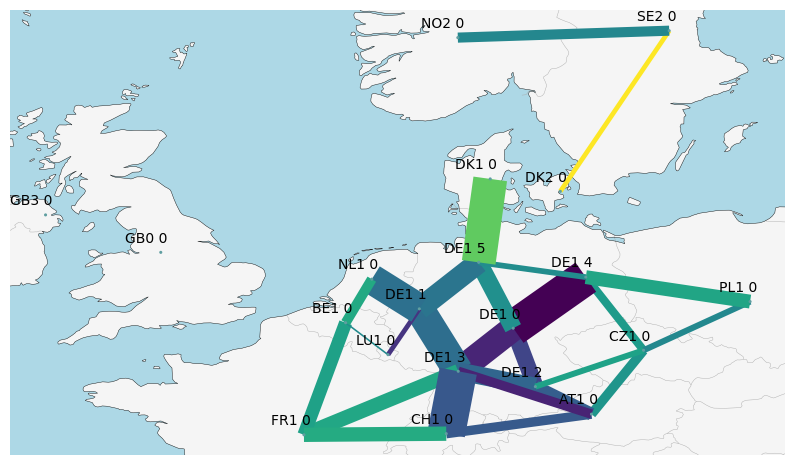

In [11]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [12]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


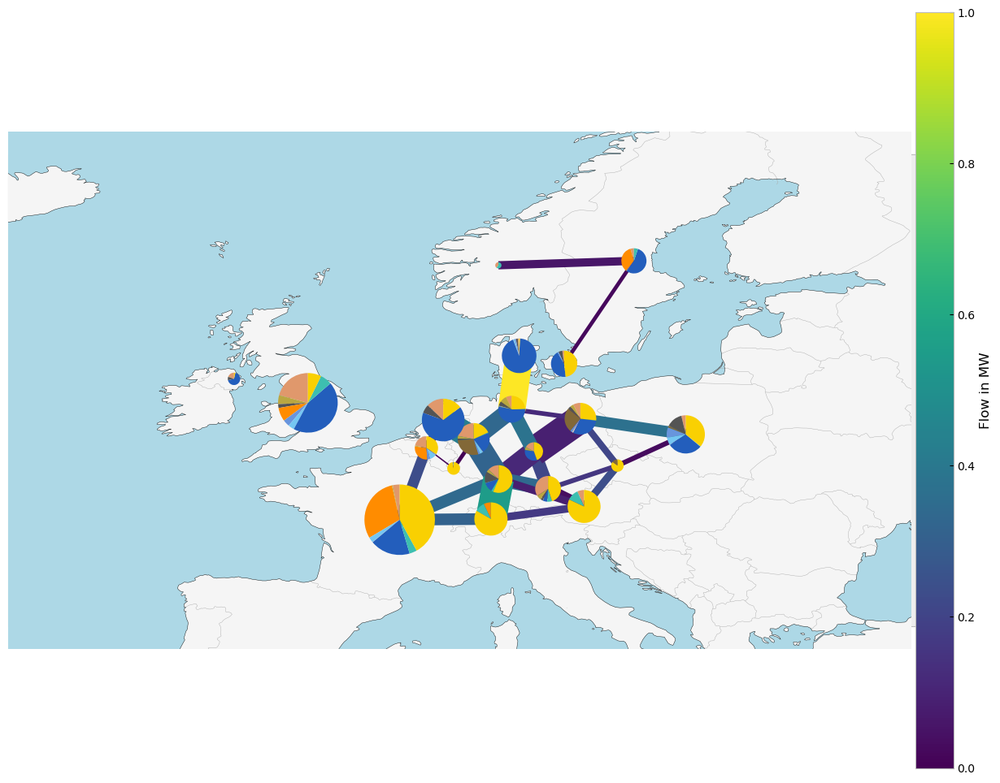

In [13]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [14]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


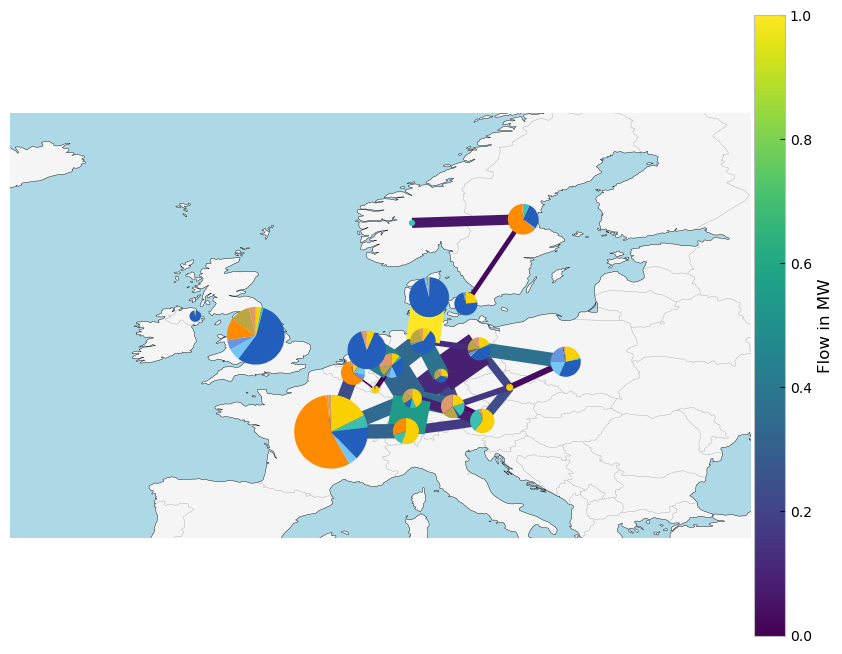

In [15]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

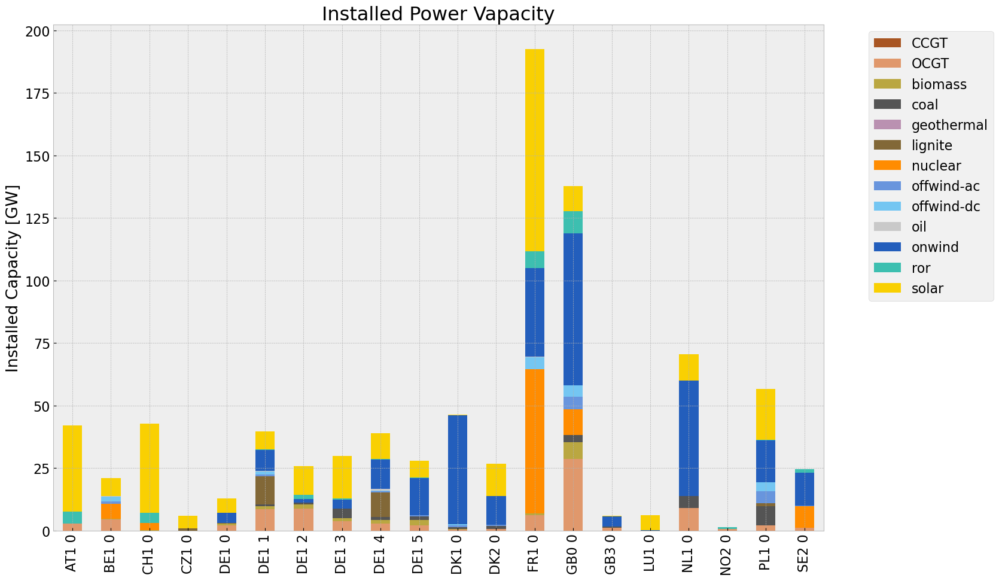

In [16]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

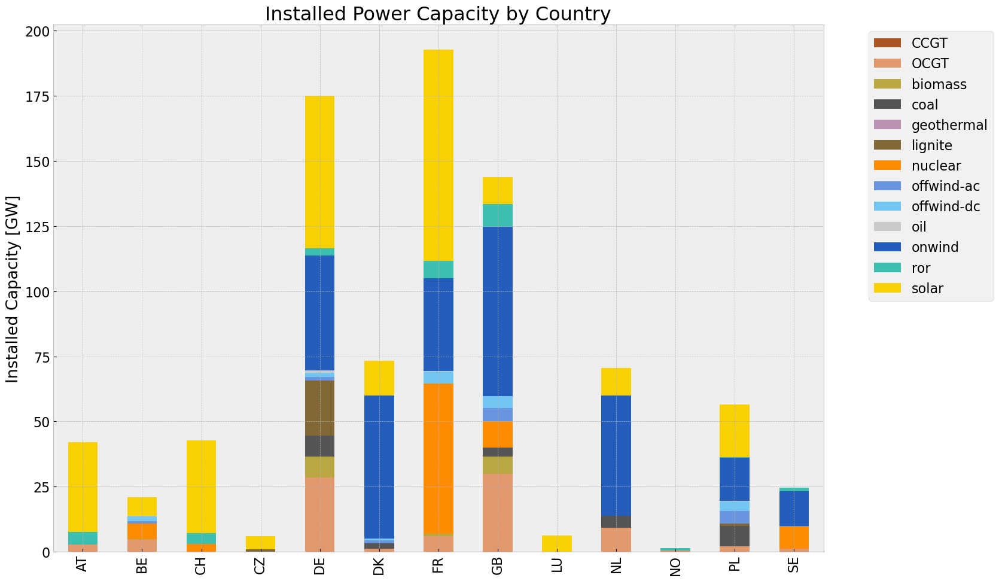

In [17]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

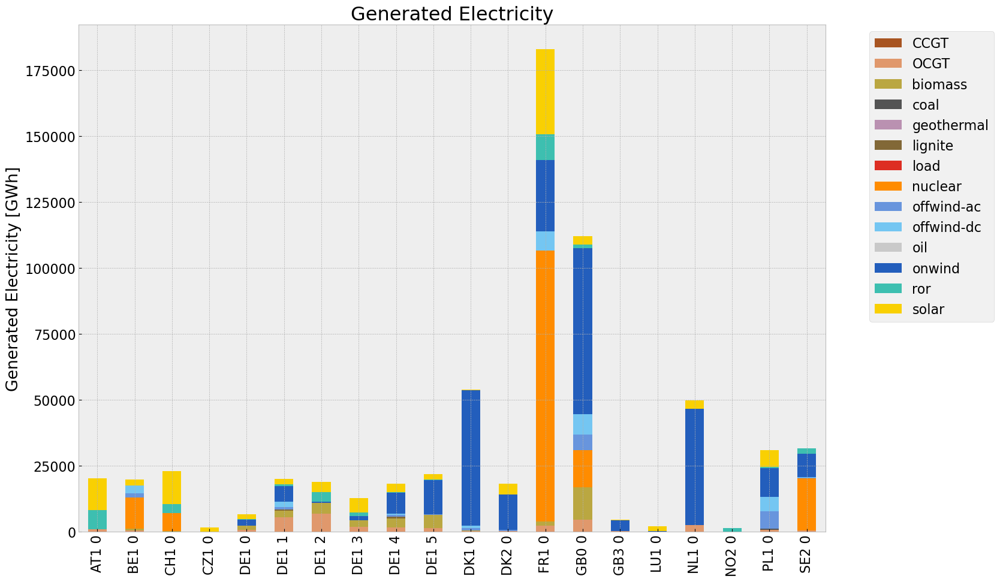

In [18]:
def gen_power_table(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    

    return generations

gen_base = gen_power_table(n,colors_gen_table)

<Figure size 640x480 with 0 Axes>

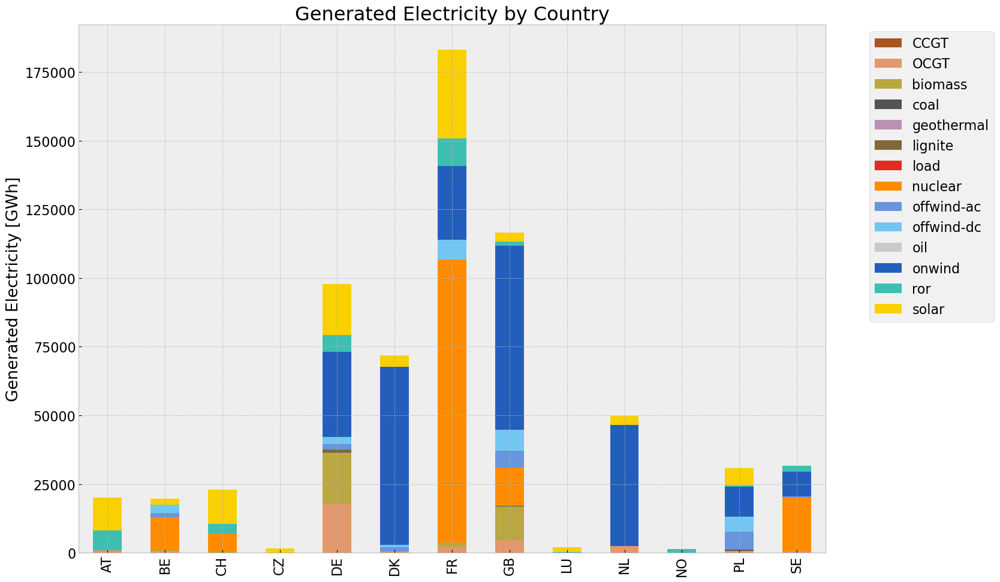

In [19]:
def gen_power_table_country(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    #generations = n.generators
    #generations['country'] = generations['bus'].str[:2]
    #generations = pd.Series(index = n.generators.groupby(['country', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    generations['country'] = generations.index.str[:2]
    generations = generations.groupby(['country']).sum()   
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return generations

gen_base_country = gen_power_table_country(n,colors_gen_table)

## Snapshot

In [20]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [21]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [22]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [23]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [24]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [25]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [26]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

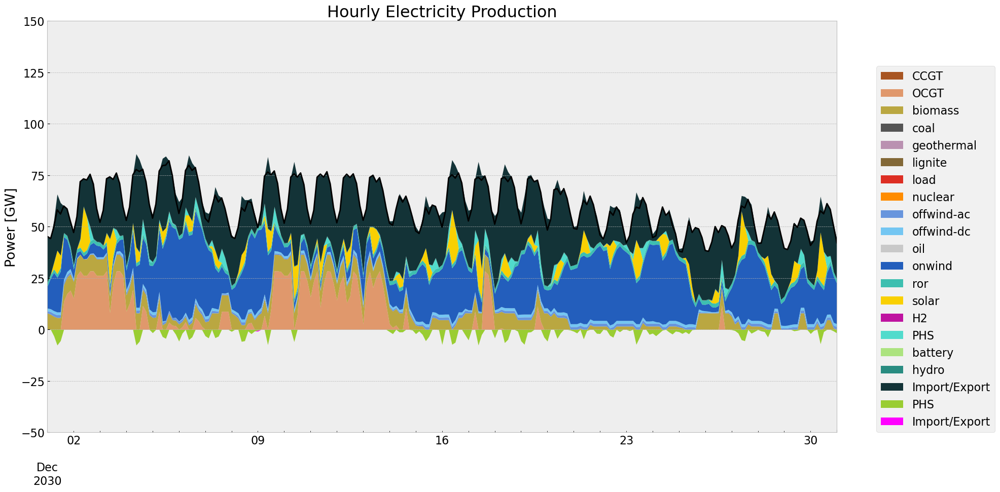

In [27]:
# winter
gen_curve(n, '2030-12-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

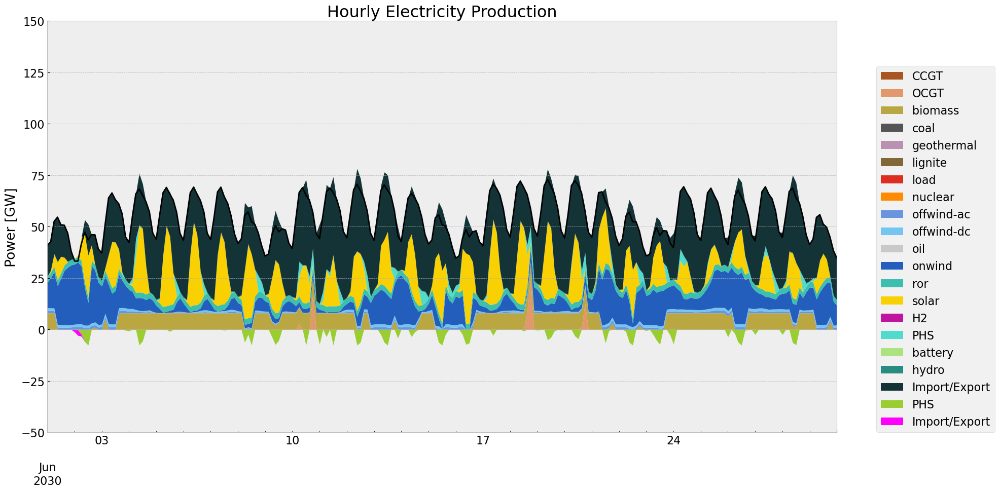

In [28]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [29]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

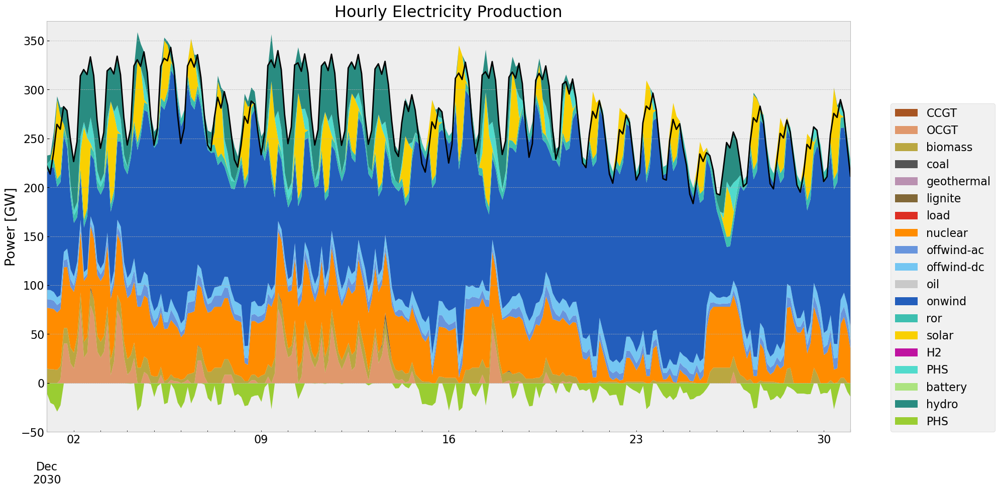

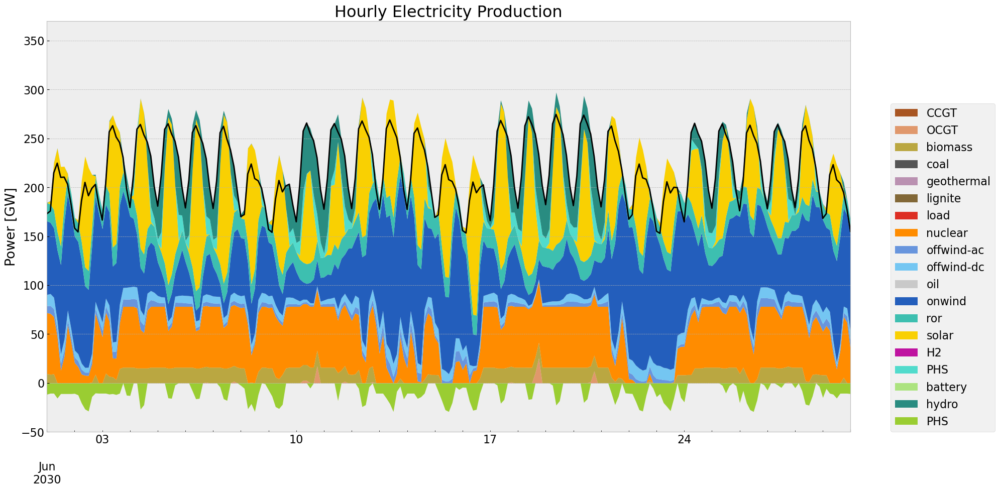

In [30]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [31]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["yellowgreen","magenta","red","blue"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

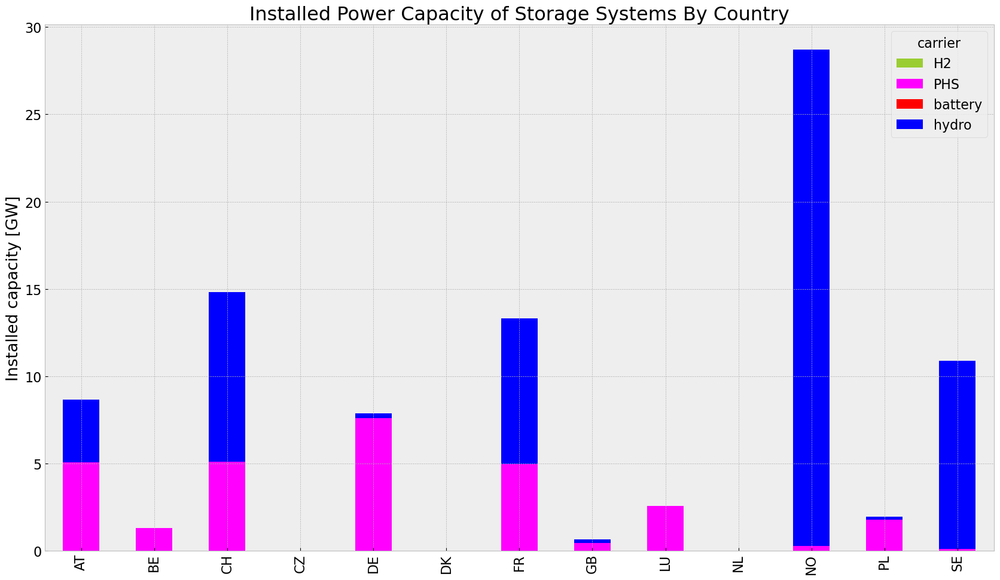

In [32]:
store_base = inst_store_table(n)

In [33]:
def state_of_charge_plot(n):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    soc.plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


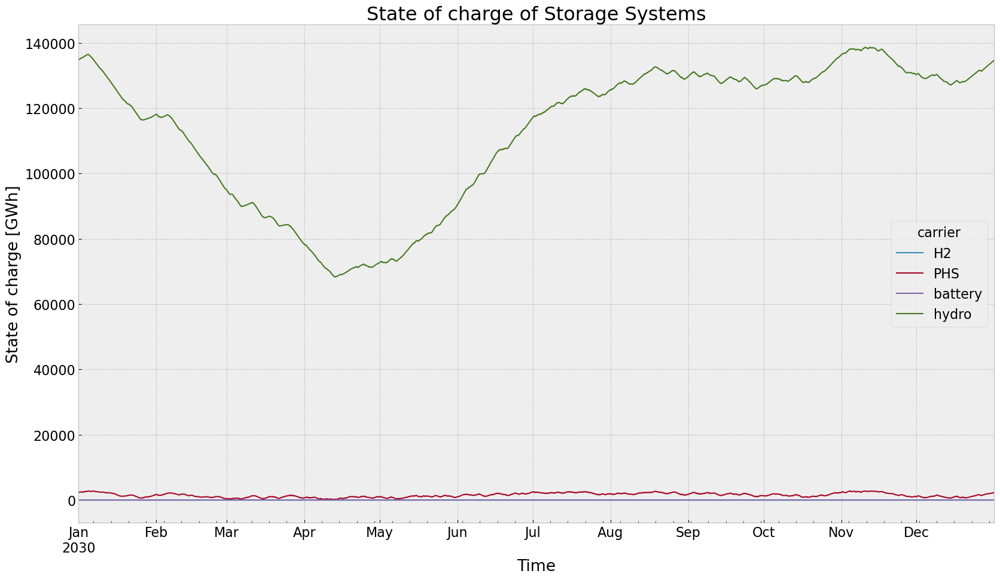

In [34]:
state_of_charge_plot(n)

## Electricity Price

In [35]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [36]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


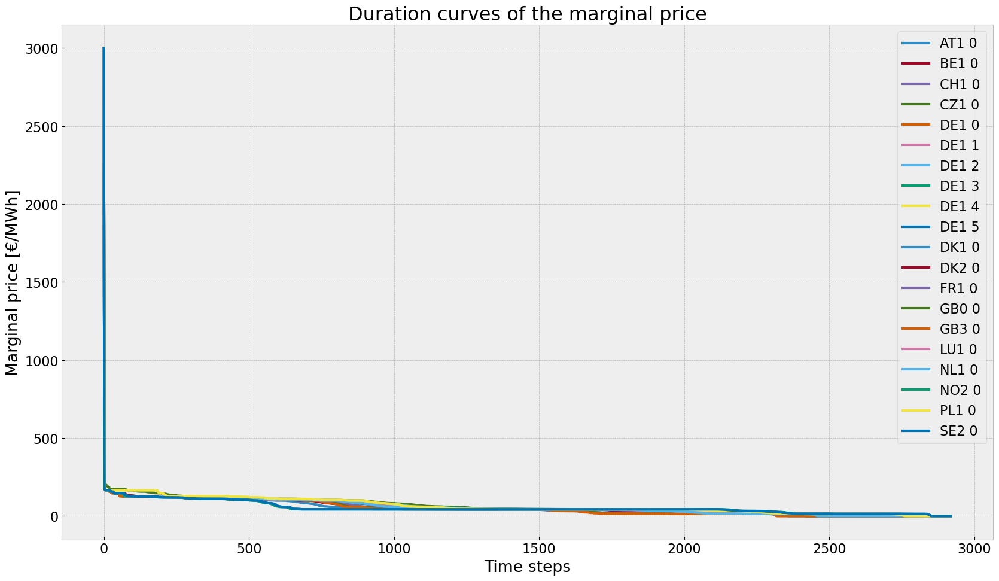

In [37]:
price_dur_curve_plot(n)

In [38]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


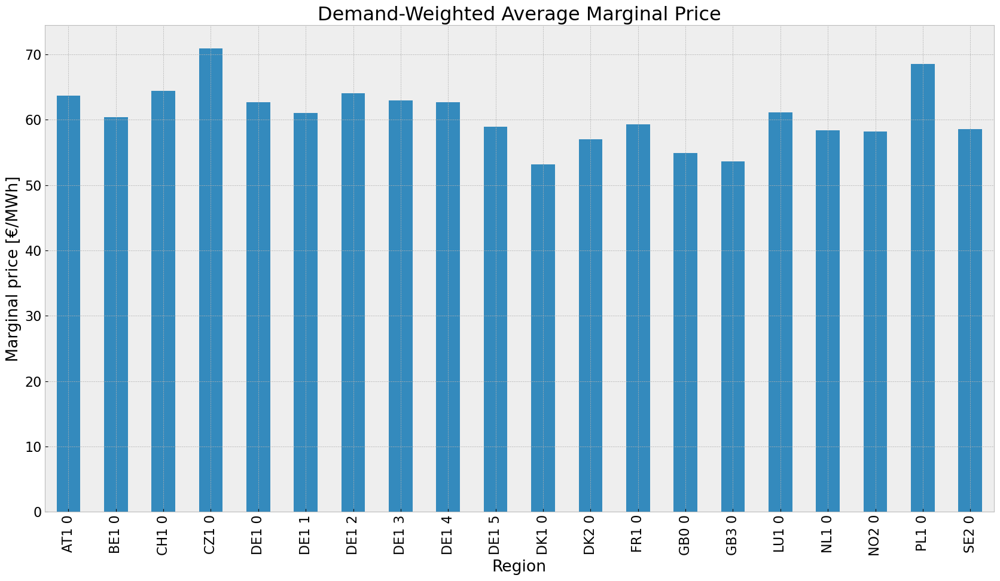

In [39]:
price_regions_table(n)

In [40]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


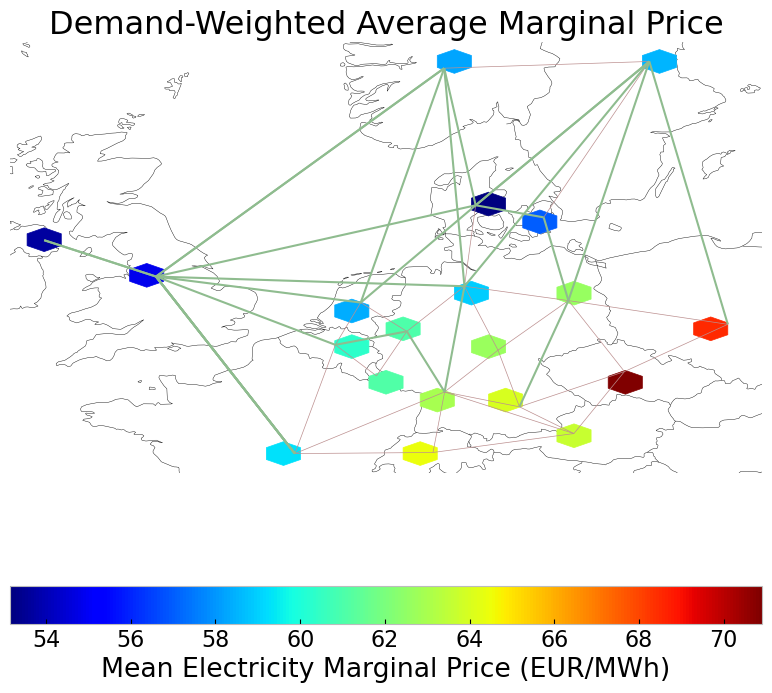

In [41]:
price_regions(n)

## Emission

In [42]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.950103e+07,0.451621,0.1980,1.293387e+07
biomass,3.377481e+07,0.468000,0.0000,0.000000e+00
coal,7.117319e+05,0.329908,0.3361,7.250902e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,9.211707e+05,0.337285,0.4069,1.111300e+06
load,3.775349e+03,1.000000,0.0000,0.000000e+00
nuclear,1.554148e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.794435e+07,1.000000,0.0000,0.000000e+00


# No Exim Scenario



In [44]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0

def noeximscenario(n, cut_start, duration, reductionto):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    
    # find transnational AC lines and cut them
    for index,row in n_new.lines.iterrows():
        ctr_bus0 = row['bus0'][:2]
        ctr_bus1 = row['bus1'][:2]
        #set s_max_pu as series for transnational AC Lines
        if ctr_bus0 != ctr_bus1 and row['carrier'] == 'AC':
                n_new.lines_t.s_max_pu[index] = 0.7

    # find transnational DC lines
    for index,row in n_new.links.iterrows():
        ctr_bus0 = row['bus0'][:2]
        ctr_bus1 = row['bus1'][:2]
        #set s_max_pu as series for transnational DC Lines
        if ctr_bus0 != ctr_bus1 and row['carrier'] == 'DC':
                n_new.links_t.p_max_pu[index] = 1

    #cut AC lines
    n_new.lines_t.s_max_pu.loc[cut_start:cut_end] *= reductionto

    #cut DC lines
    n_new.links_t.p_max_pu.loc[cut_start:cut_end] *= reductionto


    return n_new


n1 = noeximscenario(n, cut_start, duration, reductionto)
n1.name = 'inv_noexim'          

## 1. Scenario: allow additional investment of extendable generators and storage

### Allow investment

In [45]:
def allow_inv(n1,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']


    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 

allow_inv(n1,n)

In [46]:
n1.optimize(solver_name= "gurobi")
#n1 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\No_Exim\\20240512\\inv_noexim.nc")

Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.20it/s]
INFO:linopy.io: Writing time: 37.0s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7b5lf_f1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7b5lf_f1.lp


Reading time = 11.22 seconds


INFO:gurobipy:Reading time = 11.22 seconds


obj: 3264863 rows, 1521502 columns, 6149494 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6149494 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6149494 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6149494 nonzeros


Model fingerprint: 0x343ecf28


INFO:gurobipy:Model fingerprint: 0x343ecf28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2243708 rows and 396870 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2243708 rows and 396870 columns (presolve time = 5s) ...


Presolve removed 2243708 rows and 396870 columns


INFO:gurobipy:Presolve removed 2243708 rows and 396870 columns


Presolve time: 6.04s


INFO:gurobipy:Presolve time: 6.04s


Presolved: 1021155 rows, 1124632 columns, 3427994 nonzeros


INFO:gurobipy:Presolved: 1021155 rows, 1124632 columns, 3427994 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 7s


INFO:gurobipy:Elapsed ordering time = 7s


Ordering time: 13.13s


INFO:gurobipy:Ordering time: 13.13s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 172


INFO:gurobipy: Dense cols : 172


 AA' NZ     : 3.303e+06


INFO:gurobipy: AA' NZ     : 3.303e+06


 Factor NZ  : 2.358e+07 (roughly 1.0 GB of memory)


INFO:gurobipy: Factor NZ  : 2.358e+07 (roughly 1.0 GB of memory)


 Factor Ops : 3.931e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.931e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.97074019e+17 -6.86163654e+18  3.17e+10 6.76e+04  8.30e+13    23s


INFO:gurobipy:   0   6.97074019e+17 -6.86163654e+18  3.17e+10 6.76e+04  8.30e+13    23s


   1   6.25973963e+17 -3.31939114e+18  2.89e+10 2.35e+04  5.53e+13    25s


INFO:gurobipy:   1   6.25973963e+17 -3.31939114e+18  2.89e+10 2.35e+04  5.53e+13    25s


   2   5.12462647e+17 -1.75234945e+18  2.21e+10 8.66e+03  3.74e+13    26s


INFO:gurobipy:   2   5.12462647e+17 -1.75234945e+18  2.21e+10 8.66e+03  3.74e+13    26s


   3   2.92619893e+17 -1.07173843e+18  5.83e+09 3.23e+03  1.12e+13    29s


INFO:gurobipy:   3   2.92619893e+17 -1.07173843e+18  5.83e+09 3.23e+03  1.12e+13    29s


   4   2.49399159e+17 -3.35585657e+17  2.54e+09 6.65e+02  4.37e+12    31s


INFO:gurobipy:   4   2.49399159e+17 -3.35585657e+17  2.54e+09 6.65e+02  4.37e+12    31s


   5   1.51942857e+17 -6.14581448e+16  6.86e+08 1.40e+02  1.18e+12    32s


INFO:gurobipy:   5   1.51942857e+17 -6.14581448e+16  6.86e+08 1.40e+02  1.18e+12    32s


   6   3.80384871e+16 -1.20436053e+16  4.59e+07 1.13e+01  9.37e+10    34s


INFO:gurobipy:   6   3.80384871e+16 -1.20436053e+16  4.59e+07 1.13e+01  9.37e+10    34s


   7   5.81892523e+15 -2.85087885e+15  1.61e+06 1.50e+00  6.14e+09    35s


INFO:gurobipy:   7   5.81892523e+15 -2.85087885e+15  1.61e+06 1.50e+00  6.14e+09    35s


   8   3.52924763e+15 -4.42384156e+14  9.14e+05 1.99e-02  2.84e+09    38s


INFO:gurobipy:   8   3.52924763e+15 -4.42384156e+14  9.14e+05 1.99e-02  2.84e+09    38s


   9   2.18367124e+15 -2.44540154e+14  5.49e+05 6.37e-04  1.67e+09    40s


INFO:gurobipy:   9   2.18367124e+15 -2.44540154e+14  5.49e+05 6.37e-04  1.67e+09    40s


  10   1.60343215e+15 -1.62749561e+14  3.94e+05 1.07e-05  1.17e+09    42s


INFO:gurobipy:  10   1.60343215e+15 -1.62749561e+14  3.94e+05 1.07e-05  1.17e+09    42s


  11   1.05480455e+15 -1.16214772e+14  2.52e+05 8.36e-05  7.41e+08    43s


INFO:gurobipy:  11   1.05480455e+15 -1.16214772e+14  2.52e+05 8.36e-05  7.41e+08    43s


  12   7.31206349e+14 -7.66720049e+13  1.73e+05 7.79e-05  4.89e+08    44s


INFO:gurobipy:  12   7.31206349e+14 -7.66720049e+13  1.73e+05 7.79e-05  4.89e+08    44s


  13   4.83862144e+14 -4.52409478e+13  1.12e+05 7.46e-04  3.07e+08    46s


INFO:gurobipy:  13   4.83862144e+14 -4.52409478e+13  1.12e+05 7.46e-04  3.07e+08    46s


  14   2.98638760e+14 -2.81582280e+13  6.81e+04 5.85e-04  1.82e+08    48s


INFO:gurobipy:  14   2.98638760e+14 -2.81582280e+13  6.81e+04 5.85e-04  1.82e+08    48s


  15   2.37408141e+14 -2.22532302e+13  5.35e+04 2.49e-04  1.39e+08    49s


INFO:gurobipy:  15   2.37408141e+14 -2.22532302e+13  5.35e+04 2.49e-04  1.39e+08    49s


  16   1.76009083e+14 -1.33199607e+13  3.92e+04 2.57e-04  9.82e+07    50s


INFO:gurobipy:  16   1.76009083e+14 -1.33199607e+13  3.92e+04 2.57e-04  9.82e+07    50s


  17   1.11795694e+14 -1.04295987e+13  2.46e+04 9.23e-05  6.19e+07    52s


INFO:gurobipy:  17   1.11795694e+14 -1.04295987e+13  2.46e+04 9.23e-05  6.19e+07    52s


  18   8.41958510e+13 -7.76983602e+12  1.84e+04 3.20e-05  4.58e+07    54s


INFO:gurobipy:  18   8.41958510e+13 -7.76983602e+12  1.84e+04 3.20e-05  4.58e+07    54s


  19   5.18137590e+13 -7.18754399e+12  1.12e+04 4.41e-05  2.90e+07    56s


INFO:gurobipy:  19   5.18137590e+13 -7.18754399e+12  1.12e+04 4.41e-05  2.90e+07    56s


  20   4.26692662e+13 -5.10004858e+12  9.30e+03 1.97e-04  2.31e+07    58s


INFO:gurobipy:  20   4.26692662e+13 -5.10004858e+12  9.30e+03 1.97e-04  2.31e+07    58s


  21   3.84655279e+13 -4.69174069e+12  8.38e+03 1.21e-04  2.08e+07    59s


INFO:gurobipy:  21   3.84655279e+13 -4.69174069e+12  8.38e+03 1.21e-04  2.08e+07    59s


  22   2.22883157e+13 -4.25663694e+12  4.75e+03 8.87e-05  1.26e+07    60s


INFO:gurobipy:  22   2.22883157e+13 -4.25663694e+12  4.75e+03 8.87e-05  1.26e+07    60s


  23   1.74193204e+13 -2.83621162e+12  3.68e+03 7.40e-06  9.44e+06    62s


INFO:gurobipy:  23   1.74193204e+13 -2.83621162e+12  3.68e+03 7.40e-06  9.44e+06    62s


  24   1.08096155e+13 -2.01440066e+12  2.28e+03 4.31e-06  5.86e+06    65s


INFO:gurobipy:  24   1.08096155e+13 -2.01440066e+12  2.28e+03 4.31e-06  5.86e+06    65s


  25   7.57599178e+12 -1.81623922e+12  1.58e+03 3.69e-06  4.26e+06    67s


INFO:gurobipy:  25   7.57599178e+12 -1.81623922e+12  1.58e+03 3.69e-06  4.26e+06    67s


  26   6.82299558e+12 -1.36552391e+12  1.42e+03 3.87e-05  3.69e+06    70s


INFO:gurobipy:  26   6.82299558e+12 -1.36552391e+12  1.42e+03 3.87e-05  3.69e+06    70s


  27   4.40495979e+12 -1.29411748e+12  9.25e+02 5.13e-05  2.55e+06    71s


INFO:gurobipy:  27   4.40495979e+12 -1.29411748e+12  9.25e+02 5.13e-05  2.55e+06    71s


  28   2.90160599e+12 -1.10359665e+12  6.07e+02 2.03e-06  1.77e+06    73s


INFO:gurobipy:  28   2.90160599e+12 -1.10359665e+12  6.07e+02 2.03e-06  1.77e+06    73s


  29   1.85685674e+12 -9.06783733e+11  3.75e+02 1.62e-06  1.21e+06    76s


INFO:gurobipy:  29   1.85685674e+12 -9.06783733e+11  3.75e+02 1.62e-06  1.21e+06    76s


  30   1.51145831e+12 -6.60781325e+11  3.02e+02 2.81e-05  9.43e+05    79s


INFO:gurobipy:  30   1.51145831e+12 -6.60781325e+11  3.02e+02 2.81e-05  9.43e+05    79s


  31   1.31378023e+12 -5.77732763e+11  2.61e+02 1.07e-06  8.19e+05    81s


INFO:gurobipy:  31   1.31378023e+12 -5.77732763e+11  2.61e+02 1.07e-06  8.19e+05    81s


  32   9.62800289e+11 -4.67648057e+11  1.87e+02 1.02e-04  6.15e+05    84s


INFO:gurobipy:  32   9.62800289e+11 -4.67648057e+11  1.87e+02 1.02e-04  6.15e+05    84s


  33   7.40612439e+11 -3.73918317e+11  1.39e+02 1.15e-04  4.76e+05    87s


INFO:gurobipy:  33   7.40612439e+11 -3.73918317e+11  1.39e+02 1.15e-04  4.76e+05    87s


  34   5.05538779e+11 -1.88700276e+11  8.96e+01 3.63e-07  2.95e+05    89s


INFO:gurobipy:  34   5.05538779e+11 -1.88700276e+11  8.96e+01 3.63e-07  2.95e+05    89s


  35   3.98328917e+11 -5.31150375e+10  6.62e+01 7.79e-04  1.92e+05    92s


INFO:gurobipy:  35   3.98328917e+11 -5.31150375e+10  6.62e+01 7.79e-04  1.92e+05    92s


  36   3.22555378e+11 -3.73176665e+10  5.09e+01 6.64e-04  1.53e+05    95s


INFO:gurobipy:  36   3.22555378e+11 -3.73176665e+10  5.09e+01 6.64e-04  1.53e+05    95s


  37   2.60844397e+11 -8.74964710e+09  3.87e+01 5.15e-04  1.14e+05    97s


INFO:gurobipy:  37   2.60844397e+11 -8.74964710e+09  3.87e+01 5.15e-04  1.14e+05    97s


  38   2.01437020e+11  2.24273391e+09  2.65e+01 6.21e-04  8.42e+04    98s


INFO:gurobipy:  38   2.01437020e+11  2.24273391e+09  2.65e+01 6.21e-04  8.42e+04    98s


  39   1.87049978e+11  1.23811902e+10  2.39e+01 1.66e-04  7.39e+04   100s


INFO:gurobipy:  39   1.87049978e+11  1.23811902e+10  2.39e+01 1.66e-04  7.39e+04   100s


  40   1.79615100e+11  2.26341671e+10  2.24e+01 2.74e-05  6.64e+04   102s


INFO:gurobipy:  40   1.79615100e+11  2.26341671e+10  2.24e+01 2.74e-05  6.64e+04   102s


  41   1.59738235e+11  2.70158599e+10  1.86e+01 2.27e-05  5.61e+04   104s


INFO:gurobipy:  41   1.59738235e+11  2.70158599e+10  1.86e+01 2.27e-05  5.61e+04   104s


  42   1.46729738e+11  3.52486775e+10  1.58e+01 1.66e-04  4.71e+04   105s


INFO:gurobipy:  42   1.46729738e+11  3.52486775e+10  1.58e+01 1.66e-04  4.71e+04   105s


  43   1.40778614e+11  4.26978852e+10  1.47e+01 2.06e-04  4.15e+04   107s


INFO:gurobipy:  43   1.40778614e+11  4.26978852e+10  1.47e+01 2.06e-04  4.15e+04   107s


  44   1.25567229e+11  4.77676975e+10  1.19e+01 3.72e-04  3.30e+04   109s


INFO:gurobipy:  44   1.25567229e+11  4.77676975e+10  1.19e+01 3.72e-04  3.30e+04   109s


  45   1.15812341e+11  4.99751679e+10  9.85e+00 4.25e-04  2.79e+04   111s


INFO:gurobipy:  45   1.15812341e+11  4.99751679e+10  9.85e+00 4.25e-04  2.79e+04   111s


  46   1.06816500e+11  5.48779979e+10  7.87e+00 4.31e-04  2.20e+04   113s


INFO:gurobipy:  46   1.06816500e+11  5.48779979e+10  7.87e+00 4.31e-04  2.20e+04   113s


  47   1.01093682e+11  5.67330727e+10  6.71e+00 3.18e-04  1.88e+04   115s


INFO:gurobipy:  47   1.01093682e+11  5.67330727e+10  6.71e+00 3.18e-04  1.88e+04   115s


  48   9.74560448e+10  5.76629235e+10  5.96e+00 2.87e-04  1.68e+04   117s


INFO:gurobipy:  48   9.74560448e+10  5.76629235e+10  5.96e+00 2.87e-04  1.68e+04   117s


  49   9.36111459e+10  5.94429389e+10  5.14e+00 4.13e-04  1.45e+04   119s


INFO:gurobipy:  49   9.36111459e+10  5.94429389e+10  5.14e+00 4.13e-04  1.45e+04   119s


  50   8.91936260e+10  6.09057206e+10  4.15e+00 3.67e-04  1.20e+04   121s


INFO:gurobipy:  50   8.91936260e+10  6.09057206e+10  4.15e+00 3.67e-04  1.20e+04   121s


  51   8.68017709e+10  6.22204117e+10  3.63e+00 4.43e-04  1.04e+04   124s


INFO:gurobipy:  51   8.68017709e+10  6.22204117e+10  3.63e+00 4.43e-04  1.04e+04   124s


  52   8.40232640e+10  6.32704946e+10  3.03e+00 3.43e-04  8.78e+03   126s


INFO:gurobipy:  52   8.40232640e+10  6.32704946e+10  3.03e+00 3.43e-04  8.78e+03   126s


  53   8.17952356e+10  6.49250197e+10  2.54e+00 1.35e-04  7.14e+03   128s


INFO:gurobipy:  53   8.17952356e+10  6.49250197e+10  2.54e+00 1.35e-04  7.14e+03   128s


  54   8.09274585e+10  6.56879409e+10  2.35e+00 1.20e-04  6.46e+03   130s


INFO:gurobipy:  54   8.09274585e+10  6.56879409e+10  2.35e+00 1.20e-04  6.46e+03   130s


  55   7.87657543e+10  6.60505186e+10  1.88e+00 1.09e-04  5.38e+03   132s


INFO:gurobipy:  55   7.87657543e+10  6.60505186e+10  1.88e+00 1.09e-04  5.38e+03   132s


  56   7.76965684e+10  6.69003101e+10  1.64e+00 2.38e-04  4.57e+03   134s


INFO:gurobipy:  56   7.76965684e+10  6.69003101e+10  1.64e+00 2.38e-04  4.57e+03   134s


  57   7.69787285e+10  6.72145874e+10  1.48e+00 1.34e-04  4.14e+03   136s


INFO:gurobipy:  57   7.69787285e+10  6.72145874e+10  1.48e+00 1.34e-04  4.14e+03   136s


  58   7.64377134e+10  6.75135947e+10  1.36e+00 1.31e-04  3.78e+03   139s


INFO:gurobipy:  58   7.64377134e+10  6.75135947e+10  1.36e+00 1.31e-04  3.78e+03   139s


  59   7.59923845e+10  6.77723247e+10  1.26e+00 1.99e-04  3.48e+03   141s


INFO:gurobipy:  59   7.59923845e+10  6.77723247e+10  1.26e+00 1.99e-04  3.48e+03   141s


  60   7.51830653e+10  6.80593395e+10  1.08e+00 1.60e-04  3.02e+03   143s


INFO:gurobipy:  60   7.51830653e+10  6.80593395e+10  1.08e+00 1.60e-04  3.02e+03   143s


  61   7.49456992e+10  6.84438824e+10  1.03e+00 1.01e-04  2.76e+03   145s


INFO:gurobipy:  61   7.49456992e+10  6.84438824e+10  1.03e+00 1.01e-04  2.76e+03   145s


  62   7.42074731e+10  6.85575006e+10  8.59e-01 1.01e-04  2.39e+03   147s


INFO:gurobipy:  62   7.42074731e+10  6.85575006e+10  8.59e-01 1.01e-04  2.39e+03   147s


  63   7.39236714e+10  6.87075114e+10  7.89e-01 9.05e-05  2.21e+03   149s


INFO:gurobipy:  63   7.39236714e+10  6.87075114e+10  7.89e-01 9.05e-05  2.21e+03   149s


  64   7.34320427e+10  6.88874908e+10  6.78e-01 7.47e-05  1.92e+03   151s


INFO:gurobipy:  64   7.34320427e+10  6.88874908e+10  6.78e-01 7.47e-05  1.92e+03   151s


  65   7.33094901e+10  6.91876207e+10  6.50e-01 9.65e-05  1.75e+03   153s


INFO:gurobipy:  65   7.33094901e+10  6.91876207e+10  6.50e-01 9.65e-05  1.75e+03   153s


  66   7.29625873e+10  6.92648249e+10  5.67e-01 8.24e-05  1.57e+03   155s


INFO:gurobipy:  66   7.29625873e+10  6.92648249e+10  5.67e-01 8.24e-05  1.57e+03   155s


  67   7.28149318e+10  6.93823759e+10  5.32e-01 9.78e-05  1.45e+03   158s


INFO:gurobipy:  67   7.28149318e+10  6.93823759e+10  5.32e-01 9.78e-05  1.45e+03   158s


  68   7.25466448e+10  6.94668944e+10  4.66e-01 8.29e-05  1.30e+03   160s


INFO:gurobipy:  68   7.25466448e+10  6.94668944e+10  4.66e-01 8.29e-05  1.30e+03   160s


  69   7.23490498e+10  6.95963785e+10  4.16e-01 7.27e-05  1.17e+03   162s


INFO:gurobipy:  69   7.23490498e+10  6.95963785e+10  4.16e-01 7.27e-05  1.17e+03   162s


  70   7.22490539e+10  6.96711356e+10  3.92e-01 7.86e-05  1.09e+03   164s


INFO:gurobipy:  70   7.22490539e+10  6.96711356e+10  3.92e-01 7.86e-05  1.09e+03   164s


  71   7.20504318e+10  6.97845410e+10  3.43e-01 5.67e-05  9.59e+02   166s


INFO:gurobipy:  71   7.20504318e+10  6.97845410e+10  3.43e-01 5.67e-05  9.59e+02   166s


  72   7.18665708e+10  6.98691857e+10  2.98e-01 6.49e-05  8.45e+02   168s


INFO:gurobipy:  72   7.18665708e+10  6.98691857e+10  2.98e-01 6.49e-05  8.45e+02   168s


  73   7.17736042e+10  6.99786116e+10  2.76e-01 4.99e-05  7.60e+02   170s


INFO:gurobipy:  73   7.17736042e+10  6.99786116e+10  2.76e-01 4.99e-05  7.60e+02   170s


  74   7.15777090e+10  7.00121297e+10  2.29e-01 4.69e-05  6.62e+02   172s


INFO:gurobipy:  74   7.15777090e+10  7.00121297e+10  2.29e-01 4.69e-05  6.62e+02   172s


  75   7.15053177e+10  7.00622402e+10  2.12e-01 3.99e-05  6.10e+02   174s


INFO:gurobipy:  75   7.15053177e+10  7.00622402e+10  2.12e-01 3.99e-05  6.10e+02   174s


  76   7.14347409e+10  7.01442938e+10  1.95e-01 3.96e-05  5.46e+02   176s


INFO:gurobipy:  76   7.14347409e+10  7.01442938e+10  1.95e-01 3.96e-05  5.46e+02   176s


  77   7.13454882e+10  7.01835455e+10  1.72e-01 4.79e-05  4.91e+02   179s


INFO:gurobipy:  77   7.13454882e+10  7.01835455e+10  1.72e-01 4.79e-05  4.91e+02   179s


  78   7.12165249e+10  7.02065871e+10  1.41e-01 4.82e-05  4.26e+02   181s


INFO:gurobipy:  78   7.12165249e+10  7.02065871e+10  1.41e-01 4.82e-05  4.26e+02   181s


  79   7.11822000e+10  7.02611732e+10  1.33e-01 3.60e-05  3.89e+02   183s


INFO:gurobipy:  79   7.11822000e+10  7.02611732e+10  1.33e-01 3.60e-05  3.89e+02   183s


  80   7.11052991e+10  7.02887376e+10  1.14e-01 3.40e-05  3.44e+02   185s


INFO:gurobipy:  80   7.11052991e+10  7.02887376e+10  1.14e-01 3.40e-05  3.44e+02   185s


  81   7.10611429e+10  7.03147831e+10  1.04e-01 3.36e-05  3.14e+02   187s


INFO:gurobipy:  81   7.10611429e+10  7.03147831e+10  1.04e-01 3.36e-05  3.14e+02   187s


  82   7.10453732e+10  7.03288573e+10  9.97e-02 3.39e-05  3.02e+02   189s


INFO:gurobipy:  82   7.10453732e+10  7.03288573e+10  9.97e-02 3.39e-05  3.02e+02   189s


  83   7.10104397e+10  7.03449798e+10  9.15e-02 3.39e-05  2.80e+02   191s


INFO:gurobipy:  83   7.10104397e+10  7.03449798e+10  9.15e-02 3.39e-05  2.80e+02   191s


  84   7.09922271e+10  7.03754798e+10  8.71e-02 3.34e-05  2.60e+02   193s


INFO:gurobipy:  84   7.09922271e+10  7.03754798e+10  8.71e-02 3.34e-05  2.60e+02   193s


  85   7.09420545e+10  7.03883019e+10  7.54e-02 3.29e-05  2.33e+02   195s


INFO:gurobipy:  85   7.09420545e+10  7.03883019e+10  7.54e-02 3.29e-05  2.33e+02   195s


  86   7.09167527e+10  7.04141834e+10  6.94e-02 2.83e-05  2.12e+02   197s


INFO:gurobipy:  86   7.09167527e+10  7.04141834e+10  6.94e-02 2.83e-05  2.12e+02   197s


  87   7.08871374e+10  7.04234368e+10  6.25e-02 2.72e-05  1.95e+02   200s


INFO:gurobipy:  87   7.08871374e+10  7.04234368e+10  6.25e-02 2.72e-05  1.95e+02   200s


  88   7.08582400e+10  7.04325371e+10  5.56e-02 2.53e-05  1.79e+02   202s


INFO:gurobipy:  88   7.08582400e+10  7.04325371e+10  5.56e-02 2.53e-05  1.79e+02   202s


  89   7.08414759e+10  7.04400778e+10  5.17e-02 2.45e-05  1.69e+02   204s


INFO:gurobipy:  89   7.08414759e+10  7.04400778e+10  5.17e-02 2.45e-05  1.69e+02   204s


  90   7.08236052e+10  7.04615062e+10  4.75e-02 2.35e-05  1.52e+02   206s


INFO:gurobipy:  90   7.08236052e+10  7.04615062e+10  4.75e-02 2.35e-05  1.52e+02   206s


  91   7.08082371e+10  7.04706804e+10  4.39e-02 2.11e-05  1.42e+02   208s


INFO:gurobipy:  91   7.08082371e+10  7.04706804e+10  4.39e-02 2.11e-05  1.42e+02   208s


  92   7.07970991e+10  7.04832389e+10  4.13e-02 1.92e-05  1.32e+02   210s


INFO:gurobipy:  92   7.07970991e+10  7.04832389e+10  4.13e-02 1.92e-05  1.32e+02   210s


  93   7.07891173e+10  7.04855633e+10  3.95e-02 1.90e-05  1.27e+02   212s


INFO:gurobipy:  93   7.07891173e+10  7.04855633e+10  3.95e-02 1.90e-05  1.27e+02   212s


  94   7.07754381e+10  7.05015957e+10  3.63e-02 1.90e-05  1.15e+02   214s


INFO:gurobipy:  94   7.07754381e+10  7.05015957e+10  3.63e-02 1.90e-05  1.15e+02   214s


  95   7.07643566e+10  7.05149769e+10  3.37e-02 1.71e-05  1.05e+02   216s


INFO:gurobipy:  95   7.07643566e+10  7.05149769e+10  3.37e-02 1.71e-05  1.05e+02   216s


  96   7.07499440e+10  7.05229073e+10  3.03e-02 1.55e-05  9.54e+01   219s


INFO:gurobipy:  96   7.07499440e+10  7.05229073e+10  3.03e-02 1.55e-05  9.54e+01   219s


  97   7.07334133e+10  7.05294348e+10  2.66e-02 1.46e-05  8.56e+01   221s


INFO:gurobipy:  97   7.07334133e+10  7.05294348e+10  2.66e-02 1.46e-05  8.56e+01   221s


  98   7.07215762e+10  7.05402841e+10  2.38e-02 1.40e-05  7.61e+01   223s


INFO:gurobipy:  98   7.07215762e+10  7.05402841e+10  2.38e-02 1.40e-05  7.61e+01   223s


  99   7.07123412e+10  7.05431207e+10  2.17e-02 1.42e-05  7.10e+01   225s


INFO:gurobipy:  99   7.07123412e+10  7.05431207e+10  2.17e-02 1.42e-05  7.10e+01   225s


 100   7.07050756e+10  7.05477940e+10  2.00e-02 1.34e-05  6.60e+01   227s


INFO:gurobipy: 100   7.07050756e+10  7.05477940e+10  2.00e-02 1.34e-05  6.60e+01   227s


 101   7.06996786e+10  7.05532848e+10  1.88e-02 1.25e-05  6.14e+01   229s


INFO:gurobipy: 101   7.06996786e+10  7.05532848e+10  1.88e-02 1.25e-05  6.14e+01   229s


 102   7.06933793e+10  7.05581627e+10  1.73e-02 1.14e-05  5.67e+01   231s


INFO:gurobipy: 102   7.06933793e+10  7.05581627e+10  1.73e-02 1.14e-05  5.67e+01   231s


 103   7.06887387e+10  7.05617911e+10  1.63e-02 1.09e-05  5.32e+01   234s


INFO:gurobipy: 103   7.06887387e+10  7.05617911e+10  1.63e-02 1.09e-05  5.32e+01   234s


 104   7.06831412e+10  7.05655663e+10  1.49e-02 9.90e-06  4.93e+01   236s


INFO:gurobipy: 104   7.06831412e+10  7.05655663e+10  1.49e-02 9.90e-06  4.93e+01   236s


 105   7.06816106e+10  7.05686231e+10  1.46e-02 9.83e-06  4.74e+01   238s


INFO:gurobipy: 105   7.06816106e+10  7.05686231e+10  1.46e-02 9.83e-06  4.74e+01   238s


 106   7.06742114e+10  7.05713353e+10  1.29e-02 9.55e-06  4.31e+01   240s


INFO:gurobipy: 106   7.06742114e+10  7.05713353e+10  1.29e-02 9.55e-06  4.31e+01   240s


 107   7.06733631e+10  7.05720187e+10  1.27e-02 9.29e-06  4.25e+01   241s


INFO:gurobipy: 107   7.06733631e+10  7.05720187e+10  1.27e-02 9.29e-06  4.25e+01   241s


 108   7.06678529e+10  7.05762155e+10  1.15e-02 8.44e-06  3.84e+01   244s


INFO:gurobipy: 108   7.06678529e+10  7.05762155e+10  1.15e-02 8.44e-06  3.84e+01   244s


 109   7.06651167e+10  7.05788134e+10  1.09e-02 8.19e-06  3.62e+01   246s


INFO:gurobipy: 109   7.06651167e+10  7.05788134e+10  1.09e-02 8.19e-06  3.62e+01   246s


 110   7.06606551e+10  7.05817706e+10  9.92e-03 7.44e-06  3.31e+01   248s


INFO:gurobipy: 110   7.06606551e+10  7.05817706e+10  9.92e-03 7.44e-06  3.31e+01   248s


 111   7.06574619e+10  7.05849904e+10  9.20e-03 6.23e-06  3.04e+01   250s


INFO:gurobipy: 111   7.06574619e+10  7.05849904e+10  9.20e-03 6.23e-06  3.04e+01   250s


 112   7.06560269e+10  7.05864214e+10  8.88e-03 6.12e-06  2.92e+01   252s


INFO:gurobipy: 112   7.06560269e+10  7.05864214e+10  8.88e-03 6.12e-06  2.92e+01   252s


 113   7.06541455e+10  7.05882916e+10  8.47e-03 6.08e-06  2.76e+01   254s


INFO:gurobipy: 113   7.06541455e+10  7.05882916e+10  8.47e-03 6.08e-06  2.76e+01   254s


 114   7.06493160e+10  7.05899634e+10  7.39e-03 5.58e-06  2.49e+01   257s


INFO:gurobipy: 114   7.06493160e+10  7.05899634e+10  7.39e-03 5.58e-06  2.49e+01   257s


 115   7.06470570e+10  7.05921192e+10  6.88e-03 4.92e-06  2.30e+01   259s


INFO:gurobipy: 115   7.06470570e+10  7.05921192e+10  6.88e-03 4.92e-06  2.30e+01   259s


 116   7.06436780e+10  7.05932192e+10  6.13e-03 4.52e-06  2.11e+01   261s


INFO:gurobipy: 116   7.06436780e+10  7.05932192e+10  6.13e-03 4.52e-06  2.11e+01   261s


 117   7.06415573e+10  7.05956500e+10  5.66e-03 3.97e-06  1.92e+01   263s


INFO:gurobipy: 117   7.06415573e+10  7.05956500e+10  5.66e-03 3.97e-06  1.92e+01   263s


 118   7.06401293e+10  7.05962362e+10  5.35e-03 3.91e-06  1.84e+01   265s


INFO:gurobipy: 118   7.06401293e+10  7.05962362e+10  5.35e-03 3.91e-06  1.84e+01   265s


 119   7.06381858e+10  7.05980348e+10  4.92e-03 3.61e-06  1.68e+01   267s


INFO:gurobipy: 119   7.06381858e+10  7.05980348e+10  4.92e-03 3.61e-06  1.68e+01   267s


 120   7.06374884e+10  7.05985854e+10  4.77e-03 3.33e-06  1.63e+01   269s


INFO:gurobipy: 120   7.06374884e+10  7.05985854e+10  4.77e-03 3.33e-06  1.63e+01   269s


 121   7.06350663e+10  7.05997084e+10  4.22e-03 3.18e-06  1.48e+01   271s


INFO:gurobipy: 121   7.06350663e+10  7.05997084e+10  4.22e-03 3.18e-06  1.48e+01   271s


 122   7.06337881e+10  7.06016454e+10  3.94e-03 2.83e-06  1.35e+01   274s


INFO:gurobipy: 122   7.06337881e+10  7.06016454e+10  3.94e-03 2.83e-06  1.35e+01   274s


 123   7.06319377e+10  7.06035710e+10  3.52e-03 2.74e-06  1.19e+01   276s


INFO:gurobipy: 123   7.06319377e+10  7.06035710e+10  3.52e-03 2.74e-06  1.19e+01   276s


 124   7.06299353e+10  7.06049119e+10  3.08e-03 2.20e-06  1.05e+01   278s


INFO:gurobipy: 124   7.06299353e+10  7.06049119e+10  3.08e-03 2.20e-06  1.05e+01   278s


 125   7.06291214e+10  7.06053075e+10  2.91e-03 2.15e-06  9.97e+00   281s


INFO:gurobipy: 125   7.06291214e+10  7.06053075e+10  2.91e-03 2.15e-06  9.97e+00   281s


 126   7.06285484e+10  7.06057093e+10  2.78e-03 2.03e-06  9.56e+00   283s


INFO:gurobipy: 126   7.06285484e+10  7.06057093e+10  2.78e-03 2.03e-06  9.56e+00   283s


 127   7.06273573e+10  7.06067232e+10  2.53e-03 1.77e-06  8.64e+00   285s


INFO:gurobipy: 127   7.06273573e+10  7.06067232e+10  2.53e-03 1.77e-06  8.64e+00   285s


 128   7.06264787e+10  7.06074324e+10  2.34e-03 1.78e-06  7.98e+00   287s


INFO:gurobipy: 128   7.06264787e+10  7.06074324e+10  2.34e-03 1.78e-06  7.98e+00   287s


 129   7.06261480e+10  7.06078748e+10  2.27e-03 1.59e-06  7.66e+00   289s


INFO:gurobipy: 129   7.06261480e+10  7.06078748e+10  2.27e-03 1.59e-06  7.66e+00   289s


 130   7.06247739e+10  7.06082316e+10  1.98e-03 1.45e-06  6.92e+00   292s


INFO:gurobipy: 130   7.06247739e+10  7.06082316e+10  1.98e-03 1.45e-06  6.92e+00   292s


 131   7.06241459e+10  7.06091691e+10  1.84e-03 1.45e-06  6.27e+00   294s


INFO:gurobipy: 131   7.06241459e+10  7.06091691e+10  1.84e-03 1.45e-06  6.27e+00   294s


 132   7.06232534e+10  7.06103146e+10  1.65e-03 9.59e-07  5.42e+00   296s


INFO:gurobipy: 132   7.06232534e+10  7.06103146e+10  1.65e-03 9.59e-07  5.42e+00   296s


 133   7.06224016e+10  7.06116547e+10  1.47e-03 1.05e-06  4.51e+00   298s


INFO:gurobipy: 133   7.06224016e+10  7.06116547e+10  1.47e-03 1.05e-06  4.51e+00   298s


 134   7.06212905e+10  7.06119818e+10  1.23e-03 7.37e-07  3.91e+00   300s


INFO:gurobipy: 134   7.06212905e+10  7.06119818e+10  1.23e-03 7.37e-07  3.91e+00   300s


 135   7.06202343e+10  7.06126314e+10  1.00e-03 6.86e-07  3.19e+00   303s


INFO:gurobipy: 135   7.06202343e+10  7.06126314e+10  1.00e-03 6.86e-07  3.19e+00   303s


 136   7.06195936e+10  7.06128338e+10  8.69e-04 4.25e-07  2.83e+00   305s


INFO:gurobipy: 136   7.06195936e+10  7.06128338e+10  8.69e-04 4.25e-07  2.83e+00   305s


 137   7.06189094e+10  7.06132090e+10  7.27e-04 2.87e-07  2.39e+00   307s


INFO:gurobipy: 137   7.06189094e+10  7.06132090e+10  7.27e-04 2.87e-07  2.39e+00   307s


 138   7.06186202e+10  7.06136719e+10  6.65e-04 3.64e-07  2.08e+00   309s


INFO:gurobipy: 138   7.06186202e+10  7.06136719e+10  6.65e-04 3.64e-07  2.08e+00   309s


 139   7.06182797e+10  7.06138121e+10  5.94e-04 2.87e-07  1.88e+00   311s


INFO:gurobipy: 139   7.06182797e+10  7.06138121e+10  5.94e-04 2.87e-07  1.88e+00   311s


 140   7.06179128e+10  7.06141676e+10  5.19e-04 4.17e-07  1.57e+00   313s


INFO:gurobipy: 140   7.06179128e+10  7.06141676e+10  5.19e-04 4.17e-07  1.57e+00   313s


 141   7.06175016e+10  7.06144455e+10  4.34e-04 3.18e-07  1.29e+00   316s


INFO:gurobipy: 141   7.06175016e+10  7.06144455e+10  4.34e-04 3.18e-07  1.29e+00   316s


 142   7.06174116e+10  7.06144917e+10  4.15e-04 2.68e-07  1.23e+00   318s


INFO:gurobipy: 142   7.06174116e+10  7.06144917e+10  4.15e-04 2.68e-07  1.23e+00   318s


 143   7.06172104e+10  7.06146229e+10  3.76e-04 6.18e-07  1.09e+00   320s


INFO:gurobipy: 143   7.06172104e+10  7.06146229e+10  3.76e-04 6.18e-07  1.09e+00   320s


 144   7.06169791e+10  7.06146596e+10  3.28e-04 7.60e-07  9.75e-01   322s


INFO:gurobipy: 144   7.06169791e+10  7.06146596e+10  3.28e-04 7.60e-07  9.75e-01   322s


 145   7.06166990e+10  7.06148549e+10  2.70e-04 1.43e-06  7.76e-01   324s


INFO:gurobipy: 145   7.06166990e+10  7.06148549e+10  2.70e-04 1.43e-06  7.76e-01   324s


 146   7.06166650e+10  7.06148875e+10  2.63e-04 1.33e-06  7.49e-01   326s


INFO:gurobipy: 146   7.06166650e+10  7.06148875e+10  2.63e-04 1.33e-06  7.49e-01   326s


 147   7.06165310e+10  7.06149415e+10  2.35e-04 1.11e-06  6.70e-01   328s


INFO:gurobipy: 147   7.06165310e+10  7.06149415e+10  2.35e-04 1.11e-06  6.70e-01   328s


 148   7.06163729e+10  7.06150469e+10  2.02e-04 5.07e-07  5.59e-01   330s


INFO:gurobipy: 148   7.06163729e+10  7.06150469e+10  2.02e-04 5.07e-07  5.59e-01   330s


 149   7.06161321e+10  7.06150863e+10  1.53e-04 5.36e-07  4.40e-01   332s


INFO:gurobipy: 149   7.06161321e+10  7.06150863e+10  1.53e-04 5.36e-07  4.40e-01   332s


 150   7.06160755e+10  7.06151988e+10  1.42e-04 4.03e-07  3.70e-01   335s


INFO:gurobipy: 150   7.06160755e+10  7.06151988e+10  1.42e-04 4.03e-07  3.70e-01   335s


 151   7.06158832e+10  7.06152560e+10  1.01e-04 6.11e-07  2.65e-01   337s


INFO:gurobipy: 151   7.06158832e+10  7.06152560e+10  1.01e-04 6.11e-07  2.65e-01   337s


 152   7.06156694e+10  7.06153109e+10  5.63e-05 9.83e-07  1.51e-01   339s


INFO:gurobipy: 152   7.06156694e+10  7.06153109e+10  5.63e-05 9.83e-07  1.51e-01   339s


 153   7.06156013e+10  7.06153572e+10  4.23e-05 4.45e-07  1.03e-01   341s


INFO:gurobipy: 153   7.06156013e+10  7.06153572e+10  4.23e-05 4.45e-07  1.03e-01   341s


 154   7.06154862e+10  7.06153766e+10  2.42e-05 5.51e-07  4.63e-02   343s


INFO:gurobipy: 154   7.06154862e+10  7.06153766e+10  2.42e-05 5.51e-07  4.63e-02   343s


 155   7.06154654e+10  7.06153843e+10  1.83e-05 3.43e-07  3.43e-02   346s


INFO:gurobipy: 155   7.06154654e+10  7.06153843e+10  1.83e-05 3.43e-07  3.43e-02   346s


 156   7.06154389e+10  7.06153861e+10  1.10e-05 2.83e-07  2.23e-02   348s


INFO:gurobipy: 156   7.06154389e+10  7.06153861e+10  1.10e-05 2.83e-07  2.23e-02   348s


 157   7.06154249e+10  7.06153916e+10  7.08e-06 1.79e-07  1.41e-02   350s


INFO:gurobipy: 157   7.06154249e+10  7.06153916e+10  7.08e-06 1.79e-07  1.41e-02   350s


 158   7.06154174e+10  7.06153928e+10  4.97e-06 3.36e-07  1.04e-02   353s


INFO:gurobipy: 158   7.06154174e+10  7.06153928e+10  4.97e-06 3.36e-07  1.04e-02   353s


 159   7.06154110e+10  7.06153957e+10  3.82e-06 2.51e-07  6.48e-03   355s


INFO:gurobipy: 159   7.06154110e+10  7.06153957e+10  3.82e-06 2.51e-07  6.48e-03   355s


 160   7.06154086e+10  7.06153964e+10  2.81e-06 1.94e-07  5.15e-03   358s


INFO:gurobipy: 160   7.06154086e+10  7.06153964e+10  2.81e-06 1.94e-07  5.15e-03   358s


 161   7.06154048e+10  7.06153974e+10  1.91e-06 8.04e-08  3.15e-03   361s


INFO:gurobipy: 161   7.06154048e+10  7.06153974e+10  1.91e-06 8.04e-08  3.15e-03   361s


 162   7.06154020e+10  7.06153976e+10  5.66e-06 2.11e-07  1.86e-03   365s


INFO:gurobipy: 162   7.06154020e+10  7.06153976e+10  5.66e-06 2.11e-07  1.86e-03   365s


 163   7.06154006e+10  7.06153984e+10  1.21e-05 2.00e-07  9.28e-04   368s


INFO:gurobipy: 163   7.06154006e+10  7.06153984e+10  1.21e-05 2.00e-07  9.28e-04   368s


 164   7.06154002e+10  7.06153985e+10  1.32e-05 1.09e-07  6.88e-04   372s


INFO:gurobipy: 164   7.06154002e+10  7.06153985e+10  1.32e-05 1.09e-07  6.88e-04   372s


 165   7.06153994e+10  7.06153987e+10  4.34e-04 2.31e-07  2.92e-04   374s


INFO:gurobipy: 165   7.06153994e+10  7.06153987e+10  4.34e-04 2.31e-07  2.92e-04   374s


 166   7.06153992e+10  7.06153988e+10  2.34e-04 3.46e-07  1.43e-04   376s


INFO:gurobipy: 166   7.06153992e+10  7.06153988e+10  2.34e-04 3.46e-07  1.43e-04   376s


 167   7.06153989e+10  7.06153989e+10  3.92e-05 3.82e-07  3.60e-05   378s


INFO:gurobipy: 167   7.06153989e+10  7.06153989e+10  3.92e-05 3.82e-07  3.60e-05   378s


 168   7.06153989e+10  7.06153989e+10  6.72e-06 4.51e-07  5.78e-06   379s


INFO:gurobipy: 168   7.06153989e+10  7.06153989e+10  6.72e-06 4.51e-07  5.78e-06   379s


 169   7.06153989e+10  7.06153989e+10  2.83e-06 1.78e-07  1.14e-06   381s


INFO:gurobipy: 169   7.06153989e+10  7.06153989e+10  2.83e-06 1.78e-07  1.14e-06   381s


 170   7.06153989e+10  7.06153989e+10  4.89e-07 2.15e-07  1.18e-07   383s


INFO:gurobipy: 170   7.06153989e+10  7.06153989e+10  4.89e-07 2.15e-07  1.18e-07   383s


 171   7.06153989e+10  7.06153989e+10  1.83e-07 5.66e-07  2.13e-08   385s


INFO:gurobipy: 171   7.06153989e+10  7.06153989e+10  1.83e-07 5.66e-07  2.13e-08   385s


 172   7.06153989e+10  7.06153989e+10  4.31e-07 4.22e-07  7.67e-10   388s


INFO:gurobipy: 172   7.06153989e+10  7.06153989e+10  4.31e-07 4.22e-07  7.67e-10   388s


INFO:gurobipy:


Barrier solved model in 172 iterations and 387.62 seconds (132.72 work units)


INFO:gurobipy:Barrier solved model in 172 iterations and 387.62 seconds (132.72 work units)


Optimal objective 7.06153989e+10


INFO:gurobipy:Optimal objective 7.06153989e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  497679 DPushes remaining with DInf 0.0000000e+00               390s


INFO:gurobipy:  497679 DPushes remaining with DInf 0.0000000e+00               390s


   87536 DPushes remaining with DInf 0.0000000e+00               402s


INFO:gurobipy:   87536 DPushes remaining with DInf 0.0000000e+00               402s


    1161 DPushes remaining with DInf 0.0000000e+00               406s


INFO:gurobipy:    1161 DPushes remaining with DInf 0.0000000e+00               406s


       0 DPushes remaining with DInf 0.0000000e+00               408s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               408s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


   28114 PPushes remaining with PInf 7.6142023e-06               408s


INFO:gurobipy:   28114 PPushes remaining with PInf 7.6142023e-06               408s


    1974 PPushes remaining with PInf 7.6139404e-06               410s


INFO:gurobipy:    1974 PPushes remaining with PInf 7.6139404e-06               410s


       0 PPushes remaining with PInf 0.0000000e+00               412s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00               412s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.8346485e-05    412s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.8346485e-05    412s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  308932    7.0615399e+10   0.000000e+00   1.834247e-05    413s


INFO:gurobipy:  308932    7.0615399e+10   0.000000e+00   1.834247e-05    413s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


  308938    7.0615399e+10   0.000000e+00   0.000000e+00    416s


INFO:gurobipy:  308938    7.0615399e+10   0.000000e+00   0.000000e+00    416s


INFO:gurobipy:


Solved in 308938 iterations and 416.23 seconds (146.75 work units)


INFO:gurobipy:Solved in 308938 iterations and 416.23 seconds (146.75 work units)


Optimal objective  7.061539889e+10


INFO:gurobipy:Optimal objective  7.061539889e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 7.06e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [97]:
#file = "inv_noexim.nc"
#output_path = os.path.join(os.getcwd(), file)
#n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_noexim.nc has links, loads, generators, lines, carriers, global_constraints, storage_units, buses


<xarray.Dataset> Size: 15MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p_max_pu_i: 22,
                                           links_t_p0_i: 17, links_t_p1_i: 17,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, generators_i: 261,
                                           ...
                                           storage_units_t_p_dispatch_i: 31,
                                           storage_units_t_p_store_i: 20,
                                           storage_units_t_state_of_charge_i: 65,
                                           buses_i: 20, buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/29)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p_max_pu_i                    (links_t_p_max_pu_i) object 176B '1...
  * links_t_p0_i                          (links_t_p0_i) object 136B '14801' ...
  * links_t_p1_i                          (links_t_p1_i) object 136B '14801' ...
    ...                                    ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 160B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/107)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 467kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 420kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 467kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_noexim
    network_objective:           70615398893.418
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [48]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

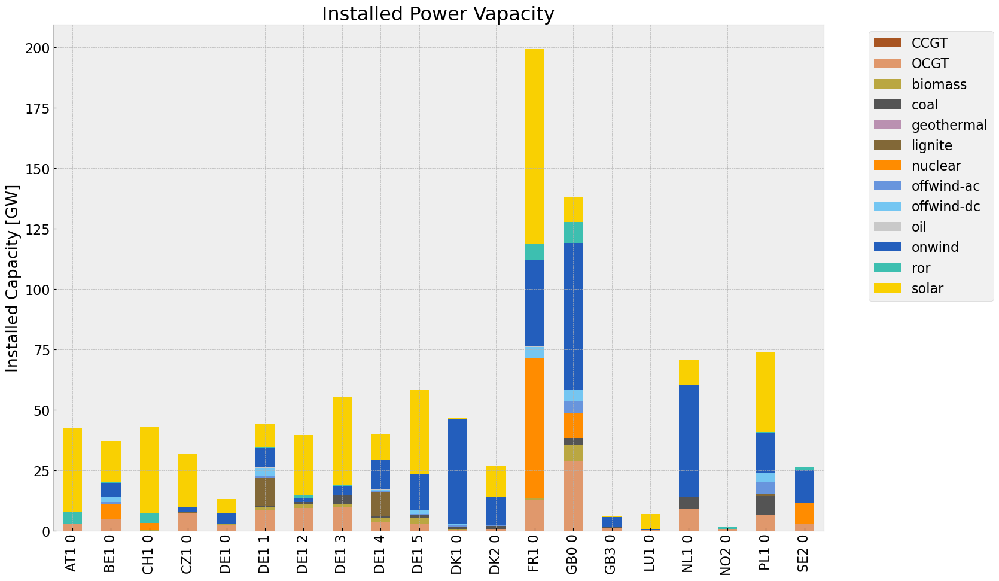

<Figure size 640x480 with 0 Axes>

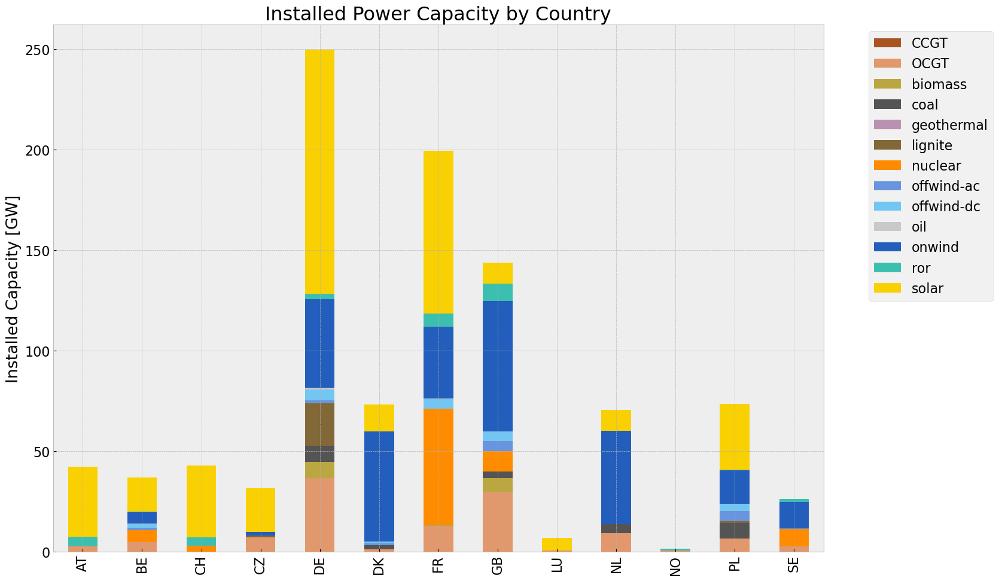

In [49]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


## Generation

<Figure size 640x480 with 0 Axes>

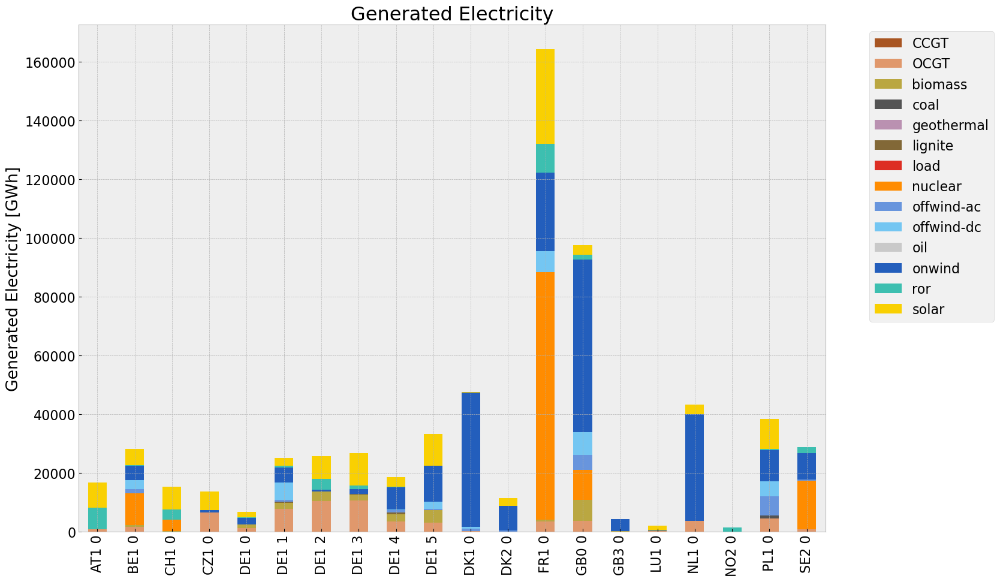

<Figure size 640x480 with 0 Axes>

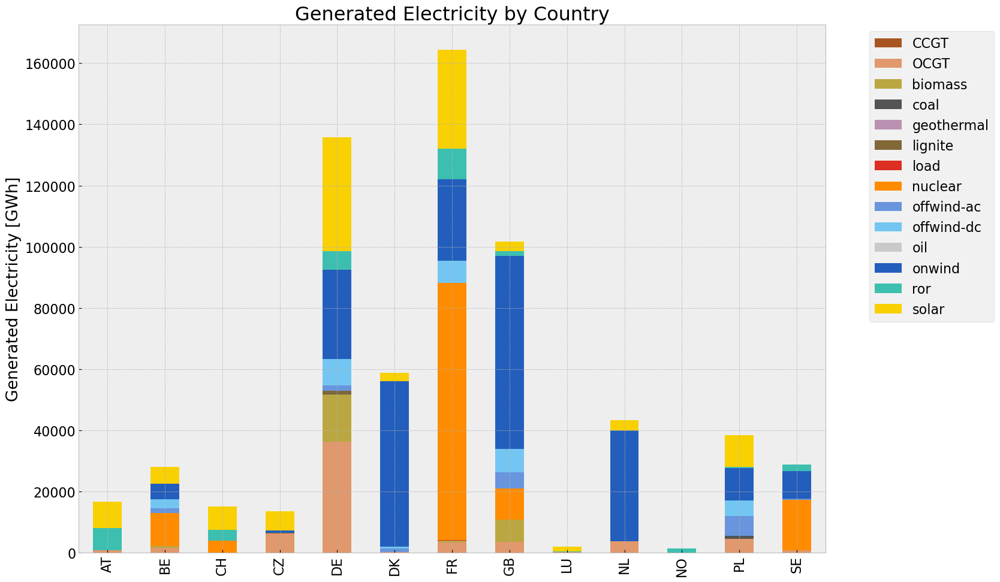

In [50]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1,colors_gen_table)
gen_inv_country = gen_power_table_country(n1,colors_gen_table)

## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

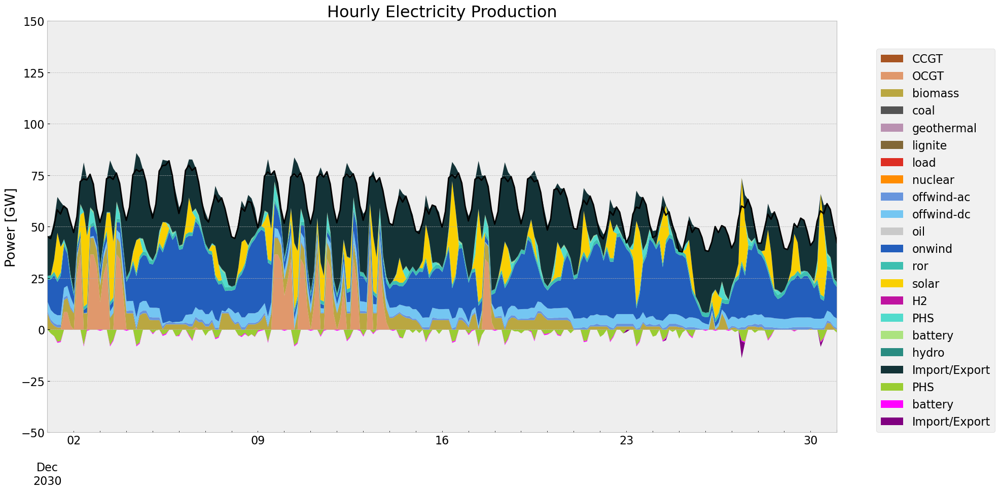

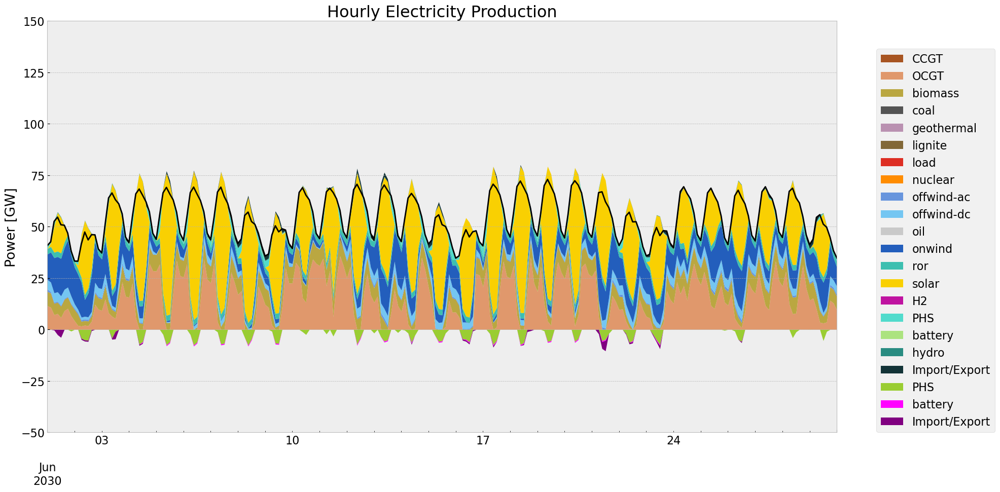

In [51]:
gen_curve(n1, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-06-1', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

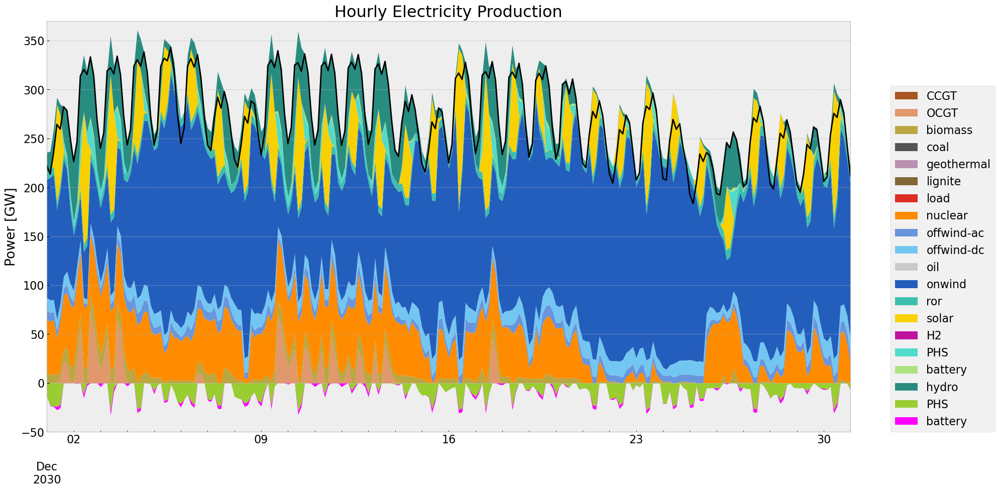

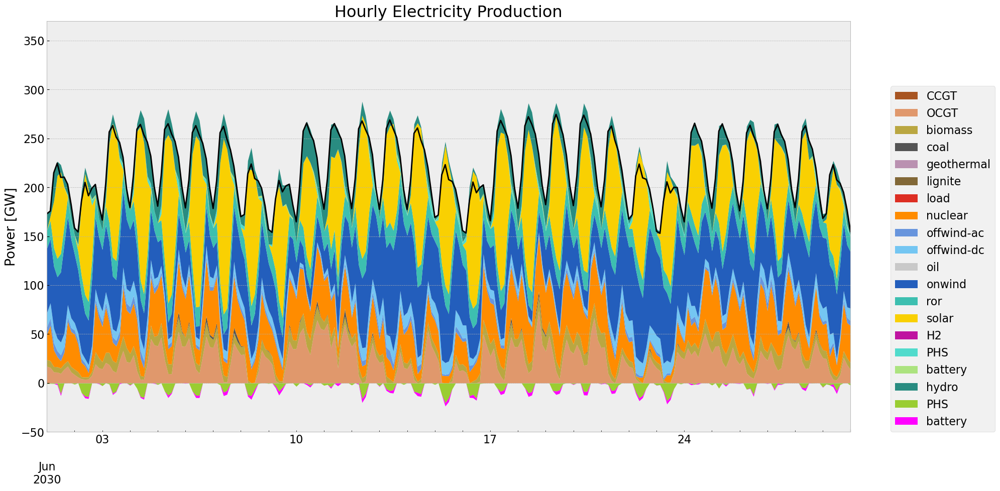

In [52]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

## Storage

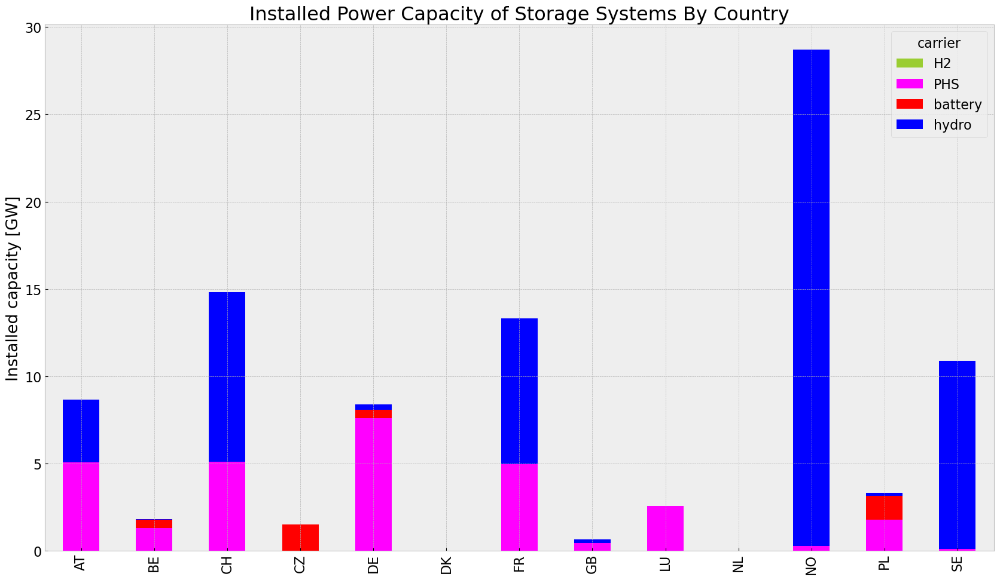

In [53]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


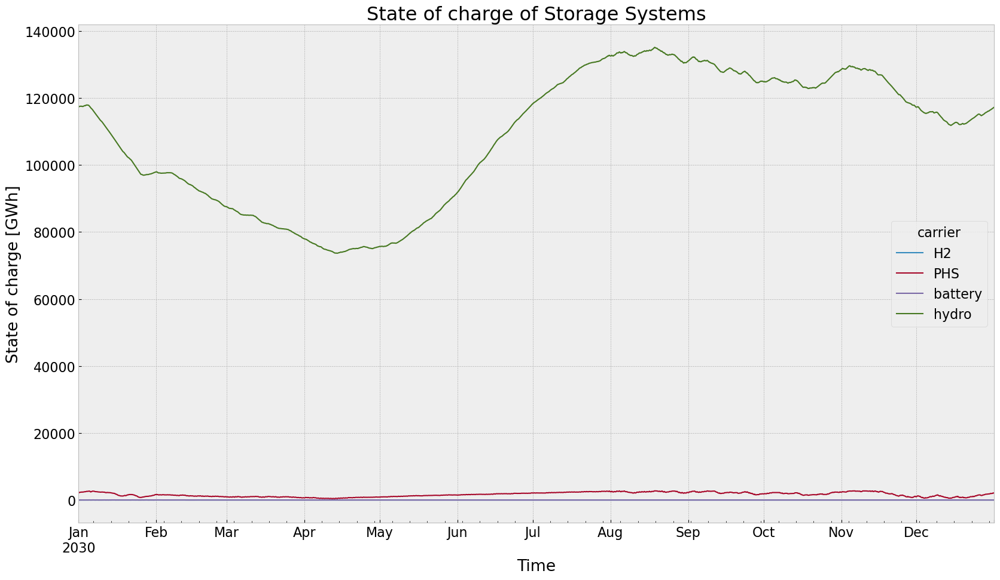

In [54]:
state_of_charge_plot(n1)


## Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


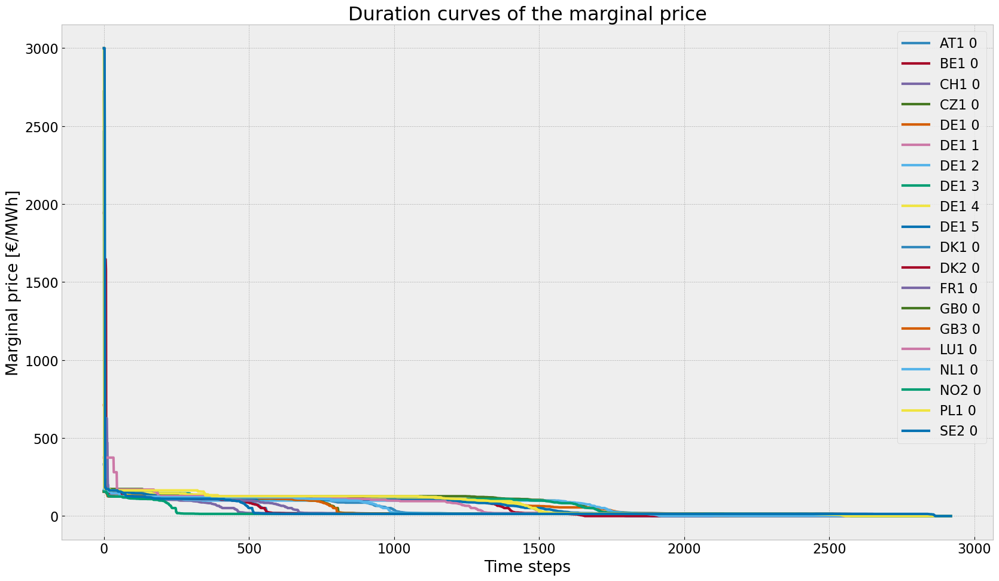

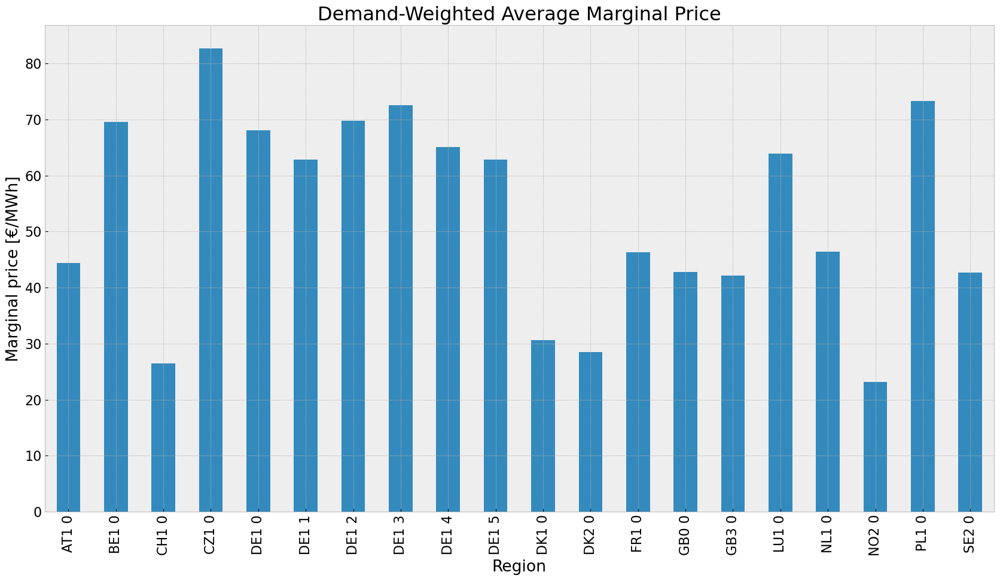

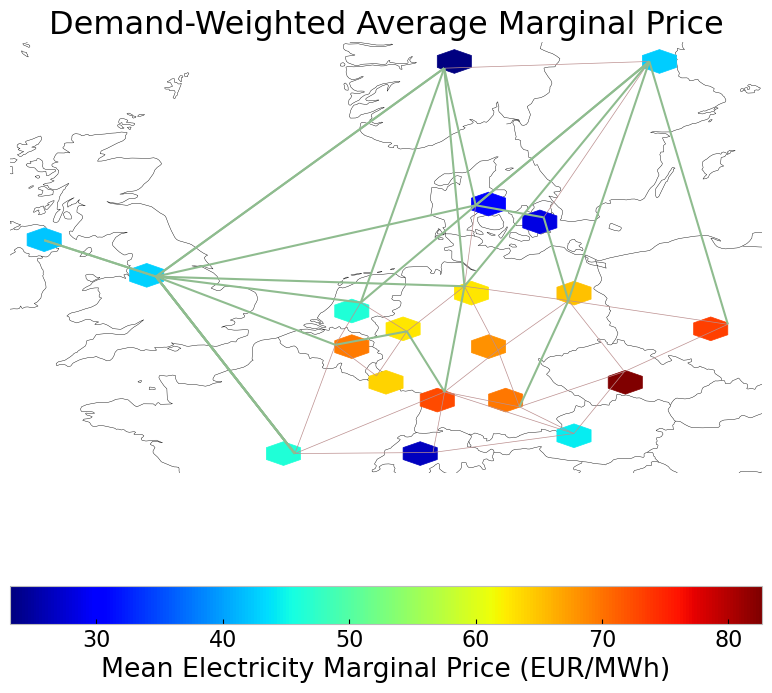

In [55]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


## Emission

In [56]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,6.150967e+07,0.451621,0.1980,2.696713e+07
biomass,2.395300e+07,0.468000,0.0000,0.000000e+00
coal,1.209751e+06,0.329908,0.3361,1.232457e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,9.701596e+05,0.337285,0.4069,1.170400e+06
load,7.955695e+03,1.000000,0.0000,0.000000e+00
nuclear,1.258065e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.644335e+07,1.000000,0.0000,0.000000e+00


## 2. Scenario: perfect foresight with no additional investment

In [57]:
n2 = noeximscenario(n, cut_start, duration, reductionto)
n2.name = 'noinv_exim'     

### No Investment

In [58]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [59]:
n2.optimize(solver_name ='gurobi')
#n2 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\No_Exim\\20240512\\noinv_noexim.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:05<00:00,  1.28it/s]
INFO:linopy.io: Writing time: 33.73s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gh1nhjx2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gh1nhjx2.lp


Reading time = 10.64 seconds


INFO:gurobipy:Reading time = 10.64 seconds


obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


INFO:gurobipy:obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


INFO:gurobipy:Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


Model fingerprint: 0x562cc428


INFO:gurobipy:Model fingerprint: 0x562cc428


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3117553 rows and 942517 columns


INFO:gurobipy:Presolve removed 3117553 rows and 942517 columns


Presolve time: 3.53s


INFO:gurobipy:Presolve time: 3.53s


Presolved: 147007 rows, 578803 columns, 924228 nonzeros


INFO:gurobipy:Presolved: 147007 rows, 578803 columns, 924228 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 1.07s


INFO:gurobipy:Ordering time: 1.07s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.491e+05


INFO:gurobipy: AA' NZ     : 3.491e+05


 Factor NZ  : 3.660e+06 (roughly 300 MB of memory)


INFO:gurobipy: Factor NZ  : 3.660e+06 (roughly 300 MB of memory)


 Factor Ops : 1.754e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.754e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.24665446e+13 -1.34789293e+15  8.31e+05 1.00e+03  1.94e+09     6s


INFO:gurobipy:   0   3.24665446e+13 -1.34789293e+15  8.31e+05 1.00e+03  1.94e+09     6s


   1   8.70288799e+12 -4.17943169e+13  9.64e+04 7.28e-12  1.20e+08     6s


INFO:gurobipy:   1   8.70288799e+12 -4.17943169e+13  9.64e+04 7.28e-12  1.20e+08     6s


   2   1.45115604e+12 -9.99968861e+12  5.98e+03 1.18e-11  1.35e+07     6s


INFO:gurobipy:   2   1.45115604e+12 -9.99968861e+12  5.98e+03 1.18e-11  1.35e+07     6s


   3   4.52387344e+11 -2.67024794e+12  5.85e+02 1.55e-11  2.90e+06     7s


INFO:gurobipy:   3   4.52387344e+11 -2.67024794e+12  5.85e+02 1.55e-11  2.90e+06     7s


   4   2.35683261e+11 -1.24218406e+12  1.38e+02 1.09e-11  1.31e+06     7s


INFO:gurobipy:   4   2.35683261e+11 -1.24218406e+12  1.38e+02 1.09e-11  1.31e+06     7s


   5   2.05580904e+11 -4.49796239e+11  7.14e+01 9.09e-12  5.75e+05     7s


INFO:gurobipy:   5   2.05580904e+11 -4.49796239e+11  7.14e+01 9.09e-12  5.75e+05     7s


   6   1.83315561e+11 -1.10208682e+11  3.30e+01 7.28e-12  2.56e+05     7s


INFO:gurobipy:   6   1.83315561e+11 -1.10208682e+11  3.30e+01 7.28e-12  2.56e+05     7s


   7   1.67218640e+11  4.08479384e+10  1.54e+01 5.46e-12  1.10e+05     8s


INFO:gurobipy:   7   1.67218640e+11  4.08479384e+10  1.54e+01 5.46e-12  1.10e+05     8s


   8   1.58210493e+11  8.56722054e+10  9.29e+00 7.28e-12  6.30e+04     8s


INFO:gurobipy:   8   1.58210493e+11  8.56722054e+10  9.29e+00 7.28e-12  6.30e+04     8s


   9   1.47509918e+11  1.11135646e+11  2.83e+00 5.46e-12  3.15e+04     8s


INFO:gurobipy:   9   1.47509918e+11  1.11135646e+11  2.83e+00 5.46e-12  3.15e+04     8s


  10   1.43634062e+11  1.29675906e+11  1.36e+00 3.64e-12  1.21e+04     8s


INFO:gurobipy:  10   1.43634062e+11  1.29675906e+11  1.36e+00 3.64e-12  1.21e+04     8s


  11   1.41882689e+11  1.33325945e+11  8.11e-01 2.73e-12  7.40e+03     9s


INFO:gurobipy:  11   1.41882689e+11  1.33325945e+11  8.11e-01 2.73e-12  7.40e+03     9s


  12   1.41347110e+11  1.34196336e+11  6.52e-01 3.12e-12  6.18e+03     9s


INFO:gurobipy:  12   1.41347110e+11  1.34196336e+11  6.52e-01 3.12e-12  6.18e+03     9s


  13   1.40850909e+11  1.35428326e+11  5.09e-01 2.73e-12  4.69e+03     9s


INFO:gurobipy:  13   1.40850909e+11  1.35428326e+11  5.09e-01 2.73e-12  4.69e+03     9s


  14   1.40365721e+11  1.36090179e+11  3.71e-01 2.27e-12  3.70e+03     9s


INFO:gurobipy:  14   1.40365721e+11  1.36090179e+11  3.71e-01 2.27e-12  3.70e+03     9s


  15   1.40048085e+11  1.37059936e+11  2.83e-01 3.64e-12  2.58e+03    10s


INFO:gurobipy:  15   1.40048085e+11  1.37059936e+11  2.83e-01 3.64e-12  2.58e+03    10s


  16   1.39714455e+11  1.37620722e+11  1.92e-01 2.18e-12  1.81e+03    10s


INFO:gurobipy:  16   1.39714455e+11  1.37620722e+11  1.92e-01 2.18e-12  1.81e+03    10s


  17   1.39463995e+11  1.37902969e+11  1.26e-01 2.41e-12  1.35e+03    11s


INFO:gurobipy:  17   1.39463995e+11  1.37902969e+11  1.26e-01 2.41e-12  1.35e+03    11s


  18   1.39404963e+11  1.38127409e+11  1.10e-01 3.64e-12  1.10e+03    11s


INFO:gurobipy:  18   1.39404963e+11  1.38127409e+11  1.10e-01 3.64e-12  1.10e+03    11s


  19   1.39308195e+11  1.38324213e+11  8.36e-02 3.64e-12  8.51e+02    11s


INFO:gurobipy:  19   1.39308195e+11  1.38324213e+11  8.36e-02 3.64e-12  8.51e+02    11s


  20   1.39228094e+11  1.38450189e+11  6.22e-02 3.64e-12  6.73e+02    12s


INFO:gurobipy:  20   1.39228094e+11  1.38450189e+11  6.22e-02 3.64e-12  6.73e+02    12s


  21   1.39185351e+11  1.38543677e+11  5.09e-02 2.34e-12  5.55e+02    12s


INFO:gurobipy:  21   1.39185351e+11  1.38543677e+11  5.09e-02 2.34e-12  5.55e+02    12s


  22   1.39149728e+11  1.38611475e+11  4.14e-02 3.64e-12  4.65e+02    13s


INFO:gurobipy:  22   1.39149728e+11  1.38611475e+11  4.14e-02 3.64e-12  4.65e+02    13s


  23   1.39111693e+11  1.38675224e+11  3.13e-02 2.73e-12  3.77e+02    13s


INFO:gurobipy:  23   1.39111693e+11  1.38675224e+11  3.13e-02 2.73e-12  3.77e+02    13s


  24   1.39089247e+11  1.38712911e+11  2.53e-02 3.01e-12  3.25e+02    13s


INFO:gurobipy:  24   1.39089247e+11  1.38712911e+11  2.53e-02 3.01e-12  3.25e+02    13s


  25   1.39073729e+11  1.38757798e+11  2.12e-02 3.64e-12  2.73e+02    14s


INFO:gurobipy:  25   1.39073729e+11  1.38757798e+11  2.12e-02 3.64e-12  2.73e+02    14s


  26   1.39069909e+11  1.38774658e+11  2.02e-02 3.64e-12  2.55e+02    14s


INFO:gurobipy:  26   1.39069909e+11  1.38774658e+11  2.02e-02 3.64e-12  2.55e+02    14s


  27   1.39066242e+11  1.38794737e+11  1.93e-02 2.73e-12  2.35e+02    14s


INFO:gurobipy:  27   1.39066242e+11  1.38794737e+11  1.93e-02 2.73e-12  2.35e+02    14s


  28   1.39047254e+11  1.38836655e+11  1.43e-02 2.96e-12  1.82e+02    15s


INFO:gurobipy:  28   1.39047254e+11  1.38836655e+11  1.43e-02 2.96e-12  1.82e+02    15s


  29   1.39046153e+11  1.38845771e+11  1.40e-02 2.82e-12  1.73e+02    15s


INFO:gurobipy:  29   1.39046153e+11  1.38845771e+11  1.40e-02 2.82e-12  1.73e+02    15s


  30   1.39042513e+11  1.38865603e+11  1.31e-02 2.83e-12  1.53e+02    15s


INFO:gurobipy:  30   1.39042513e+11  1.38865603e+11  1.31e-02 2.83e-12  1.53e+02    15s


  31   1.39034038e+11  1.38890180e+11  1.09e-02 3.20e-12  1.24e+02    16s


INFO:gurobipy:  31   1.39034038e+11  1.38890180e+11  1.09e-02 3.20e-12  1.24e+02    16s


  32   1.39029562e+11  1.38899254e+11  9.77e-03 4.66e-10  1.13e+02    16s


INFO:gurobipy:  32   1.39029562e+11  1.38899254e+11  9.77e-03 4.66e-10  1.13e+02    16s


  33   1.39026751e+11  1.38910840e+11  9.05e-03 2.81e-09  1.00e+02    17s


INFO:gurobipy:  33   1.39026751e+11  1.38910840e+11  9.05e-03 2.81e-09  1.00e+02    17s


  34   1.39025216e+11  1.38914867e+11  8.66e-03 2.72e-09  9.54e+01    17s


INFO:gurobipy:  34   1.39025216e+11  1.38914867e+11  8.66e-03 2.72e-09  9.54e+01    17s


  35   1.39015049e+11  1.38921694e+11  6.02e-03 5.07e-09  8.07e+01    17s


INFO:gurobipy:  35   1.39015049e+11  1.38921694e+11  6.02e-03 5.07e-09  8.07e+01    17s


  36   1.39012909e+11  1.38931773e+11  5.45e-03 5.76e-09  7.01e+01    18s


INFO:gurobipy:  36   1.39012909e+11  1.38931773e+11  5.45e-03 5.76e-09  7.01e+01    18s


  37   1.39011114e+11  1.38939705e+11  5.00e-03 6.99e-09  6.17e+01    18s


INFO:gurobipy:  37   1.39011114e+11  1.38939705e+11  5.00e-03 6.99e-09  6.17e+01    18s


  38   1.39010450e+11  1.38944713e+11  4.84e-03 6.85e-09  5.68e+01    18s


INFO:gurobipy:  38   1.39010450e+11  1.38944713e+11  4.84e-03 6.85e-09  5.68e+01    18s


  39   1.39009569e+11  1.38952064e+11  4.62e-03 6.36e-09  4.97e+01    19s


INFO:gurobipy:  39   1.39009569e+11  1.38952064e+11  4.62e-03 6.36e-09  4.97e+01    19s


  40   1.39006979e+11  1.38955244e+11  3.98e-03 8.02e-09  4.47e+01    19s


INFO:gurobipy:  40   1.39006979e+11  1.38955244e+11  3.98e-03 8.02e-09  4.47e+01    19s


  41   1.39004221e+11  1.38961883e+11  3.28e-03 8.68e-09  3.66e+01    20s


INFO:gurobipy:  41   1.39004221e+11  1.38961883e+11  3.28e-03 8.68e-09  3.66e+01    20s


  42   1.39002788e+11  1.38964472e+11  2.94e-03 9.20e-09  3.31e+01    20s


INFO:gurobipy:  42   1.39002788e+11  1.38964472e+11  2.94e-03 9.20e-09  3.31e+01    20s


  43   1.39002045e+11  1.38966772e+11  2.76e-03 8.45e-09  3.05e+01    20s


INFO:gurobipy:  43   1.39002045e+11  1.38966772e+11  2.76e-03 8.45e-09  3.05e+01    20s


  44   1.39000788e+11  1.38968786e+11  2.44e-03 8.69e-09  2.77e+01    21s


INFO:gurobipy:  44   1.39000788e+11  1.38968786e+11  2.44e-03 8.69e-09  2.77e+01    21s


  45   1.38999902e+11  1.38969578e+11  2.23e-03 8.37e-09  2.62e+01    21s


INFO:gurobipy:  45   1.38999902e+11  1.38969578e+11  2.23e-03 8.37e-09  2.62e+01    21s


  46   1.38998721e+11  1.38972835e+11  1.95e-03 9.56e-09  2.24e+01    21s


INFO:gurobipy:  46   1.38998721e+11  1.38972835e+11  1.95e-03 9.56e-09  2.24e+01    21s


  47   1.38997154e+11  1.38974775e+11  1.57e-03 1.00e-08  1.93e+01    22s


INFO:gurobipy:  47   1.38997154e+11  1.38974775e+11  1.57e-03 1.00e-08  1.93e+01    22s


  48   1.38995899e+11  1.38977111e+11  1.27e-03 1.04e-08  1.62e+01    22s


INFO:gurobipy:  48   1.38995899e+11  1.38977111e+11  1.27e-03 1.04e-08  1.62e+01    22s


  49   1.38995718e+11  1.38978120e+11  1.23e-03 1.11e-08  1.52e+01    23s


INFO:gurobipy:  49   1.38995718e+11  1.38978120e+11  1.23e-03 1.11e-08  1.52e+01    23s


  50   1.38995035e+11  1.38980256e+11  1.06e-03 1.23e-08  1.28e+01    23s


INFO:gurobipy:  50   1.38995035e+11  1.38980256e+11  1.06e-03 1.23e-08  1.28e+01    23s


  51   1.38994845e+11  1.38981189e+11  1.02e-03 1.19e-08  1.18e+01    23s


INFO:gurobipy:  51   1.38994845e+11  1.38981189e+11  1.02e-03 1.19e-08  1.18e+01    23s


  52   1.38994361e+11  1.38983829e+11  9.02e-04 9.24e-09  9.10e+00    24s


INFO:gurobipy:  52   1.38994361e+11  1.38983829e+11  9.02e-04 9.24e-09  9.10e+00    24s


  53   1.38993888e+11  1.38985321e+11  7.94e-04 9.42e-09  7.41e+00    24s


INFO:gurobipy:  53   1.38993888e+11  1.38985321e+11  7.94e-04 9.42e-09  7.41e+00    24s


  54   1.38993476e+11  1.38986082e+11  7.00e-04 8.55e-09  6.39e+00    25s


INFO:gurobipy:  54   1.38993476e+11  1.38986082e+11  7.00e-04 8.55e-09  6.39e+00    25s


  55   1.38992697e+11  1.38987326e+11  5.25e-04 7.74e-09  4.64e+00    25s


INFO:gurobipy:  55   1.38992697e+11  1.38987326e+11  5.25e-04 7.74e-09  4.64e+00    25s


  56   1.38992100e+11  1.38987817e+11  3.83e-04 6.88e-09  3.70e+00    26s


INFO:gurobipy:  56   1.38992100e+11  1.38987817e+11  3.83e-04 6.88e-09  3.70e+00    26s


  57   1.38991631e+11  1.38988553e+11  2.74e-04 5.42e-09  2.66e+00    26s


INFO:gurobipy:  57   1.38991631e+11  1.38988553e+11  2.74e-04 5.42e-09  2.66e+00    26s


  58   1.38991479e+11  1.38989141e+11  2.40e-04 4.72e-09  2.02e+00    26s


INFO:gurobipy:  58   1.38991479e+11  1.38989141e+11  2.40e-04 4.72e-09  2.02e+00    26s


  59   1.38991265e+11  1.38989406e+11  1.93e-04 3.43e-09  1.61e+00    27s


INFO:gurobipy:  59   1.38991265e+11  1.38989406e+11  1.93e-04 3.43e-09  1.61e+00    27s


  60   1.38991205e+11  1.38989617e+11  1.79e-04 3.76e-09  1.37e+00    27s


INFO:gurobipy:  60   1.38991205e+11  1.38989617e+11  1.79e-04 3.76e-09  1.37e+00    27s


  61   1.38990825e+11  1.38990022e+11  9.24e-05 2.27e-09  6.95e-01    28s


INFO:gurobipy:  61   1.38990825e+11  1.38990022e+11  9.24e-05 2.27e-09  6.95e-01    28s


  62   1.38990658e+11  1.38990173e+11  5.34e-05 3.36e-09  4.19e-01    28s


INFO:gurobipy:  62   1.38990658e+11  1.38990173e+11  5.34e-05 3.36e-09  4.19e-01    28s


  63   1.38990585e+11  1.38990319e+11  3.67e-05 3.39e-09  2.30e-01    28s


INFO:gurobipy:  63   1.38990585e+11  1.38990319e+11  3.67e-05 3.39e-09  2.30e-01    28s


  64   1.38990557e+11  1.38990332e+11  3.01e-05 3.48e-09  1.95e-01    28s


INFO:gurobipy:  64   1.38990557e+11  1.38990332e+11  3.01e-05 3.48e-09  1.95e-01    28s


  65   1.38990541e+11  1.38990335e+11  2.65e-05 3.34e-09  1.78e-01    29s


INFO:gurobipy:  65   1.38990541e+11  1.38990335e+11  2.65e-05 3.34e-09  1.78e-01    29s


  66   1.38990526e+11  1.38990348e+11  2.30e-05 3.07e-09  1.54e-01    29s


INFO:gurobipy:  66   1.38990526e+11  1.38990348e+11  2.30e-05 3.07e-09  1.54e-01    29s


  67   1.38990499e+11  1.38990363e+11  1.66e-05 2.70e-09  1.18e-01    29s


INFO:gurobipy:  67   1.38990499e+11  1.38990363e+11  1.66e-05 2.70e-09  1.18e-01    29s


  68   1.38990487e+11  1.38990398e+11  1.38e-05 1.43e-09  7.66e-02    29s


INFO:gurobipy:  68   1.38990487e+11  1.38990398e+11  1.38e-05 1.43e-09  7.66e-02    29s


  69   1.38990473e+11  1.38990410e+11  1.07e-05 1.42e-09  5.50e-02    30s


INFO:gurobipy:  69   1.38990473e+11  1.38990410e+11  1.07e-05 1.42e-09  5.50e-02    30s


  70   1.38990449e+11  1.38990418e+11  5.00e-06 2.23e-09  2.67e-02    30s


INFO:gurobipy:  70   1.38990449e+11  1.38990418e+11  5.00e-06 2.23e-09  2.67e-02    30s


  71   1.38990438e+11  1.38990422e+11  2.75e-06 1.95e-09  1.46e-02    30s


INFO:gurobipy:  71   1.38990438e+11  1.38990422e+11  2.75e-06 1.95e-09  1.46e-02    30s


  72   1.38990431e+11  1.38990424e+11  1.24e-06 1.45e-09  6.28e-03    31s


INFO:gurobipy:  72   1.38990431e+11  1.38990424e+11  1.24e-06 1.45e-09  6.28e-03    31s


  73   1.38990428e+11  1.38990425e+11  1.89e-06 7.86e-10  2.53e-03    31s


INFO:gurobipy:  73   1.38990428e+11  1.38990425e+11  1.89e-06 7.86e-10  2.53e-03    31s


  74   1.38990427e+11  1.38990426e+11  1.32e-06 4.25e-10  8.12e-04    31s


INFO:gurobipy:  74   1.38990427e+11  1.38990426e+11  1.32e-06 4.25e-10  8.12e-04    31s


  75   1.38990426e+11  1.38990426e+11  2.32e-07 1.30e-10  1.56e-04    32s


INFO:gurobipy:  75   1.38990426e+11  1.38990426e+11  2.32e-07 1.30e-10  1.56e-04    32s


  76   1.38990426e+11  1.38990426e+11  8.60e-07 2.32e-10  3.26e-05    32s


INFO:gurobipy:  76   1.38990426e+11  1.38990426e+11  8.60e-07 2.32e-10  3.26e-05    32s


  77   1.38990426e+11  1.38990426e+11  9.27e-08 1.05e-11  2.96e-06    32s


INFO:gurobipy:  77   1.38990426e+11  1.38990426e+11  9.27e-08 1.05e-11  2.96e-06    32s


  78   1.38990426e+11  1.38990426e+11  3.25e-09 2.21e-11  4.74e-08    33s


INFO:gurobipy:  78   1.38990426e+11  1.38990426e+11  3.25e-09 2.21e-11  4.74e-08    33s


  79   1.38990426e+11  1.38990426e+11  3.09e-09 3.64e-12  7.57e-09    33s


INFO:gurobipy:  79   1.38990426e+11  1.38990426e+11  3.09e-09 3.64e-12  7.57e-09    33s


INFO:gurobipy:


Barrier solved model in 79 iterations and 32.83 seconds (15.98 work units)


INFO:gurobipy:Barrier solved model in 79 iterations and 32.83 seconds (15.98 work units)


Optimal objective 1.38990426e+11


INFO:gurobipy:Optimal objective 1.38990426e+11


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


    8315 DPushes remaining with DInf 0.0000000e+00                33s


INFO:gurobipy:    8315 DPushes remaining with DInf 0.0000000e+00                33s


       0 DPushes remaining with DInf 0.0000000e+00                34s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                34s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


   41634 PPushes remaining with PInf 0.0000000e+00                34s


INFO:gurobipy:   41634 PPushes remaining with PInf 0.0000000e+00                34s


    6216 PPushes remaining with PInf 0.0000000e+00                35s


INFO:gurobipy:    6216 PPushes remaining with PInf 0.0000000e+00                35s


       0 PPushes remaining with PInf 0.0000000e+00                36s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                36s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5397459e-09     36s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5397459e-09     36s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   49952    1.3899043e+11   0.000000e+00   0.000000e+00     38s


INFO:gurobipy:   49952    1.3899043e+11   0.000000e+00   0.000000e+00     38s


INFO:gurobipy:


Solved in 49952 iterations and 37.87 seconds (18.18 work units)


INFO:gurobipy:Solved in 49952 iterations and 37.87 seconds (18.18 work units)


Optimal objective  1.389904262e+11


INFO:gurobipy:Optimal objective  1.389904262e+11
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521320 primals, 3264560 duals
Objective: 1.39e+11
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


('ok', 'optimal')

### Export model for later use

In [98]:
#file = "noinv_noexim.nc"
#output_path = os.path.join(os.getcwd(), file)
#n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_noexim.nc has links, loads, generators, lines, carriers, global_constraints, storage_units, buses


<xarray.Dataset> Size: 14MB
Dimensions:                               (snapshots: 2920,
                                           investment_periods: 0, links_i: 28,
                                           links_t_p_max_pu_i: 22,
                                           links_t_p0_i: 12, links_t_p1_i: 12,
                                           loads_i: 20, loads_t_p_set_i: 20,
                                           loads_t_p_i: 20, generators_i: 261,
                                           ...
                                           storage_units_t_p_dispatch_i: 25,
                                           storage_units_t_p_store_i: 15,
                                           storage_units_t_state_of_charge_i: 65,
                                           buses_i: 20, buses_t_p_i: 20,
                                           buses_t_v_ang_i: 18,
                                           buses_t_marginal_price_i: 20)
Coordinates: (12/29)
  * snapshots                             (snapshots) int64 23kB 0 1 ... 2919
  * investment_periods                    (investment_periods) int64 0B 
  * links_i                               (links_i) object 224B '14801' ... '...
  * links_t_p_max_pu_i                    (links_t_p_max_pu_i) object 176B '1...
  * links_t_p0_i                          (links_t_p0_i) object 96B '14814' ....
  * links_t_p1_i                          (links_t_p1_i) object 96B '14814' ....
    ...                                    ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 120B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
  * buses_i                               (buses_i) object 160B 'AT1 0' ... '...
  * buses_t_p_i                           (buses_t_p_i) object 160B 'AT1 0' ....
  * buses_t_v_ang_i                       (buses_t_v_ang_i) object 144B 'AT1 ...
  * buses_t_marginal_price_i              (buses_t_marginal_price_i) object 160B ...
Data variables: (12/104)
    snapshots_snapshot                    (snapshots) datetime64[ns] 23kB 201...
    snapshots_objective                   (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_generators                  (snapshots) float64 23kB 3.0 ... 3.0
    snapshots_stores                      (snapshots) float64 23kB 3.0 ... 3.0
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    buses_country                         (buses_i) object 160B 'AT' ... 'SE'
    buses_control                         (buses_i) object 160B 'Slack' ... 'PQ'
    buses_generator                       (buses_i) object 160B 'AT1 0 CCGT' ...
    buses_t_p                             (snapshots, buses_t_p_i) float64 467kB ...
    buses_t_v_ang                         (snapshots, buses_t_v_ang_i) float64 420kB ...
    buses_t_marginal_price                (snapshots, buses_t_marginal_price_i) float64 467kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_exim
    network_objective:       138990426158.91183
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [89]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

## Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

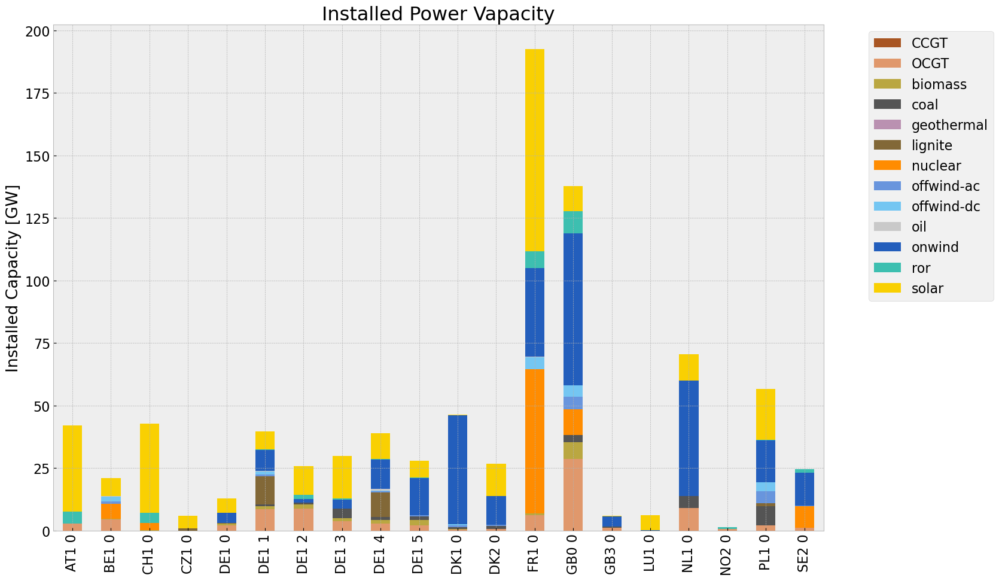

<Figure size 640x480 with 0 Axes>

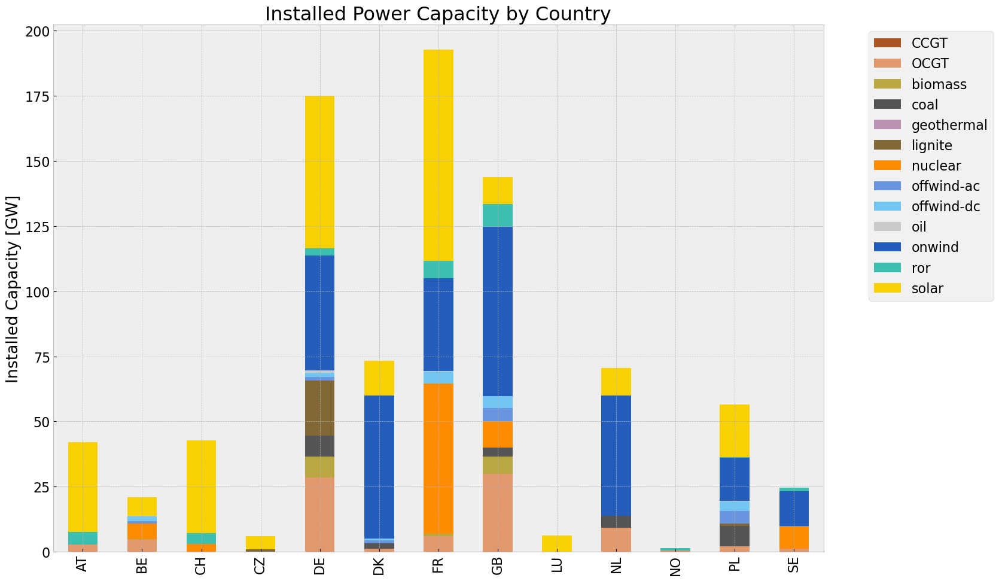

In [90]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



## Generation

<Figure size 640x480 with 0 Axes>

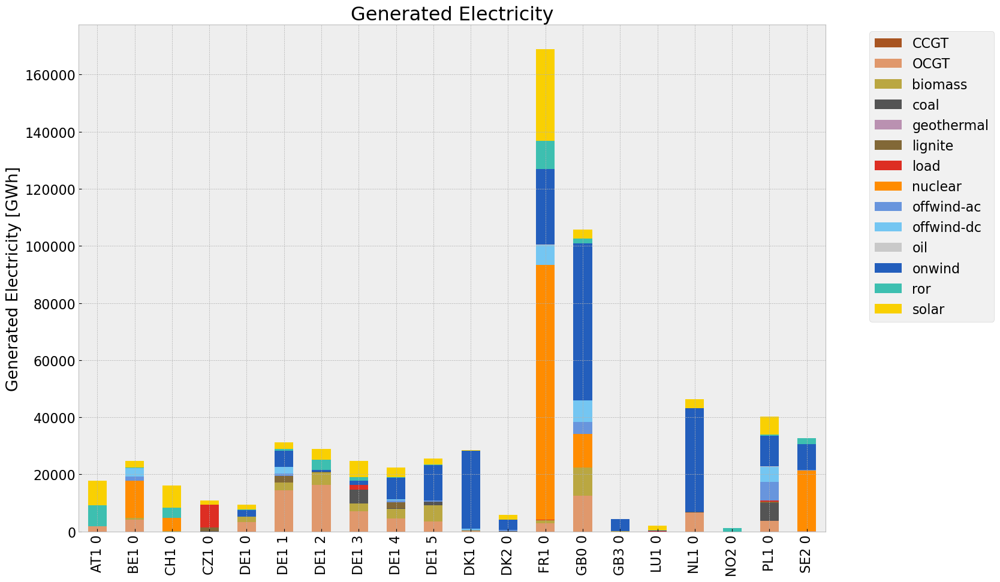

<Figure size 640x480 with 0 Axes>

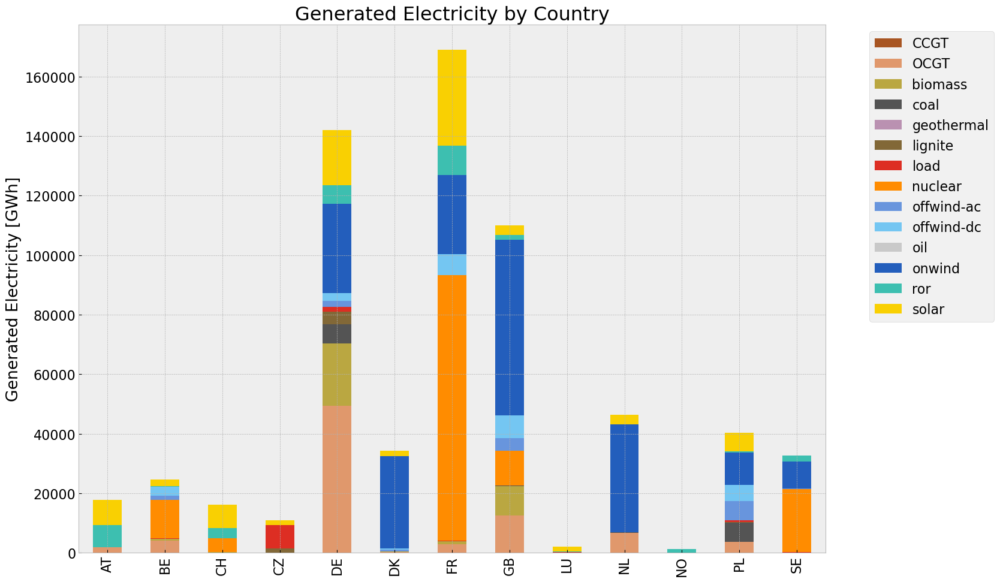

In [91]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2,colors_gen_table)
gen_noinv_country = gen_power_table_country(n2,colors_gen_table)


## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2796143640.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2796143640.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum(

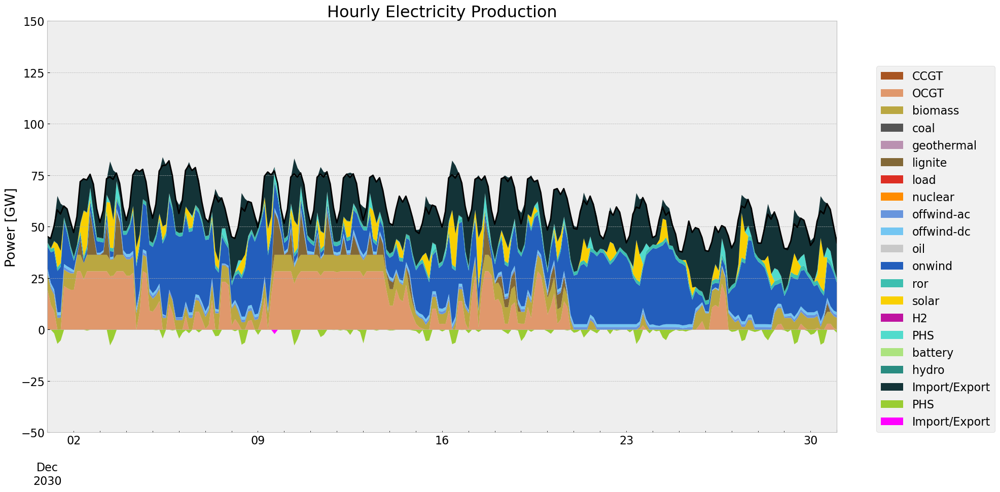

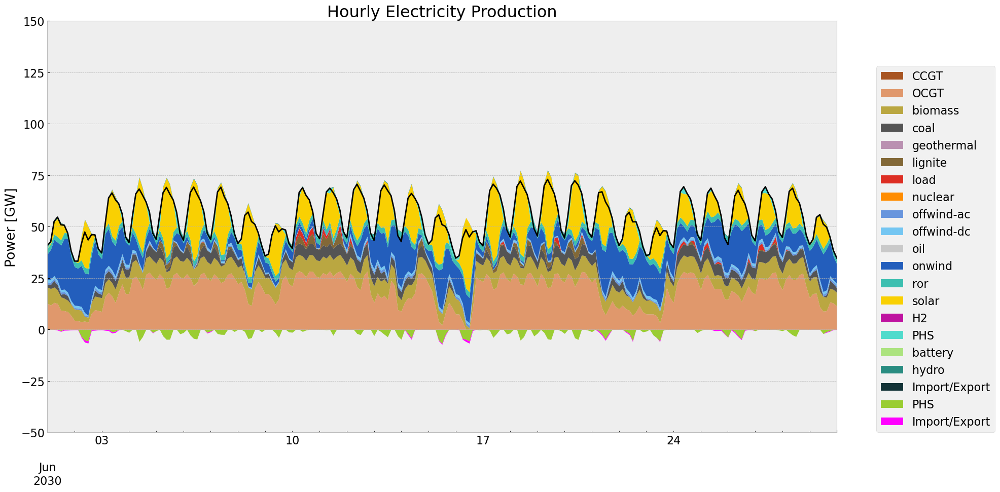

In [92]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='

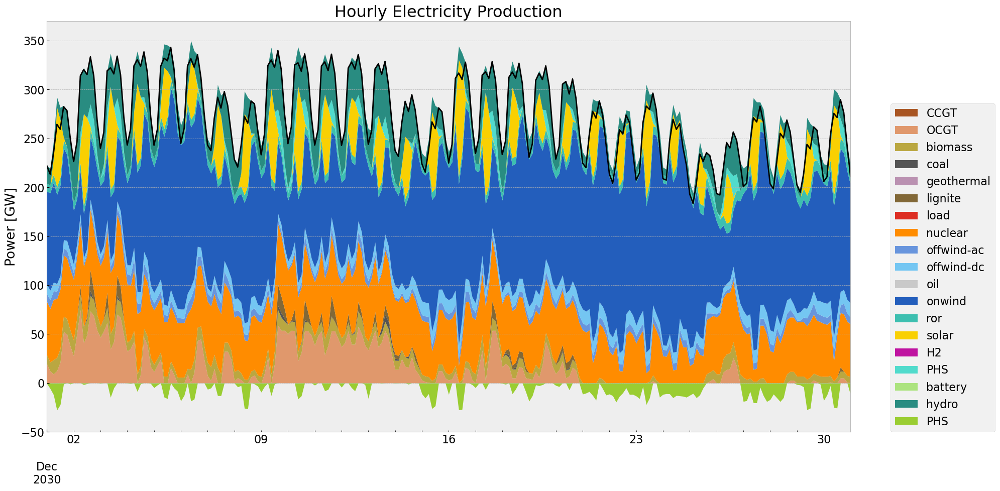

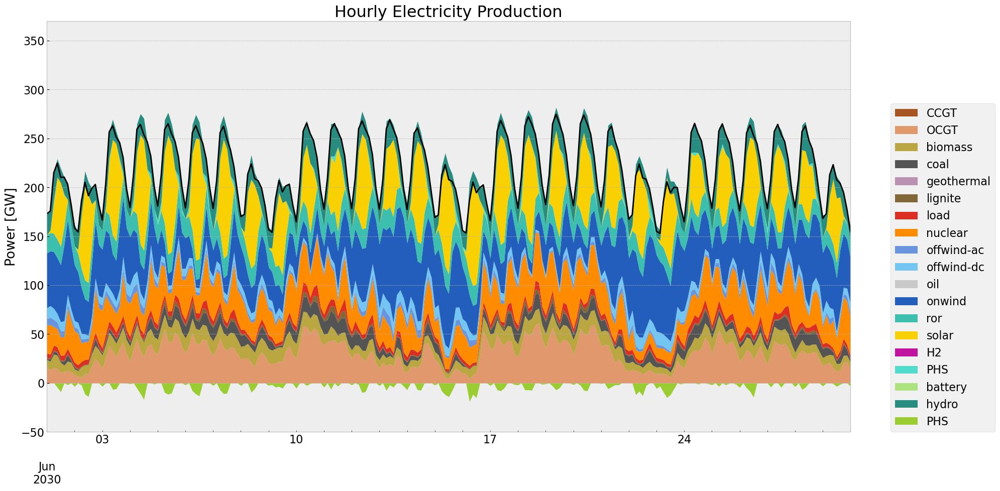

In [93]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

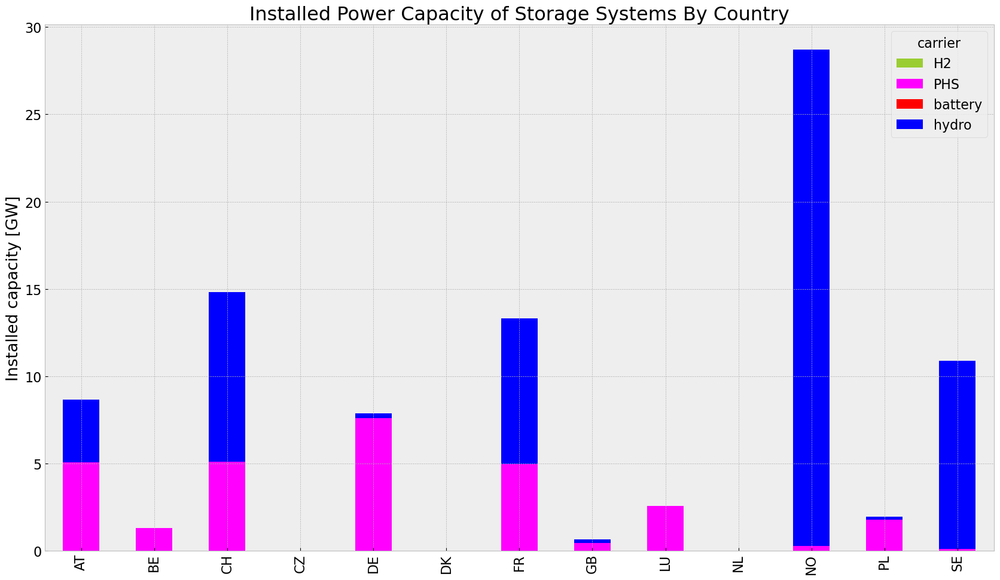

In [94]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\1117423567.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\1117423567.py:3: FutureWarning: 'H' is deprecated and will be removed in a future v

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,8.148507e+07,0.451621,0.1980,3.572476e+07
biomass,3.276920e+07,0.468000,0.0000,0.000000e+00
coal,1.333151e+07,0.329908,0.3361,1.358173e+07
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,6.024944e+06,0.337285,0.4069,7.268487e+06
load,1.051629e+07,1.000000,0.0000,0.000000e+00
nuclear,1.396030e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.540989e+07,1.000000,0.0000,0.000000e+00


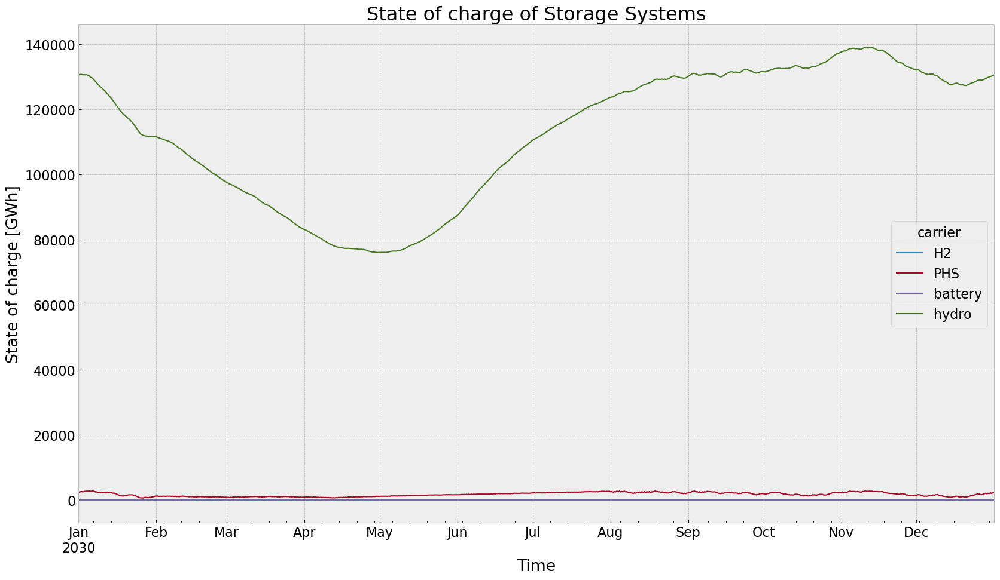

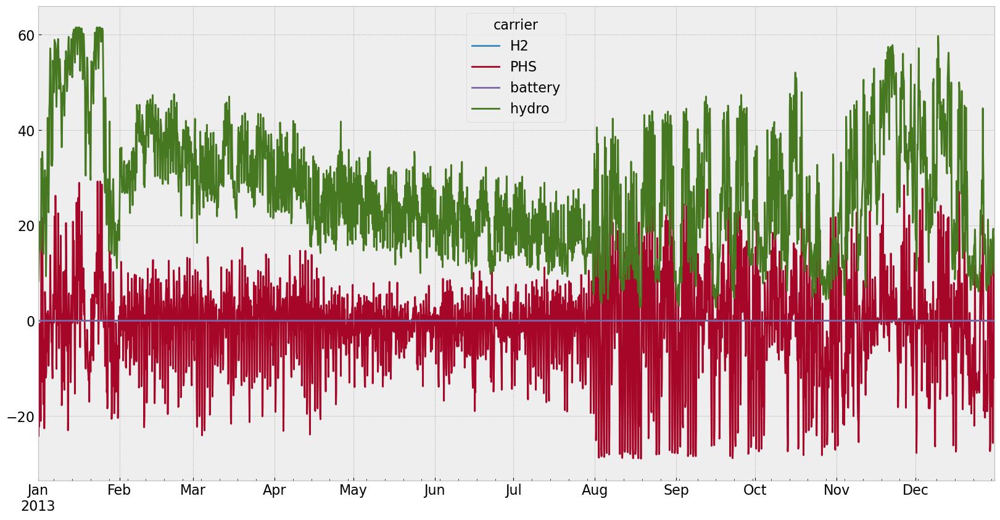

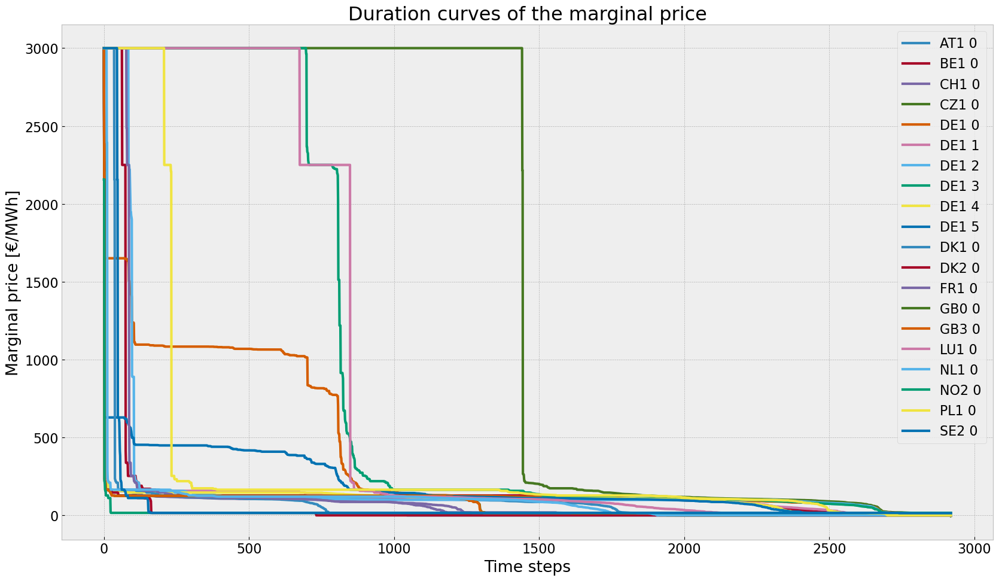

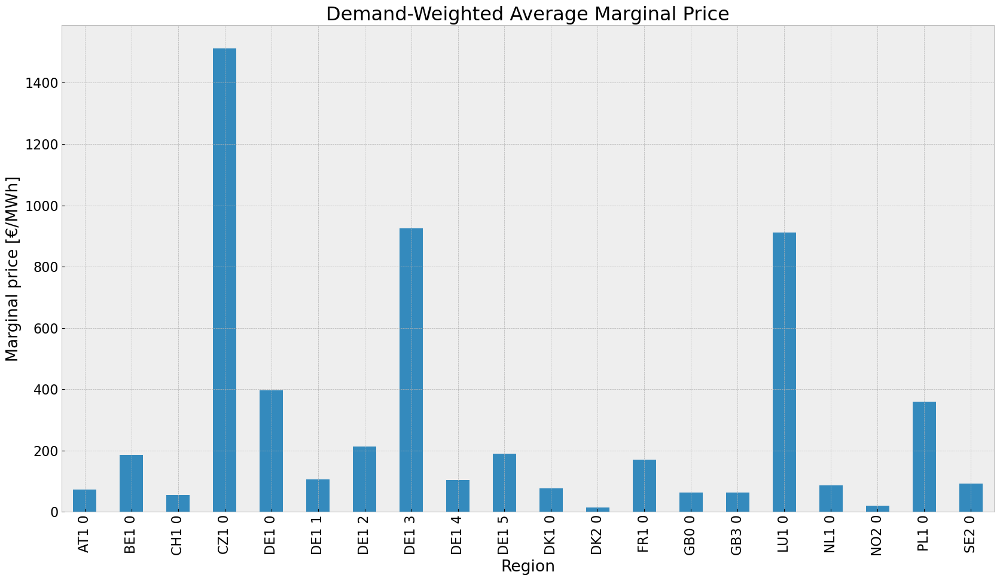

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


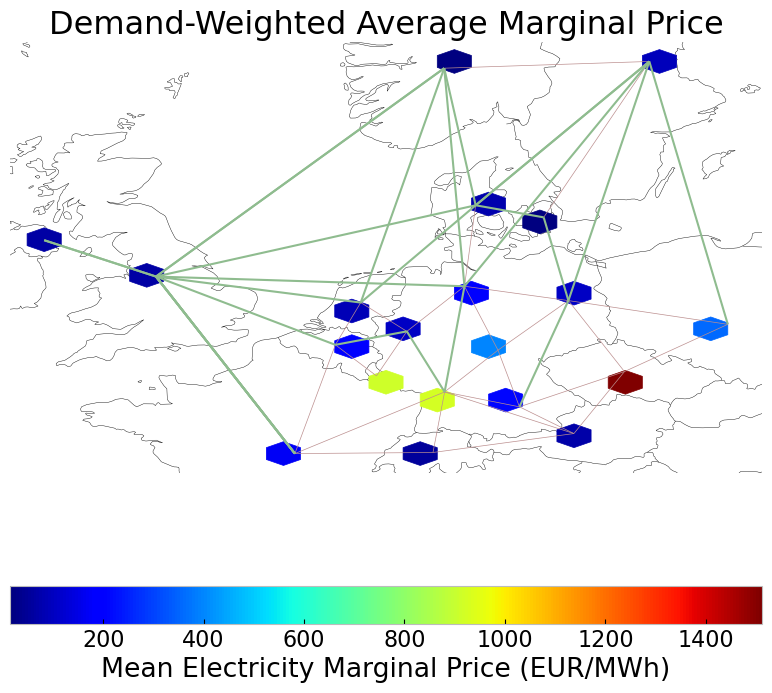

In [95]:
#state of charge
state_of_charge_plot(n2)
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [68]:
n3= n2.copy()
n3.name = 'noinv_roll_noexim'
horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#n3 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\No_Exim\\20240512\\noinv_roll_noexim.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xt214qoc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xt214qoc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3e1143ff


INFO:gurobipy:Model fingerprint: 0x3e1143ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25506 rows and 7247 columns


INFO:gurobipy:Presolve removed 25506 rows and 7247 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1326 rows, 5257 columns, 8826 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5257 columns, 8826 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


 Factor Ops : 1.344e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.344e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04241454e+11 -5.21982060e+11  8.83e+04 1.14e+04  5.13e+08     0s


INFO:gurobipy:   0   2.04241454e+11 -5.21982060e+11  8.83e+04 1.14e+04  5.13e+08     0s


   1   4.13826371e+10 -2.72086826e+11  1.09e+04 7.28e-11  7.77e+07     0s


INFO:gurobipy:   1   4.13826371e+10 -2.72086826e+11  1.09e+04 7.28e-11  7.77e+07     0s


   2   6.66154104e+09 -7.41310582e+10  6.66e+02 7.28e-11  9.83e+06     0s


INFO:gurobipy:   2   6.66154104e+09 -7.41310582e+10  6.66e+02 7.28e-11  9.83e+06     0s


   3   1.94993210e+09 -1.46243718e+10  1.26e+02 8.88e-10  1.76e+06     0s


INFO:gurobipy:   3   1.94993210e+09 -1.46243718e+10  1.26e+02 8.88e-10  1.76e+06     0s


   4   7.13912028e+08 -3.24736808e+09  1.76e+01 2.33e-10  3.90e+05     0s


INFO:gurobipy:   4   7.13912028e+08 -3.24736808e+09  1.76e+01 2.33e-10  3.90e+05     0s


   5   4.53030983e+08 -9.34377646e+08  6.43e+00 5.82e-11  1.34e+05     0s


INFO:gurobipy:   5   4.53030983e+08 -9.34377646e+08  6.43e+00 5.82e-11  1.34e+05     0s


   6   2.96201256e+08 -2.69034659e+08  2.56e+00 2.91e-11  5.42e+04     0s


INFO:gurobipy:   6   2.96201256e+08 -2.69034659e+08  2.56e+00 2.91e-11  5.42e+04     0s


   7   2.07981565e+08 -5.62923004e+07  7.43e-01 2.77e-11  2.52e+04     0s


INFO:gurobipy:   7   2.07981565e+08 -5.62923004e+07  7.43e-01 2.77e-11  2.52e+04     0s


   8   1.92106253e+08  3.61294740e+07  4.89e-01 2.08e-11  1.49e+04     0s


INFO:gurobipy:   8   1.92106253e+08  3.61294740e+07  4.89e-01 2.08e-11  1.49e+04     0s


   9   1.71923334e+08  1.19392769e+08  1.48e-01 2.91e-11  5.00e+03     0s


INFO:gurobipy:   9   1.71923334e+08  1.19392769e+08  1.48e-01 2.91e-11  5.00e+03     0s


  10   1.61483277e+08  1.46777585e+08  1.17e-02 2.91e-11  1.40e+03     0s


INFO:gurobipy:  10   1.61483277e+08  1.46777585e+08  1.17e-02 2.91e-11  1.40e+03     0s


  11   1.58994387e+08  1.53046750e+08  2.55e-03 2.97e-11  5.65e+02     0s


INFO:gurobipy:  11   1.58994387e+08  1.53046750e+08  2.55e-03 2.97e-11  5.65e+02     0s


  12   1.58163427e+08  1.55971306e+08  9.99e-04 2.50e-11  2.08e+02     0s


INFO:gurobipy:  12   1.58163427e+08  1.55971306e+08  9.99e-04 2.50e-11  2.08e+02     0s


  13   1.57816999e+08  1.56975765e+08  4.01e-04 2.91e-11  7.99e+01     0s


INFO:gurobipy:  13   1.57816999e+08  1.56975765e+08  4.01e-04 2.91e-11  7.99e+01     0s


  14   1.57670911e+08  1.57282749e+08  1.72e-04 2.91e-11  3.69e+01     0s


INFO:gurobipy:  14   1.57670911e+08  1.57282749e+08  1.72e-04 2.91e-11  3.69e+01     0s


  15   1.57585434e+08  1.57483371e+08  3.79e-05 3.07e-11  9.70e+00     0s


INFO:gurobipy:  15   1.57585434e+08  1.57483371e+08  3.79e-05 3.07e-11  9.70e+00     0s


  16   1.57559317e+08  1.57547483e+08  6.31e-06 3.32e-11  1.12e+00     0s


INFO:gurobipy:  16   1.57559317e+08  1.57547483e+08  6.31e-06 3.32e-11  1.12e+00     0s


  17   1.57553796e+08  1.57551326e+08  6.15e-07 2.91e-11  2.35e-01     0s


INFO:gurobipy:  17   1.57553796e+08  1.57551326e+08  6.15e-07 2.91e-11  2.35e-01     0s


  18   1.57553268e+08  1.57552615e+08  1.64e-07 1.85e-11  6.21e-02     0s


INFO:gurobipy:  18   1.57553268e+08  1.57552615e+08  1.64e-07 1.85e-11  6.21e-02     0s


  19   1.57553125e+08  1.57552913e+08  5.96e-08 2.91e-11  2.02e-02     0s


INFO:gurobipy:  19   1.57553125e+08  1.57552913e+08  5.96e-08 2.91e-11  2.02e-02     0s


  20   1.57553075e+08  1.57553023e+08  2.02e-08 4.37e-11  4.99e-03     0s


INFO:gurobipy:  20   1.57553075e+08  1.57553023e+08  2.02e-08 4.37e-11  4.99e-03     0s


  21   1.57553048e+08  1.57553045e+08  1.42e-08 2.91e-11  2.83e-04     0s


INFO:gurobipy:  21   1.57553048e+08  1.57553045e+08  1.42e-08 2.91e-11  2.83e-04     0s


  22   1.57553047e+08  1.57553047e+08  4.52e-09 2.91e-11  5.37e-06     0s


INFO:gurobipy:  22   1.57553047e+08  1.57553047e+08  4.52e-09 2.91e-11  5.37e-06     0s


  23   1.57553047e+08  1.57553047e+08  3.61e-09 2.91e-11  6.82e-08     0s


INFO:gurobipy:  23   1.57553047e+08  1.57553047e+08  3.61e-09 2.91e-11  6.82e-08     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1933    1.5755305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1933    1.5755305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1933 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1933 iterations and 0.25 seconds (0.06 work units)


Optimal objective  1.575530467e+08


INFO:gurobipy:Optimal objective  1.575530467e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2wnktmg2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2wnktmg2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x034867e1


INFO:gurobipy:Model fingerprint: 0x034867e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7031 columns


INFO:gurobipy:Presolve removed 25490 rows and 7031 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5473 columns, 9090 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5473 columns, 9090 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


 Factor Ops : 1.588e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.588e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26282219e+11 -5.20341425e+11  8.53e+04 1.14e+04  4.95e+08     0s


INFO:gurobipy:   0   2.26282219e+11 -5.20341425e+11  8.53e+04 1.14e+04  4.95e+08     0s


   1   4.73648387e+10 -2.77044347e+11  1.04e+04 7.28e-11  7.53e+07     0s


INFO:gurobipy:   1   4.73648387e+10 -2.77044347e+11  1.04e+04 7.28e-11  7.53e+07     0s


   2   8.83927117e+09 -7.09364057e+10  6.95e+02 1.74e+02  9.52e+06     0s


INFO:gurobipy:   2   8.83927117e+09 -7.09364057e+10  6.95e+02 1.74e+02  9.52e+06     0s


   3   2.44295641e+09 -1.21888882e+10  9.78e+01 2.47e-10  1.49e+06     0s


INFO:gurobipy:   3   2.44295641e+09 -1.21888882e+10  9.78e+01 2.47e-10  1.49e+06     0s


   4   1.43378101e+09 -2.57481348e+09  3.63e+01 1.89e-10  3.95e+05     0s


INFO:gurobipy:   4   1.43378101e+09 -2.57481348e+09  3.63e+01 1.89e-10  3.95e+05     0s


   5   9.17511386e+08 -5.91929271e+08  1.35e+01 1.60e-10  1.44e+05     0s


INFO:gurobipy:   5   9.17511386e+08 -5.91929271e+08  1.35e+01 1.60e-10  1.44e+05     0s


   6   7.35733632e+08  8.44111859e+06  7.02e+00 7.28e-11  6.87e+04     0s


INFO:gurobipy:   6   7.35733632e+08  8.44111859e+06  7.02e+00 7.28e-11  6.87e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1625    4.6632198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1625    4.6632198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1625 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1625 iterations and 0.22 seconds (0.05 work units)


Optimal objective  4.663219780e+08


INFO:gurobipy:Optimal objective  4.663219780e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vrs5i92.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vrs5i92.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x67828af9


INFO:gurobipy:Model fingerprint: 0x67828af9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 7054 columns


INFO:gurobipy:Presolve removed 25488 rows and 7054 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5450 columns, 9073 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5450 columns, 9073 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64857572e+11 -5.02292307e+11  9.18e+04 1.39e+04  5.25e+08     0s


INFO:gurobipy:   0   2.64857572e+11 -5.02292307e+11  9.18e+04 1.39e+04  5.25e+08     0s


   1   5.88873881e+10 -2.67732804e+11  1.17e+04 7.28e-11  8.09e+07     0s


INFO:gurobipy:   1   5.88873881e+10 -2.67732804e+11  1.17e+04 7.28e-11  8.09e+07     0s


   2   1.40936083e+10 -6.42334191e+10  7.46e+02 7.28e-11  9.61e+06     0s


INFO:gurobipy:   2   1.40936083e+10 -6.42334191e+10  7.46e+02 7.28e-11  9.61e+06     0s


   3   6.66122863e+09 -1.60306457e+10  1.79e+02 3.93e-10  2.44e+06     0s


INFO:gurobipy:   3   6.66122863e+09 -1.60306457e+10  1.79e+02 3.93e-10  2.44e+06     0s


   4   4.21406475e+09 -3.73458527e+09  7.71e+01 2.47e-10  8.27e+05     0s


INFO:gurobipy:   4   4.21406475e+09 -3.73458527e+09  7.71e+01 2.47e-10  8.27e+05     0s


   5   3.08850139e+09 -3.38046182e+07  3.94e+01 2.62e-10  3.20e+05     0s


INFO:gurobipy:   5   3.08850139e+09 -3.38046182e+07  3.94e+01 2.62e-10  3.20e+05     0s


   6   2.63967297e+09  1.05497972e+09  2.06e+01 1.46e-10  1.59e+05     0s


INFO:gurobipy:   6   2.63967297e+09  1.05497972e+09  2.06e+01 1.46e-10  1.59e+05     0s


   7   2.33568386e+09  1.85786014e+09  5.21e+00 1.16e-10  4.64e+04     0s


INFO:gurobipy:   7   2.33568386e+09  1.85786014e+09  5.21e+00 1.16e-10  4.64e+04     0s


   8   2.27087154e+09  2.00700418e+09  2.91e+00 5.82e-11  2.55e+04     0s


INFO:gurobipy:   8   2.27087154e+09  2.00700418e+09  2.91e+00 5.82e-11  2.55e+04     0s


   9   2.24300000e+09  2.08385321e+09  2.02e+00 7.28e-11  1.54e+04     0s


INFO:gurobipy:   9   2.24300000e+09  2.08385321e+09  2.02e+00 7.28e-11  1.54e+04     0s


  10   2.18578650e+09  2.13034740e+09  3.48e-01 5.82e-11  5.21e+03     0s


INFO:gurobipy:  10   2.18578650e+09  2.13034740e+09  3.48e-01 5.82e-11  5.21e+03     0s


  11   2.17480518e+09  2.14930061e+09  1.55e-01 5.82e-11  2.39e+03     0s


INFO:gurobipy:  11   2.17480518e+09  2.14930061e+09  1.55e-01 5.82e-11  2.39e+03     0s


  12   2.17039992e+09  2.15701190e+09  8.68e-02 2.91e-11  1.26e+03     0s


INFO:gurobipy:  12   2.17039992e+09  2.15701190e+09  8.68e-02 2.91e-11  1.26e+03     0s


  13   2.16635856e+09  2.16088126e+09  2.78e-02 2.91e-11  5.12e+02     0s


INFO:gurobipy:  13   2.16635856e+09  2.16088126e+09  2.78e-02 2.91e-11  5.12e+02     0s


  14   2.16505897e+09  2.16284771e+09  1.02e-02 3.03e-11  2.06e+02     0s


INFO:gurobipy:  14   2.16505897e+09  2.16284771e+09  1.02e-02 3.03e-11  2.06e+02     0s


  15   2.16441514e+09  2.16388790e+09  1.76e-03 2.91e-11  4.89e+01     0s


INFO:gurobipy:  15   2.16441514e+09  2.16388790e+09  1.76e-03 2.91e-11  4.89e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1736    2.1642518e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1736    2.1642518e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1736 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1736 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.164251827e+09


INFO:gurobipy:Optimal objective  2.164251827e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwwh7f4h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwwh7f4h.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x81025e28


INFO:gurobipy:Model fingerprint: 0x81025e28


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 7012 columns


INFO:gurobipy:Presolve removed 25488 rows and 7012 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5492 columns, 9115 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5492 columns, 9115 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65888249e+11 -5.12668918e+11  5.56e+04 1.44e+04  3.38e+08     0s


INFO:gurobipy:   0   1.65888249e+11 -5.12668918e+11  5.56e+04 1.44e+04  3.38e+08     0s


   1   3.92901440e+10 -2.30660053e+11  6.23e+03 5.82e-11  5.09e+07     0s


INFO:gurobipy:   1   3.92901440e+10 -2.30660053e+11  6.23e+03 5.82e-11  5.09e+07     0s


   2   1.04930116e+10 -5.56712191e+10  4.10e+02 3.84e+02  7.25e+06     0s


INFO:gurobipy:   2   1.04930116e+10 -5.56712191e+10  4.10e+02 3.84e+02  7.25e+06     0s


   3   3.80969691e+09 -1.07121039e+10  7.27e+01 1.03e-09  1.43e+06     0s


INFO:gurobipy:   3   3.80969691e+09 -1.07121039e+10  7.27e+01 1.03e-09  1.43e+06     0s


   4   2.68598226e+09 -2.28883931e+09  3.31e+01 3.71e-10  4.81e+05     0s


INFO:gurobipy:   4   2.68598226e+09 -2.28883931e+09  3.31e+01 3.71e-10  4.81e+05     0s


   5   2.24506463e+09  2.58510303e+08  1.26e+01 1.89e-10  1.87e+05     0s


INFO:gurobipy:   5   2.24506463e+09  2.58510303e+08  1.26e+01 1.89e-10  1.87e+05     0s


   6   2.06345426e+09  1.35043442e+09  5.19e+00 6.55e-11  6.65e+04     0s


INFO:gurobipy:   6   2.06345426e+09  1.35043442e+09  5.19e+00 6.55e-11  6.65e+04     0s


   7   1.90606375e+09  1.69123132e+09  7.25e-01 4.37e-11  1.97e+04     0s


INFO:gurobipy:   7   1.90606375e+09  1.69123132e+09  7.25e-01 4.37e-11  1.97e+04     0s


   8   1.88115847e+09  1.77046857e+09  4.38e-01 2.91e-11  1.02e+04     0s


INFO:gurobipy:   8   1.88115847e+09  1.77046857e+09  4.38e-01 2.91e-11  1.02e+04     0s


   9   1.85152230e+09  1.79686151e+09  1.38e-01 2.91e-11  5.00e+03     0s


INFO:gurobipy:   9   1.85152230e+09  1.79686151e+09  1.38e-01 2.91e-11  5.00e+03     0s


  10   1.84280899e+09  1.81528955e+09  6.24e-02 2.26e-11  2.51e+03     0s


INFO:gurobipy:  10   1.84280899e+09  1.81528955e+09  6.24e-02 2.26e-11  2.51e+03     0s


  11   1.83790531e+09  1.82348607e+09  2.33e-02 2.91e-11  1.32e+03     0s


INFO:gurobipy:  11   1.83790531e+09  1.82348607e+09  2.33e-02 2.91e-11  1.32e+03     0s


  12   1.83671570e+09  1.82562009e+09  1.54e-02 2.91e-11  1.01e+03     0s


INFO:gurobipy:  12   1.83671570e+09  1.82562009e+09  1.54e-02 2.91e-11  1.01e+03     0s


  13   1.83603747e+09  1.83020504e+09  1.10e-02 2.91e-11  5.32e+02     0s


INFO:gurobipy:  13   1.83603747e+09  1.83020504e+09  1.10e-02 2.91e-11  5.32e+02     0s


  14   1.83543939e+09  1.83213882e+09  7.33e-03 2.91e-11  3.01e+02     0s


INFO:gurobipy:  14   1.83543939e+09  1.83213882e+09  7.33e-03 2.91e-11  3.01e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1642    1.8341509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1642    1.8341509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1642 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1642 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.834150870e+09


INFO:gurobipy:Optimal objective  1.834150870e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l8h06mji.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l8h06mji.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x91c21997


INFO:gurobipy:Model fingerprint: 0x91c21997


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25489 rows and 7042 columns


INFO:gurobipy:Presolve removed 25489 rows and 7042 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1343 rows, 5462 columns, 9079 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5462 columns, 9079 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.55607579e+11 -4.99775732e+11  8.86e+04 1.39e+04  5.04e+08     0s


INFO:gurobipy:   0   2.55607579e+11 -4.99775732e+11  8.86e+04 1.39e+04  5.04e+08     0s


   1   5.80339706e+10 -2.65187554e+11  1.13e+04 7.28e-11  7.85e+07     0s


INFO:gurobipy:   1   5.80339706e+10 -2.65187554e+11  1.13e+04 7.28e-11  7.85e+07     0s


   2   1.42105367e+10 -6.59877202e+10  7.08e+02 8.73e-11  9.64e+06     0s


INFO:gurobipy:   2   1.42105367e+10 -6.59877202e+10  7.08e+02 8.73e-11  9.64e+06     0s


   3   7.61831725e+09 -1.55886806e+10  1.78e+02 3.20e-10  2.48e+06     0s


INFO:gurobipy:   3   7.61831725e+09 -1.55886806e+10  1.78e+02 3.20e-10  2.48e+06     0s


   4   5.31261793e+09 -3.36222817e+09  8.28e+01 3.49e-10  9.02e+05     0s


INFO:gurobipy:   4   5.31261793e+09 -3.36222817e+09  8.28e+01 3.49e-10  9.02e+05     0s


   5   4.14804541e+09  5.26745677e+08  3.82e+01 2.62e-10  3.66e+05     0s


INFO:gurobipy:   5   4.14804541e+09  5.26745677e+08  3.82e+01 2.62e-10  3.66e+05     0s


   6   3.68741086e+09  2.01693049e+09  1.71e+01 1.60e-10  1.64e+05     0s


INFO:gurobipy:   6   3.68741086e+09  2.01693049e+09  1.71e+01 1.60e-10  1.64e+05     0s


   7   3.47799173e+09  3.03848564e+09  4.17e+00 1.16e-10  4.16e+04     0s


INFO:gurobipy:   7   3.47799173e+09  3.03848564e+09  4.17e+00 1.16e-10  4.16e+04     0s


   8   3.43247172e+09  3.18300126e+09  2.42e+00 5.82e-11  2.35e+04     0s


INFO:gurobipy:   8   3.43247172e+09  3.18300126e+09  2.42e+00 5.82e-11  2.35e+04     0s


   9   3.41281052e+09  3.25810058e+09  1.79e+00 4.37e-11  1.46e+04     0s


INFO:gurobipy:   9   3.41281052e+09  3.25810058e+09  1.79e+00 4.37e-11  1.46e+04     0s


  10   3.35696826e+09  3.30909387e+09  2.30e-01 2.91e-11  4.43e+03     0s


INFO:gurobipy:  10   3.35696826e+09  3.30909387e+09  2.30e-01 2.91e-11  4.43e+03     0s


  11   3.34665883e+09  3.31929389e+09  8.95e-02 2.91e-11  2.52e+03     0s


INFO:gurobipy:  11   3.34665883e+09  3.31929389e+09  8.95e-02 2.91e-11  2.52e+03     0s


  12   3.34511263e+09  3.32523507e+09  7.22e-02 2.91e-11  1.83e+03     0s


INFO:gurobipy:  12   3.34511263e+09  3.32523507e+09  7.22e-02 2.91e-11  1.83e+03     0s


  13   3.34400336e+09  3.32863636e+09  6.05e-02 2.91e-11  1.42e+03     0s


INFO:gurobipy:  13   3.34400336e+09  3.32863636e+09  6.05e-02 2.91e-11  1.42e+03     0s


  14   3.34112200e+09  3.33022926e+09  3.07e-02 3.41e-11  1.00e+03     0s


INFO:gurobipy:  14   3.34112200e+09  3.33022926e+09  3.07e-02 3.41e-11  1.00e+03     0s


  15   3.33988560e+09  3.33363218e+09  1.88e-02 2.91e-11  5.75e+02     0s


INFO:gurobipy:  15   3.33988560e+09  3.33363218e+09  1.88e-02 2.91e-11  5.75e+02     0s


  16   3.33850944e+09  3.33642942e+09  6.63e-03 4.37e-11  1.91e+02     0s


INFO:gurobipy:  16   3.33850944e+09  3.33642942e+09  6.63e-03 4.37e-11  1.91e+02     0s


  17   3.33806397e+09  3.33709982e+09  3.15e-03 2.91e-11  8.87e+01     0s


INFO:gurobipy:  17   3.33806397e+09  3.33709982e+09  3.15e-03 2.91e-11  8.87e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1557    3.3376665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1557    3.3376665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1557 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1557 iterations and 0.30 seconds (0.05 work units)


Optimal objective  3.337666524e+09


INFO:gurobipy:Optimal objective  3.337666524e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jqoupzx1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jqoupzx1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8b15575e


INFO:gurobipy:Model fingerprint: 0x8b15575e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25500 rows and 7129 columns


INFO:gurobipy:Presolve removed 25500 rows and 7129 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1332 rows, 5375 columns, 8969 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5375 columns, 8969 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.566e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.566e+04 (roughly 3 MB of memory)


 Factor Ops : 1.695e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.695e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.50905467e+11 -4.99170839e+11  8.84e+04 1.55e+04  5.06e+08     0s


INFO:gurobipy:   0   2.50905467e+11 -4.99170839e+11  8.84e+04 1.55e+04  5.06e+08     0s


   1   6.02460504e+10 -2.66202320e+11  1.13e+04 7.28e-11  7.97e+07     0s


INFO:gurobipy:   1   6.02460504e+10 -2.66202320e+11  1.13e+04 7.28e-11  7.97e+07     0s


   2   1.76459119e+10 -5.98131702e+10  7.53e+02 4.81e+01  9.67e+06     0s


INFO:gurobipy:   2   1.76459119e+10 -5.98131702e+10  7.53e+02 4.81e+01  9.67e+06     0s


   3   1.12596102e+10 -7.88151022e+09  1.85e+02 4.07e-10  2.15e+06     0s


INFO:gurobipy:   3   1.12596102e+10 -7.88151022e+09  1.85e+02 4.07e-10  2.15e+06     0s


   4   8.42518611e+09  2.46706111e+09  6.08e+01 3.64e-10  6.41e+05     0s


INFO:gurobipy:   4   8.42518611e+09  2.46706111e+09  6.08e+01 3.64e-10  6.41e+05     0s


   5   7.46530401e+09  4.68005728e+09  2.71e+01 1.89e-10  2.90e+05     0s


INFO:gurobipy:   5   7.46530401e+09  4.68005728e+09  2.71e+01 1.89e-10  2.90e+05     0s


   6   7.12903168e+09  5.77393555e+09  1.46e+01 1.31e-10  1.40e+05     0s


INFO:gurobipy:   6   7.12903168e+09  5.77393555e+09  1.46e+01 1.31e-10  1.40e+05     0s


   7   6.88790829e+09  6.17157051e+09  5.49e+00 1.60e-10  7.14e+04     0s


INFO:gurobipy:   7   6.88790829e+09  6.17157051e+09  5.49e+00 1.60e-10  7.14e+04     0s


   8   6.82896302e+09  6.42728293e+09  3.65e+00 7.28e-11  4.03e+04     0s


INFO:gurobipy:   8   6.82896302e+09  6.42728293e+09  3.65e+00 7.28e-11  4.03e+04     0s


   9   6.77092450e+09  6.55396596e+09  1.94e+00 4.37e-11  2.17e+04     0s


INFO:gurobipy:   9   6.77092450e+09  6.55396596e+09  1.94e+00 4.37e-11  2.17e+04     0s


  10   6.72791564e+09  6.60833448e+09  7.25e-01 4.37e-11  1.17e+04     0s


INFO:gurobipy:  10   6.72791564e+09  6.60833448e+09  7.25e-01 4.37e-11  1.17e+04     0s


  11   6.71319524e+09  6.66238006e+09  3.60e-01 2.91e-11  4.98e+03     0s


INFO:gurobipy:  11   6.71319524e+09  6.66238006e+09  3.60e-01 2.91e-11  4.98e+03     0s


  12   6.71061442e+09  6.67699121e+09  3.03e-01 2.91e-11  3.34e+03     0s


INFO:gurobipy:  12   6.71061442e+09  6.67699121e+09  3.03e-01 2.91e-11  3.34e+03     0s


  13   6.70709840e+09  6.68766146e+09  2.28e-01 2.91e-11  1.97e+03     0s


INFO:gurobipy:  13   6.70709840e+09  6.68766146e+09  2.28e-01 2.91e-11  1.97e+03     0s


  14   6.70398933e+09  6.69114993e+09  1.63e-01 2.91e-11  1.31e+03     0s


INFO:gurobipy:  14   6.70398933e+09  6.69114993e+09  1.63e-01 2.91e-11  1.31e+03     0s


  15   6.69990294e+09  6.69390177e+09  7.94e-02 4.37e-11  6.14e+02     0s


INFO:gurobipy:  15   6.69990294e+09  6.69390177e+09  7.94e-02 4.37e-11  6.14e+02     0s


  16   6.69780208e+09  6.69510931e+09  3.77e-02 3.81e-11  2.77e+02     0s


INFO:gurobipy:  16   6.69780208e+09  6.69510931e+09  3.77e-02 3.81e-11  2.77e+02     0s


  17   6.69643836e+09  6.69586834e+09  6.95e-03 2.91e-11  5.79e+01     0s


INFO:gurobipy:  17   6.69643836e+09  6.69586834e+09  6.95e-03 2.91e-11  5.79e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    6.6960779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    6.6960779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.25 seconds (0.05 work units)


Optimal objective  6.696077858e+09


INFO:gurobipy:Optimal objective  6.696077858e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9yh2uu_6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9yh2uu_6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x22b333d3


INFO:gurobipy:Model fingerprint: 0x22b333d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7154 columns


INFO:gurobipy:Presolve removed 25492 rows and 7154 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5350 columns, 8960 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5350 columns, 8960 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


 Factor Ops : 1.708e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.708e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11988749e+11 -5.09158460e+11  8.12e+04 1.19e+04  4.73e+08     0s


INFO:gurobipy:   0   2.11988749e+11 -5.09158460e+11  8.12e+04 1.19e+04  4.73e+08     0s


   1   4.63804182e+10 -2.60547400e+11  1.04e+04 7.28e-11  7.40e+07     0s


INFO:gurobipy:   1   4.63804182e+10 -2.60547400e+11  1.04e+04 7.28e-11  7.40e+07     0s


   2   1.12221216e+10 -6.73454169e+10  7.56e+02 1.02e-10  9.79e+06     0s


INFO:gurobipy:   2   1.12221216e+10 -6.73454169e+10  7.56e+02 1.02e-10  9.79e+06     0s


   3   4.94963077e+09 -1.50116695e+10  1.87e+02 2.28e-09  2.20e+06     0s


INFO:gurobipy:   3   4.94963077e+09 -1.50116695e+10  1.87e+02 2.28e-09  2.20e+06     0s


   4   3.28877808e+09 -6.91441546e+08  5.96e+01 5.68e-10  4.26e+05     0s


INFO:gurobipy:   4   3.28877808e+09 -6.91441546e+08  5.96e+01 5.68e-10  4.26e+05     0s


   5   2.83469995e+09  9.40231583e+08  2.98e+01 2.76e-10  1.96e+05     0s


INFO:gurobipy:   5   2.83469995e+09  9.40231583e+08  2.98e+01 2.76e-10  1.96e+05     0s


   6   2.66330263e+09  1.57073279e+09  1.96e+01 1.46e-10  1.11e+05     0s


INFO:gurobipy:   6   2.66330263e+09  1.57073279e+09  1.96e+01 1.46e-10  1.11e+05     0s


   7   2.43322597e+09  1.91485954e+09  7.10e+00 1.60e-10  5.08e+04     0s


INFO:gurobipy:   7   2.43322597e+09  1.91485954e+09  7.10e+00 1.60e-10  5.08e+04     0s


   8   2.37390006e+09  2.08251652e+09  4.63e+00 7.28e-11  2.85e+04     0s


INFO:gurobipy:   8   2.37390006e+09  2.08251652e+09  4.63e+00 7.28e-11  2.85e+04     0s


   9   2.31146310e+09  2.16052876e+09  2.32e+00 1.02e-10  1.46e+04     0s


INFO:gurobipy:   9   2.31146310e+09  2.16052876e+09  2.32e+00 1.02e-10  1.46e+04     0s


  10   2.27051763e+09  2.21362528e+09  9.11e-01 8.73e-11  5.48e+03     0s


INFO:gurobipy:  10   2.27051763e+09  2.21362528e+09  9.11e-01 8.73e-11  5.48e+03     0s


  11   2.25125859e+09  2.22853407e+09  3.48e-01 8.73e-11  2.18e+03     0s


INFO:gurobipy:  11   2.25125859e+09  2.22853407e+09  3.48e-01 8.73e-11  2.18e+03     0s


  12   2.24708952e+09  2.23437299e+09  2.32e-01 2.91e-11  1.23e+03     0s


INFO:gurobipy:  12   2.24708952e+09  2.23437299e+09  2.32e-01 2.91e-11  1.23e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    2.2384556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1774    2.2384556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1774 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.238455646e+09


INFO:gurobipy:Optimal objective  2.238455646e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igdvoe2n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-igdvoe2n.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x45b9ab1c


INFO:gurobipy:Model fingerprint: 0x45b9ab1c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 7121 columns


INFO:gurobipy:Presolve removed 25489 rows and 7121 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5383 columns, 9000 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5383 columns, 9000 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05495400e+11 -5.00031897e+11  6.87e+04 1.43e+04  4.03e+08     0s


INFO:gurobipy:   0   2.05495400e+11 -5.00031897e+11  6.87e+04 1.43e+04  4.03e+08     0s


   1   4.94569550e+10 -2.36052924e+11  8.43e+03 7.28e-11  6.22e+07     0s


INFO:gurobipy:   1   4.94569550e+10 -2.36052924e+11  8.43e+03 7.28e-11  6.22e+07     0s


   2   1.65244836e+10 -5.20833022e+10  5.85e+02 8.73e-11  8.20e+06     0s


INFO:gurobipy:   2   1.65244836e+10 -5.20833022e+10  5.85e+02 8.73e-11  8.20e+06     0s


   3   1.07185709e+10 -8.69543212e+09  1.67e+02 3.20e-10  2.14e+06     0s


INFO:gurobipy:   3   1.07185709e+10 -8.69543212e+09  1.67e+02 3.20e-10  2.14e+06     0s


   4   8.19786610e+09  3.42366134e+09  5.70e+01 2.91e-10  5.22e+05     0s


INFO:gurobipy:   4   8.19786610e+09  3.42366134e+09  5.70e+01 2.91e-10  5.22e+05     0s


   5   7.19475485e+09  5.40112177e+09  2.03e+01 1.31e-10  1.89e+05     0s


INFO:gurobipy:   5   7.19475485e+09  5.40112177e+09  2.03e+01 1.31e-10  1.89e+05     0s


   6   6.86250948e+09  6.16695331e+09  7.46e+00 8.73e-11  7.19e+04     0s


INFO:gurobipy:   6   6.86250948e+09  6.16695331e+09  7.46e+00 8.73e-11  7.19e+04     0s


   7   6.74854508e+09  6.48314505e+09  2.97e+00 5.82e-11  2.73e+04     0s


INFO:gurobipy:   7   6.74854508e+09  6.48314505e+09  2.97e+00 5.82e-11  2.73e+04     0s


   8   6.69751011e+09  6.59947266e+09  1.10e+00 5.82e-11  1.00e+04     0s


INFO:gurobipy:   8   6.69751011e+09  6.59947266e+09  1.10e+00 5.82e-11  1.00e+04     0s


   9   6.67287660e+09  6.65268383e+09  2.43e-01 7.28e-11  2.08e+03     0s


INFO:gurobipy:   9   6.67287660e+09  6.65268383e+09  2.43e-01 7.28e-11  2.08e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1696    6.6649866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1696    6.6649866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1696 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1696 iterations and 0.15 seconds (0.05 work units)


Optimal objective  6.664986619e+09


INFO:gurobipy:Optimal objective  6.664986619e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3rbqmav5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3rbqmav5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x398711ac


INFO:gurobipy:Model fingerprint: 0x398711ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25514 rows and 7281 columns


INFO:gurobipy:Presolve removed 25514 rows and 7281 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1318 rows, 5223 columns, 8767 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5223 columns, 8767 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.749e+03


INFO:gurobipy: AA' NZ     : 3.749e+03


 Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


 Factor Ops : 1.438e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.438e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08472896e+11 -4.96372905e+11  8.26e+04 1.67e+04  4.81e+08     0s


INFO:gurobipy:   0   2.08472896e+11 -4.96372905e+11  8.26e+04 1.67e+04  4.81e+08     0s


   1   3.04427308e+10 -2.51590951e+11  5.93e+03 7.28e-11  5.27e+07     0s


INFO:gurobipy:   1   3.04427308e+10 -2.51590951e+11  5.93e+03 7.28e-11  5.27e+07     0s


   2   1.02180698e+10 -5.62575211e+10  4.46e+02 2.76e-10  7.70e+06     0s


INFO:gurobipy:   2   1.02180698e+10 -5.62575211e+10  4.46e+02 2.76e-10  7.70e+06     0s


   3   5.91209534e+09 -1.13126744e+10  1.10e+02 5.38e-10  1.83e+06     0s


INFO:gurobipy:   3   5.91209534e+09 -1.13126744e+10  1.10e+02 5.38e-10  1.83e+06     0s


   4   4.34267292e+09  5.13384686e+07  3.07e+01 2.47e-10  4.39e+05     0s


INFO:gurobipy:   4   4.34267292e+09  5.13384686e+07  3.07e+01 2.47e-10  4.39e+05     0s


   5   3.86178690e+09  2.26349607e+09  1.16e+01 1.60e-10  1.60e+05     0s


INFO:gurobipy:   5   3.86178690e+09  2.26349607e+09  1.16e+01 1.60e-10  1.60e+05     0s


   6   3.63227682e+09  2.99822328e+09  4.57e+00 8.73e-11  6.29e+04     0s


INFO:gurobipy:   6   3.63227682e+09  2.99822328e+09  4.57e+00 8.73e-11  6.29e+04     0s


   7   3.50442843e+09  3.26648197e+09  1.16e+00 5.82e-11  2.32e+04     0s


INFO:gurobipy:   7   3.50442843e+09  3.26648197e+09  1.16e+00 5.82e-11  2.32e+04     0s


   8   3.47565756e+09  3.35416270e+09  5.97e-01 2.91e-11  1.19e+04     0s


INFO:gurobipy:   8   3.47565756e+09  3.35416270e+09  5.97e-01 2.91e-11  1.19e+04     0s


   9   3.45536442e+09  3.40395936e+09  2.33e-01 2.91e-11  5.00e+03     0s


INFO:gurobipy:   9   3.45536442e+09  3.40395936e+09  2.33e-01 2.91e-11  5.00e+03     0s


  10   3.44689024e+09  3.42880231e+09  1.03e-01 2.91e-11  1.77e+03     0s


INFO:gurobipy:  10   3.44689024e+09  3.42880231e+09  1.03e-01 2.91e-11  1.77e+03     0s


  11   3.44250673e+09  3.43520115e+09  4.46e-02 3.09e-11  7.15e+02     0s


INFO:gurobipy:  11   3.44250673e+09  3.43520115e+09  4.46e-02 3.09e-11  7.15e+02     0s


  12   3.44087108e+09  3.43674602e+09  2.38e-02 2.91e-11  4.03e+02     0s


INFO:gurobipy:  12   3.44087108e+09  3.43674602e+09  2.38e-02 2.91e-11  4.03e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1845    3.4388451e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1845    3.4388451e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1845 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1845 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.438845078e+09


INFO:gurobipy:Optimal objective  3.438845078e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ef9vq8o5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ef9vq8o5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x402af527


INFO:gurobipy:Model fingerprint: 0x402af527


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25526 rows and 7367 columns


INFO:gurobipy:Presolve removed 25526 rows and 7367 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1306 rows, 5137 columns, 8645 nonzeros


INFO:gurobipy:Presolved: 1306 rows, 5137 columns, 8645 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.719e+03


INFO:gurobipy: AA' NZ     : 3.719e+03


 Factor NZ  : 3.246e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.246e+04 (roughly 3 MB of memory)


 Factor Ops : 1.385e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.385e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18856426e+11 -5.03063156e+11  4.85e+04 1.18e+04  3.09e+08     0s


INFO:gurobipy:   0   1.18856426e+11 -5.03063156e+11  4.85e+04 1.18e+04  3.09e+08     0s


   1   1.92700404e+10 -2.23875205e+11  3.22e+03 7.28e-11  3.75e+07     0s


INFO:gurobipy:   1   1.92700404e+10 -2.23875205e+11  3.22e+03 7.28e-11  3.75e+07     0s


   2   6.25739419e+09 -4.30773737e+10  1.81e+02 2.68e+02  5.28e+06     0s


INFO:gurobipy:   2   6.25739419e+09 -4.30773737e+10  1.81e+02 2.68e+02  5.28e+06     0s


   3   2.78387438e+09 -6.90781663e+09  5.38e+01 3.06e-10  1.00e+06     0s


INFO:gurobipy:   3   2.78387438e+09 -6.90781663e+09  5.38e+01 3.06e-10  1.00e+06     0s


   4   1.60928431e+09 -6.40072599e+08  1.08e+01 1.02e-10  2.25e+05     0s


INFO:gurobipy:   4   1.60928431e+09 -6.40072599e+08  1.08e+01 1.02e-10  2.25e+05     0s


   5   1.35877454e+09  2.38080059e+08  5.47e+00 6.55e-11  1.11e+05     0s


INFO:gurobipy:   5   1.35877454e+09  2.38080059e+08  5.47e+00 6.55e-11  1.11e+05     0s


   6   1.24181182e+09  6.52935371e+08  3.29e+00 5.82e-11  5.81e+04     0s


INFO:gurobipy:   6   1.24181182e+09  6.52935371e+08  3.29e+00 5.82e-11  5.81e+04     0s


   7   1.12085062e+09  8.52927256e+08  1.09e+00 3.64e-11  2.63e+04     0s


INFO:gurobipy:   7   1.12085062e+09  8.52927256e+08  1.09e+00 3.64e-11  2.63e+04     0s


   8   1.09929641e+09  9.27206250e+08  7.69e-01 2.91e-11  1.69e+04     0s


INFO:gurobipy:   8   1.09929641e+09  9.27206250e+08  7.69e-01 2.91e-11  1.69e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.23 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.23 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1970    1.0412247e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1970    1.0412247e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1970 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1970 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.041224709e+09


INFO:gurobipy:Optimal objective  1.041224709e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3rqrvg23.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3rqrvg23.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x668797ce


INFO:gurobipy:Model fingerprint: 0x668797ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25692 rows and 8160 columns


INFO:gurobipy:Presolve removed 25692 rows and 8160 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1140 rows, 4344 columns, 6834 nonzeros


INFO:gurobipy:Presolved: 1140 rows, 4344 columns, 6834 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.462e+03


INFO:gurobipy: AA' NZ     : 2.462e+03


 Factor NZ  : 2.140e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 2.140e+04 (roughly 2 MB of memory)


 Factor Ops : 6.476e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.476e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36681511e+11 -3.35542875e+11  6.77e+04 1.34e+04  3.95e+08     0s


INFO:gurobipy:   0   1.36681511e+11 -3.35542875e+11  6.77e+04 1.34e+04  3.95e+08     0s


   1   3.08794979e+10 -1.76261502e+11  9.04e+03 7.28e-11  6.41e+07     0s


INFO:gurobipy:   1   3.08794979e+10 -1.76261502e+11  9.04e+03 7.28e-11  6.41e+07     0s


   2   8.51534969e+09 -4.92196466e+10  6.10e+02 1.98e+02  8.65e+06     0s


INFO:gurobipy:   2   8.51534969e+09 -4.92196466e+10  6.10e+02 1.98e+02  8.65e+06     0s


   3   5.29970858e+09 -7.34900912e+09  1.22e+02 5.24e-10  1.66e+06     0s


INFO:gurobipy:   3   5.29970858e+09 -7.34900912e+09  1.22e+02 5.24e-10  1.66e+06     0s


   4   4.17915453e+09  4.24393334e+08  4.05e+01 4.51e-10  4.69e+05     0s


INFO:gurobipy:   4   4.17915453e+09  4.24393334e+08  4.05e+01 4.51e-10  4.69e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1410    3.4189131e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1410    3.4189131e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1410 iterations and 0.13 seconds (0.04 work units)


INFO:gurobipy:Solved in 1410 iterations and 0.13 seconds (0.04 work units)


Optimal objective  3.418913058e+09


INFO:gurobipy:Optimal objective  3.418913058e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.42e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3o8n4zjv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3o8n4zjv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x88fdbd2c


INFO:gurobipy:Model fingerprint: 0x88fdbd2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25853 rows and 8866 columns


INFO:gurobipy:Presolve removed 25853 rows and 8866 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 979 rows, 3638 columns, 5435 nonzeros


INFO:gurobipy:Presolved: 979 rows, 3638 columns, 5435 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.677e+03


INFO:gurobipy: AA' NZ     : 1.677e+03


 Factor NZ  : 1.411e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.411e+04 (roughly 2 MB of memory)


 Factor Ops : 2.426e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.426e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.91523169e+10 -2.46803602e+11  5.93e+04 9.73e+03  3.45e+08     0s


INFO:gurobipy:   0   9.91523169e+10 -2.46803602e+11  5.93e+04 9.73e+03  3.45e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1098    4.5967740e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1098    4.5967740e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1098 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1098 iterations and 0.10 seconds (0.03 work units)


Optimal objective  4.596773986e+09


INFO:gurobipy:Optimal objective  4.596773986e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ye33dk1m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ye33dk1m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9ec5344c


INFO:gurobipy:Model fingerprint: 0x9ec5344c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25770 rows and 8590 columns


INFO:gurobipy:Presolve removed 25770 rows and 8590 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1062 rows, 3914 columns, 5847 nonzeros


INFO:gurobipy:Presolved: 1062 rows, 3914 columns, 5847 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.816e+03


INFO:gurobipy: AA' NZ     : 1.816e+03


 Factor NZ  : 1.570e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.570e+04 (roughly 2 MB of memory)


 Factor Ops : 2.777e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.777e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.26273941e+11 -2.44023335e+11  6.30e+04 1.19e+04  3.59e+08     0s


INFO:gurobipy:   0   1.26273941e+11 -2.44023335e+11  6.30e+04 1.19e+04  3.59e+08     0s


   1   3.29376149e+10 -1.18297280e+11  8.35e+03 8.73e-11  5.59e+07     0s


INFO:gurobipy:   1   3.29376149e+10 -1.18297280e+11  8.35e+03 8.73e-11  5.59e+07     0s


   2   1.28739396e+10 -3.11882767e+10  7.06e+02 3.20e-10  7.97e+06     0s


INFO:gurobipy:   2   1.28739396e+10 -3.11882767e+10  7.06e+02 3.20e-10  7.97e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.15 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.15 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1145    7.4826040e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1145    7.4826040e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1145 iterations and 0.17 seconds (0.02 work units)


INFO:gurobipy:Solved in 1145 iterations and 0.17 seconds (0.02 work units)


Optimal objective  7.482604018e+09


INFO:gurobipy:Optimal objective  7.482604018e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y2wf3j_p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y2wf3j_p.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x03af64fd


INFO:gurobipy:Model fingerprint: 0x03af64fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25768 rows and 8529 columns


INFO:gurobipy:Presolve removed 25768 rows and 8529 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1064 rows, 3975 columns, 5922 nonzeros


INFO:gurobipy:Presolved: 1064 rows, 3975 columns, 5922 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.822e+03


INFO:gurobipy: AA' NZ     : 1.822e+03


 Factor NZ  : 1.586e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.586e+04 (roughly 2 MB of memory)


 Factor Ops : 2.803e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.803e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1200    6.5417587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1200    6.5417587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1200 iterations and 0.12 seconds (0.02 work units)


INFO:gurobipy:Solved in 1200 iterations and 0.12 seconds (0.02 work units)


Optimal objective  6.541758731e+09


INFO:gurobipy:Optimal objective  6.541758731e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ezwvdmez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ezwvdmez.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6a9016ea


INFO:gurobipy:Model fingerprint: 0x6a9016ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25795 rows and 8700 columns


INFO:gurobipy:Presolve removed 25795 rows and 8700 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1037 rows, 3804 columns, 5645 nonzeros


INFO:gurobipy:Presolved: 1037 rows, 3804 columns, 5645 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.746e+03


INFO:gurobipy: AA' NZ     : 1.746e+03


 Factor NZ  : 1.510e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.510e+04 (roughly 2 MB of memory)


 Factor Ops : 2.603e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.603e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1084    1.0384726e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1084    1.0384726e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1084 iterations and 0.11 seconds (0.02 work units)


INFO:gurobipy:Solved in 1084 iterations and 0.11 seconds (0.02 work units)


Optimal objective  1.038472646e+10


INFO:gurobipy:Optimal objective  1.038472646e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5mzwza4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5mzwza4.lp


Reading time = 0.16 seconds


INFO:gurobipy:Reading time = 0.16 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xada52f61


INFO:gurobipy:Model fingerprint: 0xada52f61


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25743 rows and 8451 columns


INFO:gurobipy:Presolve removed 25743 rows and 8451 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1089 rows, 4053 columns, 6061 nonzeros


INFO:gurobipy:Presolved: 1089 rows, 4053 columns, 6061 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.877e+03


INFO:gurobipy: AA' NZ     : 1.877e+03


 Factor NZ  : 1.722e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.722e+04 (roughly 2 MB of memory)


 Factor Ops : 3.353e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.353e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1242    7.4579590e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1242    7.4579590e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1242 iterations and 0.14 seconds (0.02 work units)


INFO:gurobipy:Solved in 1242 iterations and 0.14 seconds (0.02 work units)


Optimal objective  7.457958970e+09


INFO:gurobipy:Optimal objective  7.457958970e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3psfe3e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3psfe3e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9d1c54e5


INFO:gurobipy:Model fingerprint: 0x9d1c54e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25748 rows and 8534 columns


INFO:gurobipy:Presolve removed 25748 rows and 8534 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1084 rows, 3970 columns, 5983 nonzeros


INFO:gurobipy:Presolved: 1084 rows, 3970 columns, 5983 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.878e+03


INFO:gurobipy: AA' NZ     : 1.878e+03


 Factor NZ  : 1.655e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.655e+04 (roughly 2 MB of memory)


 Factor Ops : 2.961e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.961e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1259    7.1675689e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1259    7.1675689e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1259 iterations and 0.10 seconds (0.02 work units)


INFO:gurobipy:Solved in 1259 iterations and 0.10 seconds (0.02 work units)


Optimal objective  7.167568861e+09


INFO:gurobipy:Optimal objective  7.167568861e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lyhemzh8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lyhemzh8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0aa98182


INFO:gurobipy:Model fingerprint: 0x0aa98182


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25754 rows and 8456 columns


INFO:gurobipy:Presolve removed 25754 rows and 8456 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1078 rows, 4048 columns, 6050 nonzeros


INFO:gurobipy:Presolved: 1078 rows, 4048 columns, 6050 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.862e+03


INFO:gurobipy: AA' NZ     : 1.862e+03


 Factor NZ  : 1.620e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.620e+04 (roughly 2 MB of memory)


 Factor Ops : 2.890e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.890e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1234    6.5911798e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1234    6.5911798e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1234 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1234 iterations and 0.10 seconds (0.03 work units)


Optimal objective  6.591179829e+09


INFO:gurobipy:Optimal objective  6.591179829e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 65.42it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-caqige49.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-caqige49.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x67af2a0a


INFO:gurobipy:Model fingerprint: 0x67af2a0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25757 rows and 8510 columns


INFO:gurobipy:Presolve removed 25757 rows and 8510 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1075 rows, 3994 columns, 5980 nonzeros


INFO:gurobipy:Presolved: 1075 rows, 3994 columns, 5980 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.853e+03


INFO:gurobipy: AA' NZ     : 1.853e+03


 Factor NZ  : 1.617e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.617e+04 (roughly 2 MB of memory)


 Factor Ops : 2.869e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.869e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1251    6.7934515e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1251    6.7934515e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1251 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 1251 iterations and 0.09 seconds (0.03 work units)


Optimal objective  6.793451505e+09


INFO:gurobipy:Optimal objective  6.793451505e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8eqvt_o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d8eqvt_o.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7caf55a4


INFO:gurobipy:Model fingerprint: 0x7caf55a4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25746 rows and 8481 columns


INFO:gurobipy:Presolve removed 25746 rows and 8481 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1086 rows, 4023 columns, 6036 nonzeros


INFO:gurobipy:Presolved: 1086 rows, 4023 columns, 6036 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.877e+03


INFO:gurobipy: AA' NZ     : 1.877e+03


 Factor NZ  : 1.638e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.638e+04 (roughly 2 MB of memory)


 Factor Ops : 2.889e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.889e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1180    7.7001393e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1180    7.7001393e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1180 iterations and 0.08 seconds (0.02 work units)


INFO:gurobipy:Solved in 1180 iterations and 0.08 seconds (0.02 work units)


Optimal objective  7.700139284e+09


INFO:gurobipy:Optimal objective  7.700139284e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pndnz_c2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pndnz_c2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1b0336ba


INFO:gurobipy:Model fingerprint: 0x1b0336ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25736 rows and 8416 columns


INFO:gurobipy:Presolve removed 25736 rows and 8416 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1096 rows, 4088 columns, 6131 nonzeros


INFO:gurobipy:Presolved: 1096 rows, 4088 columns, 6131 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.902e+03


INFO:gurobipy: AA' NZ     : 1.902e+03


 Factor NZ  : 1.685e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.685e+04 (roughly 2 MB of memory)


 Factor Ops : 2.988e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.988e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.47249204e+10 -2.35275843e+11  4.68e+04 1.40e+04  2.73e+08     0s


INFO:gurobipy:   0   9.47249204e+10 -2.35275843e+11  4.68e+04 1.40e+04  2.73e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1209    4.3538879e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1209    4.3538879e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1209 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1209 iterations and 0.12 seconds (0.03 work units)


Optimal objective  4.353887862e+09


INFO:gurobipy:Optimal objective  4.353887862e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e8rgi3_a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e8rgi3_a.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa70f71cd


INFO:gurobipy:Model fingerprint: 0xa70f71cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25749 rows and 8461 columns


INFO:gurobipy:Presolve removed 25749 rows and 8461 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1083 rows, 4043 columns, 6070 nonzeros


INFO:gurobipy:Presolved: 1083 rows, 4043 columns, 6070 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.884e+03


INFO:gurobipy: AA' NZ     : 1.884e+03


 Factor NZ  : 1.676e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.676e+04 (roughly 2 MB of memory)


 Factor Ops : 3.018e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.018e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1256    5.1649573e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1256    5.1649573e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1256 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1256 iterations and 0.12 seconds (0.03 work units)


Optimal objective  5.164957285e+09


INFO:gurobipy:Optimal objective  5.164957285e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wtlar6jo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wtlar6jo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xccff8c77


INFO:gurobipy:Model fingerprint: 0xccff8c77


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25780 rows and 8614 columns


INFO:gurobipy:Presolve removed 25780 rows and 8614 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1052 rows, 3890 columns, 5847 nonzeros


INFO:gurobipy:Presolved: 1052 rows, 3890 columns, 5847 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.822e+03


INFO:gurobipy: AA' NZ     : 1.822e+03


 Factor NZ  : 1.579e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.579e+04 (roughly 2 MB of memory)


 Factor Ops : 2.848e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.848e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1184    4.5687753e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1184    4.5687753e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1184 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1184 iterations and 0.11 seconds (0.03 work units)


Optimal objective  4.568775307e+09


INFO:gurobipy:Optimal objective  4.568775307e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0msb85kt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0msb85kt.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa66a71c5


INFO:gurobipy:Model fingerprint: 0xa66a71c5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25816 rows and 8647 columns


INFO:gurobipy:Presolve removed 25816 rows and 8647 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1016 rows, 3857 columns, 5705 nonzeros


INFO:gurobipy:Presolved: 1016 rows, 3857 columns, 5705 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.726e+03


INFO:gurobipy: AA' NZ     : 1.726e+03


 Factor NZ  : 1.434e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.434e+04 (roughly 2 MB of memory)


 Factor Ops : 2.395e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.395e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.33823359e+11 -2.32818696e+11  6.99e+04 1.34e+04  3.94e+08     0s


INFO:gurobipy:   0   1.33823359e+11 -2.32818696e+11  6.99e+04 1.34e+04  3.94e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1098    7.9864497e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1098    7.9864497e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1098 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 1098 iterations and 0.14 seconds (0.03 work units)


Optimal objective  7.986449723e+09


INFO:gurobipy:Optimal objective  7.986449723e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.99e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6nmx1324.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6nmx1324.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa2952223


INFO:gurobipy:Model fingerprint: 0xa2952223


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25769 rows and 8608 columns


INFO:gurobipy:Presolve removed 25769 rows and 8608 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 1063 rows, 3896 columns, 5848 nonzeros


INFO:gurobipy:Presolved: 1063 rows, 3896 columns, 5848 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.826e+03


INFO:gurobipy: AA' NZ     : 1.826e+03


 Factor NZ  : 1.581e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.581e+04 (roughly 2 MB of memory)


 Factor Ops : 2.792e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.792e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.17 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.17 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1141    6.9809296e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1141    6.9809296e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1141 iterations and 0.20 seconds (0.03 work units)


INFO:gurobipy:Solved in 1141 iterations and 0.20 seconds (0.03 work units)


Optimal objective  6.980929648e+09


INFO:gurobipy:Optimal objective  6.980929648e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.98e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh_ofrdm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh_ofrdm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe7768caf


INFO:gurobipy:Model fingerprint: 0xe7768caf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25751 rows and 8476 columns


INFO:gurobipy:Presolve removed 25751 rows and 8476 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1081 rows, 4028 columns, 6039 nonzeros


INFO:gurobipy:Presolved: 1081 rows, 4028 columns, 6039 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.873e+03


INFO:gurobipy: AA' NZ     : 1.873e+03


 Factor NZ  : 1.625e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.625e+04 (roughly 2 MB of memory)


 Factor Ops : 2.859e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.859e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.01387645e+11 -2.30362928e+11  5.24e+04 1.26e+04  3.04e+08     0s


INFO:gurobipy:   0   1.01387645e+11 -2.30362928e+11  5.24e+04 1.26e+04  3.04e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1228    5.3337009e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1228    5.3337009e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1228 iterations and 0.12 seconds (0.02 work units)


INFO:gurobipy:Solved in 1228 iterations and 0.12 seconds (0.02 work units)


Optimal objective  5.333700881e+09


INFO:gurobipy:Optimal objective  5.333700881e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rjb03bad.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rjb03bad.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1c6e057a


INFO:gurobipy:Model fingerprint: 0x1c6e057a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25769 rows and 8595 columns


INFO:gurobipy:Presolve removed 25769 rows and 8595 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1063 rows, 3909 columns, 5878 nonzeros


INFO:gurobipy:Presolved: 1063 rows, 3909 columns, 5878 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.840e+03


INFO:gurobipy: AA' NZ     : 1.840e+03


 Factor NZ  : 1.609e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.609e+04 (roughly 2 MB of memory)


 Factor Ops : 2.872e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.872e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.01918257e+11 -2.23405015e+11  5.08e+04 1.06e+04  2.94e+08     0s


INFO:gurobipy:   0   1.01918257e+11 -2.23405015e+11  5.08e+04 1.06e+04  2.94e+08     0s


   1   2.77561225e+10 -1.09607287e+11  6.78e+03 6.55e-11  4.71e+07     0s


INFO:gurobipy:   1   2.77561225e+10 -1.09607287e+11  6.78e+03 6.55e-11  4.71e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1197    6.4049969e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1197    6.4049969e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1197 iterations and 0.12 seconds (0.02 work units)


INFO:gurobipy:Solved in 1197 iterations and 0.12 seconds (0.02 work units)


Optimal objective  6.404996915e+09


INFO:gurobipy:Optimal objective  6.404996915e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oij0usbl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oij0usbl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0921bbc4


INFO:gurobipy:Model fingerprint: 0x0921bbc4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25796 rows and 8709 columns


INFO:gurobipy:Presolve removed 25796 rows and 8709 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1036 rows, 3795 columns, 5705 nonzeros


INFO:gurobipy:Presolved: 1036 rows, 3795 columns, 5705 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.787e+03


INFO:gurobipy: AA' NZ     : 1.787e+03


 Factor NZ  : 1.598e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.598e+04 (roughly 2 MB of memory)


 Factor Ops : 2.924e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.924e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.42836405e+10 -2.26297087e+11  4.27e+04 1.15e+04  2.54e+08     0s


INFO:gurobipy:   0   7.42836405e+10 -2.26297087e+11  4.27e+04 1.15e+04  2.54e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1149    5.0090129e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1149    5.0090129e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1149 iterations and 0.14 seconds (0.02 work units)


INFO:gurobipy:Solved in 1149 iterations and 0.14 seconds (0.02 work units)


Optimal objective  5.009012858e+09


INFO:gurobipy:Optimal objective  5.009012858e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_zkooue.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f_zkooue.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x96075148


INFO:gurobipy:Model fingerprint: 0x96075148


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25757 rows and 8539 columns


INFO:gurobipy:Presolve removed 25757 rows and 8539 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1075 rows, 3965 columns, 5966 nonzeros


INFO:gurobipy:Presolved: 1075 rows, 3965 columns, 5966 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.862e+03


INFO:gurobipy: AA' NZ     : 1.862e+03


 Factor NZ  : 1.582e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.582e+04 (roughly 2 MB of memory)


 Factor Ops : 2.752e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.752e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11568799e+11 -2.24053771e+11  5.69e+04 1.34e+04  3.24e+08     0s


INFO:gurobipy:   0   1.11568799e+11 -2.24053771e+11  5.69e+04 1.34e+04  3.24e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1227    6.1812780e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1227    6.1812780e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1227 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1227 iterations and 0.11 seconds (0.03 work units)


Optimal objective  6.181278006e+09


INFO:gurobipy:Optimal objective  6.181278006e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qapszhmh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qapszhmh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39179d11


INFO:gurobipy:Model fingerprint: 0x39179d11


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25726 rows and 8347 columns


INFO:gurobipy:Presolve removed 25726 rows and 8347 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1106 rows, 4157 columns, 6227 nonzeros


INFO:gurobipy:Presolved: 1106 rows, 4157 columns, 6227 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.924e+03


INFO:gurobipy: AA' NZ     : 1.924e+03


 Factor NZ  : 1.702e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.702e+04 (roughly 2 MB of memory)


 Factor Ops : 3.028e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.028e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.76401949e+10 -2.26294601e+11  4.71e+04 1.11e+04  2.73e+08     0s


INFO:gurobipy:   0   9.76401949e+10 -2.26294601e+11  4.71e+04 1.11e+04  2.73e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1301    4.6080997e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1301    4.6080997e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1301 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1301 iterations and 0.10 seconds (0.03 work units)


Optimal objective  4.608099688e+09


INFO:gurobipy:Optimal objective  4.608099688e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nlj_xyly.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nlj_xyly.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xee66a116


INFO:gurobipy:Model fingerprint: 0xee66a116


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25746 rows and 8473 columns


INFO:gurobipy:Presolve removed 25746 rows and 8473 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1086 rows, 4031 columns, 6074 nonzeros


INFO:gurobipy:Presolved: 1086 rows, 4031 columns, 6074 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.891e+03


INFO:gurobipy: AA' NZ     : 1.891e+03


 Factor NZ  : 1.652e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.652e+04 (roughly 2 MB of memory)


 Factor Ops : 2.969e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.969e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.58905029e+10 -2.28683018e+11  4.69e+04 1.52e+04  2.73e+08     0s


INFO:gurobipy:   0   8.58905029e+10 -2.28683018e+11  4.69e+04 1.52e+04  2.73e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1241    5.0872897e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1241    5.0872897e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1241 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1241 iterations and 0.10 seconds (0.03 work units)


Optimal objective  5.087289653e+09


INFO:gurobipy:Optimal objective  5.087289653e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_etl_sa6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_etl_sa6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x43424e1a


INFO:gurobipy:Model fingerprint: 0x43424e1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25765 rows and 8496 columns


INFO:gurobipy:Presolve removed 25765 rows and 8496 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1067 rows, 4008 columns, 5997 nonzeros


INFO:gurobipy:Presolved: 1067 rows, 4008 columns, 5997 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.848e+03


INFO:gurobipy: AA' NZ     : 1.848e+03


 Factor NZ  : 1.588e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.588e+04 (roughly 2 MB of memory)


 Factor Ops : 2.788e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.788e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.33528452e+11 -2.26928190e+11  6.64e+04 1.20e+04  3.75e+08     0s


INFO:gurobipy:   0   1.33528452e+11 -2.26928190e+11  6.64e+04 1.20e+04  3.75e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1176    5.6386385e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1176    5.6386385e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1176 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1176 iterations and 0.12 seconds (0.03 work units)


Optimal objective  5.638638528e+09


INFO:gurobipy:Optimal objective  5.638638528e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l7evrzj2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l7evrzj2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbd12598c


INFO:gurobipy:Model fingerprint: 0xbd12598c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25759 rows and 8480 columns


INFO:gurobipy:Presolve removed 25759 rows and 8480 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1073 rows, 4024 columns, 6032 nonzeros


INFO:gurobipy:Presolved: 1073 rows, 4024 columns, 6032 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.865e+03


INFO:gurobipy: AA' NZ     : 1.865e+03


 Factor NZ  : 1.617e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.617e+04 (roughly 2 MB of memory)


 Factor Ops : 2.863e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.863e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1183    5.1616062e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1183    5.1616062e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1183 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1183 iterations and 0.11 seconds (0.03 work units)


Optimal objective  5.161606208e+09


INFO:gurobipy:Optimal objective  5.161606208e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-er3jgzct.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-er3jgzct.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf97c1e90


INFO:gurobipy:Model fingerprint: 0xf97c1e90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25756 rows and 8540 columns


INFO:gurobipy:Presolve removed 25756 rows and 8540 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1076 rows, 3964 columns, 5968 nonzeros


INFO:gurobipy:Presolved: 1076 rows, 3964 columns, 5968 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.862e+03


INFO:gurobipy: AA' NZ     : 1.862e+03


 Factor NZ  : 1.604e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.604e+04 (roughly 2 MB of memory)


 Factor Ops : 2.806e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.806e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.49555691e+10 -2.22772132e+11  3.68e+04 1.38e+04  2.20e+08     0s


INFO:gurobipy:   0   7.49555691e+10 -2.22772132e+11  3.68e+04 1.38e+04  2.20e+08     0s


   1   2.03513522e+10 -1.01733007e+11  5.20e+03 7.28e-11  3.76e+07     0s


INFO:gurobipy:   1   2.03513522e+10 -1.01733007e+11  5.20e+03 7.28e-11  3.76e+07     0s


   2   8.72705710e+09 -2.64707758e+10  3.44e+02 2.68e+02  5.49e+06     0s


INFO:gurobipy:   2   8.72705710e+09 -2.64707758e+10  3.44e+02 2.68e+02  5.49e+06     0s


   3   6.53414833e+09  6.08559118e+08  6.84e+01 1.01e+00  8.46e+05     0s


INFO:gurobipy:   3   6.53414833e+09  6.08559118e+08  6.84e+01 1.01e+00  8.46e+05     0s


   4   5.93639616e+09  3.89770043e+09  2.79e+01 6.40e-10  2.80e+05     0s


INFO:gurobipy:   4   5.93639616e+09  3.89770043e+09  2.79e+01 6.40e-10  2.80e+05     0s


   5   5.64756952e+09  4.91731399e+09  1.13e+01 2.33e-10  9.82e+04     0s


INFO:gurobipy:   5   5.64756952e+09  4.91731399e+09  1.13e+01 2.33e-10  9.82e+04     0s


   6   5.50844905e+09  5.22442732e+09  4.30e+00 1.46e-10  3.75e+04     0s


INFO:gurobipy:   6   5.50844905e+09  5.22442732e+09  4.30e+00 1.46e-10  3.75e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1197    5.4011692e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1197    5.4011692e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1197 iterations and 0.22 seconds (0.03 work units)


INFO:gurobipy:Solved in 1197 iterations and 0.22 seconds (0.03 work units)


Optimal objective  5.401169213e+09


INFO:gurobipy:Optimal objective  5.401169213e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 81.39it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i7k3ype9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i7k3ype9.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe7def386


INFO:gurobipy:Model fingerprint: 0xe7def386


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25823 rows and 8785 columns


INFO:gurobipy:Presolve removed 25823 rows and 8785 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1009 rows, 3719 columns, 5569 nonzeros


INFO:gurobipy:Presolved: 1009 rows, 3719 columns, 5569 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.726e+03


INFO:gurobipy: AA' NZ     : 1.726e+03


 Factor NZ  : 1.444e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.444e+04 (roughly 2 MB of memory)


 Factor Ops : 2.453e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.453e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.70830635e+10 -2.33464588e+11  4.21e+04 1.13e+04  2.52e+08     0s


INFO:gurobipy:   0   6.70830635e+10 -2.33464588e+11  4.21e+04 1.13e+04  2.52e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1119    3.4124938e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1119    3.4124938e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1119 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 1119 iterations and 0.14 seconds (0.03 work units)


Optimal objective  3.412493825e+09


INFO:gurobipy:Optimal objective  3.412493825e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.41e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xp2j1wu8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xp2j1wu8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x69c5d6d3


INFO:gurobipy:Model fingerprint: 0x69c5d6d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25871 rows and 8905 columns


INFO:gurobipy:Presolve removed 25871 rows and 8905 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 961 rows, 3599 columns, 5361 nonzeros


INFO:gurobipy:Presolved: 961 rows, 3599 columns, 5361 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.641e+03


INFO:gurobipy: AA' NZ     : 1.641e+03


 Factor NZ  : 1.342e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.342e+04 (roughly 2 MB of memory)


 Factor Ops : 2.235e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.235e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36539014e+11 -2.46433417e+11  9.25e+04 1.27e+04  5.18e+08     0s


INFO:gurobipy:   0   1.36539014e+11 -2.46433417e+11  9.25e+04 1.27e+04  5.18e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1088    3.3583096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1088    3.3583096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1088 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1088 iterations and 0.12 seconds (0.03 work units)


Optimal objective  3.358309617e+09


INFO:gurobipy:Optimal objective  3.358309617e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4gea421.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4gea421.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1bca6c53


INFO:gurobipy:Model fingerprint: 0x1bca6c53


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25814 rows and 8579 columns


INFO:gurobipy:Presolve removed 25814 rows and 8579 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1018 rows, 3925 columns, 5830 nonzeros


INFO:gurobipy:Presolved: 1018 rows, 3925 columns, 5830 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.759e+03


INFO:gurobipy: AA' NZ     : 1.759e+03


 Factor NZ  : 1.466e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.466e+04 (roughly 2 MB of memory)


 Factor Ops : 2.471e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.471e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1060    2.8168950e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1060    2.8168950e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1060 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1060 iterations and 0.10 seconds (0.03 work units)


Optimal objective  2.816894973e+09


INFO:gurobipy:Optimal objective  2.816894973e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 95.88it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4tq8zrg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n4tq8zrg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9858f4a3


INFO:gurobipy:Model fingerprint: 0x9858f4a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25833 rows and 8716 columns


INFO:gurobipy:Presolve removed 25833 rows and 8716 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 999 rows, 3788 columns, 5639 nonzeros


INFO:gurobipy:Presolved: 999 rows, 3788 columns, 5639 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.715e+03


INFO:gurobipy: AA' NZ     : 1.715e+03


 Factor NZ  : 1.418e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.418e+04 (roughly 2 MB of memory)


 Factor Ops : 2.358e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.358e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1103    3.1905670e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1103    3.1905670e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1103 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1103 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.190567015e+09


INFO:gurobipy:Optimal objective  3.190567015e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f74hlhv0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f74hlhv0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3cc6c987


INFO:gurobipy:Model fingerprint: 0x3cc6c987


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25807 rows and 8653 columns


INFO:gurobipy:Presolve removed 25807 rows and 8653 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1025 rows, 3851 columns, 5760 nonzeros


INFO:gurobipy:Presolved: 1025 rows, 3851 columns, 5760 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.766e+03


INFO:gurobipy: AA' NZ     : 1.766e+03


 Factor NZ  : 1.471e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.471e+04 (roughly 2 MB of memory)


 Factor Ops : 2.439e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.439e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41670248e+11 -2.51760671e+11  8.04e+04 1.73e+04  4.50e+08     0s


INFO:gurobipy:   0   1.41670248e+11 -2.51760671e+11  8.04e+04 1.73e+04  4.50e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1074    3.4604476e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1074    3.4604476e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1074 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1074 iterations and 0.12 seconds (0.03 work units)


Optimal objective  3.460447645e+09


INFO:gurobipy:Optimal objective  3.460447645e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 68.62it/s]
INFO:linopy.io: Writing time: 0.67s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7i3nktd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n7i3nktd.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4fb8540d


INFO:gurobipy:Model fingerprint: 0x4fb8540d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25860 rows and 8825 columns


INFO:gurobipy:Presolve removed 25860 rows and 8825 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 972 rows, 3679 columns, 5461 nonzeros


INFO:gurobipy:Presolved: 972 rows, 3679 columns, 5461 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.655e+03


INFO:gurobipy: AA' NZ     : 1.655e+03


 Factor NZ  : 1.394e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.394e+04 (roughly 2 MB of memory)


 Factor Ops : 2.389e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.389e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.94960448e+10 -2.36916183e+11  5.35e+04 1.36e+04  3.11e+08     0s


INFO:gurobipy:   0   8.94960448e+10 -2.36916183e+11  5.35e+04 1.36e+04  3.11e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.14 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.14 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1047    3.4454516e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1047    3.4454516e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1047 iterations and 0.17 seconds (0.03 work units)


INFO:gurobipy:Solved in 1047 iterations and 0.17 seconds (0.03 work units)


Optimal objective  3.445451553e+09


INFO:gurobipy:Optimal objective  3.445451553e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.45e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uj8yxef.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6uj8yxef.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6743d4d2


INFO:gurobipy:Model fingerprint: 0x6743d4d2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25837 rows and 8718 columns


INFO:gurobipy:Presolve removed 25837 rows and 8718 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 995 rows, 3786 columns, 5642 nonzeros


INFO:gurobipy:Presolved: 995 rows, 3786 columns, 5642 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1015    3.5776498e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1015    3.5776498e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1015 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 1015 iterations and 0.09 seconds (0.03 work units)


Optimal objective  3.577649799e+09


INFO:gurobipy:Optimal objective  3.577649799e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jg41s9h8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jg41s9h8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0242137a


INFO:gurobipy:Model fingerprint: 0x0242137a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25854 rows and 8797 columns


INFO:gurobipy:Presolve removed 25854 rows and 8797 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 978 rows, 3707 columns, 5526 nonzeros


INFO:gurobipy:Presolved: 978 rows, 3707 columns, 5526 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.677e+03


INFO:gurobipy: AA' NZ     : 1.677e+03


 Factor NZ  : 1.385e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.385e+04 (roughly 2 MB of memory)


 Factor Ops : 2.295e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.295e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.02871889e+10 -2.22236082e+11  4.22e+04 1.33e+04  2.50e+08     0s


INFO:gurobipy:   0   7.02871889e+10 -2.22236082e+11  4.22e+04 1.33e+04  2.50e+08     0s


   1   1.68468207e+10 -1.02370130e+11  5.96e+03 7.28e-11  4.20e+07     0s


INFO:gurobipy:   1   1.68468207e+10 -1.02370130e+11  5.96e+03 7.28e-11  4.20e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     985    2.9089313e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     985    2.9089313e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 985 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 985 iterations and 0.11 seconds (0.03 work units)


Optimal objective  2.908931272e+09


INFO:gurobipy:Optimal objective  2.908931272e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.91e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wpjyt9ij.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wpjyt9ij.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x660eb245


INFO:gurobipy:Model fingerprint: 0x660eb245


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25869 rows and 8810 columns


INFO:gurobipy:Presolve removed 25869 rows and 8810 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 963 rows, 3694 columns, 5478 nonzeros


INFO:gurobipy:Presolved: 963 rows, 3694 columns, 5478 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.644e+03


INFO:gurobipy: AA' NZ     : 1.644e+03


 Factor NZ  : 1.356e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.356e+04 (roughly 2 MB of memory)


 Factor Ops : 2.230e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.230e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.62552952e+10 -2.25934612e+11  3.81e+04 1.12e+04  2.30e+08     0s


INFO:gurobipy:   0   6.62552952e+10 -2.25934612e+11  3.81e+04 1.12e+04  2.30e+08     0s


   1   1.57103845e+10 -9.61283044e+10  4.90e+03 7.28e-11  3.63e+07     0s


INFO:gurobipy:   1   1.57103845e+10 -9.61283044e+10  4.90e+03 7.28e-11  3.63e+07     0s


   2   5.09910968e+09 -2.78918281e+10  3.41e+02 2.71e+02  5.50e+06     0s


INFO:gurobipy:   2   5.09910968e+09 -2.78918281e+10  3.41e+02 2.71e+02  5.50e+06     0s


   3   3.45439968e+09 -1.14964990e+09  7.03e+01 8.59e-10  7.14e+05     0s


INFO:gurobipy:   3   3.45439968e+09 -1.14964990e+09  7.03e+01 8.59e-10  7.14e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     991    2.5769751e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     991    2.5769751e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 991 iterations and 0.15 seconds (0.03 work units)


INFO:gurobipy:Solved in 991 iterations and 0.15 seconds (0.03 work units)


Optimal objective  2.576975136e+09


INFO:gurobipy:Optimal objective  2.576975136e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.69it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0m5as3ae.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0m5as3ae.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4dbe38fe


INFO:gurobipy:Model fingerprint: 0x4dbe38fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25862 rows and 8746 columns


INFO:gurobipy:Presolve removed 25862 rows and 8746 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 970 rows, 3758 columns, 5570 nonzeros


INFO:gurobipy:Presolved: 970 rows, 3758 columns, 5570 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.677e+03


INFO:gurobipy: AA' NZ     : 1.677e+03


 Factor NZ  : 1.460e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.460e+04 (roughly 2 MB of memory)


 Factor Ops : 2.631e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.631e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     938    1.6077880e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     938    1.6077880e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 938 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 938 iterations and 0.14 seconds (0.03 work units)


Optimal objective  1.607787968e+09


INFO:gurobipy:Optimal objective  1.607787968e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z63pkiwv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z63pkiwv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x104222ff


INFO:gurobipy:Model fingerprint: 0x104222ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25815 rows and 8714 columns


INFO:gurobipy:Presolve removed 25815 rows and 8714 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1017 rows, 3790 columns, 5679 nonzeros


INFO:gurobipy:Presolved: 1017 rows, 3790 columns, 5679 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.755e+03


INFO:gurobipy: AA' NZ     : 1.755e+03


 Factor NZ  : 1.508e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.508e+04 (roughly 2 MB of memory)


 Factor Ops : 2.638e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.638e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.60024687e+10 -2.86069031e+11  5.25e+04 1.23e+04  3.13e+08     0s


INFO:gurobipy:   0   8.60024687e+10 -2.86069031e+11  5.25e+04 1.23e+04  3.13e+08     0s


   1   1.57483429e+10 -1.25804925e+11  5.44e+03 7.28e-11  4.27e+07     0s


INFO:gurobipy:   1   1.57483429e+10 -1.25804925e+11  5.44e+03 7.28e-11  4.27e+07     0s


   2   4.94862991e+09 -3.61462724e+10  3.72e+02 4.00e+02  6.58e+06     0s


INFO:gurobipy:   2   4.94862991e+09 -3.61462724e+10  3.72e+02 4.00e+02  6.58e+06     0s


   3   2.88311840e+09 -2.67147607e+09  4.94e+01 8.29e-10  7.97e+05     0s


INFO:gurobipy:   3   2.88311840e+09 -2.67147607e+09  4.94e+01 8.29e-10  7.97e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1049    1.8708728e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1049    1.8708728e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1049 iterations and 0.15 seconds (0.03 work units)


INFO:gurobipy:Solved in 1049 iterations and 0.15 seconds (0.03 work units)


Optimal objective  1.870872835e+09


INFO:gurobipy:Optimal objective  1.870872835e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b4brh2q7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b4brh2q7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x411f2245


INFO:gurobipy:Model fingerprint: 0x411f2245


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25776 rows and 8505 columns


INFO:gurobipy:Presolve removed 25776 rows and 8505 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1056 rows, 3999 columns, 5977 nonzeros


INFO:gurobipy:Presolved: 1056 rows, 3999 columns, 5977 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1028    1.8904708e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1028    1.8904708e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1028 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1028 iterations and 0.12 seconds (0.03 work units)


Optimal objective  1.890470764e+09


INFO:gurobipy:Optimal objective  1.890470764e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4j0drgip.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4j0drgip.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1553b428


INFO:gurobipy:Model fingerprint: 0x1553b428


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25762 rows and 8433 columns


INFO:gurobipy:Presolve removed 25762 rows and 8433 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1070 rows, 4071 columns, 6095 nonzeros


INFO:gurobipy:Presolved: 1070 rows, 4071 columns, 6095 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.868e+03


INFO:gurobipy: AA' NZ     : 1.868e+03


 Factor NZ  : 1.696e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.696e+04 (roughly 2 MB of memory)


 Factor Ops : 3.262e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.262e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1012    1.4812062e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1012    1.4812062e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1012 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1012 iterations and 0.11 seconds (0.03 work units)


Optimal objective  1.481206212e+09


INFO:gurobipy:Optimal objective  1.481206212e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ntniccj9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ntniccj9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4178cdff


INFO:gurobipy:Model fingerprint: 0x4178cdff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25801 rows and 8687 columns


INFO:gurobipy:Presolve removed 25801 rows and 8687 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1031 rows, 3817 columns, 5719 nonzeros


INFO:gurobipy:Presolved: 1031 rows, 3817 columns, 5719 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.769e+03


INFO:gurobipy: AA' NZ     : 1.769e+03


 Factor NZ  : 1.538e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.538e+04 (roughly 2 MB of memory)


 Factor Ops : 2.711e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.711e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1054    2.0859493e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1054    2.0859493e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1054 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1054 iterations and 0.11 seconds (0.03 work units)


Optimal objective  2.085949269e+09


INFO:gurobipy:Optimal objective  2.085949269e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.09e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2n12rc1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2n12rc1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xce1e566f


INFO:gurobipy:Model fingerprint: 0xce1e566f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25784 rows and 8529 columns


INFO:gurobipy:Presolve removed 25784 rows and 8529 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1048 rows, 3975 columns, 5917 nonzeros


INFO:gurobipy:Presolved: 1048 rows, 3975 columns, 5917 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.805e+03


INFO:gurobipy: AA' NZ     : 1.805e+03


 Factor NZ  : 1.532e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.532e+04 (roughly 2 MB of memory)


 Factor Ops : 2.652e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.652e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.57113563e+10 -3.61111255e+11  4.63e+04 1.41e+04  2.88e+08     0s


INFO:gurobipy:   0   7.57113563e+10 -3.61111255e+11  4.63e+04 1.41e+04  2.88e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1063    1.4549575e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1063    1.4549575e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1063 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1063 iterations and 0.11 seconds (0.03 work units)


Optimal objective  1.454957490e+09


INFO:gurobipy:Optimal objective  1.454957490e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.45e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iw3k5u4j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iw3k5u4j.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3eb0c092


INFO:gurobipy:Model fingerprint: 0x3eb0c092


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25760 rows and 8454 columns


INFO:gurobipy:Presolve removed 25760 rows and 8454 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1072 rows, 4050 columns, 6055 nonzeros


INFO:gurobipy:Presolved: 1072 rows, 4050 columns, 6055 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.861e+03


INFO:gurobipy: AA' NZ     : 1.861e+03


 Factor NZ  : 1.628e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.628e+04 (roughly 2 MB of memory)


 Factor Ops : 2.861e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.861e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65722278e+11 -3.65266650e+11  9.14e+04 1.31e+04  5.20e+08     0s


INFO:gurobipy:   0   1.65722278e+11 -3.65266650e+11  9.14e+04 1.31e+04  5.20e+08     0s


   1   3.52941624e+10 -1.72327923e+11  1.34e+04 7.28e-11  8.66e+07     0s


INFO:gurobipy:   1   3.52941624e+10 -1.72327923e+11  1.34e+04 7.28e-11  8.66e+07     0s


   2   5.84256769e+09 -5.09447317e+10  6.90e+02 8.22e+01  9.42e+06     0s


INFO:gurobipy:   2   5.84256769e+09 -5.09447317e+10  6.90e+02 8.22e+01  9.42e+06     0s


   3   2.92276359e+09 -7.17988976e+09  1.13e+02 1.67e-09  1.44e+06     0s


INFO:gurobipy:   3   2.92276359e+09 -7.17988976e+09  1.13e+02 1.67e-09  1.44e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1095    1.8641622e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1095    1.8641622e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1095 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 1095 iterations and 0.14 seconds (0.03 work units)


Optimal objective  1.864162233e+09


INFO:gurobipy:Optimal objective  1.864162233e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.86e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ez6c_5w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6ez6c_5w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9cfe3005


INFO:gurobipy:Model fingerprint: 0x9cfe3005


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25839 rows and 8592 columns


INFO:gurobipy:Presolve removed 25839 rows and 8592 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 993 rows, 3912 columns, 5761 nonzeros


INFO:gurobipy:Presolved: 993 rows, 3912 columns, 5761 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.706e+03


INFO:gurobipy: AA' NZ     : 1.706e+03


 Factor NZ  : 1.394e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.394e+04 (roughly 2 MB of memory)


 Factor Ops : 2.336e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.336e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1012    1.3205875e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1012    1.3205875e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1012 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1012 iterations and 0.11 seconds (0.03 work units)


Optimal objective  1.320587533e+09


INFO:gurobipy:Optimal objective  1.320587533e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.32e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xeg6v2so.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xeg6v2so.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4e3d9b7d


INFO:gurobipy:Model fingerprint: 0x4e3d9b7d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25842 rows and 8684 columns


INFO:gurobipy:Presolve removed 25842 rows and 8684 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 990 rows, 3820 columns, 5672 nonzeros


INFO:gurobipy:Presolved: 990 rows, 3820 columns, 5672 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.706e+03


INFO:gurobipy: AA' NZ     : 1.706e+03


 Factor NZ  : 1.418e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.418e+04 (roughly 2 MB of memory)


 Factor Ops : 2.367e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.367e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08750949e+11 -3.83574679e+11  6.65e+04 1.22e+04  3.97e+08     0s


INFO:gurobipy:   0   1.08750949e+11 -3.83574679e+11  6.65e+04 1.22e+04  3.97e+08     0s


   1   2.35834640e+10 -1.36234601e+11  9.45e+03 8.73e-11  6.27e+07     0s


INFO:gurobipy:   1   2.35834640e+10 -1.36234601e+11  9.45e+03 8.73e-11  6.27e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     973    1.7167370e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     973    1.7167370e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 973 iterations and 0.13 seconds (0.03 work units)


INFO:gurobipy:Solved in 973 iterations and 0.13 seconds (0.03 work units)


Optimal objective  1.716736998e+09


INFO:gurobipy:Optimal objective  1.716736998e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w6ckf9f0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w6ckf9f0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39793a52


INFO:gurobipy:Model fingerprint: 0x39793a52


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25847 rows and 8651 columns


INFO:gurobipy:Presolve removed 25847 rows and 8651 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 985 rows, 3853 columns, 5708 nonzeros


INFO:gurobipy:Presolved: 985 rows, 3853 columns, 5708 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.705e+03


INFO:gurobipy: AA' NZ     : 1.705e+03


 Factor NZ  : 1.430e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.430e+04 (roughly 2 MB of memory)


 Factor Ops : 2.428e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.428e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     993    1.6784262e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     993    1.6784262e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 993 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 993 iterations and 0.09 seconds (0.03 work units)


Optimal objective  1.678426208e+09


INFO:gurobipy:Optimal objective  1.678426208e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bhsfb5dd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bhsfb5dd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5754e7c9


INFO:gurobipy:Model fingerprint: 0x5754e7c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25854 rows and 8642 columns


INFO:gurobipy:Presolve removed 25854 rows and 8642 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 978 rows, 3862 columns, 5701 nonzeros


INFO:gurobipy:Presolved: 978 rows, 3862 columns, 5701 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.687e+03


INFO:gurobipy: AA' NZ     : 1.687e+03


 Factor NZ  : 1.438e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.438e+04 (roughly 2 MB of memory)


 Factor Ops : 2.489e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.489e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     965    1.8913439e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     965    1.8913439e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 965 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 965 iterations and 0.10 seconds (0.03 work units)


Optimal objective  1.891343895e+09


INFO:gurobipy:Optimal objective  1.891343895e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znbwbcwa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-znbwbcwa.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xac76f3b6


INFO:gurobipy:Model fingerprint: 0xac76f3b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25876 rows and 8811 columns


INFO:gurobipy:Presolve removed 25876 rows and 8811 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 956 rows, 3693 columns, 5471 nonzeros


INFO:gurobipy:Presolved: 956 rows, 3693 columns, 5471 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     887    1.5051972e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     887    1.5051972e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 887 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 887 iterations and 0.12 seconds (0.03 work units)


Optimal objective  1.505197232e+09


INFO:gurobipy:Optimal objective  1.505197232e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob02hu82.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ob02hu82.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x102b08f5


INFO:gurobipy:Model fingerprint: 0x102b08f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25862 rows and 8746 columns


INFO:gurobipy:Presolve removed 25862 rows and 8746 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 970 rows, 3758 columns, 5552 nonzeros


INFO:gurobipy:Presolved: 970 rows, 3758 columns, 5552 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.659e+03


INFO:gurobipy: AA' NZ     : 1.659e+03


 Factor NZ  : 1.392e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.392e+04 (roughly 2 MB of memory)


 Factor Ops : 2.350e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.350e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     902    1.2250635e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     902    1.2250635e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 902 iterations and 0.10 seconds (0.02 work units)


INFO:gurobipy:Solved in 902 iterations and 0.10 seconds (0.02 work units)


Optimal objective  1.225063506e+09


INFO:gurobipy:Optimal objective  1.225063506e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-egpby17h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-egpby17h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf8c9221d


INFO:gurobipy:Model fingerprint: 0xf8c9221d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25834 rows and 8656 columns


INFO:gurobipy:Presolve removed 25834 rows and 8656 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 998 rows, 3848 columns, 5721 nonzeros


INFO:gurobipy:Presolved: 998 rows, 3848 columns, 5721 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.725e+03


INFO:gurobipy: AA' NZ     : 1.725e+03


 Factor NZ  : 1.473e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.473e+04 (roughly 2 MB of memory)


 Factor Ops : 2.534e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.534e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     911    1.8374180e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     911    1.8374180e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 911 iterations and 0.11 seconds (0.02 work units)


INFO:gurobipy:Solved in 911 iterations and 0.11 seconds (0.02 work units)


Optimal objective  1.837417996e+09


INFO:gurobipy:Optimal objective  1.837417996e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 100.00it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bk2x27_0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bk2x27_0.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x67b80a90


INFO:gurobipy:Model fingerprint: 0x67b80a90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25874 rows and 8718 columns


INFO:gurobipy:Presolve removed 25874 rows and 8718 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 958 rows, 3786 columns, 5552 nonzeros


INFO:gurobipy:Presolved: 958 rows, 3786 columns, 5552 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     939    1.1930211e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     939    1.1930211e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 939 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 939 iterations and 0.12 seconds (0.03 work units)


Optimal objective  1.193021111e+09


INFO:gurobipy:Optimal objective  1.193021111e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9qb4wjs_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9qb4wjs_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x71f941b3


INFO:gurobipy:Model fingerprint: 0x71f941b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25847 rows and 8665 columns


INFO:gurobipy:Presolve removed 25847 rows and 8665 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 985 rows, 3839 columns, 5668 nonzeros


INFO:gurobipy:Presolved: 985 rows, 3839 columns, 5668 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.691e+03


INFO:gurobipy: AA' NZ     : 1.691e+03


 Factor NZ  : 1.370e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.370e+04 (roughly 2 MB of memory)


 Factor Ops : 2.223e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.223e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15467316e+11 -3.55110284e+11  6.60e+04 1.33e+04  3.90e+08     0s


INFO:gurobipy:   0   1.15467316e+11 -3.55110284e+11  6.60e+04 1.33e+04  3.90e+08     0s


   1   2.47924768e+10 -1.35048747e+11  9.27e+03 5.82e-11  6.17e+07     0s


INFO:gurobipy:   1   2.47924768e+10 -1.35048747e+11  9.27e+03 5.82e-11  6.17e+07     0s


   2   4.74609474e+09 -4.34855639e+10  5.10e+02 2.74e+02  7.97e+06     0s


INFO:gurobipy:   2   4.74609474e+09 -4.34855639e+10  5.10e+02 2.74e+02  7.97e+06     0s


   3   2.63376021e+09 -3.20496915e+09  4.96e+01 8.44e-10  8.29e+05     0s


INFO:gurobipy:   3   2.63376021e+09 -3.20496915e+09  4.96e+01 8.44e-10  8.29e+05     0s


   4   2.13070285e+09  9.84970294e+08  9.87e+00 5.53e-10  1.55e+05     0s


INFO:gurobipy:   4   2.13070285e+09  9.84970294e+08  9.87e+00 5.53e-10  1.55e+05     0s


   5   2.03025706e+09  1.51034553e+09  5.69e+00 2.18e-10  6.98e+04     0s


INFO:gurobipy:   5   2.03025706e+09  1.51034553e+09  5.69e+00 2.18e-10  6.98e+04     0s


   6   1.94548204e+09  1.68641075e+09  2.60e+00 1.16e-10  3.44e+04     0s


INFO:gurobipy:   6   1.94548204e+09  1.68641075e+09  2.60e+00 1.16e-10  3.44e+04     0s


   7   1.90978929e+09  1.77046560e+09  1.49e+00 4.37e-11  1.84e+04     0s


INFO:gurobipy:   7   1.90978929e+09  1.77046560e+09  1.49e+00 4.37e-11  1.84e+04     0s


   8   1.87970181e+09  1.81824647e+09  6.54e-01 2.91e-11  8.11e+03     0s


INFO:gurobipy:   8   1.87970181e+09  1.81824647e+09  6.54e-01 2.91e-11  8.11e+03     0s


   9   1.86455798e+09  1.83992538e+09  2.73e-01 2.91e-11  3.25e+03     0s


INFO:gurobipy:   9   1.86455798e+09  1.83992538e+09  2.73e-01 2.91e-11  3.25e+03     0s


  10   1.85696460e+09  1.84875748e+09  9.38e-02 2.91e-11  1.08e+03     0s


INFO:gurobipy:  10   1.85696460e+09  1.84875748e+09  9.38e-02 2.91e-11  1.08e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     958    1.8527121e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     958    1.8527121e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 958 iterations and 0.19 seconds (0.03 work units)


INFO:gurobipy:Solved in 958 iterations and 0.19 seconds (0.03 work units)


Optimal objective  1.852712101e+09


INFO:gurobipy:Optimal objective  1.852712101e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.85e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1j0nytp2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1j0nytp2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd5aeb7d7


INFO:gurobipy:Model fingerprint: 0xd5aeb7d7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25848 rows and 8660 columns


INFO:gurobipy:Presolve removed 25848 rows and 8660 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 984 rows, 3844 columns, 5687 nonzeros


INFO:gurobipy:Presolved: 984 rows, 3844 columns, 5687 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.706e+03


INFO:gurobipy: AA' NZ     : 1.706e+03


 Factor NZ  : 1.381e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.381e+04 (roughly 2 MB of memory)


 Factor Ops : 2.253e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.253e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     933    1.6117711e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     933    1.6117711e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 933 iterations and 0.16 seconds (0.02 work units)


INFO:gurobipy:Solved in 933 iterations and 0.16 seconds (0.02 work units)


Optimal objective  1.611771102e+09


INFO:gurobipy:Optimal objective  1.611771102e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c0pgx08c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c0pgx08c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5626f4ea


INFO:gurobipy:Model fingerprint: 0x5626f4ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25839 rows and 8683 columns


INFO:gurobipy:Presolve removed 25839 rows and 8683 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 993 rows, 3821 columns, 5659 nonzeros


INFO:gurobipy:Presolved: 993 rows, 3821 columns, 5659 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.706e+03


INFO:gurobipy: AA' NZ     : 1.706e+03


 Factor NZ  : 1.415e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.415e+04 (roughly 2 MB of memory)


 Factor Ops : 2.356e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.356e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     975    1.2889701e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     975    1.2889701e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 975 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 975 iterations and 0.12 seconds (0.03 work units)


Optimal objective  1.288970057e+09


INFO:gurobipy:Optimal objective  1.288970057e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qttvndbd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qttvndbd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf375027c


INFO:gurobipy:Model fingerprint: 0xf375027c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25826 rows and 8614 columns


INFO:gurobipy:Presolve removed 25826 rows and 8614 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1006 rows, 3890 columns, 5770 nonzeros


INFO:gurobipy:Presolved: 1006 rows, 3890 columns, 5770 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.739e+03


INFO:gurobipy: AA' NZ     : 1.739e+03


 Factor NZ  : 1.449e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.449e+04 (roughly 2 MB of memory)


 Factor Ops : 2.427e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.427e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1005    1.7310691e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1005    1.7310691e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1005 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1005 iterations and 0.10 seconds (0.03 work units)


Optimal objective  1.731069094e+09


INFO:gurobipy:Optimal objective  1.731069094e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y7n87l4k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y7n87l4k.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x702d6980


INFO:gurobipy:Model fingerprint: 0x702d6980


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25818 rows and 8567 columns


INFO:gurobipy:Presolve removed 25818 rows and 8567 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1014 rows, 3937 columns, 5831 nonzeros


INFO:gurobipy:Presolved: 1014 rows, 3937 columns, 5831 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.751e+03


INFO:gurobipy: AA' NZ     : 1.751e+03


 Factor NZ  : 1.467e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.467e+04 (roughly 2 MB of memory)


 Factor Ops : 2.502e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.502e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1059    1.1620214e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1059    1.1620214e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1059 iterations and 0.10 seconds (0.02 work units)


INFO:gurobipy:Solved in 1059 iterations and 0.10 seconds (0.02 work units)


Optimal objective  1.162021362e+09


INFO:gurobipy:Optimal objective  1.162021362e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4psvg4j0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4psvg4j0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9d71fc9a


INFO:gurobipy:Model fingerprint: 0x9d71fc9a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25819 rows and 8582 columns


INFO:gurobipy:Presolve removed 25819 rows and 8582 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1013 rows, 3922 columns, 5824 nonzeros


INFO:gurobipy:Presolved: 1013 rows, 3922 columns, 5824 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.754e+03


INFO:gurobipy: AA' NZ     : 1.754e+03


 Factor NZ  : 1.491e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.491e+04 (roughly 2 MB of memory)


 Factor Ops : 2.555e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.555e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1091    1.5770664e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1091    1.5770664e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1091 iterations and 0.11 seconds (0.02 work units)


INFO:gurobipy:Solved in 1091 iterations and 0.11 seconds (0.02 work units)


Optimal objective  1.577066446e+09


INFO:gurobipy:Optimal objective  1.577066446e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4rbw0qj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y4rbw0qj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xabb0cca1


INFO:gurobipy:Model fingerprint: 0xabb0cca1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25813 rows and 8595 columns


INFO:gurobipy:Presolve removed 25813 rows and 8595 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1019 rows, 3909 columns, 5806 nonzeros


INFO:gurobipy:Presolved: 1019 rows, 3909 columns, 5806 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.756e+03


INFO:gurobipy: AA' NZ     : 1.756e+03


 Factor NZ  : 1.447e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.447e+04 (roughly 2 MB of memory)


 Factor Ops : 2.393e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.393e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.52976104e+11 -3.04352413e+11  1.01e+05 1.40e+04  5.63e+08     0s


INFO:gurobipy:   0   1.52976104e+11 -3.04352413e+11  1.01e+05 1.40e+04  5.63e+08     0s


   1   3.27067969e+10 -1.61045206e+11  1.50e+04 7.28e-11  9.40e+07     0s


INFO:gurobipy:   1   3.27067969e+10 -1.61045206e+11  1.50e+04 7.28e-11  9.40e+07     0s


   2   4.23100678e+09 -5.01841782e+10  6.34e+02 1.60e-10  9.25e+06     0s


INFO:gurobipy:   2   4.23100678e+09 -5.01841782e+10  6.34e+02 1.60e-10  9.25e+06     0s


   3   1.99171545e+09 -5.34642280e+09  1.01e+02 6.84e-10  1.09e+06     0s


INFO:gurobipy:   3   1.99171545e+09 -5.34642280e+09  1.01e+02 6.84e-10  1.09e+06     0s


   4   1.54141120e+09  9.00860269e+07  2.77e+01 1.02e-10  2.05e+05     0s


INFO:gurobipy:   4   1.54141120e+09  9.00860269e+07  2.77e+01 1.02e-10  2.05e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1068    1.2303447e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1068    1.2303447e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1068 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 1068 iterations and 0.14 seconds (0.03 work units)


Optimal objective  1.230344697e+09


INFO:gurobipy:Optimal objective  1.230344697e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfkq5l84.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kfkq5l84.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbd355608


INFO:gurobipy:Model fingerprint: 0xbd355608


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25818 rows and 8628 columns


INFO:gurobipy:Presolve removed 25818 rows and 8628 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1014 rows, 3876 columns, 5777 nonzeros


INFO:gurobipy:Presolved: 1014 rows, 3876 columns, 5777 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.758e+03


INFO:gurobipy: AA' NZ     : 1.758e+03


 Factor NZ  : 1.436e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.436e+04 (roughly 2 MB of memory)


 Factor Ops : 2.363e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.363e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.69328688e+11 -3.21473014e+11  1.05e+05 1.33e+04  5.84e+08     0s


INFO:gurobipy:   0   1.69328688e+11 -3.21473014e+11  1.05e+05 1.33e+04  5.84e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1065    1.4934987e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1065    1.4934987e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1065 iterations and 0.09 seconds (0.02 work units)


INFO:gurobipy:Solved in 1065 iterations and 0.09 seconds (0.02 work units)


Optimal objective  1.493498749e+09


INFO:gurobipy:Optimal objective  1.493498749e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1sv_2vl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1sv_2vl.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf338081d


INFO:gurobipy:Model fingerprint: 0xf338081d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25809 rows and 8567 columns


INFO:gurobipy:Presolve removed 25809 rows and 8567 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1023 rows, 3937 columns, 5857 nonzeros


INFO:gurobipy:Presolved: 1023 rows, 3937 columns, 5857 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.772e+03


INFO:gurobipy: AA' NZ     : 1.772e+03


 Factor NZ  : 1.488e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.488e+04 (roughly 2 MB of memory)


 Factor Ops : 2.509e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.509e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.30922827e+10 -3.17059304e+11  4.37e+04 1.38e+04  2.69e+08     0s


INFO:gurobipy:   0   7.30922827e+10 -3.17059304e+11  4.37e+04 1.38e+04  2.69e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1094    1.2889681e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1094    1.2889681e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1094 iterations and 0.11 seconds (0.02 work units)


INFO:gurobipy:Solved in 1094 iterations and 0.11 seconds (0.02 work units)


Optimal objective  1.288968108e+09


INFO:gurobipy:Optimal objective  1.288968108e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gbncajxa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gbncajxa.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2a5b14e6


INFO:gurobipy:Model fingerprint: 0x2a5b14e6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25805 rows and 8565 columns


INFO:gurobipy:Presolve removed 25805 rows and 8565 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1027 rows, 3939 columns, 5878 nonzeros


INFO:gurobipy:Presolved: 1027 rows, 3939 columns, 5878 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.787e+03


INFO:gurobipy: AA' NZ     : 1.787e+03


 Factor NZ  : 1.542e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.542e+04 (roughly 2 MB of memory)


 Factor Ops : 2.721e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.721e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1125    1.3734906e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1125    1.3734906e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1125 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 1125 iterations and 0.09 seconds (0.03 work units)


Optimal objective  1.373490576e+09


INFO:gurobipy:Optimal objective  1.373490576e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d39dklvp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d39dklvp.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xad01e762


INFO:gurobipy:Model fingerprint: 0xad01e762


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25807 rows and 8592 columns


INFO:gurobipy:Presolve removed 25807 rows and 8592 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1025 rows, 3912 columns, 5846 nonzeros


INFO:gurobipy:Presolved: 1025 rows, 3912 columns, 5846 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.784e+03


INFO:gurobipy: AA' NZ     : 1.784e+03


 Factor NZ  : 1.524e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.524e+04 (roughly 2 MB of memory)


 Factor Ops : 2.676e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.676e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.88705913e+10 -2.93885799e+11  5.40e+04 1.32e+04  3.17e+08     0s


INFO:gurobipy:   0   9.88705913e+10 -2.93885799e+11  5.40e+04 1.32e+04  3.17e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1136    2.2017163e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1136    2.2017163e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1136 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1136 iterations and 0.10 seconds (0.03 work units)


Optimal objective  2.201716346e+09


INFO:gurobipy:Optimal objective  2.201716346e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ol8b8q1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ol8b8q1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdcadc143


INFO:gurobipy:Model fingerprint: 0xdcadc143


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25812 rows and 8522 columns


INFO:gurobipy:Presolve removed 25812 rows and 8522 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1020 rows, 3982 columns, 5903 nonzeros


INFO:gurobipy:Presolved: 1020 rows, 3982 columns, 5903 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.769e+03


INFO:gurobipy: AA' NZ     : 1.769e+03


 Factor NZ  : 1.514e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.514e+04 (roughly 2 MB of memory)


 Factor Ops : 2.636e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.636e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1058    1.4336145e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1058    1.4336145e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1058 iterations and 0.09 seconds (0.02 work units)


INFO:gurobipy:Solved in 1058 iterations and 0.09 seconds (0.02 work units)


Optimal objective  1.433614534e+09


INFO:gurobipy:Optimal objective  1.433614534e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l29w6nff.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l29w6nff.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4b9065aa


INFO:gurobipy:Model fingerprint: 0x4b9065aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25663 rows and 7619 columns


INFO:gurobipy:Presolve removed 25663 rows and 7619 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1169 rows, 4885 columns, 7768 nonzeros


INFO:gurobipy:Presolved: 1169 rows, 4885 columns, 7768 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.946e+03


INFO:gurobipy: AA' NZ     : 2.946e+03


 Factor NZ  : 2.467e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.467e+04 (roughly 3 MB of memory)


 Factor Ops : 8.408e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 8.408e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72861560e+11 -4.67342673e+11  7.56e+04 1.25e+04  4.45e+08     0s


INFO:gurobipy:   0   1.72861560e+11 -4.67342673e+11  7.56e+04 1.25e+04  4.45e+08     0s


   1   3.75469092e+10 -2.25799408e+11  1.01e+04 7.28e-11  7.13e+07     0s


INFO:gurobipy:   1   3.75469092e+10 -2.25799408e+11  1.01e+04 7.28e-11  7.13e+07     0s


   2   4.96082075e+09 -5.83286559e+10  5.03e+02 8.41e+01  8.06e+06     0s


INFO:gurobipy:   2   4.96082075e+09 -5.83286559e+10  5.03e+02 8.41e+01  8.06e+06     0s


   3   1.67228292e+09 -8.41881424e+09  6.12e+01 1.46e-10  1.11e+06     0s


INFO:gurobipy:   3   1.67228292e+09 -8.41881424e+09  6.12e+01 1.46e-10  1.11e+06     0s


   4   1.07261636e+09 -1.18704176e+09  1.26e+01 8.73e-11  2.38e+05     0s


INFO:gurobipy:   4   1.07261636e+09 -1.18704176e+09  1.26e+01 8.73e-11  2.38e+05     0s


   5   8.55692387e+08 -5.11599254e+07  5.85e+00 4.37e-11  9.44e+04     0s


INFO:gurobipy:   5   8.55692387e+08 -5.11599254e+07  5.85e+00 4.37e-11  9.44e+04     0s


   6   7.16330957e+08  2.96685684e+08  2.76e+00 4.37e-11  4.33e+04     0s


INFO:gurobipy:   6   7.16330957e+08  2.96685684e+08  2.76e+00 4.37e-11  4.33e+04     0s


   7   6.46486204e+08  4.49371607e+08  1.35e+00 2.18e-11  2.03e+04     0s


INFO:gurobipy:   7   6.46486204e+08  4.49371607e+08  1.35e+00 2.18e-11  2.03e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1400    5.6471543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1400    5.6471543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1400 iterations and 0.16 seconds (0.04 work units)


INFO:gurobipy:Solved in 1400 iterations and 0.16 seconds (0.04 work units)


Optimal objective  5.647154326e+08


INFO:gurobipy:Optimal objective  5.647154326e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xdtru8ag.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xdtru8ag.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4cced27a


INFO:gurobipy:Model fingerprint: 0x4cced27a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25581 rows and 7253 columns


INFO:gurobipy:Presolve removed 25581 rows and 7253 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1251 rows, 5251 columns, 8675 nonzeros


INFO:gurobipy:Presolved: 1251 rows, 5251 columns, 8675 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.625e+03


INFO:gurobipy: AA' NZ     : 3.625e+03


 Factor NZ  : 3.114e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.114e+04 (roughly 3 MB of memory)


 Factor Ops : 1.239e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.239e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91535176e+11 -5.60720575e+11  7.61e+04 1.44e+04  4.53e+08     0s


INFO:gurobipy:   0   1.91535176e+11 -5.60720575e+11  7.61e+04 1.44e+04  4.53e+08     0s


   1   3.99313575e+10 -2.69486903e+11  1.02e+04 7.28e-11  7.39e+07     0s


INFO:gurobipy:   1   3.99313575e+10 -2.69486903e+11  1.02e+04 7.28e-11  7.39e+07     0s


   2   4.15537232e+09 -6.50946408e+10  4.49e+02 1.06e+02  7.98e+06     0s


INFO:gurobipy:   2   4.15537232e+09 -6.50946408e+10  4.49e+02 1.06e+02  7.98e+06     0s


   3   8.69594461e+08 -4.95841422e+09  2.76e+01 2.11e-10  5.85e+05     0s


INFO:gurobipy:   3   8.69594461e+08 -4.95841422e+09  2.76e+01 2.11e-10  5.85e+05     0s


   4   3.86265337e+08 -1.11050254e+09  3.83e+00 4.37e-11  1.44e+05     0s


INFO:gurobipy:   4   3.86265337e+08 -1.11050254e+09  3.83e+00 4.37e-11  1.44e+05     0s


   5   2.78454875e+08 -4.01431490e+08  2.17e+00 2.55e-11  6.51e+04     0s


INFO:gurobipy:   5   2.78454875e+08 -4.01431490e+08  2.17e+00 2.55e-11  6.51e+04     0s


   6   1.55584919e+08 -1.69705888e+08  8.42e-01 1.82e-11  3.10e+04     0s


INFO:gurobipy:   6   1.55584919e+08 -1.69705888e+08  8.42e-01 1.82e-11  3.10e+04     0s


   7   8.83993920e+07 -4.67443005e+07  2.50e-01 1.89e-11  1.29e+04     0s


INFO:gurobipy:   7   8.83993920e+07 -4.67443005e+07  2.50e-01 1.89e-11  1.29e+04     0s


   8   7.28442865e+07  9.01802807e+05  1.44e-01 2.01e-11  6.85e+03     0s


INFO:gurobipy:   8   7.28442865e+07  9.01802807e+05  1.44e-01 2.01e-11  6.85e+03     0s


   9   6.56316735e+07  1.20224435e+07  9.78e-02 2.28e-11  5.10e+03     0s


INFO:gurobipy:   9   6.56316735e+07  1.20224435e+07  9.78e-02 2.28e-11  5.10e+03     0s


  10   5.74823694e+07  3.84583861e+07  3.31e-02 2.27e-11  1.81e+03     0s


INFO:gurobipy:  10   5.74823694e+07  3.84583861e+07  3.31e-02 2.27e-11  1.81e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1524    5.1366616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1524    5.1366616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1524 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1524 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.136661550e+07


INFO:gurobipy:Optimal objective  5.136661550e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sx7o4kpw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sx7o4kpw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x16013b59


INFO:gurobipy:Model fingerprint: 0x16013b59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7161 columns


INFO:gurobipy:Presolve removed 25560 rows and 7161 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5343 columns, 8825 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5343 columns, 8825 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96739713e+11 -5.51043859e+11  7.31e+04 1.42e+04  4.34e+08     0s


INFO:gurobipy:   0   1.96739713e+11 -5.51043859e+11  7.31e+04 1.42e+04  4.34e+08     0s


   1   4.30179145e+10 -2.64112981e+11  9.62e+03 7.28e-11  7.02e+07     0s


INFO:gurobipy:   1   4.30179145e+10 -2.64112981e+11  9.62e+03 7.28e-11  7.02e+07     0s


   2   5.28374534e+09 -6.36332858e+10  4.07e+02 9.03e+01  7.69e+06     0s


INFO:gurobipy:   2   5.28374534e+09 -6.36332858e+10  4.07e+02 9.03e+01  7.69e+06     0s


   3   1.29218965e+09 -6.19388553e+09  4.56e+01 3.86e-10  7.51e+05     0s


INFO:gurobipy:   3   1.29218965e+09 -6.19388553e+09  4.56e+01 3.86e-10  7.51e+05     0s


   4   5.76677398e+08 -8.62363744e+08  2.11e+00 4.73e-11  1.35e+05     0s


INFO:gurobipy:   4   5.76677398e+08 -8.62363744e+08  2.11e+00 4.73e-11  1.35e+05     0s


   5   4.28538897e+08 -1.96674175e+08  1.02e+00 2.18e-11  5.87e+04     0s


INFO:gurobipy:   5   4.28538897e+08 -1.96674175e+08  1.02e+00 2.18e-11  5.87e+04     0s


   6   3.19356000e+08  3.38248338e+07  4.32e-01 1.95e-11  2.67e+04     0s


INFO:gurobipy:   6   3.19356000e+08  3.38248338e+07  4.32e-01 1.95e-11  2.67e+04     0s


   7   2.53147796e+08  1.54530749e+08  1.07e-01 3.65e-11  9.22e+03     0s


INFO:gurobipy:   7   2.53147796e+08  1.54530749e+08  1.07e-01 3.65e-11  9.22e+03     0s


   8   2.36978991e+08  1.89195351e+08  5.42e-02 1.94e-11  4.47e+03     0s


INFO:gurobipy:   8   2.36978991e+08  1.89195351e+08  5.42e-02 1.94e-11  4.47e+03     0s


   9   2.24319098e+08  2.06551403e+08  1.54e-02 1.59e-11  1.66e+03     0s


INFO:gurobipy:   9   2.24319098e+08  2.06551403e+08  1.54e-02 1.59e-11  1.66e+03     0s


  10   2.20556272e+08  2.16429930e+08  5.33e-03 2.43e-11  3.86e+02     0s


INFO:gurobipy:  10   2.20556272e+08  2.16429930e+08  5.33e-03 2.43e-11  3.86e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1693    2.1825900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1693    2.1825900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1693 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1693 iterations and 0.26 seconds (0.06 work units)


Optimal objective  2.182589999e+08


INFO:gurobipy:Optimal objective  2.182589999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tjcfzfua.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tjcfzfua.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3e661e63


INFO:gurobipy:Model fingerprint: 0x3e661e63


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25560 rows and 7052 columns


INFO:gurobipy:Presolve removed 25560 rows and 7052 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5452 columns, 8934 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5452 columns, 8934 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86154412e+11 -5.55125629e+11  6.77e+04 1.39e+04  4.03e+08     0s


INFO:gurobipy:   0   1.86154412e+11 -5.55125629e+11  6.77e+04 1.39e+04  4.03e+08     0s


   1   3.81498017e+10 -2.44881426e+11  9.09e+03 7.28e-11  6.44e+07     0s


INFO:gurobipy:   1   3.81498017e+10 -2.44881426e+11  9.09e+03 7.28e-11  6.44e+07     0s


   2   4.74157277e+09 -6.92328384e+10  3.90e+02 2.67e+02  7.99e+06     0s


INFO:gurobipy:   2   4.74157277e+09 -6.92328384e+10  3.90e+02 2.67e+02  7.99e+06     0s


   3   1.31683596e+09 -7.79471068e+09  5.63e+01 9.75e-10  9.03e+05     0s


INFO:gurobipy:   3   1.31683596e+09 -7.79471068e+09  5.63e+01 9.75e-10  9.03e+05     0s


   4   6.31868832e+08 -1.16549557e+09  3.79e+00 1.46e-10  1.67e+05     0s


INFO:gurobipy:   4   6.31868832e+08 -1.16549557e+09  3.79e+00 1.46e-10  1.67e+05     0s


   5   4.89705989e+08 -4.12399354e+08  1.93e+00 6.55e-11  8.32e+04     0s


INFO:gurobipy:   5   4.89705989e+08 -4.12399354e+08  1.93e+00 6.55e-11  8.32e+04     0s


   6   3.51576088e+08 -6.10911206e+07  7.69e-01 2.27e-11  3.79e+04     0s


INFO:gurobipy:   6   3.51576088e+08 -6.10911206e+07  7.69e-01 2.27e-11  3.79e+04     0s


   7   2.67606684e+08  1.08131621e+08  2.64e-01 1.46e-11  1.46e+04     0s


INFO:gurobipy:   7   2.67606684e+08  1.08131621e+08  2.64e-01 1.46e-11  1.46e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1555    2.0285717e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1555    2.0285717e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1555 iterations and 0.24 seconds (0.04 work units)


INFO:gurobipy:Solved in 1555 iterations and 0.24 seconds (0.04 work units)


Optimal objective  2.028571664e+08


INFO:gurobipy:Optimal objective  2.028571664e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r2xhlmgf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r2xhlmgf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9f908397


INFO:gurobipy:Model fingerprint: 0x9f908397


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25563 rows and 7170 columns


INFO:gurobipy:Presolve removed 25563 rows and 7170 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1269 rows, 5334 columns, 8813 nonzeros


INFO:gurobipy:Presolved: 1269 rows, 5334 columns, 8813 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.671e+03


INFO:gurobipy: AA' NZ     : 3.671e+03


 Factor NZ  : 3.298e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.298e+04 (roughly 3 MB of memory)


 Factor Ops : 1.464e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.464e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.49013338e+10 -5.72530879e+11  3.62e+04 1.34e+04  2.49e+08     0s


INFO:gurobipy:   0   9.49013338e+10 -5.72530879e+11  3.62e+04 1.34e+04  2.49e+08     0s


   1   2.01964993e+10 -1.85091547e+11  3.92e+03 5.82e-11  3.52e+07     0s


INFO:gurobipy:   1   2.01964993e+10 -1.85091547e+11  3.92e+03 5.82e-11  3.52e+07     0s


   2   2.87019121e+09 -4.98099193e+10  2.16e+02 3.57e+02  5.50e+06     0s


INFO:gurobipy:   2   2.87019121e+09 -4.98099193e+10  2.16e+02 3.57e+02  5.50e+06     0s


   3   9.56982459e+08 -3.36822330e+09  2.10e+01 5.09e-10  4.22e+05     0s


INFO:gurobipy:   3   9.56982459e+08 -3.36822330e+09  2.10e+01 5.09e-10  4.22e+05     0s


   4   3.27440311e+08 -9.02503884e+08  2.22e+00 1.16e-10  1.16e+05     0s


INFO:gurobipy:   4   3.27440311e+08 -9.02503884e+08  2.22e+00 1.16e-10  1.16e+05     0s


   5   1.96548563e+08 -4.03394332e+08  9.91e-01 4.91e-11  5.64e+04     0s


INFO:gurobipy:   5   1.96548563e+08 -4.03394332e+08  9.91e-01 4.91e-11  5.64e+04     0s


   6   1.39386031e+08 -1.19987513e+08  5.69e-01 2.60e-11  2.43e+04     0s


INFO:gurobipy:   6   1.39386031e+08 -1.19987513e+08  5.69e-01 2.60e-11  2.43e+04     0s


   7   8.66972307e+07 -3.09065680e+07  1.66e-01 1.94e-11  1.10e+04     0s


INFO:gurobipy:   7   8.66972307e+07 -3.09065680e+07  1.66e-01 1.94e-11  1.10e+04     0s


   8   7.72887007e+07  1.04886139e+07  1.04e-01 2.39e-11  6.26e+03     0s


INFO:gurobipy:   8   7.72887007e+07  1.04886139e+07  1.04e-01 2.39e-11  6.26e+03     0s


   9   6.68490184e+07  3.58472337e+07  3.82e-02 7.88e-12  2.91e+03     0s


INFO:gurobipy:   9   6.68490184e+07  3.58472337e+07  3.82e-02 7.88e-12  2.91e+03     0s


  10   6.40360683e+07  4.95893809e+07  2.50e-02 2.01e-11  1.35e+03     0s


INFO:gurobipy:  10   6.40360683e+07  4.95893809e+07  2.50e-02 2.01e-11  1.35e+03     0s


  11   6.12947646e+07  5.44698381e+07  1.28e-02 1.32e-11  6.40e+02     0s


INFO:gurobipy:  11   6.12947646e+07  5.44698381e+07  1.28e-02 1.32e-11  6.40e+02     0s


  12   6.02795527e+07  5.59311304e+07  8.65e-03 1.39e-11  4.07e+02     0s


INFO:gurobipy:  12   6.02795527e+07  5.59311304e+07  8.65e-03 1.39e-11  4.07e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1628    5.8094602e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1628    5.8094602e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1628 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1628 iterations and 0.18 seconds (0.05 work units)


Optimal objective  5.809460202e+07


INFO:gurobipy:Optimal objective  5.809460202e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.81e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-krrubt5u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-krrubt5u.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64213be3


INFO:gurobipy:Model fingerprint: 0x64213be3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7162 columns


INFO:gurobipy:Presolve removed 25562 rows and 7162 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5342 columns, 8817 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5342 columns, 8817 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.97797445e+10 -5.56955996e+11  3.68e+04 1.28e+04  2.47e+08     0s


INFO:gurobipy:   0   9.97797445e+10 -5.56955996e+11  3.68e+04 1.28e+04  2.47e+08     0s


   1   2.05634983e+10 -1.82446152e+11  3.70e+03 5.82e-11  3.38e+07     0s


INFO:gurobipy:   1   2.05634983e+10 -1.82446152e+11  3.70e+03 5.82e-11  3.38e+07     0s


   2   3.19311246e+09 -4.60774807e+10  2.38e+02 3.63e+02  5.22e+06     0s


INFO:gurobipy:   2   3.19311246e+09 -4.60774807e+10  2.38e+02 3.63e+02  5.22e+06     0s


   3   1.06365557e+09 -3.56397143e+09  2.07e+01 1.09e-10  4.51e+05     0s


INFO:gurobipy:   3   1.06365557e+09 -3.56397143e+09  2.07e+01 1.09e-10  4.51e+05     0s


   4   3.84537488e+08 -8.68163687e+08  1.08e+00 3.64e-11  1.18e+05     0s


INFO:gurobipy:   4   3.84537488e+08 -8.68163687e+08  1.08e+00 3.64e-11  1.18e+05     0s


   5   2.44474648e+08 -2.73309668e+08  4.64e-01 1.57e-11  4.85e+04     0s


INFO:gurobipy:   5   2.44474648e+08 -2.73309668e+08  4.64e-01 1.57e-11  4.85e+04     0s


   6   1.81312284e+08 -1.00411335e+08  2.44e-01 2.18e-11  2.64e+04     0s


INFO:gurobipy:   6   1.81312284e+08 -1.00411335e+08  2.44e-01 2.18e-11  2.64e+04     0s


   7   1.34248206e+08  7.73096611e+06  1.10e-01 1.52e-11  1.18e+04     0s


INFO:gurobipy:   7   1.34248206e+08  7.73096611e+06  1.10e-01 1.52e-11  1.18e+04     0s


   8   1.12100010e+08  4.79265322e+07  5.73e-02 2.20e-11  6.00e+03     0s


INFO:gurobipy:   8   1.12100010e+08  4.79265322e+07  5.73e-02 2.20e-11  6.00e+03     0s


   9   1.01680704e+08  7.29806267e+07  3.15e-02 2.47e-11  2.68e+03     0s


INFO:gurobipy:   9   1.01680704e+08  7.29806267e+07  3.15e-02 2.47e-11  2.68e+03     0s


  10   9.36236256e+07  8.13444068e+07  1.17e-02 1.87e-11  1.15e+03     0s


INFO:gurobipy:  10   9.36236256e+07  8.13444068e+07  1.17e-02 1.87e-11  1.15e+03     0s


  11   9.14429429e+07  8.64644217e+07  6.75e-03 1.96e-11  4.66e+02     0s


INFO:gurobipy:  11   9.14429429e+07  8.64644217e+07  6.75e-03 1.96e-11  4.66e+02     0s


  12   9.08215029e+07  8.70089696e+07  5.27e-03 2.16e-11  3.57e+02     0s


INFO:gurobipy:  12   9.08215029e+07  8.70089696e+07  5.27e-03 2.16e-11  3.57e+02     0s


  13   9.00853375e+07  8.73856841e+07  3.44e-03 2.10e-11  2.53e+02     0s


INFO:gurobipy:  13   9.00853375e+07  8.73856841e+07  3.44e-03 2.10e-11  2.53e+02     0s


  14   8.96581319e+07  8.77218263e+07  2.37e-03 1.89e-11  1.81e+02     0s


INFO:gurobipy:  14   8.96581319e+07  8.77218263e+07  2.37e-03 1.89e-11  1.81e+02     0s


  15   8.91949206e+07  8.81698098e+07  1.37e-03 2.26e-11  9.59e+01     0s


INFO:gurobipy:  15   8.91949206e+07  8.81698098e+07  1.37e-03 2.26e-11  9.59e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1659    8.8593765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1659    8.8593765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1659 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1659 iterations and 0.21 seconds (0.05 work units)


Optimal objective  8.859376471e+07


INFO:gurobipy:Optimal objective  8.859376471e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9elj8z13.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9elj8z13.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x24ff12bb


INFO:gurobipy:Model fingerprint: 0x24ff12bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25587 rows and 7209 columns


INFO:gurobipy:Presolve removed 25587 rows and 7209 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1245 rows, 5295 columns, 8697 nonzeros


INFO:gurobipy:Presolved: 1245 rows, 5295 columns, 8697 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.607e+03


INFO:gurobipy: AA' NZ     : 3.607e+03


 Factor NZ  : 3.206e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.206e+04 (roughly 3 MB of memory)


 Factor Ops : 1.364e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.364e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73610984e+11 -5.43932364e+11  6.84e+04 1.10e+04  4.11e+08     0s


INFO:gurobipy:   0   1.73610984e+11 -5.43932364e+11  6.84e+04 1.10e+04  4.11e+08     0s


   1   3.52806310e+10 -2.44067664e+11  7.60e+03 5.82e-11  5.91e+07     0s


INFO:gurobipy:   1   3.52806310e+10 -2.44067664e+11  7.60e+03 5.82e-11  5.91e+07     0s


   2   4.53533829e+09 -6.12993646e+10  4.04e+02 2.55e+02  7.43e+06     0s


INFO:gurobipy:   2   4.53533829e+09 -6.12993646e+10  4.04e+02 2.55e+02  7.43e+06     0s


   3   9.52759168e+08 -5.36607533e+09  3.47e+01 7.57e-10  6.34e+05     0s


INFO:gurobipy:   3   9.52759168e+08 -5.36607533e+09  3.47e+01 7.57e-10  6.34e+05     0s


   4   4.10888286e+08 -9.42962921e+08  2.51e+00 1.31e-10  1.29e+05     0s


INFO:gurobipy:   4   4.10888286e+08 -9.42962921e+08  2.51e+00 1.31e-10  1.29e+05     0s


   5   3.08942614e+08 -3.29341970e+08  1.31e+00 5.09e-11  6.05e+04     0s


INFO:gurobipy:   5   3.08942614e+08 -3.29341970e+08  1.31e+00 5.09e-11  6.05e+04     0s


   6   1.99413491e+08 -6.23683880e+07  4.46e-01 2.01e-11  2.47e+04     0s


INFO:gurobipy:   6   1.99413491e+08 -6.23683880e+07  4.46e-01 2.01e-11  2.47e+04     0s


   7   1.42303481e+08  4.92302990e+07  1.37e-01 2.25e-11  8.79e+03     0s


INFO:gurobipy:   7   1.42303481e+08  4.92302990e+07  1.37e-01 2.25e-11  8.79e+03     0s


   8   1.24438147e+08  8.37000469e+07  6.45e-02 2.06e-11  3.85e+03     0s


INFO:gurobipy:   8   1.24438147e+08  8.37000469e+07  6.45e-02 2.06e-11  3.85e+03     0s


   9   1.16584016e+08  9.67745815e+07  3.45e-02 2.09e-11  1.87e+03     0s


INFO:gurobipy:   9   1.16584016e+08  9.67745815e+07  3.45e-02 2.09e-11  1.87e+03     0s


  10   1.09431780e+08  1.01640516e+08  6.90e-03 2.25e-11  7.35e+02     0s


INFO:gurobipy:  10   1.09431780e+08  1.01640516e+08  6.90e-03 2.25e-11  7.35e+02     0s


  11   1.08316942e+08  1.04965554e+08  3.27e-03 1.43e-11  3.16e+02     0s


INFO:gurobipy:  11   1.08316942e+08  1.04965554e+08  3.27e-03 1.43e-11  3.16e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1512    1.0717375e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1512    1.0717375e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1512 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1512 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.071737478e+08


INFO:gurobipy:Optimal objective  1.071737478e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05pldy0o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05pldy0o.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x04eb361d


INFO:gurobipy:Model fingerprint: 0x04eb361d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7164 columns


INFO:gurobipy:Presolve removed 25562 rows and 7164 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5340 columns, 8815 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5340 columns, 8815 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97356627e+11 -5.40444037e+11  7.02e+04 1.46e+04  4.14e+08     0s


INFO:gurobipy:   0   1.97356627e+11 -5.40444037e+11  7.02e+04 1.46e+04  4.14e+08     0s


   1   4.38784362e+10 -2.42754398e+11  9.32e+03 7.28e-11  6.62e+07     0s


INFO:gurobipy:   1   4.38784362e+10 -2.42754398e+11  9.32e+03 7.28e-11  6.62e+07     0s


   2   6.29620599e+09 -6.36349934e+10  4.18e+02 2.69e+02  7.82e+06     0s


INFO:gurobipy:   2   6.29620599e+09 -6.36349934e+10  4.18e+02 2.69e+02  7.82e+06     0s


   3   1.50858728e+09 -8.95482174e+09  5.92e+01 9.31e-10  1.06e+06     0s


INFO:gurobipy:   3   1.50858728e+09 -8.95482174e+09  5.92e+01 9.31e-10  1.06e+06     0s


   4   8.37822571e+08 -9.99594937e+08  2.30e+00 1.02e-10  1.73e+05     0s


INFO:gurobipy:   4   8.37822571e+08 -9.99594937e+08  2.30e+00 1.02e-10  1.73e+05     0s


   5   6.84269785e+08 -9.90632986e+07  1.05e+00 3.27e-11  7.36e+04     0s


INFO:gurobipy:   5   6.84269785e+08 -9.90632986e+07  1.05e+00 3.27e-11  7.36e+04     0s


   6   5.81834830e+08  1.47710715e+08  5.96e-01 2.91e-11  4.07e+04     0s


INFO:gurobipy:   6   5.81834830e+08  1.47710715e+08  5.96e-01 2.91e-11  4.07e+04     0s


   7   4.59115052e+08  3.16509200e+08  1.54e-01 2.01e-11  1.34e+04     0s


INFO:gurobipy:   7   4.59115052e+08  3.16509200e+08  1.54e-01 2.01e-11  1.34e+04     0s


   8   4.38647537e+08  3.47185002e+08  1.05e-01 2.13e-11  8.56e+03     0s


INFO:gurobipy:   8   4.38647537e+08  3.47185002e+08  1.05e-01 2.13e-11  8.56e+03     0s


   9   4.14284318e+08  3.74353680e+08  4.80e-02 2.45e-11  3.74e+03     0s


INFO:gurobipy:   9   4.14284318e+08  3.74353680e+08  4.80e-02 2.45e-11  3.74e+03     0s


  10   4.04254021e+08  3.82221975e+08  2.60e-02 1.70e-11  2.06e+03     0s


INFO:gurobipy:  10   4.04254021e+08  3.82221975e+08  2.60e-02 1.70e-11  2.06e+03     0s


  11   3.98064727e+08  3.89225056e+08  1.27e-02 3.17e-11  8.27e+02     0s


INFO:gurobipy:  11   3.98064727e+08  3.89225056e+08  1.27e-02 3.17e-11  8.27e+02     0s


  12   3.95105913e+08  3.90346302e+08  6.57e-03 2.04e-11  4.45e+02     0s


INFO:gurobipy:  12   3.95105913e+08  3.90346302e+08  6.57e-03 2.04e-11  4.45e+02     0s


  13   3.93650769e+08  3.91320762e+08  3.52e-03 2.20e-11  2.18e+02     0s


INFO:gurobipy:  13   3.93650769e+08  3.91320762e+08  3.52e-03 2.20e-11  2.18e+02     0s


  14   3.93133684e+08  3.91593445e+08  2.44e-03 1.38e-11  1.44e+02     0s


INFO:gurobipy:  14   3.93133684e+08  3.91593445e+08  2.44e-03 1.38e-11  1.44e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1548    3.9193060e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1548    3.9193060e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1548 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1548 iterations and 0.20 seconds (0.05 work units)


Optimal objective  3.919306004e+08


INFO:gurobipy:Optimal objective  3.919306004e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.58s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0s9hwl5i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0s9hwl5i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb8fc8eed


INFO:gurobipy:Model fingerprint: 0xb8fc8eed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25561 rows and 7072 columns


INFO:gurobipy:Presolve removed 25561 rows and 7072 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1271 rows, 5432 columns, 8913 nonzeros


INFO:gurobipy:Presolved: 1271 rows, 5432 columns, 8913 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


 Factor Ops : 1.719e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.719e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09259125e+11 -5.58990778e+11  3.95e+04 1.40e+04  2.60e+08     0s


INFO:gurobipy:   0   1.09259125e+11 -5.58990778e+11  3.95e+04 1.40e+04  2.60e+08     0s


   1   2.23952249e+10 -1.91630454e+11  5.00e+03 7.28e-11  4.00e+07     0s


INFO:gurobipy:   1   2.23952249e+10 -1.91630454e+11  5.00e+03 7.28e-11  4.00e+07     0s


   2   3.37501098e+09 -5.08304388e+10  2.99e+02 3.00e+02  5.81e+06     0s


INFO:gurobipy:   2   3.37501098e+09 -5.08304388e+10  2.99e+02 3.00e+02  5.81e+06     0s


   3   1.02017486e+09 -5.91071328e+09  2.53e+01 4.15e-10  6.65e+05     0s


INFO:gurobipy:   3   1.02017486e+09 -5.91071328e+09  2.53e+01 4.15e-10  6.65e+05     0s


   4   5.18165250e+08 -9.51655945e+08  4.07e+00 8.00e-11  1.37e+05     0s


INFO:gurobipy:   4   5.18165250e+08 -9.51655945e+08  4.07e+00 8.00e-11  1.37e+05     0s


   5   3.93744758e+08 -3.67012632e+08  2.34e+00 4.00e-11  7.04e+04     0s


INFO:gurobipy:   5   3.93744758e+08 -3.67012632e+08  2.34e+00 4.00e-11  7.04e+04     0s


   6   2.72262425e+08 -7.22279064e+07  1.09e+00 1.79e-11  3.18e+04     0s


INFO:gurobipy:   6   2.72262425e+08 -7.22279064e+07  1.09e+00 1.79e-11  3.18e+04     0s


   7   2.04204787e+08  4.14685482e+07  5.20e-01 1.87e-11  1.50e+04     0s


INFO:gurobipy:   7   2.04204787e+08  4.14685482e+07  5.20e-01 1.87e-11  1.50e+04     0s


   8   1.77140743e+08  8.44008257e+07  2.91e-01 1.19e-11  8.54e+03     0s


INFO:gurobipy:   8   1.77140743e+08  8.44008257e+07  2.91e-01 1.19e-11  8.54e+03     0s


   9   1.52451984e+08  1.14457042e+08  9.19e-02 1.99e-11  3.50e+03     0s


INFO:gurobipy:   9   1.52451984e+08  1.14457042e+08  9.19e-02 1.99e-11  3.50e+03     0s


  10   1.43631576e+08  1.31659501e+08  3.22e-02 1.23e-11  1.10e+03     0s


INFO:gurobipy:  10   1.43631576e+08  1.31659501e+08  3.22e-02 1.23e-11  1.10e+03     0s


  11   1.39052792e+08  1.35565737e+08  6.05e-03 1.33e-11  3.21e+02     0s


INFO:gurobipy:  11   1.39052792e+08  1.35565737e+08  6.05e-03 1.33e-11  3.21e+02     0s


  12   1.38231396e+08  1.36639463e+08  2.42e-03 2.04e-11  1.46e+02     0s


INFO:gurobipy:  12   1.38231396e+08  1.36639463e+08  2.42e-03 2.04e-11  1.46e+02     0s


  13   1.37893864e+08  1.37123925e+08  9.73e-04 1.70e-11  7.08e+01     0s


INFO:gurobipy:  13   1.37893864e+08  1.37123925e+08  9.73e-04 1.70e-11  7.08e+01     0s


  14   1.37792499e+08  1.37379985e+08  5.58e-04 1.59e-11  3.79e+01     0s


INFO:gurobipy:  14   1.37792499e+08  1.37379985e+08  5.58e-04 1.59e-11  3.79e+01     0s


  15   1.37721469e+08  1.37552424e+08  2.81e-04 2.57e-11  1.55e+01     0s


INFO:gurobipy:  15   1.37721469e+08  1.37552424e+08  2.81e-04 2.57e-11  1.55e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1645    1.3764570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1645    1.3764570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1645 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1645 iterations and 0.24 seconds (0.05 work units)


Optimal objective  1.376456972e+08


INFO:gurobipy:Optimal objective  1.376456972e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sfg5ah3l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sfg5ah3l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb5d04737


INFO:gurobipy:Model fingerprint: 0xb5d04737


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25560 rows and 7094 columns


INFO:gurobipy:Presolve removed 25560 rows and 7094 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5410 columns, 8892 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5410 columns, 8892 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16476375e+11 -5.34855765e+11  3.94e+04 1.54e+04  2.54e+08     0s


INFO:gurobipy:   0   1.16476375e+11 -5.34855765e+11  3.94e+04 1.54e+04  2.54e+08     0s


   1   2.87684178e+10 -1.85426889e+11  5.38e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:   1   2.87684178e+10 -1.85426889e+11  5.38e+03 7.28e-11  4.13e+07     0s


   2   6.06811841e+09 -5.27300249e+10  3.81e+02 3.92e+02  6.50e+06     0s


INFO:gurobipy:   2   6.06811841e+09 -5.27300249e+10  3.81e+02 3.92e+02  6.50e+06     0s


   3   1.67890586e+09 -8.70349659e+09  6.43e+01 5.97e-10  1.04e+06     0s


INFO:gurobipy:   3   1.67890586e+09 -8.70349659e+09  6.43e+01 5.97e-10  1.04e+06     0s


   4   8.09166912e+08 -1.10593930e+09  7.30e-01 1.46e-10  1.77e+05     0s


INFO:gurobipy:   4   8.09166912e+08 -1.10593930e+09  7.30e-01 1.46e-10  1.77e+05     0s


   5   6.94305636e+08 -1.74050600e+08  3.57e-01 5.09e-11  8.03e+04     0s


INFO:gurobipy:   5   6.94305636e+08 -1.74050600e+08  3.57e-01 5.09e-11  8.03e+04     0s


   6   5.77108743e+08  1.50436603e+08  1.56e-01 2.55e-11  3.94e+04     0s


INFO:gurobipy:   6   5.77108743e+08  1.50436603e+08  1.56e-01 2.55e-11  3.94e+04     0s


   7   4.88526912e+08  3.19289277e+08  4.84e-02 1.78e-11  1.56e+04     0s


INFO:gurobipy:   7   4.88526912e+08  3.19289277e+08  4.84e-02 1.78e-11  1.56e+04     0s


   8   4.63350899e+08  3.61318038e+08  2.92e-02 2.34e-11  9.43e+03     0s


INFO:gurobipy:   8   4.63350899e+08  3.61318038e+08  2.92e-02 2.34e-11  9.43e+03     0s


   9   4.43326227e+08  3.99436918e+08  1.42e-02 1.77e-11  4.05e+03     0s


INFO:gurobipy:   9   4.43326227e+08  3.99436918e+08  1.42e-02 1.77e-11  4.05e+03     0s


  10   4.28703525e+08  4.12155404e+08  4.04e-03 2.22e-11  1.53e+03     0s


INFO:gurobipy:  10   4.28703525e+08  4.12155404e+08  4.04e-03 2.22e-11  1.53e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1672    4.2154467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1672    4.2154467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1672 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1672 iterations and 0.21 seconds (0.06 work units)


Optimal objective  4.215446739e+08


INFO:gurobipy:Optimal objective  4.215446739e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1hzlfgi_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1hzlfgi_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8b7c626a


INFO:gurobipy:Model fingerprint: 0x8b7c626a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25548 rows and 7160 columns


INFO:gurobipy:Presolve removed 25548 rows and 7160 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1284 rows, 5344 columns, 8856 nonzeros


INFO:gurobipy:Presolved: 1284 rows, 5344 columns, 8856 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.711e+03


INFO:gurobipy: AA' NZ     : 3.711e+03


 Factor NZ  : 3.301e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.301e+04 (roughly 3 MB of memory)


 Factor Ops : 1.419e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.419e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92909768e+11 -5.42454983e+11  7.97e+04 1.31e+04  4.33e+08     0s


INFO:gurobipy:   0   1.92909768e+11 -5.42454983e+11  7.97e+04 1.31e+04  4.33e+08     0s


   1   4.03420558e+10 -2.62944119e+11  1.07e+04 7.28e-11  7.07e+07     0s


INFO:gurobipy:   1   4.03420558e+10 -2.62944119e+11  1.07e+04 7.28e-11  7.07e+07     0s


   2   5.29190286e+09 -7.17070158e+10  4.73e+02 1.14e+02  8.56e+06     0s


INFO:gurobipy:   2   5.29190286e+09 -7.17070158e+10  4.73e+02 1.14e+02  8.56e+06     0s


   3   1.18793237e+09 -9.51661323e+09  5.65e+01 1.15e-09  1.07e+06     0s


INFO:gurobipy:   3   1.18793237e+09 -9.51661323e+09  5.65e+01 1.15e-09  1.07e+06     0s


   4   6.19084203e+08 -1.18143352e+09  1.84e+00 1.31e-10  1.69e+05     0s


INFO:gurobipy:   4   6.19084203e+08 -1.18143352e+09  1.84e+00 1.31e-10  1.69e+05     0s


   5   4.81214694e+08 -3.90119549e+08  9.51e-01 4.73e-11  8.16e+04     0s


INFO:gurobipy:   5   4.81214694e+08 -3.90119549e+08  9.51e-01 4.73e-11  8.16e+04     0s


   6   3.73236408e+08 -1.22175347e+08  5.05e-01 2.55e-11  4.64e+04     0s


INFO:gurobipy:   6   3.73236408e+08 -1.22175347e+08  5.05e-01 2.55e-11  4.64e+04     0s


   7   2.64151463e+08  4.55697044e+07  1.41e-01 1.83e-11  2.04e+04     0s


INFO:gurobipy:   7   2.64151463e+08  4.55697044e+07  1.41e-01 1.83e-11  2.04e+04     0s


   8   2.33097046e+08  1.24908947e+08  7.35e-02 1.69e-11  1.01e+04     0s


INFO:gurobipy:   8   2.33097046e+08  1.24908947e+08  7.35e-02 1.69e-11  1.01e+04     0s


   9   2.10545444e+08  1.65334325e+08  2.65e-02 1.95e-11  4.23e+03     0s


INFO:gurobipy:   9   2.10545444e+08  1.65334325e+08  2.65e-02 1.95e-11  4.23e+03     0s


  10   1.99913464e+08  1.84812128e+08  7.63e-03 1.93e-11  1.41e+03     0s


INFO:gurobipy:  10   1.99913464e+08  1.84812128e+08  7.63e-03 1.93e-11  1.41e+03     0s


  11   1.96419099e+08  1.90255148e+08  2.53e-03 2.30e-11  5.76e+02     0s


INFO:gurobipy:  11   1.96419099e+08  1.90255148e+08  2.53e-03 2.30e-11  5.76e+02     0s


  12   1.95429950e+08  1.92127921e+08  1.21e-03 1.46e-11  3.09e+02     0s


INFO:gurobipy:  12   1.95429950e+08  1.92127921e+08  1.21e-03 1.46e-11  3.09e+02     0s


  13   1.94893998e+08  1.93583290e+08  5.61e-04 2.40e-11  1.22e+02     0s


INFO:gurobipy:  13   1.94893998e+08  1.93583290e+08  5.61e-04 2.40e-11  1.22e+02     0s


  14   1.94549848e+08  1.94137050e+08  1.51e-04 2.47e-11  3.86e+01     0s


INFO:gurobipy:  14   1.94549848e+08  1.94137050e+08  1.51e-04 2.47e-11  3.86e+01     0s


  15   1.94410303e+08  1.94345889e+08  7.54e-06 2.07e-11  6.02e+00     0s


INFO:gurobipy:  15   1.94410303e+08  1.94345889e+08  7.54e-06 2.07e-11  6.02e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1647    1.9439714e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1647    1.9439714e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1647 iterations and 0.20 seconds (0.04 work units)


INFO:gurobipy:Solved in 1647 iterations and 0.20 seconds (0.04 work units)


Optimal objective  1.943971404e+08


INFO:gurobipy:Optimal objective  1.943971404e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr8_kh50.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr8_kh50.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcc6cf675


INFO:gurobipy:Model fingerprint: 0xcc6cf675


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25534 rows and 7220 columns


INFO:gurobipy:Presolve removed 25534 rows and 7220 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1298 rows, 5284 columns, 8794 nonzeros


INFO:gurobipy:Presolved: 1298 rows, 5284 columns, 8794 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.713e+03


INFO:gurobipy: AA' NZ     : 3.713e+03


 Factor NZ  : 3.231e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.231e+04 (roughly 3 MB of memory)


 Factor Ops : 1.325e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.325e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.00355656e+11 -5.47619569e+11  4.02e+04 1.13e+04  2.64e+08     0s


INFO:gurobipy:   0   1.00355656e+11 -5.47619569e+11  4.02e+04 1.13e+04  2.64e+08     0s


   1   2.07734692e+10 -1.89420874e+11  4.23e+03 8.73e-11  3.70e+07     0s


INFO:gurobipy:   1   2.07734692e+10 -1.89420874e+11  4.23e+03 8.73e-11  3.70e+07     0s


   2   3.58313317e+09 -5.16483400e+10  2.88e+02 3.91e+02  6.00e+06     0s


INFO:gurobipy:   2   3.58313317e+09 -5.16483400e+10  2.88e+02 3.91e+02  6.00e+06     0s


   3   9.94045228e+08 -4.06571053e+09  2.50e+01 2.98e-10  5.02e+05     0s


INFO:gurobipy:   3   9.94045228e+08 -4.06571053e+09  2.50e+01 2.98e-10  5.02e+05     0s


   4   3.24414697e+08 -1.05234653e+09  9.97e-01 6.55e-11  1.31e+05     0s


INFO:gurobipy:   4   3.24414697e+08 -1.05234653e+09  9.97e-01 6.55e-11  1.31e+05     0s


   5   2.28403421e+08 -3.75625094e+08  4.90e-01 2.55e-11  5.72e+04     0s


INFO:gurobipy:   5   2.28403421e+08 -3.75625094e+08  4.90e-01 2.55e-11  5.72e+04     0s


   6   1.61218120e+08 -1.00973080e+08  2.46e-01 1.96e-11  2.48e+04     0s


INFO:gurobipy:   6   1.61218120e+08 -1.00973080e+08  2.46e-01 1.96e-11  2.48e+04     0s


   7   1.24092114e+08  1.14592399e+06  1.39e-01 1.86e-11  1.16e+04     0s


INFO:gurobipy:   7   1.24092114e+08  1.14592399e+06  1.39e-01 1.86e-11  1.16e+04     0s


   8   9.87420990e+07  4.05911101e+07  6.75e-02 1.72e-11  5.50e+03     0s


INFO:gurobipy:   8   9.87420990e+07  4.05911101e+07  6.75e-02 1.72e-11  5.50e+03     0s


   9   8.54725886e+07  5.62915288e+07  2.91e-02 1.59e-11  2.76e+03     0s


INFO:gurobipy:   9   8.54725886e+07  5.62915288e+07  2.91e-02 1.59e-11  2.76e+03     0s


  10   7.72790975e+07  6.82632681e+07  5.51e-03 1.39e-11  8.52e+02     0s


INFO:gurobipy:  10   7.72790975e+07  6.82632681e+07  5.51e-03 1.39e-11  8.52e+02     0s


  11   7.53517778e+07  7.22320959e+07  1.48e-03 2.27e-11  2.95e+02     0s


INFO:gurobipy:  11   7.53517778e+07  7.22320959e+07  1.48e-03 2.27e-11  2.95e+02     0s


  12   7.48358313e+07  7.36408076e+07  6.48e-04 1.13e-11  1.13e+02     0s


INFO:gurobipy:  12   7.48358313e+07  7.36408076e+07  6.48e-04 1.13e-11  1.13e+02     0s


  13   7.45504783e+07  7.41381257e+07  2.30e-04 1.44e-11  3.90e+01     0s


INFO:gurobipy:  13   7.45504783e+07  7.41381257e+07  2.30e-04 1.44e-11  3.90e+01     0s


  14   7.44512354e+07  7.42452396e+07  9.88e-05 1.36e-11  1.95e+01     0s


INFO:gurobipy:  14   7.44512354e+07  7.42452396e+07  9.88e-05 1.36e-11  1.95e+01     0s


  15   7.44187295e+07  7.43097520e+07  5.76e-05 1.50e-11  1.03e+01     0s


INFO:gurobipy:  15   7.44187295e+07  7.43097520e+07  5.76e-05 1.50e-11  1.03e+01     0s


  16   7.43882946e+07  7.43316752e+07  2.13e-05 1.34e-11  5.35e+00     0s


INFO:gurobipy:  16   7.43882946e+07  7.43316752e+07  2.13e-05 1.34e-11  5.35e+00     0s


  17   7.43799291e+07  7.43577181e+07  1.18e-05 1.97e-11  2.10e+00     0s


INFO:gurobipy:  17   7.43799291e+07  7.43577181e+07  1.18e-05 1.97e-11  2.10e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1572    7.4368464e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1572    7.4368464e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1572 iterations and 0.37 seconds (0.05 work units)


INFO:gurobipy:Solved in 1572 iterations and 0.37 seconds (0.05 work units)


Optimal objective  7.436846387e+07


INFO:gurobipy:Optimal objective  7.436846387e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ez42sj3i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ez42sj3i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6e05bfcc


INFO:gurobipy:Model fingerprint: 0x6e05bfcc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25512 rows and 7108 columns


INFO:gurobipy:Presolve removed 25512 rows and 7108 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1320 rows, 5396 columns, 8972 nonzeros


INFO:gurobipy:Presolved: 1320 rows, 5396 columns, 8972 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.778e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.778e+04 (roughly 3 MB of memory)


 Factor Ops : 2.008e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.008e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20922673e+11 -5.33580873e+11  4.24e+04 1.45e+04  2.72e+08     0s


INFO:gurobipy:   0   1.20922673e+11 -5.33580873e+11  4.24e+04 1.45e+04  2.72e+08     0s


   1   2.93158164e+10 -1.90038668e+11  5.24e+03 7.28e-11  4.15e+07     0s


INFO:gurobipy:   1   2.93158164e+10 -1.90038668e+11  5.24e+03 7.28e-11  4.15e+07     0s


   2   5.57797967e+09 -5.05192180e+10  3.35e+02 3.63e+02  6.13e+06     0s


INFO:gurobipy:   2   5.57797967e+09 -5.05192180e+10  3.35e+02 3.63e+02  6.13e+06     0s


   3   1.53193972e+09 -9.98108846e+09  5.00e+01 2.47e-10  1.13e+06     0s


INFO:gurobipy:   3   1.53193972e+09 -9.98108846e+09  5.00e+01 2.47e-10  1.13e+06     0s


   4   7.42220470e+08 -1.14709466e+09  2.34e+00 8.00e-11  1.76e+05     0s


INFO:gurobipy:   4   7.42220470e+08 -1.14709466e+09  2.34e+00 8.00e-11  1.76e+05     0s


   5   5.41737343e+08 -2.74585846e+08  7.43e-01 3.64e-11  7.58e+04     0s


INFO:gurobipy:   5   5.41737343e+08 -2.74585846e+08  7.43e-01 3.64e-11  7.58e+04     0s


   6   4.38827056e+08  7.05721223e+07  3.25e-01 1.95e-11  3.41e+04     0s


INFO:gurobipy:   6   4.38827056e+08  7.05721223e+07  3.25e-01 1.95e-11  3.41e+04     0s


   7   3.48436934e+08  2.07159522e+08  5.35e-02 2.43e-11  1.31e+04     0s


INFO:gurobipy:   7   3.48436934e+08  2.07159522e+08  5.35e-02 2.43e-11  1.31e+04     0s


   8   3.26964141e+08  2.66382747e+08  2.00e-02 2.22e-11  5.61e+03     0s


INFO:gurobipy:   8   3.26964141e+08  2.66382747e+08  2.00e-02 2.22e-11  5.61e+03     0s


   9   3.18792896e+08  2.94721658e+08  9.86e-03 2.38e-11  2.23e+03     0s


INFO:gurobipy:   9   3.18792896e+08  2.94721658e+08  9.86e-03 2.38e-11  2.23e+03     0s


  10   3.14668741e+08  3.02508120e+08  5.43e-03 1.90e-11  1.13e+03     0s


INFO:gurobipy:  10   3.14668741e+08  3.02508120e+08  5.43e-03 1.90e-11  1.13e+03     0s


  11   3.12169971e+08  3.05955847e+08  2.83e-03 2.13e-11  5.75e+02     0s


INFO:gurobipy:  11   3.12169971e+08  3.05955847e+08  2.83e-03 2.13e-11  5.75e+02     0s


  12   3.10899088e+08  3.07554246e+08  1.54e-03 1.62e-11  3.10e+02     0s


INFO:gurobipy:  12   3.10899088e+08  3.07554246e+08  1.54e-03 1.62e-11  3.10e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1685    3.0934674e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1685    3.0934674e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1685 iterations and 0.17 seconds (0.04 work units)


INFO:gurobipy:Solved in 1685 iterations and 0.17 seconds (0.04 work units)


Optimal objective  3.093467356e+08


INFO:gurobipy:Optimal objective  3.093467356e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vlc3iz8v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vlc3iz8v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd9d65223


INFO:gurobipy:Model fingerprint: 0xd9d65223


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25510 rows and 7002 columns


INFO:gurobipy:Presolve removed 25510 rows and 7002 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1322 rows, 5502 columns, 9099 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5502 columns, 9099 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.763e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.763e+04 (roughly 3 MB of memory)


 Factor Ops : 2.027e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.027e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85613306e+11 -5.27743392e+11  9.88e+04 1.33e+04  4.14e+08     0s


INFO:gurobipy:   0   1.85613306e+11 -5.27743392e+11  9.88e+04 1.33e+04  4.14e+08     0s


   1   3.95221501e+10 -2.52362633e+11  1.25e+04 7.28e-11  6.47e+07     0s


INFO:gurobipy:   1   3.95221501e+10 -2.52362633e+11  1.25e+04 7.28e-11  6.47e+07     0s


   2   4.73395964e+09 -6.80399715e+10  5.01e+02 1.75e+02  7.71e+06     0s


INFO:gurobipy:   2   4.73395964e+09 -6.80399715e+10  5.01e+02 1.75e+02  7.71e+06     0s


   3   1.20419144e+09 -5.25000356e+09  6.10e+01 1.32e-09  6.32e+05     0s


INFO:gurobipy:   3   1.20419144e+09 -5.25000356e+09  6.10e+01 1.32e-09  6.32e+05     0s


   4   4.99675709e+08 -8.19864350e+08  2.49e+00 2.62e-10  1.21e+05     0s


INFO:gurobipy:   4   4.99675709e+08 -8.19864350e+08  2.49e+00 2.62e-10  1.21e+05     0s


   5   3.84927129e+08 -1.63937587e+08  1.23e+00 8.73e-11  5.00e+04     0s


INFO:gurobipy:   5   3.84927129e+08 -1.63937587e+08  1.23e+00 8.73e-11  5.00e+04     0s


   6   2.92700506e+08  5.76131106e+07  5.46e-01 3.30e-11  2.14e+04     0s


INFO:gurobipy:   6   2.92700506e+08  5.76131106e+07  5.46e-01 3.30e-11  2.14e+04     0s


   7   2.24289810e+08  1.29168232e+08  1.41e-01 2.44e-11  8.64e+03     0s


INFO:gurobipy:   7   2.24289810e+08  1.29168232e+08  1.41e-01 2.44e-11  8.64e+03     0s


   8   2.07603945e+08  1.71162949e+08  6.55e-02 2.09e-11  3.31e+03     0s


INFO:gurobipy:   8   2.07603945e+08  1.71162949e+08  6.55e-02 2.09e-11  3.31e+03     0s


   9   1.97636035e+08  1.81618221e+08  2.45e-02 2.45e-11  1.45e+03     0s


INFO:gurobipy:   9   1.97636035e+08  1.81618221e+08  2.45e-02 2.45e-11  1.45e+03     0s


  10   1.94224046e+08  1.86158372e+08  1.18e-02 1.93e-11  7.32e+02     0s


INFO:gurobipy:  10   1.94224046e+08  1.86158372e+08  1.18e-02 1.93e-11  7.32e+02     0s


  11   1.92090340e+08  1.89250340e+08  4.33e-03 1.88e-11  2.58e+02     0s


INFO:gurobipy:  11   1.92090340e+08  1.89250340e+08  4.33e-03 1.88e-11  2.58e+02     0s


  12   1.91562778e+08  1.90163606e+08  2.59e-03 1.62e-11  1.27e+02     0s


INFO:gurobipy:  12   1.91562778e+08  1.90163606e+08  2.59e-03 1.62e-11  1.27e+02     0s


  13   1.90876804e+08  1.90648409e+08  3.07e-04 2.27e-11  2.07e+01     0s


INFO:gurobipy:  13   1.90876804e+08  1.90648409e+08  3.07e-04 2.27e-11  2.07e+01     0s


  14   1.90762788e+08  1.90717929e+08  2.36e-05 1.87e-11  4.07e+00     0s


INFO:gurobipy:  14   1.90762788e+08  1.90717929e+08  2.36e-05 1.87e-11  4.07e+00     0s


  15   1.90752825e+08  1.90747976e+08  2.29e-06 1.65e-11  4.40e-01     0s


INFO:gurobipy:  15   1.90752825e+08  1.90747976e+08  2.29e-06 1.65e-11  4.40e-01     0s


  16   1.90751621e+08  1.90750526e+08  4.11e-07 1.76e-11  9.94e-02     0s


INFO:gurobipy:  16   1.90751621e+08  1.90750526e+08  4.11e-07 1.76e-11  9.94e-02     0s


  17   1.90751383e+08  1.90751148e+08  1.10e-07 1.50e-11  2.13e-02     0s


INFO:gurobipy:  17   1.90751383e+08  1.90751148e+08  1.10e-07 1.50e-11  2.13e-02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1594    1.9075128e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1594    1.9075128e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1594 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1594 iterations and 0.25 seconds (0.05 work units)


Optimal objective  1.907512798e+08


INFO:gurobipy:Optimal objective  1.907512798e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xowecygd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xowecygd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa4d58da4


INFO:gurobipy:Model fingerprint: 0xa4d58da4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25488 rows and 6929 columns


INFO:gurobipy:Presolve removed 25488 rows and 6929 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5575 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5575 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73205319e+11 -5.27553400e+11  6.09e+04 1.43e+04  3.64e+08     0s


INFO:gurobipy:   0   1.73205319e+11 -5.27553400e+11  6.09e+04 1.43e+04  3.64e+08     0s


   1   3.94993373e+10 -2.28282612e+11  7.91e+03 7.28e-11  5.73e+07     0s


INFO:gurobipy:   1   3.94993373e+10 -2.28282612e+11  7.91e+03 7.28e-11  5.73e+07     0s


   2   7.15327425e+09 -6.29102203e+10  4.19e+02 3.62e+02  7.56e+06     0s


INFO:gurobipy:   2   7.15327425e+09 -6.29102203e+10  4.19e+02 3.62e+02  7.56e+06     0s


   3   1.81067485e+09 -1.06004573e+10  7.91e+01 8.59e-10  1.22e+06     0s


INFO:gurobipy:   3   1.81067485e+09 -1.06004573e+10  7.91e+01 8.59e-10  1.22e+06     0s


   4   8.54267105e+08 -1.26965397e+09  1.43e+00 3.20e-10  1.91e+05     0s


INFO:gurobipy:   4   8.54267105e+08 -1.26965397e+09  1.43e+00 3.20e-10  1.91e+05     0s


   5   7.11021821e+08 -2.23157330e+08  6.53e-01 1.16e-10  8.39e+04     0s


INFO:gurobipy:   5   7.11021821e+08 -2.23157330e+08  6.53e-01 1.16e-10  8.39e+04     0s


   6   5.94131469e+08  1.52707184e+08  3.05e-01 2.91e-11  3.96e+04     0s


INFO:gurobipy:   6   5.94131469e+08  1.52707184e+08  3.05e-01 2.91e-11  3.96e+04     0s


   7   4.84645013e+08  3.06434065e+08  7.68e-02 2.15e-11  1.60e+04     0s


INFO:gurobipy:   7   4.84645013e+08  3.06434065e+08  7.68e-02 2.15e-11  1.60e+04     0s


   8   4.56696184e+08  3.75323286e+08  4.11e-02 1.96e-11  7.29e+03     0s


INFO:gurobipy:   8   4.56696184e+08  3.75323286e+08  4.11e-02 1.96e-11  7.29e+03     0s


   9   4.41578569e+08  3.99324411e+08  2.35e-02 2.11e-11  3.79e+03     0s


INFO:gurobipy:   9   4.41578569e+08  3.99324411e+08  2.35e-02 2.11e-11  3.79e+03     0s


  10   4.27693308e+08  4.11439054e+08  7.66e-03 1.46e-11  1.46e+03     0s


INFO:gurobipy:  10   4.27693308e+08  4.11439054e+08  7.66e-03 1.46e-11  1.46e+03     0s


  11   4.22990316e+08  4.15884092e+08  2.87e-03 2.18e-11  6.37e+02     0s


INFO:gurobipy:  11   4.22990316e+08  4.15884092e+08  2.87e-03 2.18e-11  6.37e+02     0s


  12   4.21729718e+08  4.18229422e+08  1.70e-03 1.49e-11  3.14e+02     0s


INFO:gurobipy:  12   4.21729718e+08  4.18229422e+08  1.70e-03 1.49e-11  3.14e+02     0s


  13   4.20549952e+08  4.19096835e+08  6.31e-04 2.15e-11  1.30e+02     0s


INFO:gurobipy:  13   4.20549952e+08  4.19096835e+08  6.31e-04 2.15e-11  1.30e+02     0s


  14   4.20068414e+08  4.19596929e+08  2.17e-04 2.69e-11  4.22e+01     0s


INFO:gurobipy:  14   4.20068414e+08  4.19596929e+08  2.17e-04 2.69e-11  4.22e+01     0s


  15   4.19859173e+08  4.19747358e+08  4.76e-05 2.08e-11  1.00e+01     0s


INFO:gurobipy:  15   4.19859173e+08  4.19747358e+08  4.76e-05 2.08e-11  1.00e+01     0s


  16   4.19807502e+08  4.19784053e+08  8.20e-06 2.98e-11  2.10e+00     0s


INFO:gurobipy:  16   4.19807502e+08  4.19784053e+08  8.20e-06 2.98e-11  2.10e+00     0s


  17   4.19797063e+08  4.19794395e+08  8.19e-07 1.11e-11  2.39e-01     0s


INFO:gurobipy:  17   4.19797063e+08  4.19794395e+08  8.19e-07 1.11e-11  2.39e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1653    4.1979544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1653    4.1979544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1653 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1653 iterations and 0.23 seconds (0.06 work units)


Optimal objective  4.197954400e+08


INFO:gurobipy:Optimal objective  4.197954400e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wpsca_v5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wpsca_v5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb8be83e4


INFO:gurobipy:Model fingerprint: 0xb8be83e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25504 rows and 7054 columns


INFO:gurobipy:Presolve removed 25504 rows and 7054 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5450 columns, 9025 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5450 columns, 9025 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.353e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.353e+04 (roughly 3 MB of memory)


 Factor Ops : 1.423e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.423e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09128874e+11 -5.36838853e+11  4.02e+04 1.41e+04  2.61e+08     0s


INFO:gurobipy:   0   1.09128874e+11 -5.36838853e+11  4.02e+04 1.41e+04  2.61e+08     0s


   1   2.50190901e+10 -1.86435704e+11  4.46e+03 7.28e-11  3.75e+07     0s


INFO:gurobipy:   1   2.50190901e+10 -1.86435704e+11  4.46e+03 7.28e-11  3.75e+07     0s


   2   4.67343143e+09 -4.80402194e+10  2.83e+02 3.45e+02  5.60e+06     0s


INFO:gurobipy:   2   4.67343143e+09 -4.80402194e+10  2.83e+02 3.45e+02  5.60e+06     0s


   3   1.26843725e+09 -1.00164246e+10  4.11e+01 6.55e-10  1.09e+06     0s


INFO:gurobipy:   3   1.26843725e+09 -1.00164246e+10  4.11e+01 6.55e-10  1.09e+06     0s


   4   5.99836446e+08 -1.31985001e+09  3.42e-01 1.02e-10  1.76e+05     0s


INFO:gurobipy:   4   5.99836446e+08 -1.31985001e+09  3.42e-01 1.02e-10  1.76e+05     0s


   5   4.55425769e+08 -3.53580311e+08  1.25e-01 3.64e-11  7.42e+04     0s


INFO:gurobipy:   5   4.55425769e+08 -3.53580311e+08  1.25e-01 3.64e-11  7.42e+04     0s


   6   3.77452607e+08 -5.37608308e+07  7.02e-02 3.02e-11  3.95e+04     0s


INFO:gurobipy:   6   3.77452607e+08 -5.37608308e+07  7.02e-02 3.02e-11  3.95e+04     0s


   7   2.87513563e+08  9.09120504e+07  2.05e-02 1.92e-11  1.80e+04     0s


INFO:gurobipy:   7   2.87513563e+08  9.09120504e+07  2.05e-02 1.92e-11  1.80e+04     0s


   8   2.64666656e+08  1.55092855e+08  1.15e-02 1.90e-11  1.00e+04     0s


INFO:gurobipy:   8   2.64666656e+08  1.55092855e+08  1.15e-02 1.90e-11  1.00e+04     0s


   9   2.48229746e+08  1.89452904e+08  5.37e-03 2.19e-11  5.39e+03     0s


INFO:gurobipy:   9   2.48229746e+08  1.89452904e+08  5.37e-03 2.19e-11  5.39e+03     0s


  10   2.41707691e+08  2.14492427e+08  2.94e-03 1.74e-11  2.49e+03     0s


INFO:gurobipy:  10   2.41707691e+08  2.14492427e+08  2.94e-03 1.74e-11  2.49e+03     0s


  11   2.36765426e+08  2.22999180e+08  1.33e-03 2.09e-11  1.26e+03     0s


INFO:gurobipy:  11   2.36765426e+08  2.22999180e+08  1.33e-03 2.09e-11  1.26e+03     0s


  12   2.35683793e+08  2.25937664e+08  1.01e-03 1.81e-11  8.93e+02     0s


INFO:gurobipy:  12   2.35683793e+08  2.25937664e+08  1.01e-03 1.81e-11  8.93e+02     0s


  13   2.33892846e+08  2.28690658e+08  4.97e-04 1.91e-11  4.77e+02     0s


INFO:gurobipy:  13   2.33892846e+08  2.28690658e+08  4.97e-04 1.91e-11  4.77e+02     0s


  14   2.33050119e+08  2.30455283e+08  2.70e-04 1.81e-11  2.38e+02     0s


INFO:gurobipy:  14   2.33050119e+08  2.30455283e+08  2.70e-04 1.81e-11  2.38e+02     0s


  15   2.32293840e+08  2.31557164e+08  7.20e-05 2.61e-11  6.75e+01     0s


INFO:gurobipy:  15   2.32293840e+08  2.31557164e+08  7.20e-05 2.61e-11  6.75e+01     0s


  16   2.32064718e+08  2.31840951e+08  1.69e-05 1.25e-11  2.05e+01     0s


INFO:gurobipy:  16   2.32064718e+08  2.31840951e+08  1.69e-05 1.25e-11  2.05e+01     0s


  17   2.31999793e+08  2.31951729e+08  2.49e-06 2.35e-11  4.40e+00     0s


INFO:gurobipy:  17   2.31999793e+08  2.31951729e+08  2.49e-06 2.35e-11  4.40e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    2.3198467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    2.3198467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.319846722e+08


INFO:gurobipy:Optimal objective  2.319846722e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n52lipzc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n52lipzc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc65371ec


INFO:gurobipy:Model fingerprint: 0xc65371ec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25508 rows and 7131 columns


INFO:gurobipy:Presolve removed 25508 rows and 7131 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1324 rows, 5373 columns, 8936 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5373 columns, 8936 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.765e+03


INFO:gurobipy: AA' NZ     : 3.765e+03


 Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


 Factor Ops : 1.369e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.369e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66071976e+11 -5.40628151e+11  6.58e+04 1.17e+04  3.96e+08     0s


INFO:gurobipy:   0   1.66071976e+11 -5.40628151e+11  6.58e+04 1.17e+04  3.96e+08     0s


   1   3.69353520e+10 -2.45313679e+11  7.78e+03 7.28e-11  5.97e+07     0s


INFO:gurobipy:   1   3.69353520e+10 -2.45313679e+11  7.78e+03 7.28e-11  5.97e+07     0s


   2   6.05907118e+09 -6.68014130e+10  3.58e+02 3.62e+02  7.87e+06     0s


INFO:gurobipy:   2   6.05907118e+09 -6.68014130e+10  3.58e+02 3.62e+02  7.87e+06     0s


   3   1.36351600e+09 -7.13842577e+09  5.76e+01 4.66e-10  8.55e+05     0s


INFO:gurobipy:   3   1.36351600e+09 -7.13842577e+09  5.76e+01 4.66e-10  8.55e+05     0s


   4   6.71078284e+08 -1.23846109e+09  1.10e+01 1.75e-10  1.83e+05     0s


INFO:gurobipy:   4   6.71078284e+08 -1.23846109e+09  1.10e+01 1.75e-10  1.83e+05     0s


   5   5.08599626e+08 -4.01190085e+08  6.01e+00 6.55e-11  8.61e+04     0s


INFO:gurobipy:   5   5.08599626e+08 -4.01190085e+08  6.01e+00 6.55e-11  8.61e+04     0s


   6   3.47153718e+08 -8.18620413e+07  2.55e+00 2.91e-11  4.02e+04     0s


INFO:gurobipy:   6   3.47153718e+08 -8.18620413e+07  2.55e+00 2.91e-11  4.02e+04     0s


   7   2.37108912e+08  6.13689018e+07  6.12e-01 4.37e-11  1.64e+04     0s


INFO:gurobipy:   7   2.37108912e+08  6.13689018e+07  6.12e-01 4.37e-11  1.64e+04     0s


   8   2.12618116e+08  1.17700026e+08  3.31e-01 3.64e-11  8.84e+03     0s


INFO:gurobipy:   8   2.12618116e+08  1.17700026e+08  3.31e-01 3.64e-11  8.84e+03     0s


   9   1.91681646e+08  1.56197828e+08  1.08e-01 2.39e-11  3.30e+03     0s


INFO:gurobipy:   9   1.91681646e+08  1.56197828e+08  1.08e-01 2.39e-11  3.30e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    1.7935326e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    1.7935326e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.793532577e+08


INFO:gurobipy:Optimal objective  1.793532577e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pd7sa30y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pd7sa30y.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2a10acc8


INFO:gurobipy:Model fingerprint: 0x2a10acc8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25490 rows and 6920 columns


INFO:gurobipy:Presolve removed 25490 rows and 6920 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


 Factor Ops : 1.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14796249e+11 -5.49464747e+11  3.95e+04 1.21e+04  2.55e+08     0s


INFO:gurobipy:   0   1.14796249e+11 -5.49464747e+11  3.95e+04 1.21e+04  2.55e+08     0s


   1   2.53916207e+10 -1.89724101e+11  4.25e+03 7.28e-11  3.64e+07     0s


INFO:gurobipy:   1   2.53916207e+10 -1.89724101e+11  4.25e+03 7.28e-11  3.64e+07     0s


   2   5.17215538e+09 -5.25025108e+10  2.96e+02 4.26e+02  5.97e+06     0s


INFO:gurobipy:   2   5.17215538e+09 -5.25025108e+10  2.96e+02 4.26e+02  5.97e+06     0s


   3   1.55160228e+09 -7.87397267e+09  5.77e+01 1.31e-10  9.08e+05     0s


INFO:gurobipy:   3   1.55160228e+09 -7.87397267e+09  5.77e+01 1.31e-10  9.08e+05     0s


   4   6.86011030e+08 -1.24732547e+09  3.29e+00 7.28e-11  1.75e+05     0s


INFO:gurobipy:   4   6.86011030e+08 -1.24732547e+09  3.29e+00 7.28e-11  1.75e+05     0s


   5   5.31878995e+08 -3.86604442e+08  1.48e+00 3.64e-11  8.25e+04     0s


INFO:gurobipy:   5   5.31878995e+08 -3.86604442e+08  1.48e+00 3.64e-11  8.25e+04     0s


   6   4.05276236e+08 -1.39121853e+07  6.58e-01 2.91e-11  3.76e+04     0s


INFO:gurobipy:   6   4.05276236e+08 -1.39121853e+07  6.58e-01 2.91e-11  3.76e+04     0s


   7   2.98087255e+08  1.33257085e+08  1.80e-01 2.31e-11  1.48e+04     0s


INFO:gurobipy:   7   2.98087255e+08  1.33257085e+08  1.80e-01 2.31e-11  1.48e+04     0s


   8   2.73239529e+08  1.80336662e+08  1.02e-01 1.41e-11  8.31e+03     0s


INFO:gurobipy:   8   2.73239529e+08  1.80336662e+08  1.02e-01 1.41e-11  8.31e+03     0s


   9   2.60626324e+08  2.11826222e+08  6.36e-02 1.62e-11  4.37e+03     0s


INFO:gurobipy:   9   2.60626324e+08  2.11826222e+08  6.36e-02 1.62e-11  4.37e+03     0s


  10   2.50012959e+08  2.26280153e+08  3.26e-02 2.40e-11  2.12e+03     0s


INFO:gurobipy:  10   2.50012959e+08  2.26280153e+08  3.26e-02 2.40e-11  2.12e+03     0s


  11   2.41775994e+08  2.33131145e+08  9.22e-03 2.31e-11  7.73e+02     0s


INFO:gurobipy:  11   2.41775994e+08  2.33131145e+08  9.22e-03 2.31e-11  7.73e+02     0s


  12   2.39552458e+08  2.35945136e+08  3.69e-03 1.54e-11  3.23e+02     0s


INFO:gurobipy:  12   2.39552458e+08  2.35945136e+08  3.69e-03 1.54e-11  3.23e+02     0s


  13   2.38784013e+08  2.37127065e+08  1.85e-03 2.78e-11  1.48e+02     0s


INFO:gurobipy:  13   2.38784013e+08  2.37127065e+08  1.85e-03 2.78e-11  1.48e+02     0s


  14   2.38397768e+08  2.37677520e+08  9.56e-04 2.67e-11  6.44e+01     0s


INFO:gurobipy:  14   2.38397768e+08  2.37677520e+08  9.56e-04 2.67e-11  6.44e+01     0s


  15   2.38057502e+08  2.37873410e+08  1.89e-04 1.91e-11  1.65e+01     0s


INFO:gurobipy:  15   2.38057502e+08  2.37873410e+08  1.89e-04 1.91e-11  1.65e+01     0s


  16   2.37977182e+08  2.37949101e+08  1.93e-05 3.07e-11  2.51e+00     0s


INFO:gurobipy:  16   2.37977182e+08  2.37949101e+08  1.93e-05 3.07e-11  2.51e+00     0s


  17   2.37966999e+08  2.37961553e+08  3.28e-09 2.24e-11  4.87e-01     0s


INFO:gurobipy:  17   2.37966999e+08  2.37961553e+08  3.28e-09 2.24e-11  4.87e-01     0s


  18   2.37966718e+08  2.37965768e+08  8.78e-10 2.25e-11  8.50e-02     0s


INFO:gurobipy:  18   2.37966718e+08  2.37965768e+08  8.78e-10 2.25e-11  8.50e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    2.3796668e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    2.3796668e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.379666841e+08


INFO:gurobipy:Optimal objective  2.379666841e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f9akix0n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f9akix0n.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbc6ba6d6


INFO:gurobipy:Model fingerprint: 0xbc6ba6d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7061 columns


INFO:gurobipy:Presolve removed 25492 rows and 7061 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5443 columns, 9054 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5443 columns, 9054 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84203773e+11 -5.54460999e+11  7.00e+04 1.47e+04  4.18e+08     0s


INFO:gurobipy:   0   1.84203773e+11 -5.54460999e+11  7.00e+04 1.47e+04  4.18e+08     0s


   1   4.02232282e+10 -2.61495226e+11  8.94e+03 7.28e-11  6.62e+07     0s


INFO:gurobipy:   1   4.02232282e+10 -2.61495226e+11  8.94e+03 7.28e-11  6.62e+07     0s


   2   4.93187908e+09 -6.97336340e+10  3.77e+02 1.79e+02  8.01e+06     0s


INFO:gurobipy:   2   4.93187908e+09 -6.97336340e+10  3.77e+02 1.79e+02  8.01e+06     0s


   3   1.35591345e+09 -6.14580125e+09  5.42e+01 3.20e-10  7.47e+05     0s


INFO:gurobipy:   3   1.35591345e+09 -6.14580125e+09  5.42e+01 3.20e-10  7.47e+05     0s


   4   5.76166575e+08 -9.80835662e+08  3.36e+00 5.09e-11  1.44e+05     0s


INFO:gurobipy:   4   5.76166575e+08 -9.80835662e+08  3.36e+00 5.09e-11  1.44e+05     0s


   5   4.43722876e+08 -2.71253891e+08  1.59e+00 2.18e-11  6.59e+04     0s


INFO:gurobipy:   5   4.43722876e+08 -2.71253891e+08  1.59e+00 2.18e-11  6.59e+04     0s


   6   3.42461488e+08  2.25672053e+07  6.75e-01 1.84e-11  2.94e+04     0s


INFO:gurobipy:   6   3.42461488e+08  2.25672053e+07  6.75e-01 1.84e-11  2.94e+04     0s


   7   2.60573750e+08  1.41844992e+08  1.09e-01 1.31e-11  1.09e+04     0s


INFO:gurobipy:   7   2.60573750e+08  1.41844992e+08  1.09e-01 1.31e-11  1.09e+04     0s


   8   2.48443116e+08  1.91616027e+08  6.57e-02 1.81e-11  5.21e+03     0s


INFO:gurobipy:   8   2.48443116e+08  1.91616027e+08  6.57e-02 1.81e-11  5.21e+03     0s


   9   2.35432423e+08  2.14742856e+08  2.23e-02 1.36e-11  1.90e+03     0s


INFO:gurobipy:   9   2.35432423e+08  2.14742856e+08  2.23e-02 1.36e-11  1.90e+03     0s


  10   2.31502535e+08  2.22225722e+08  1.03e-02 1.95e-11  8.51e+02     0s


INFO:gurobipy:  10   2.31502535e+08  2.22225722e+08  1.03e-02 1.95e-11  8.51e+02     0s


  11   2.28932776e+08  2.26100390e+08  2.64e-03 1.34e-11  2.60e+02     0s


INFO:gurobipy:  11   2.28932776e+08  2.26100390e+08  2.64e-03 1.34e-11  2.60e+02     0s


  12   2.28352879e+08  2.27552901e+08  1.10e-03 3.45e-11  7.34e+01     0s


INFO:gurobipy:  12   2.28352879e+08  2.27552901e+08  1.10e-03 3.45e-11  7.34e+01     0s


  13   2.28056059e+08  2.27749810e+08  3.34e-04 1.89e-11  2.81e+01     0s


INFO:gurobipy:  13   2.28056059e+08  2.27749810e+08  3.34e-04 1.89e-11  2.81e+01     0s


  14   2.28013744e+08  2.27850099e+08  2.26e-04 2.33e-11  1.50e+01     0s


INFO:gurobipy:  14   2.28013744e+08  2.27850099e+08  2.26e-04 2.33e-11  1.50e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1566    2.2791696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1566    2.2791696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1566 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1566 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.279169554e+08


INFO:gurobipy:Optimal objective  2.279169554e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1tlyb2sv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1tlyb2sv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2068dda4


INFO:gurobipy:Model fingerprint: 0x2068dda4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6952 columns


INFO:gurobipy:Presolve removed 25488 rows and 6952 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5552 columns, 9175 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5552 columns, 9175 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20904611e+11 -5.32571792e+11  4.02e+04 1.55e+04  2.57e+08     0s


INFO:gurobipy:   0   1.20904611e+11 -5.32571792e+11  4.02e+04 1.55e+04  2.57e+08     0s


   1   2.99912255e+10 -1.82506420e+11  4.85e+03 7.28e-11  3.86e+07     0s


INFO:gurobipy:   1   2.99912255e+10 -1.82506420e+11  4.85e+03 7.28e-11  3.86e+07     0s


   2   7.19454133e+09 -4.78575217e+10  4.13e+02 3.98e+02  6.12e+06     0s


INFO:gurobipy:   2   7.19454133e+09 -4.78575217e+10  4.13e+02 3.98e+02  6.12e+06     0s


   3   2.16034899e+09 -8.61565879e+09  9.35e+01 1.31e-10  1.10e+06     0s


INFO:gurobipy:   3   2.16034899e+09 -8.61565879e+09  9.35e+01 1.31e-10  1.10e+06     0s


   4   1.01218647e+09 -1.26297076e+09  5.26e+00 7.28e-11  2.08e+05     0s


INFO:gurobipy:   4   1.01218647e+09 -1.26297076e+09  5.26e+00 7.28e-11  2.08e+05     0s


   5   8.62791943e+08 -1.97193226e+08  2.38e+00 3.64e-11  9.62e+04     0s


INFO:gurobipy:   5   8.62791943e+08 -1.97193226e+08  2.38e+00 3.64e-11  9.62e+04     0s


   6   7.65214712e+08  2.37292590e+08  1.30e+00 2.26e-11  4.77e+04     0s


INFO:gurobipy:   6   7.65214712e+08  2.37292590e+08  1.30e+00 2.26e-11  4.77e+04     0s


   7   6.43206968e+08  4.01965499e+08  3.67e-01 1.46e-11  2.17e+04     0s


INFO:gurobipy:   7   6.43206968e+08  4.01965499e+08  3.67e-01 1.46e-11  2.17e+04     0s


   8   6.07097101e+08  4.75359050e+08  2.17e-01 2.18e-11  1.19e+04     0s


INFO:gurobipy:   8   6.07097101e+08  4.75359050e+08  2.17e-01 2.18e-11  1.19e+04     0s


   9   5.80343245e+08  5.15243264e+08  1.08e-01 1.60e-11  5.86e+03     0s


INFO:gurobipy:   9   5.80343245e+08  5.15243264e+08  1.08e-01 1.60e-11  5.86e+03     0s


  10   5.64145682e+08  5.32866356e+08  4.66e-02 2.35e-11  2.81e+03     0s


INFO:gurobipy:  10   5.64145682e+08  5.32866356e+08  4.66e-02 2.35e-11  2.81e+03     0s


  11   5.56810936e+08  5.42778983e+08  2.12e-02 1.32e-11  1.26e+03     0s


INFO:gurobipy:  11   5.56810936e+08  5.42778983e+08  2.12e-02 1.32e-11  1.26e+03     0s


  12   5.53851441e+08  5.46915942e+08  1.16e-02 2.45e-11  6.24e+02     0s


INFO:gurobipy:  12   5.53851441e+08  5.46915942e+08  1.16e-02 2.45e-11  6.24e+02     0s


  13   5.51899220e+08  5.48379447e+08  5.57e-03 1.40e-11  3.17e+02     0s


INFO:gurobipy:  13   5.51899220e+08  5.48379447e+08  5.57e-03 1.40e-11  3.17e+02     0s


  14   5.50828489e+08  5.49240197e+08  2.29e-03 1.88e-11  1.43e+02     0s


INFO:gurobipy:  14   5.50828489e+08  5.49240197e+08  2.29e-03 1.88e-11  1.43e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    5.5003423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    5.5003423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.19 seconds (0.05 work units)


Optimal objective  5.500342259e+08


INFO:gurobipy:Optimal objective  5.500342259e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v92qm5ei.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v92qm5ei.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x38581fe7


INFO:gurobipy:Model fingerprint: 0x38581fe7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25489 rows and 6928 columns


INFO:gurobipy:Presolve removed 25489 rows and 6928 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5576 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5576 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.459e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.459e+04 (roughly 3 MB of memory)


 Factor Ops : 1.552e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.552e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12297013e+11 -5.25719707e+11  8.23e+04 1.12e+04  4.74e+08     0s


INFO:gurobipy:   0   2.12297013e+11 -5.25719707e+11  8.23e+04 1.12e+04  4.74e+08     0s


   1   4.24990163e+10 -2.67691673e+11  1.12e+04 7.28e-11  7.65e+07     0s


INFO:gurobipy:   1   4.24990163e+10 -2.67691673e+11  1.12e+04 7.28e-11  7.65e+07     0s


   2   5.24195004e+09 -7.80802037e+10  5.16e+02 9.37e+01  9.14e+06     0s


INFO:gurobipy:   2   5.24195004e+09 -7.80802037e+10  5.16e+02 9.37e+01  9.14e+06     0s


   3   1.25549607e+09 -1.03097216e+10  8.43e+01 3.35e-10  1.15e+06     0s


INFO:gurobipy:   3   1.25549607e+09 -1.03097216e+10  8.43e+01 3.35e-10  1.15e+06     0s


   4   5.47271566e+08 -1.35246075e+09  7.42e+00 9.46e-11  1.74e+05     0s


INFO:gurobipy:   4   5.47271566e+08 -1.35246075e+09  7.42e+00 9.46e-11  1.74e+05     0s


   5   3.21305585e+08 -6.23050394e+08  2.71e+00 4.37e-11  8.54e+04     0s


INFO:gurobipy:   5   3.21305585e+08 -6.23050394e+08  2.71e+00 4.37e-11  8.54e+04     0s


   6   2.19727793e+08 -3.12076095e+08  1.39e+00 2.18e-11  4.79e+04     0s


INFO:gurobipy:   6   2.19727793e+08 -3.12076095e+08  1.39e+00 2.18e-11  4.79e+04     0s


   7   1.20618654e+08 -1.27710301e+08  3.14e-01 1.91e-11  2.23e+04     0s


INFO:gurobipy:   7   1.20618654e+08 -1.27710301e+08  3.14e-01 1.91e-11  2.23e+04     0s


   8   1.04181924e+08 -6.15692684e+07  1.98e-01 2.22e-11  1.49e+04     0s


INFO:gurobipy:   8   1.04181924e+08 -6.15692684e+07  1.98e-01 2.22e-11  1.49e+04     0s


   9   9.03821173e+07  5.17103835e+06  1.04e-01 1.13e-11  7.63e+03     0s


INFO:gurobipy:   9   9.03821173e+07  5.17103835e+06  1.04e-01 1.13e-11  7.63e+03     0s


  10   8.13374106e+07  5.03549111e+07  3.40e-02 1.47e-11  2.78e+03     0s


INFO:gurobipy:  10   8.13374106e+07  5.03549111e+07  3.40e-02 1.47e-11  2.78e+03     0s


  11   7.66113830e+07  6.28965194e+07  1.18e-02 1.53e-11  1.23e+03     0s


INFO:gurobipy:  11   7.66113830e+07  6.28965194e+07  1.18e-02 1.53e-11  1.23e+03     0s


  12   7.55336388e+07  6.71402177e+07  8.12e-03 1.47e-11  7.52e+02     0s


INFO:gurobipy:  12   7.55336388e+07  6.71402177e+07  8.12e-03 1.47e-11  7.52e+02     0s


  13   7.40971708e+07  6.92192004e+07  3.68e-03 1.98e-11  4.37e+02     0s


INFO:gurobipy:  13   7.40971708e+07  6.92192004e+07  3.68e-03 1.98e-11  4.37e+02     0s


  14   7.35421845e+07  7.09777436e+07  2.18e-03 1.92e-11  2.30e+02     0s


INFO:gurobipy:  14   7.35421845e+07  7.09777436e+07  2.18e-03 1.92e-11  2.30e+02     0s


  15   7.30130473e+07  7.18154820e+07  8.06e-04 1.79e-11  1.07e+02     0s


INFO:gurobipy:  15   7.30130473e+07  7.18154820e+07  8.06e-04 1.79e-11  1.07e+02     0s


  16   7.27772017e+07  7.23833880e+07  2.61e-04 2.03e-11  3.53e+01     0s


INFO:gurobipy:  16   7.27772017e+07  7.23833880e+07  2.61e-04 2.03e-11  3.53e+01     0s


  17   7.26777833e+07  7.25285007e+07  6.53e-05 1.89e-11  1.34e+01     0s


INFO:gurobipy:  17   7.26777833e+07  7.25285007e+07  6.53e-05 1.89e-11  1.34e+01     0s


  18   7.26481231e+07  7.25898389e+07  1.99e-05 2.08e-11  5.22e+00     0s


INFO:gurobipy:  18   7.26481231e+07  7.25898389e+07  1.99e-05 2.08e-11  5.22e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1867    7.2633305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1867    7.2633305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1867 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1867 iterations and 0.19 seconds (0.06 work units)


Optimal objective  7.263330490e+07


INFO:gurobipy:Optimal objective  7.263330490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j31p0woh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j31p0woh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9918818e


INFO:gurobipy:Model fingerprint: 0x9918818e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 7112 columns


INFO:gurobipy:Presolve removed 25498 rows and 7112 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1334 rows, 5392 columns, 8985 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5392 columns, 8985 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.399e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.399e+04 (roughly 3 MB of memory)


 Factor Ops : 1.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51198830e+11 -5.39606477e+11  6.13e+04 1.35e+04  3.72e+08     0s


INFO:gurobipy:   0   1.51198830e+11 -5.39606477e+11  6.13e+04 1.35e+04  3.72e+08     0s


   1   2.67193612e+10 -2.47432062e+11  6.52e+03 8.73e-11  5.34e+07     0s


INFO:gurobipy:   1   2.67193612e+10 -2.47432062e+11  6.52e+03 8.73e-11  5.34e+07     0s


   2   4.90023821e+09 -6.44526378e+10  3.76e+02 1.46e+02  7.55e+06     0s


INFO:gurobipy:   2   4.90023821e+09 -6.44526378e+10  3.76e+02 1.46e+02  7.55e+06     0s


   3   1.39135800e+09 -1.04894970e+10  8.02e+01 1.70e+01  1.20e+06     0s


INFO:gurobipy:   3   1.39135800e+09 -1.04894970e+10  8.02e+01 1.70e+01  1.20e+06     0s


   4   6.19029418e+08 -1.75660017e+09  1.13e+01 2.33e-10  2.26e+05     0s


INFO:gurobipy:   4   6.19029418e+08 -1.75660017e+09  1.13e+01 2.33e-10  2.26e+05     0s


   5   3.73956117e+08 -6.86551186e+08  3.96e+00 1.31e-10  9.95e+04     0s


INFO:gurobipy:   5   3.73956117e+08 -6.86551186e+08  3.96e+00 1.31e-10  9.95e+04     0s


   6   2.58683421e+08 -2.64255489e+08  1.90e+00 5.09e-11  4.88e+04     0s


INFO:gurobipy:   6   2.58683421e+08 -2.64255489e+08  1.90e+00 5.09e-11  4.88e+04     0s


   7   1.58181783e+08 -7.79849285e+07  5.61e-01 2.55e-11  2.19e+04     0s


INFO:gurobipy:   7   1.58181783e+08 -7.79849285e+07  5.61e-01 2.55e-11  2.19e+04     0s


   8   1.24531181e+08  1.02772772e+07  2.56e-01 2.17e-11  1.06e+04     0s


INFO:gurobipy:   8   1.24531181e+08  1.02772772e+07  2.56e-01 2.17e-11  1.06e+04     0s


   9   1.09564985e+08  5.29429583e+07  1.29e-01 3.05e-11  5.25e+03     0s


INFO:gurobipy:   9   1.09564985e+08  5.29429583e+07  1.29e-01 3.05e-11  5.25e+03     0s


  10   9.74171992e+07  7.98276747e+07  3.83e-02 1.65e-11  1.63e+03     0s


INFO:gurobipy:  10   9.74171992e+07  7.98276747e+07  3.83e-02 1.65e-11  1.63e+03     0s


  11   9.48717443e+07  8.53166165e+07  2.44e-02 2.29e-11  8.85e+02     0s


INFO:gurobipy:  11   9.48717443e+07  8.53166165e+07  2.44e-02 2.29e-11  8.85e+02     0s


  12   9.34759688e+07  8.65904381e+07  1.66e-02 2.10e-11  6.38e+02     0s


INFO:gurobipy:  12   9.34759688e+07  8.65904381e+07  1.66e-02 2.10e-11  6.38e+02     0s


  13   9.23352786e+07  8.82079497e+07  1.06e-02 2.31e-11  3.82e+02     0s


INFO:gurobipy:  13   9.23352786e+07  8.82079497e+07  1.06e-02 2.31e-11  3.82e+02     0s


  14   9.18723156e+07  8.91789824e+07  8.17e-03 1.50e-11  2.49e+02     0s


INFO:gurobipy:  14   9.18723156e+07  8.91789824e+07  8.17e-03 1.50e-11  2.49e+02     0s


  15   9.10661025e+07  8.97631871e+07  3.95e-03 2.26e-11  1.21e+02     0s


INFO:gurobipy:  15   9.10661025e+07  8.97631871e+07  3.95e-03 2.26e-11  1.21e+02     0s


  16   9.05738075e+07  9.00620901e+07  1.44e-03 1.91e-11  4.74e+01     0s


INFO:gurobipy:  16   9.05738075e+07  9.00620901e+07  1.44e-03 1.91e-11  4.74e+01     0s


  17   9.03702071e+07  9.01882292e+07  4.00e-04 2.33e-11  1.69e+01     0s


INFO:gurobipy:  17   9.03702071e+07  9.01882292e+07  4.00e-04 2.33e-11  1.69e+01     0s


  18   9.03394777e+07  9.02387461e+07  2.63e-04 1.81e-11  9.33e+00     0s


INFO:gurobipy:  18   9.03394777e+07  9.02387461e+07  2.63e-04 1.81e-11  9.33e+00     0s


  19   9.03072267e+07  9.02612079e+07  1.23e-04 1.66e-11  4.26e+00     0s


INFO:gurobipy:  19   9.03072267e+07  9.02612079e+07  1.23e-04 1.66e-11  4.26e+00     0s


  20   9.02876389e+07  9.02692845e+07  3.96e-05 1.86e-11  1.70e+00     0s


INFO:gurobipy:  20   9.02876389e+07  9.02692845e+07  3.96e-05 1.86e-11  1.70e+00     0s


  21   9.02791881e+07  9.02762058e+07  3.51e-06 1.55e-11  2.76e-01     0s


INFO:gurobipy:  21   9.02791881e+07  9.02762058e+07  3.51e-06 1.55e-11  2.76e-01     0s


  22   9.02779649e+07  9.02777554e+07  2.19e-07 1.65e-11  1.94e-02     0s


INFO:gurobipy:  22   9.02779649e+07  9.02777554e+07  2.19e-07 1.65e-11  1.94e-02     0s


  23   9.02778735e+07  9.02778427e+07  4.02e-08 2.74e-11  2.85e-03     0s


INFO:gurobipy:  23   9.02778735e+07  9.02778427e+07  4.02e-08 2.74e-11  2.85e-03     0s


  24   9.02778601e+07  9.02778558e+07  3.48e-08 1.63e-11  4.04e-04     0s


INFO:gurobipy:  24   9.02778601e+07  9.02778558e+07  3.48e-08 1.63e-11  4.04e-04     0s


  25   9.02778585e+07  9.02778584e+07  1.86e-08 2.91e-11  3.71e-06     0s


INFO:gurobipy:  25   9.02778585e+07  9.02778584e+07  1.86e-08 2.91e-11  3.71e-06     0s


INFO:gurobipy:


Barrier performed 25 iterations in 0.21 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 25 iterations in 0.21 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1932    9.0277858e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1932    9.0277858e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1932 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1932 iterations and 0.26 seconds (0.05 work units)


Optimal objective  9.027785847e+07


INFO:gurobipy:Optimal objective  9.027785847e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6oopahk6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6oopahk6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1dfd3b81


INFO:gurobipy:Model fingerprint: 0x1dfd3b81


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25492 rows and 7004 columns


INFO:gurobipy:Presolve removed 25492 rows and 7004 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5500 columns, 9111 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5500 columns, 9111 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


 Factor Ops : 1.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55092129e+11 -5.39690333e+11  5.89e+04 1.38e+04  3.58e+08     0s


INFO:gurobipy:   0   1.55092129e+11 -5.39690333e+11  5.89e+04 1.38e+04  3.58e+08     0s


   1   3.28786910e+10 -2.38480427e+11  6.70e+03 8.73e-11  5.32e+07     0s


INFO:gurobipy:   1   3.28786910e+10 -2.38480427e+11  6.70e+03 8.73e-11  5.32e+07     0s


   2   4.95216841e+09 -6.03222255e+10  3.53e+02 1.76e+02  6.98e+06     0s


INFO:gurobipy:   2   4.95216841e+09 -6.03222255e+10  3.53e+02 1.76e+02  6.98e+06     0s


   3   1.34962254e+09 -1.03846841e+10  6.66e+01 2.09e+01  1.15e+06     0s


INFO:gurobipy:   3   1.34962254e+09 -1.03846841e+10  6.66e+01 2.09e+01  1.15e+06     0s


   4   5.57369540e+08 -1.44008904e+09  2.10e+00 7.28e-11  1.82e+05     0s


INFO:gurobipy:   4   5.57369540e+08 -1.44008904e+09  2.10e+00 7.28e-11  1.82e+05     0s


   5   3.65629352e+08 -5.55281789e+08  6.80e-01 4.37e-11  8.38e+04     0s


INFO:gurobipy:   5   3.65629352e+08 -5.55281789e+08  6.80e-01 4.37e-11  8.38e+04     0s


   6   2.67845329e+08 -1.13235927e+08  3.09e-01 2.08e-11  3.46e+04     0s


INFO:gurobipy:   6   2.67845329e+08 -1.13235927e+08  3.09e-01 2.08e-11  3.46e+04     0s


   7   1.73356953e+08  3.98015602e+07  4.81e-02 2.27e-11  1.21e+04     0s


INFO:gurobipy:   7   1.73356953e+08  3.98015602e+07  4.81e-02 2.27e-11  1.21e+04     0s


   8   1.59158489e+08  9.39440920e+07  2.71e-02 1.26e-11  5.92e+03     0s


INFO:gurobipy:   8   1.59158489e+08  9.39440920e+07  2.71e-02 1.26e-11  5.92e+03     0s


   9   1.42705699e+08  1.24058713e+08  5.29e-03 1.54e-11  1.69e+03     0s


INFO:gurobipy:   9   1.42705699e+08  1.24058713e+08  5.29e-03 1.54e-11  1.69e+03     0s


  10   1.38814547e+08  1.34235149e+08  1.69e-03 2.45e-11  4.16e+02     0s


INFO:gurobipy:  10   1.38814547e+08  1.34235149e+08  1.69e-03 2.45e-11  4.16e+02     0s


  11   1.37667970e+08  1.35457050e+08  7.70e-04 1.71e-11  2.01e+02     0s


INFO:gurobipy:  11   1.37667970e+08  1.35457050e+08  7.70e-04 1.71e-11  2.01e+02     0s


  12   1.37184918e+08  1.36237872e+08  4.01e-04 8.45e-12  8.60e+01     0s


INFO:gurobipy:  12   1.37184918e+08  1.36237872e+08  4.01e-04 8.45e-12  8.60e+01     0s


  13   1.36936310e+08  1.36461398e+08  2.08e-04 1.33e-11  4.31e+01     0s


INFO:gurobipy:  13   1.36936310e+08  1.36461398e+08  2.08e-04 1.33e-11  4.31e+01     0s


  14   1.36787389e+08  1.36534708e+08  9.60e-05 3.07e-11  2.29e+01     0s


INFO:gurobipy:  14   1.36787389e+08  1.36534708e+08  9.60e-05 3.07e-11  2.29e+01     0s


  15   1.36677381e+08  1.36611452e+08  1.62e-05 1.66e-11  5.99e+00     0s


INFO:gurobipy:  15   1.36677381e+08  1.36611452e+08  1.62e-05 1.66e-11  5.99e+00     0s


  16   1.36666541e+08  1.36641088e+08  8.88e-06 9.10e-12  2.31e+00     0s


INFO:gurobipy:  16   1.36666541e+08  1.36641088e+08  8.88e-06 9.10e-12  2.31e+00     0s


  17   1.36656414e+08  1.36650642e+08  1.19e-06 1.82e-11  5.24e-01     0s


INFO:gurobipy:  17   1.36656414e+08  1.36650642e+08  1.19e-06 1.82e-11  5.24e-01     0s


  18   1.36654403e+08  1.36653118e+08  1.60e-07 1.90e-11  1.17e-01     0s


INFO:gurobipy:  18   1.36654403e+08  1.36653118e+08  1.60e-07 1.90e-11  1.17e-01     0s


  19   1.36654104e+08  1.36653818e+08  1.58e-08 2.36e-11  2.60e-02     0s


INFO:gurobipy:  19   1.36654104e+08  1.36653818e+08  1.58e-08 2.36e-11  2.60e-02     0s


  20   1.36654064e+08  1.36653992e+08  1.41e-09 1.89e-11  6.49e-03     0s


INFO:gurobipy:  20   1.36654064e+08  1.36653992e+08  1.41e-09 1.89e-11  6.49e-03     0s


  21   1.36654060e+08  1.36654056e+08  2.56e-09 2.24e-11  3.91e-04     0s


INFO:gurobipy:  21   1.36654060e+08  1.36654056e+08  2.56e-09 2.24e-11  3.91e-04     0s


  22   1.36654060e+08  1.36654060e+08  4.22e-09 2.91e-11  2.84e-06     0s


INFO:gurobipy:  22   1.36654060e+08  1.36654060e+08  4.22e-09 2.91e-11  2.84e-06     0s


  23   1.36654060e+08  1.36654060e+08  3.23e-10 2.97e-11  2.84e-09     0s


INFO:gurobipy:  23   1.36654060e+08  1.36654060e+08  3.23e-10 2.97e-11  2.84e-09     0s


INFO:gurobipy:


Barrier solved model in 23 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 23 iterations and 0.20 seconds (0.05 work units)


Optimal objective 1.36654060e+08


INFO:gurobipy:Optimal objective 1.36654060e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2135    1.3665406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2135    1.3665406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2135 iterations and 0.23 seconds (0.09 work units)


INFO:gurobipy:Solved in 2135 iterations and 0.23 seconds (0.09 work units)


Optimal objective  1.366540600e+08


INFO:gurobipy:Optimal objective  1.366540600e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uffws41f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uffws41f.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1e5cc64d


INFO:gurobipy:Model fingerprint: 0x1e5cc64d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25500 rows and 7055 columns


INFO:gurobipy:Presolve removed 25500 rows and 7055 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5449 columns, 9036 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5449 columns, 9036 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.303e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.303e+04 (roughly 3 MB of memory)


 Factor Ops : 1.364e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.364e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07824172e+11 -5.52644834e+11  3.93e+04 1.31e+04  2.58e+08     0s


INFO:gurobipy:   0   1.07824172e+11 -5.52644834e+11  3.93e+04 1.31e+04  2.58e+08     0s


   1   2.43785618e+10 -1.83676746e+11  4.18e+03 5.82e-11  3.61e+07     0s


INFO:gurobipy:   1   2.43785618e+10 -1.83676746e+11  4.18e+03 5.82e-11  3.61e+07     0s


   2   5.84015944e+09 -4.87743234e+10  3.70e+02 3.81e+02  6.04e+06     0s


INFO:gurobipy:   2   5.84015944e+09 -4.87743234e+10  3.70e+02 3.81e+02  6.04e+06     0s


   3   1.79457871e+09 -7.34623258e+09  8.41e+01 1.16e-10  9.39e+05     0s


INFO:gurobipy:   3   1.79457871e+09 -7.34623258e+09  8.41e+01 1.16e-10  9.39e+05     0s


   4   7.43445396e+08 -1.19676373e+09  6.51e+00 5.82e-11  1.82e+05     0s


INFO:gurobipy:   4   7.43445396e+08 -1.19676373e+09  6.51e+00 5.82e-11  1.82e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1816    3.3570905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1816    3.3570905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1816 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1816 iterations and 0.13 seconds (0.05 work units)


Optimal objective  3.357090460e+08


INFO:gurobipy:Optimal objective  3.357090460e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9lix49sg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9lix49sg.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2df7c464


INFO:gurobipy:Model fingerprint: 0x2df7c464


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7029 columns


INFO:gurobipy:Presolve removed 25492 rows and 7029 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5475 columns, 9086 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5475 columns, 9086 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14329817e+11 -5.63055055e+11  4.09e+04 1.51e+04  2.66e+08     0s


INFO:gurobipy:   0   1.14329817e+11 -5.63055055e+11  4.09e+04 1.51e+04  2.66e+08     0s


   1   2.72504753e+10 -1.89683258e+11  4.66e+03 5.82e-11  3.87e+07     0s


INFO:gurobipy:   1   2.72504753e+10 -1.89683258e+11  4.66e+03 5.82e-11  3.87e+07     0s


   2   5.53909196e+09 -5.28429213e+10  3.26e+02 3.96e+02  6.24e+06     0s


INFO:gurobipy:   2   5.53909196e+09 -5.28429213e+10  3.26e+02 3.96e+02  6.24e+06     0s


   3   1.55131445e+09 -1.00519559e+10  6.25e+01 1.02e-10  1.14e+06     0s


INFO:gurobipy:   3   1.55131445e+09 -1.00519559e+10  6.25e+01 1.02e-10  1.14e+06     0s


   4   6.03719607e+08 -1.42842545e+09  8.31e-01 7.28e-11  1.86e+05     0s


INFO:gurobipy:   4   6.03719607e+08 -1.42842545e+09  8.31e-01 7.28e-11  1.86e+05     0s


   5   4.42185506e+08 -3.59920498e+08  2.60e-01 3.64e-11  7.32e+04     0s


INFO:gurobipy:   5   4.42185506e+08 -3.59920498e+08  2.60e-01 3.64e-11  7.32e+04     0s


   6   3.63898613e+08 -1.12237972e+05  1.40e-01 2.62e-11  3.32e+04     0s


INFO:gurobipy:   6   3.63898613e+08 -1.12237972e+05  1.40e-01 2.62e-11  3.32e+04     0s


   7   2.63807490e+08  1.31431339e+08  2.27e-02 1.02e-11  1.21e+04     0s


INFO:gurobipy:   7   2.63807490e+08  1.31431339e+08  2.27e-02 1.02e-11  1.21e+04     0s


   8   2.48671693e+08  1.78589357e+08  1.30e-02 2.06e-11  6.39e+03     0s


INFO:gurobipy:   8   2.48671693e+08  1.78589357e+08  1.30e-02 2.06e-11  6.39e+03     0s


   9   2.34027052e+08  2.00036163e+08  4.63e-03 1.55e-11  3.10e+03     0s


INFO:gurobipy:   9   2.34027052e+08  2.00036163e+08  4.63e-03 1.55e-11  3.10e+03     0s


  10   2.28986472e+08  2.11274732e+08  2.08e-03 2.48e-11  1.62e+03     0s


INFO:gurobipy:  10   2.28986472e+08  2.11274732e+08  2.08e-03 2.48e-11  1.62e+03     0s


  11   2.26193582e+08  2.20576580e+08  7.10e-04 1.95e-11  5.12e+02     0s


INFO:gurobipy:  11   2.26193582e+08  2.20576580e+08  7.10e-04 1.95e-11  5.12e+02     0s


  12   2.25236106e+08  2.22347469e+08  3.00e-04 1.44e-11  2.64e+02     0s


INFO:gurobipy:  12   2.25236106e+08  2.22347469e+08  3.00e-04 1.44e-11  2.64e+02     0s


  13   2.24667884e+08  2.23391867e+08  7.08e-05 2.58e-11  1.16e+02     0s


INFO:gurobipy:  13   2.24667884e+08  2.23391867e+08  7.08e-05 2.58e-11  1.16e+02     0s


  14   2.24515755e+08  2.23976327e+08  2.20e-05 2.23e-11  4.92e+01     0s


INFO:gurobipy:  14   2.24515755e+08  2.23976327e+08  2.20e-05 2.23e-11  4.92e+01     0s


  15   2.24448170e+08  2.24296028e+08  2.95e-06 2.02e-11  1.39e+01     0s


INFO:gurobipy:  15   2.24448170e+08  2.24296028e+08  2.95e-06 2.02e-11  1.39e+01     0s


  16   2.24439147e+08  2.24408163e+08  1.25e-06 1.41e-11  2.83e+00     0s


INFO:gurobipy:  16   2.24439147e+08  2.24408163e+08  1.25e-06 1.41e-11  2.83e+00     0s


  17   2.24432922e+08  2.24411370e+08  5.20e-07 2.72e-11  1.97e+00     0s


INFO:gurobipy:  17   2.24432922e+08  2.24411370e+08  5.20e-07 2.72e-11  1.97e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1726    2.2442759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1726    2.2442759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1726 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1726 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.244275857e+08


INFO:gurobipy:Optimal objective  2.244275857e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q6c40mbk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q6c40mbk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa1f0b172


INFO:gurobipy:Model fingerprint: 0xa1f0b172


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6919 columns


INFO:gurobipy:Presolve removed 25488 rows and 6919 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5585 columns, 9208 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5585 columns, 9208 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.41628638e+11 -5.53042611e+11  8.77e+04 1.38e+04  5.09e+08     0s


INFO:gurobipy:   0   2.41628638e+11 -5.53042611e+11  8.77e+04 1.38e+04  5.09e+08     0s


   1   5.05182944e+10 -2.85529590e+11  1.11e+04 7.28e-11  7.94e+07     0s


INFO:gurobipy:   1   5.05182944e+10 -2.85529590e+11  1.11e+04 7.28e-11  7.94e+07     0s


   2   7.28415631e+09 -7.83438341e+10  5.35e+02 2.82e+02  9.42e+06     0s


INFO:gurobipy:   2   7.28415631e+09 -7.83438341e+10  5.35e+02 2.82e+02  9.42e+06     0s


   3   1.52798703e+09 -1.16848448e+10  6.31e+01 1.41e-09  1.27e+06     0s


INFO:gurobipy:   3   1.52798703e+09 -1.16848448e+10  6.31e+01 1.41e-09  1.27e+06     0s


   4   7.95567466e+08 -1.38273173e+09  2.12e+00 1.16e-10  1.96e+05     0s


INFO:gurobipy:   4   7.95567466e+08 -1.38273173e+09  2.12e+00 1.16e-10  1.96e+05     0s


   5   6.03011482e+08 -4.38534781e+08  8.62e-01 4.55e-11  9.34e+04     0s


INFO:gurobipy:   5   6.03011482e+08 -4.38534781e+08  8.62e-01 4.55e-11  9.34e+04     0s


   6   4.79320583e+08 -9.93622460e+07  3.80e-01 3.27e-11  5.18e+04     0s


INFO:gurobipy:   6   4.79320583e+08 -9.93622460e+07  3.80e-01 3.27e-11  5.18e+04     0s


   7   3.68120158e+08  1.70082625e+08  7.87e-02 2.60e-11  1.77e+04     0s


INFO:gurobipy:   7   3.68120158e+08  1.70082625e+08  7.87e-02 2.60e-11  1.77e+04     0s


   8   3.45933737e+08  2.31816084e+08  4.29e-02 1.58e-11  1.02e+04     0s


INFO:gurobipy:   8   3.45933737e+08  2.31816084e+08  4.29e-02 1.58e-11  1.02e+04     0s


   9   3.26002842e+08  2.76333964e+08  1.46e-02 1.09e-11  4.44e+03     0s


INFO:gurobipy:   9   3.26002842e+08  2.76333964e+08  1.46e-02 1.09e-11  4.44e+03     0s


  10   3.18282901e+08  3.03830514e+08  5.38e-03 2.37e-11  1.29e+03     0s


INFO:gurobipy:  10   3.18282901e+08  3.03830514e+08  5.38e-03 2.37e-11  1.29e+03     0s


  11   3.15766880e+08  3.09940302e+08  2.89e-03 1.81e-11  5.21e+02     0s


INFO:gurobipy:  11   3.15766880e+08  3.09940302e+08  2.89e-03 1.81e-11  5.21e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1655    3.1262548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1655    3.1262548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1655 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1655 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.126254774e+08


INFO:gurobipy:Optimal objective  3.126254774e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1gyhswh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1gyhswh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfea8370d


INFO:gurobipy:Model fingerprint: 0xfea8370d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25491 rows and 7028 columns


INFO:gurobipy:Presolve removed 25491 rows and 7028 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1341 rows, 5476 columns, 9092 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5476 columns, 9092 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


 Factor Ops : 1.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.519e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.38040193e+11 -5.43205280e+11  8.89e+04 1.39e+04  5.11e+08     0s


INFO:gurobipy:   0   2.38040193e+11 -5.43205280e+11  8.89e+04 1.39e+04  5.11e+08     0s


   1   5.22253448e+10 -2.90286876e+11  1.15e+04 7.28e-11  8.17e+07     0s


INFO:gurobipy:   1   5.22253448e+10 -2.90286876e+11  1.15e+04 7.28e-11  8.17e+07     0s


   2   8.50994813e+09 -7.84202723e+10  5.61e+02 2.57e+02  9.75e+06     0s


INFO:gurobipy:   2   8.50994813e+09 -7.84202723e+10  5.61e+02 2.57e+02  9.75e+06     0s


   3   2.08003368e+09 -1.43218591e+10  6.48e+01 7.42e-10  1.60e+06     0s


INFO:gurobipy:   3   2.08003368e+09 -1.43218591e+10  6.48e+01 7.42e-10  1.60e+06     0s


   4   1.21674453e+09 -3.93425535e+09  1.73e+01 2.04e-10  4.84e+05     0s


INFO:gurobipy:   4   1.21674453e+09 -3.93425535e+09  1.73e+01 2.04e-10  4.84e+05     0s


   5   7.36287486e+08 -1.31754954e+09  4.80e+00 1.16e-10  1.89e+05     0s


INFO:gurobipy:   5   7.36287486e+08 -1.31754954e+09  4.80e+00 1.16e-10  1.89e+05     0s


   6   5.88276744e+08 -2.71051160e+08  2.01e+00 2.91e-11  7.88e+04     0s


INFO:gurobipy:   6   5.88276744e+08 -2.71051160e+08  2.01e+00 2.91e-11  7.88e+04     0s


   7   4.44801821e+08  6.61683906e+07  4.21e-01 1.72e-11  3.46e+04     0s


INFO:gurobipy:   7   4.44801821e+08  6.61683906e+07  4.21e-01 1.72e-11  3.46e+04     0s


   8   4.02076695e+08  2.06728360e+08  2.23e-01 1.67e-11  1.78e+04     0s


INFO:gurobipy:   8   4.02076695e+08  2.06728360e+08  2.23e-01 1.67e-11  1.78e+04     0s


   9   3.59583866e+08  2.71737078e+08  6.11e-02 1.84e-11  8.01e+03     0s


INFO:gurobipy:   9   3.59583866e+08  2.71737078e+08  6.11e-02 1.84e-11  8.01e+03     0s


  10   3.45252743e+08  3.06302283e+08  2.18e-02 8.82e-12  3.55e+03     0s


INFO:gurobipy:  10   3.45252743e+08  3.06302283e+08  2.18e-02 8.82e-12  3.55e+03     0s


  11   3.39104779e+08  3.23555741e+08  8.26e-03 2.40e-11  1.42e+03     0s


INFO:gurobipy:  11   3.39104779e+08  3.23555741e+08  8.26e-03 2.40e-11  1.42e+03     0s


  12   3.36344482e+08  3.29391622e+08  3.19e-03 2.18e-11  6.34e+02     0s


INFO:gurobipy:  12   3.36344482e+08  3.29391622e+08  3.19e-03 2.18e-11  6.34e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1747    3.3434009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1747    3.3434009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1747 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1747 iterations and 0.27 seconds (0.05 work units)


Optimal objective  3.343400910e+08


INFO:gurobipy:Optimal objective  3.343400910e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wdbz9tay.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wdbz9tay.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x726ec42f


INFO:gurobipy:Model fingerprint: 0x726ec42f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25494 rows and 6933 columns


INFO:gurobipy:Presolve removed 25494 rows and 6933 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5571 columns, 9176 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5571 columns, 9176 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


 Factor Ops : 1.420e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.420e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11406469e+11 -5.42784169e+11  8.16e+04 1.32e+04  4.76e+08     0s


INFO:gurobipy:   0   2.11406469e+11 -5.42784169e+11  8.16e+04 1.32e+04  4.76e+08     0s


   1   4.21150761e+10 -2.73829037e+11  1.01e+04 7.28e-11  7.25e+07     0s


INFO:gurobipy:   1   4.21150761e+10 -2.73829037e+11  1.01e+04 7.28e-11  7.25e+07     0s


   2   5.71106715e+09 -7.92789869e+10  5.31e+02 1.64e+02  9.33e+06     0s


INFO:gurobipy:   2   5.71106715e+09 -7.92789869e+10  5.31e+02 1.64e+02  9.33e+06     0s


   3   1.32543861e+09 -1.49556425e+10  8.33e+01 1.83e+01  1.58e+06     0s


INFO:gurobipy:   3   1.32543861e+09 -1.49556425e+10  8.33e+01 1.83e+01  1.58e+06     0s


   4   4.91915577e+08 -2.18654075e+09  1.93e+00 1.82e-10  2.41e+05     0s


INFO:gurobipy:   4   4.91915577e+08 -2.18654075e+09  1.93e+00 1.82e-10  2.41e+05     0s


   5   2.80480600e+08 -8.54828650e+08  6.79e-01 7.28e-11  1.02e+05     0s


INFO:gurobipy:   5   2.80480600e+08 -8.54828650e+08  6.79e-01 7.28e-11  1.02e+05     0s


   6   1.74377468e+08 -3.62119867e+08  2.87e-01 3.09e-11  4.81e+04     0s


INFO:gurobipy:   6   1.74377468e+08 -3.62119867e+08  2.87e-01 3.09e-11  4.81e+04     0s


   7   1.01288773e+08 -1.73098006e+08  8.52e-02 1.82e-11  2.46e+04     0s


INFO:gurobipy:   7   1.01288773e+08 -1.73098006e+08  8.52e-02 1.82e-11  2.46e+04     0s


   8   8.52600331e+07 -8.28028153e+07  5.39e-02 1.33e-11  1.51e+04     0s


INFO:gurobipy:   8   8.52600331e+07 -8.28028153e+07  5.39e-02 1.33e-11  1.51e+04     0s


   9   7.06631329e+07 -1.71181111e+05  2.16e-02 1.31e-11  6.35e+03     0s


INFO:gurobipy:   9   7.06631329e+07 -1.71181111e+05  2.16e-02 1.31e-11  6.35e+03     0s


  10   6.19946515e+07  4.11991803e+07  6.85e-03 1.87e-11  1.86e+03     0s


INFO:gurobipy:  10   6.19946515e+07  4.11991803e+07  6.85e-03 1.87e-11  1.86e+03     0s


  11   5.77042358e+07  4.78533897e+07  2.20e-03 1.96e-11  8.83e+02     0s


INFO:gurobipy:  11   5.77042358e+07  4.78533897e+07  2.20e-03 1.96e-11  8.83e+02     0s


  12   5.66983812e+07  5.16554725e+07  1.36e-03 1.39e-11  4.52e+02     0s


INFO:gurobipy:  12   5.66983812e+07  5.16554725e+07  1.36e-03 1.39e-11  4.52e+02     0s


  13   5.57307006e+07  5.37723293e+07  6.03e-04 2.00e-11  1.76e+02     0s


INFO:gurobipy:  13   5.57307006e+07  5.37723293e+07  6.03e-04 2.00e-11  1.76e+02     0s


  14   5.52623278e+07  5.44352429e+07  2.62e-04 1.55e-11  7.41e+01     0s


INFO:gurobipy:  14   5.52623278e+07  5.44352429e+07  2.62e-04 1.55e-11  7.41e+01     0s


  15   5.50226303e+07  5.47403997e+07  9.30e-05 1.67e-11  2.53e+01     0s


INFO:gurobipy:  15   5.50226303e+07  5.47403997e+07  9.30e-05 1.67e-11  2.53e+01     0s


  16   5.48976716e+07  5.48481835e+07  1.02e-05 2.35e-11  4.44e+00     0s


INFO:gurobipy:  16   5.48976716e+07  5.48481835e+07  1.02e-05 2.35e-11  4.44e+00     0s


  17   5.48873514e+07  5.48672018e+07  3.96e-06 1.90e-11  1.81e+00     0s


INFO:gurobipy:  17   5.48873514e+07  5.48672018e+07  3.96e-06 1.90e-11  1.81e+00     0s


  18   5.48834941e+07  5.48746590e+07  1.95e-06 1.49e-11  7.92e-01     0s


INFO:gurobipy:  18   5.48834941e+07  5.48746590e+07  1.95e-06 1.49e-11  7.92e-01     0s


  19   5.48816595e+07  5.48768583e+07  1.04e-06 1.88e-11  4.30e-01     0s


INFO:gurobipy:  19   5.48816595e+07  5.48768583e+07  1.04e-06 1.88e-11  4.30e-01     0s


  20   5.48807679e+07  5.48783844e+07  6.10e-07 2.17e-11  2.14e-01     0s


INFO:gurobipy:  20   5.48807679e+07  5.48783844e+07  6.10e-07 2.17e-11  2.14e-01     0s


  21   5.48801672e+07  5.48790776e+07  3.14e-07 1.42e-11  9.76e-02     0s


INFO:gurobipy:  21   5.48801672e+07  5.48790776e+07  3.14e-07 1.42e-11  9.76e-02     0s


  22   5.48798043e+07  5.48792766e+07  1.41e-07 1.27e-11  4.73e-02     0s


INFO:gurobipy:  22   5.48798043e+07  5.48792766e+07  1.41e-07 1.27e-11  4.73e-02     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1749    5.4879500e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1749    5.4879500e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1749 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1749 iterations and 0.25 seconds (0.05 work units)


Optimal objective  5.487949979e+07


INFO:gurobipy:Optimal objective  5.487949979e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w2hx0qep.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w2hx0qep.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf85c71cf


INFO:gurobipy:Model fingerprint: 0xf85c71cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 7212 columns


INFO:gurobipy:Presolve removed 25504 rows and 7212 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5292 columns, 8867 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5292 columns, 8867 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


 Factor Ops : 1.381e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.381e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06778732e+11 -5.48508954e+11  4.22e+04 1.53e+04  2.79e+08     0s


INFO:gurobipy:   0   1.06778732e+11 -5.48508954e+11  4.22e+04 1.53e+04  2.79e+08     0s


   1   2.46717292e+10 -1.96979872e+11  4.74e+03 6.55e-11  4.06e+07     0s


INFO:gurobipy:   1   2.46717292e+10 -1.96979872e+11  4.74e+03 6.55e-11  4.06e+07     0s


   2   5.07371935e+09 -5.41259765e+10  3.62e+02 4.03e+02  6.62e+06     0s


INFO:gurobipy:   2   5.07371935e+09 -5.41259765e+10  3.62e+02 4.03e+02  6.62e+06     0s


   3   1.42447975e+09 -1.21469223e+10  9.56e+01 7.28e-11  1.41e+06     0s


INFO:gurobipy:   3   1.42447975e+09 -1.21469223e+10  9.56e+01 7.28e-11  1.41e+06     0s


   4   5.62662145e+08 -1.80264808e+09  5.54e+00 9.46e-11  2.27e+05     0s


INFO:gurobipy:   4   5.62662145e+08 -1.80264808e+09  5.54e+00 9.46e-11  2.27e+05     0s


   5   3.64630225e+08 -7.23973892e+08  2.31e+00 3.64e-11  1.03e+05     0s


INFO:gurobipy:   5   3.64630225e+08 -7.23973892e+08  2.31e+00 3.64e-11  1.03e+05     0s


   6   2.52450071e+08 -3.60187172e+08  1.19e+00 2.00e-11  5.81e+04     0s


INFO:gurobipy:   6   2.52450071e+08 -3.60187172e+08  1.19e+00 2.00e-11  5.81e+04     0s


   7   1.41882000e+08 -1.12618189e+08  2.74e-01 1.81e-11  2.41e+04     0s


INFO:gurobipy:   7   1.41882000e+08 -1.12618189e+08  2.74e-01 1.81e-11  2.41e+04     0s


   8   1.23414752e+08 -1.20060669e+07  1.86e-01 1.46e-11  1.28e+04     0s


INFO:gurobipy:   8   1.23414752e+08 -1.20060669e+07  1.86e-01 1.46e-11  1.28e+04     0s


   9   9.93589853e+07  3.49420118e+07  8.47e-02 1.81e-11  6.08e+03     0s


INFO:gurobipy:   9   9.93589853e+07  3.49420118e+07  8.47e-02 1.81e-11  6.08e+03     0s


  10   8.93132324e+07  6.09385528e+07  4.69e-02 2.32e-11  2.68e+03     0s


INFO:gurobipy:  10   8.93132324e+07  6.09385528e+07  4.69e-02 2.32e-11  2.68e+03     0s


  11   8.63804901e+07  6.95346640e+07  3.54e-02 1.44e-11  1.59e+03     0s


INFO:gurobipy:  11   8.63804901e+07  6.95346640e+07  3.54e-02 1.44e-11  1.59e+03     0s


  12   8.43480153e+07  7.11134466e+07  2.72e-02 9.81e-12  1.25e+03     0s


INFO:gurobipy:  12   8.43480153e+07  7.11134466e+07  2.72e-02 9.81e-12  1.25e+03     0s


  13   8.34553721e+07  7.20554250e+07  2.36e-02 1.22e-11  1.08e+03     0s


INFO:gurobipy:  13   8.34553721e+07  7.20554250e+07  2.36e-02 1.22e-11  1.08e+03     0s


  14   8.20716181e+07  7.34996658e+07  1.78e-02 1.60e-11  8.09e+02     0s


INFO:gurobipy:  14   8.20716181e+07  7.34996658e+07  1.78e-02 1.60e-11  8.09e+02     0s


  15   8.07174190e+07  7.43101743e+07  1.24e-02 1.71e-11  6.05e+02     0s


INFO:gurobipy:  15   8.07174190e+07  7.43101743e+07  1.24e-02 1.71e-11  6.05e+02     0s


  16   7.99248221e+07  7.51852122e+07  9.24e-03 1.52e-11  4.47e+02     0s


INFO:gurobipy:  16   7.99248221e+07  7.51852122e+07  9.24e-03 1.52e-11  4.47e+02     0s


  17   7.97655262e+07  7.58240763e+07  8.59e-03 1.84e-11  3.72e+02     0s


INFO:gurobipy:  17   7.97655262e+07  7.58240763e+07  8.59e-03 1.84e-11  3.72e+02     0s


  18   7.90098736e+07  7.61789303e+07  5.35e-03 1.83e-11  2.67e+02     0s


INFO:gurobipy:  18   7.90098736e+07  7.61789303e+07  5.35e-03 1.83e-11  2.67e+02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1829    7.7651089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1829    7.7651089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1829 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1829 iterations and 0.24 seconds (0.05 work units)


Optimal objective  7.765108907e+07


INFO:gurobipy:Optimal objective  7.765108907e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vc645k2p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vc645k2p.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f341a24


INFO:gurobipy:Model fingerprint: 0x2f341a24


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25518 rows and 7267 columns


INFO:gurobipy:Presolve removed 25518 rows and 7267 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1314 rows, 5237 columns, 8770 nonzeros


INFO:gurobipy:Presolved: 1314 rows, 5237 columns, 8770 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.740e+03


INFO:gurobipy: AA' NZ     : 3.740e+03


 Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


 Factor Ops : 1.536e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.536e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57287223e+11 -5.60538811e+11  6.99e+04 1.35e+04  4.21e+08     0s


INFO:gurobipy:   0   1.57287223e+11 -5.60538811e+11  6.99e+04 1.35e+04  4.21e+08     0s


   1   3.18736969e+10 -2.62737308e+11  7.75e+03 8.73e-11  6.17e+07     0s


INFO:gurobipy:   1   3.18736969e+10 -2.62737308e+11  7.75e+03 8.73e-11  6.17e+07     0s


   2   4.40267930e+09 -6.72244892e+10  3.90e+02 1.35e+02  8.01e+06     0s


INFO:gurobipy:   2   4.40267930e+09 -6.72244892e+10  3.90e+02 1.35e+02  8.01e+06     0s


   3   1.08819061e+09 -9.75516393e+09  6.84e+01 5.09e-10  1.12e+06     0s


INFO:gurobipy:   3   1.08819061e+09 -9.75516393e+09  6.84e+01 5.09e-10  1.12e+06     0s


   4   3.77459651e+08 -1.62402298e+09  4.04e+00 8.37e-11  1.93e+05     0s


INFO:gurobipy:   4   3.77459651e+08 -1.62402298e+09  4.04e+00 8.37e-11  1.93e+05     0s


   5   2.46111353e+08 -6.64732881e+08  1.91e+00 3.82e-11  8.73e+04     0s


INFO:gurobipy:   5   2.46111353e+08 -6.64732881e+08  1.91e+00 3.82e-11  8.73e+04     0s


   6   1.52252460e+08 -3.07194174e+08  9.07e-01 1.78e-11  4.39e+04     0s


INFO:gurobipy:   6   1.52252460e+08 -3.07194174e+08  9.07e-01 1.78e-11  4.39e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    3.6920718e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    3.6920718e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.13 seconds (0.04 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.13 seconds (0.04 work units)


Optimal objective  3.692071829e+07


INFO:gurobipy:Optimal objective  3.692071829e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 109.37it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xw2mdwj0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xw2mdwj0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcdcee993


INFO:gurobipy:Model fingerprint: 0xcdcee993


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25500 rows and 7199 columns


INFO:gurobipy:Presolve removed 25500 rows and 7199 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5305 columns, 8892 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5305 columns, 8892 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.396e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.396e+04 (roughly 3 MB of memory)


 Factor Ops : 1.492e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.492e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20294466e+11 -5.72022966e+11  5.08e+04 1.34e+04  3.22e+08     0s


INFO:gurobipy:   0   1.20294466e+11 -5.72022966e+11  5.08e+04 1.34e+04  3.22e+08     0s


   1   2.12758421e+10 -2.23654237e+11  4.90e+03 7.28e-11  4.36e+07     0s


INFO:gurobipy:   1   2.12758421e+10 -2.23654237e+11  4.90e+03 7.28e-11  4.36e+07     0s


   2   4.38730816e+09 -5.96910416e+10  3.82e+02 3.94e+02  7.12e+06     0s


INFO:gurobipy:   2   4.38730816e+09 -5.96910416e+10  3.82e+02 3.94e+02  7.12e+06     0s


   3   1.18095989e+09 -1.15184469e+10  9.33e+01 1.46e-10  1.32e+06     0s


INFO:gurobipy:   3   1.18095989e+09 -1.15184469e+10  9.33e+01 1.46e-10  1.32e+06     0s


   4   4.60526900e+08 -1.91245547e+09  8.75e+00 1.02e-10  2.28e+05     0s


INFO:gurobipy:   4   4.60526900e+08 -1.91245547e+09  8.75e+00 1.02e-10  2.28e+05     0s


   5   2.82753290e+08 -9.12897995e+08  3.72e+00 8.73e-11  1.14e+05     0s


INFO:gurobipy:   5   2.82753290e+08 -9.12897995e+08  3.72e+00 8.73e-11  1.14e+05     0s


   6   1.83813481e+08 -4.27188915e+08  1.99e+00 3.64e-11  5.79e+04     0s


INFO:gurobipy:   6   1.83813481e+08 -4.27188915e+08  1.99e+00 3.64e-11  5.79e+04     0s


   7   1.11145827e+08 -2.00747412e+08  8.94e-01 2.18e-11  2.95e+04     0s


INFO:gurobipy:   7   1.11145827e+08 -2.00747412e+08  8.94e-01 2.18e-11  2.95e+04     0s


   8   8.46651058e+07 -9.12206128e+07  5.69e-01 3.02e-11  1.66e+04     0s


INFO:gurobipy:   8   8.46651058e+07 -9.12206128e+07  5.69e-01 3.02e-11  1.66e+04     0s


   9   7.12491285e+07 -3.12179114e+07  4.11e-01 1.49e-11  9.66e+03     0s


INFO:gurobipy:   9   7.12491285e+07 -3.12179114e+07  4.11e-01 1.49e-11  9.66e+03     0s


  10   4.93812072e+07  1.19471732e+07  1.37e-01 1.41e-11  3.53e+03     0s


INFO:gurobipy:  10   4.93812072e+07  1.19471732e+07  1.37e-01 1.41e-11  3.53e+03     0s


  11   3.95227192e+07  2.54283273e+07  4.06e-02 1.75e-11  1.33e+03     0s


INFO:gurobipy:  11   3.95227192e+07  2.54283273e+07  4.06e-02 1.75e-11  1.33e+03     0s


  12   3.75851698e+07  2.97929321e+07  2.49e-02 1.96e-11  7.34e+02     0s


INFO:gurobipy:  12   3.75851698e+07  2.97929321e+07  2.49e-02 1.96e-11  7.34e+02     0s


  13   3.55896523e+07  3.24441176e+07  1.00e-02 1.96e-11  2.96e+02     0s


INFO:gurobipy:  13   3.55896523e+07  3.24441176e+07  1.00e-02 1.96e-11  2.96e+02     0s


  14   3.50360104e+07  3.34595341e+07  6.08e-03 2.28e-11  1.48e+02     0s


INFO:gurobipy:  14   3.50360104e+07  3.34595341e+07  6.08e-03 2.28e-11  1.48e+02     0s


  15   3.45157858e+07  3.38397339e+07  2.42e-03 2.57e-11  6.37e+01     0s


INFO:gurobipy:  15   3.45157858e+07  3.38397339e+07  2.42e-03 2.57e-11  6.37e+01     0s


  16   3.42343434e+07  3.40204108e+07  4.97e-04 2.57e-11  2.01e+01     0s


INFO:gurobipy:  16   3.42343434e+07  3.40204108e+07  4.97e-04 2.57e-11  2.01e+01     0s


  17   3.41906498e+07  3.41009191e+07  2.32e-04 3.15e-11  8.45e+00     0s


INFO:gurobipy:  17   3.41906498e+07  3.41009191e+07  2.32e-04 3.15e-11  8.45e+00     0s


  18   3.41652413e+07  3.41257221e+07  8.58e-05 1.55e-11  3.72e+00     0s


INFO:gurobipy:  18   3.41652413e+07  3.41257221e+07  8.58e-05 1.55e-11  3.72e+00     0s


  19   3.41548841e+07  3.41381694e+07  2.94e-05 1.45e-11  1.57e+00     0s


INFO:gurobipy:  19   3.41548841e+07  3.41381694e+07  2.94e-05 1.45e-11  1.57e+00     0s


  20   3.41518925e+07  3.41417626e+07  1.48e-05 1.76e-11  9.54e-01     0s


INFO:gurobipy:  20   3.41518925e+07  3.41417626e+07  1.48e-05 1.76e-11  9.54e-01     0s


  21   3.41499914e+07  3.41447177e+07  5.55e-06 1.83e-11  4.97e-01     0s


INFO:gurobipy:  21   3.41499914e+07  3.41447177e+07  5.55e-06 1.83e-11  4.97e-01     0s


  22   3.41492174e+07  3.41477908e+07  2.10e-06 1.88e-11  1.34e-01     0s


INFO:gurobipy:  22   3.41492174e+07  3.41477908e+07  2.10e-06 1.88e-11  1.34e-01     0s


  23   3.41488052e+07  3.41483237e+07  4.13e-07 2.31e-11  4.53e-02     0s


INFO:gurobipy:  23   3.41488052e+07  3.41483237e+07  4.13e-07 2.31e-11  4.53e-02     0s


  24   3.41487409e+07  3.41485201e+07  1.80e-07 1.89e-11  2.08e-02     0s


INFO:gurobipy:  24   3.41487409e+07  3.41485201e+07  1.80e-07 1.89e-11  2.08e-02     0s


INFO:gurobipy:


Barrier performed 24 iterations in 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 24 iterations in 0.23 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1813    3.4148683e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1813    3.4148683e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1813 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1813 iterations and 0.26 seconds (0.06 work units)


Optimal objective  3.414868312e+07


INFO:gurobipy:Optimal objective  3.414868312e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_2aw5249.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_2aw5249.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x275562aa


INFO:gurobipy:Model fingerprint: 0x275562aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25501 rows and 7135 columns


INFO:gurobipy:Presolve removed 25501 rows and 7135 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 5369 columns, 8955 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5369 columns, 8955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.784e+03


INFO:gurobipy: AA' NZ     : 3.784e+03


 Factor NZ  : 3.516e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.516e+04 (roughly 3 MB of memory)


 Factor Ops : 1.622e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.622e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03504399e+11 -5.44530698e+11  8.29e+04 1.31e+04  4.86e+08     0s


INFO:gurobipy:   0   2.03504399e+11 -5.44530698e+11  8.29e+04 1.31e+04  4.86e+08     0s


   1   4.33661347e+10 -2.75481914e+11  1.09e+04 5.82e-11  7.73e+07     0s


INFO:gurobipy:   1   4.33661347e+10 -2.75481914e+11  1.09e+04 5.82e-11  7.73e+07     0s


   2   5.96183076e+09 -7.23504922e+10  5.61e+02 9.78e+01  9.08e+06     0s


INFO:gurobipy:   2   5.96183076e+09 -7.23504922e+10  5.61e+02 9.78e+01  9.08e+06     0s


   3   1.31306125e+09 -1.07432359e+10  9.43e+01 6.69e-10  1.25e+06     0s


INFO:gurobipy:   3   1.31306125e+09 -1.07432359e+10  9.43e+01 6.69e-10  1.25e+06     0s


   4   5.32290220e+08 -1.85541312e+09  6.72e+00 2.76e-10  2.26e+05     0s


INFO:gurobipy:   4   5.32290220e+08 -1.85541312e+09  6.72e+00 2.76e-10  2.26e+05     0s


   5   3.24060577e+08 -6.32722437e+08  2.29e+00 1.06e-10  8.96e+04     0s


INFO:gurobipy:   5   3.24060577e+08 -6.32722437e+08  2.29e+00 1.06e-10  8.96e+04     0s


   6   2.00969833e+08 -2.91454675e+08  1.00e+00 4.91e-11  4.59e+04     0s


INFO:gurobipy:   6   2.00969833e+08 -2.91454675e+08  1.00e+00 4.91e-11  4.59e+04     0s


   7   1.18879176e+08 -1.17647245e+08  3.07e-01 2.36e-11  2.20e+04     0s


INFO:gurobipy:   7   1.18879176e+08 -1.17647245e+08  3.07e-01 2.36e-11  2.20e+04     0s


   8   1.01684123e+08 -3.24477793e+07  2.04e-01 1.59e-11  1.25e+04     0s


INFO:gurobipy:   8   1.01684123e+08 -3.24477793e+07  2.04e-01 1.59e-11  1.25e+04     0s


   9   8.66341887e+07  1.92605021e+07  1.23e-01 2.11e-11  6.27e+03     0s


INFO:gurobipy:   9   8.66341887e+07  1.92605021e+07  1.23e-01 2.11e-11  6.27e+03     0s


  10   7.50587679e+07  4.35711574e+07  6.65e-02 2.78e-11  2.93e+03     0s


INFO:gurobipy:  10   7.50587679e+07  4.35711574e+07  6.65e-02 2.78e-11  2.93e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1888    5.9355073e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1888    5.9355073e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1888 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1888 iterations and 0.16 seconds (0.06 work units)


Optimal objective  5.935507295e+07


INFO:gurobipy:Optimal objective  5.935507295e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j96rulz4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j96rulz4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0909ada5


INFO:gurobipy:Model fingerprint: 0x0909ada5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25498 rows and 7142 columns


INFO:gurobipy:Presolve removed 25498 rows and 7142 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5362 columns, 8955 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5362 columns, 8955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


 Factor Ops : 1.585e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.585e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11633886e+11 -5.59989182e+11  4.46e+04 1.39e+04  2.87e+08     0s


INFO:gurobipy:   0   1.11633886e+11 -5.59989182e+11  4.46e+04 1.39e+04  2.87e+08     0s


   1   2.55054353e+10 -2.05037669e+11  4.99e+03 8.73e-11  4.19e+07     0s


INFO:gurobipy:   1   2.55054353e+10 -2.05037669e+11  4.99e+03 8.73e-11  4.19e+07     0s


   2   5.14176618e+09 -5.87239515e+10  4.01e+02 4.66e+02  7.09e+06     0s


INFO:gurobipy:   2   5.14176618e+09 -5.87239515e+10  4.01e+02 4.66e+02  7.09e+06     0s


   3   1.50919606e+09 -1.16416386e+10  8.42e+01 2.15e+00  1.34e+06     0s


INFO:gurobipy:   3   1.50919606e+09 -1.16416386e+10  8.42e+01 2.15e+00  1.34e+06     0s


   4   4.60970554e+08 -2.05877363e+09  2.78e+00 4.37e-11  2.36e+05     0s


INFO:gurobipy:   4   4.60970554e+08 -2.05877363e+09  2.78e+00 4.37e-11  2.36e+05     0s


   5   3.15606251e+08 -8.19800198e+08  1.19e+00 2.91e-11  1.06e+05     0s


INFO:gurobipy:   5   3.15606251e+08 -8.19800198e+08  1.19e+00 2.91e-11  1.06e+05     0s


   6   2.03928815e+08 -3.62412918e+08  5.47e-01 1.65e-11  5.28e+04     0s


INFO:gurobipy:   6   2.03928815e+08 -3.62412918e+08  5.47e-01 1.65e-11  5.28e+04     0s


   7   1.26707523e+08 -2.09694745e+08  1.95e-01 4.37e-11  3.14e+04     0s


INFO:gurobipy:   7   1.26707523e+08 -2.09694745e+08  1.95e-01 4.37e-11  3.14e+04     0s


   8   1.11834676e+08 -5.79513668e+07  1.29e-01 2.91e-11  1.58e+04     0s


INFO:gurobipy:   8   1.11834676e+08 -5.79513668e+07  1.29e-01 2.91e-11  1.58e+04     0s


   9   9.12665164e+07  3.56279352e+07  3.76e-02 1.60e-11  5.18e+03     0s


INFO:gurobipy:   9   9.12665164e+07  3.56279352e+07  3.76e-02 1.60e-11  5.18e+03     0s


  10   7.85544581e+07  6.16290204e+07  3.94e-03 2.28e-11  1.58e+03     0s


INFO:gurobipy:  10   7.85544581e+07  6.16290204e+07  3.94e-03 2.28e-11  1.58e+03     0s


  11   7.66015784e+07  6.90272347e+07  1.82e-03 2.83e-11  7.06e+02     0s


INFO:gurobipy:  11   7.66015784e+07  6.90272347e+07  1.82e-03 2.83e-11  7.06e+02     0s


  12   7.56597375e+07  7.17836633e+07  9.41e-04 1.11e-11  3.61e+02     0s


INFO:gurobipy:  12   7.56597375e+07  7.17836633e+07  9.41e-04 1.11e-11  3.61e+02     0s


  13   7.51746821e+07  7.32174965e+07  5.31e-04 1.38e-11  1.82e+02     0s


INFO:gurobipy:  13   7.51746821e+07  7.32174965e+07  5.31e-04 1.38e-11  1.82e+02     0s


  14   7.47864573e+07  7.38474601e+07  2.28e-04 1.49e-11  8.75e+01     0s


INFO:gurobipy:  14   7.47864573e+07  7.38474601e+07  2.28e-04 1.49e-11  8.75e+01     0s


  15   7.45846708e+07  7.42071419e+07  7.53e-05 2.13e-11  3.52e+01     0s


INFO:gurobipy:  15   7.45846708e+07  7.42071419e+07  7.53e-05 2.13e-11  3.52e+01     0s


  16   7.45353274e+07  7.43889917e+07  4.25e-05 1.72e-11  1.36e+01     0s


INFO:gurobipy:  16   7.45353274e+07  7.43889917e+07  4.25e-05 1.72e-11  1.36e+01     0s


  17   7.45129785e+07  7.44350326e+07  2.82e-05 2.41e-11  7.26e+00     0s


INFO:gurobipy:  17   7.45129785e+07  7.44350326e+07  2.82e-05 2.41e-11  7.26e+00     0s


  18   7.44921771e+07  7.44522936e+07  1.53e-05 2.02e-11  3.71e+00     0s


INFO:gurobipy:  18   7.44921771e+07  7.44522936e+07  1.53e-05 2.02e-11  3.71e+00     0s


  19   7.44755930e+07  7.44602070e+07  5.32e-06 1.27e-11  1.43e+00     0s


INFO:gurobipy:  19   7.44755930e+07  7.44602070e+07  5.32e-06 1.27e-11  1.43e+00     0s


  20   7.44683415e+07  7.44645173e+07  1.11e-06 1.18e-11  3.56e-01     0s


INFO:gurobipy:  20   7.44683415e+07  7.44645173e+07  1.11e-06 1.18e-11  3.56e-01     0s


  21   7.44670749e+07  7.44659006e+07  4.33e-07 2.94e-11  1.09e-01     0s


INFO:gurobipy:  21   7.44670749e+07  7.44659006e+07  4.33e-07 2.94e-11  1.09e-01     0s


  22   7.44665626e+07  7.44661701e+07  1.66e-07 2.30e-11  3.66e-02     0s


INFO:gurobipy:  22   7.44665626e+07  7.44661701e+07  1.66e-07 2.30e-11  3.66e-02     0s


INFO:gurobipy:


Barrier performed 22 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 22 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1797    7.4466235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1797    7.4466235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1797 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1797 iterations and 0.23 seconds (0.06 work units)


Optimal objective  7.446623491e+07


INFO:gurobipy:Optimal objective  7.446623491e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7s6titqg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7s6titqg.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1d37759f


INFO:gurobipy:Model fingerprint: 0x1d37759f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25496 rows and 7047 columns


INFO:gurobipy:Presolve removed 25496 rows and 7047 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1336 rows, 5457 columns, 9056 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5457 columns, 9056 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.266e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.266e+04 (roughly 3 MB of memory)


 Factor Ops : 1.330e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.330e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85232221e+11 -5.53876298e+11  6.94e+04 1.24e+04  4.15e+08     0s


INFO:gurobipy:   0   1.85232221e+11 -5.53876298e+11  6.94e+04 1.24e+04  4.15e+08     0s


   1   4.18256198e+10 -2.61475040e+11  8.45e+03 7.28e-11  6.42e+07     0s


INFO:gurobipy:   1   4.18256198e+10 -2.61475040e+11  8.45e+03 7.28e-11  6.42e+07     0s


   2   7.73143672e+09 -6.90870046e+10  4.62e+02 1.54e+02  8.46e+06     0s


INFO:gurobipy:   2   7.73143672e+09 -6.90870046e+10  4.62e+02 1.54e+02  8.46e+06     0s


   3   1.76740718e+09 -1.06559814e+10  6.86e+01 1.28e-09  1.23e+06     0s


INFO:gurobipy:   3   1.76740718e+09 -1.06559814e+10  6.86e+01 1.28e-09  1.23e+06     0s


   4   9.47635996e+08 -2.92916530e+09  1.17e+01 2.33e-10  3.63e+05     0s


INFO:gurobipy:   4   9.47635996e+08 -2.92916530e+09  1.17e+01 2.33e-10  3.63e+05     0s


   5   6.17461866e+08 -8.30572727e+08  3.75e+00 5.82e-11  1.34e+05     0s


INFO:gurobipy:   5   6.17461866e+08 -8.30572727e+08  3.75e+00 5.82e-11  1.34e+05     0s


   6   5.04868790e+08 -2.26194054e+08  2.08e+00 2.18e-11  6.72e+04     0s


INFO:gurobipy:   6   5.04868790e+08 -2.26194054e+08  2.08e+00 2.18e-11  6.72e+04     0s


   7   3.41073483e+08  4.70630269e+07  2.89e-01 1.46e-11  2.69e+04     0s


INFO:gurobipy:   7   3.41073483e+08  4.70630269e+07  2.89e-01 1.46e-11  2.69e+04     0s


   8   3.06034839e+08  1.58640516e+08  1.51e-01 1.46e-11  1.35e+04     0s


INFO:gurobipy:   8   3.06034839e+08  1.58640516e+08  1.51e-01 1.46e-11  1.35e+04     0s


   9   2.79480431e+08  2.14775170e+08  5.21e-02 1.84e-11  5.92e+03     0s


INFO:gurobipy:   9   2.79480431e+08  2.14775170e+08  5.21e-02 1.84e-11  5.92e+03     0s


  10   2.67346130e+08  2.49779821e+08  1.34e-02 1.98e-11  1.61e+03     0s


INFO:gurobipy:  10   2.67346130e+08  2.49779821e+08  1.34e-02 1.98e-11  1.61e+03     0s


  11   2.63881011e+08  2.56246515e+08  5.67e-03 1.66e-11  6.99e+02     0s


INFO:gurobipy:  11   2.63881011e+08  2.56246515e+08  5.67e-03 1.66e-11  6.99e+02     0s


  12   2.62226242e+08  2.59168607e+08  2.19e-03 1.98e-11  2.80e+02     0s


INFO:gurobipy:  12   2.62226242e+08  2.59168607e+08  2.19e-03 1.98e-11  2.80e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1762    2.6105268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1762    2.6105268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1762 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1762 iterations and 0.30 seconds (0.05 work units)


Optimal objective  2.610526831e+08


INFO:gurobipy:Optimal objective  2.610526831e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9dcufb6p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9dcufb6p.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbad741b1


INFO:gurobipy:Model fingerprint: 0xbad741b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25495 rows and 7014 columns


INFO:gurobipy:Presolve removed 25495 rows and 7014 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5490 columns, 9094 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5490 columns, 9094 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


 Factor Ops : 1.451e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.451e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90915588e+11 -5.58965184e+11  7.33e+04 1.35e+04  4.36e+08     0s


INFO:gurobipy:   0   1.90915588e+11 -5.58965184e+11  7.33e+04 1.35e+04  4.36e+08     0s


   1   4.03628173e+10 -2.67744791e+11  9.09e+03 7.28e-11  6.75e+07     0s


INFO:gurobipy:   1   4.03628173e+10 -2.67744791e+11  9.09e+03 7.28e-11  6.75e+07     0s


   2   6.11468983e+09 -7.73773449e+10  4.70e+02 2.29e+02  9.07e+06     0s


INFO:gurobipy:   2   6.11468983e+09 -7.73773449e+10  4.70e+02 2.29e+02  9.07e+06     0s


   3   1.40821795e+09 -1.34666599e+10  8.05e+01 2.42e+01  1.46e+06     0s


INFO:gurobipy:   3   1.40821795e+09 -1.34666599e+10  8.05e+01 2.42e+01  1.46e+06     0s


   4   5.74570401e+08 -2.63989799e+09  1.27e+00 1.16e-10  2.93e+05     0s


INFO:gurobipy:   4   5.74570401e+08 -2.63989799e+09  1.27e+00 1.16e-10  2.93e+05     0s


   5   3.85069166e+08 -8.64376545e+08  4.24e-01 4.37e-11  1.14e+05     0s


INFO:gurobipy:   5   3.85069166e+08 -8.64376545e+08  4.24e-01 4.37e-11  1.14e+05     0s


   6   2.54123725e+08 -2.93218601e+08  1.74e-01 2.49e-11  4.98e+04     0s


INFO:gurobipy:   6   2.54123725e+08 -2.93218601e+08  1.74e-01 2.49e-11  4.98e+04     0s


   7   1.66979804e+08 -7.18653732e+07  3.67e-02 1.84e-11  2.17e+04     0s


INFO:gurobipy:   7   1.66979804e+08 -7.18653732e+07  3.67e-02 1.84e-11  2.17e+04     0s


   8   1.43715796e+08  2.71914351e+07  1.78e-02 2.57e-11  1.06e+04     0s


INFO:gurobipy:   8   1.43715796e+08  2.71914351e+07  1.78e-02 2.57e-11  1.06e+04     0s


   9   1.25961442e+08  6.65659072e+07  4.69e-03 1.67e-11  5.40e+03     0s


INFO:gurobipy:   9   1.25961442e+08  6.65659072e+07  4.69e-03 1.67e-11  5.40e+03     0s


  10   1.19286229e+08  1.04538911e+08  1.13e-03 2.28e-11  1.34e+03     0s


INFO:gurobipy:  10   1.19286229e+08  1.04538911e+08  1.13e-03 2.28e-11  1.34e+03     0s


  11   1.16645368e+08  1.11866698e+08  2.83e-04 1.39e-11  4.35e+02     0s


INFO:gurobipy:  11   1.16645368e+08  1.11866698e+08  2.83e-04 1.39e-11  4.35e+02     0s


  12   1.16009970e+08  1.13817965e+08  1.36e-04 2.53e-11  1.99e+02     0s


INFO:gurobipy:  12   1.16009970e+08  1.13817965e+08  1.36e-04 2.53e-11  1.99e+02     0s


  13   1.15719564e+08  1.14755698e+08  7.31e-05 2.20e-11  8.77e+01     0s


INFO:gurobipy:  13   1.15719564e+08  1.14755698e+08  7.31e-05 2.20e-11  8.77e+01     0s


  14   1.15526501e+08  1.15169792e+08  3.33e-05 2.43e-11  3.24e+01     0s


INFO:gurobipy:  14   1.15526501e+08  1.15169792e+08  3.33e-05 2.43e-11  3.24e+01     0s


  15   1.15429856e+08  1.15300456e+08  1.33e-05 2.00e-11  1.18e+01     0s


INFO:gurobipy:  15   1.15429856e+08  1.15300456e+08  1.33e-05 2.00e-11  1.18e+01     0s


  16   1.15375937e+08  1.15341753e+08  2.58e-06 3.22e-11  3.11e+00     0s


INFO:gurobipy:  16   1.15375937e+08  1.15341753e+08  2.58e-06 3.22e-11  3.11e+00     0s


  17   1.15364078e+08  1.15357338e+08  4.48e-07 1.33e-11  6.13e-01     0s


INFO:gurobipy:  17   1.15364078e+08  1.15357338e+08  4.48e-07 1.33e-11  6.13e-01     0s


  18   1.15361891e+08  1.15360561e+08  8.85e-08 3.33e-11  1.21e-01     0s


INFO:gurobipy:  18   1.15361891e+08  1.15360561e+08  8.85e-08 3.33e-11  1.21e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1826    1.1536130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1826    1.1536130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1826 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1826 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.153612999e+08


INFO:gurobipy:Optimal objective  1.153612999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ou_wr7qe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ou_wr7qe.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x406f8c8b


INFO:gurobipy:Model fingerprint: 0x406f8c8b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25502 rows and 7175 columns


INFO:gurobipy:Presolve removed 25502 rows and 7175 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1330 rows, 5329 columns, 8909 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5329 columns, 8909 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.779e+03


INFO:gurobipy: AA' NZ     : 3.779e+03


 Factor NZ  : 3.316e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.316e+04 (roughly 3 MB of memory)


 Factor Ops : 1.370e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.370e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06515176e+11 -5.47903146e+11  7.86e+04 1.15e+04  4.72e+08     0s


INFO:gurobipy:   0   2.06515176e+11 -5.47903146e+11  7.86e+04 1.15e+04  4.72e+08     0s


   1   4.66441538e+10 -2.81844425e+11  9.65e+03 7.28e-11  7.40e+07     0s


INFO:gurobipy:   1   4.66441538e+10 -2.81844425e+11  9.65e+03 7.28e-11  7.40e+07     0s


   2   8.71024279e+09 -7.45247194e+10  5.08e+02 3.08e+02  9.45e+06     0s


INFO:gurobipy:   2   8.71024279e+09 -7.45247194e+10  5.08e+02 3.08e+02  9.45e+06     0s


   3   1.85709627e+09 -1.36566375e+10  6.84e+01 3.93e-10  1.56e+06     0s


INFO:gurobipy:   3   1.85709627e+09 -1.36566375e+10  6.84e+01 3.93e-10  1.56e+06     0s


   4   9.24564654e+08 -1.70138857e+09  4.12e+00 1.60e-10  2.48e+05     0s


INFO:gurobipy:   4   9.24564654e+08 -1.70138857e+09  4.12e+00 1.60e-10  2.48e+05     0s


   5   6.95498923e+08 -4.86557329e+08  1.70e+00 6.55e-11  1.11e+05     0s


INFO:gurobipy:   5   6.95498923e+08 -4.86557329e+08  1.70e+00 6.55e-11  1.11e+05     0s


   6   5.83705274e+08 -1.37342390e+08  9.30e-01 3.82e-11  6.77e+04     0s


INFO:gurobipy:   6   5.83705274e+08 -1.37342390e+08  9.30e-01 3.82e-11  6.77e+04     0s


   7   4.67150575e+08  1.12110981e+08  3.68e-01 1.64e-11  3.33e+04     0s


INFO:gurobipy:   7   4.67150575e+08  1.12110981e+08  3.68e-01 1.64e-11  3.33e+04     0s


   8   4.27506030e+08  2.10714975e+08  2.15e-01 1.58e-11  2.03e+04     0s


INFO:gurobipy:   8   4.27506030e+08  2.10714975e+08  2.15e-01 1.58e-11  2.03e+04     0s


   9   4.04859351e+08  2.79554913e+08  1.42e-01 1.17e-11  1.17e+04     0s


INFO:gurobipy:   9   4.04859351e+08  2.79554913e+08  1.42e-01 1.17e-11  1.17e+04     0s


  10   3.72490234e+08  3.31748975e+08  3.83e-02 1.81e-11  3.82e+03     0s


INFO:gurobipy:  10   3.72490234e+08  3.31748975e+08  3.83e-02 1.81e-11  3.82e+03     0s


  11   3.62478158e+08  3.44478195e+08  1.36e-02 1.53e-11  1.69e+03     0s


INFO:gurobipy:  11   3.62478158e+08  3.44478195e+08  1.36e-02 1.53e-11  1.69e+03     0s


  12   3.58920050e+08  3.49523375e+08  5.91e-03 2.12e-11  8.80e+02     0s


INFO:gurobipy:  12   3.58920050e+08  3.49523375e+08  5.91e-03 2.12e-11  8.80e+02     0s


  13   3.57050659e+08  3.54177607e+08  2.08e-03 1.66e-11  2.69e+02     0s


INFO:gurobipy:  13   3.57050659e+08  3.54177607e+08  2.08e-03 1.66e-11  2.69e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1683    3.5592557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1683    3.5592557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1683 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1683 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.559255714e+08


INFO:gurobipy:Optimal objective  3.559255714e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ucpro3p_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ucpro3p_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x00df8b6e


INFO:gurobipy:Model fingerprint: 0x00df8b6e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7075 columns


INFO:gurobipy:Presolve removed 25490 rows and 7075 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5429 columns, 9046 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5429 columns, 9046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


 Factor Ops : 1.577e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.577e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18735221e+11 -5.41671441e+11  7.96e+04 1.54e+04  4.66e+08     0s


INFO:gurobipy:   0   2.18735221e+11 -5.41671441e+11  7.96e+04 1.54e+04  4.66e+08     0s


   1   4.79788836e+10 -2.72402149e+11  1.03e+04 8.00e-11  7.42e+07     0s


INFO:gurobipy:   1   4.79788836e+10 -2.72402149e+11  1.03e+04 8.00e-11  7.42e+07     0s


   2   8.19940148e+09 -6.55728656e+10  5.06e+02 2.07e+02  8.39e+06     0s


INFO:gurobipy:   2   8.19940148e+09 -6.55728656e+10  5.06e+02 2.07e+02  8.39e+06     0s


   3   2.18400495e+09 -1.65034877e+10  8.02e+01 3.27e+01  1.85e+06     0s


INFO:gurobipy:   3   2.18400495e+09 -1.65034877e+10  8.02e+01 3.27e+01  1.85e+06     0s


   4   1.14513528e+09 -2.31905364e+09  9.53e+00 2.55e-10  3.25e+05     0s


INFO:gurobipy:   4   1.14513528e+09 -2.31905364e+09  9.53e+00 2.55e-10  3.25e+05     0s


   5   8.35558416e+08 -5.14883294e+08  2.78e+00 1.02e-10  1.25e+05     0s


INFO:gurobipy:   5   8.35558416e+08 -5.14883294e+08  2.78e+00 1.02e-10  1.25e+05     0s


   6   6.95921379e+08  8.55202560e+07  1.11e+00 4.46e-11  5.63e+04     0s


INFO:gurobipy:   6   6.95921379e+08  8.55202560e+07  1.11e+00 4.46e-11  5.63e+04     0s


   7   5.91873521e+08  3.81756584e+08  2.13e-01 2.18e-11  1.93e+04     0s


INFO:gurobipy:   7   5.91873521e+08  3.81756584e+08  2.13e-01 2.18e-11  1.93e+04     0s


   8   5.65198846e+08  4.72439545e+08  9.15e-02 2.03e-11  8.54e+03     0s


INFO:gurobipy:   8   5.65198846e+08  4.72439545e+08  9.15e-02 2.03e-11  8.54e+03     0s


   9   5.48820402e+08  5.12981170e+08  3.18e-02 2.33e-11  3.30e+03     0s


INFO:gurobipy:   9   5.48820402e+08  5.12981170e+08  3.18e-02 2.33e-11  3.30e+03     0s


  10   5.42173427e+08  5.25118321e+08  1.21e-02 2.08e-11  1.57e+03     0s


INFO:gurobipy:  10   5.42173427e+08  5.25118321e+08  1.21e-02 2.08e-11  1.57e+03     0s


  11   5.38191264e+08  5.32744447e+08  1.68e-03 2.66e-11  5.01e+02     0s


INFO:gurobipy:  11   5.38191264e+08  5.32744447e+08  1.68e-03 2.66e-11  5.01e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1690    5.3721336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1690    5.3721336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1690 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1690 iterations and 0.18 seconds (0.05 work units)


Optimal objective  5.372133582e+08


INFO:gurobipy:Optimal objective  5.372133582e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eqhzkuf5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eqhzkuf5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa5f39a2d


INFO:gurobipy:Model fingerprint: 0xa5f39a2d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25500 rows and 7043 columns


INFO:gurobipy:Presolve removed 25500 rows and 7043 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5461 columns, 9048 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5461 columns, 9048 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.478e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.478e+04 (roughly 3 MB of memory)


 Factor Ops : 1.594e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.594e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16231608e+11 -5.31285115e+11  7.62e+04 1.37e+04  4.44e+08     0s


INFO:gurobipy:   0   2.16231608e+11 -5.31285115e+11  7.62e+04 1.37e+04  4.44e+08     0s


   1   4.81257545e+10 -2.61357868e+11  1.01e+04 7.28e-11  7.19e+07     0s


INFO:gurobipy:   1   4.81257545e+10 -2.61357868e+11  1.01e+04 7.28e-11  7.19e+07     0s


   2   1.05785360e+10 -7.43208044e+10  5.94e+02 1.51e+02  9.69e+06     0s


INFO:gurobipy:   2   1.05785360e+10 -7.43208044e+10  5.94e+02 1.51e+02  9.69e+06     0s


   3   3.16877991e+09 -1.57256748e+10  6.25e+01 6.55e-10  1.84e+06     0s


INFO:gurobipy:   3   3.16877991e+09 -1.57256748e+10  6.25e+01 6.55e-10  1.84e+06     0s


   4   1.56320024e+09 -7.23923471e+09  2.47e+01 4.51e-10  8.33e+05     0s


INFO:gurobipy:   4   1.56320024e+09 -7.23923471e+09  2.47e+01 4.51e-10  8.33e+05     0s


   5   1.26585566e+09 -1.52216376e+09  1.06e+01 1.60e-10  2.60e+05     0s


INFO:gurobipy:   5   1.26585566e+09 -1.52216376e+09  1.06e+01 1.60e-10  2.60e+05     0s


   6   1.00487467e+09 -5.74685349e+07  4.12e+00 5.09e-11  9.81e+04     0s


INFO:gurobipy:   6   1.00487467e+09 -5.74685349e+07  4.12e+00 5.09e-11  9.81e+04     0s


   7   8.63887533e+08  4.38957670e+08  1.20e+00 2.18e-11  3.90e+04     0s


INFO:gurobipy:   7   8.63887533e+08  4.38957670e+08  1.20e+00 2.18e-11  3.90e+04     0s


   8   8.02607968e+08  5.93655549e+08  5.41e-01 2.91e-11  1.91e+04     0s


INFO:gurobipy:   8   8.02607968e+08  5.93655549e+08  5.41e-01 2.91e-11  1.91e+04     0s


   9   7.50006058e+08  6.71225041e+08  1.24e-01 1.46e-11  7.21e+03     0s


INFO:gurobipy:   9   7.50006058e+08  6.71225041e+08  1.24e-01 1.46e-11  7.21e+03     0s


  10   7.30263354e+08  7.00736495e+08  2.86e-02 2.13e-11  2.70e+03     0s


INFO:gurobipy:  10   7.30263354e+08  7.00736495e+08  2.86e-02 2.13e-11  2.70e+03     0s


  11   7.25168002e+08  7.09844717e+08  1.10e-02 1.92e-11  1.40e+03     0s


INFO:gurobipy:  11   7.25168002e+08  7.09844717e+08  1.10e-02 1.92e-11  1.40e+03     0s


  12   7.23939856e+08  7.14127726e+08  7.02e-03 2.04e-11  8.97e+02     0s


INFO:gurobipy:  12   7.23939856e+08  7.14127726e+08  7.02e-03 2.04e-11  8.97e+02     0s


  13   7.23220557e+08  7.15433495e+08  4.96e-03 1.75e-11  7.12e+02     0s


INFO:gurobipy:  13   7.23220557e+08  7.15433495e+08  4.96e-03 1.75e-11  7.12e+02     0s


  14   7.22942827e+08  7.16730637e+08  4.15e-03 1.75e-11  5.68e+02     0s


INFO:gurobipy:  14   7.22942827e+08  7.16730637e+08  4.15e-03 1.75e-11  5.68e+02     0s


  15   7.21712252e+08  7.19213734e+08  6.63e-04 1.66e-11  2.28e+02     0s


INFO:gurobipy:  15   7.21712252e+08  7.19213734e+08  6.63e-04 1.66e-11  2.28e+02     0s


  16   7.21499630e+08  7.20296914e+08  1.83e-04 1.80e-11  1.10e+02     0s


INFO:gurobipy:  16   7.21499630e+08  7.20296914e+08  1.83e-04 1.80e-11  1.10e+02     0s


  17   7.21396935e+08  7.21117571e+08  2.26e-05 2.41e-11  2.55e+01     0s


INFO:gurobipy:  17   7.21396935e+08  7.21117571e+08  2.26e-05 2.41e-11  2.55e+01     0s


  18   7.21371957e+08  7.21257401e+08  6.69e-06 2.27e-11  1.05e+01     0s


INFO:gurobipy:  18   7.21371957e+08  7.21257401e+08  6.69e-06 2.27e-11  1.05e+01     0s


  19   7.21363987e+08  7.21334204e+08  1.98e-06 1.67e-11  2.72e+00     0s


INFO:gurobipy:  19   7.21363987e+08  7.21334204e+08  1.98e-06 1.67e-11  2.72e+00     0s


  20   7.21360983e+08  7.21353724e+08  7.26e-07 1.74e-11  6.64e-01     0s


INFO:gurobipy:  20   7.21360983e+08  7.21353724e+08  7.26e-07 1.74e-11  6.64e-01     0s


  21   7.21359262e+08  7.21357894e+08  2.42e-08 2.23e-11  1.25e-01     0s


INFO:gurobipy:  21   7.21359262e+08  7.21357894e+08  2.42e-08 2.23e-11  1.25e-01     0s


  22   7.21359141e+08  7.21358985e+08  1.21e-09 2.26e-11  1.43e-02     0s


INFO:gurobipy:  22   7.21359141e+08  7.21358985e+08  1.21e-09 2.26e-11  1.43e-02     0s


  23   7.21359128e+08  7.21359108e+08  3.60e-09 1.42e-11  1.83e-03     0s


INFO:gurobipy:  23   7.21359128e+08  7.21359108e+08  3.60e-09 1.42e-11  1.83e-03     0s


  24   7.21359125e+08  7.21359121e+08  5.11e-10 3.39e-11  3.91e-04     0s


INFO:gurobipy:  24   7.21359125e+08  7.21359121e+08  5.11e-10 3.39e-11  3.91e-04     0s


  25   7.21359125e+08  7.21359125e+08  1.04e-09 2.91e-11  1.26e-05     0s


INFO:gurobipy:  25   7.21359125e+08  7.21359125e+08  1.04e-09 2.91e-11  1.26e-05     0s


  26   7.21359125e+08  7.21359125e+08  2.25e-09 2.91e-11  3.97e-08     0s


INFO:gurobipy:  26   7.21359125e+08  7.21359125e+08  2.25e-09 2.91e-11  3.97e-08     0s


INFO:gurobipy:


Barrier performed 26 iterations in 0.22 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 26 iterations in 0.22 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1872    7.2135912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1872    7.2135912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1872 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1872 iterations and 0.25 seconds (0.06 work units)


Optimal objective  7.213591248e+08


INFO:gurobipy:Optimal objective  7.213591248e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a83usd0p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a83usd0p.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x75b57327


INFO:gurobipy:Model fingerprint: 0x75b57327


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25492 rows and 6996 columns


INFO:gurobipy:Presolve removed 25492 rows and 6996 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5508 columns, 9119 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5508 columns, 9119 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43244029e+11 -5.35747465e+11  4.72e+04 1.52e+04  2.94e+08     0s


INFO:gurobipy:   0   1.43244029e+11 -5.35747465e+11  4.72e+04 1.52e+04  2.94e+08     0s


   1   3.57805573e+10 -1.98365996e+11  5.75e+03 6.55e-11  4.47e+07     0s


INFO:gurobipy:   1   3.57805573e+10 -1.98365996e+11  5.75e+03 6.55e-11  4.47e+07     0s


   2   9.85738428e+09 -5.10545663e+10  4.53e+02 4.67e+02  6.85e+06     0s


INFO:gurobipy:   2   9.85738428e+09 -5.10545663e+10  4.53e+02 4.67e+02  6.85e+06     0s


   3   2.77263393e+09 -1.00309104e+10  6.56e+01 4.95e-10  1.26e+06     0s


INFO:gurobipy:   3   2.77263393e+09 -1.00309104e+10  6.56e+01 4.95e-10  1.26e+06     0s


   4   1.51945407e+09 -3.42632150e+09  2.54e+01 9.75e-10  4.71e+05     0s


INFO:gurobipy:   4   1.51945407e+09 -3.42632150e+09  2.54e+01 9.75e-10  4.71e+05     0s


   5   1.17445427e+09 -5.30306395e+08  9.42e+00 1.89e-10  1.59e+05     0s


INFO:gurobipy:   5   1.17445427e+09 -5.30306395e+08  9.42e+00 1.89e-10  1.59e+05     0s


   6   9.94811838e+08  3.43211500e+08  3.65e+00 8.00e-11  5.98e+04     0s


INFO:gurobipy:   6   9.94811838e+08  3.43211500e+08  3.65e+00 8.00e-11  5.98e+04     0s


   7   8.81149653e+08  5.80533344e+08  1.00e+00 4.37e-11  2.74e+04     0s


INFO:gurobipy:   7   8.81149653e+08  5.80533344e+08  1.00e+00 4.37e-11  2.74e+04     0s


   8   8.45212601e+08  6.82493729e+08  5.48e-01 2.18e-11  1.48e+04     0s


INFO:gurobipy:   8   8.45212601e+08  6.82493729e+08  5.48e-01 2.18e-11  1.48e+04     0s


   9   8.04478989e+08  7.23419459e+08  1.38e-01 1.46e-11  7.36e+03     0s


INFO:gurobipy:   9   8.04478989e+08  7.23419459e+08  1.38e-01 1.46e-11  7.36e+03     0s


  10   7.91664651e+08  7.49627342e+08  5.68e-02 1.94e-11  3.82e+03     0s


INFO:gurobipy:  10   7.91664651e+08  7.49627342e+08  5.68e-02 1.94e-11  3.82e+03     0s


  11   7.86661170e+08  7.67218847e+08  2.96e-02 2.00e-11  1.76e+03     0s


INFO:gurobipy:  11   7.86661170e+08  7.67218847e+08  2.96e-02 2.00e-11  1.76e+03     0s


  12   7.83415165e+08  7.74754751e+08  1.34e-02 1.31e-11  7.86e+02     0s


INFO:gurobipy:  12   7.83415165e+08  7.74754751e+08  1.34e-02 1.31e-11  7.86e+02     0s


  13   7.81927393e+08  7.76433928e+08  6.38e-03 1.66e-11  4.98e+02     0s


INFO:gurobipy:  13   7.81927393e+08  7.76433928e+08  6.38e-03 1.66e-11  4.98e+02     0s


  14   7.81487305e+08  7.78251604e+08  4.45e-03 1.71e-11  2.94e+02     0s


INFO:gurobipy:  14   7.81487305e+08  7.78251604e+08  4.45e-03 1.71e-11  2.94e+02     0s


  15   7.81069805e+08  7.79416485e+08  2.67e-03 2.09e-11  1.50e+02     0s


INFO:gurobipy:  15   7.81069805e+08  7.79416485e+08  2.67e-03 2.09e-11  1.50e+02     0s


  16   7.80490405e+08  7.80083287e+08  3.31e-04 2.51e-11  3.69e+01     0s


INFO:gurobipy:  16   7.80490405e+08  7.80083287e+08  3.31e-04 2.51e-11  3.69e+01     0s


  17   7.80411484e+08  7.80293007e+08  8.08e-05 2.02e-11  1.07e+01     0s


INFO:gurobipy:  17   7.80411484e+08  7.80293007e+08  8.08e-05 2.02e-11  1.07e+01     0s


  18   7.80389312e+08  7.80319877e+08  1.45e-05 1.75e-11  6.30e+00     0s


INFO:gurobipy:  18   7.80389312e+08  7.80319877e+08  1.45e-05 1.75e-11  6.30e+00     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.26 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.26 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    7.8038211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    7.8038211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.30 seconds (0.05 work units)


Optimal objective  7.803821088e+08


INFO:gurobipy:Optimal objective  7.803821088e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gjbtk_g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gjbtk_g.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2468595e


INFO:gurobipy:Model fingerprint: 0x2468595e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25488 rows and 7018 columns


INFO:gurobipy:Presolve removed 25488 rows and 7018 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5486 columns, 9109 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5486 columns, 9109 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43865246e+11 -5.37441275e+11  4.99e+04 1.53e+04  3.10e+08     0s


INFO:gurobipy:   0   1.43865246e+11 -5.37441275e+11  4.99e+04 1.53e+04  3.10e+08     0s


   1   3.48028291e+10 -2.09999879e+11  6.21e+03 7.28e-11  4.80e+07     0s


INFO:gurobipy:   1   3.48028291e+10 -2.09999879e+11  6.21e+03 7.28e-11  4.80e+07     0s


   2   8.48499825e+09 -5.81475744e+10  4.88e+02 4.65e+02  7.52e+06     0s


INFO:gurobipy:   2   8.48499825e+09 -5.81475744e+10  4.88e+02 4.65e+02  7.52e+06     0s


   3   2.06064838e+09 -9.20804816e+09  6.89e+01 1.75e-10  1.12e+06     0s


INFO:gurobipy:   3   2.06064838e+09 -9.20804816e+09  6.89e+01 1.75e-10  1.12e+06     0s


   4   1.19310122e+09 -1.11125991e+09  1.47e+01 6.55e-11  2.18e+05     0s


INFO:gurobipy:   4   1.19310122e+09 -1.11125991e+09  1.47e+01 6.55e-11  2.18e+05     0s


   5   8.97929207e+08 -7.32762418e+06  5.62e+00 2.91e-11  8.40e+04     0s


INFO:gurobipy:   5   8.97929207e+08 -7.32762418e+06  5.62e+00 2.91e-11  8.40e+04     0s


   6   8.01386564e+08  3.48881981e+08  3.27e+00 2.18e-11  4.16e+04     0s


INFO:gurobipy:   6   8.01386564e+08  3.48881981e+08  3.27e+00 2.18e-11  4.16e+04     0s


   7   6.84805334e+08  4.68493827e+08  1.02e+00 2.23e-11  1.98e+04     0s


INFO:gurobipy:   7   6.84805334e+08  4.68493827e+08  1.02e+00 2.23e-11  1.98e+04     0s


   8   6.49842541e+08  5.38471361e+08  5.47e-01 1.49e-11  1.02e+04     0s


INFO:gurobipy:   8   6.49842541e+08  5.38471361e+08  5.47e-01 1.49e-11  1.02e+04     0s


   9   6.24392505e+08  5.64724987e+08  2.57e-01 1.13e-11  5.44e+03     0s


INFO:gurobipy:   9   6.24392505e+08  5.64724987e+08  2.57e-01 1.13e-11  5.44e+03     0s


  10   6.10078905e+08  5.84113840e+08  1.10e-01 1.58e-11  2.37e+03     0s


INFO:gurobipy:  10   6.10078905e+08  5.84113840e+08  1.10e-01 1.58e-11  2.37e+03     0s


  11   6.00873091e+08  5.92393117e+08  2.45e-02 2.01e-11  7.72e+02     0s


INFO:gurobipy:  11   6.00873091e+08  5.92393117e+08  2.45e-02 2.01e-11  7.72e+02     0s


  12   5.99237865e+08  5.95232903e+08  1.19e-02 3.41e-11  3.65e+02     0s


INFO:gurobipy:  12   5.99237865e+08  5.95232903e+08  1.19e-02 3.41e-11  3.65e+02     0s


  13   5.98489055e+08  5.96481411e+08  6.38e-03 1.84e-11  1.83e+02     0s


INFO:gurobipy:  13   5.98489055e+08  5.96481411e+08  6.38e-03 1.84e-11  1.83e+02     0s


  14   5.98013670e+08  5.97242833e+08  3.01e-03 1.86e-11  7.02e+01     0s


INFO:gurobipy:  14   5.98013670e+08  5.97242833e+08  3.01e-03 1.86e-11  7.02e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1520    5.9756952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1520    5.9756952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1520 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1520 iterations and 0.18 seconds (0.05 work units)


Optimal objective  5.975695158e+08


INFO:gurobipy:Optimal objective  5.975695158e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5jmpe80_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5jmpe80_.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2b1e5463


INFO:gurobipy:Model fingerprint: 0x2b1e5463


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25502 rows and 7241 columns


INFO:gurobipy:Presolve removed 25502 rows and 7241 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5263 columns, 8844 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5263 columns, 8844 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


 Factor Ops : 1.473e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.473e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16537921e+11 -5.27251967e+11  8.15e+04 1.60e+04  4.85e+08     0s


INFO:gurobipy:   0   2.16537921e+11 -5.27251967e+11  8.15e+04 1.60e+04  4.85e+08     0s


   1   4.87909770e+10 -2.70153674e+11  1.08e+04 7.28e-11  7.81e+07     0s


INFO:gurobipy:   1   4.87909770e+10 -2.70153674e+11  1.08e+04 7.28e-11  7.81e+07     0s


   2   1.12360567e+10 -7.58875814e+10  6.42e+02 2.97e+02  1.04e+07     0s


INFO:gurobipy:   2   1.12360567e+10 -7.58875814e+10  6.42e+02 2.97e+02  1.04e+07     0s


   3   3.20695124e+09 -1.62549736e+10  8.66e+01 3.10e+01  2.00e+06     0s


INFO:gurobipy:   3   3.20695124e+09 -1.62549736e+10  8.66e+01 3.10e+01  2.00e+06     0s


   4   1.84913803e+09 -5.63064832e+09  4.34e+01 3.49e-10  7.54e+05     0s


INFO:gurobipy:   4   1.84913803e+09 -5.63064832e+09  4.34e+01 3.49e-10  7.54e+05     0s


   5   1.30892570e+09 -2.83685445e+09  2.29e+01 1.89e-10  4.10e+05     0s


INFO:gurobipy:   5   1.30892570e+09 -2.83685445e+09  2.29e+01 1.89e-10  4.10e+05     0s


   6   1.11058497e+09 -1.10324267e+09  1.66e+01 1.31e-10  2.18e+05     0s


INFO:gurobipy:   6   1.11058497e+09 -1.10324267e+09  1.66e+01 1.31e-10  2.18e+05     0s


   7   9.02065442e+08 -1.02511634e+08  7.24e+00 8.73e-11  9.71e+04     0s


INFO:gurobipy:   7   9.02065442e+08 -1.02511634e+08  7.24e+00 8.73e-11  9.71e+04     0s


   8   7.52177824e+08  2.28303533e+08  3.04e+00 4.37e-11  5.01e+04     0s


INFO:gurobipy:   8   7.52177824e+08  2.28303533e+08  3.04e+00 4.37e-11  5.01e+04     0s


   9   6.57265965e+08  3.83647917e+08  9.40e-01 2.36e-11  2.60e+04     0s


INFO:gurobipy:   9   6.57265965e+08  3.83647917e+08  9.40e-01 2.36e-11  2.60e+04     0s


  10   6.10065615e+08  5.07349971e+08  2.35e-01 2.22e-11  9.76e+03     0s


INFO:gurobipy:  10   6.10065615e+08  5.07349971e+08  2.35e-01 2.22e-11  9.76e+03     0s


  11   5.93796054e+08  5.52798588e+08  8.95e-02 2.42e-11  3.89e+03     0s


INFO:gurobipy:  11   5.93796054e+08  5.52798588e+08  8.95e-02 2.42e-11  3.89e+03     0s


  12   5.87598712e+08  5.62394377e+08  4.70e-02 1.98e-11  2.39e+03     0s


INFO:gurobipy:  12   5.87598712e+08  5.62394377e+08  4.70e-02 1.98e-11  2.39e+03     0s


  13   5.85443767e+08  5.72174036e+08  3.37e-02 1.80e-11  1.26e+03     0s


INFO:gurobipy:  13   5.85443767e+08  5.72174036e+08  3.37e-02 1.80e-11  1.26e+03     0s


  14   5.82100628e+08  5.75784783e+08  1.43e-02 1.68e-11  5.99e+02     0s


INFO:gurobipy:  14   5.82100628e+08  5.75784783e+08  1.43e-02 1.68e-11  5.99e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1919    5.7942784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1919    5.7942784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1919 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1919 iterations and 0.17 seconds (0.06 work units)


Optimal objective  5.794278407e+08


INFO:gurobipy:Optimal objective  5.794278407e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.67it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_2i587u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w_2i587u.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbcaf0cd7


INFO:gurobipy:Model fingerprint: 0xbcaf0cd7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25490 rows and 7047 columns


INFO:gurobipy:Presolve removed 25490 rows and 7047 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5457 columns, 9074 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5457 columns, 9074 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.39625156e+11 -5.31571841e+11  4.93e+04 1.43e+04  3.07e+08     0s


INFO:gurobipy:   0   1.39625156e+11 -5.31571841e+11  4.93e+04 1.43e+04  3.07e+08     0s


   1   3.24702201e+10 -2.08769683e+11  5.46e+03 7.28e-11  4.48e+07     0s


INFO:gurobipy:   1   3.24702201e+10 -2.08769683e+11  5.46e+03 7.28e-11  4.48e+07     0s


   2   7.91131481e+09 -5.95181027e+10  4.36e+02 5.31e+02  7.46e+06     0s


INFO:gurobipy:   2   7.91131481e+09 -5.95181027e+10  4.36e+02 5.31e+02  7.46e+06     0s


   3   2.06818695e+09 -1.06658746e+10  8.58e+01 5.50e+01  1.28e+06     0s


INFO:gurobipy:   3   2.06818695e+09 -1.06658746e+10  8.58e+01 5.50e+01  1.28e+06     0s


   4   1.00096016e+09 -1.85101267e+09  3.55e+00 3.13e-10  2.63e+05     0s


INFO:gurobipy:   4   1.00096016e+09 -1.85101267e+09  3.55e+00 3.13e-10  2.63e+05     0s


   5   7.17593088e+08 -5.39414382e+08  7.48e-01 1.38e-10  1.15e+05     0s


INFO:gurobipy:   5   7.17593088e+08 -5.39414382e+08  7.48e-01 1.38e-10  1.15e+05     0s


   6   6.32837089e+08 -2.81646963e+07  3.29e-01 6.91e-11  6.06e+04     0s


INFO:gurobipy:   6   6.32837089e+08 -2.81646963e+07  3.29e-01 6.91e-11  6.06e+04     0s


   7   5.37979244e+08  2.70480486e+08  4.00e-02 2.55e-11  2.45e+04     0s


INFO:gurobipy:   7   5.37979244e+08  2.70480486e+08  4.00e-02 2.55e-11  2.45e+04     0s


   8   5.08572413e+08  3.47341865e+08  1.76e-02 2.09e-11  1.48e+04     0s


INFO:gurobipy:   8   5.08572413e+08  3.47341865e+08  1.76e-02 2.09e-11  1.48e+04     0s


   9   4.91340848e+08  4.29353262e+08  6.01e-03 2.03e-11  5.68e+03     0s


INFO:gurobipy:   9   4.91340848e+08  4.29353262e+08  6.01e-03 2.03e-11  5.68e+03     0s


  10   4.82419253e+08  4.56843960e+08  1.90e-03 1.84e-11  2.34e+03     0s


INFO:gurobipy:  10   4.82419253e+08  4.56843960e+08  1.90e-03 1.84e-11  2.34e+03     0s


  11   4.78479356e+08  4.70028983e+08  4.47e-04 2.29e-11  7.74e+02     0s


INFO:gurobipy:  11   4.78479356e+08  4.70028983e+08  4.47e-04 2.29e-11  7.74e+02     0s


  12   4.77373829e+08  4.74395489e+08  1.58e-04 1.49e-11  2.73e+02     0s


INFO:gurobipy:  12   4.77373829e+08  4.74395489e+08  1.58e-04 1.49e-11  2.73e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1665    4.7664642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1665    4.7664642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1665 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1665 iterations and 0.19 seconds (0.05 work units)


Optimal objective  4.766464249e+08


INFO:gurobipy:Optimal objective  4.766464249e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l7i8ripy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l7i8ripy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x488c1d7c


INFO:gurobipy:Model fingerprint: 0x488c1d7c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25502 rows and 7249 columns


INFO:gurobipy:Presolve removed 25502 rows and 7249 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5255 columns, 8836 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5255 columns, 8836 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


 Factor Ops : 1.460e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.460e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58916570e+11 -5.27277459e+11  6.04e+04 1.41e+04  3.73e+08     0s


INFO:gurobipy:   0   1.58916570e+11 -5.27277459e+11  6.04e+04 1.41e+04  3.73e+08     0s


   1   3.83294286e+10 -2.45732047e+11  7.36e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   3.83294286e+10 -2.45732047e+11  7.36e+03 7.28e-11  5.91e+07     0s


   2   9.88108756e+09 -6.34592335e+10  4.86e+02 3.60e+02  8.48e+06     0s


INFO:gurobipy:   2   9.88108756e+09 -6.34592335e+10  4.86e+02 3.60e+02  8.48e+06     0s


   3   3.15012507e+09 -1.28835187e+10  9.08e+01 4.22e-10  1.67e+06     0s


INFO:gurobipy:   3   3.15012507e+09 -1.28835187e+10  9.08e+01 4.22e-10  1.67e+06     0s


   4   1.91010866e+09 -5.80219856e+09  5.16e+01 2.62e-10  7.87e+05     0s


INFO:gurobipy:   4   1.91010866e+09 -5.80219856e+09  5.16e+01 2.62e-10  7.87e+05     0s


   5   1.25090272e+09 -2.49124179e+09  2.85e+01 1.31e-10  3.75e+05     0s


INFO:gurobipy:   5   1.25090272e+09 -2.49124179e+09  2.85e+01 1.31e-10  3.75e+05     0s


   6   9.10698107e+08 -7.40629099e+08  1.46e+01 1.02e-10  1.62e+05     0s


INFO:gurobipy:   6   9.10698107e+08 -7.40629099e+08  1.46e+01 1.02e-10  1.62e+05     0s


   7   7.22893067e+08 -4.83302976e+07  7.42e+00 5.09e-11  7.49e+04     0s


INFO:gurobipy:   7   7.22893067e+08 -4.83302976e+07  7.42e+00 5.09e-11  7.49e+04     0s


   8   6.52847530e+08  1.34736200e+08  5.01e+00 2.91e-11  5.00e+04     0s


INFO:gurobipy:   8   6.52847530e+08  1.34736200e+08  5.01e+00 2.91e-11  5.00e+04     0s


   9   5.44718765e+08  2.91960413e+08  1.58e+00 2.18e-11  2.42e+04     0s


INFO:gurobipy:   9   5.44718765e+08  2.91960413e+08  1.58e+00 2.18e-11  2.42e+04     0s


  10   5.04097095e+08  3.63438172e+08  6.37e-01 2.12e-11  1.34e+04     0s


INFO:gurobipy:  10   5.04097095e+08  3.63438172e+08  6.37e-01 2.12e-11  1.34e+04     0s


  11   4.85268372e+08  4.06167504e+08  2.98e-01 1.68e-11  7.53e+03     0s


INFO:gurobipy:  11   4.85268372e+08  4.06167504e+08  2.98e-01 1.68e-11  7.53e+03     0s


  12   4.78309771e+08  4.30179403e+08  1.93e-01 1.45e-11  4.58e+03     0s


INFO:gurobipy:  12   4.78309771e+08  4.30179403e+08  1.93e-01 1.45e-11  4.58e+03     0s


  13   4.72301129e+08  4.45025557e+08  1.11e-01 8.79e-12  2.59e+03     0s


INFO:gurobipy:  13   4.72301129e+08  4.45025557e+08  1.11e-01 8.79e-12  2.59e+03     0s


  14   4.68706535e+08  4.53294676e+08  6.61e-02 1.88e-11  1.47e+03     0s


INFO:gurobipy:  14   4.68706535e+08  4.53294676e+08  6.61e-02 1.88e-11  1.47e+03     0s


  15   4.65333349e+08  4.58939801e+08  2.84e-02 1.92e-11  6.08e+02     0s


INFO:gurobipy:  15   4.65333349e+08  4.58939801e+08  2.84e-02 1.92e-11  6.08e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1973    4.6229607e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1973    4.6229607e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1973 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1973 iterations and 0.19 seconds (0.06 work units)


Optimal objective  4.622960653e+08


INFO:gurobipy:Optimal objective  4.622960653e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ffj_mr2p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ffj_mr2p.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb3ac2165


INFO:gurobipy:Model fingerprint: 0xb3ac2165


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25509 rows and 7277 columns


INFO:gurobipy:Presolve removed 25509 rows and 7277 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1323 rows, 5227 columns, 8789 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5227 columns, 8789 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.401e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.401e+04 (roughly 3 MB of memory)


 Factor Ops : 1.545e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.545e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29926757e+11 -5.29057988e+11  5.13e+04 1.40e+04  3.25e+08     0s


INFO:gurobipy:   0   1.29926757e+11 -5.29057988e+11  5.13e+04 1.40e+04  3.25e+08     0s


   1   2.92417433e+10 -2.25303103e+11  5.62e+03 7.28e-11  4.84e+07     0s


INFO:gurobipy:   1   2.92417433e+10 -2.25303103e+11  5.62e+03 7.28e-11  4.84e+07     0s


   2   6.37971623e+09 -5.91911525e+10  2.96e+02 4.03e+02  7.16e+06     0s


INFO:gurobipy:   2   6.37971623e+09 -5.91911525e+10  2.96e+02 4.03e+02  7.16e+06     0s


   3   1.71173091e+09 -9.22485957e+09  5.89e+01 4.07e-10  1.12e+06     0s


INFO:gurobipy:   3   1.71173091e+09 -9.22485957e+09  5.89e+01 4.07e-10  1.12e+06     0s


   4   7.18533815e+08 -2.58261763e+09  1.21e+01 1.60e-10  3.23e+05     0s


INFO:gurobipy:   4   7.18533815e+08 -2.58261763e+09  1.21e+01 1.60e-10  3.23e+05     0s


   5   4.66244888e+08 -1.01274872e+09  4.45e+00 8.73e-11  1.43e+05     0s


INFO:gurobipy:   5   4.66244888e+08 -1.01274872e+09  4.45e+00 8.73e-11  1.43e+05     0s


   6   3.67837704e+08 -4.61802835e+08  2.41e+00 4.73e-11  7.98e+04     0s


INFO:gurobipy:   6   3.67837704e+08 -4.61802835e+08  2.41e+00 4.73e-11  7.98e+04     0s


   7   2.64550639e+08 -9.73221754e+07  8.97e-01 1.90e-11  3.47e+04     0s


INFO:gurobipy:   7   2.64550639e+08 -9.73221754e+07  8.97e-01 1.90e-11  3.47e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1838    1.6105347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1838    1.6105347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1838 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1838 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.610534675e+08


INFO:gurobipy:Optimal objective  1.610534675e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8i4dgl2i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8i4dgl2i.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0ed0eda6


INFO:gurobipy:Model fingerprint: 0x0ed0eda6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25507 rows and 7168 columns


INFO:gurobipy:Presolve removed 25507 rows and 7168 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1325 rows, 5336 columns, 8908 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5336 columns, 8908 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.772e+03


INFO:gurobipy: AA' NZ     : 3.772e+03


 Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


 Factor Ops : 1.758e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.758e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68556806e+11 -5.23577347e+11  6.15e+04 1.21e+04  3.73e+08     0s


INFO:gurobipy:   0   1.68556806e+11 -5.23577347e+11  6.15e+04 1.21e+04  3.73e+08     0s


   1   3.38563623e+10 -2.37833912e+11  6.53e+03 7.28e-11  5.34e+07     0s


INFO:gurobipy:   1   3.38563623e+10 -2.37833912e+11  6.53e+03 7.28e-11  5.34e+07     0s


   2   1.06439844e+10 -6.14593625e+10  4.45e+02 4.21e+02  8.13e+06     0s


INFO:gurobipy:   2   1.06439844e+10 -6.14593625e+10  4.45e+02 4.21e+02  8.13e+06     0s


   3   4.41278748e+09 -1.29831740e+10  9.14e+01 8.12e+00  1.78e+06     0s


INFO:gurobipy:   3   4.41278748e+09 -1.29831740e+10  9.14e+01 8.12e+00  1.78e+06     0s


   4   2.14459298e+09 -5.59449315e+09  2.84e+01 4.66e-10  7.57e+05     0s


INFO:gurobipy:   4   2.14459298e+09 -5.59449315e+09  2.84e+01 4.66e-10  7.57e+05     0s


   5   1.64151908e+09 -1.73587199e+09  1.72e+01 1.89e-10  3.28e+05     0s


INFO:gurobipy:   5   1.64151908e+09 -1.73587199e+09  1.72e+01 1.89e-10  3.28e+05     0s


   6   1.33854511e+09 -3.67776361e+08  7.34e+00 2.33e-10  1.63e+05     0s


INFO:gurobipy:   6   1.33854511e+09 -3.67776361e+08  7.34e+00 2.33e-10  1.63e+05     0s


   7   1.27422248e+09  1.42220518e+08  5.48e+00 1.31e-10  1.08e+05     0s


INFO:gurobipy:   7   1.27422248e+09  1.42220518e+08  5.48e+00 1.31e-10  1.08e+05     0s


   8   1.14861799e+09  7.51479764e+08  1.24e+00 7.28e-11  3.74e+04     0s


INFO:gurobipy:   8   1.14861799e+09  7.51479764e+08  1.24e+00 7.28e-11  3.74e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    1.0443157e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1746    1.0443157e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1746 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.044315704e+09


INFO:gurobipy:Optimal objective  1.044315704e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v40kdcfk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v40kdcfk.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x53453291


INFO:gurobipy:Model fingerprint: 0x53453291


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25517 rows and 7232 columns


INFO:gurobipy:Presolve removed 25517 rows and 7232 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1315 rows, 5272 columns, 8810 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5272 columns, 8810 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.284e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.284e+04 (roughly 3 MB of memory)


 Factor Ops : 1.325e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.325e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58495885e+11 -5.26708870e+11  5.94e+04 1.16e+04  3.62e+08     0s


INFO:gurobipy:   0   1.58495885e+11 -5.26708870e+11  5.94e+04 1.16e+04  3.62e+08     0s


   1   3.04722466e+10 -2.34051021e+11  5.96e+03 7.28e-11  5.04e+07     0s


INFO:gurobipy:   1   3.04722466e+10 -2.34051021e+11  5.96e+03 7.28e-11  5.04e+07     0s


   2   9.13121192e+09 -5.99498897e+10  4.29e+02 4.18e+02  7.85e+06     0s


INFO:gurobipy:   2   9.13121192e+09 -5.99498897e+10  4.29e+02 4.18e+02  7.85e+06     0s


   3   2.80687168e+09 -1.42913690e+10  7.09e+01 8.29e-10  1.74e+06     0s


INFO:gurobipy:   3   2.80687168e+09 -1.42913690e+10  7.09e+01 8.29e-10  1.74e+06     0s


   4   1.73420596e+09 -6.18419080e+09  4.15e+01 3.35e-10  7.92e+05     0s


INFO:gurobipy:   4   1.73420596e+09 -6.18419080e+09  4.15e+01 3.35e-10  7.92e+05     0s


   5   1.11884924e+09 -2.93733649e+09  1.78e+01 1.31e-10  3.96e+05     0s


INFO:gurobipy:   5   1.11884924e+09 -2.93733649e+09  1.78e+01 1.31e-10  3.96e+05     0s


   6   8.90118355e+08 -8.18251978e+08  6.83e+00 5.09e-11  1.64e+05     0s


INFO:gurobipy:   6   8.90118355e+08 -8.18251978e+08  6.83e+00 5.09e-11  1.64e+05     0s


   7   7.21747949e+08  1.92121771e+08  1.44e+00 4.37e-11  5.04e+04     0s


INFO:gurobipy:   7   7.21747949e+08  1.92121771e+08  1.44e+00 4.37e-11  5.04e+04     0s


   8   6.66791076e+08  3.75714034e+08  7.34e-01 3.20e-11  2.76e+04     0s


INFO:gurobipy:   8   6.66791076e+08  3.75714034e+08  7.34e-01 3.20e-11  2.76e+04     0s


   9   6.02048357e+08  4.76203588e+08  1.20e-01 1.36e-11  1.19e+04     0s


INFO:gurobipy:   9   6.02048357e+08  4.76203588e+08  1.20e-01 1.36e-11  1.19e+04     0s


  10   5.81344313e+08  5.11573942e+08  3.49e-02 1.66e-11  6.61e+03     0s


INFO:gurobipy:  10   5.81344313e+08  5.11573942e+08  3.49e-02 1.66e-11  6.61e+03     0s


  11   5.73297199e+08  5.45581103e+08  1.06e-02 1.88e-11  2.63e+03     0s


INFO:gurobipy:  11   5.73297199e+08  5.45581103e+08  1.06e-02 1.88e-11  2.63e+03     0s


  12   5.71369337e+08  5.59329067e+08  6.59e-03 1.47e-11  1.14e+03     0s


INFO:gurobipy:  12   5.71369337e+08  5.59329067e+08  6.59e-03 1.47e-11  1.14e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    5.6761376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    5.6761376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.19 seconds (0.05 work units)


Optimal objective  5.676137612e+08


INFO:gurobipy:Optimal objective  5.676137612e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e92d561a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e92d561a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1f0f639b


INFO:gurobipy:Model fingerprint: 0x1f0f639b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25511 rows and 7207 columns


INFO:gurobipy:Presolve removed 25511 rows and 7207 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1321 rows, 5297 columns, 8853 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5297 columns, 8853 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.27912670e+11 -5.37754361e+11  5.01e+04 1.10e+04  3.15e+08     0s


INFO:gurobipy:   0   1.27912670e+11 -5.37754361e+11  5.01e+04 1.10e+04  3.15e+08     0s


   1   2.37197562e+10 -2.14867176e+11  4.76e+03 7.28e-11  4.25e+07     0s


INFO:gurobipy:   1   2.37197562e+10 -2.14867176e+11  4.76e+03 7.28e-11  4.25e+07     0s


   2   6.33586605e+09 -5.73654732e+10  4.77e+02 4.24e+02  7.40e+06     0s


INFO:gurobipy:   2   6.33586605e+09 -5.73654732e+10  4.77e+02 4.24e+02  7.40e+06     0s


   3   1.70670856e+09 -1.24093729e+10  1.00e+02 1.60e+01  1.47e+06     0s


INFO:gurobipy:   3   1.70670856e+09 -1.24093729e+10  1.00e+02 1.60e+01  1.47e+06     0s


   4   6.32387073e+08 -1.74727322e+09  4.94e+00 8.73e-11  2.27e+05     0s


INFO:gurobipy:   4   6.32387073e+08 -1.74727322e+09  4.94e+00 8.73e-11  2.27e+05     0s


   5   4.63325035e+08 -6.68987508e+08  2.24e+00 4.73e-11  1.07e+05     0s


INFO:gurobipy:   5   4.63325035e+08 -6.68987508e+08  2.24e+00 4.73e-11  1.07e+05     0s


   6   3.23707224e+08 -2.88120465e+08  8.41e-01 2.91e-11  5.78e+04     0s


INFO:gurobipy:   6   3.23707224e+08 -2.88120465e+08  8.41e-01 2.91e-11  5.78e+04     0s


   7   2.22410719e+08 -5.61948293e+07  1.26e-01 1.46e-11  2.63e+04     0s


INFO:gurobipy:   7   2.22410719e+08 -5.61948293e+07  1.26e-01 1.46e-11  2.63e+04     0s


   8   1.98796036e+08  6.79276546e+07  5.78e-02 2.66e-11  1.23e+04     0s


INFO:gurobipy:   8   1.98796036e+08  6.79276546e+07  5.78e-02 2.66e-11  1.23e+04     0s


   9   1.81045344e+08  1.37275867e+08  1.72e-02 2.89e-11  4.13e+03     0s


INFO:gurobipy:   9   1.81045344e+08  1.37275867e+08  1.72e-02 2.89e-11  4.13e+03     0s


  10   1.72908222e+08  1.55503720e+08  3.72e-03 2.46e-11  1.64e+03     0s


INFO:gurobipy:  10   1.72908222e+08  1.55503720e+08  3.72e-03 2.46e-11  1.64e+03     0s


  11   1.70812395e+08  1.66681821e+08  1.42e-03 3.25e-11  3.90e+02     0s


INFO:gurobipy:  11   1.70812395e+08  1.66681821e+08  1.42e-03 3.25e-11  3.90e+02     0s


  12   1.70147647e+08  1.68065875e+08  7.94e-04 2.09e-11  1.96e+02     0s


INFO:gurobipy:  12   1.70147647e+08  1.68065875e+08  7.94e-04 2.09e-11  1.96e+02     0s


  13   1.69648029e+08  1.68836283e+08  3.54e-04 1.98e-11  7.65e+01     0s


INFO:gurobipy:  13   1.69648029e+08  1.68836283e+08  3.54e-04 1.98e-11  7.65e+01     0s


  14   1.69382381e+08  1.69034280e+08  1.29e-04 1.42e-11  3.28e+01     0s


INFO:gurobipy:  14   1.69382381e+08  1.69034280e+08  1.29e-04 1.42e-11  3.28e+01     0s


  15   1.69273375e+08  1.69148036e+08  3.65e-05 1.72e-11  1.18e+01     0s


INFO:gurobipy:  15   1.69273375e+08  1.69148036e+08  3.65e-05 1.72e-11  1.18e+01     0s


  16   1.69235111e+08  1.69217982e+08  6.54e-06 1.73e-11  1.62e+00     0s


INFO:gurobipy:  16   1.69235111e+08  1.69217982e+08  6.54e-06 1.73e-11  1.62e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    1.6922416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1746    1.6922416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1746 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.30 seconds (0.06 work units)


Optimal objective  1.692241639e+08


INFO:gurobipy:Optimal objective  1.692241639e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1b7e3igg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1b7e3igg.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x90f179fa


INFO:gurobipy:Model fingerprint: 0x90f179fa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25522 rows and 7339 columns


INFO:gurobipy:Presolve removed 25522 rows and 7339 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1310 rows, 5165 columns, 8686 nonzeros


INFO:gurobipy:Presolved: 1310 rows, 5165 columns, 8686 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.730e+03


INFO:gurobipy: AA' NZ     : 3.730e+03


 Factor NZ  : 3.344e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.344e+04 (roughly 3 MB of memory)


 Factor Ops : 1.501e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.501e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72331056e+11 -5.24620473e+11  6.92e+04 1.16e+04  4.21e+08     0s


INFO:gurobipy:   0   1.72331056e+11 -5.24620473e+11  6.92e+04 1.16e+04  4.21e+08     0s


   1   3.04961123e+10 -2.61216668e+11  6.95e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   3.04961123e+10 -2.61216668e+11  6.95e+03 7.28e-11  5.91e+07     0s


   2   7.56682575e+09 -6.80801871e+10  4.65e+02 3.63e+02  8.79e+06     0s


INFO:gurobipy:   2   7.56682575e+09 -6.80801871e+10  4.65e+02 3.63e+02  8.79e+06     0s


   3   2.12070090e+09 -1.35840518e+10  9.81e+01 4.25e+01  1.68e+06     0s


INFO:gurobipy:   3   2.12070090e+09 -1.35840518e+10  9.81e+01 4.25e+01  1.68e+06     0s


   4   1.13366284e+09 -2.48492389e+09  3.45e+01 5.68e-10  3.75e+05     0s


INFO:gurobipy:   4   1.13366284e+09 -2.48492389e+09  3.45e+01 5.68e-10  3.75e+05     0s


   5   7.34960071e+08 -8.25201352e+08  1.59e+01 2.33e-10  1.57e+05     0s


INFO:gurobipy:   5   7.34960071e+08 -8.25201352e+08  1.59e+01 2.33e-10  1.57e+05     0s


   6   5.77645126e+08 -2.76128247e+08  9.24e+00 9.46e-11  8.47e+04     0s


INFO:gurobipy:   6   5.77645126e+08 -2.76128247e+08  9.24e+00 9.46e-11  8.47e+04     0s


   7   4.10905365e+08 -4.50994414e+07  3.78e+00 4.82e-11  4.47e+04     0s


INFO:gurobipy:   7   4.10905365e+08 -4.50994414e+07  3.78e+00 4.82e-11  4.47e+04     0s


   8   3.65961031e+08  1.00982961e+08  2.59e+00 2.91e-11  2.58e+04     0s


INFO:gurobipy:   8   3.65961031e+08  1.00982961e+08  2.59e+00 2.91e-11  2.58e+04     0s


   9   3.16193895e+08  1.81677987e+08  1.35e+00 1.46e-11  1.31e+04     0s


INFO:gurobipy:   9   3.16193895e+08  1.81677987e+08  1.35e+00 1.46e-11  1.31e+04     0s


  10   2.72429559e+08  2.17252658e+08  3.86e-01 1.81e-11  5.34e+03     0s


INFO:gurobipy:  10   2.72429559e+08  2.17252658e+08  3.86e-01 1.81e-11  5.34e+03     0s


  11   2.59317934e+08  2.30215075e+08  1.50e-01 2.15e-11  2.82e+03     0s


INFO:gurobipy:  11   2.59317934e+08  2.30215075e+08  1.50e-01 2.15e-11  2.82e+03     0s


  12   2.55348107e+08  2.37764597e+08  8.34e-02 1.14e-11  1.70e+03     0s


INFO:gurobipy:  12   2.55348107e+08  2.37764597e+08  8.34e-02 1.14e-11  1.70e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1940    2.4977265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1940    2.4977265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1940 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1940 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.497726530e+08


INFO:gurobipy:Optimal objective  2.497726530e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1fxxi61t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1fxxi61t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbf30137d


INFO:gurobipy:Model fingerprint: 0xbf30137d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25527 rows and 7406 columns


INFO:gurobipy:Presolve removed 25527 rows and 7406 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1305 rows, 5098 columns, 8601 nonzeros


INFO:gurobipy:Presolved: 1305 rows, 5098 columns, 8601 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.347e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.347e+04 (roughly 3 MB of memory)


 Factor Ops : 1.500e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.500e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57620986e+11 -5.27879672e+11  6.95e+04 1.10e+04  4.24e+08     0s


INFO:gurobipy:   0   1.57620986e+11 -5.27879672e+11  6.95e+04 1.10e+04  4.24e+08     0s


   1   1.99914970e+10 -2.68011707e+11  4.33e+03 7.28e-11  4.75e+07     0s


INFO:gurobipy:   1   1.99914970e+10 -2.68011707e+11  4.33e+03 7.28e-11  4.75e+07     0s


   2   4.00721980e+09 -6.22359759e+10  2.64e+02 3.38e+02  7.25e+06     0s


INFO:gurobipy:   2   4.00721980e+09 -6.22359759e+10  2.64e+02 3.38e+02  7.25e+06     0s


   3   1.17873254e+09 -1.35723848e+10  6.75e+01 5.84e+01  1.53e+06     0s


INFO:gurobipy:   3   1.17873254e+09 -1.35723848e+10  6.75e+01 5.84e+01  1.53e+06     0s


   4   3.87588654e+08 -2.02518330e+09  1.68e+00 7.28e-11  2.37e+05     0s


INFO:gurobipy:   4   3.87588654e+08 -2.02518330e+09  1.68e+00 7.28e-11  2.37e+05     0s


   5   2.23389232e+08 -9.96148229e+08  7.58e-01 2.91e-11  1.20e+05     0s


INFO:gurobipy:   5   2.23389232e+08 -9.96148229e+08  7.58e-01 2.91e-11  1.20e+05     0s


   6   1.41076708e+08 -5.63317307e+08  4.25e-01 2.18e-11  6.91e+04     0s


INFO:gurobipy:   6   1.41076708e+08 -5.63317307e+08  4.25e-01 2.18e-11  6.91e+04     0s


   7   9.20720823e+07 -3.10418566e+08  2.21e-01 1.88e-11  3.95e+04     0s


INFO:gurobipy:   7   9.20720823e+07 -3.10418566e+08  2.21e-01 1.88e-11  3.95e+04     0s


   8   6.35455638e+07 -1.11363529e+08  1.07e-01 2.05e-11  1.71e+04     0s


INFO:gurobipy:   8   6.35455638e+07 -1.11363529e+08  1.07e-01 2.05e-11  1.71e+04     0s


   9   4.00422695e+07 -2.22760096e+07  2.91e-02 2.32e-11  6.11e+03     0s


INFO:gurobipy:   9   4.00422695e+07 -2.22760096e+07  2.91e-02 2.32e-11  6.11e+03     0s


  10   2.83189922e+07  5.84302622e+06  6.52e-03 6.63e-12  2.20e+03     0s


INFO:gurobipy:  10   2.83189922e+07  5.84302622e+06  6.52e-03 6.63e-12  2.20e+03     0s


  11   2.46878167e+07  1.48841272e+07  2.47e-03 1.97e-11  9.60e+02     0s


INFO:gurobipy:  11   2.46878167e+07  1.48841272e+07  2.47e-03 1.97e-11  9.60e+02     0s


  12   2.33255658e+07  1.89843147e+07  1.22e-03 2.21e-11  4.25e+02     0s


INFO:gurobipy:  12   2.33255658e+07  1.89843147e+07  1.22e-03 2.21e-11  4.25e+02     0s


  13   2.25650823e+07  2.07628487e+07  5.72e-04 2.14e-11  1.77e+02     0s


INFO:gurobipy:  13   2.25650823e+07  2.07628487e+07  5.72e-04 2.14e-11  1.77e+02     0s


  14   2.22452992e+07  2.14031490e+07  3.15e-04 2.31e-11  8.25e+01     0s


INFO:gurobipy:  14   2.22452992e+07  2.14031490e+07  3.15e-04 2.31e-11  8.25e+01     0s


  15   2.19860313e+07  2.16874848e+07  1.09e-04 2.23e-11  2.92e+01     0s


INFO:gurobipy:  15   2.19860313e+07  2.16874848e+07  1.09e-04 2.23e-11  2.92e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1822    2.1839821e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1822    2.1839821e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1822 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1822 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.183982107e+07


INFO:gurobipy:Optimal objective  2.183982107e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m0wjwbzr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m0wjwbzr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfe8346fd


INFO:gurobipy:Model fingerprint: 0xfe8346fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25519 rows and 7261 columns


INFO:gurobipy:Presolve removed 25519 rows and 7261 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1313 rows, 5243 columns, 8775 nonzeros


INFO:gurobipy:Presolved: 1313 rows, 5243 columns, 8775 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.739e+03


INFO:gurobipy: AA' NZ     : 3.739e+03


 Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


 Factor Ops : 1.463e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.463e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64040854e+11 -5.33001252e+11  6.92e+04 1.16e+04  4.15e+08     0s


INFO:gurobipy:   0   1.64040854e+11 -5.33001252e+11  6.92e+04 1.16e+04  4.15e+08     0s


   1   3.34021121e+10 -2.58612467e+11  7.96e+03 5.82e-11  6.24e+07     0s


INFO:gurobipy:   1   3.34021121e+10 -2.58612467e+11  7.96e+03 5.82e-11  6.24e+07     0s


   2   4.54513859e+09 -6.74650377e+10  4.04e+02 3.37e+02  8.10e+06     0s


INFO:gurobipy:   2   4.54513859e+09 -6.74650377e+10  4.04e+02 3.37e+02  8.10e+06     0s


   3   9.79018844e+08 -1.22738345e+10  6.70e+01 3.58e+01  1.35e+06     0s


INFO:gurobipy:   3   9.79018844e+08 -1.22738345e+10  6.70e+01 3.58e+01  1.35e+06     0s


   4   4.19868166e+08 -1.63671339e+09  1.21e+00 6.55e-11  1.97e+05     0s


INFO:gurobipy:   4   4.19868166e+08 -1.63671339e+09  1.21e+00 6.55e-11  1.97e+05     0s


   5   2.41924405e+08 -6.40208829e+08  4.27e-01 2.91e-11  8.41e+04     0s


INFO:gurobipy:   5   2.41924405e+08 -6.40208829e+08  4.27e-01 2.91e-11  8.41e+04     0s


   6   1.44162920e+08 -3.77863659e+08  1.61e-01 2.00e-11  4.98e+04     0s


INFO:gurobipy:   6   1.44162920e+08 -3.77863659e+08  1.61e-01 2.00e-11  4.98e+04     0s


   7   1.09221075e+08 -7.47859119e+07  9.10e-02 2.16e-11  1.75e+04     0s


INFO:gurobipy:   7   1.09221075e+08 -7.47859119e+07  9.10e-02 2.16e-11  1.75e+04     0s


   8   7.67303164e+07 -3.99996345e+06  3.97e-02 2.04e-11  7.69e+03     0s


INFO:gurobipy:   8   7.67303164e+07 -3.99996345e+06  3.97e-02 2.04e-11  7.69e+03     0s


   9   5.93418630e+07  3.65854788e+07  1.19e-02 2.59e-11  2.17e+03     0s


INFO:gurobipy:   9   5.93418630e+07  3.65854788e+07  1.19e-02 2.59e-11  2.17e+03     0s


  10   5.30996763e+07  4.41879318e+07  3.32e-03 2.19e-11  8.49e+02     0s


INFO:gurobipy:  10   5.30996763e+07  4.41879318e+07  3.32e-03 2.19e-11  8.49e+02     0s


  11   5.12405107e+07  4.72098323e+07  1.39e-03 1.45e-11  3.84e+02     0s


INFO:gurobipy:  11   5.12405107e+07  4.72098323e+07  1.39e-03 1.45e-11  3.84e+02     0s


  12   5.07893092e+07  4.88164872e+07  9.72e-04 2.11e-11  1.88e+02     0s


INFO:gurobipy:  12   5.07893092e+07  4.88164872e+07  9.72e-04 2.11e-11  1.88e+02     0s


  13   5.01722957e+07  4.89456271e+07  3.98e-04 2.71e-11  1.17e+02     0s


INFO:gurobipy:  13   5.01722957e+07  4.89456271e+07  3.98e-04 2.71e-11  1.17e+02     0s


  14   4.98455794e+07  4.94816734e+07  1.29e-04 3.58e-11  3.47e+01     0s


INFO:gurobipy:  14   4.98455794e+07  4.94816734e+07  1.29e-04 3.58e-11  3.47e+01     0s


  15   4.97277473e+07  4.96181108e+07  3.64e-05 2.93e-11  1.04e+01     0s


INFO:gurobipy:  15   4.97277473e+07  4.96181108e+07  3.64e-05 2.93e-11  1.04e+01     0s


  16   4.96834969e+07  4.96626988e+07  4.87e-06 2.56e-11  1.98e+00     0s


INFO:gurobipy:  16   4.96834969e+07  4.96626988e+07  4.87e-06 2.56e-11  1.98e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.27 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.27 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1611    4.9675705e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1611    4.9675705e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1611 iterations and 0.32 seconds (0.04 work units)


INFO:gurobipy:Solved in 1611 iterations and 0.32 seconds (0.04 work units)


Optimal objective  4.967570458e+07


INFO:gurobipy:Optimal objective  4.967570458e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f8p3qs9j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f8p3qs9j.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf35408a9


INFO:gurobipy:Model fingerprint: 0xf35408a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25517 rows and 7276 columns


INFO:gurobipy:Presolve removed 25517 rows and 7276 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1315 rows, 5228 columns, 8766 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5228 columns, 8766 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.259e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.259e+04 (roughly 3 MB of memory)


 Factor Ops : 1.317e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.317e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07681969e+11 -5.41224305e+11  4.38e+04 1.14e+04  2.87e+08     0s


INFO:gurobipy:   0   1.07681969e+11 -5.41224305e+11  4.38e+04 1.14e+04  2.87e+08     0s


   1   1.60124082e+10 -2.01413691e+11  2.77e+03 7.28e-11  3.24e+07     0s


INFO:gurobipy:   1   1.60124082e+10 -2.01413691e+11  2.77e+03 7.28e-11  3.24e+07     0s


   2   3.70783121e+09 -4.71451527e+10  2.51e+02 4.05e+02  5.51e+06     0s


INFO:gurobipy:   2   3.70783121e+09 -4.71451527e+10  2.51e+02 4.05e+02  5.51e+06     0s


   3   1.33321429e+09 -1.01875485e+10  6.69e+01 7.09e+01  1.18e+06     0s


INFO:gurobipy:   3   1.33321429e+09 -1.01875485e+10  6.69e+01 7.09e+01  1.18e+06     0s


   4   4.70175479e+08 -1.76855747e+09  9.08e+00 5.59e+00  2.18e+05     0s


INFO:gurobipy:   4   4.70175479e+08 -1.76855747e+09  9.08e+00 5.59e+00  2.18e+05     0s


   5   2.43583710e+08 -7.25044184e+08  3.55e+00 2.91e-11  9.34e+04     0s


INFO:gurobipy:   5   2.43583710e+08 -7.25044184e+08  3.55e+00 2.91e-11  9.34e+04     0s


   6   1.49920828e+08 -3.90021725e+08  1.89e+00 1.89e-11  5.19e+04     0s


INFO:gurobipy:   6   1.49920828e+08 -3.90021725e+08  1.89e+00 1.89e-11  5.19e+04     0s


   7   1.03974627e+08 -1.75033898e+08  1.08e+00 1.44e-11  2.67e+04     0s


INFO:gurobipy:   7   1.03974627e+08 -1.75033898e+08  1.08e+00 1.44e-11  2.67e+04     0s


   8   8.05020919e+07 -5.33172908e+07  6.67e-01 1.76e-11  1.28e+04     0s


INFO:gurobipy:   8   8.05020919e+07 -5.33172908e+07  6.67e-01 1.76e-11  1.28e+04     0s


   9   5.21236346e+07  5.38667670e+06  1.98e-01 1.94e-11  4.47e+03     0s


INFO:gurobipy:   9   5.21236346e+07  5.38667670e+06  1.98e-01 1.94e-11  4.47e+03     0s


  10   4.31426993e+07  1.77087377e+07  9.30e-02 1.66e-11  2.43e+03     0s


INFO:gurobipy:  10   4.31426993e+07  1.77087377e+07  9.30e-02 1.66e-11  2.43e+03     0s


  11   3.77850110e+07  2.62450288e+07  3.91e-02 2.05e-11  1.10e+03     0s


INFO:gurobipy:  11   3.77850110e+07  2.62450288e+07  3.91e-02 2.05e-11  1.10e+03     0s


  12   3.55434291e+07  2.95544924e+07  1.94e-02 2.34e-11  5.72e+02     0s


INFO:gurobipy:  12   3.55434291e+07  2.95544924e+07  1.94e-02 2.34e-11  5.72e+02     0s


  13   3.48162891e+07  3.13489608e+07  1.35e-02 2.07e-11  3.31e+02     0s


INFO:gurobipy:  13   3.48162891e+07  3.13489608e+07  1.35e-02 2.07e-11  3.31e+02     0s


  14   3.38669749e+07  3.22137938e+07  5.91e-03 1.77e-11  1.58e+02     0s


INFO:gurobipy:  14   3.38669749e+07  3.22137938e+07  5.91e-03 1.77e-11  1.58e+02     0s


  15   3.33214779e+07  3.27029880e+07  1.68e-03 2.01e-11  5.91e+01     0s


INFO:gurobipy:  15   3.33214779e+07  3.27029880e+07  1.68e-03 2.01e-11  5.91e+01     0s


  16   3.31463937e+07  3.29358748e+07  4.29e-04 1.83e-11  2.01e+01     0s


INFO:gurobipy:  16   3.31463937e+07  3.29358748e+07  4.29e-04 1.83e-11  2.01e+01     0s


  17   3.31169652e+07  3.30257789e+07  2.44e-04 1.53e-11  8.71e+00     0s


INFO:gurobipy:  17   3.31169652e+07  3.30257789e+07  2.44e-04 1.53e-11  8.71e+00     0s


  18   3.30945187e+07  3.30445604e+07  1.06e-04 1.64e-11  4.77e+00     0s


INFO:gurobipy:  18   3.30945187e+07  3.30445604e+07  1.06e-04 1.64e-11  4.77e+00     0s


  19   3.30824257e+07  3.30670154e+07  3.56e-05 1.89e-11  1.47e+00     0s


INFO:gurobipy:  19   3.30824257e+07  3.30670154e+07  3.56e-05 1.89e-11  1.47e+00     0s


  20   3.30818720e+07  3.30719692e+07  3.23e-05 1.06e-11  9.46e-01     0s


INFO:gurobipy:  20   3.30818720e+07  3.30719692e+07  3.23e-05 1.06e-11  9.46e-01     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    3.3075874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    3.3075874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.26 seconds (0.06 work units)


Optimal objective  3.307587412e+07


INFO:gurobipy:Optimal objective  3.307587412e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-156zavmw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-156zavmw.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x52286c5b


INFO:gurobipy:Model fingerprint: 0x52286c5b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 17006 rows and 4864 columns


INFO:gurobipy:Presolve removed 17006 rows and 4864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 882 rows, 3472 columns, 5841 nonzeros


INFO:gurobipy:Presolved: 882 rows, 3472 columns, 5841 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2048485e+04   1.072092e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.2048485e+04   1.072092e+06   0.000000e+00      0s


    1271    2.5744556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1271    2.5744556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1271 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1271 iterations and 0.11 seconds (0.03 work units)


Optimal objective  2.574455624e+07


INFO:gurobipy:Optimal objective  2.574455624e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 2.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'noinv_roll_noexim'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [102]:
#file = "noinv_roll_noexim.nc"
#output_path = os.path.join(os.getcwd(), file)
#n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_noexim.nc has links, loads, generators, lines, carriers, global_constraints, storage_units, buses


<xarray.Dataset> Size: 15MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      links_i: 28,
                                                      links_t_p_max_pu_i: 22,
                                                      links_t_p0_i: 12,
                                                      links_t_p1_i: 12,
                                                      ...
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 7,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/30)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p_max_pu_i                               (links_t_p_max_pu_i) object 176B ...
  * links_t_p0_i                                     (links_t_p0_i) object 96B ...
  * links_t_p1_i                                     (links_t_p1_i) object 96B ...
    ...                                               ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 56B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/105)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 467kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 420kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 467kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_noexim
    network_objective:       25744556.241218276
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [70]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

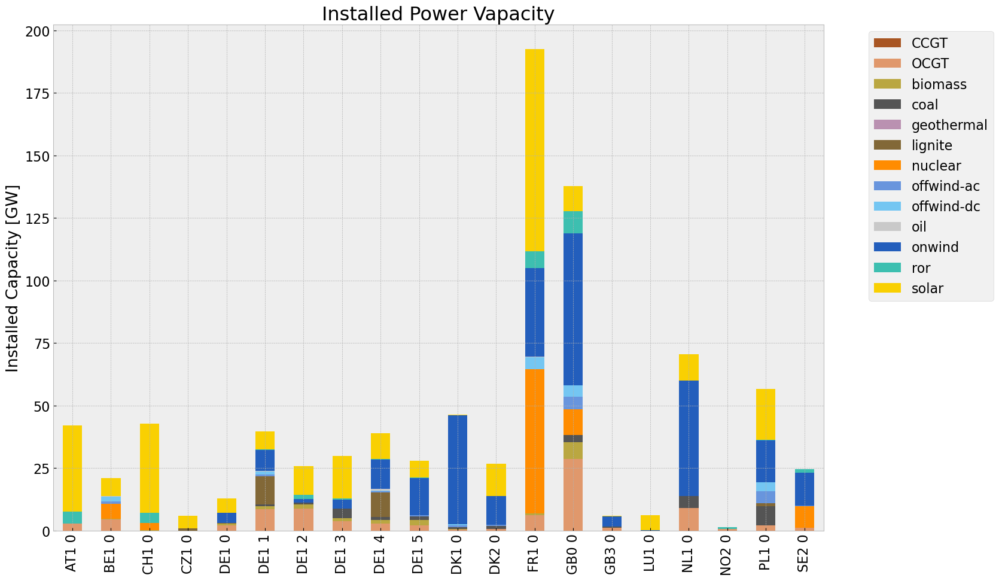

<Figure size 640x480 with 0 Axes>

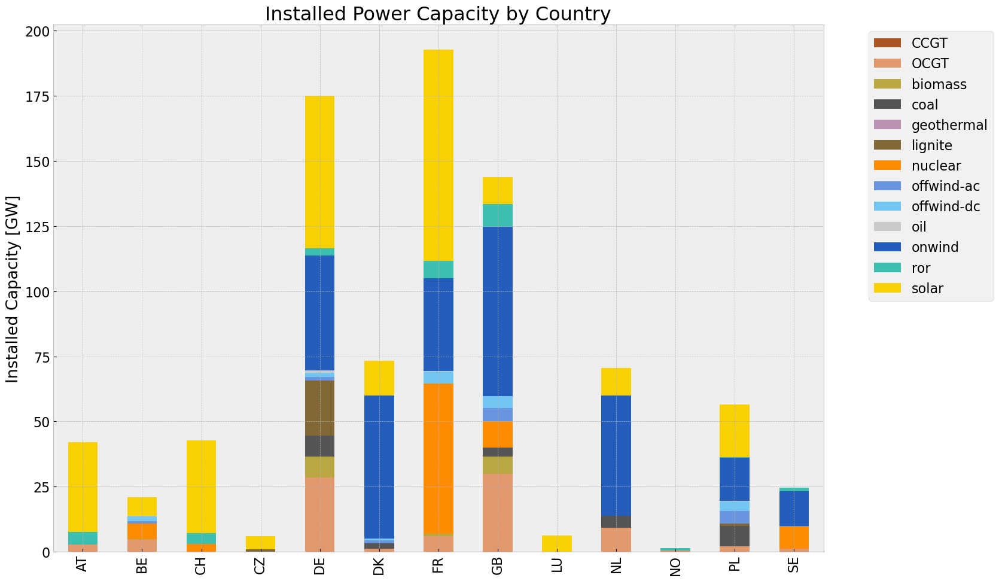

<Figure size 640x480 with 0 Axes>

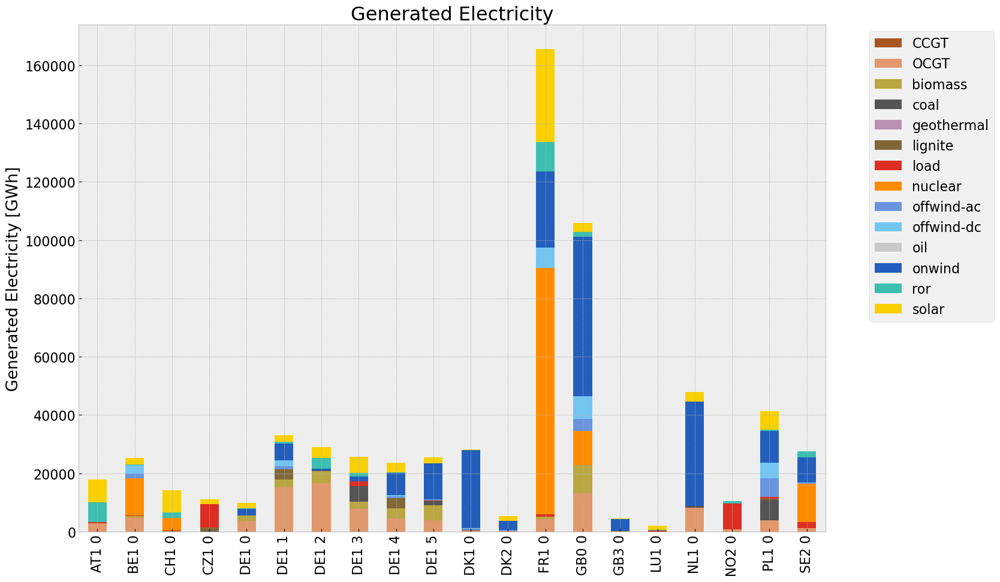

<Figure size 640x480 with 0 Axes>

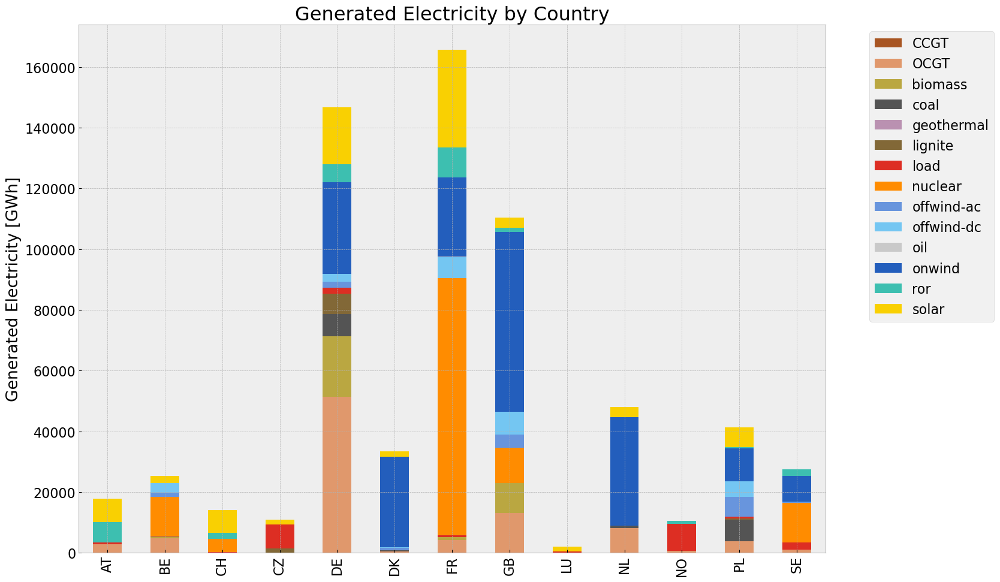

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,9.040776e+07,0.451621,0.1980,3.963665e+07
biomass,3.159197e+07,0.468000,0.0000,0.000000e+00
coal,1.530897e+07,0.329908,0.3361,1.559630e+07
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,8.628030e+06,0.337285,0.4069,1.040885e+07
load,2.338973e+07,1.000000,0.0000,0.000000e+00
nuclear,1.264073e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.531666e+07,1.000000,0.0000,0.000000e+00


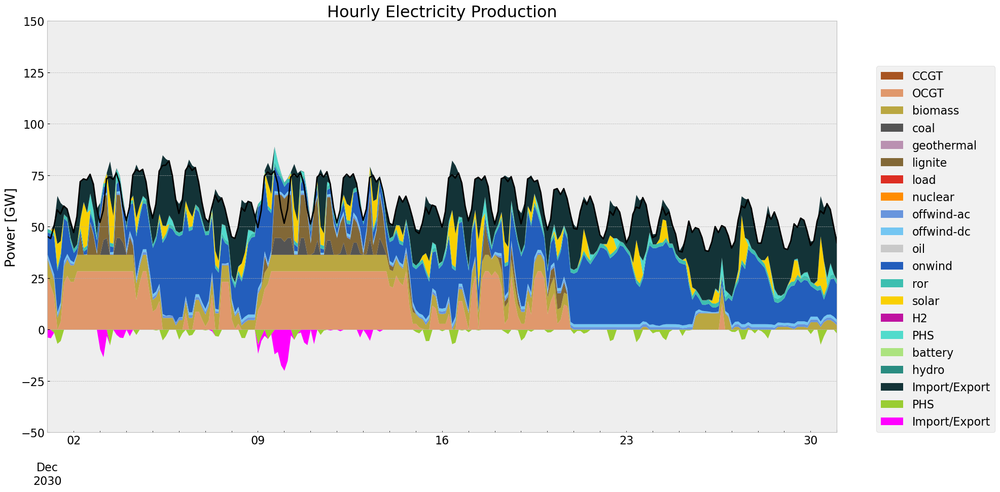

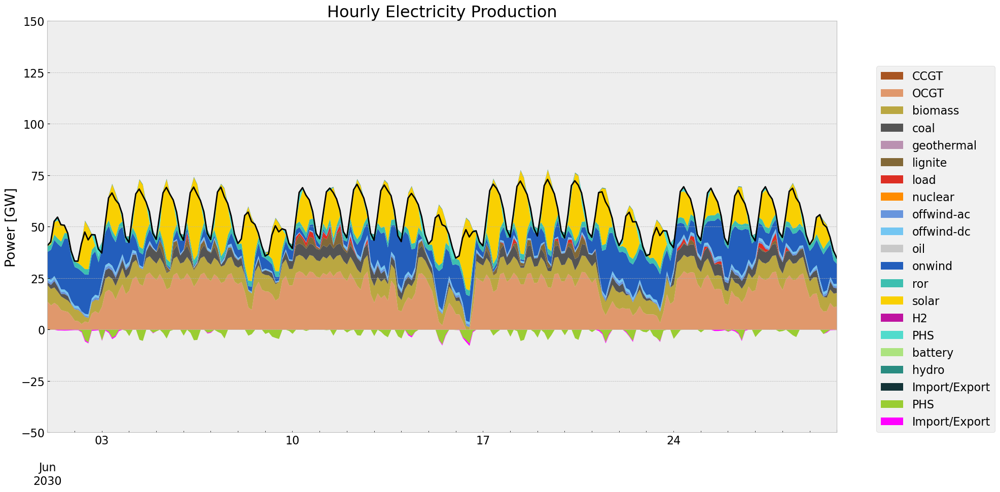

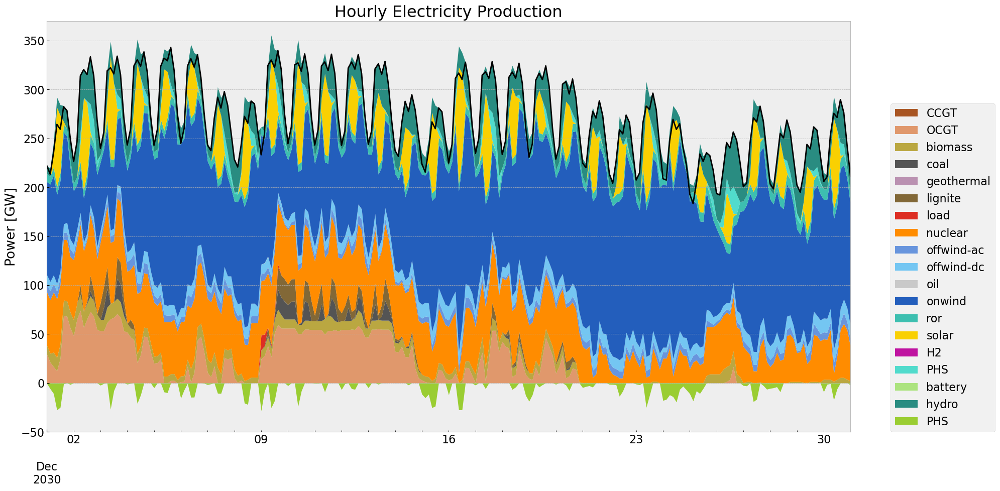

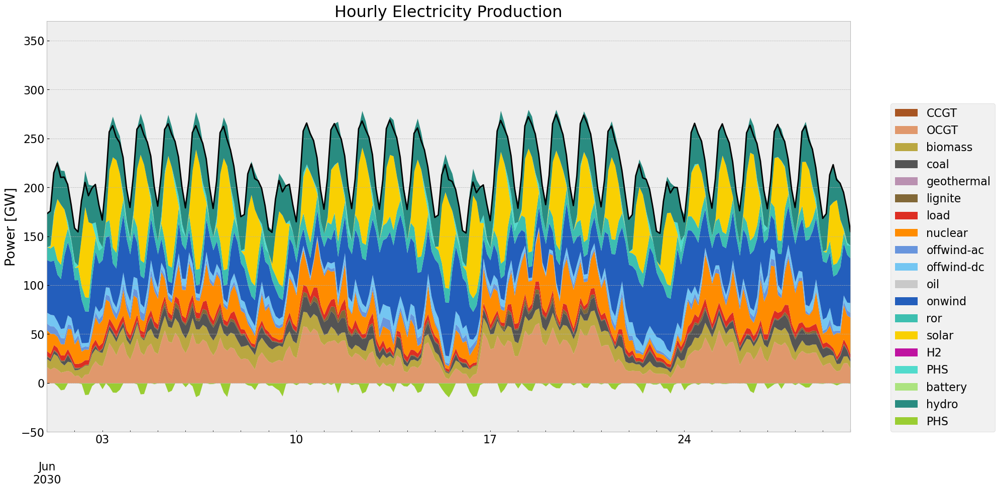

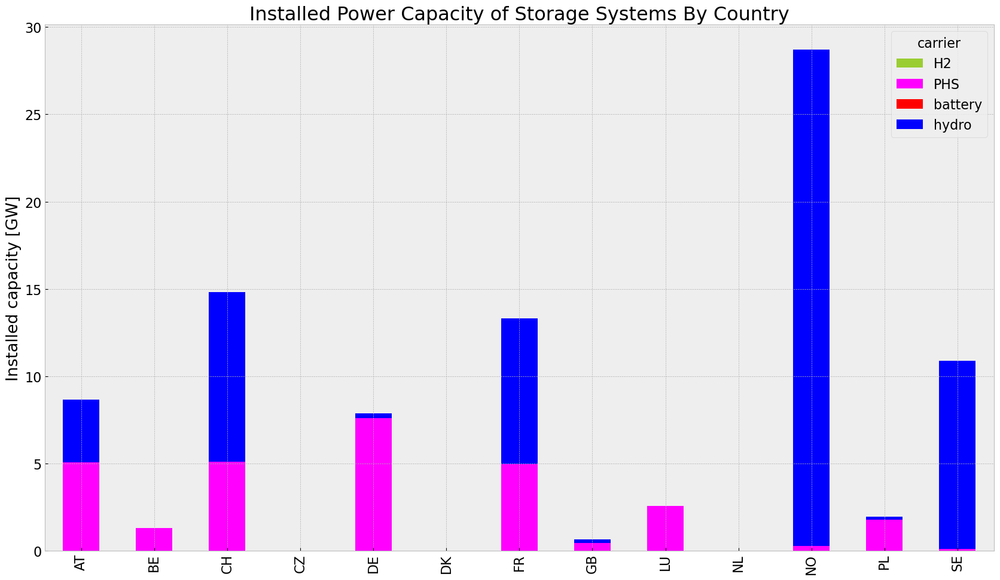

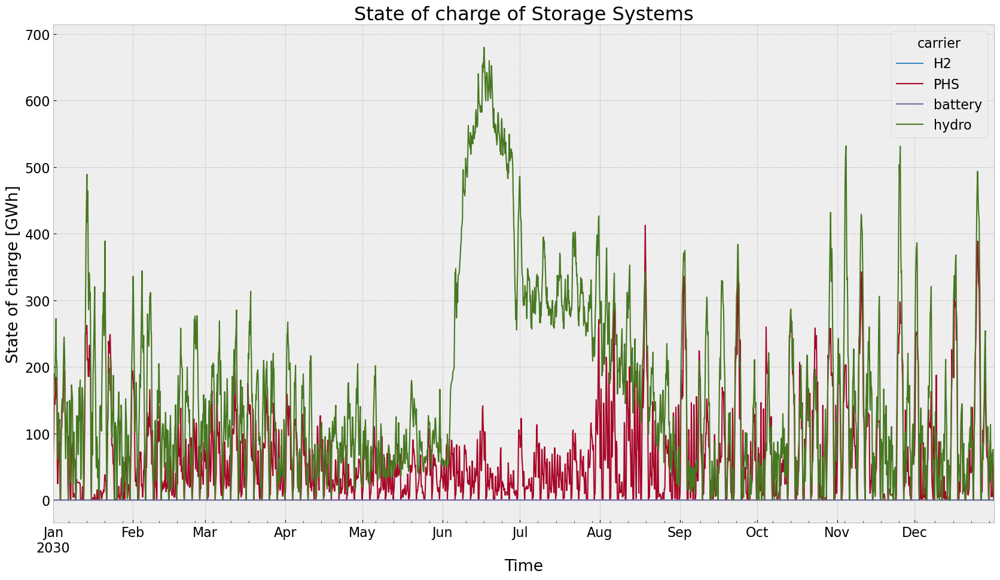

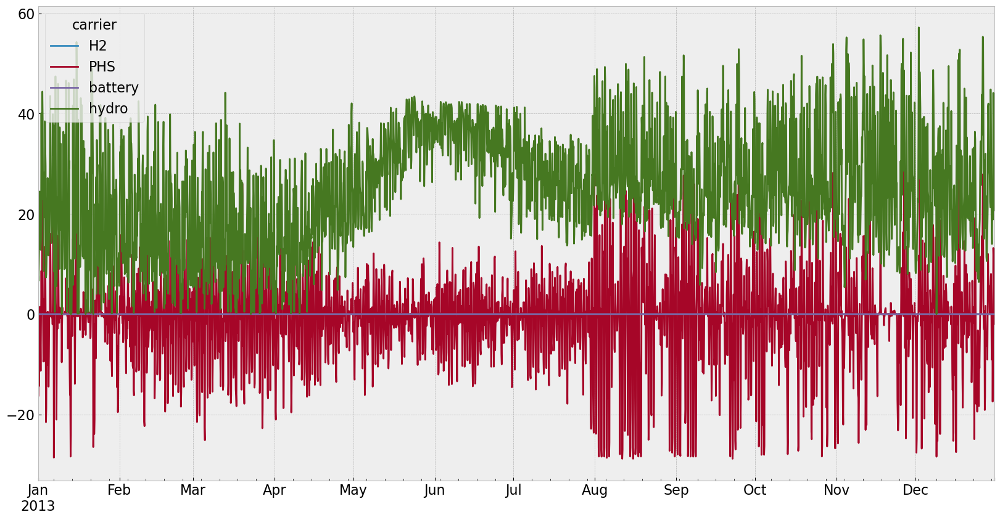

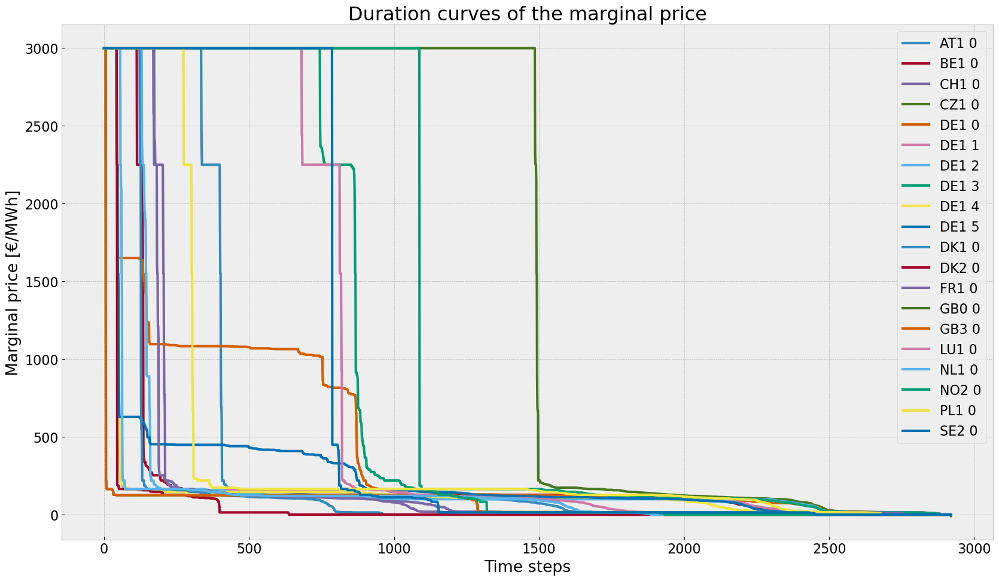

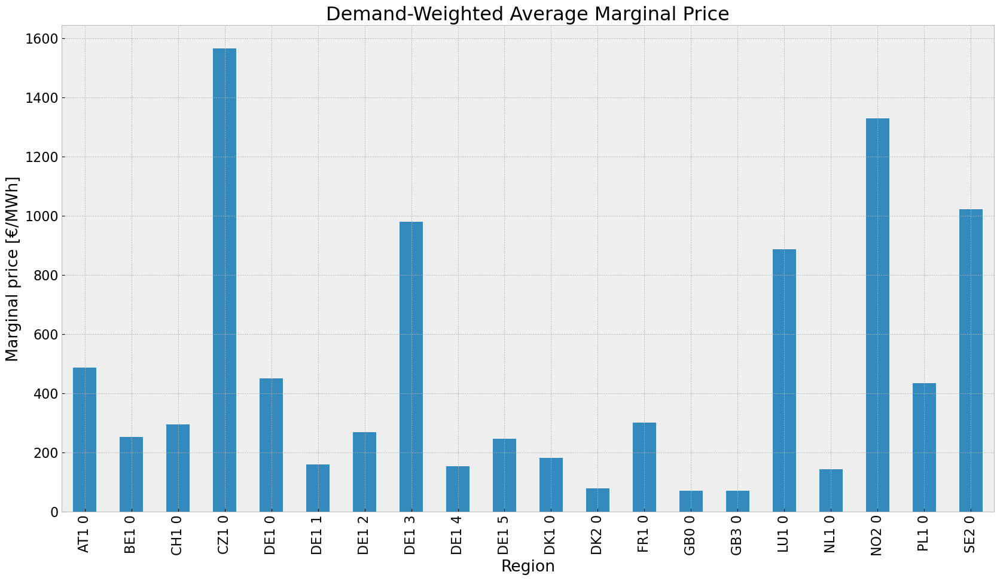

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


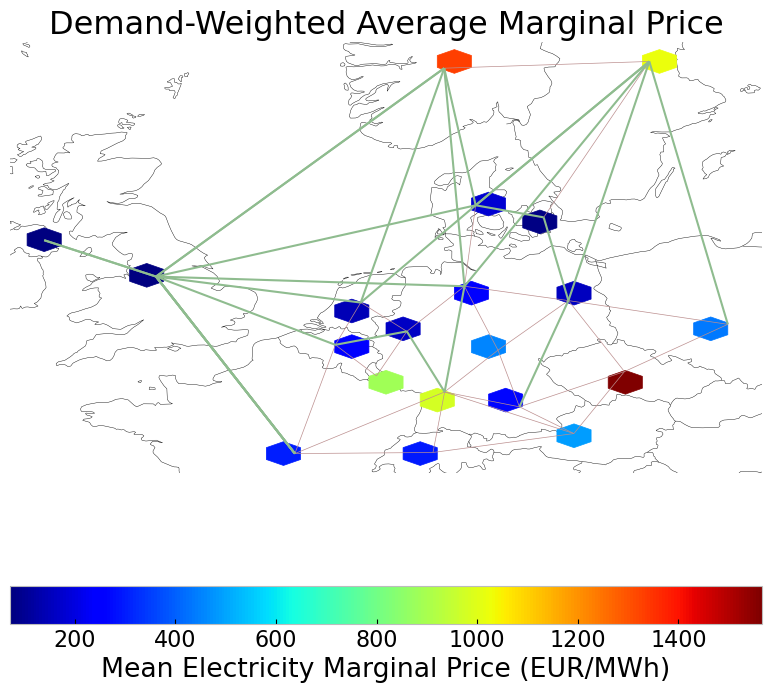

In [71]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3,colors_gen_table)
gen_noinv_roll_country = gen_power_table_country(n3,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3)
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [72]:
n4 = n1.copy()
n4.name = 'inv_roll_noexim'
horizon = 24

no_inv(n4,n1)
#set extendable to false
#set the optimal capacity of generators from the base scenario as the new minimum capacity 
#for index, value in n4.generators.p_nom_extendable.items():
#    if value:  
#        n4.generators.at[index, 'p_nom'] = n1.generators.at[index, 'p_nom_opt']
#        #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
#        n4.generators.at[index,'p_nom_extendable'] = False

#set the optimal capacity of storage units from the base scenario as the new minimum capacity 
#for index, value in n4.storage_units.p_nom_extendable.items():
#    if value:  
#        n4.storage_units.at[index, 'p_nom'] = n1.storage_units.at[index, 'p_nom_opt']
#        #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
#        n4.storage_units.at[index,'p_nom_extendable'] = False

#set the optimal capacity of stores from the base scenario as the new minimum capacity 
#for index, value in n4.stores.e_nom_extendable.items():
#    if value:  
#        n4.stores.at[index, 'e_nom'] = n1.stores.at[index, 'e_nom_opt']
#        #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
#        n4.stores.at[index, 'e_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n2.lines.s_nom_extendable.items():
#    if value:  
#        n4.lines.at[index, 's_nom'] = n1.lines.at[index, 's_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.lines.at[index, 's_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n4.links.p_nom_extendable.items():
#    if value:  
#        n4.links.at[index, 's_nom'] = n1.links.at[index, 'p_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.links.at[index, 'p_nom_extendable'] =False

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#n4 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\No_Exim\\20240512\\inv_roll_noexim.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ra94s1kg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ra94s1kg.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1042fbef


INFO:gurobipy:Model fingerprint: 0x1042fbef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25410 rows and 6842 columns


INFO:gurobipy:Presolve removed 25410 rows and 6842 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1422 rows, 5662 columns, 9515 nonzeros


INFO:gurobipy:Presolved: 1422 rows, 5662 columns, 9515 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.958e+03


INFO:gurobipy: AA' NZ     : 3.958e+03


 Factor NZ  : 3.932e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.932e+04 (roughly 3 MB of memory)


 Factor Ops : 2.035e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.035e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02657733e+11 -5.40044380e+11  8.82e+04 1.11e+04  5.15e+08     0s


INFO:gurobipy:   0   2.02657733e+11 -5.40044380e+11  8.82e+04 1.11e+04  5.15e+08     0s


   1   4.01534537e+10 -2.87196370e+11  1.09e+04 7.28e-11  7.78e+07     0s


INFO:gurobipy:   1   4.01534537e+10 -2.87196370e+11  1.09e+04 7.28e-11  7.78e+07     0s


   2   5.19648896e+09 -8.27396577e+10  6.28e+02 8.73e-11  9.82e+06     0s


INFO:gurobipy:   2   5.19648896e+09 -8.27396577e+10  6.28e+02 8.73e-11  9.82e+06     0s


   3   1.45094751e+09 -1.29484083e+10  4.43e+01 4.80e-10  1.33e+06     0s


INFO:gurobipy:   3   1.45094751e+09 -1.29484083e+10  4.43e+01 4.80e-10  1.33e+06     0s


   4   6.34247149e+08 -2.18971302e+09  6.02e+00 9.46e-11  2.52e+05     0s


INFO:gurobipy:   4   6.34247149e+08 -2.18971302e+09  6.02e+00 9.46e-11  2.52e+05     0s


   5   3.95741926e+08 -7.70686106e+08  2.47e+00 4.37e-11  1.03e+05     0s


INFO:gurobipy:   5   3.95741926e+08 -7.70686106e+08  2.47e+00 4.37e-11  1.03e+05     0s


   6   2.88845059e+08 -2.28193499e+08  1.32e+00 3.28e-11  4.58e+04     0s


INFO:gurobipy:   6   2.88845059e+08 -2.28193499e+08  1.32e+00 3.28e-11  4.58e+04     0s


   7   2.04647860e+08 -2.36197990e+07  4.59e-01 2.91e-11  2.02e+04     0s


INFO:gurobipy:   7   2.04647860e+08 -2.36197990e+07  4.59e-01 2.91e-11  2.02e+04     0s


   8   1.66113904e+08  1.17292205e+08  7.90e-02 2.32e-11  4.31e+03     0s


INFO:gurobipy:   8   1.66113904e+08  1.17292205e+08  7.90e-02 2.32e-11  4.31e+03     0s


   9   1.53890420e+08  1.36183567e+08  2.08e-02 2.61e-11  1.56e+03     0s


INFO:gurobipy:   9   1.53890420e+08  1.36183567e+08  2.08e-02 2.61e-11  1.56e+03     0s


  10   1.50952684e+08  1.41976999e+08  1.05e-02 2.71e-11  7.92e+02     0s


INFO:gurobipy:  10   1.50952684e+08  1.41976999e+08  1.05e-02 2.71e-11  7.92e+02     0s


  11   1.49613560e+08  1.44517143e+08  6.10e-03 1.91e-11  4.50e+02     0s


INFO:gurobipy:  11   1.49613560e+08  1.44517143e+08  6.10e-03 1.91e-11  4.50e+02     0s


  12   1.48299037e+08  1.46037929e+08  1.94e-03 2.79e-11  2.00e+02     0s


INFO:gurobipy:  12   1.48299037e+08  1.46037929e+08  1.94e-03 2.79e-11  2.00e+02     0s


  13   1.47914019e+08  1.47046758e+08  8.36e-04 2.40e-11  7.65e+01     0s


INFO:gurobipy:  13   1.47914019e+08  1.47046758e+08  8.36e-04 2.40e-11  7.65e+01     0s


  14   1.47691411e+08  1.47444222e+08  2.35e-04 2.91e-11  2.18e+01     0s


INFO:gurobipy:  14   1.47691411e+08  1.47444222e+08  2.35e-04 2.91e-11  2.18e+01     0s


  15   1.47625817e+08  1.47527846e+08  8.86e-05 2.78e-11  8.65e+00     0s


INFO:gurobipy:  15   1.47625817e+08  1.47527846e+08  8.86e-05 2.78e-11  8.65e+00     0s


  16   1.47609050e+08  1.47554252e+08  5.18e-05 1.84e-11  4.84e+00     0s


INFO:gurobipy:  16   1.47609050e+08  1.47554252e+08  5.18e-05 1.84e-11  4.84e+00     0s


  17   1.47591532e+08  1.47572565e+08  1.47e-05 2.91e-11  1.67e+00     0s


INFO:gurobipy:  17   1.47591532e+08  1.47572565e+08  1.47e-05 2.91e-11  1.67e+00     0s


  18   1.47586754e+08  1.47578338e+08  5.10e-06 2.91e-11  7.43e-01     0s


INFO:gurobipy:  18   1.47586754e+08  1.47578338e+08  5.10e-06 2.91e-11  7.43e-01     0s


  19   1.47585085e+08  1.47582519e+08  1.95e-06 2.91e-11  2.26e-01     0s


INFO:gurobipy:  19   1.47585085e+08  1.47582519e+08  1.95e-06 2.91e-11  2.26e-01     0s


  20   1.47584327e+08  1.47583378e+08  6.36e-07 2.77e-11  8.37e-02     0s


INFO:gurobipy:  20   1.47584327e+08  1.47583378e+08  6.36e-07 2.77e-11  8.37e-02     0s


  21   1.47584180e+08  1.47583661e+08  3.88e-07 2.91e-11  4.58e-02     0s


INFO:gurobipy:  21   1.47584180e+08  1.47583661e+08  3.88e-07 2.91e-11  4.58e-02     0s


  22   1.47584099e+08  1.47583738e+08  2.52e-07 2.91e-11  3.18e-02     0s


INFO:gurobipy:  22   1.47584099e+08  1.47583738e+08  2.52e-07 2.91e-11  3.18e-02     0s


  23   1.47583991e+08  1.47583830e+08  7.53e-08 1.88e-11  1.42e-02     0s


INFO:gurobipy:  23   1.47583991e+08  1.47583830e+08  7.53e-08 1.88e-11  1.42e-02     0s


INFO:gurobipy:


Barrier performed 23 iterations in 0.28 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 23 iterations in 0.28 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2053    1.4758394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2053    1.4758394e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2053 iterations and 0.31 seconds (0.06 work units)


INFO:gurobipy:Solved in 2053 iterations and 0.31 seconds (0.06 work units)


Optimal objective  1.475839435e+08


INFO:gurobipy:Optimal objective  1.475839435e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4plpv6pa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4plpv6pa.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa3aba6bc


INFO:gurobipy:Model fingerprint: 0xa3aba6bc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25394 rows and 6623 columns


INFO:gurobipy:Presolve removed 25394 rows and 6623 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1438 rows, 5881 columns, 9782 nonzeros


INFO:gurobipy:Presolved: 1438 rows, 5881 columns, 9782 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 3.946e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.946e+04 (roughly 3 MB of memory)


 Factor Ops : 1.945e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.945e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.24078458e+11 -5.37764421e+11  8.51e+04 1.13e+04  4.97e+08     0s


INFO:gurobipy:   0   2.24078458e+11 -5.37764421e+11  8.51e+04 1.13e+04  4.97e+08     0s


   1   4.58287148e+10 -2.91704957e+11  1.03e+04 5.82e-11  7.51e+07     0s


INFO:gurobipy:   1   4.58287148e+10 -2.91704957e+11  1.03e+04 5.82e-11  7.51e+07     0s


   2   6.92564740e+09 -7.88946336e+10  6.47e+02 1.68e+02  9.41e+06     0s


INFO:gurobipy:   2   6.92564740e+09 -7.88946336e+10  6.47e+02 1.68e+02  9.41e+06     0s


   3   1.87274195e+09 -1.10933275e+10  4.72e+01 1.89e-10  1.17e+06     0s


INFO:gurobipy:   3   1.87274195e+09 -1.10933275e+10  4.72e+01 1.89e-10  1.17e+06     0s


   4   9.29523022e+08 -1.75321861e+09  1.20e+01 1.60e-10  2.35e+05     0s


INFO:gurobipy:   4   9.29523022e+08 -1.75321861e+09  1.20e+01 1.60e-10  2.35e+05     0s


   5   6.43478034e+08 -4.92182897e+08  5.91e+00 5.82e-11  9.81e+04     0s


INFO:gurobipy:   5   6.43478034e+08 -4.92182897e+08  5.91e+00 5.82e-11  9.81e+04     0s


   6   5.37552341e+08 -9.59326675e+07  3.74e+00 2.91e-11  5.45e+04     0s


INFO:gurobipy:   6   5.37552341e+08 -9.59326675e+07  3.74e+00 2.91e-11  5.45e+04     0s


   7   4.13678106e+08  1.74210739e+08  1.47e+00 3.64e-11  2.05e+04     0s


INFO:gurobipy:   7   4.13678106e+08  1.74210739e+08  1.47e+00 3.64e-11  2.05e+04     0s


   8   3.41810852e+08  2.61622352e+08  2.92e-01 2.91e-11  6.83e+03     0s


INFO:gurobipy:   8   3.41810852e+08  2.61622352e+08  2.92e-01 2.91e-11  6.83e+03     0s


   9   3.30616066e+08  2.82205907e+08  1.64e-01 2.18e-11  4.12e+03     0s


INFO:gurobipy:   9   3.30616066e+08  2.82205907e+08  1.64e-01 2.18e-11  4.12e+03     0s


  10   3.28792476e+08  2.89986342e+08  1.46e-01 1.73e-11  3.30e+03     0s


INFO:gurobipy:  10   3.28792476e+08  2.89986342e+08  1.46e-01 1.73e-11  3.30e+03     0s


  11   3.25116150e+08  3.02411828e+08  1.10e-01 2.96e-11  1.93e+03     0s


INFO:gurobipy:  11   3.25116150e+08  3.02411828e+08  1.10e-01 2.96e-11  1.93e+03     0s


  12   3.20389175e+08  3.07097858e+08  6.43e-02 1.83e-11  1.13e+03     0s


INFO:gurobipy:  12   3.20389175e+08  3.07097858e+08  6.43e-02 1.83e-11  1.13e+03     0s


  13   3.15791388e+08  3.10061752e+08  2.25e-02 2.16e-11  4.87e+02     0s


INFO:gurobipy:  13   3.15791388e+08  3.10061752e+08  2.25e-02 2.16e-11  4.87e+02     0s


  14   3.14938479e+08  3.11098897e+08  1.54e-02 3.08e-11  3.26e+02     0s


INFO:gurobipy:  14   3.14938479e+08  3.11098897e+08  1.54e-02 3.08e-11  3.26e+02     0s


  15   3.14228196e+08  3.12411494e+08  9.61e-03 2.26e-11  1.54e+02     0s


INFO:gurobipy:  15   3.14228196e+08  3.12411494e+08  9.61e-03 2.26e-11  1.54e+02     0s


  16   3.13399778e+08  3.12667898e+08  2.91e-03 1.46e-11  6.22e+01     0s


INFO:gurobipy:  16   3.13399778e+08  3.12667898e+08  2.91e-03 1.46e-11  6.22e+01     0s


  17   3.13117529e+08  3.12902438e+08  6.08e-04 2.80e-11  1.83e+01     0s


INFO:gurobipy:  17   3.13117529e+08  3.12902438e+08  6.08e-04 2.80e-11  1.83e+01     0s


  18   3.13055661e+08  3.12982930e+08  1.75e-04 2.66e-11  6.18e+00     0s


INFO:gurobipy:  18   3.13055661e+08  3.12982930e+08  1.75e-04 2.66e-11  6.18e+00     0s


  19   3.13033062e+08  3.13018413e+08  2.48e-05 2.91e-11  1.24e+00     0s


INFO:gurobipy:  19   3.13033062e+08  3.13018413e+08  2.48e-05 2.91e-11  1.24e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1874    3.1302856e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1874    3.1302856e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1874 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1874 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.130285554e+08


INFO:gurobipy:Optimal objective  3.130285554e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65mam6fz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65mam6fz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd35c7522


INFO:gurobipy:Model fingerprint: 0xd35c7522


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25392 rows and 6628 columns


INFO:gurobipy:Presolve removed 25392 rows and 6628 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1440 rows, 5876 columns, 9783 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 5876 columns, 9783 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.003e+03


INFO:gurobipy: AA' NZ     : 4.003e+03


 Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64466880e+11 -5.21454129e+11  9.16e+04 1.39e+04  5.27e+08     0s


INFO:gurobipy:   0   2.64466880e+11 -5.21454129e+11  9.16e+04 1.39e+04  5.27e+08     0s


   1   5.73886258e+10 -2.82517516e+11  1.17e+04 8.73e-11  8.11e+07     0s


INFO:gurobipy:   1   5.73886258e+10 -2.82517516e+11  1.17e+04 8.73e-11  8.11e+07     0s


   2   1.07257017e+10 -7.40858429e+10  6.14e+02 6.55e-11  9.25e+06     0s


INFO:gurobipy:   2   1.07257017e+10 -7.40858429e+10  6.14e+02 6.55e-11  9.25e+06     0s


   3   4.36636121e+09 -1.38500790e+10  1.47e+02 7.86e-10  1.79e+06     0s


INFO:gurobipy:   3   4.36636121e+09 -1.38500790e+10  1.47e+02 7.86e-10  1.79e+06     0s


   4   2.59422743e+09 -3.07587558e+09  5.20e+01 3.20e-10  5.28e+05     0s


INFO:gurobipy:   4   2.59422743e+09 -3.07587558e+09  5.20e+01 3.20e-10  5.28e+05     0s


   5   1.95485381e+09 -2.72381503e+07  1.75e+01 1.46e-10  1.77e+05     0s


INFO:gurobipy:   5   1.95485381e+09 -2.72381503e+07  1.75e+01 1.46e-10  1.77e+05     0s


   6   1.72669614e+09  9.45971141e+08  6.73e+00 1.16e-10  6.85e+04     0s


INFO:gurobipy:   6   1.72669614e+09  9.45971141e+08  6.73e+00 1.16e-10  6.85e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1770    1.4863449e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1770    1.4863449e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1770 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1770 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.486344946e+09


INFO:gurobipy:Optimal objective  1.486344946e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ht17oeac.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ht17oeac.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xffc96601


INFO:gurobipy:Model fingerprint: 0xffc96601


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25392 rows and 6610 columns


INFO:gurobipy:Presolve removed 25392 rows and 6610 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1440 rows, 5894 columns, 9801 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 5894 columns, 9801 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.003e+03


INFO:gurobipy: AA' NZ     : 4.003e+03


 Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58589322e+11 -5.31117488e+11  5.37e+04 1.44e+04  3.29e+08     0s


INFO:gurobipy:   0   1.58589322e+11 -5.31117488e+11  5.37e+04 1.44e+04  3.29e+08     0s


   1   3.67015701e+10 -2.41500617e+11  5.99e+03 7.28e-11  4.94e+07     0s


INFO:gurobipy:   1   3.67015701e+10 -2.41500617e+11  5.99e+03 7.28e-11  4.94e+07     0s


   2   8.40704542e+09 -6.23611745e+10  4.78e+02 4.06e+02  7.44e+06     0s


INFO:gurobipy:   2   8.40704542e+09 -6.23611745e+10  4.78e+02 4.06e+02  7.44e+06     0s


   3   3.58902539e+09 -1.82633265e+10  1.10e+02 6.07e+01  2.04e+06     0s


INFO:gurobipy:   3   3.58902539e+09 -1.82633265e+10  1.10e+02 6.07e+01  2.04e+06     0s


   4   2.13629833e+09 -2.32053893e+09  2.09e+01 1.89e-10  3.93e+05     0s


INFO:gurobipy:   4   2.13629833e+09 -2.32053893e+09  2.09e+01 1.89e-10  3.93e+05     0s


   5   1.76672060e+09 -5.09563316e+07  7.86e+00 8.00e-11  1.58e+05     0s


INFO:gurobipy:   5   1.76672060e+09 -5.09563316e+07  7.86e+00 8.00e-11  1.58e+05     0s


   6   1.59244595e+09  9.80658140e+08  3.15e+00 2.91e-11  5.27e+04     0s


INFO:gurobipy:   6   1.59244595e+09  9.80658140e+08  3.15e+00 2.91e-11  5.27e+04     0s


   7   1.46700289e+09  1.27267239e+09  6.04e-01 3.16e-11  1.66e+04     0s


INFO:gurobipy:   7   1.46700289e+09  1.27267239e+09  6.04e-01 3.16e-11  1.66e+04     0s


   8   1.41632915e+09  1.36438030e+09  1.00e-01 2.91e-11  4.42e+03     0s


INFO:gurobipy:   8   1.41632915e+09  1.36438030e+09  1.00e-01 2.91e-11  4.42e+03     0s


   9   1.40766102e+09  1.38695165e+09  4.28e-02 2.91e-11  1.76e+03     0s


INFO:gurobipy:   9   1.40766102e+09  1.38695165e+09  4.28e-02 2.91e-11  1.76e+03     0s


  10   1.40480251e+09  1.39328572e+09  2.59e-02 2.06e-11  9.80e+02     0s


INFO:gurobipy:  10   1.40480251e+09  1.39328572e+09  2.59e-02 2.06e-11  9.80e+02     0s


  11   1.40221561e+09  1.39697745e+09  1.08e-02 3.28e-11  4.46e+02     0s


INFO:gurobipy:  11   1.40221561e+09  1.39697745e+09  1.08e-02 3.28e-11  4.46e+02     0s


  12   1.40096944e+09  1.39862468e+09  4.25e-03 2.54e-11  1.99e+02     0s


INFO:gurobipy:  12   1.40096944e+09  1.39862468e+09  4.25e-03 2.54e-11  1.99e+02     0s


  13   1.40043816e+09  1.39954510e+09  1.55e-03 2.91e-11  7.59e+01     0s


INFO:gurobipy:  13   1.40043816e+09  1.39954510e+09  1.55e-03 2.91e-11  7.59e+01     0s


  14   1.40012136e+09  1.39998280e+09  8.29e-05 3.75e-11  1.18e+01     0s


INFO:gurobipy:  14   1.40012136e+09  1.39998280e+09  8.29e-05 3.75e-11  1.18e+01     0s


  15   1.40009605e+09  1.40008300e+09  5.20e-06 2.91e-11  1.11e+00     0s


INFO:gurobipy:  15   1.40009605e+09  1.40008300e+09  5.20e-06 2.91e-11  1.11e+00     0s


  16   1.40009324e+09  1.40008925e+09  3.46e-07 3.52e-11  3.38e-01     0s


INFO:gurobipy:  16   1.40009324e+09  1.40008925e+09  3.46e-07 3.52e-11  3.38e-01     0s


  17   1.40009302e+09  1.40009215e+09  9.22e-08 3.18e-11  7.40e-02     0s


INFO:gurobipy:  17   1.40009302e+09  1.40009215e+09  9.22e-08 3.18e-11  7.40e-02     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.34 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.34 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1776    1.4000929e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1776    1.4000929e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1776 iterations and 0.37 seconds (0.05 work units)


INFO:gurobipy:Solved in 1776 iterations and 0.37 seconds (0.05 work units)


Optimal objective  1.400092890e+09


INFO:gurobipy:Optimal objective  1.400092890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9yzbu0r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z9yzbu0r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc5acde53


INFO:gurobipy:Model fingerprint: 0xc5acde53


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25393 rows and 6627 columns


INFO:gurobipy:Presolve removed 25393 rows and 6627 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1439 rows, 5877 columns, 9778 nonzeros


INFO:gurobipy:Presolved: 1439 rows, 5877 columns, 9778 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 3.898e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.898e+04 (roughly 3 MB of memory)


 Factor Ops : 1.854e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.854e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.55276358e+11 -5.18515581e+11  8.84e+04 1.39e+04  5.06e+08     0s


INFO:gurobipy:   0   2.55276358e+11 -5.18515581e+11  8.84e+04 1.39e+04  5.06e+08     0s


   1   5.65519565e+10 -2.80196876e+11  1.14e+04 5.82e-11  7.89e+07     0s


INFO:gurobipy:   1   5.65519565e+10 -2.80196876e+11  1.14e+04 5.82e-11  7.89e+07     0s


   2   1.13484244e+10 -7.57346255e+10  6.41e+02 8.73e-11  9.53e+06     0s


INFO:gurobipy:   2   1.13484244e+10 -7.57346255e+10  6.41e+02 8.73e-11  9.53e+06     0s


   3   5.49894744e+09 -1.99819686e+10  1.59e+02 7.42e-10  2.47e+06     0s


INFO:gurobipy:   3   5.49894744e+09 -1.99819686e+10  1.59e+02 7.42e-10  2.47e+06     0s


   4   3.51627750e+09 -5.09642925e+09  3.27e+01 4.22e-10  7.69e+05     0s


INFO:gurobipy:   4   3.51627750e+09 -5.09642925e+09  3.27e+01 4.22e-10  7.69e+05     0s


   5   3.21032174e+09  6.24480504e+08  1.04e+01 7.28e-11  2.25e+05     0s


INFO:gurobipy:   5   3.21032174e+09  6.24480504e+08  1.04e+01 7.28e-11  2.25e+05     0s


   6   3.05612187e+09  2.18986789e+09  3.61e+00 1.02e-10  7.47e+04     0s


INFO:gurobipy:   6   3.05612187e+09  2.18986789e+09  3.61e+00 1.02e-10  7.47e+04     0s


   7   2.91952450e+09  2.64148111e+09  4.47e-01 8.73e-11  2.37e+04     0s


INFO:gurobipy:   7   2.91952450e+09  2.64148111e+09  4.47e-01 8.73e-11  2.37e+04     0s


   8   2.87515677e+09  2.77682513e+09  1.54e-01 4.37e-11  8.38e+03     0s


INFO:gurobipy:   8   2.87515677e+09  2.77682513e+09  1.54e-01 4.37e-11  8.38e+03     0s


   9   2.85137348e+09  2.81589360e+09  3.05e-02 2.91e-11  3.02e+03     0s


INFO:gurobipy:   9   2.85137348e+09  2.81589360e+09  3.05e-02 2.91e-11  3.02e+03     0s


  10   2.84438371e+09  2.83859083e+09  5.42e-03 3.02e-11  4.93e+02     0s


INFO:gurobipy:  10   2.84438371e+09  2.83859083e+09  5.42e-03 3.02e-11  4.93e+02     0s


  11   2.84267805e+09  2.84059017e+09  1.21e-03 2.91e-11  1.78e+02     0s


INFO:gurobipy:  11   2.84267805e+09  2.84059017e+09  1.21e-03 2.91e-11  1.78e+02     0s


  12   2.84240858e+09  2.84167077e+09  6.26e-04 2.69e-11  6.28e+01     0s


INFO:gurobipy:  12   2.84240858e+09  2.84167077e+09  6.26e-04 2.69e-11  6.28e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1660    2.8420958e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1660    2.8420958e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1660 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1660 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.842095833e+09


INFO:gurobipy:Optimal objective  2.842095833e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tbc9gpce.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tbc9gpce.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1d9fcd6c


INFO:gurobipy:Model fingerprint: 0x1d9fcd6c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25404 rows and 6716 columns


INFO:gurobipy:Presolve removed 25404 rows and 6716 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1428 rows, 5788 columns, 9666 nonzeros


INFO:gurobipy:Presolved: 1428 rows, 5788 columns, 9666 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.978e+03


INFO:gurobipy: AA' NZ     : 3.978e+03


 Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


 Factor Ops : 1.988e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.988e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.50289519e+11 -5.17557222e+11  8.82e+04 1.43e+04  5.08e+08     0s


INFO:gurobipy:   0   2.50289519e+11 -5.17557222e+11  8.82e+04 1.43e+04  5.08e+08     0s


   1   5.87800552e+10 -2.81518849e+11  1.12e+04 7.28e-11  7.91e+07     0s


INFO:gurobipy:   1   5.87800552e+10 -2.81518849e+11  1.12e+04 7.28e-11  7.91e+07     0s


   2   1.40684321e+10 -6.96215889e+10  6.33e+02 4.18e+01  9.33e+06     0s


INFO:gurobipy:   2   1.40684321e+10 -6.96215889e+10  6.33e+02 4.18e+01  9.33e+06     0s


   3   7.53501016e+09 -1.38146401e+10  1.58e+02 1.62e-09  2.14e+06     0s


INFO:gurobipy:   3   7.53501016e+09 -1.38146401e+10  1.58e+02 1.62e-09  2.14e+06     0s


   4   5.56241886e+09 -2.32431251e+09  8.16e+01 3.78e-10  7.79e+05     0s


INFO:gurobipy:   4   5.56241886e+09 -2.32431251e+09  8.16e+01 3.78e-10  7.79e+05     0s


   5   4.31225164e+09  6.92739185e+08  3.64e+01 2.04e-10  3.44e+05     0s


INFO:gurobipy:   5   4.31225164e+09  6.92739185e+08  3.64e+01 2.04e-10  3.44e+05     0s


   6   3.89464396e+09  2.42152556e+09  1.87e+01 2.18e-10  1.38e+05     0s


INFO:gurobipy:   6   3.89464396e+09  2.42152556e+09  1.87e+01 2.18e-10  1.38e+05     0s


   7   3.56160052e+09  3.06167853e+09  4.73e+00 8.73e-11  4.51e+04     0s


INFO:gurobipy:   7   3.56160052e+09  3.06167853e+09  4.73e+00 8.73e-11  4.51e+04     0s


   8   3.45395239e+09  3.28705991e+09  1.22e+00 5.09e-11  1.47e+04     0s


INFO:gurobipy:   8   3.45395239e+09  3.28705991e+09  1.22e+00 5.09e-11  1.47e+04     0s


   9   3.41409187e+09  3.36227648e+09  2.17e-01 2.91e-11  4.51e+03     0s


INFO:gurobipy:   9   3.41409187e+09  3.36227648e+09  2.17e-01 2.91e-11  4.51e+03     0s


  10   3.40901344e+09  3.37551640e+09  1.50e-01 4.37e-11  2.91e+03     0s


INFO:gurobipy:  10   3.40901344e+09  3.37551640e+09  1.50e-01 4.37e-11  2.91e+03     0s


  11   3.40431819e+09  3.37904575e+09  9.56e-02 4.37e-11  2.20e+03     0s


INFO:gurobipy:  11   3.40431819e+09  3.37904575e+09  9.56e-02 4.37e-11  2.20e+03     0s


  12   3.39960163e+09  3.38895102e+09  4.04e-02 2.91e-11  9.25e+02     0s


INFO:gurobipy:  12   3.39960163e+09  3.38895102e+09  4.04e-02 2.91e-11  9.25e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1759    3.3946590e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1759    3.3946590e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1759 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1759 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.394658954e+09


INFO:gurobipy:Optimal objective  3.394658954e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.58it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yo4mv93p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yo4mv93p.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcb9b8b75


INFO:gurobipy:Model fingerprint: 0xcb9b8b75


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25396 rows and 6727 columns


INFO:gurobipy:Presolve removed 25396 rows and 6727 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1436 rows, 5777 columns, 9671 nonzeros


INFO:gurobipy:Presolved: 1436 rows, 5777 columns, 9671 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.992e+03


INFO:gurobipy: AA' NZ     : 3.992e+03


 Factor NZ  : 3.986e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.986e+04 (roughly 3 MB of memory)


 Factor Ops : 2.058e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.058e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11340207e+11 -5.27213453e+11  8.10e+04 1.18e+04  4.74e+08     0s


INFO:gurobipy:   0   2.11340207e+11 -5.27213453e+11  8.10e+04 1.18e+04  4.74e+08     0s


   1   4.48850055e+10 -2.75498632e+11  1.04e+04 8.00e-11  7.38e+07     0s


INFO:gurobipy:   1   4.48850055e+10 -2.75498632e+11  1.04e+04 8.00e-11  7.38e+07     0s


   2   8.74680434e+09 -7.65752595e+10  7.08e+02 7.28e-11  9.71e+06     0s


INFO:gurobipy:   2   8.74680434e+09 -7.65752595e+10  7.08e+02 7.28e-11  9.71e+06     0s


   3   3.84048131e+09 -1.27995412e+10  1.63e+02 5.24e-10  1.70e+06     0s


INFO:gurobipy:   3   3.84048131e+09 -1.27995412e+10  1.63e+02 5.24e-10  1.70e+06     0s


   4   2.53111721e+09 -8.73840044e+08  2.86e+01 5.53e-10  3.19e+05     0s


INFO:gurobipy:   4   2.53111721e+09 -8.73840044e+08  2.86e+01 5.53e-10  3.19e+05     0s


   5   2.20881978e+09  8.80355997e+08  1.21e+01 1.75e-10  1.21e+05     0s


INFO:gurobipy:   5   2.20881978e+09  8.80355997e+08  1.21e+01 1.75e-10  1.21e+05     0s


   6   2.04455546e+09  1.51851425e+09  5.67e+00 1.16e-10  4.71e+04     0s


INFO:gurobipy:   6   2.04455546e+09  1.51851425e+09  5.67e+00 1.16e-10  4.71e+04     0s


   7   1.92040949e+09  1.74614509e+09  1.72e+00 4.37e-11  1.54e+04     0s


INFO:gurobipy:   7   1.92040949e+09  1.74614509e+09  1.72e+00 4.37e-11  1.54e+04     0s


   8   1.86841015e+09  1.82186526e+09  5.08e-01 4.37e-11  4.11e+03     0s


INFO:gurobipy:   8   1.86841015e+09  1.82186526e+09  5.08e-01 4.37e-11  4.11e+03     0s


   9   1.85217995e+09  1.83573268e+09  1.92e-01 2.99e-11  1.45e+03     0s


INFO:gurobipy:   9   1.85217995e+09  1.83573268e+09  1.92e-01 2.99e-11  1.45e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1924    1.8415005e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1924    1.8415005e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1924 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1924 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.841500512e+09


INFO:gurobipy:Optimal objective  1.841500512e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c95dw2dc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c95dw2dc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x889b48f1


INFO:gurobipy:Model fingerprint: 0x889b48f1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25393 rows and 6712 columns


INFO:gurobipy:Presolve removed 25393 rows and 6712 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1439 rows, 5792 columns, 9693 nonzeros


INFO:gurobipy:Presolved: 1439 rows, 5792 columns, 9693 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 3.898e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.898e+04 (roughly 3 MB of memory)


 Factor Ops : 1.854e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.854e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03392850e+11 -5.18116431e+11  6.80e+04 1.44e+04  4.01e+08     0s


INFO:gurobipy:   0   2.03392850e+11 -5.18116431e+11  6.80e+04 1.44e+04  4.01e+08     0s


   1   4.76950107e+10 -2.50877894e+11  8.25e+03 7.28e-11  6.14e+07     0s


INFO:gurobipy:   1   4.76950107e+10 -2.50877894e+11  8.25e+03 7.28e-11  6.14e+07     0s


   2   1.30658358e+10 -6.13318417e+10  5.40e+02 8.73e-11  8.13e+06     0s


INFO:gurobipy:   2   1.30658358e+10 -6.13318417e+10  5.40e+02 8.73e-11  8.13e+06     0s


   3   6.19823315e+09 -1.20502908e+10  8.92e+01 2.33e-10  1.73e+06     0s


INFO:gurobipy:   3   6.19823315e+09 -1.20502908e+10  8.92e+01 2.33e-10  1.73e+06     0s


   4   4.45355617e+09 -1.01061785e+09  2.57e+01 2.47e-10  4.95e+05     0s


INFO:gurobipy:   4   4.45355617e+09 -1.01061785e+09  2.57e+01 2.47e-10  4.95e+05     0s


   5   4.12207721e+09  2.05153117e+09  9.45e+00 2.33e-10  1.83e+05     0s


INFO:gurobipy:   5   4.12207721e+09  2.05153117e+09  9.45e+00 2.33e-10  1.83e+05     0s


   6   3.94967161e+09  3.25606941e+09  2.98e+00 4.37e-11  6.06e+04     0s


INFO:gurobipy:   6   3.94967161e+09  3.25606941e+09  2.98e+00 4.37e-11  6.06e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.25 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.25 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1745    3.7827163e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1745    3.7827163e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1745 iterations and 0.28 seconds (0.05 work units)


INFO:gurobipy:Solved in 1745 iterations and 0.28 seconds (0.05 work units)


Optimal objective  3.782716345e+09


INFO:gurobipy:Optimal objective  3.782716345e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1veb89c4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1veb89c4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9d498d48


INFO:gurobipy:Model fingerprint: 0x9d498d48


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25416 rows and 6856 columns


INFO:gurobipy:Presolve removed 25416 rows and 6856 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1416 rows, 5648 columns, 9486 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5648 columns, 9486 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.945e+03


INFO:gurobipy: AA' NZ     : 3.945e+03


 Factor NZ  : 3.901e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.901e+04 (roughly 3 MB of memory)


 Factor Ops : 2.003e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.003e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.07090719e+11 -5.15485607e+11  8.24e+04 1.61e+04  4.82e+08     0s


INFO:gurobipy:   0   2.07090719e+11 -5.15485607e+11  8.24e+04 1.61e+04  4.82e+08     0s


   1   2.83082312e+10 -2.67087955e+11  5.71e+03 7.28e-11  5.14e+07     0s


INFO:gurobipy:   1   2.83082312e+10 -2.67087955e+11  5.71e+03 7.28e-11  5.14e+07     0s


   2   8.03006536e+09 -6.37677681e+10  4.82e+02 4.07e-10  7.81e+06     0s


INFO:gurobipy:   2   8.03006536e+09 -6.37677681e+10  4.82e+02 4.07e-10  7.81e+06     0s


   3   4.37356383e+09 -1.32710810e+10  1.19e+02 2.18e-10  1.75e+06     0s


INFO:gurobipy:   3   4.37356383e+09 -1.32710810e+10  1.19e+02 2.18e-10  1.75e+06     0s


   4   3.09960601e+09 -2.59786486e+09  3.58e+01 1.31e-10  5.36e+05     0s


INFO:gurobipy:   4   3.09960601e+09 -2.59786486e+09  3.58e+01 1.31e-10  5.36e+05     0s


   5   2.60906354e+09  6.19317301e+08  1.41e+01 1.02e-10  1.84e+05     0s


INFO:gurobipy:   5   2.60906354e+09  6.19317301e+08  1.41e+01 1.02e-10  1.84e+05     0s


   6   2.35265110e+09  1.53455883e+09  5.71e+00 7.28e-11  7.45e+04     0s


INFO:gurobipy:   6   2.35265110e+09  1.53455883e+09  5.71e+00 7.28e-11  7.45e+04     0s


   7   2.21744854e+09  1.86213490e+09  2.16e+00 7.28e-11  3.21e+04     0s


INFO:gurobipy:   7   2.21744854e+09  1.86213490e+09  2.16e+00 7.28e-11  3.21e+04     0s


   8   2.13618855e+09  2.02879936e+09  3.80e-01 2.91e-11  9.59e+03     0s


INFO:gurobipy:   8   2.13618855e+09  2.02879936e+09  3.80e-01 2.91e-11  9.59e+03     0s


   9   2.12300490e+09  2.08161152e+09  1.75e-01 2.91e-11  3.70e+03     0s


INFO:gurobipy:   9   2.12300490e+09  2.08161152e+09  1.75e-01 2.91e-11  3.70e+03     0s


  10   2.11686170e+09  2.09272976e+09  9.45e-02 2.91e-11  2.16e+03     0s


INFO:gurobipy:  10   2.11686170e+09  2.09272976e+09  9.45e-02 2.91e-11  2.16e+03     0s


  11   2.11233162e+09  2.09928694e+09  3.86e-02 3.04e-11  1.16e+03     0s


INFO:gurobipy:  11   2.11233162e+09  2.09928694e+09  3.86e-02 3.04e-11  1.16e+03     0s


  12   2.11065603e+09  2.10497468e+09  2.01e-02 2.91e-11  5.07e+02     0s


INFO:gurobipy:  12   2.11065603e+09  2.10497468e+09  2.01e-02 2.91e-11  5.07e+02     0s


  13   2.10941188e+09  2.10713560e+09  7.41e-03 2.91e-11  2.03e+02     0s


INFO:gurobipy:  13   2.10941188e+09  2.10713560e+09  7.41e-03 2.91e-11  2.03e+02     0s


  14   2.10898617e+09  2.10815130e+09  3.31e-03 2.91e-11  7.46e+01     0s


INFO:gurobipy:  14   2.10898617e+09  2.10815130e+09  3.31e-03 2.91e-11  7.46e+01     0s


  15   2.10876947e+09  2.10841181e+09  1.33e-03 3.00e-11  3.19e+01     0s


INFO:gurobipy:  15   2.10876947e+09  2.10841181e+09  1.33e-03 3.00e-11  3.19e+01     0s


  16   2.10867800e+09  2.10853312e+09  5.08e-04 2.91e-11  1.29e+01     0s


INFO:gurobipy:  16   2.10867800e+09  2.10853312e+09  5.08e-04 2.91e-11  1.29e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2025    2.1086166e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2025    2.1086166e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2025 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 2025 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.108616556e+09


INFO:gurobipy:Optimal objective  2.108616556e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jo3wuthu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jo3wuthu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf666f17d


INFO:gurobipy:Model fingerprint: 0xf666f17d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25430 rows and 6979 columns


INFO:gurobipy:Presolve removed 25430 rows and 6979 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1402 rows, 5525 columns, 9317 nonzeros


INFO:gurobipy:Presolved: 1402 rows, 5525 columns, 9317 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.907e+03


INFO:gurobipy: AA' NZ     : 3.907e+03


 Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.823e+04 (roughly 3 MB of memory)


 Factor Ops : 1.949e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.949e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14476952e+11 -5.22311180e+11  4.82e+04 1.18e+04  3.08e+08     0s


INFO:gurobipy:   0   1.14476952e+11 -5.22311180e+11  4.82e+04 1.18e+04  3.08e+08     0s


   1   1.74027125e+10 -2.38507406e+11  3.17e+03 6.55e-11  3.71e+07     0s


INFO:gurobipy:   1   1.74027125e+10 -2.38507406e+11  3.17e+03 6.55e-11  3.71e+07     0s


   2   4.74414694e+09 -4.80720311e+10  2.10e+02 3.22e+02  5.32e+06     0s


INFO:gurobipy:   2   4.74414694e+09 -4.80720311e+10  2.10e+02 3.22e+02  5.32e+06     0s


   3   2.13017654e+09 -4.47925439e+09  3.85e+01 1.16e-10  6.34e+05     0s


INFO:gurobipy:   3   2.13017654e+09 -4.47925439e+09  3.85e+01 1.16e-10  6.34e+05     0s


   4   1.29591195e+09 -3.31560309e+08  7.50e+00 4.37e-11  1.50e+05     0s


INFO:gurobipy:   4   1.29591195e+09 -3.31560309e+08  7.50e+00 4.37e-11  1.50e+05     0s


   5   1.04736055e+09  3.44150214e+08  3.15e+00 2.91e-11  6.43e+04     0s


INFO:gurobipy:   5   1.04736055e+09  3.44150214e+08  3.15e+00 2.91e-11  6.43e+04     0s


   6   9.59825278e+08  5.40909052e+08  1.70e+00 2.18e-11  3.82e+04     0s


INFO:gurobipy:   6   9.59825278e+08  5.40909052e+08  1.70e+00 2.18e-11  3.82e+04     0s


   7   8.93746229e+08  7.21831002e+08  6.39e-01 1.81e-11  1.56e+04     0s


INFO:gurobipy:   7   8.93746229e+08  7.21831002e+08  6.39e-01 1.81e-11  1.56e+04     0s


   8   8.58466399e+08  8.18825408e+08  1.26e-01 3.23e-11  3.59e+03     0s


INFO:gurobipy:   8   8.58466399e+08  8.18825408e+08  1.26e-01 3.23e-11  3.59e+03     0s


   9   8.48767427e+08  8.32680938e+08  4.29e-02 2.70e-11  1.46e+03     0s


INFO:gurobipy:   9   8.48767427e+08  8.32680938e+08  4.29e-02 2.70e-11  1.46e+03     0s


  10   8.45443070e+08  8.38436908e+08  1.73e-02 2.91e-11  6.35e+02     0s


INFO:gurobipy:  10   8.45443070e+08  8.38436908e+08  1.73e-02 2.91e-11  6.35e+02     0s


  11   8.44207348e+08  8.40789338e+08  8.62e-03 2.23e-11  3.10e+02     0s


INFO:gurobipy:  11   8.44207348e+08  8.40789338e+08  8.62e-03 2.23e-11  3.10e+02     0s


  12   8.43562555e+08  8.42037945e+08  4.26e-03 2.91e-11  1.38e+02     0s


INFO:gurobipy:  12   8.43562555e+08  8.42037945e+08  4.26e-03 2.91e-11  1.38e+02     0s


  13   8.43151625e+08  8.42604012e+08  1.65e-03 3.86e-11  4.96e+01     0s


INFO:gurobipy:  13   8.43151625e+08  8.42604012e+08  1.65e-03 3.86e-11  4.96e+01     0s


  14   8.42917964e+08  8.42819494e+08  2.66e-04 3.80e-11  8.92e+00     0s


INFO:gurobipy:  14   8.42917964e+08  8.42819494e+08  2.66e-04 3.80e-11  8.92e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2181    8.4286697e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2181    8.4286697e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2181 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 2181 iterations and 0.24 seconds (0.06 work units)


Optimal objective  8.428669669e+08


INFO:gurobipy:Optimal objective  8.428669669e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.06it/s]
INFO:linopy.io: Writing time: 0.51s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-atfr7g9m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-atfr7g9m.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdd0ede0e


INFO:gurobipy:Model fingerprint: 0xdd0ede0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25578 rows and 7752 columns


INFO:gurobipy:Presolve removed 25578 rows and 7752 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1254 rows, 4752 columns, 7534 nonzeros


INFO:gurobipy:Presolved: 1254 rows, 4752 columns, 7534 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.656e+03


INFO:gurobipy: AA' NZ     : 2.656e+03


 Factor NZ  : 2.305e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.305e+04 (roughly 3 MB of memory)


 Factor Ops : 6.587e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.587e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.31016498e+11 -3.51954479e+11  6.72e+04 1.34e+04  3.95e+08     0s


INFO:gurobipy:   0   1.31016498e+11 -3.51954479e+11  6.72e+04 1.34e+04  3.95e+08     0s


   1   2.81547016e+10 -1.91098174e+11  8.91e+03 7.28e-11  6.37e+07     0s


INFO:gurobipy:   1   2.81547016e+10 -1.91098174e+11  8.91e+03 7.28e-11  6.37e+07     0s


   2   6.38045061e+09 -5.79961998e+10  5.66e+02 2.00e+02  8.66e+06     0s


INFO:gurobipy:   2   6.38045061e+09 -5.79961998e+10  5.66e+02 2.00e+02  8.66e+06     0s


   3   3.26414107e+09 -8.96082961e+09  6.33e+01 1.21e-09  1.38e+06     0s


INFO:gurobipy:   3   3.26414107e+09 -8.96082961e+09  6.33e+01 1.21e-09  1.38e+06     0s


   4   2.44781477e+09 -3.38103049e+08  1.53e+01 2.76e-10  3.02e+05     0s


INFO:gurobipy:   4   2.44781477e+09 -3.38103049e+08  1.53e+01 2.76e-10  3.02e+05     0s


   5   2.15515806e+09  1.14076057e+09  5.83e+00 1.82e-10  1.08e+05     0s


INFO:gurobipy:   5   2.15515806e+09  1.14076057e+09  5.83e+00 1.82e-10  1.08e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1498    1.9248606e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1498    1.9248606e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1498 iterations and 0.19 seconds (0.04 work units)


INFO:gurobipy:Solved in 1498 iterations and 0.19 seconds (0.04 work units)


Optimal objective  1.924860566e+09


INFO:gurobipy:Optimal objective  1.924860566e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.92e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8823mka5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8823mka5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x82c9fa58


INFO:gurobipy:Model fingerprint: 0x82c9fa58


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25732 rows and 8428 columns


INFO:gurobipy:Presolve removed 25732 rows and 8428 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1100 rows, 4076 columns, 6162 nonzeros


INFO:gurobipy:Presolved: 1100 rows, 4076 columns, 6162 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.869e+03


INFO:gurobipy: AA' NZ     : 1.869e+03


 Factor NZ  : 1.623e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.623e+04 (roughly 2 MB of memory)


 Factor Ops : 2.886e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.886e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1168    2.7192962e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1168    2.7192962e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1168 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1168 iterations and 0.11 seconds (0.03 work units)


Optimal objective  2.719296192e+09


INFO:gurobipy:Optimal objective  2.719296192e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-snu8w6vo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-snu8w6vo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x316331a3


INFO:gurobipy:Model fingerprint: 0x316331a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25628 rows and 8076 columns


INFO:gurobipy:Presolve removed 25628 rows and 8076 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1204 rows, 4428 columns, 6733 nonzeros


INFO:gurobipy:Presolved: 1204 rows, 4428 columns, 6733 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.070e+03


INFO:gurobipy: AA' NZ     : 2.070e+03


 Factor NZ  : 1.766e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.766e+04 (roughly 2 MB of memory)


 Factor Ops : 3.088e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.088e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.33667810e+11 -2.62956594e+11  6.29e+04 1.32e+04  3.60e+08     0s


INFO:gurobipy:   0   1.33667810e+11 -2.62956594e+11  6.29e+04 1.32e+04  3.60e+08     0s


   1   3.16877847e+10 -1.34315014e+11  8.36e+03 7.28e-11  5.61e+07     0s


INFO:gurobipy:   1   3.16877847e+10 -1.34315014e+11  8.36e+03 7.28e-11  5.61e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1317    3.8111050e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1317    3.8111050e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1317 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1317 iterations and 0.12 seconds (0.03 work units)


Optimal objective  3.811105039e+09


INFO:gurobipy:Optimal objective  3.811105039e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.81e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.11it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7stnczri.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7stnczri.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc9a05178


INFO:gurobipy:Model fingerprint: 0xc9a05178


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25629 rows and 8068 columns


INFO:gurobipy:Presolve removed 25629 rows and 8068 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1203 rows, 4436 columns, 6746 nonzeros


INFO:gurobipy:Presolved: 1203 rows, 4436 columns, 6746 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.070e+03


INFO:gurobipy: AA' NZ     : 2.070e+03


 Factor NZ  : 1.835e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.835e+04 (roughly 2 MB of memory)


 Factor Ops : 3.387e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.387e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.23745790e+11 -2.58830746e+11  5.93e+04 1.29e+04  3.43e+08     0s


INFO:gurobipy:   0   1.23745790e+11 -2.58830746e+11  5.93e+04 1.29e+04  3.43e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1370    3.5044756e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1370    3.5044756e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1370 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1370 iterations and 0.12 seconds (0.03 work units)


Optimal objective  3.504475587e+09


INFO:gurobipy:Optimal objective  3.504475587e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 68.62it/s]
INFO:linopy.io: Writing time: 0.61s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-itgzm7ws.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-itgzm7ws.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x628a3d60


INFO:gurobipy:Model fingerprint: 0x628a3d60


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25632 rows and 8094 columns


INFO:gurobipy:Presolve removed 25632 rows and 8094 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1200 rows, 4410 columns, 6708 nonzeros


INFO:gurobipy:Presolved: 1200 rows, 4410 columns, 6708 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.064e+03


INFO:gurobipy: AA' NZ     : 2.064e+03


 Factor NZ  : 1.868e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.868e+04 (roughly 2 MB of memory)


 Factor Ops : 3.458e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.458e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29527729e+11 -2.52133157e+11  5.75e+04 1.24e+04  3.31e+08     0s


INFO:gurobipy:   0   1.29527729e+11 -2.52133157e+11  5.75e+04 1.24e+04  3.31e+08     0s


   1   3.40767306e+10 -1.32764783e+11  7.71e+03 7.28e-11  5.34e+07     0s


INFO:gurobipy:   1   3.40767306e+10 -1.32764783e+11  7.71e+03 7.28e-11  5.34e+07     0s


   2   1.13595612e+10 -3.99070766e+10  4.64e+02 2.63e+02  7.36e+06     0s


INFO:gurobipy:   2   1.13595612e+10 -3.99070766e+10  4.64e+02 2.63e+02  7.36e+06     0s


   3   7.58585880e+09 -4.39556596e+09  7.64e+01 1.98e-09  1.48e+06     0s


INFO:gurobipy:   3   7.58585880e+09 -4.39556596e+09  7.64e+01 1.98e-09  1.48e+06     0s


   4   6.30548926e+09  3.27568926e+09  2.18e+01 4.51e-10  3.62e+05     0s


INFO:gurobipy:   4   6.30548926e+09  3.27568926e+09  2.18e+01 4.51e-10  3.62e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.14 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.14 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1361    5.5571668e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1361    5.5571668e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1361 iterations and 0.17 seconds (0.03 work units)


INFO:gurobipy:Solved in 1361 iterations and 0.17 seconds (0.03 work units)


Optimal objective  5.557166783e+09


INFO:gurobipy:Optimal objective  5.557166783e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6h8nz_qo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6h8nz_qo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x63e46372


INFO:gurobipy:Model fingerprint: 0x63e46372


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25599 rows and 7925 columns


INFO:gurobipy:Presolve removed 25599 rows and 7925 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1233 rows, 4579 columns, 6968 nonzeros


INFO:gurobipy:Presolved: 1233 rows, 4579 columns, 6968 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.138e+03


INFO:gurobipy: AA' NZ     : 2.138e+03


 Factor NZ  : 1.963e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.963e+04 (roughly 2 MB of memory)


 Factor Ops : 3.790e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.790e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09338352e+11 -2.49231811e+11  4.42e+04 1.29e+04  2.57e+08     0s


INFO:gurobipy:   0   1.09338352e+11 -2.49231811e+11  4.42e+04 1.29e+04  2.57e+08     0s


   1   2.90407110e+10 -1.20770700e+11  6.10e+03 7.28e-11  4.29e+07     0s


INFO:gurobipy:   1   2.90407110e+10 -1.20770700e+11  6.10e+03 7.28e-11  4.29e+07     0s


   2   9.23908029e+09 -3.70269986e+10  4.43e+02 3.80e+02  6.47e+06     0s


INFO:gurobipy:   2   9.23908029e+09 -3.70269986e+10  4.43e+02 3.80e+02  6.47e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.22 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.22 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1370    3.6372344e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1370    3.6372344e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1370 iterations and 0.24 seconds (0.03 work units)


INFO:gurobipy:Solved in 1370 iterations and 0.24 seconds (0.03 work units)


Optimal objective  3.637234362e+09


INFO:gurobipy:Optimal objective  3.637234362e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zl47ck7o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zl47ck7o.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x23c9e74d


INFO:gurobipy:Model fingerprint: 0x23c9e74d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25624 rows and 8093 columns


INFO:gurobipy:Presolve removed 25624 rows and 8093 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1208 rows, 4411 columns, 6722 nonzeros


INFO:gurobipy:Presolved: 1208 rows, 4411 columns, 6722 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.076e+03


INFO:gurobipy: AA' NZ     : 2.076e+03


 Factor NZ  : 1.835e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.835e+04 (roughly 2 MB of memory)


 Factor Ops : 3.345e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.345e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15144834e+11 -2.51408820e+11  5.34e+04 1.12e+04  3.08e+08     0s


INFO:gurobipy:   0   1.15144834e+11 -2.51408820e+11  5.34e+04 1.12e+04  3.08e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1452    3.8166334e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1452    3.8166334e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1452 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1452 iterations and 0.12 seconds (0.03 work units)


Optimal objective  3.816633361e+09


INFO:gurobipy:Optimal objective  3.816633361e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gb0_9c0j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gb0_9c0j.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8ced0d68


INFO:gurobipy:Model fingerprint: 0x8ced0d68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25623 rows and 7967 columns


INFO:gurobipy:Presolve removed 25623 rows and 7967 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1209 rows, 4537 columns, 6871 nonzeros


INFO:gurobipy:Presolved: 1209 rows, 4537 columns, 6871 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.086e+03


INFO:gurobipy: AA' NZ     : 2.086e+03


 Factor NZ  : 1.839e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.839e+04 (roughly 2 MB of memory)


 Factor Ops : 3.425e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.425e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13811585e+11 -2.55139474e+11  5.45e+04 1.34e+04  3.14e+08     0s


INFO:gurobipy:   0   1.13811585e+11 -2.55139474e+11  5.45e+04 1.34e+04  3.14e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1399    4.0217604e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1399    4.0217604e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1399 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1399 iterations and 0.10 seconds (0.03 work units)


Optimal objective  4.021760429e+09


INFO:gurobipy:Optimal objective  4.021760429e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0pwyit9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0pwyit9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa818db49


INFO:gurobipy:Model fingerprint: 0xa818db49


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25624 rows and 8028 columns


INFO:gurobipy:Presolve removed 25624 rows and 8028 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1208 rows, 4476 columns, 6798 nonzeros


INFO:gurobipy:Presolved: 1208 rows, 4476 columns, 6798 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.080e+03


INFO:gurobipy: AA' NZ     : 2.080e+03


 Factor NZ  : 1.860e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.860e+04 (roughly 2 MB of memory)


 Factor Ops : 3.429e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.429e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.12368128e+10 -2.47058206e+11  4.23e+04 1.44e+04  2.49e+08     0s


INFO:gurobipy:   0   9.12368128e+10 -2.47058206e+11  4.23e+04 1.44e+04  2.49e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1327    3.2878457e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1327    3.2878457e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1327 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1327 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.287845664e+09


INFO:gurobipy:Optimal objective  3.287845664e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5y3vnclx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5y3vnclx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xed8ce46d


INFO:gurobipy:Model fingerprint: 0xed8ce46d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25613 rows and 7985 columns


INFO:gurobipy:Presolve removed 25613 rows and 7985 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1219 rows, 4519 columns, 6867 nonzeros


INFO:gurobipy:Presolved: 1219 rows, 4519 columns, 6867 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.103e+03


INFO:gurobipy: AA' NZ     : 2.103e+03


 Factor NZ  : 1.866e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.866e+04 (roughly 2 MB of memory)


 Factor Ops : 3.391e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.391e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18318845e+11 -2.48543087e+11  4.91e+04 1.55e+04  2.84e+08     0s


INFO:gurobipy:   0   1.18318845e+11 -2.48543087e+11  4.91e+04 1.55e+04  2.84e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1356    3.6426594e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1356    3.6426594e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1356 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1356 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.642659414e+09


INFO:gurobipy:Optimal objective  3.642659414e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzify2cm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qzify2cm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x49c83fd6


INFO:gurobipy:Model fingerprint: 0x49c83fd6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25615 rows and 8030 columns


INFO:gurobipy:Presolve removed 25615 rows and 8030 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1217 rows, 4474 columns, 6812 nonzeros


INFO:gurobipy:Presolved: 1217 rows, 4474 columns, 6812 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.100e+03


INFO:gurobipy: AA' NZ     : 2.100e+03


 Factor NZ  : 1.863e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.863e+04 (roughly 2 MB of memory)


 Factor Ops : 3.379e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.379e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.49825231e+10 -2.54445154e+11  4.38e+04 1.39e+04  2.61e+08     0s


INFO:gurobipy:   0   8.49825231e+10 -2.54445154e+11  4.38e+04 1.39e+04  2.61e+08     0s


   1   2.11666360e+10 -1.25618538e+11  6.01e+03 5.82e-11  4.33e+07     0s


INFO:gurobipy:   1   2.11666360e+10 -1.25618538e+11  6.01e+03 5.82e-11  4.33e+07     0s


   2   6.41976352e+09 -3.95753375e+10  4.48e+02 3.83e+02  6.59e+06     0s


INFO:gurobipy:   2   6.41976352e+09 -3.95753375e+10  4.48e+02 3.83e+02  6.59e+06     0s


   3   3.55970895e+09 -4.14238774e+09  5.22e+01 2.62e-10  9.32e+05     0s


INFO:gurobipy:   3   3.55970895e+09 -4.14238774e+09  5.22e+01 2.62e-10  9.32e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.13 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.13 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1263    2.6048974e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1263    2.6048974e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1263 iterations and 0.16 seconds (0.03 work units)


INFO:gurobipy:Solved in 1263 iterations and 0.16 seconds (0.03 work units)


Optimal objective  2.604897400e+09


INFO:gurobipy:Optimal objective  2.604897400e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 95.88it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5us9w2p5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5us9w2p5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xeb0e9a45


INFO:gurobipy:Model fingerprint: 0xeb0e9a45


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25631 rows and 8061 columns


INFO:gurobipy:Presolve removed 25631 rows and 8061 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1201 rows, 4443 columns, 6751 nonzeros


INFO:gurobipy:Presolved: 1201 rows, 4443 columns, 6751 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.072e+03


INFO:gurobipy: AA' NZ     : 2.072e+03


 Factor NZ  : 1.866e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.866e+04 (roughly 2 MB of memory)


 Factor Ops : 3.481e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.481e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.90669424e+10 -2.60012701e+11  4.18e+04 1.32e+04  2.51e+08     0s


INFO:gurobipy:   0   7.90669424e+10 -2.60012701e+11  4.18e+04 1.32e+04  2.51e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1339    3.0551836e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1339    3.0551836e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1339 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1339 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.055183643e+09


INFO:gurobipy:Optimal objective  3.055183643e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 106.05it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bch9l9un.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bch9l9un.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3ce67758


INFO:gurobipy:Model fingerprint: 0x3ce67758


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25660 rows and 8195 columns


INFO:gurobipy:Presolve removed 25660 rows and 8195 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1172 rows, 4309 columns, 6550 nonzeros


INFO:gurobipy:Presolved: 1172 rows, 4309 columns, 6550 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.010e+03


INFO:gurobipy: AA' NZ     : 2.010e+03


 Factor NZ  : 1.752e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.752e+04 (roughly 2 MB of memory)


 Factor Ops : 3.178e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.178e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1336    2.7859733e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1336    2.7859733e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1336 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1336 iterations and 0.12 seconds (0.03 work units)


Optimal objective  2.785973349e+09


INFO:gurobipy:Optimal objective  2.785973349e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f1s_9d1e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f1s_9d1e.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8f45c88b


INFO:gurobipy:Model fingerprint: 0x8f45c88b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25673 rows and 8109 columns


INFO:gurobipy:Presolve removed 25673 rows and 8109 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1159 rows, 4395 columns, 6622 nonzeros


INFO:gurobipy:Presolved: 1159 rows, 4395 columns, 6622 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.987e+03


INFO:gurobipy: AA' NZ     : 1.987e+03


 Factor NZ  : 1.727e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.727e+04 (roughly 2 MB of memory)


 Factor Ops : 3.057e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.057e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1268    4.3332745e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1268    4.3332745e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1268 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1268 iterations and 0.10 seconds (0.03 work units)


Optimal objective  4.333274480e+09


INFO:gurobipy:Optimal objective  4.333274480e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 107.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n6mw46cf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n6mw46cf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb86f9cb2


INFO:gurobipy:Model fingerprint: 0xb86f9cb2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25632 rows and 8114 columns


INFO:gurobipy:Presolve removed 25632 rows and 8114 columns


Presolve time: 0.16s


INFO:gurobipy:Presolve time: 0.16s


Presolved: 1200 rows, 4390 columns, 6692 nonzeros


INFO:gurobipy:Presolved: 1200 rows, 4390 columns, 6692 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.064e+03


INFO:gurobipy: AA' NZ     : 2.064e+03


 Factor NZ  : 1.836e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.836e+04 (roughly 2 MB of memory)


 Factor Ops : 3.385e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.385e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.29 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.29 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1278    4.1846854e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1278    4.1846854e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1278 iterations and 0.33 seconds (0.03 work units)


INFO:gurobipy:Solved in 1278 iterations and 0.33 seconds (0.03 work units)


Optimal objective  4.184685371e+09


INFO:gurobipy:Optimal objective  4.184685371e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.65it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uoi8ycop.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uoi8ycop.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4f886e2b


INFO:gurobipy:Model fingerprint: 0x4f886e2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25630 rows and 8063 columns


INFO:gurobipy:Presolve removed 25630 rows and 8063 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1202 rows, 4441 columns, 6744 nonzeros


INFO:gurobipy:Presolved: 1202 rows, 4441 columns, 6744 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.068e+03


INFO:gurobipy: AA' NZ     : 2.068e+03


 Factor NZ  : 1.823e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.823e+04 (roughly 2 MB of memory)


 Factor Ops : 3.316e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.316e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1236    3.1816895e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1236    3.1816895e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1236 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 1236 iterations and 0.09 seconds (0.03 work units)


Optimal objective  3.181689517e+09


INFO:gurobipy:Optimal objective  3.181689517e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-of122j3y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-of122j3y.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8e4be937


INFO:gurobipy:Model fingerprint: 0x8e4be937


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25648 rows and 8199 columns


INFO:gurobipy:Presolve removed 25648 rows and 8199 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1184 rows, 4305 columns, 6564 nonzeros


INFO:gurobipy:Presolved: 1184 rows, 4305 columns, 6564 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.033e+03


INFO:gurobipy: AA' NZ     : 2.033e+03


 Factor NZ  : 1.747e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.747e+04 (roughly 2 MB of memory)


 Factor Ops : 3.076e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.076e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.71850163e+10 -2.40967177e+11  5.06e+04 1.06e+04  2.96e+08     0s


INFO:gurobipy:   0   9.71850163e+10 -2.40967177e+11  5.06e+04 1.06e+04  2.96e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1294    3.7802785e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1294    3.7802785e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1294 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1294 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.780278479e+09


INFO:gurobipy:Optimal objective  3.780278479e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fatp3ldz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fatp3ldz.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2ff9810c


INFO:gurobipy:Model fingerprint: 0x2ff9810c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25679 rows and 8339 columns


INFO:gurobipy:Presolve removed 25679 rows and 8339 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1153 rows, 4165 columns, 6356 nonzeros


INFO:gurobipy:Presolved: 1153 rows, 4165 columns, 6356 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.975e+03


INFO:gurobipy: AA' NZ     : 1.975e+03


 Factor NZ  : 1.741e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.741e+04 (roughly 2 MB of memory)


 Factor Ops : 3.187e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.187e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.78050272e+10 -2.44463034e+11  4.28e+04 7.79e+03  2.58e+08     0s


INFO:gurobipy:   0   6.78050272e+10 -2.44463034e+11  4.28e+04 7.79e+03  2.58e+08     0s


   1   1.35628666e+10 -1.24146786e+11  4.16e+03 5.82e-11  3.53e+07     0s


INFO:gurobipy:   1   1.35628666e+10 -1.24146786e+11  4.16e+03 5.82e-11  3.53e+07     0s


   2   5.98754822e+09 -3.32436411e+10  3.86e+02 2.72e+02  5.86e+06     0s


INFO:gurobipy:   2   5.98754822e+09 -3.32436411e+10  3.86e+02 2.72e+02  5.86e+06     0s


   3   4.19468129e+09 -5.11009372e+09  8.48e+01 1.54e-01  1.24e+06     0s


INFO:gurobipy:   3   4.19468129e+09 -5.11009372e+09  8.48e+01 1.54e-01  1.24e+06     0s


   4   3.59180180e+09  1.72561045e+09  1.73e+01 5.82e-11  2.35e+05     0s


INFO:gurobipy:   4   3.59180180e+09  1.72561045e+09  1.73e+01 5.82e-11  2.35e+05     0s


   5   3.41909639e+09  2.82112094e+09  7.65e+00 2.91e-11  7.45e+04     0s


INFO:gurobipy:   5   3.41909639e+09  2.82112094e+09  7.65e+00 2.91e-11  7.45e+04     0s


   6   3.30744805e+09  3.09714531e+09  2.49e+00 3.64e-11  2.58e+04     0s


INFO:gurobipy:   6   3.30744805e+09  3.09714531e+09  2.49e+00 3.64e-11  2.58e+04     0s


   7   3.27507699e+09  3.19947468e+09  1.02e+00 2.91e-11  9.25e+03     0s


INFO:gurobipy:   7   3.27507699e+09  3.19947468e+09  1.02e+00 2.91e-11  9.25e+03     0s


   8   3.25466235e+09  3.22942294e+09  1.96e-01 3.80e-11  3.06e+03     0s


INFO:gurobipy:   8   3.25466235e+09  3.22942294e+09  1.96e-01 3.80e-11  3.06e+03     0s


   9   3.25138826e+09  3.24095614e+09  9.20e-02 2.11e-11  1.26e+03     0s


INFO:gurobipy:   9   3.25138826e+09  3.24095614e+09  9.20e-02 2.11e-11  1.26e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1286    3.2480385e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1286    3.2480385e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1286 iterations and 0.21 seconds (0.03 work units)


INFO:gurobipy:Solved in 1286 iterations and 0.21 seconds (0.03 work units)


Optimal objective  3.248038454e+09


INFO:gurobipy:Optimal objective  3.248038454e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3u8cevvd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3u8cevvd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd08fede4


INFO:gurobipy:Model fingerprint: 0xd08fede4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25635 rows and 8098 columns


INFO:gurobipy:Presolve removed 25635 rows and 8098 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1197 rows, 4406 columns, 6701 nonzeros


INFO:gurobipy:Presolved: 1197 rows, 4406 columns, 6701 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.058e+03


INFO:gurobipy: AA' NZ     : 2.058e+03


 Factor NZ  : 1.789e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.789e+04 (roughly 2 MB of memory)


 Factor Ops : 3.216e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.216e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07937441e+11 -2.44751184e+11  5.62e+04 1.33e+04  3.25e+08     0s


INFO:gurobipy:   0   1.07937441e+11 -2.44751184e+11  5.62e+04 1.33e+04  3.25e+08     0s


   1   2.58267417e+10 -1.31615892e+11  7.52e+03 8.73e-11  5.18e+07     0s


INFO:gurobipy:   1   2.58267417e+10 -1.31615892e+11  7.52e+03 8.73e-11  5.18e+07     0s


   2   7.60375582e+09 -3.94439874e+10  4.37e+02 5.40e+01  6.76e+06     0s


INFO:gurobipy:   2   7.60375582e+09 -3.94439874e+10  4.37e+02 5.40e+01  6.76e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1298    3.8221694e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1298    3.8221694e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1298 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1298 iterations and 0.12 seconds (0.03 work units)


Optimal objective  3.822169415e+09


INFO:gurobipy:Optimal objective  3.822169415e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 102.93it/s]
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hgasz5e4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hgasz5e4.lp


Reading time = 0.15 seconds


INFO:gurobipy:Reading time = 0.15 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0130d198


INFO:gurobipy:Model fingerprint: 0x0130d198


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25607 rows and 7990 columns


INFO:gurobipy:Presolve removed 25607 rows and 7990 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1225 rows, 4514 columns, 6866 nonzeros


INFO:gurobipy:Presolved: 1225 rows, 4514 columns, 6866 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.111e+03


INFO:gurobipy: AA' NZ     : 2.111e+03


 Factor NZ  : 1.903e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.903e+04 (roughly 2 MB of memory)


 Factor Ops : 3.555e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.555e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.89162275e+10 -2.43692323e+11  4.62e+04 1.08e+04  2.72e+08     0s


INFO:gurobipy:   0   8.89162275e+10 -2.43692323e+11  4.62e+04 1.08e+04  2.72e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.13 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.13 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1332    2.8347802e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1332    2.8347802e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1332 iterations and 0.16 seconds (0.03 work units)


INFO:gurobipy:Solved in 1332 iterations and 0.16 seconds (0.03 work units)


Optimal objective  2.834780187e+09


INFO:gurobipy:Optimal objective  2.834780187e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ocoug3r5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ocoug3r5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0ca41c93


INFO:gurobipy:Model fingerprint: 0x0ca41c93


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25626 rows and 8064 columns


INFO:gurobipy:Presolve removed 25626 rows and 8064 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1206 rows, 4440 columns, 6765 nonzeros


INFO:gurobipy:Presolved: 1206 rows, 4440 columns, 6765 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.079e+03


INFO:gurobipy: AA' NZ     : 2.079e+03


 Factor NZ  : 1.854e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.854e+04 (roughly 2 MB of memory)


 Factor Ops : 3.524e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.524e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.15228765e+10 -2.47951655e+11  4.69e+04 1.51e+04  2.77e+08     0s


INFO:gurobipy:   0   8.15228765e+10 -2.47951655e+11  4.69e+04 1.51e+04  2.77e+08     0s


   1   1.97061726e+10 -1.27322989e+11  5.90e+03 8.73e-11  4.33e+07     0s


INFO:gurobipy:   1   1.97061726e+10 -1.27322989e+11  5.90e+03 8.73e-11  4.33e+07     0s


   2   6.37411451e+09 -3.77732104e+10  4.48e+02 1.67e+02  6.41e+06     0s


INFO:gurobipy:   2   6.37411451e+09 -3.77732104e+10  4.48e+02 1.67e+02  6.41e+06     0s


   3   4.04349935e+09 -4.86834368e+09  5.50e+01 2.76e-10  1.08e+06     0s


INFO:gurobipy:   3   4.04349935e+09 -4.86834368e+09  5.50e+01 2.76e-10  1.08e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1360    3.0376128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1360    3.0376128e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1360 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 1360 iterations and 0.14 seconds (0.03 work units)


Optimal objective  3.037612792e+09


INFO:gurobipy:Optimal objective  3.037612792e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u839fyrj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u839fyrj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa052f3bf


INFO:gurobipy:Model fingerprint: 0xa052f3bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25640 rows and 8064 columns


INFO:gurobipy:Presolve removed 25640 rows and 8064 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1192 rows, 4440 columns, 6733 nonzeros


INFO:gurobipy:Presolved: 1192 rows, 4440 columns, 6733 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.051e+03


INFO:gurobipy: AA' NZ     : 2.051e+03


 Factor NZ  : 1.827e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.827e+04 (roughly 2 MB of memory)


 Factor Ops : 3.388e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.388e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.27701241e+11 -2.45009780e+11  6.59e+04 1.22e+04  3.76e+08     0s


INFO:gurobipy:   0   1.27701241e+11 -2.45009780e+11  6.59e+04 1.22e+04  3.76e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1319    3.2005198e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1319    3.2005198e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1319 iterations and 0.13 seconds (0.03 work units)


INFO:gurobipy:Solved in 1319 iterations and 0.13 seconds (0.03 work units)


Optimal objective  3.200519785e+09


INFO:gurobipy:Optimal objective  3.200519785e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.20e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eu6fmeh0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eu6fmeh0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x41fb04ce


INFO:gurobipy:Model fingerprint: 0x41fb04ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25640 rows and 8093 columns


INFO:gurobipy:Presolve removed 25640 rows and 8093 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1192 rows, 4411 columns, 6697 nonzeros


INFO:gurobipy:Presolved: 1192 rows, 4411 columns, 6697 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.051e+03


INFO:gurobipy: AA' NZ     : 2.051e+03


 Factor NZ  : 1.807e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.807e+04 (roughly 2 MB of memory)


 Factor Ops : 3.260e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.260e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1325    3.0659735e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1325    3.0659735e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1325 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1325 iterations and 0.10 seconds (0.03 work units)


Optimal objective  3.065973458e+09


INFO:gurobipy:Optimal objective  3.065973458e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.07e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9a7p72c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9a7p72c.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd8b11c0b


INFO:gurobipy:Model fingerprint: 0xd8b11c0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25632 rows and 8116 columns


INFO:gurobipy:Presolve removed 25632 rows and 8116 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1200 rows, 4388 columns, 6689 nonzeros


INFO:gurobipy:Presolved: 1200 rows, 4388 columns, 6689 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.061e+03


INFO:gurobipy: AA' NZ     : 2.061e+03


 Factor NZ  : 1.861e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.861e+04 (roughly 2 MB of memory)


 Factor Ops : 3.510e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.510e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.10204880e+10 -2.37863735e+11  3.66e+04 1.38e+04  2.19e+08     0s


INFO:gurobipy:   0   7.10204880e+10 -2.37863735e+11  3.66e+04 1.38e+04  2.19e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1285    3.2912965e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1285    3.2912965e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1285 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1285 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.291296456e+09


INFO:gurobipy:Optimal objective  3.291296456e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7e8tj0oz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7e8tj0oz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd3cd9528


INFO:gurobipy:Model fingerprint: 0xd3cd9528


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25708 rows and 8418 columns


INFO:gurobipy:Presolve removed 25708 rows and 8418 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1124 rows, 4086 columns, 6208 nonzeros


INFO:gurobipy:Presolved: 1124 rows, 4086 columns, 6208 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.911e+03


INFO:gurobipy: AA' NZ     : 1.911e+03


 Factor NZ  : 1.634e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.634e+04 (roughly 2 MB of memory)


 Factor Ops : 2.835e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.835e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.10702278e+10 -2.48741577e+11  4.20e+04 1.12e+04  2.54e+08     0s


INFO:gurobipy:   0   6.10702278e+10 -2.48741577e+11  4.20e+04 1.12e+04  2.54e+08     0s


   1   1.48281688e+10 -1.20014921e+11  5.24e+03 5.82e-11  3.99e+07     0s


INFO:gurobipy:   1   1.48281688e+10 -1.20014921e+11  5.24e+03 5.82e-11  3.99e+07     0s


   2   4.12390987e+09 -3.46373892e+10  2.96e+02 1.34e+02  5.64e+06     0s


INFO:gurobipy:   2   4.12390987e+09 -3.46373892e+10  2.96e+02 1.34e+02  5.64e+06     0s


   3   2.80659348e+09 -3.57116742e+09  4.35e+01 6.11e-10  8.29e+05     0s


INFO:gurobipy:   3   2.80659348e+09 -3.57116742e+09  4.35e+01 6.11e-10  8.29e+05     0s


   4   2.43123275e+09  1.02231090e+09  8.24e+00 4.07e-10  1.76e+05     0s


INFO:gurobipy:   4   2.43123275e+09  1.02231090e+09  8.24e+00 4.07e-10  1.76e+05     0s


   5   2.28423868e+09  1.69998594e+09  2.64e+00 2.33e-10  7.21e+04     0s


INFO:gurobipy:   5   2.28423868e+09  1.69998594e+09  2.64e+00 2.33e-10  7.21e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1201    2.1523969e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1201    2.1523969e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1201 iterations and 0.17 seconds (0.03 work units)


INFO:gurobipy:Solved in 1201 iterations and 0.17 seconds (0.03 work units)


Optimal objective  2.152396890e+09


INFO:gurobipy:Optimal objective  2.152396890e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zqbuic53.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zqbuic53.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc37ce2f6


INFO:gurobipy:Model fingerprint: 0xc37ce2f6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25757 rows and 8539 columns


INFO:gurobipy:Presolve removed 25757 rows and 8539 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1075 rows, 3965 columns, 5994 nonzeros


INFO:gurobipy:Presolved: 1075 rows, 3965 columns, 5994 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.820e+03


INFO:gurobipy: AA' NZ     : 1.820e+03


 Factor NZ  : 1.584e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.584e+04 (roughly 2 MB of memory)


 Factor Ops : 2.794e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.794e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.21597176e+11 -2.66320553e+11  9.24e+04 1.27e+04  5.25e+08     0s


INFO:gurobipy:   0   1.21597176e+11 -2.66320553e+11  9.24e+04 1.27e+04  5.25e+08     0s


   1   2.80288211e+10 -1.54090491e+11  1.41e+04 7.28e-11  8.90e+07     0s


INFO:gurobipy:   1   2.80288211e+10 -1.54090491e+11  1.41e+04 7.28e-11  8.90e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1165    1.8729126e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1165    1.8729126e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1165 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 1165 iterations and 0.14 seconds (0.03 work units)


Optimal objective  1.872912582e+09


INFO:gurobipy:Optimal objective  1.872912582e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1p0v21y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1p0v21y.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0aefeb2a


INFO:gurobipy:Model fingerprint: 0x0aefeb2a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25706 rows and 8217 columns


INFO:gurobipy:Presolve removed 25706 rows and 8217 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1126 rows, 4287 columns, 6440 nonzeros


INFO:gurobipy:Presolved: 1126 rows, 4287 columns, 6440 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.927e+03


INFO:gurobipy: AA' NZ     : 1.927e+03


 Factor NZ  : 1.642e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.642e+04 (roughly 2 MB of memory)


 Factor Ops : 2.806e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.806e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.03438663e+10 -2.79727681e+11  4.07e+04 1.35e+04  2.48e+08     0s


INFO:gurobipy:   0   7.03438663e+10 -2.79727681e+11  4.07e+04 1.35e+04  2.48e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1133    1.5915198e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1133    1.5915198e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1133 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1133 iterations and 0.12 seconds (0.03 work units)


Optimal objective  1.591519841e+09


INFO:gurobipy:Optimal objective  1.591519841e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g3vpy7_6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g3vpy7_6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5aa077ef


INFO:gurobipy:Model fingerprint: 0x5aa077ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25722 rows and 8396 columns


INFO:gurobipy:Presolve removed 25722 rows and 8396 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1110 rows, 4108 columns, 6219 nonzeros


INFO:gurobipy:Presolved: 1110 rows, 4108 columns, 6219 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.890e+03


INFO:gurobipy: AA' NZ     : 1.890e+03


 Factor NZ  : 1.618e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.618e+04 (roughly 2 MB of memory)


 Factor Ops : 2.787e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.787e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15872706e+11 -2.84305723e+11  8.30e+04 1.40e+04  4.76e+08     0s


INFO:gurobipy:   0   1.15872706e+11 -2.84305723e+11  8.30e+04 1.40e+04  4.76e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1172    1.7826391e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1172    1.7826391e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1172 iterations and 0.16 seconds (0.03 work units)


INFO:gurobipy:Solved in 1172 iterations and 0.16 seconds (0.03 work units)


Optimal objective  1.782639091e+09


INFO:gurobipy:Optimal objective  1.782639091e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bljb0cn0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bljb0cn0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdea7f60e


INFO:gurobipy:Model fingerprint: 0xdea7f60e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25697 rows and 8291 columns


INFO:gurobipy:Presolve removed 25697 rows and 8291 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1135 rows, 4213 columns, 6385 nonzeros


INFO:gurobipy:Presolved: 1135 rows, 4213 columns, 6385 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.944e+03


INFO:gurobipy: AA' NZ     : 1.944e+03


 Factor NZ  : 1.631e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.631e+04 (roughly 2 MB of memory)


 Factor Ops : 2.720e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.720e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.30981239e+11 -2.67148753e+11  8.03e+04 1.70e+04  4.53e+08     0s


INFO:gurobipy:   0   1.30981239e+11 -2.67148753e+11  8.03e+04 1.70e+04  4.53e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1196    2.0219386e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1196    2.0219386e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1196 iterations and 0.13 seconds (0.03 work units)


INFO:gurobipy:Solved in 1196 iterations and 0.13 seconds (0.03 work units)


Optimal objective  2.021938584e+09


INFO:gurobipy:Optimal objective  2.021938584e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58to8cxq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-58to8cxq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb24969bb


INFO:gurobipy:Model fingerprint: 0xb24969bb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25744 rows and 8428 columns


INFO:gurobipy:Presolve removed 25744 rows and 8428 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1088 rows, 4076 columns, 6137 nonzeros


INFO:gurobipy:Presolved: 1088 rows, 4076 columns, 6137 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.842e+03


INFO:gurobipy: AA' NZ     : 1.842e+03


 Factor NZ  : 1.600e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.600e+04 (roughly 2 MB of memory)


 Factor Ops : 2.819e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.819e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.37000859e+10 -2.53255191e+11  5.33e+04 1.36e+04  3.12e+08     0s


INFO:gurobipy:   0   8.37000859e+10 -2.53255191e+11  5.33e+04 1.36e+04  3.12e+08     0s


   1   1.79868173e+10 -1.28407476e+11  6.61e+03 8.73e-11  4.75e+07     0s


INFO:gurobipy:   1   1.79868173e+10 -1.28407476e+11  6.61e+03 8.73e-11  4.75e+07     0s


   2   3.97999297e+09 -3.92918177e+10  3.18e+02 1.37e+02  6.31e+06     0s


INFO:gurobipy:   2   3.97999297e+09 -3.92918177e+10  3.18e+02 1.37e+02  6.31e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1074    2.0019207e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1074    2.0019207e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1074 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 1074 iterations and 0.14 seconds (0.03 work units)


Optimal objective  2.001920713e+09


INFO:gurobipy:Optimal objective  2.001920713e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gxi1pl53.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gxi1pl53.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x11586552


INFO:gurobipy:Model fingerprint: 0x11586552


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25721 rows and 8333 columns


INFO:gurobipy:Presolve removed 25721 rows and 8333 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1111 rows, 4171 columns, 6300 nonzeros


INFO:gurobipy:Presolved: 1111 rows, 4171 columns, 6300 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.892e+03


INFO:gurobipy: AA' NZ     : 1.892e+03


 Factor NZ  : 1.600e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.600e+04 (roughly 2 MB of memory)


 Factor Ops : 2.706e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.706e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.56992120e+10 -2.47044880e+11  5.27e+04 1.33e+04  3.08e+08     0s


INFO:gurobipy:   0   8.56992120e+10 -2.47044880e+11  5.27e+04 1.33e+04  3.08e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1159    2.1495074e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1159    2.1495074e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1159 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1159 iterations and 0.12 seconds (0.03 work units)


Optimal objective  2.149507391e+09


INFO:gurobipy:Optimal objective  2.149507391e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjlqfzaq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fjlqfzaq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0462769e


INFO:gurobipy:Model fingerprint: 0x0462769e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25746 rows and 8475 columns


INFO:gurobipy:Presolve removed 25746 rows and 8475 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1086 rows, 4029 columns, 6096 nonzeros


INFO:gurobipy:Presolved: 1086 rows, 4029 columns, 6096 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1060    1.7724180e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1060    1.7724180e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1060 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1060 iterations and 0.10 seconds (0.03 work units)


Optimal objective  1.772418012e+09


INFO:gurobipy:Optimal objective  1.772418012e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qn8cmki2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qn8cmki2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe01ac199


INFO:gurobipy:Model fingerprint: 0xe01ac199


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25757 rows and 8449 columns


INFO:gurobipy:Presolve removed 25757 rows and 8449 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1075 rows, 4055 columns, 6105 nonzeros


INFO:gurobipy:Presolved: 1075 rows, 4055 columns, 6105 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.823e+03


INFO:gurobipy: AA' NZ     : 1.823e+03


 Factor NZ  : 1.591e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.591e+04 (roughly 2 MB of memory)


 Factor Ops : 2.772e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.772e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1070    1.2062544e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1070    1.2062544e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1070 iterations and 0.13 seconds (0.03 work units)


INFO:gurobipy:Solved in 1070 iterations and 0.13 seconds (0.03 work units)


Optimal objective  1.206254397e+09


INFO:gurobipy:Optimal objective  1.206254397e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.67it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6hfzhoyl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6hfzhoyl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbf60252a


INFO:gurobipy:Model fingerprint: 0xbf60252a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25741 rows and 8386 columns


INFO:gurobipy:Presolve removed 25741 rows and 8386 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1091 rows, 4118 columns, 6216 nonzeros


INFO:gurobipy:Presolved: 1091 rows, 4118 columns, 6216 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.874e+03


INFO:gurobipy: AA' NZ     : 1.874e+03


 Factor NZ  : 1.643e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.643e+04 (roughly 2 MB of memory)


 Factor Ops : 3.029e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.029e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.94733195e+10 -2.68264179e+11  4.72e+04 1.26e+04  2.84e+08     0s


INFO:gurobipy:   0   6.94733195e+10 -2.68264179e+11  4.72e+04 1.26e+04  2.84e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1078    4.9167792e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1078    4.9167792e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1078 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1078 iterations and 0.12 seconds (0.03 work units)


Optimal objective  4.916779246e+08


INFO:gurobipy:Optimal objective  4.916779246e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xgd4vfyj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xgd4vfyj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe804775f


INFO:gurobipy:Model fingerprint: 0xe804775f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25708 rows and 8367 columns


INFO:gurobipy:Presolve removed 25708 rows and 8367 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1124 rows, 4137 columns, 6283 nonzeros


INFO:gurobipy:Presolved: 1124 rows, 4137 columns, 6283 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.923e+03


INFO:gurobipy: AA' NZ     : 1.923e+03


 Factor NZ  : 1.705e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.705e+04 (roughly 2 MB of memory)


 Factor Ops : 3.135e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.135e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1090    5.0567448e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1090    5.0567448e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1090 iterations and 0.14 seconds (0.03 work units)


INFO:gurobipy:Solved in 1090 iterations and 0.14 seconds (0.03 work units)


Optimal objective  5.056744829e+08


INFO:gurobipy:Optimal objective  5.056744829e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8reh95_9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8reh95_9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3cf8251b


INFO:gurobipy:Model fingerprint: 0x3cf8251b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25676 rows and 8195 columns


INFO:gurobipy:Presolve removed 25676 rows and 8195 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1156 rows, 4309 columns, 6529 nonzeros


INFO:gurobipy:Presolved: 1156 rows, 4309 columns, 6529 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.990e+03


INFO:gurobipy: AA' NZ     : 1.990e+03


 Factor NZ  : 1.774e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.774e+04 (roughly 2 MB of memory)


 Factor Ops : 3.275e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.275e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.67815238e+10 -2.97855522e+11  5.33e+04 1.33e+04  3.17e+08     0s


INFO:gurobipy:   0   8.67815238e+10 -2.97855522e+11  5.33e+04 1.33e+04  3.17e+08     0s


   1   1.88962277e+10 -1.36447947e+11  7.06e+03 7.28e-11  5.01e+07     0s


INFO:gurobipy:   1   1.88962277e+10 -1.36447947e+11  7.06e+03 7.28e-11  5.01e+07     0s


   2   2.78764495e+09 -4.38188070e+10  2.85e+02 2.48e+02  6.33e+06     0s


INFO:gurobipy:   2   2.78764495e+09 -4.38188070e+10  2.85e+02 2.48e+02  6.33e+06     0s


   3   1.00854249e+09 -5.39298851e+09  2.98e+01 1.97e+01  7.76e+05     0s


INFO:gurobipy:   3   1.00854249e+09 -5.39298851e+09  2.98e+01 1.97e+01  7.76e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1127    4.0360417e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1127    4.0360417e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1127 iterations and 0.15 seconds (0.02 work units)


INFO:gurobipy:Solved in 1127 iterations and 0.15 seconds (0.02 work units)


Optimal objective  4.036041665e+08


INFO:gurobipy:Optimal objective  4.036041665e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.04e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v_3m01ct.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v_3m01ct.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbe869371


INFO:gurobipy:Model fingerprint: 0xbe869371


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25662 rows and 8093 columns


INFO:gurobipy:Presolve removed 25662 rows and 8093 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1170 rows, 4411 columns, 6675 nonzeros


INFO:gurobipy:Presolved: 1170 rows, 4411 columns, 6675 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.026e+03


INFO:gurobipy: AA' NZ     : 2.026e+03


 Factor NZ  : 1.888e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.888e+04 (roughly 2 MB of memory)


 Factor Ops : 3.777e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.777e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1105    3.4467876e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1105    3.4467876e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1105 iterations and 0.14 seconds (0.02 work units)


INFO:gurobipy:Solved in 1105 iterations and 0.14 seconds (0.02 work units)


Optimal objective  3.446787595e+08


INFO:gurobipy:Optimal objective  3.446787595e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8m_rq7sc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8m_rq7sc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf1c14a41


INFO:gurobipy:Model fingerprint: 0xf1c14a41


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25686 rows and 8290 columns


INFO:gurobipy:Presolve removed 25686 rows and 8290 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1146 rows, 4214 columns, 6390 nonzeros


INFO:gurobipy:Presolved: 1146 rows, 4214 columns, 6390 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.946e+03


INFO:gurobipy: AA' NZ     : 1.946e+03


 Factor NZ  : 1.767e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.767e+04 (roughly 2 MB of memory)


 Factor Ops : 3.316e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.316e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1097    3.6676108e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1097    3.6676108e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1097 iterations and 0.12 seconds (0.02 work units)


INFO:gurobipy:Solved in 1097 iterations and 0.12 seconds (0.02 work units)


Optimal objective  3.667610815e+08


INFO:gurobipy:Optimal objective  3.667610815e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i4ru_f4t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i4ru_f4t.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x20e87de0


INFO:gurobipy:Model fingerprint: 0x20e87de0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25695 rows and 8262 columns


INFO:gurobipy:Presolve removed 25695 rows and 8262 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1137 rows, 4242 columns, 6405 nonzeros


INFO:gurobipy:Presolved: 1137 rows, 4242 columns, 6405 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.937e+03


INFO:gurobipy: AA' NZ     : 1.937e+03


 Factor NZ  : 1.675e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.675e+04 (roughly 2 MB of memory)


 Factor Ops : 3.030e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.030e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.96561818e+10 -3.33659226e+11  6.09e+04 1.41e+04  3.61e+08     0s


INFO:gurobipy:   0   8.96561818e+10 -3.33659226e+11  6.09e+04 1.41e+04  3.61e+08     0s


   1   1.97203910e+10 -1.37164825e+11  8.21e+03 7.28e-11  5.60e+07     0s


INFO:gurobipy:   1   1.97203910e+10 -1.37164825e+11  8.21e+03 7.28e-11  5.60e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1100    2.5327407e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1100    2.5327407e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1100 iterations and 0.13 seconds (0.03 work units)


INFO:gurobipy:Solved in 1100 iterations and 0.13 seconds (0.03 work units)


Optimal objective  2.532740709e+08


INFO:gurobipy:Optimal objective  2.532740709e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fsw2idl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8fsw2idl.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xff054c86


INFO:gurobipy:Model fingerprint: 0xff054c86


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25666 rows and 8174 columns


INFO:gurobipy:Presolve removed 25666 rows and 8174 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1166 rows, 4330 columns, 6570 nonzeros


INFO:gurobipy:Presolved: 1166 rows, 4330 columns, 6570 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 2.000e+03


INFO:gurobipy: AA' NZ     : 2.000e+03


 Factor NZ  : 1.775e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.775e+04 (roughly 2 MB of memory)


 Factor Ops : 3.215e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.215e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1116    3.4549680e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1116    3.4549680e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1116 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1116 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.454967982e+08


INFO:gurobipy:Optimal objective  3.454967982e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.45e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.45it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nfnenp02.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nfnenp02.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5985f82f


INFO:gurobipy:Model fingerprint: 0x5985f82f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25748 rows and 8288 columns


INFO:gurobipy:Presolve removed 25748 rows and 8288 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1084 rows, 4216 columns, 6284 nonzeros


INFO:gurobipy:Presolved: 1084 rows, 4216 columns, 6284 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.838e+03


INFO:gurobipy: AA' NZ     : 1.838e+03


 Factor NZ  : 1.594e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.594e+04 (roughly 2 MB of memory)


 Factor Ops : 2.838e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.838e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92590266e+11 -3.43767850e+11  1.33e+05 1.25e+04  7.46e+08     0s


INFO:gurobipy:   0   1.92590266e+11 -3.43767850e+11  1.33e+05 1.25e+04  7.46e+08     0s


   1   3.99527007e+10 -1.88326877e+11  1.97e+04 7.28e-11  1.22e+08     0s


INFO:gurobipy:   1   3.99527007e+10 -1.88326877e+11  1.97e+04 7.28e-11  1.22e+08     0s


   2   3.68958221e+09 -7.02276173e+10  1.02e+03 1.02e-10  1.28e+07     0s


INFO:gurobipy:   2   3.68958221e+09 -7.02276173e+10  1.02e+03 1.02e-10  1.28e+07     0s


   3   7.69605868e+08 -1.32110812e+10  7.68e+01 8.00e-11  1.80e+06     0s


INFO:gurobipy:   3   7.69605868e+08 -1.32110812e+10  7.68e+01 8.00e-11  1.80e+06     0s


   4   4.57300490e+08 -2.12482296e+09  8.14e+00 4.37e-11  3.11e+05     0s


INFO:gurobipy:   4   4.57300490e+08 -2.12482296e+09  8.14e+00 4.37e-11  3.11e+05     0s


   5   3.18420121e+08 -6.56674018e+08  2.58e+00 4.37e-11  1.16e+05     0s


INFO:gurobipy:   5   3.18420121e+08 -6.56674018e+08  2.58e+00 4.37e-11  1.16e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1074    1.6959720e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1074    1.6959720e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1074 iterations and 0.15 seconds (0.03 work units)


INFO:gurobipy:Solved in 1074 iterations and 0.15 seconds (0.03 work units)


Optimal objective  1.695972030e+08


INFO:gurobipy:Optimal objective  1.695972030e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-riykqt8m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-riykqt8m.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39eff969


INFO:gurobipy:Model fingerprint: 0x39eff969


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25739 rows and 8369 columns


INFO:gurobipy:Presolve removed 25739 rows and 8369 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1093 rows, 4135 columns, 6240 nonzeros


INFO:gurobipy:Presolved: 1093 rows, 4135 columns, 6240 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.862e+03


INFO:gurobipy: AA' NZ     : 1.862e+03


 Factor NZ  : 1.601e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.601e+04 (roughly 2 MB of memory)


 Factor Ops : 2.763e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.763e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1048    3.3511939e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1048    3.3511939e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1048 iterations and 0.13 seconds (0.03 work units)


INFO:gurobipy:Solved in 1048 iterations and 0.13 seconds (0.03 work units)


Optimal objective  3.351193944e+08


INFO:gurobipy:Optimal objective  3.351193944e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qmrwdlkg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qmrwdlkg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x420b86ff


INFO:gurobipy:Model fingerprint: 0x420b86ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25743 rows and 8377 columns


INFO:gurobipy:Presolve removed 25743 rows and 8377 columns


Presolve time: 0.08s


INFO:gurobipy:Presolve time: 0.08s


Presolved: 1089 rows, 4127 columns, 6230 nonzeros


INFO:gurobipy:Presolved: 1089 rows, 4127 columns, 6230 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.864e+03


INFO:gurobipy: AA' NZ     : 1.864e+03


 Factor NZ  : 1.584e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.584e+04 (roughly 2 MB of memory)


 Factor Ops : 2.718e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.718e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.46893421e+11 -3.74524525e+11  1.77e+05 1.24e+04  9.78e+08     0s


INFO:gurobipy:   0   2.46893421e+11 -3.74524525e+11  1.77e+05 1.24e+04  9.78e+08     0s


   1   5.22998086e+10 -2.07743871e+11  2.77e+04 7.28e-11  1.66e+08     0s


INFO:gurobipy:   1   5.22998086e+10 -2.07743871e+11  2.77e+04 7.28e-11  1.66e+08     0s


   2   5.58148556e+09 -8.66793151e+10  1.88e+03 5.17e+01  1.91e+07     0s


INFO:gurobipy:   2   5.58148556e+09 -8.66793151e+10  1.88e+03 5.17e+01  1.91e+07     0s


   3   1.05782980e+09 -1.52173086e+10  1.61e+02 7.28e-11  2.32e+06     0s


INFO:gurobipy:   3   1.05782980e+09 -1.52173086e+10  1.61e+02 7.28e-11  2.32e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1006    3.4400878e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1006    3.4400878e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1006 iterations and 0.18 seconds (0.03 work units)


INFO:gurobipy:Solved in 1006 iterations and 0.18 seconds (0.03 work units)


Optimal objective  3.440087800e+08


INFO:gurobipy:Optimal objective  3.440087800e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a5cvfirf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a5cvfirf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x78a32ef3


INFO:gurobipy:Model fingerprint: 0x78a32ef3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25736 rows and 8272 columns


INFO:gurobipy:Presolve removed 25736 rows and 8272 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1096 rows, 4232 columns, 6351 nonzeros


INFO:gurobipy:Presolved: 1096 rows, 4232 columns, 6351 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.876e+03


INFO:gurobipy: AA' NZ     : 1.876e+03


 Factor NZ  : 1.677e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.677e+04 (roughly 2 MB of memory)


 Factor Ops : 3.012e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.012e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1051    4.2893614e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1051    4.2893614e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1051 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1051 iterations and 0.10 seconds (0.03 work units)


Optimal objective  4.289361415e+08


INFO:gurobipy:Optimal objective  4.289361415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lbjintqy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lbjintqy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe7efb546


INFO:gurobipy:Model fingerprint: 0xe7efb546


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25762 rows and 8480 columns


INFO:gurobipy:Presolve removed 25762 rows and 8480 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1070 rows, 4024 columns, 6075 nonzeros


INFO:gurobipy:Presolved: 1070 rows, 4024 columns, 6075 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.821e+03


INFO:gurobipy: AA' NZ     : 1.821e+03


 Factor NZ  : 1.532e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.532e+04 (roughly 2 MB of memory)


 Factor Ops : 2.619e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.619e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13998682e+11 -3.61481685e+11  8.20e+04 1.24e+04  4.79e+08     0s


INFO:gurobipy:   0   1.13998682e+11 -3.61481685e+11  8.20e+04 1.24e+04  4.79e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     982    2.0530636e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     982    2.0530636e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 982 iterations and 0.13 seconds (0.03 work units)


INFO:gurobipy:Solved in 982 iterations and 0.13 seconds (0.03 work units)


Optimal objective  2.053063588e+08


INFO:gurobipy:Optimal objective  2.053063588e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o85lik1h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o85lik1h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6642c7a3


INFO:gurobipy:Model fingerprint: 0x6642c7a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25757 rows and 8469 columns


INFO:gurobipy:Presolve removed 25757 rows and 8469 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1075 rows, 4035 columns, 6080 nonzeros


INFO:gurobipy:Presolved: 1075 rows, 4035 columns, 6080 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.832e+03


INFO:gurobipy: AA' NZ     : 1.832e+03


 Factor NZ  : 1.578e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.578e+04 (roughly 2 MB of memory)


 Factor Ops : 2.762e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.762e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     998    2.2750249e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     998    2.2750249e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 998 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 998 iterations and 0.11 seconds (0.03 work units)


Optimal objective  2.275024913e+08


INFO:gurobipy:Optimal objective  2.275024913e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6kwvttc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6kwvttc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3f335e20


INFO:gurobipy:Model fingerprint: 0x3f335e20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25724 rows and 8347 columns


INFO:gurobipy:Presolve removed 25724 rows and 8347 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1108 rows, 4157 columns, 6291 nonzeros


INFO:gurobipy:Presolved: 1108 rows, 4157 columns, 6291 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.901e+03


INFO:gurobipy: AA' NZ     : 1.901e+03


 Factor NZ  : 1.719e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.719e+04 (roughly 2 MB of memory)


 Factor Ops : 3.127e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.127e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1065    4.5496209e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1065    4.5496209e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1065 iterations and 0.12 seconds (0.02 work units)


INFO:gurobipy:Solved in 1065 iterations and 0.12 seconds (0.02 work units)


Optimal objective  4.549620852e+08


INFO:gurobipy:Optimal objective  4.549620852e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rxrue2sc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rxrue2sc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe449f158


INFO:gurobipy:Model fingerprint: 0xe449f158


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25764 rows and 8384 columns


INFO:gurobipy:Presolve removed 25764 rows and 8384 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1068 rows, 4120 columns, 6152 nonzeros


INFO:gurobipy:Presolved: 1068 rows, 4120 columns, 6152 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.815e+03


INFO:gurobipy: AA' NZ     : 1.815e+03


 Factor NZ  : 1.556e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.556e+04 (roughly 2 MB of memory)


 Factor Ops : 2.721e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.721e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1003    1.7468254e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1003    1.7468254e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1003 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1003 iterations and 0.11 seconds (0.03 work units)


Optimal objective  1.746825417e+08


INFO:gurobipy:Optimal objective  1.746825417e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c1vbm4ux.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c1vbm4ux.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7fa3c6e6


INFO:gurobipy:Model fingerprint: 0x7fa3c6e6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25727 rows and 8328 columns


INFO:gurobipy:Presolve removed 25727 rows and 8328 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1105 rows, 4176 columns, 6288 nonzeros


INFO:gurobipy:Presolved: 1105 rows, 4176 columns, 6288 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.879e+03


INFO:gurobipy: AA' NZ     : 1.879e+03


 Factor NZ  : 1.589e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.589e+04 (roughly 2 MB of memory)


 Factor Ops : 2.711e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.711e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   7.32806934e+10 -3.45649644e+11  4.42e+04 1.33e+04  2.75e+08     0s


INFO:gurobipy:   0   7.32806934e+10 -3.45649644e+11  4.42e+04 1.33e+04  2.75e+08     0s


   1   1.53677815e+10 -1.21886790e+11  5.67e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:   1   1.53677815e+10 -1.21886790e+11  5.67e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1044    3.4384940e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1044    3.4384940e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1044 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1044 iterations and 0.12 seconds (0.03 work units)


Optimal objective  3.438494026e+08


INFO:gurobipy:Optimal objective  3.438494026e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z42khqip.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z42khqip.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7ab429cd


INFO:gurobipy:Model fingerprint: 0x7ab429cd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25735 rows and 8308 columns


INFO:gurobipy:Presolve removed 25735 rows and 8308 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1097 rows, 4196 columns, 6313 nonzeros


INFO:gurobipy:Presolved: 1097 rows, 4196 columns, 6313 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.889e+03


INFO:gurobipy: AA' NZ     : 1.889e+03


 Factor NZ  : 1.596e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.596e+04 (roughly 2 MB of memory)


 Factor Ops : 2.747e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.747e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.94383470e+11 -3.84096530e+11  1.99e+05 1.28e+04  7.53e+08     0s


INFO:gurobipy:   0   1.94383470e+11 -3.84096530e+11  1.99e+05 1.28e+04  7.53e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1117    2.9054000e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1117    2.9054000e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1117 iterations and 0.12 seconds (0.03 work units)


INFO:gurobipy:Solved in 1117 iterations and 0.12 seconds (0.03 work units)


Optimal objective  2.905400010e+08


INFO:gurobipy:Optimal objective  2.905400010e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49t24o3j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-49t24o3j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xff417fe5


INFO:gurobipy:Model fingerprint: 0xff417fe5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25730 rows and 8347 columns


INFO:gurobipy:Presolve removed 25730 rows and 8347 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1102 rows, 4157 columns, 6259 nonzeros


INFO:gurobipy:Presolved: 1102 rows, 4157 columns, 6259 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.885e+03


INFO:gurobipy: AA' NZ     : 1.885e+03


 Factor NZ  : 1.618e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.618e+04 (roughly 2 MB of memory)


 Factor Ops : 2.807e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.807e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1062    2.3923578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1062    2.3923578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1062 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 1062 iterations and 0.09 seconds (0.03 work units)


Optimal objective  2.392357773e+08


INFO:gurobipy:Optimal objective  2.392357773e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ip535y02.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ip535y02.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5edd4de4


INFO:gurobipy:Model fingerprint: 0x5edd4de4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25719 rows and 8239 columns


INFO:gurobipy:Presolve removed 25719 rows and 8239 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1113 rows, 4265 columns, 6404 nonzeros


INFO:gurobipy:Presolved: 1113 rows, 4265 columns, 6404 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.915e+03


INFO:gurobipy: AA' NZ     : 1.915e+03


 Factor NZ  : 1.648e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.648e+04 (roughly 2 MB of memory)


 Factor Ops : 2.863e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.863e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1094    3.9586587e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1094    3.9586587e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1094 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 1094 iterations and 0.09 seconds (0.03 work units)


Optimal objective  3.958658723e+08


INFO:gurobipy:Optimal objective  3.958658723e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kl_45d3g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kl_45d3g.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd1a5b1d6


INFO:gurobipy:Model fingerprint: 0xd1a5b1d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25717 rows and 8288 columns


INFO:gurobipy:Presolve removed 25717 rows and 8288 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1115 rows, 4216 columns, 6344 nonzeros


INFO:gurobipy:Presolved: 1115 rows, 4216 columns, 6344 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.913e+03


INFO:gurobipy: AA' NZ     : 1.913e+03


 Factor NZ  : 1.658e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.658e+04 (roughly 2 MB of memory)


 Factor Ops : 2.920e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.920e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1053    2.6509321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1053    2.6509321e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1053 iterations and 0.09 seconds (0.02 work units)


INFO:gurobipy:Solved in 1053 iterations and 0.09 seconds (0.02 work units)


Optimal objective  2.650932069e+08


INFO:gurobipy:Optimal objective  2.650932069e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.65e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uxojfyyv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uxojfyyv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x76517af7


INFO:gurobipy:Model fingerprint: 0x76517af7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25709 rows and 8251 columns


INFO:gurobipy:Presolve removed 25709 rows and 8251 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1123 rows, 4253 columns, 6421 nonzeros


INFO:gurobipy:Presolved: 1123 rows, 4253 columns, 6421 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.933e+03


INFO:gurobipy: AA' NZ     : 1.933e+03


 Factor NZ  : 1.728e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.728e+04 (roughly 2 MB of memory)


 Factor Ops : 3.158e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.158e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.06 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1165    3.5772364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1165    3.5772364e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1165 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 1165 iterations and 0.09 seconds (0.03 work units)


Optimal objective  3.577236395e+08


INFO:gurobipy:Optimal objective  3.577236395e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0n384bw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d0n384bw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7db27fcc


INFO:gurobipy:Model fingerprint: 0x7db27fcc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25711 rows and 8296 columns


INFO:gurobipy:Presolve removed 25711 rows and 8296 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1121 rows, 4208 columns, 6343 nonzeros


INFO:gurobipy:Presolved: 1121 rows, 4208 columns, 6343 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.920e+03


INFO:gurobipy: AA' NZ     : 1.920e+03


 Factor NZ  : 1.642e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.642e+04 (roughly 2 MB of memory)


 Factor Ops : 2.796e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.796e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.08 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1091    3.2718949e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1091    3.2718949e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1091 iterations and 0.11 seconds (0.03 work units)


INFO:gurobipy:Solved in 1091 iterations and 0.11 seconds (0.03 work units)


Optimal objective  3.271894923e+08


INFO:gurobipy:Optimal objective  3.271894923e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnss4mfj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnss4mfj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe9c2aa97


INFO:gurobipy:Model fingerprint: 0xe9c2aa97


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25713 rows and 8307 columns


INFO:gurobipy:Presolve removed 25713 rows and 8307 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1119 rows, 4197 columns, 6353 nonzeros


INFO:gurobipy:Presolved: 1119 rows, 4197 columns, 6353 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.931e+03


INFO:gurobipy: AA' NZ     : 1.931e+03


 Factor NZ  : 1.642e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.642e+04 (roughly 2 MB of memory)


 Factor Ops : 2.824e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.824e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82933726e+11 -3.44287773e+11  1.28e+05 1.33e+04  7.16e+08     0s


INFO:gurobipy:   0   1.82933726e+11 -3.44287773e+11  1.28e+05 1.33e+04  7.16e+08     0s


   1   3.78895369e+10 -1.96138018e+11  1.93e+04 7.28e-11  1.20e+08     0s


INFO:gurobipy:   1   3.78895369e+10 -1.96138018e+11  1.93e+04 7.28e-11  1.20e+08     0s


   2   3.59623826e+09 -6.85027825e+10  7.46e+02 7.28e-11  1.14e+07     0s


INFO:gurobipy:   2   3.59623826e+09 -6.85027825e+10  7.46e+02 7.28e-11  1.14e+07     0s


   3   9.93728805e+08 -1.14883198e+10  6.93e+01 8.73e-11  1.61e+06     0s


INFO:gurobipy:   3   9.93728805e+08 -1.14883198e+10  6.93e+01 8.73e-11  1.61e+06     0s


   4   6.81054046e+08 -1.38046890e+09  6.37e+00 7.28e-11  2.49e+05     0s


INFO:gurobipy:   4   6.81054046e+08 -1.38046890e+09  6.37e+00 7.28e-11  2.49e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1173    3.8756428e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1173    3.8756428e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1173 iterations and 0.12 seconds (0.02 work units)


INFO:gurobipy:Solved in 1173 iterations and 0.12 seconds (0.02 work units)


Optimal objective  3.875642830e+08


INFO:gurobipy:Optimal objective  3.875642830e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.88e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 121.72it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lcbmrpi_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lcbmrpi_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x39f8989c


INFO:gurobipy:Model fingerprint: 0x39f8989c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25706 rows and 8287 columns


INFO:gurobipy:Presolve removed 25706 rows and 8287 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1126 rows, 4217 columns, 6387 nonzeros


INFO:gurobipy:Presolved: 1126 rows, 4217 columns, 6387 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.943e+03


INFO:gurobipy: AA' NZ     : 1.943e+03


 Factor NZ  : 1.680e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.680e+04 (roughly 2 MB of memory)


 Factor Ops : 2.947e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.947e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1151    2.9131015e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1151    2.9131015e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1151 iterations and 0.12 seconds (0.02 work units)


INFO:gurobipy:Solved in 1151 iterations and 0.12 seconds (0.02 work units)


Optimal objective  2.913101505e+08


INFO:gurobipy:Optimal objective  2.913101505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1gpzfsi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n1gpzfsi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x83d00333


INFO:gurobipy:Model fingerprint: 0x83d00333


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25706 rows and 8289 columns


INFO:gurobipy:Presolve removed 25706 rows and 8289 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1126 rows, 4215 columns, 6381 nonzeros


INFO:gurobipy:Presolved: 1126 rows, 4215 columns, 6381 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.944e+03


INFO:gurobipy: AA' NZ     : 1.944e+03


 Factor NZ  : 1.723e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.723e+04 (roughly 2 MB of memory)


 Factor Ops : 3.147e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.147e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37870512e+11 -3.24675069e+11  1.01e+05 1.23e+04  5.71e+08     0s


INFO:gurobipy:   0   1.37870512e+11 -3.24675069e+11  1.01e+05 1.23e+04  5.71e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1216    3.5569498e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1216    3.5569498e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1216 iterations and 0.10 seconds (0.03 work units)


INFO:gurobipy:Solved in 1216 iterations and 0.10 seconds (0.03 work units)


Optimal objective  3.556949793e+08


INFO:gurobipy:Optimal objective  3.556949793e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idaqzc6w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idaqzc6w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbc9c7005


INFO:gurobipy:Model fingerprint: 0xbc9c7005


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25692 rows and 8206 columns


INFO:gurobipy:Presolve removed 25692 rows and 8206 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1140 rows, 4298 columns, 6513 nonzeros


INFO:gurobipy:Presolved: 1140 rows, 4298 columns, 6513 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.974e+03


INFO:gurobipy: AA' NZ     : 1.974e+03


 Factor NZ  : 1.777e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.777e+04 (roughly 2 MB of memory)


 Factor Ops : 3.276e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.276e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.10107823e+10 -3.11946624e+11  5.40e+04 1.34e+04  3.18e+08     0s


INFO:gurobipy:   0   9.10107823e+10 -3.11946624e+11  5.40e+04 1.34e+04  3.18e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1185    5.9838784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1185    5.9838784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1185 iterations and 0.13 seconds (0.03 work units)


INFO:gurobipy:Solved in 1185 iterations and 0.13 seconds (0.03 work units)


Optimal objective  5.983878415e+08


INFO:gurobipy:Optimal objective  5.983878415e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25hc0mux.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-25hc0mux.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb969a014


INFO:gurobipy:Model fingerprint: 0xb969a014


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25706 rows and 8182 columns


INFO:gurobipy:Presolve removed 25706 rows and 8182 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1126 rows, 4322 columns, 6496 nonzeros


INFO:gurobipy:Presolved: 1126 rows, 4322 columns, 6496 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 1.942e+03


INFO:gurobipy: AA' NZ     : 1.942e+03


 Factor NZ  : 1.748e+04 (roughly 2 MB of memory)


INFO:gurobipy: Factor NZ  : 1.748e+04 (roughly 2 MB of memory)


 Factor Ops : 3.225e+05 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 3.225e+05 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.98758854e+10 -3.03984429e+11  4.42e+04 1.27e+04  2.69e+08     0s


INFO:gurobipy:   0   6.98758854e+10 -3.03984429e+11  4.42e+04 1.27e+04  2.69e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.07 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1134    3.0974192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1134    3.0974192e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1134 iterations and 0.10 seconds (0.02 work units)


INFO:gurobipy:Solved in 1134 iterations and 0.10 seconds (0.02 work units)


Optimal objective  3.097419177e+08


INFO:gurobipy:Optimal objective  3.097419177e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n0tszoz6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n0tszoz6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb5b9e0dd


INFO:gurobipy:Model fingerprint: 0xb5b9e0dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7259 columns


INFO:gurobipy:Presolve removed 25562 rows and 7259 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5245 columns, 8404 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5245 columns, 8404 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.130e+03


INFO:gurobipy: AA' NZ     : 3.130e+03


 Factor NZ  : 3.073e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.073e+04 (roughly 3 MB of memory)


 Factor Ops : 1.440e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.440e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64935210e+11 -4.89982461e+11  7.55e+04 1.25e+04  4.47e+08     0s


INFO:gurobipy:   0   1.64935210e+11 -4.89982461e+11  7.55e+04 1.25e+04  4.47e+08     0s


   1   3.46956460e+10 -2.41653272e+11  1.00e+04 7.28e-11  7.14e+07     0s


INFO:gurobipy:   1   3.46956460e+10 -2.41653272e+11  1.00e+04 7.28e-11  7.14e+07     0s


   2   3.08695496e+09 -6.44904425e+10  3.91e+02 7.12e+01  7.69e+06     0s


INFO:gurobipy:   2   3.08695496e+09 -6.44904425e+10  3.91e+02 7.12e+01  7.69e+06     0s


   3   1.07550411e+09 -8.14829275e+09  6.51e+01 1.16e-10  9.56e+05     0s


INFO:gurobipy:   3   1.07550411e+09 -8.14829275e+09  6.51e+01 1.16e-10  9.56e+05     0s


   4   5.38145756e+08 -1.28207619e+09  9.86e+00 1.60e-10  1.78e+05     0s


INFO:gurobipy:   4   5.38145756e+08 -1.28207619e+09  9.86e+00 1.60e-10  1.78e+05     0s


   5   3.11682098e+08 -3.53186515e+08  3.42e+00 2.91e-11  6.41e+04     0s


INFO:gurobipy:   5   3.11682098e+08 -3.53186515e+08  3.42e+00 2.91e-11  6.41e+04     0s


   6   2.17457700e+08 -1.03923481e+08  1.61e+00 2.18e-11  3.08e+04     0s


INFO:gurobipy:   6   2.17457700e+08 -1.03923481e+08  1.61e+00 2.18e-11  3.08e+04     0s


   7   1.57011428e+08  4.87067785e+07  4.70e-01 1.82e-11  1.03e+04     0s


INFO:gurobipy:   7   1.57011428e+08  4.87067785e+07  4.70e-01 1.82e-11  1.03e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1417    1.2346449e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1417    1.2346449e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1417 iterations and 0.15 seconds (0.04 work units)


INFO:gurobipy:Solved in 1417 iterations and 0.15 seconds (0.04 work units)


Optimal objective  1.234644937e+08


INFO:gurobipy:Optimal objective  1.234644937e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-po5gu09o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-po5gu09o.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcb4c4fa0


INFO:gurobipy:Model fingerprint: 0xcb4c4fa0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25485 rows and 6869 columns


INFO:gurobipy:Presolve removed 25485 rows and 6869 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1347 rows, 5635 columns, 9343 nonzeros


INFO:gurobipy:Presolved: 1347 rows, 5635 columns, 9343 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.813e+03


INFO:gurobipy: AA' NZ     : 3.813e+03


 Factor NZ  : 3.666e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.666e+04 (roughly 3 MB of memory)


 Factor Ops : 1.758e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.758e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84407702e+11 -5.82248078e+11  7.60e+04 1.44e+04  4.55e+08     0s


INFO:gurobipy:   0   1.84407702e+11 -5.82248078e+11  7.60e+04 1.44e+04  4.55e+08     0s


   1   3.73821778e+10 -2.86050301e+11  1.02e+04 7.28e-11  7.42e+07     0s


INFO:gurobipy:   1   3.73821778e+10 -2.86050301e+11  1.02e+04 7.28e-11  7.42e+07     0s


   2   2.70468083e+09 -7.19626710e+10  3.90e+02 1.58e+02  7.85e+06     0s


INFO:gurobipy:   2   2.70468083e+09 -7.19626710e+10  3.90e+02 1.58e+02  7.85e+06     0s


   3   7.81311794e+08 -4.25331611e+09  2.17e+01 8.73e-11  4.68e+05     0s


INFO:gurobipy:   3   7.81311794e+08 -4.25331611e+09  2.17e+01 8.73e-11  4.68e+05     0s


   4   2.53515588e+08 -8.24531617e+08  5.29e-01 5.02e-10  9.58e+04     0s


INFO:gurobipy:   4   2.53515588e+08 -8.24531617e+08  5.29e-01 5.02e-10  9.58e+04     0s


   5   1.50215422e+08 -3.32705919e+08  2.47e-01 2.04e-10  4.29e+04     0s


INFO:gurobipy:   5   1.50215422e+08 -3.32705919e+08  2.47e-01 2.04e-10  4.29e+04     0s


   6   9.12918533e+07 -9.72227226e+07  1.13e-01 7.64e-11  1.67e+04     0s


INFO:gurobipy:   6   9.12918533e+07 -9.72227226e+07  1.13e-01 7.64e-11  1.67e+04     0s


   7   6.66587738e+07 -3.33379846e+06  5.65e-02 2.27e-11  6.21e+03     0s


INFO:gurobipy:   7   6.66587738e+07 -3.33379846e+06  5.65e-02 2.27e-11  6.21e+03     0s


   8   5.49419102e+07  1.27218170e+07  3.13e-02 1.98e-11  3.74e+03     0s


INFO:gurobipy:   8   5.49419102e+07  1.27218170e+07  3.13e-02 1.98e-11  3.74e+03     0s


   9   4.86927450e+07  2.58998672e+07  1.84e-02 1.56e-11  2.02e+03     0s


INFO:gurobipy:   9   4.86927450e+07  2.58998672e+07  1.84e-02 1.56e-11  2.02e+03     0s


  10   4.41197169e+07  3.16842477e+07  9.68e-03 1.59e-11  1.10e+03     0s


INFO:gurobipy:  10   4.41197169e+07  3.16842477e+07  9.68e-03 1.59e-11  1.10e+03     0s


  11   4.22621564e+07  3.58176867e+07  6.31e-03 1.44e-11  5.71e+02     0s


INFO:gurobipy:  11   4.22621564e+07  3.58176867e+07  6.31e-03 1.44e-11  5.71e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1675    3.8586004e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1675    3.8586004e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1675 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1675 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.858600447e+07


INFO:gurobipy:Optimal objective  3.858600447e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpq1gbd0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xpq1gbd0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8a63f976


INFO:gurobipy:Model fingerprint: 0x8a63f976


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25464 rows and 6763 columns


INFO:gurobipy:Presolve removed 25464 rows and 6763 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1368 rows, 5741 columns, 9507 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 5741 columns, 9507 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.862e+03


INFO:gurobipy: AA' NZ     : 3.862e+03


 Factor NZ  : 3.803e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.803e+04 (roughly 3 MB of memory)


 Factor Ops : 1.897e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.897e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91109881e+11 -5.73318640e+11  7.30e+04 1.42e+04  4.36e+08     0s


INFO:gurobipy:   0   1.91109881e+11 -5.73318640e+11  7.30e+04 1.42e+04  4.36e+08     0s


   1   4.03505437e+10 -2.80254722e+11  9.62e+03 5.82e-11  7.03e+07     0s


INFO:gurobipy:   1   4.03505437e+10 -2.80254722e+11  9.62e+03 5.82e-11  7.03e+07     0s


   2   3.47574327e+09 -7.08691051e+10  3.25e+02 8.46e+01  7.48e+06     0s


INFO:gurobipy:   2   3.47574327e+09 -7.08691051e+10  3.25e+02 8.46e+01  7.48e+06     0s


   3   1.12627695e+09 -3.89937711e+09  3.81e+01 7.13e-10  4.74e+05     0s


INFO:gurobipy:   3   1.12627695e+09 -3.89937711e+09  3.81e+01 7.13e-10  4.74e+05     0s


   4   4.60415578e+08 -1.10477927e+09  4.12e+00 2.33e-10  1.38e+05     0s


INFO:gurobipy:   4   4.60415578e+08 -1.10477927e+09  4.12e+00 2.33e-10  1.38e+05     0s


   5   3.04744391e+08 -2.90066812e+08  1.59e+00 7.28e-11  5.21e+04     0s


INFO:gurobipy:   5   3.04744391e+08 -2.90066812e+08  1.59e+00 7.28e-11  5.21e+04     0s


   6   2.26579972e+08 -8.21406022e+06  6.26e-01 2.18e-11  2.05e+04     0s


INFO:gurobipy:   6   2.26579972e+08 -8.21406022e+06  6.26e-01 2.18e-11  2.05e+04     0s


   7   1.79015922e+08  9.14544473e+07  1.69e-01 2.42e-11  7.63e+03     0s


INFO:gurobipy:   7   1.79015922e+08  9.14544473e+07  1.69e-01 2.42e-11  7.63e+03     0s


   8   1.67507783e+08  1.25916281e+08  8.24e-02 1.88e-11  3.62e+03     0s


INFO:gurobipy:   8   1.67507783e+08  1.25916281e+08  8.24e-02 1.88e-11  3.62e+03     0s


   9   1.58609646e+08  1.42781163e+08  1.94e-02 1.87e-11  1.38e+03     0s


INFO:gurobipy:   9   1.58609646e+08  1.42781163e+08  1.94e-02 1.87e-11  1.38e+03     0s


  10   1.56259558e+08  1.51264163e+08  6.06e-03 1.93e-11  4.35e+02     0s


INFO:gurobipy:  10   1.56259558e+08  1.51264163e+08  6.06e-03 1.93e-11  4.35e+02     0s


  11   1.55444058e+08  1.53825096e+08  2.43e-03 1.49e-11  1.41e+02     0s


INFO:gurobipy:  11   1.55444058e+08  1.53825096e+08  2.43e-03 1.49e-11  1.41e+02     0s


  12   1.55039686e+08  1.54390199e+08  7.69e-04 1.69e-11  5.65e+01     0s


INFO:gurobipy:  12   1.55039686e+08  1.54390199e+08  7.69e-04 1.69e-11  5.65e+01     0s


  13   1.54878536e+08  1.54608104e+08  1.43e-04 1.68e-11  2.35e+01     0s


INFO:gurobipy:  13   1.54878536e+08  1.54608104e+08  1.43e-04 1.68e-11  2.35e+01     0s


  14   1.54849631e+08  1.54746469e+08  5.00e-05 1.74e-11  8.98e+00     0s


INFO:gurobipy:  14   1.54849631e+08  1.54746469e+08  5.00e-05 1.74e-11  8.98e+00     0s


  15   1.54834252e+08  1.54810307e+08  3.65e-06 1.65e-11  2.08e+00     0s


INFO:gurobipy:  15   1.54834252e+08  1.54810307e+08  3.65e-06 1.65e-11  2.08e+00     0s


  16   1.54831699e+08  1.54826194e+08  5.61e-07 2.05e-11  4.79e-01     0s


INFO:gurobipy:  16   1.54831699e+08  1.54826194e+08  5.61e-07 2.05e-11  4.79e-01     0s


  17   1.54831007e+08  1.54829615e+08  6.18e-08 2.23e-11  1.21e-01     0s


INFO:gurobipy:  17   1.54831007e+08  1.54829615e+08  6.18e-08 2.23e-11  1.21e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1906    1.5483082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1906    1.5483082e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1906 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 1906 iterations and 0.25 seconds (0.06 work units)


Optimal objective  1.548308195e+08


INFO:gurobipy:Optimal objective  1.548308195e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s3fklidr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s3fklidr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb50ec4d6


INFO:gurobipy:Model fingerprint: 0xb50ec4d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25464 rows and 6646 columns


INFO:gurobipy:Presolve removed 25464 rows and 6646 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1368 rows, 5858 columns, 9624 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 5858 columns, 9624 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.862e+03


INFO:gurobipy: AA' NZ     : 3.862e+03


 Factor NZ  : 3.803e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.803e+04 (roughly 3 MB of memory)


 Factor Ops : 1.897e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.897e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81658154e+11 -5.75428394e+11  6.75e+04 1.39e+04  4.04e+08     0s


INFO:gurobipy:   0   1.81658154e+11 -5.75428394e+11  6.75e+04 1.39e+04  4.04e+08     0s


   1   3.61269074e+10 -2.60101548e+11  9.09e+03 7.28e-11  6.46e+07     0s


INFO:gurobipy:   1   3.61269074e+10 -2.60101548e+11  9.09e+03 7.28e-11  6.46e+07     0s


   2   3.27042936e+09 -7.61495253e+10  3.42e+02 2.42e+02  7.85e+06     0s


INFO:gurobipy:   2   3.27042936e+09 -7.61495253e+10  3.42e+02 2.42e+02  7.85e+06     0s


   3   1.02894869e+09 -5.07941306e+09  2.93e+01 8.88e-10  5.52e+05     0s


INFO:gurobipy:   3   1.02894869e+09 -5.07941306e+09  2.93e+01 8.88e-10  5.52e+05     0s


   4   4.76393128e+08 -9.56166438e+08  1.40e+00 1.82e-10  1.23e+05     0s


INFO:gurobipy:   4   4.76393128e+08 -9.56166438e+08  1.40e+00 1.82e-10  1.23e+05     0s


   5   3.23128514e+08 -2.73824382e+08  6.34e-01 6.18e-11  5.10e+04     0s


INFO:gurobipy:   5   3.23128514e+08 -2.73824382e+08  6.34e-01 6.18e-11  5.10e+04     0s


   6   2.26082206e+08 -1.70446000e+07  2.86e-01 2.00e-11  2.08e+04     0s


INFO:gurobipy:   6   2.26082206e+08 -1.70446000e+07  2.86e-01 2.00e-11  2.08e+04     0s


   7   1.61383098e+08  7.10879873e+07  6.75e-02 1.95e-11  7.70e+03     0s


INFO:gurobipy:   7   1.61383098e+08  7.10879873e+07  6.75e-02 1.95e-11  7.70e+03     0s


   8   1.48303329e+08  1.03265157e+08  3.60e-02 1.32e-11  3.84e+03     0s


INFO:gurobipy:   8   1.48303329e+08  1.03265157e+08  3.60e-02 1.32e-11  3.84e+03     0s


   9   1.37618834e+08  1.21871195e+08  1.24e-02 1.51e-11  1.34e+03     0s


INFO:gurobipy:   9   1.37618834e+08  1.21871195e+08  1.24e-02 1.51e-11  1.34e+03     0s


  10   1.33695814e+08  1.28291620e+08  4.60e-03 1.46e-11  4.61e+02     0s


INFO:gurobipy:  10   1.33695814e+08  1.28291620e+08  4.60e-03 1.46e-11  4.61e+02     0s


  11   1.31800872e+08  1.30208538e+08  1.08e-03 2.63e-11  1.36e+02     0s


INFO:gurobipy:  11   1.31800872e+08  1.30208538e+08  1.08e-03 2.63e-11  1.36e+02     0s


  12   1.31452719e+08  1.30666394e+08  5.04e-04 2.26e-11  6.71e+01     0s


INFO:gurobipy:  12   1.31452719e+08  1.30666394e+08  5.04e-04 2.26e-11  6.71e+01     0s


  13   1.31321743e+08  1.30795500e+08  3.01e-04 2.40e-11  4.49e+01     0s


INFO:gurobipy:  13   1.31321743e+08  1.30795500e+08  3.01e-04 2.40e-11  4.49e+01     0s


  14   1.31227206e+08  1.30980338e+08  1.57e-04 2.08e-11  2.11e+01     0s


INFO:gurobipy:  14   1.31227206e+08  1.30980338e+08  1.57e-04 2.08e-11  2.11e+01     0s


  15   1.31147256e+08  1.31075427e+08  4.22e-05 2.05e-11  6.13e+00     0s


INFO:gurobipy:  15   1.31147256e+08  1.31075427e+08  4.22e-05 2.05e-11  6.13e+00     0s


  16   1.31121310e+08  1.31100988e+08  5.95e-06 1.75e-11  1.73e+00     0s


INFO:gurobipy:  16   1.31121310e+08  1.31100988e+08  5.95e-06 1.75e-11  1.73e+00     0s


  17   1.31118318e+08  1.31112478e+08  2.66e-06 1.46e-11  4.98e-01     0s


INFO:gurobipy:  17   1.31118318e+08  1.31112478e+08  2.66e-06 1.46e-11  4.98e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1913    1.3111553e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1913    1.3111553e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1913 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1913 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.311155316e+08


INFO:gurobipy:Optimal objective  1.311155316e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4phs9gwx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4phs9gwx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1a51f0aa


INFO:gurobipy:Model fingerprint: 0x1a51f0aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25467 rows and 6775 columns


INFO:gurobipy:Presolve removed 25467 rows and 6775 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1365 rows, 5729 columns, 9492 nonzeros


INFO:gurobipy:Presolved: 1365 rows, 5729 columns, 9492 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.859e+03


INFO:gurobipy: AA' NZ     : 3.859e+03


 Factor NZ  : 3.703e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.703e+04 (roughly 3 MB of memory)


 Factor Ops : 1.807e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.807e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   8.93172391e+10 -5.92351637e+11  3.52e+04 1.34e+04  2.43e+08     0s


INFO:gurobipy:   0   8.93172391e+10 -5.92351637e+11  3.52e+04 1.34e+04  2.43e+08     0s


   1   1.81510762e+10 -1.95303227e+11  3.82e+03 7.28e-11  3.45e+07     0s


INFO:gurobipy:   1   1.81510762e+10 -1.95303227e+11  3.82e+03 7.28e-11  3.45e+07     0s


   2   2.09579396e+09 -5.38959398e+10  2.61e+02 3.32e+02  5.58e+06     0s


INFO:gurobipy:   2   2.09579396e+09 -5.38959398e+10  2.61e+02 3.32e+02  5.58e+06     0s


   3   6.84077490e+08 -4.08853119e+09  1.28e+01 5.82e-11  4.28e+05     0s


INFO:gurobipy:   3   6.84077490e+08 -4.08853119e+09  1.28e+01 5.82e-11  4.28e+05     0s


   4   2.36429329e+08 -8.26926821e+08  7.71e-01 2.91e-11  9.30e+04     0s


INFO:gurobipy:   4   2.36429329e+08 -8.26926821e+08  7.71e-01 2.91e-11  9.30e+04     0s


   5   1.47579910e+08 -3.99379001e+08  3.72e-01 2.55e-11  4.78e+04     0s


INFO:gurobipy:   5   1.47579910e+08 -3.99379001e+08  3.72e-01 2.55e-11  4.78e+04     0s


   6   1.03563779e+08 -1.47066816e+08  1.99e-01 2.18e-11  2.19e+04     0s


INFO:gurobipy:   6   1.03563779e+08 -1.47066816e+08  1.99e-01 2.18e-11  2.19e+04     0s


   7   7.57016800e+07 -1.00712626e+05  8.49e-02 2.87e-11  6.61e+03     0s


INFO:gurobipy:   7   7.57016800e+07 -1.00712626e+05  8.49e-02 2.87e-11  6.61e+03     0s


   8   6.52193848e+07  1.96589908e+07  4.94e-02 1.81e-11  3.98e+03     0s


INFO:gurobipy:   8   6.52193848e+07  1.96589908e+07  4.94e-02 1.81e-11  3.98e+03     0s


   9   5.31888304e+07  3.88165896e+07  1.09e-02 2.37e-11  1.25e+03     0s


INFO:gurobipy:   9   5.31888304e+07  3.88165896e+07  1.09e-02 2.37e-11  1.25e+03     0s


  10   4.97725622e+07  4.49103041e+07  1.68e-03 1.68e-11  4.24e+02     0s


INFO:gurobipy:  10   4.97725622e+07  4.49103041e+07  1.68e-03 1.68e-11  4.24e+02     0s


  11   4.91825936e+07  4.77829941e+07  6.02e-04 1.26e-11  1.22e+02     0s


INFO:gurobipy:  11   4.91825936e+07  4.77829941e+07  6.02e-04 1.26e-11  1.22e+02     0s


  12   4.90424434e+07  4.83929892e+07  3.84e-04 1.95e-11  5.67e+01     0s


INFO:gurobipy:  12   4.90424434e+07  4.83929892e+07  3.84e-04 1.95e-11  5.67e+01     0s


  13   4.89404039e+07  4.86356651e+07  2.30e-04 1.97e-11  2.66e+01     0s


INFO:gurobipy:  13   4.89404039e+07  4.86356651e+07  2.30e-04 1.97e-11  2.66e+01     0s


  14   4.88784652e+07  4.87242522e+07  1.36e-04 1.98e-11  1.35e+01     0s


INFO:gurobipy:  14   4.88784652e+07  4.87242522e+07  1.36e-04 1.98e-11  1.35e+01     0s


  15   4.88142259e+07  4.87588665e+07  4.16e-05 1.75e-11  4.83e+00     0s


INFO:gurobipy:  15   4.88142259e+07  4.87588665e+07  4.16e-05 1.75e-11  4.83e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1664    4.8783085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1664    4.8783085e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1664 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1664 iterations and 0.18 seconds (0.05 work units)


Optimal objective  4.878308529e+07


INFO:gurobipy:Optimal objective  4.878308529e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uz340mbi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uz340mbi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x155fb4f5


INFO:gurobipy:Model fingerprint: 0x155fb4f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25466 rows and 6775 columns


INFO:gurobipy:Presolve removed 25466 rows and 6775 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1366 rows, 5729 columns, 9488 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 5729 columns, 9488 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.856e+03


INFO:gurobipy: AA' NZ     : 3.856e+03


 Factor NZ  : 3.990e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.990e+04 (roughly 3 MB of memory)


 Factor Ops : 2.206e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.206e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.59907165e+10 -5.77902904e+11  3.64e+04 1.28e+04  2.45e+08     0s


INFO:gurobipy:   0   9.59907165e+10 -5.77902904e+11  3.64e+04 1.28e+04  2.45e+08     0s


   1   1.88890557e+10 -1.95132605e+11  3.68e+03 5.82e-11  3.37e+07     0s


INFO:gurobipy:   1   1.88890557e+10 -1.95132605e+11  3.68e+03 5.82e-11  3.37e+07     0s


   2   2.34507990e+09 -4.91374199e+10  2.56e+02 3.49e+02  5.14e+06     0s


INFO:gurobipy:   2   2.34507990e+09 -4.91374199e+10  2.56e+02 3.49e+02  5.14e+06     0s


   3   7.95081943e+08 -4.04527017e+09  1.74e+01 8.73e-11  4.39e+05     0s


INFO:gurobipy:   3   7.95081943e+08 -4.04527017e+09  1.74e+01 8.73e-11  4.39e+05     0s


   4   3.57747256e+08 -8.71895177e+08  2.54e+00 3.64e-11  1.08e+05     0s


INFO:gurobipy:   4   3.57747256e+08 -8.71895177e+08  2.54e+00 3.64e-11  1.08e+05     0s


   5   2.46314505e+08 -3.73945448e+08  1.42e+00 2.36e-11  5.44e+04     0s


INFO:gurobipy:   5   2.46314505e+08 -3.73945448e+08  1.42e+00 2.36e-11  5.44e+04     0s


   6   1.75238956e+08 -1.81629025e+08  8.20e-01 1.46e-11  3.12e+04     0s


INFO:gurobipy:   6   1.75238956e+08 -1.81629025e+08  8.20e-01 1.46e-11  3.12e+04     0s


   7   1.21587269e+08 -4.39069972e+07  4.02e-01 2.20e-11  1.45e+04     0s


INFO:gurobipy:   7   1.21587269e+08 -4.39069972e+07  4.02e-01 2.20e-11  1.45e+04     0s


   8   9.65694978e+07  1.14320906e+07  2.14e-01 1.31e-11  7.43e+03     0s


INFO:gurobipy:   8   9.65694978e+07  1.14320906e+07  2.14e-01 1.31e-11  7.43e+03     0s


   9   8.31860306e+07  4.18839001e+07  1.15e-01 2.18e-11  3.60e+03     0s


INFO:gurobipy:   9   8.31860306e+07  4.18839001e+07  1.15e-01 2.18e-11  3.60e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1712    6.5659355e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1712    6.5659355e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1712 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1712 iterations and 0.16 seconds (0.05 work units)


Optimal objective  6.565935463e+07


INFO:gurobipy:Optimal objective  6.565935463e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-344u09yb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-344u09yb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x387f6346


INFO:gurobipy:Model fingerprint: 0x387f6346


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25491 rows and 6813 columns


INFO:gurobipy:Presolve removed 25491 rows and 6813 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5691 columns, 9377 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5691 columns, 9377 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.717e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.717e+04 (roughly 3 MB of memory)


 Factor Ops : 1.834e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.834e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.69326091e+11 -5.62913957e+11  6.80e+04 1.10e+04  4.11e+08     0s


INFO:gurobipy:   0   1.69326091e+11 -5.62913957e+11  6.80e+04 1.10e+04  4.11e+08     0s


   1   3.34372915e+10 -2.58253961e+11  7.57e+03 7.28e-11  5.89e+07     0s


INFO:gurobipy:   1   3.34372915e+10 -2.58253961e+11  7.57e+03 7.28e-11  5.89e+07     0s


   2   3.22612653e+09 -6.76291404e+10  3.77e+02 2.52e+02  7.37e+06     0s


INFO:gurobipy:   2   3.22612653e+09 -6.76291404e+10  3.77e+02 2.52e+02  7.37e+06     0s


   3   9.69775448e+08 -4.45163294e+09  4.42e+01 7.28e-11  5.21e+05     0s


INFO:gurobipy:   3   9.69775448e+08 -4.45163294e+09  4.42e+01 7.28e-11  5.21e+05     0s


   4   3.33933132e+08 -6.90209077e+08  1.92e+00 4.37e-11  9.07e+04     0s


INFO:gurobipy:   4   3.33933132e+08 -6.90209077e+08  1.92e+00 4.37e-11  9.07e+04     0s


   5   1.95030046e+08 -2.18734926e+08  7.65e-01 3.16e-11  3.65e+04     0s


INFO:gurobipy:   5   1.95030046e+08 -2.18734926e+08  7.65e-01 3.16e-11  3.65e+04     0s


   6   1.33252498e+08 -4.11351321e+07  3.70e-01 1.46e-11  1.53e+04     0s


INFO:gurobipy:   6   1.33252498e+08 -4.11351321e+07  3.70e-01 1.46e-11  1.53e+04     0s


   7   1.01941581e+08  2.81970655e+07  1.90e-01 1.99e-11  6.48e+03     0s


INFO:gurobipy:   7   1.01941581e+08  2.81970655e+07  1.90e-01 1.99e-11  6.48e+03     0s


   8   8.32999356e+07  4.85745225e+07  8.98e-02 1.83e-11  3.05e+03     0s


INFO:gurobipy:   8   8.32999356e+07  4.85745225e+07  8.98e-02 1.83e-11  3.05e+03     0s


   9   7.51035762e+07  5.79702303e+07  4.64e-02 1.72e-11  1.50e+03     0s


INFO:gurobipy:   9   7.51035762e+07  5.79702303e+07  4.64e-02 1.72e-11  1.50e+03     0s


  10   6.87450946e+07  6.35207918e+07  1.36e-02 2.00e-11  4.59e+02     0s


INFO:gurobipy:  10   6.87450946e+07  6.35207918e+07  1.36e-02 2.00e-11  4.59e+02     0s


  11   6.72297746e+07  6.49335814e+07  6.53e-03 1.90e-11  2.02e+02     0s


INFO:gurobipy:  11   6.72297746e+07  6.49335814e+07  6.53e-03 1.90e-11  2.02e+02     0s


  12   6.65761078e+07  6.53269322e+07  3.60e-03 1.74e-11  1.10e+02     0s


INFO:gurobipy:  12   6.65761078e+07  6.53269322e+07  3.60e-03 1.74e-11  1.10e+02     0s


  13   6.62648034e+07  6.56213554e+07  2.22e-03 2.16e-11  5.65e+01     0s


INFO:gurobipy:  13   6.62648034e+07  6.56213554e+07  2.22e-03 2.16e-11  5.65e+01     0s


  14   6.59862329e+07  6.56933906e+07  1.01e-03 1.89e-11  2.57e+01     0s


INFO:gurobipy:  14   6.59862329e+07  6.56933906e+07  1.01e-03 1.89e-11  2.57e+01     0s


  15   6.58260258e+07  6.57244213e+07  3.25e-04 2.72e-11  8.92e+00     0s


INFO:gurobipy:  15   6.58260258e+07  6.57244213e+07  3.25e-04 2.72e-11  8.92e+00     0s


  16   6.57646602e+07  6.57388186e+07  6.82e-05 1.35e-11  2.27e+00     0s


INFO:gurobipy:  16   6.57646602e+07  6.57388186e+07  6.82e-05 1.35e-11  2.27e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1673    6.5746712e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1673    6.5746712e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1673 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1673 iterations and 0.25 seconds (0.05 work units)


Optimal objective  6.574671202e+07


INFO:gurobipy:Optimal objective  6.574671202e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ruyohj5h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ruyohj5h.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x90390d6b


INFO:gurobipy:Model fingerprint: 0x90390d6b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25466 rows and 6748 columns


INFO:gurobipy:Presolve removed 25466 rows and 6748 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1366 rows, 5756 columns, 9515 nonzeros


INFO:gurobipy:Presolved: 1366 rows, 5756 columns, 9515 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.856e+03


INFO:gurobipy: AA' NZ     : 3.856e+03


 Factor NZ  : 3.990e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.990e+04 (roughly 3 MB of memory)


 Factor Ops : 2.206e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.206e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.94269782e+11 -5.62874951e+11  6.99e+04 1.45e+04  4.16e+08     0s


INFO:gurobipy:   0   1.94269782e+11 -5.62874951e+11  6.99e+04 1.45e+04  4.16e+08     0s


   1   4.21068868e+10 -2.59035872e+11  9.31e+03 7.28e-11  6.65e+07     0s


INFO:gurobipy:   1   4.21068868e+10 -2.59035872e+11  9.31e+03 7.28e-11  6.65e+07     0s


   2   4.32105666e+09 -7.19884561e+10  3.59e+02 2.70e+02  7.75e+06     0s


INFO:gurobipy:   2   4.32105666e+09 -7.19884561e+10  3.59e+02 2.70e+02  7.75e+06     0s


   3   1.09148188e+09 -5.30534533e+09  1.32e+01 5.24e-10  5.70e+05     0s


INFO:gurobipy:   3   1.09148188e+09 -5.30534533e+09  1.32e+01 5.24e-10  5.70e+05     0s


   4   6.30184045e+08 -7.09813671e+08  1.19e-01 9.46e-11  1.16e+05     0s


INFO:gurobipy:   4   6.30184045e+08 -7.09813671e+08  1.19e-01 9.46e-11  1.16e+05     0s


   5   5.18380850e+08 -1.45865172e+08  6.35e-02 4.00e-11  5.77e+04     0s


INFO:gurobipy:   5   5.18380850e+08 -1.45865172e+08  6.35e-02 4.00e-11  5.77e+04     0s


   6   4.17609382e+08  1.04556383e+08  2.82e-02 2.24e-11  2.72e+04     0s


INFO:gurobipy:   6   4.17609382e+08  1.04556383e+08  2.82e-02 2.24e-11  2.72e+04     0s


   7   3.32358449e+08  2.19817994e+08  5.02e-03 2.91e-11  9.77e+03     0s


INFO:gurobipy:   7   3.32358449e+08  2.19817994e+08  5.02e-03 2.91e-11  9.77e+03     0s


   8   3.08938315e+08  2.71169518e+08  1.58e-03 1.59e-11  3.28e+03     0s


INFO:gurobipy:   8   3.08938315e+08  2.71169518e+08  1.58e-03 1.59e-11  3.28e+03     0s


   9   3.00586283e+08  2.86630880e+08  6.38e-04 1.27e-11  1.21e+03     0s


INFO:gurobipy:   9   3.00586283e+08  2.86630880e+08  6.38e-04 1.27e-11  1.21e+03     0s


  10   2.98049352e+08  2.90278571e+08  3.79e-04 2.23e-11  6.75e+02     0s


INFO:gurobipy:  10   2.98049352e+08  2.90278571e+08  3.79e-04 2.23e-11  6.75e+02     0s


  11   2.96677115e+08  2.92984917e+08  2.40e-04 1.74e-11  3.21e+02     0s


INFO:gurobipy:  11   2.96677115e+08  2.92984917e+08  2.40e-04 1.74e-11  3.21e+02     0s


  12   2.95320748e+08  2.93475493e+08  1.05e-04 2.04e-11  1.60e+02     0s


INFO:gurobipy:  12   2.95320748e+08  2.93475493e+08  1.05e-04 2.04e-11  1.60e+02     0s


  13   2.94919674e+08  2.93969391e+08  6.57e-05 3.36e-11  8.25e+01     0s


INFO:gurobipy:  13   2.94919674e+08  2.93969391e+08  6.57e-05 3.36e-11  8.25e+01     0s


  14   2.94262902e+08  2.94158203e+08  1.21e-06 1.95e-11  9.09e+00     0s


INFO:gurobipy:  14   2.94262902e+08  2.94158203e+08  1.21e-06 1.95e-11  9.09e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1627    2.9423829e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1627    2.9423829e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1627 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1627 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.942382949e+08


INFO:gurobipy:Optimal objective  2.942382949e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f0cc_mre.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f0cc_mre.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc84dceb1


INFO:gurobipy:Model fingerprint: 0xc84dceb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25465 rows and 6685 columns


INFO:gurobipy:Presolve removed 25465 rows and 6685 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1367 rows, 5819 columns, 9584 nonzeros


INFO:gurobipy:Presolved: 1367 rows, 5819 columns, 9584 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.861e+03


INFO:gurobipy: AA' NZ     : 3.861e+03


 Factor NZ  : 3.802e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.802e+04 (roughly 3 MB of memory)


 Factor Ops : 1.896e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.896e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05252683e+11 -5.79185449e+11  3.96e+04 1.38e+04  2.61e+08     0s


INFO:gurobipy:   0   1.05252683e+11 -5.79185449e+11  3.96e+04 1.38e+04  2.61e+08     0s


   1   2.06568659e+10 -2.05813200e+11  5.09e+03 7.28e-11  4.06e+07     0s


INFO:gurobipy:   1   2.06568659e+10 -2.05813200e+11  5.09e+03 7.28e-11  4.06e+07     0s


   2   2.29149107e+09 -5.64509283e+10  2.67e+02 3.10e+02  5.79e+06     0s


INFO:gurobipy:   2   2.29149107e+09 -5.64509283e+10  2.67e+02 3.10e+02  5.79e+06     0s


   3   8.49463640e+08 -3.97434316e+09  2.13e+01 1.46e-10  4.34e+05     0s


INFO:gurobipy:   3   8.49463640e+08 -3.97434316e+09  2.13e+01 1.46e-10  4.34e+05     0s


   4   3.50457769e+08 -9.23473349e+08  1.28e+00 4.00e-11  1.10e+05     0s


INFO:gurobipy:   4   3.50457769e+08 -9.23473349e+08  1.28e+00 4.00e-11  1.10e+05     0s


   5   2.46132305e+08 -3.20845880e+08  5.90e-01 2.55e-11  4.88e+04     0s


INFO:gurobipy:   5   2.46132305e+08 -3.20845880e+08  5.90e-01 2.55e-11  4.88e+04     0s


   6   1.85391674e+08 -8.72117626e+07  2.94e-01 1.66e-11  2.34e+04     0s


INFO:gurobipy:   6   1.85391674e+08 -8.72117626e+07  2.94e-01 1.66e-11  2.34e+04     0s


   7   1.43898504e+08  2.96112340e+07  1.28e-01 1.74e-11  9.82e+03     0s


INFO:gurobipy:   7   1.43898504e+08  2.96112340e+07  1.28e-01 1.74e-11  9.82e+03     0s


   8   1.23816991e+08  7.01079685e+07  6.31e-02 1.85e-11  4.61e+03     0s


INFO:gurobipy:   8   1.23816991e+08  7.01079685e+07  6.31e-02 1.85e-11  4.61e+03     0s


   9   1.09383343e+08  8.70840311e+07  1.95e-02 2.39e-11  1.92e+03     0s


INFO:gurobipy:   9   1.09383343e+08  8.70840311e+07  1.95e-02 2.39e-11  1.92e+03     0s


  10   1.06043339e+08  9.83525097e+07  9.92e-03 1.46e-11  6.60e+02     0s


INFO:gurobipy:  10   1.06043339e+08  9.83525097e+07  9.92e-03 1.46e-11  6.60e+02     0s


  11   1.04069372e+08  9.95343985e+07  5.11e-03 1.80e-11  3.89e+02     0s


INFO:gurobipy:  11   1.04069372e+08  9.95343985e+07  5.11e-03 1.80e-11  3.89e+02     0s


  12   1.03566172e+08  1.00518934e+08  3.88e-03 2.56e-11  2.62e+02     0s


INFO:gurobipy:  12   1.03566172e+08  1.00518934e+08  3.88e-03 2.56e-11  2.62e+02     0s


  13   1.03326029e+08  1.00835807e+08  3.33e-03 2.11e-11  2.14e+02     0s


INFO:gurobipy:  13   1.03326029e+08  1.00835807e+08  3.33e-03 2.11e-11  2.14e+02     0s


  14   1.03024750e+08  1.01185931e+08  2.61e-03 1.32e-11  1.58e+02     0s


INFO:gurobipy:  14   1.03024750e+08  1.01185931e+08  2.61e-03 1.32e-11  1.58e+02     0s


  15   1.02848288e+08  1.01660808e+08  2.21e-03 1.51e-11  1.02e+02     0s


INFO:gurobipy:  15   1.02848288e+08  1.01660808e+08  2.21e-03 1.51e-11  1.02e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1684    1.0187577e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1684    1.0187577e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1684 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1684 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.018757713e+08


INFO:gurobipy:Optimal objective  1.018757713e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.02e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f918q_j0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f918q_j0.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7d1a59e0


INFO:gurobipy:Model fingerprint: 0x7d1a59e0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25464 rows and 6682 columns


INFO:gurobipy:Presolve removed 25464 rows and 6682 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1368 rows, 5822 columns, 9588 nonzeros


INFO:gurobipy:Presolved: 1368 rows, 5822 columns, 9588 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.862e+03


INFO:gurobipy: AA' NZ     : 3.862e+03


 Factor NZ  : 3.803e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.803e+04 (roughly 3 MB of memory)


 Factor Ops : 1.897e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.897e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16274314e+11 -5.55161589e+11  4.03e+04 1.53e+04  2.59e+08     0s


INFO:gurobipy:   0   1.16274314e+11 -5.55161589e+11  4.03e+04 1.53e+04  2.59e+08     0s


   1   2.73648472e+10 -2.01615859e+11  5.51e+03 8.73e-11  4.23e+07     0s


INFO:gurobipy:   1   2.73648472e+10 -2.01615859e+11  5.51e+03 8.73e-11  4.23e+07     0s


   2   4.14627988e+09 -5.85032511e+10  3.37e+02 3.67e+02  6.34e+06     0s


INFO:gurobipy:   2   4.14627988e+09 -5.85032511e+10  3.37e+02 3.67e+02  6.34e+06     0s


   3   1.12541986e+09 -5.63910375e+09  2.09e+01 1.28e-09  6.05e+05     0s


INFO:gurobipy:   3   1.12541986e+09 -5.63910375e+09  2.09e+01 1.28e-09  6.05e+05     0s


   4   7.04231438e+08 -8.57166264e+08  2.36e+00 2.47e-10  1.35e+05     0s


INFO:gurobipy:   4   7.04231438e+08 -8.57166264e+08  2.36e+00 2.47e-10  1.35e+05     0s


   5   5.77956887e+08 -1.35750948e+08  1.27e+00 9.09e-11  6.15e+04     0s


INFO:gurobipy:   5   5.77956887e+08 -1.35750948e+08  1.27e+00 9.09e-11  6.15e+04     0s


   6   4.67667640e+08  1.26016011e+08  6.29e-01 3.64e-11  2.94e+04     0s


INFO:gurobipy:   6   4.67667640e+08  1.26016011e+08  6.29e-01 3.64e-11  2.94e+04     0s


   7   3.65523176e+08  2.46087160e+08  1.44e-01 2.17e-11  1.03e+04     0s


INFO:gurobipy:   7   3.65523176e+08  2.46087160e+08  1.44e-01 2.17e-11  1.03e+04     0s


   8   3.49939337e+08  2.77761220e+08  9.74e-02 2.48e-02  6.20e+03     0s


INFO:gurobipy:   8   3.49939337e+08  2.77761220e+08  9.74e-02 2.48e-02  6.20e+03     0s


   9   3.32602363e+08  2.95554347e+08  4.91e-02 1.46e-11  3.18e+03     0s


INFO:gurobipy:   9   3.32602363e+08  2.95554347e+08  4.91e-02 1.46e-11  3.18e+03     0s


  10   3.20097463e+08  3.05080511e+08  1.62e-02 2.23e-11  1.29e+03     0s


INFO:gurobipy:  10   3.20097463e+08  3.05080511e+08  1.62e-02 2.23e-11  1.29e+03     0s


  11   3.16471174e+08  3.08794853e+08  7.32e-03 1.25e-11  6.59e+02     0s


INFO:gurobipy:  11   3.16471174e+08  3.08794853e+08  7.32e-03 1.25e-11  6.59e+02     0s


  12   3.15012819e+08  3.11324344e+08  3.91e-03 1.87e-11  3.17e+02     0s


INFO:gurobipy:  12   3.15012819e+08  3.11324344e+08  3.91e-03 1.87e-11  3.17e+02     0s


  13   3.13841218e+08  3.12326621e+08  1.29e-03 1.38e-11  1.30e+02     0s


INFO:gurobipy:  13   3.13841218e+08  3.12326621e+08  1.29e-03 1.38e-11  1.30e+02     0s


  14   3.13338438e+08  3.12915401e+08  2.37e-04 2.48e-11  3.63e+01     0s


INFO:gurobipy:  14   3.13338438e+08  3.12915401e+08  2.37e-04 2.48e-11  3.63e+01     0s


  15   3.13223879e+08  3.13140988e+08  2.44e-05 2.20e-11  7.12e+00     0s


INFO:gurobipy:  15   3.13223879e+08  3.13140988e+08  2.44e-05 2.20e-11  7.12e+00     0s


  16   3.13207367e+08  3.13190883e+08  2.49e-06 2.69e-11  1.42e+00     0s


INFO:gurobipy:  16   3.13207367e+08  3.13190883e+08  2.49e-06 2.69e-11  1.42e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1629    3.1320445e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1629    3.1320445e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1629 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1629 iterations and 0.22 seconds (0.05 work units)


Optimal objective  3.132044488e+08


INFO:gurobipy:Optimal objective  3.132044488e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aih77c02.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-aih77c02.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7ccacb27


INFO:gurobipy:Model fingerprint: 0x7ccacb27


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25469 rows and 6788 columns


INFO:gurobipy:Presolve removed 25469 rows and 6788 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1363 rows, 5716 columns, 9495 nonzeros


INFO:gurobipy:Presolved: 1363 rows, 5716 columns, 9495 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.882e+03


INFO:gurobipy: AA' NZ     : 3.882e+03


 Factor NZ  : 3.960e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.960e+04 (roughly 3 MB of memory)


 Factor Ops : 2.172e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.172e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.89576536e+11 -5.62867835e+11  1.08e+05 1.31e+04  4.35e+08     0s


INFO:gurobipy:   0   1.89576536e+11 -5.62867835e+11  1.08e+05 1.31e+04  4.35e+08     0s


   1   3.83733848e+10 -2.78419835e+11  1.44e+04 7.28e-11  7.08e+07     0s


INFO:gurobipy:   1   3.83733848e+10 -2.78419835e+11  1.44e+04 7.28e-11  7.08e+07     0s


   2   3.71699875e+09 -8.19868666e+10  5.81e+02 9.94e+01  8.77e+06     0s


INFO:gurobipy:   2   3.71699875e+09 -8.19868666e+10  5.81e+02 9.94e+01  8.77e+06     0s


   3   1.03791999e+09 -8.48215955e+09  5.14e+01 1.05e-09  8.72e+05     0s


INFO:gurobipy:   3   1.03791999e+09 -8.48215955e+09  5.14e+01 1.05e-09  8.72e+05     0s


   4   4.97900822e+08 -1.01509115e+09  3.42e-01 1.60e-10  1.32e+05     0s


INFO:gurobipy:   4   4.97900822e+08 -1.01509115e+09  3.42e-01 1.60e-10  1.32e+05     0s


   5   3.37003284e+08 -3.14444507e+08  1.30e-01 4.37e-11  5.69e+04     0s


INFO:gurobipy:   5   3.37003284e+08 -3.14444507e+08  1.30e-01 4.37e-11  5.69e+04     0s


   6   2.46106105e+08 -6.35181554e+07  5.97e-02 2.91e-11  2.71e+04     0s


INFO:gurobipy:   6   2.46106105e+08 -6.35181554e+07  5.97e-02 2.91e-11  2.71e+04     0s


   7   1.78441583e+08  5.61512983e+07  1.63e-02 1.60e-11  1.07e+04     0s


INFO:gurobipy:   7   1.78441583e+08  5.61512983e+07  1.63e-02 1.60e-11  1.07e+04     0s


   8   1.52496213e+08  1.18607981e+08  4.71e-03 1.81e-11  2.96e+03     0s


INFO:gurobipy:   8   1.52496213e+08  1.18607981e+08  4.71e-03 1.81e-11  2.96e+03     0s


   9   1.43781960e+08  1.29281511e+08  1.70e-03 2.03e-11  1.27e+03     0s


INFO:gurobipy:   9   1.43781960e+08  1.29281511e+08  1.70e-03 2.03e-11  1.27e+03     0s


  10   1.41364981e+08  1.32541010e+08  8.77e-04 3.06e-11  7.71e+02     0s


INFO:gurobipy:  10   1.41364981e+08  1.32541010e+08  8.77e-04 3.06e-11  7.71e+02     0s


  11   1.40363323e+08  1.35209125e+08  5.65e-04 1.68e-11  4.50e+02     0s


INFO:gurobipy:  11   1.40363323e+08  1.35209125e+08  5.65e-04 1.68e-11  4.50e+02     0s


  12   1.39528260e+08  1.36493585e+08  3.09e-04 1.86e-11  2.65e+02     0s


INFO:gurobipy:  12   1.39528260e+08  1.36493585e+08  3.09e-04 1.86e-11  2.65e+02     0s


  13   1.38768743e+08  1.37889552e+08  8.08e-05 2.19e-11  7.68e+01     0s


INFO:gurobipy:  13   1.38768743e+08  1.37889552e+08  8.08e-05 2.19e-11  7.68e+01     0s


  14   1.38551438e+08  1.38030600e+08  2.77e-05 1.87e-11  4.55e+01     0s


INFO:gurobipy:  14   1.38551438e+08  1.38030600e+08  2.77e-05 1.87e-11  4.55e+01     0s


  15   1.38493591e+08  1.38164624e+08  1.43e-05 1.86e-11  2.87e+01     0s


INFO:gurobipy:  15   1.38493591e+08  1.38164624e+08  1.43e-05 1.86e-11  2.87e+01     0s


  16   1.38455313e+08  1.38334728e+08  5.22e-06 1.28e-11  1.05e+01     0s


INFO:gurobipy:  16   1.38455313e+08  1.38334728e+08  5.22e-06 1.28e-11  1.05e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    1.3842731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    1.3842731e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.25 seconds (0.05 work units)


Optimal objective  1.384273052e+08


INFO:gurobipy:Optimal objective  1.384273052e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-40jc5235.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-40jc5235.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7e54b585


INFO:gurobipy:Model fingerprint: 0x7e54b585


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25438 rows and 6828 columns


INFO:gurobipy:Presolve removed 25438 rows and 6828 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1394 rows, 5676 columns, 9470 nonzeros


INFO:gurobipy:Presolved: 1394 rows, 5676 columns, 9470 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.901e+03


INFO:gurobipy: AA' NZ     : 3.901e+03


 Factor NZ  : 3.794e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.794e+04 (roughly 3 MB of memory)


 Factor Ops : 1.863e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.863e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.56152862e+10 -5.67335565e+11  3.93e+04 1.13e+04  2.59e+08     0s


INFO:gurobipy:   0   9.56152862e+10 -5.67335565e+11  3.93e+04 1.13e+04  2.59e+08     0s


   1   1.90197269e+10 -2.00274628e+11  4.16e+03 5.82e-11  3.65e+07     0s


INFO:gurobipy:   1   1.90197269e+10 -2.00274628e+11  4.16e+03 5.82e-11  3.65e+07     0s


   2   2.62282384e+09 -5.56176874e+10  3.05e+02 3.84e+02  5.95e+06     0s


INFO:gurobipy:   2   2.62282384e+09 -5.56176874e+10  3.05e+02 3.84e+02  5.95e+06     0s


   3   7.57214793e+08 -3.96484737e+09  1.82e+01 1.75e-10  4.33e+05     0s


INFO:gurobipy:   3   7.57214793e+08 -3.96484737e+09  1.82e+01 1.75e-10  4.33e+05     0s


   4   2.61940115e+08 -9.71104459e+08  1.14e+00 4.37e-11  1.09e+05     0s


INFO:gurobipy:   4   2.61940115e+08 -9.71104459e+08  1.14e+00 4.37e-11  1.09e+05     0s


   5   1.81861646e+08 -3.85019442e+08  6.34e-01 2.38e-11  5.00e+04     0s


INFO:gurobipy:   5   1.81861646e+08 -3.85019442e+08  6.34e-01 2.38e-11  5.00e+04     0s


   6   1.36149916e+08 -1.12214040e+08  3.84e-01 2.20e-11  2.19e+04     0s


INFO:gurobipy:   6   1.36149916e+08 -1.12214040e+08  3.84e-01 2.20e-11  2.19e+04     0s


   7   9.73689197e+07 -6.65808752e+06  1.78e-01 2.53e-11  9.16e+03     0s


INFO:gurobipy:   7   9.73689197e+07 -6.65808752e+06  1.78e-01 2.53e-11  9.16e+03     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1846    5.8459101e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1846    5.8459101e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1846 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1846 iterations and 0.19 seconds (0.05 work units)


Optimal objective  5.845910123e+07


INFO:gurobipy:Optimal objective  5.845910123e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 58.82it/s]
INFO:linopy.io: Writing time: 0.73s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1k00cl0l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1k00cl0l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6befacd5


INFO:gurobipy:Model fingerprint: 0x6befacd5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25416 rows and 6712 columns


INFO:gurobipy:Presolve removed 25416 rows and 6712 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1416 rows, 5792 columns, 9652 nonzeros


INFO:gurobipy:Presolved: 1416 rows, 5792 columns, 9652 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.956e+03


INFO:gurobipy: AA' NZ     : 3.956e+03


 Factor NZ  : 4.124e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.124e+04 (roughly 3 MB of memory)


 Factor Ops : 2.294e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.294e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18120088e+11 -5.55333748e+11  4.22e+04 1.45e+04  2.71e+08     0s


INFO:gurobipy:   0   1.18120088e+11 -5.55333748e+11  4.22e+04 1.45e+04  2.71e+08     0s


   1   2.74438577e+10 -2.04251116e+11  5.22e+03 7.28e-11  4.16e+07     0s


INFO:gurobipy:   1   2.74438577e+10 -2.04251116e+11  5.22e+03 7.28e-11  4.16e+07     0s


   2   3.64785156e+09 -5.71367702e+10  2.52e+02 3.61e+02  5.95e+06     0s


INFO:gurobipy:   2   3.64785156e+09 -5.71367702e+10  2.52e+02 3.61e+02  5.95e+06     0s


   3   1.22359188e+09 -6.67260429e+09  3.21e+01 1.46e-10  7.16e+05     0s


INFO:gurobipy:   3   1.22359188e+09 -6.67260429e+09  3.21e+01 1.46e-10  7.16e+05     0s


   4   5.84812752e+08 -1.01022679e+09  1.07e+00 4.37e-11  1.38e+05     0s


INFO:gurobipy:   4   5.84812752e+08 -1.01022679e+09  1.07e+00 4.37e-11  1.38e+05     0s


   5   4.63561730e+08 -2.13461469e+08  5.41e-01 2.18e-11  5.85e+04     0s


INFO:gurobipy:   5   4.63561730e+08 -2.13461469e+08  5.41e-01 2.18e-11  5.85e+04     0s


   6   3.80205160e+08  2.15167051e+06  3.19e-01 2.11e-11  3.26e+04     0s


INFO:gurobipy:   6   3.80205160e+08  2.15167051e+06  3.19e-01 2.11e-11  3.26e+04     0s


   7   2.99970558e+08  1.34159224e+08  1.49e-01 2.39e-11  1.43e+04     0s


INFO:gurobipy:   7   2.99970558e+08  1.34159224e+08  1.49e-01 2.39e-11  1.43e+04     0s


   8   2.60997207e+08  1.82786765e+08  7.04e-02 1.28e-11  6.75e+03     0s


INFO:gurobipy:   8   2.60997207e+08  1.82786765e+08  7.04e-02 1.28e-11  6.75e+03     0s


   9   2.42263721e+08  2.00733559e+08  3.62e-02 1.61e-11  3.58e+03     0s


INFO:gurobipy:   9   2.42263721e+08  2.00733559e+08  3.62e-02 1.61e-11  3.58e+03     0s


  10   2.35821342e+08  2.07724961e+08  2.42e-02 1.38e-11  2.42e+03     0s


INFO:gurobipy:  10   2.35821342e+08  2.07724961e+08  2.42e-02 1.38e-11  2.42e+03     0s


  11   2.30592300e+08  2.13494253e+08  1.43e-02 2.46e-11  1.48e+03     0s


INFO:gurobipy:  11   2.30592300e+08  2.13494253e+08  1.43e-02 2.46e-11  1.48e+03     0s


  12   2.28743504e+08  2.17881749e+08  1.10e-02 2.99e-11  9.37e+02     0s


INFO:gurobipy:  12   2.28743504e+08  2.17881749e+08  1.10e-02 2.99e-11  9.37e+02     0s


  13   2.26670665e+08  2.19958781e+08  7.24e-03 2.34e-11  5.79e+02     0s


INFO:gurobipy:  13   2.26670665e+08  2.19958781e+08  7.24e-03 2.34e-11  5.79e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1792    2.2252676e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1792    2.2252676e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1792 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1792 iterations and 0.25 seconds (0.05 work units)


Optimal objective  2.225267589e+08


INFO:gurobipy:Optimal objective  2.225267589e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pg39tces.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pg39tces.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8eaec5c0


INFO:gurobipy:Model fingerprint: 0x8eaec5c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25413 rows and 6634 columns


INFO:gurobipy:Presolve removed 25413 rows and 6634 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1419 rows, 5870 columns, 9752 nonzeros


INFO:gurobipy:Presolved: 1419 rows, 5870 columns, 9752 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.979e+03


INFO:gurobipy: AA' NZ     : 3.979e+03


 Factor NZ  : 4.029e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.029e+04 (roughly 3 MB of memory)


 Factor Ops : 2.143e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.143e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.77642127e+11 -5.47553821e+11  9.42e+04 1.32e+04  4.16e+08     0s


INFO:gurobipy:   0   1.77642127e+11 -5.47553821e+11  9.42e+04 1.32e+04  4.16e+08     0s


   1   3.58788019e+10 -2.67196101e+11  1.13e+04 7.28e-11  6.30e+07     0s


INFO:gurobipy:   1   3.58788019e+10 -2.67196101e+11  1.13e+04 7.28e-11  6.30e+07     0s


   2   3.28888112e+09 -7.36755324e+10  3.96e+02 1.82e+02  7.48e+06     0s


INFO:gurobipy:   2   3.28888112e+09 -7.36755324e+10  3.96e+02 1.82e+02  7.48e+06     0s


   3   1.05032686e+09 -3.82853195e+09  4.61e+01 2.62e-10  4.48e+05     0s


INFO:gurobipy:   3   1.05032686e+09 -3.82853195e+09  4.61e+01 2.62e-10  4.48e+05     0s


   4   4.09963370e+08 -7.19449207e+08  1.83e+00 8.73e-11  9.66e+04     0s


INFO:gurobipy:   4   4.09963370e+08 -7.19449207e+08  1.83e+00 8.73e-11  9.66e+04     0s


   5   2.76272624e+08 -1.85563730e+08  7.36e-01 2.91e-11  3.94e+04     0s


INFO:gurobipy:   5   2.76272624e+08 -1.85563730e+08  7.36e-01 2.91e-11  3.94e+04     0s


   6   2.08917998e+08  1.20459078e+07  3.27e-01 2.03e-11  1.68e+04     0s


INFO:gurobipy:   6   2.08917998e+08  1.20459078e+07  3.27e-01 2.03e-11  1.68e+04     0s


   7   1.63795601e+08  1.02575673e+08  8.97e-02 1.77e-11  5.21e+03     0s


INFO:gurobipy:   7   1.63795601e+08  1.02575673e+08  8.97e-02 1.77e-11  5.21e+03     0s


   8   1.47069679e+08  1.27815362e+08  1.68e-02 1.97e-11  1.64e+03     0s


INFO:gurobipy:   8   1.47069679e+08  1.27815362e+08  1.68e-02 1.97e-11  1.64e+03     0s


   9   1.42998362e+08  1.37514091e+08  4.52e-03 3.05e-11  4.67e+02     0s


INFO:gurobipy:   9   1.42998362e+08  1.37514091e+08  4.52e-03 3.05e-11  4.67e+02     0s


  10   1.41977372e+08  1.39652719e+08  1.96e-03 1.79e-11  1.98e+02     0s


INFO:gurobipy:  10   1.41977372e+08  1.39652719e+08  1.96e-03 1.79e-11  1.98e+02     0s


  11   1.41565457e+08  1.40477553e+08  9.78e-04 2.24e-11  9.26e+01     0s


INFO:gurobipy:  11   1.41565457e+08  1.40477553e+08  9.78e-04 2.24e-11  9.26e+01     0s


  12   1.41265451e+08  1.40883810e+08  2.98e-04 2.42e-11  3.25e+01     0s


INFO:gurobipy:  12   1.41265451e+08  1.40883810e+08  2.98e-04 2.42e-11  3.25e+01     0s


  13   1.41163792e+08  1.41069281e+08  9.09e-05 2.46e-11  8.04e+00     0s


INFO:gurobipy:  13   1.41163792e+08  1.41069281e+08  9.09e-05 2.46e-11  8.04e+00     0s


  14   1.41125640e+08  1.41106475e+08  1.66e-05 2.13e-11  1.63e+00     0s


INFO:gurobipy:  14   1.41125640e+08  1.41106475e+08  1.66e-05 2.13e-11  1.63e+00     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1875    1.4111629e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1875    1.4111629e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1875 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1875 iterations and 0.23 seconds (0.06 work units)


Optimal objective  1.411162854e+08


INFO:gurobipy:Optimal objective  1.411162854e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 67.96it/s]
INFO:linopy.io: Writing time: 0.57s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dvz58s75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dvz58s75.lp


Reading time = 0.22 seconds


INFO:gurobipy:Reading time = 0.22 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd23a5fa8


INFO:gurobipy:Model fingerprint: 0xd23a5fa8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25392 rows and 6499 columns


INFO:gurobipy:Presolve removed 25392 rows and 6499 columns


Presolve time: 0.22s


INFO:gurobipy:Presolve time: 0.22s


Presolved: 1440 rows, 6005 columns, 9912 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 6005 columns, 9912 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.003e+03


INFO:gurobipy: AA' NZ     : 4.003e+03


 Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.69998179e+11 -5.47153251e+11  6.07e+04 1.42e+04  3.64e+08     0s


INFO:gurobipy:   0   1.69998179e+11 -5.47153251e+11  6.07e+04 1.42e+04  3.64e+08     0s


   1   3.76061576e+10 -2.42962288e+11  7.92e+03 7.28e-11  5.74e+07     0s


INFO:gurobipy:   1   3.76061576e+10 -2.42962288e+11  7.92e+03 7.28e-11  5.74e+07     0s


   2   5.22308365e+09 -7.08350005e+10  3.81e+02 3.58e+02  7.51e+06     0s


INFO:gurobipy:   2   5.22308365e+09 -7.08350005e+10  3.81e+02 3.58e+02  7.51e+06     0s


   3   1.35282404e+09 -8.95668392e+09  4.73e+01 2.18e-10  9.15e+05     0s


INFO:gurobipy:   3   1.35282404e+09 -8.95668392e+09  4.73e+01 2.18e-10  9.15e+05     0s


   4   7.41645914e+08 -9.77200670e+08  9.66e-01 6.55e-11  1.43e+05     0s


INFO:gurobipy:   4   7.41645914e+08 -9.77200670e+08  9.66e-01 6.55e-11  1.43e+05     0s


   5   5.60028690e+08 -1.51996185e+08  3.56e-01 2.91e-11  5.93e+04     0s


INFO:gurobipy:   5   5.60028690e+08 -1.51996185e+08  3.56e-01 2.91e-11  5.93e+04     0s


   6   4.56480093e+08  1.48235219e+08  1.65e-01 1.75e-11  2.57e+04     0s


INFO:gurobipy:   6   4.56480093e+08  1.48235219e+08  1.65e-01 1.75e-11  2.57e+04     0s


   7   3.68278363e+08  2.56526685e+08  4.41e-02 1.78e-11  9.30e+03     0s


INFO:gurobipy:   7   3.68278363e+08  2.56526685e+08  4.41e-02 1.78e-11  9.30e+03     0s


   8   3.47118699e+08  2.95020637e+08  2.26e-02 1.64e-11  4.33e+03     0s


INFO:gurobipy:   8   3.47118699e+08  2.95020637e+08  2.26e-02 1.64e-11  4.33e+03     0s


   9   3.33759827e+08  3.13393808e+08  9.60e-03 2.59e-11  1.69e+03     0s


INFO:gurobipy:   9   3.33759827e+08  3.13393808e+08  9.60e-03 2.59e-11  1.69e+03     0s


  10   3.25533732e+08  3.19673656e+08  2.02e-03 2.07e-11  4.87e+02     0s


INFO:gurobipy:  10   3.25533732e+08  3.19673656e+08  2.02e-03 2.07e-11  4.87e+02     0s


  11   3.23701972e+08  3.21607186e+08  6.08e-04 1.69e-11  1.74e+02     1s


INFO:gurobipy:  11   3.23701972e+08  3.21607186e+08  6.08e-04 1.69e-11  1.74e+02     1s


  12   3.23159725e+08  3.22378997e+08  2.19e-04 1.69e-11  6.49e+01     1s


INFO:gurobipy:  12   3.23159725e+08  3.22378997e+08  2.19e-04 1.69e-11  6.49e+01     1s


  13   3.22896423e+08  3.22703746e+08  4.68e-05 1.24e-11  1.60e+01     1s


INFO:gurobipy:  13   3.22896423e+08  3.22703746e+08  4.68e-05 1.24e-11  1.60e+01     1s


  14   3.22853287e+08  3.22786905e+08  1.91e-05 1.96e-11  5.52e+00     1s


INFO:gurobipy:  14   3.22853287e+08  3.22786905e+08  1.91e-05 1.96e-11  5.52e+00     1s


  15   3.22823524e+08  3.22817203e+08  1.17e-06 1.63e-11  5.26e-01     1s


INFO:gurobipy:  15   3.22823524e+08  3.22817203e+08  1.17e-06 1.63e-11  5.26e-01     1s


INFO:gurobipy:


Barrier performed 15 iterations in 0.75 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.75 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1815    3.2282063e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    1815    3.2282063e+08   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 1815 iterations and 0.86 seconds (0.06 work units)


INFO:gurobipy:Solved in 1815 iterations and 0.86 seconds (0.06 work units)


Optimal objective  3.228206291e+08


INFO:gurobipy:Optimal objective  3.228206291e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x4jptv7y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x4jptv7y.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb8bf1783


INFO:gurobipy:Model fingerprint: 0xb8bf1783


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25408 rows and 6637 columns


INFO:gurobipy:Presolve removed 25408 rows and 6637 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1424 rows, 5867 columns, 9726 nonzeros


INFO:gurobipy:Presolved: 1424 rows, 5867 columns, 9726 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.963e+03


INFO:gurobipy: AA' NZ     : 3.963e+03


 Factor NZ  : 3.973e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.973e+04 (roughly 3 MB of memory)


 Factor Ops : 2.052e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.052e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.08364644e+11 -5.55549859e+11  4.07e+04 1.39e+04  2.63e+08     0s


INFO:gurobipy:   0   1.08364644e+11 -5.55549859e+11  4.07e+04 1.39e+04  2.63e+08     0s


   1   2.36275141e+10 -2.01419736e+11  4.49e+03 7.28e-11  3.78e+07     0s


INFO:gurobipy:   1   2.36275141e+10 -2.01419736e+11  4.49e+03 7.28e-11  3.78e+07     0s


   2   3.18752321e+09 -5.33163664e+10  2.48e+02 3.33e+02  5.49e+06     0s


INFO:gurobipy:   2   3.18752321e+09 -5.33163664e+10  2.48e+02 3.33e+02  5.49e+06     0s


   3   1.16499790e+09 -9.84018515e+09  3.43e+01 1.46e-09  9.77e+05     0s


INFO:gurobipy:   3   1.16499790e+09 -9.84018515e+09  3.43e+01 1.46e-09  9.77e+05     0s


   4   5.39268203e+08 -1.17336649e+09  3.96e-11 2.84e-10  1.46e+05     0s


INFO:gurobipy:   4   5.39268203e+08 -1.17336649e+09  3.96e-11 2.84e-10  1.46e+05     0s


   5   3.89781172e+08 -3.27536330e+08  2.91e-11 1.06e-10  6.11e+04     0s


INFO:gurobipy:   5   3.89781172e+08 -3.27536330e+08  2.91e-11 1.06e-10  6.11e+04     0s


   6   2.92074284e+08 -2.32409544e+07  2.14e-11 3.82e-11  2.68e+04     0s


INFO:gurobipy:   6   2.92074284e+08 -2.32409544e+07  2.14e-11 3.82e-11  2.68e+04     0s


   7   2.29618097e+08  6.92203170e+07  2.61e-11 3.64e-11  1.37e+04     0s


INFO:gurobipy:   7   2.29618097e+08  6.92203170e+07  2.61e-11 3.64e-11  1.37e+04     0s


   8   2.10543183e+08  1.47432413e+08  2.11e-11 2.91e-11  5.37e+03     0s


INFO:gurobipy:   8   2.10543183e+08  1.47432413e+08  2.11e-11 2.91e-11  5.37e+03     0s


   9   1.96878791e+08  1.69295562e+08  4.77e-11 1.61e-11  2.35e+03     0s


INFO:gurobipy:   9   1.96878791e+08  1.69295562e+08  4.77e-11 1.61e-11  2.35e+03     0s


  10   1.91831341e+08  1.77268242e+08  4.23e-11 2.20e-11  1.24e+03     0s


INFO:gurobipy:  10   1.91831341e+08  1.77268242e+08  4.23e-11 2.20e-11  1.24e+03     0s


  11   1.89410830e+08  1.83638692e+08  7.00e-11 1.65e-11  4.91e+02     0s


INFO:gurobipy:  11   1.89410830e+08  1.83638692e+08  7.00e-11 1.65e-11  4.91e+02     0s


  12   1.87967990e+08  1.85311815e+08  1.15e-09 1.74e-11  2.26e+02     0s


INFO:gurobipy:  12   1.87967990e+08  1.85311815e+08  1.15e-09 1.74e-11  2.26e+02     0s


  13   1.87404966e+08  1.86051089e+08  2.09e-09 1.61e-11  1.15e+02     0s


INFO:gurobipy:  13   1.87404966e+08  1.86051089e+08  2.09e-09 1.61e-11  1.15e+02     0s


  14   1.86875754e+08  1.86433860e+08  1.61e-09 1.81e-11  3.76e+01     0s


INFO:gurobipy:  14   1.86875754e+08  1.86433860e+08  1.61e-09 1.81e-11  3.76e+01     0s


  15   1.86802943e+08  1.86546329e+08  3.23e-09 1.12e-11  2.18e+01     0s


INFO:gurobipy:  15   1.86802943e+08  1.86546329e+08  3.23e-09 1.12e-11  2.18e+01     0s


  16   1.86767480e+08  1.86607893e+08  3.58e-09 1.28e-11  1.36e+01     0s


INFO:gurobipy:  16   1.86767480e+08  1.86607893e+08  3.58e-09 1.28e-11  1.36e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1972    1.8668904e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1972    1.8668904e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1972 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1972 iterations and 0.24 seconds (0.06 work units)


Optimal objective  1.866890375e+08


INFO:gurobipy:Optimal objective  1.866890375e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dmo2nnli.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dmo2nnli.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x95b5d9b7


INFO:gurobipy:Model fingerprint: 0x95b5d9b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25412 rows and 6712 columns


INFO:gurobipy:Presolve removed 25412 rows and 6712 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1420 rows, 5792 columns, 9639 nonzeros


INFO:gurobipy:Presolved: 1420 rows, 5792 columns, 9639 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.953e+03


INFO:gurobipy: AA' NZ     : 3.953e+03


 Factor NZ  : 3.801e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.801e+04 (roughly 3 MB of memory)


 Factor Ops : 1.883e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.883e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62936062e+11 -5.61320335e+11  6.56e+04 1.17e+04  3.96e+08     0s


INFO:gurobipy:   0   1.62936062e+11 -5.61320335e+11  6.56e+04 1.17e+04  3.96e+08     0s


   1   3.51597209e+10 -2.60517364e+11  7.74e+03 5.82e-11  5.96e+07     0s


INFO:gurobipy:   1   3.51597209e+10 -2.60517364e+11  7.74e+03 5.82e-11  5.96e+07     0s


   2   4.29258694e+09 -7.44665825e+10  3.36e+02 3.54e+02  7.84e+06     0s


INFO:gurobipy:   2   4.29258694e+09 -7.44665825e+10  3.36e+02 3.54e+02  7.84e+06     0s


   3   1.01799547e+09 -4.48682231e+09  1.56e+01 9.46e-11  4.90e+05     0s


INFO:gurobipy:   3   1.01799547e+09 -4.48682231e+09  1.56e+01 9.46e-11  4.90e+05     0s


   4   4.23279658e+08 -8.87582312e+08  7.98e-01 3.64e-11  1.13e+05     0s


INFO:gurobipy:   4   4.23279658e+08 -8.87582312e+08  7.98e-01 3.64e-11  1.13e+05     0s


   5   2.95020574e+08 -3.38404078e+08  3.55e-01 2.26e-11  5.47e+04     0s


INFO:gurobipy:   5   2.95020574e+08 -3.38404078e+08  3.55e-01 2.26e-11  5.47e+04     0s


   6   2.02727672e+08 -4.87495664e+07  1.34e-01 1.46e-11  2.17e+04     0s


INFO:gurobipy:   6   2.02727672e+08 -4.87495664e+07  1.34e-01 1.46e-11  2.17e+04     0s


   7   1.57933367e+08  7.06976995e+07  4.92e-02 1.88e-11  7.52e+03     0s


INFO:gurobipy:   7   1.57933367e+08  7.06976995e+07  4.92e-02 1.88e-11  7.52e+03     0s


   8   1.40376365e+08  1.03990605e+08  2.29e-02 1.63e-11  3.14e+03     0s


INFO:gurobipy:   8   1.40376365e+08  1.03990605e+08  2.29e-02 1.63e-11  3.14e+03     0s


   9   1.27832884e+08  1.15142040e+08  4.95e-03 1.94e-11  1.09e+03     0s


INFO:gurobipy:   9   1.27832884e+08  1.15142040e+08  4.95e-03 1.94e-11  1.09e+03     0s


  10   1.24756678e+08  1.21317084e+08  1.18e-03 1.46e-11  2.97e+02     0s


INFO:gurobipy:  10   1.24756678e+08  1.21317084e+08  1.18e-03 1.46e-11  2.97e+02     0s


  11   1.23890325e+08  1.22724480e+08  3.26e-04 2.70e-11  1.01e+02     0s


INFO:gurobipy:  11   1.23890325e+08  1.22724480e+08  3.26e-04 2.70e-11  1.01e+02     0s


  12   1.23642293e+08  1.23204054e+08  1.16e-04 1.38e-11  3.78e+01     0s


INFO:gurobipy:  12   1.23642293e+08  1.23204054e+08  1.16e-04 1.38e-11  3.78e+01     0s


  13   1.23541660e+08  1.23360219e+08  3.56e-05 1.23e-11  1.56e+01     0s


INFO:gurobipy:  13   1.23541660e+08  1.23360219e+08  3.56e-05 1.23e-11  1.56e+01     0s


  14   1.23508207e+08  1.23455463e+08  9.85e-06 1.56e-11  4.55e+00     0s


INFO:gurobipy:  14   1.23508207e+08  1.23455463e+08  9.85e-06 1.56e-11  4.55e+00     0s


  15   1.23495107e+08  1.23485711e+08  1.46e-06 2.31e-11  8.10e-01     0s


INFO:gurobipy:  15   1.23495107e+08  1.23485711e+08  1.46e-06 2.31e-11  8.10e-01     0s


  16   1.23492555e+08  1.23491695e+08  4.60e-08 2.02e-11  7.42e-02     0s


INFO:gurobipy:  16   1.23492555e+08  1.23491695e+08  4.60e-08 2.02e-11  7.42e-02     0s


  17   1.23492402e+08  1.23492282e+08  7.72e-09 2.19e-11  1.03e-02     0s


INFO:gurobipy:  17   1.23492402e+08  1.23492282e+08  7.72e-09 2.19e-11  1.03e-02     0s


  18   1.23492368e+08  1.23492340e+08  2.36e-09 1.61e-11  2.46e-03     0s


INFO:gurobipy:  18   1.23492368e+08  1.23492340e+08  2.36e-09 1.61e-11  2.46e-03     0s


  19   1.23492366e+08  1.23492363e+08  3.71e-09 1.91e-11  2.54e-04     0s


INFO:gurobipy:  19   1.23492366e+08  1.23492363e+08  3.71e-09 1.91e-11  2.54e-04     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1815    1.2349237e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1815    1.2349237e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1815 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1815 iterations and 0.22 seconds (0.06 work units)


Optimal objective  1.234923658e+08


INFO:gurobipy:Optimal objective  1.234923658e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mzy8kt20.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mzy8kt20.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x628de92c


INFO:gurobipy:Model fingerprint: 0x628de92c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25394 rows and 6506 columns


INFO:gurobipy:Presolve removed 25394 rows and 6506 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1438 rows, 5998 columns, 9899 nonzeros


INFO:gurobipy:Presolved: 1438 rows, 5998 columns, 9899 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 3.921e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.921e+04 (roughly 3 MB of memory)


 Factor Ops : 1.928e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.928e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09603506e+11 -5.69660774e+11  3.83e+04 1.38e+04  2.49e+08     0s


INFO:gurobipy:   0   1.09603506e+11 -5.69660774e+11  3.83e+04 1.38e+04  2.49e+08     0s


   1   2.33441803e+10 -2.00501586e+11  4.12e+03 7.28e-11  3.56e+07     0s


INFO:gurobipy:   1   2.33441803e+10 -2.00501586e+11  4.12e+03 7.28e-11  3.56e+07     0s


   2   3.70551230e+09 -5.70838866e+10  2.61e+02 4.17e+02  5.78e+06     0s


INFO:gurobipy:   2   3.70551230e+09 -5.70838866e+10  2.61e+02 4.17e+02  5.78e+06     0s


   3   1.14006206e+09 -7.58480424e+09  2.96e+01 2.62e-10  7.59e+05     0s


INFO:gurobipy:   3   1.14006206e+09 -7.58480424e+09  2.96e+01 2.62e-10  7.59e+05     0s


   4   6.01670723e+08 -1.35146215e+09  1.62e+00 7.28e-11  1.63e+05     0s


INFO:gurobipy:   4   6.01670723e+08 -1.35146215e+09  1.62e+00 7.28e-11  1.63e+05     0s


   5   4.27582335e+08 -4.15324722e+08  6.00e-01 2.91e-11  7.03e+04     0s


INFO:gurobipy:   5   4.27582335e+08 -4.15324722e+08  6.00e-01 2.91e-11  7.03e+04     0s


   6   3.16466835e+08 -7.29470379e+07  2.78e-01 2.91e-11  3.25e+04     0s


INFO:gurobipy:   6   3.16466835e+08 -7.29470379e+07  2.78e-01 2.91e-11  3.25e+04     0s


   7   2.17795145e+08  6.38872499e+07  5.96e-02 1.93e-11  1.28e+04     0s


INFO:gurobipy:   7   2.17795145e+08  6.38872499e+07  5.96e-02 1.93e-11  1.28e+04     0s


   8   2.02719462e+08  8.90883543e+07  3.97e-02 1.49e-11  9.46e+03     0s


INFO:gurobipy:   8   2.02719462e+08  8.90883543e+07  3.97e-02 1.49e-11  9.46e+03     0s


   9   1.86886981e+08  1.31751922e+08  1.94e-02 1.75e-11  4.59e+03     0s


INFO:gurobipy:   9   1.86886981e+08  1.31751922e+08  1.94e-02 1.75e-11  4.59e+03     0s


  10   1.79916097e+08  1.56000213e+08  1.05e-02 1.43e-11  1.99e+03     0s


INFO:gurobipy:  10   1.79916097e+08  1.56000213e+08  1.05e-02 1.43e-11  1.99e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1773    1.6976203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1773    1.6976203e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1773 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1773 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.697620268e+08


INFO:gurobipy:Optimal objective  1.697620268e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.70e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tu6xxj3u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tu6xxj3u.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3425c078


INFO:gurobipy:Model fingerprint: 0x3425c078


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25396 rows and 6681 columns


INFO:gurobipy:Presolve removed 25396 rows and 6681 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1436 rows, 5823 columns, 9718 nonzeros


INFO:gurobipy:Presolved: 1436 rows, 5823 columns, 9718 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80102154e+11 -5.74195334e+11  6.99e+04 1.42e+04  4.19e+08     0s


INFO:gurobipy:   0   1.80102154e+11 -5.74195334e+11  6.99e+04 1.42e+04  4.19e+08     0s


   1   3.80776822e+10 -2.76130234e+11  8.91e+03 7.28e-11  6.62e+07     0s


INFO:gurobipy:   1   3.80776822e+10 -2.76130234e+11  8.91e+03 7.28e-11  6.62e+07     0s


   2   3.70430341e+09 -7.81686087e+10  3.36e+02 1.48e+02  8.08e+06     0s


INFO:gurobipy:   2   3.70430341e+09 -7.81686087e+10  3.36e+02 1.48e+02  8.08e+06     0s


   3   1.13951461e+09 -4.69164983e+09  2.57e+01 1.46e-10  5.25e+05     0s


INFO:gurobipy:   3   1.13951461e+09 -4.69164983e+09  2.57e+01 1.46e-10  5.25e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.14 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.14 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1668    1.8388030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1668    1.8388030e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1668 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1668 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.838802995e+08


INFO:gurobipy:Optimal objective  1.838802995e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.84e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgtdf223.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mgtdf223.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x460c4ec2


INFO:gurobipy:Model fingerprint: 0x460c4ec2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25392 rows and 6535 columns


INFO:gurobipy:Presolve removed 25392 rows and 6535 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1440 rows, 5969 columns, 9876 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 5969 columns, 9876 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.003e+03


INFO:gurobipy: AA' NZ     : 4.003e+03


 Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18271300e+11 -5.52328942e+11  3.95e+04 1.55e+04  2.53e+08     0s


INFO:gurobipy:   0   1.18271300e+11 -5.52328942e+11  3.95e+04 1.55e+04  2.53e+08     0s


   1   2.83193184e+10 -1.94733759e+11  4.76e+03 7.28e-11  3.82e+07     0s


INFO:gurobipy:   1   2.83193184e+10 -1.94733759e+11  4.76e+03 7.28e-11  3.82e+07     0s


   2   5.10622379e+09 -5.50123066e+10  3.09e+02 4.16e+02  5.91e+06     0s


INFO:gurobipy:   2   5.10622379e+09 -5.50123066e+10  3.09e+02 4.16e+02  5.91e+06     0s


   3   1.92939585e+09 -5.77984801e+09  7.58e+01 1.83e-09  7.29e+05     0s


INFO:gurobipy:   3   1.92939585e+09 -5.77984801e+09  7.58e+01 1.83e-09  7.29e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1742    4.4214036e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1742    4.4214036e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1742 iterations and 0.13 seconds (0.04 work units)


INFO:gurobipy:Solved in 1742 iterations and 0.13 seconds (0.04 work units)


Optimal objective  4.421403552e+08


INFO:gurobipy:Optimal objective  4.421403552e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-623c8lqb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-623c8lqb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x883e23f3


INFO:gurobipy:Model fingerprint: 0x883e23f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25393 rows and 6549 columns


INFO:gurobipy:Presolve removed 25393 rows and 6549 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1439 rows, 5955 columns, 9861 nonzeros


INFO:gurobipy:Presolved: 1439 rows, 5955 columns, 9861 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.002e+03


INFO:gurobipy: AA' NZ     : 4.002e+03


 Factor NZ  : 4.197e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.197e+04 (roughly 3 MB of memory)


 Factor Ops : 2.367e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.367e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05138434e+11 -5.47331134e+11  8.21e+04 1.16e+04  4.78e+08     0s


INFO:gurobipy:   0   2.05138434e+11 -5.47331134e+11  8.21e+04 1.16e+04  4.78e+08     0s


   1   3.97247359e+10 -2.84093319e+11  1.11e+04 7.28e-11  7.67e+07     0s


INFO:gurobipy:   1   3.97247359e+10 -2.84093319e+11  1.11e+04 7.28e-11  7.67e+07     0s


   2   3.57956730e+09 -8.62724535e+10  4.42e+02 1.07e+02  9.00e+06     0s


INFO:gurobipy:   2   3.57956730e+09 -8.62724535e+10  4.42e+02 1.07e+02  9.00e+06     0s


   3   1.07974487e+09 -1.06550692e+10  6.36e+01 2.33e-10  1.06e+06     0s


INFO:gurobipy:   3   1.07974487e+09 -1.06550692e+10  6.36e+01 2.33e-10  1.06e+06     0s


   4   3.79184864e+08 -1.35719649e+09  1.03e+00 1.31e-10  1.46e+05     0s


INFO:gurobipy:   4   3.79184864e+08 -1.35719649e+09  1.03e+00 1.31e-10  1.46e+05     0s


   5   2.27343735e+08 -5.23514649e+08  4.69e-01 5.46e-11  6.31e+04     0s


INFO:gurobipy:   5   2.27343735e+08 -5.23514649e+08  4.69e-01 5.46e-11  6.31e+04     0s


   6   1.47316589e+08 -2.70085916e+08  2.36e-01 3.27e-11  3.50e+04     0s


INFO:gurobipy:   6   1.47316589e+08 -2.70085916e+08  2.36e-01 3.27e-11  3.50e+04     0s


   7   1.05631298e+08 -1.23457240e+08  1.19e-01 2.37e-11  1.92e+04     0s


INFO:gurobipy:   7   1.05631298e+08 -1.23457240e+08  1.19e-01 2.37e-11  1.92e+04     0s


   8   7.87998536e+07 -8.22195267e+07  4.89e-02 2.36e-11  1.35e+04     0s


INFO:gurobipy:   8   7.87998536e+07 -8.22195267e+07  4.89e-02 2.36e-11  1.35e+04     0s


   9   6.72494646e+07  1.16626857e+07  2.22e-02 1.60e-11  4.66e+03     0s


INFO:gurobipy:   9   6.72494646e+07  1.16626857e+07  2.22e-02 1.60e-11  4.66e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2099    5.2561049e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2099    5.2561049e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2099 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 2099 iterations and 0.20 seconds (0.07 work units)


Optimal objective  5.256104871e+07


INFO:gurobipy:Optimal objective  5.256104871e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g43wg3u2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g43wg3u2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f273b1e


INFO:gurobipy:Model fingerprint: 0x2f273b1e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25402 rows and 6693 columns


INFO:gurobipy:Presolve removed 25402 rows and 6693 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1430 rows, 5811 columns, 9688 nonzeros


INFO:gurobipy:Presolved: 1430 rows, 5811 columns, 9688 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.978e+03


INFO:gurobipy: AA' NZ     : 3.978e+03


 Factor NZ  : 3.994e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.994e+04 (roughly 3 MB of memory)


 Factor Ops : 2.059e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.059e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48341545e+11 -5.61700519e+11  6.12e+04 1.36e+04  3.73e+08     0s


INFO:gurobipy:   0   1.48341545e+11 -5.61700519e+11  6.12e+04 1.36e+04  3.73e+08     0s


   1   2.48975509e+10 -2.64342661e+11  6.51e+03 7.28e-11  5.35e+07     0s


INFO:gurobipy:   1   2.48975509e+10 -2.64342661e+11  6.51e+03 7.28e-11  5.35e+07     0s


   2   3.41951058e+09 -7.22076602e+10  3.69e+02 1.43e+02  7.61e+06     0s


INFO:gurobipy:   2   3.41951058e+09 -7.22076602e+10  3.69e+02 1.43e+02  7.61e+06     0s


   3   1.17606784e+09 -1.26651067e+10  8.62e+01 2.20e+01  1.30e+06     0s


INFO:gurobipy:   3   1.17606784e+09 -1.26651067e+10  8.62e+01 2.20e+01  1.30e+06     0s


   4   4.53882905e+08 -1.57835097e+09  2.63e+00 8.73e-11  1.76e+05     0s


INFO:gurobipy:   4   4.53882905e+08 -1.57835097e+09  2.63e+00 8.73e-11  1.76e+05     0s


   5   2.52957874e+08 -6.49884416e+08  8.55e-01 3.64e-11  7.78e+04     0s


INFO:gurobipy:   5   2.52957874e+08 -6.49884416e+08  8.55e-01 3.64e-11  7.78e+04     0s


   6   1.81712167e+08 -3.01809846e+08  4.73e-01 2.20e-11  4.16e+04     0s


INFO:gurobipy:   6   1.81712167e+08 -3.01809846e+08  4.73e-01 2.20e-11  4.16e+04     0s


   7   9.38898526e+07 -1.01451971e+08  9.55e-02 1.82e-11  1.68e+04     0s


INFO:gurobipy:   7   9.38898526e+07 -1.01451971e+08  9.55e-02 1.82e-11  1.68e+04     0s


   8   7.23310762e+07 -1.99330272e+07  3.67e-02 1.65e-11  7.93e+03     0s


INFO:gurobipy:   8   7.23310762e+07 -1.99330272e+07  3.67e-02 1.65e-11  7.93e+03     0s


   9   6.24476020e+07  2.09335931e+07  1.58e-02 1.66e-11  3.57e+03     0s


INFO:gurobipy:   9   6.24476020e+07  2.09335931e+07  1.58e-02 1.66e-11  3.57e+03     0s


  10   5.76527721e+07  3.54211159e+07  7.53e-03 1.44e-11  1.91e+03     0s


INFO:gurobipy:  10   5.76527721e+07  3.54211159e+07  7.53e-03 1.44e-11  1.91e+03     0s


  11   5.49708281e+07  4.28384107e+07  3.49e-03 1.89e-11  1.04e+03     0s


INFO:gurobipy:  11   5.49708281e+07  4.28384107e+07  3.49e-03 1.89e-11  1.04e+03     0s


  12   5.39949688e+07  4.79799640e+07  2.14e-03 1.21e-11  5.17e+02     0s


INFO:gurobipy:  12   5.39949688e+07  4.79799640e+07  2.14e-03 1.21e-11  5.17e+02     0s


  13   5.30503255e+07  5.01994348e+07  8.89e-04 1.66e-11  2.45e+02     0s


INFO:gurobipy:  13   5.30503255e+07  5.01994348e+07  8.89e-04 1.66e-11  2.45e+02     0s


  14   5.25385830e+07  5.19546501e+07  2.76e-04 1.90e-11  5.02e+01     0s


INFO:gurobipy:  14   5.25385830e+07  5.19546501e+07  2.76e-04 1.90e-11  5.02e+01     0s


  15   5.23774385e+07  5.21348178e+07  1.14e-04 1.77e-11  2.09e+01     0s


INFO:gurobipy:  15   5.23774385e+07  5.21348178e+07  1.14e-04 1.77e-11  2.09e+01     0s


  16   5.23241873e+07  5.22079245e+07  6.22e-05 1.79e-11  9.99e+00     0s


INFO:gurobipy:  16   5.23241873e+07  5.22079245e+07  6.22e-05 1.79e-11  9.99e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2132    5.2256512e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2132    5.2256512e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2132 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 2132 iterations and 0.22 seconds (0.06 work units)


Optimal objective  5.225651238e+07


INFO:gurobipy:Optimal objective  5.225651238e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vspn2gen.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vspn2gen.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2c299fe9


INFO:gurobipy:Model fingerprint: 0x2c299fe9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25396 rows and 6634 columns


INFO:gurobipy:Presolve removed 25396 rows and 6634 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1436 rows, 5870 columns, 9765 nonzeros


INFO:gurobipy:Presolved: 1436 rows, 5870 columns, 9765 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 3.869e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.869e+04 (roughly 3 MB of memory)


 Factor Ops : 1.931e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.931e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49984717e+11 -5.58829673e+11  5.88e+04 1.39e+04  3.60e+08     0s


INFO:gurobipy:   0   1.49984717e+11 -5.58829673e+11  5.88e+04 1.39e+04  3.60e+08     0s


   1   3.05920475e+10 -2.51915569e+11  6.65e+03 7.28e-11  5.31e+07     0s


INFO:gurobipy:   1   3.05920475e+10 -2.51915569e+11  6.65e+03 7.28e-11  5.31e+07     0s


   2   3.70114658e+09 -6.65796151e+10  3.42e+02 1.83e+02  7.01e+06     0s


INFO:gurobipy:   2   3.70114658e+09 -6.65796151e+10  3.42e+02 1.83e+02  7.01e+06     0s


   3   1.32771065e+09 -8.23734351e+09  7.42e+01 1.36e+01  9.01e+05     0s


INFO:gurobipy:   3   1.32771065e+09 -8.23734351e+09  7.42e+01 1.36e+01  9.01e+05     0s


   4   4.81808372e+08 -1.20485122e+09  2.66e+00 1.02e-10  1.45e+05     0s


INFO:gurobipy:   4   4.81808372e+08 -1.20485122e+09  2.66e+00 1.02e-10  1.45e+05     0s


   5   2.98325037e+08 -4.78850629e+08  9.78e-01 5.09e-11  6.64e+04     0s


INFO:gurobipy:   5   2.98325037e+08 -4.78850629e+08  9.78e-01 5.09e-11  6.64e+04     0s


   6   2.23181528e+08 -2.04145573e+08  5.57e-01 4.73e-11  3.64e+04     0s


INFO:gurobipy:   6   2.23181528e+08 -2.04145573e+08  5.57e-01 4.73e-11  3.64e+04     0s


   7   1.30531758e+08 -9.07694131e+06  1.31e-01 2.44e-11  1.19e+04     0s


INFO:gurobipy:   7   1.30531758e+08 -9.07694131e+06  1.31e-01 2.44e-11  1.19e+04     0s


   8   1.08623791e+08  4.68473554e+07  6.37e-02 1.81e-11  5.26e+03     0s


INFO:gurobipy:   8   1.08623791e+08  4.68473554e+07  6.37e-02 1.81e-11  5.26e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1903    8.4937968e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1903    8.4937968e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1903 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1903 iterations and 0.16 seconds (0.06 work units)


Optimal objective  8.493796780e+07


INFO:gurobipy:Optimal objective  8.493796780e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pokpzwyf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pokpzwyf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x266ab274


INFO:gurobipy:Model fingerprint: 0x266ab274


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25404 rows and 6660 columns


INFO:gurobipy:Presolve removed 25404 rows and 6660 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1428 rows, 5844 columns, 9715 nonzeros


INFO:gurobipy:Presolved: 1428 rows, 5844 columns, 9715 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.973e+03


INFO:gurobipy: AA' NZ     : 3.973e+03


 Factor NZ  : 3.921e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.921e+04 (roughly 3 MB of memory)


 Factor Ops : 1.984e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.984e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03514344e+11 -5.72865166e+11  3.83e+04 1.31e+04  2.53e+08     0s


INFO:gurobipy:   0   1.03514344e+11 -5.72865166e+11  3.83e+04 1.31e+04  2.53e+08     0s


   1   2.24760536e+10 -1.94828264e+11  4.06e+03 7.28e-11  3.54e+07     0s


INFO:gurobipy:   1   2.24760536e+10 -1.94828264e+11  4.06e+03 7.28e-11  3.54e+07     0s


   2   3.77127776e+09 -5.24127079e+10  2.30e+02 4.06e+02  5.43e+06     0s


INFO:gurobipy:   2   3.77127776e+09 -5.24127079e+10  2.30e+02 4.06e+02  5.43e+06     0s


   3   1.04985622e+09 -4.37664646e+09  1.10e+01 1.16e-09  4.75e+05     0s


INFO:gurobipy:   3   1.04985622e+09 -4.37664646e+09  1.10e+01 1.16e-09  4.75e+05     0s


   4   6.14045136e+08 -1.14783967e+09  1.46e+00 3.53e-10  1.51e+05     0s


INFO:gurobipy:   4   6.14045136e+08 -1.14783967e+09  1.46e+00 3.53e-10  1.51e+05     0s


   5   4.82042007e+08 -2.92612575e+08  7.69e-01 1.35e-10  6.63e+04     0s


INFO:gurobipy:   5   4.82042007e+08 -2.92612575e+08  7.69e-01 1.35e-10  6.63e+04     0s


   6   4.04992965e+08 -3.45427462e+06  4.52e-01 6.00e-11  3.49e+04     0s


INFO:gurobipy:   6   4.04992965e+08 -3.45427462e+06  4.52e-01 6.00e-11  3.49e+04     0s


   7   3.15610343e+08  1.52756804e+08  1.48e-01 2.09e-11  1.39e+04     0s


INFO:gurobipy:   7   3.15610343e+08  1.52756804e+08  1.48e-01 2.09e-11  1.39e+04     0s


   8   2.83344132e+08  2.16694751e+08  6.94e-02 2.21e-11  5.70e+03     0s


INFO:gurobipy:   8   2.83344132e+08  2.16694751e+08  6.94e-02 2.21e-11  5.70e+03     0s


   9   2.62559334e+08  2.34002157e+08  2.53e-02 2.57e-11  2.44e+03     0s


INFO:gurobipy:   9   2.62559334e+08  2.34002157e+08  2.53e-02 2.57e-11  2.44e+03     0s


  10   2.54137678e+08  2.40008012e+08  1.03e-02 1.63e-11  1.21e+03     0s


INFO:gurobipy:  10   2.54137678e+08  2.40008012e+08  1.03e-02 1.63e-11  1.21e+03     0s


  11   2.51476974e+08  2.44064548e+08  5.65e-03 1.26e-11  6.33e+02     0s


INFO:gurobipy:  11   2.51476974e+08  2.44064548e+08  5.65e-03 1.26e-11  6.33e+02     0s


  12   2.50305245e+08  2.46653208e+08  3.64e-03 2.25e-11  3.12e+02     0s


INFO:gurobipy:  12   2.50305245e+08  2.46653208e+08  3.64e-03 2.25e-11  3.12e+02     0s


  13   2.48972855e+08  2.47678769e+08  1.39e-03 2.27e-11  1.11e+02     0s


INFO:gurobipy:  13   2.48972855e+08  2.47678769e+08  1.39e-03 2.27e-11  1.11e+02     0s


  14   2.48421811e+08  2.47936314e+08  5.17e-04 1.59e-11  4.15e+01     0s


INFO:gurobipy:  14   2.48421811e+08  2.47936314e+08  5.17e-04 1.59e-11  4.15e+01     0s


  15   2.48143569e+08  2.48027049e+08  8.58e-05 1.21e-11  9.96e+00     0s


INFO:gurobipy:  15   2.48143569e+08  2.48027049e+08  8.58e-05 1.21e-11  9.96e+00     0s


  16   2.48105308e+08  2.48054446e+08  2.86e-05 1.84e-11  4.35e+00     0s


INFO:gurobipy:  16   2.48105308e+08  2.48054446e+08  2.86e-05 1.84e-11  4.35e+00     0s


  17   2.48092778e+08  2.48072215e+08  1.04e-05 1.46e-11  1.76e+00     0s


INFO:gurobipy:  17   2.48092778e+08  2.48072215e+08  1.04e-05 1.46e-11  1.76e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2005    2.4808464e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2005    2.4808464e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2005 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 2005 iterations and 0.21 seconds (0.06 work units)


Optimal objective  2.480846385e+08


INFO:gurobipy:Optimal objective  2.480846385e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.48e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2bhwg3xy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2bhwg3xy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9341a2c9


INFO:gurobipy:Model fingerprint: 0x9341a2c9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25396 rows and 6650 columns


INFO:gurobipy:Presolve removed 25396 rows and 6650 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1436 rows, 5854 columns, 9749 nonzeros


INFO:gurobipy:Presolved: 1436 rows, 5854 columns, 9749 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06441505e+11 -5.82812320e+11  3.95e+04 1.55e+04  2.60e+08     0s


INFO:gurobipy:   0   1.06441505e+11 -5.82812320e+11  3.95e+04 1.55e+04  2.60e+08     0s


   1   2.45146764e+10 -1.99846891e+11  4.43e+03 8.73e-11  3.74e+07     0s


INFO:gurobipy:   1   2.45146764e+10 -1.99846891e+11  4.43e+03 8.73e-11  3.74e+07     0s


   2   3.96219907e+09 -5.79010537e+10  3.15e+02 3.94e+02  6.16e+06     0s


INFO:gurobipy:   2   3.96219907e+09 -5.79010537e+10  3.15e+02 3.94e+02  6.16e+06     0s


   3   1.18058941e+09 -4.57329967e+09  2.70e+01 8.73e-11  5.17e+05     0s


INFO:gurobipy:   3   1.18058941e+09 -4.57329967e+09  2.70e+01 8.73e-11  5.17e+05     0s


   4   4.92384627e+08 -8.92859192e+08  1.43e+00 3.64e-11  1.19e+05     0s


INFO:gurobipy:   4   4.92384627e+08 -8.92859192e+08  1.43e+00 3.64e-11  1.19e+05     0s


   5   3.50812143e+08 -2.99385834e+08  6.19e-01 2.18e-11  5.56e+04     0s


INFO:gurobipy:   5   3.50812143e+08 -2.99385834e+08  6.19e-01 2.18e-11  5.56e+04     0s


   6   2.51604929e+08 -3.88043807e+07  2.41e-01 1.79e-11  2.48e+04     0s


INFO:gurobipy:   6   2.51604929e+08 -3.88043807e+07  2.41e-01 1.79e-11  2.48e+04     0s


   7   1.81120782e+08  7.17835737e+07  4.87e-02 1.85e-11  9.33e+03     0s


INFO:gurobipy:   7   1.81120782e+08  7.17835737e+07  4.87e-02 1.85e-11  9.33e+03     0s


   8   1.62929788e+08  1.12945593e+08  1.64e-02 1.49e-11  4.27e+03     0s


INFO:gurobipy:   8   1.62929788e+08  1.12945593e+08  1.64e-02 1.49e-11  4.27e+03     0s


   9   1.56239177e+08  1.35016378e+08  7.27e-03 1.65e-11  1.81e+03     0s


INFO:gurobipy:   9   1.56239177e+08  1.35016378e+08  7.27e-03 1.65e-11  1.81e+03     0s


  10   1.52882508e+08  1.41879869e+08  3.40e-03 3.13e-11  9.39e+02     0s


INFO:gurobipy:  10   1.52882508e+08  1.41879869e+08  3.40e-03 3.13e-11  9.39e+02     0s


  11   1.51304581e+08  1.46861784e+08  1.62e-03 1.71e-11  3.79e+02     0s


INFO:gurobipy:  11   1.51304581e+08  1.46861784e+08  1.62e-03 1.71e-11  3.79e+02     0s


  12   1.50169478e+08  1.48535559e+08  4.61e-04 2.05e-11  1.39e+02     0s


INFO:gurobipy:  12   1.50169478e+08  1.48535559e+08  4.61e-04 2.05e-11  1.39e+02     0s


  13   1.49888685e+08  1.49509464e+08  1.99e-04 1.76e-11  3.24e+01     0s


INFO:gurobipy:  13   1.49888685e+08  1.49509464e+08  1.99e-04 1.76e-11  3.24e+01     0s


  14   1.49701637e+08  1.49595010e+08  3.15e-05 1.78e-11  9.10e+00     0s


INFO:gurobipy:  14   1.49701637e+08  1.49595010e+08  3.15e-05 1.78e-11  9.10e+00     0s


  15   1.49666751e+08  1.49645775e+08  4.38e-06 1.77e-11  1.79e+00     0s


INFO:gurobipy:  15   1.49666751e+08  1.49645775e+08  4.38e-06 1.77e-11  1.79e+00     0s


  16   1.49662617e+08  1.49653614e+08  1.74e-06 1.60e-11  7.68e-01     0s


INFO:gurobipy:  16   1.49662617e+08  1.49653614e+08  1.74e-06 1.60e-11  7.68e-01     0s


  17   1.49660951e+08  1.49657503e+08  7.18e-07 1.86e-11  2.94e-01     0s


INFO:gurobipy:  17   1.49660951e+08  1.49657503e+08  7.18e-07 1.86e-11  2.94e-01     0s


  18   1.49660134e+08  1.49658598e+08  2.24e-07 1.56e-11  1.31e-01     0s


INFO:gurobipy:  18   1.49660134e+08  1.49658598e+08  2.24e-07 1.56e-11  1.31e-01     0s


  19   1.49659842e+08  1.49659384e+08  5.02e-08 1.36e-11  3.91e-02     0s


INFO:gurobipy:  19   1.49659842e+08  1.49659384e+08  5.02e-08 1.36e-11  3.91e-02     0s


  20   1.49659735e+08  1.49659699e+08  2.22e-09 1.99e-11  3.06e-03     0s


INFO:gurobipy:  20   1.49659735e+08  1.49659699e+08  2.22e-09 1.99e-11  3.06e-03     0s


  21   1.49659726e+08  1.49659726e+08  3.40e-09 2.21e-11  2.93e-05     0s


INFO:gurobipy:  21   1.49659726e+08  1.49659726e+08  3.40e-09 2.21e-11  2.93e-05     0s


  22   1.49659726e+08  1.49659726e+08  5.02e-09 2.97e-11  2.45e-09     0s


INFO:gurobipy:  22   1.49659726e+08  1.49659726e+08  5.02e-09 2.97e-11  2.45e-09     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.20 seconds (0.06 work units)


Optimal objective 1.49659726e+08


INFO:gurobipy:Optimal objective 1.49659726e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     207 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     207 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2178    1.4965973e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2178    1.4965973e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2178 iterations and 0.24 seconds (0.08 work units)


INFO:gurobipy:Solved in 2178 iterations and 0.24 seconds (0.08 work units)


Optimal objective  1.496597260e+08


INFO:gurobipy:Optimal objective  1.496597260e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gvfnhqs9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gvfnhqs9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x69edf7f7


INFO:gurobipy:Model fingerprint: 0x69edf7f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25392 rows and 6498 columns


INFO:gurobipy:Presolve removed 25392 rows and 6498 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1440 rows, 6006 columns, 9913 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 6006 columns, 9913 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.003e+03


INFO:gurobipy: AA' NZ     : 4.003e+03


 Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.38928314e+11 -5.73321126e+11  8.75e+04 1.38e+04  5.11e+08     0s


INFO:gurobipy:   0   2.38928314e+11 -5.73321126e+11  8.75e+04 1.38e+04  5.11e+08     0s


   1   4.86467590e+10 -3.01906664e+11  1.11e+04 7.28e-11  7.94e+07     0s


INFO:gurobipy:   1   4.86467590e+10 -3.01906664e+11  1.11e+04 7.28e-11  7.94e+07     0s


   2   5.07025982e+09 -8.74425188e+10  4.46e+02 2.87e+02  9.19e+06     0s


INFO:gurobipy:   2   5.07025982e+09 -8.74425188e+10  4.46e+02 2.87e+02  9.19e+06     0s


   3   1.25178979e+09 -1.10309205e+10  4.07e+01 6.40e-10  1.07e+06     0s


INFO:gurobipy:   3   1.25178979e+09 -1.10309205e+10  4.07e+01 6.40e-10  1.07e+06     0s


   4   6.36684579e+08 -1.41423424e+09  4.33e-01 1.31e-10  1.71e+05     0s


INFO:gurobipy:   4   6.36684579e+08 -1.41423424e+09  4.33e-01 1.31e-10  1.71e+05     0s


   5   4.55892086e+08 -4.27653357e+08  1.36e-01 4.37e-11  7.35e+04     0s


INFO:gurobipy:   5   4.55892086e+08 -4.27653357e+08  1.36e-01 4.37e-11  7.35e+04     0s


   6   3.52445685e+08 -1.37944924e+08  6.28e-02 2.91e-11  4.08e+04     0s


INFO:gurobipy:   6   3.52445685e+08 -1.37944924e+08  6.28e-02 2.91e-11  4.08e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    2.2942688e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    2.2942688e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.18 seconds (0.06 work units)


Optimal objective  2.294268751e+08


INFO:gurobipy:Optimal objective  2.294268751e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyu2hocv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyu2hocv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe277e72c


INFO:gurobipy:Model fingerprint: 0xe277e72c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25395 rows and 6614 columns


INFO:gurobipy:Presolve removed 25395 rows and 6614 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1437 rows, 5890 columns, 9790 nonzeros


INFO:gurobipy:Presolved: 1437 rows, 5890 columns, 9790 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.997e+03


INFO:gurobipy: AA' NZ     : 3.997e+03


 Factor NZ  : 3.995e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.995e+04 (roughly 3 MB of memory)


 Factor Ops : 2.006e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.006e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.34818480e+11 -5.62358622e+11  8.88e+04 1.39e+04  5.13e+08     0s


INFO:gurobipy:   0   2.34818480e+11 -5.62358622e+11  8.88e+04 1.39e+04  5.13e+08     0s


   1   5.03031119e+10 -3.05952194e+11  1.15e+04 7.28e-11  8.18e+07     0s


INFO:gurobipy:   1   5.03031119e+10 -3.05952194e+11  1.15e+04 7.28e-11  8.18e+07     0s


   2   6.44880615e+09 -8.75559199e+10  5.25e+02 2.52e+02  9.71e+06     0s


INFO:gurobipy:   2   6.44880615e+09 -8.75559199e+10  5.25e+02 2.52e+02  9.71e+06     0s


   3   1.42677905e+09 -1.27150362e+10  5.10e+01 1.18e-09  1.27e+06     0s


INFO:gurobipy:   3   1.42677905e+09 -1.27150362e+10  5.10e+01 1.18e-09  1.27e+06     0s


   4   7.88099024e+08 -2.24151850e+09  2.13e+00 2.69e-10  2.58e+05     0s


INFO:gurobipy:   4   7.88099024e+08 -2.24151850e+09  2.13e+00 2.69e-10  2.58e+05     0s


   5   5.20868409e+08 -5.78907329e+08  4.93e-01 8.73e-11  9.34e+04     0s


INFO:gurobipy:   5   5.20868409e+08 -5.78907329e+08  4.93e-01 8.73e-11  9.34e+04     0s


   6   4.28293256e+08 -1.42238268e+08  2.54e-01 4.00e-11  4.84e+04     0s


INFO:gurobipy:   6   4.28293256e+08 -1.42238268e+08  2.54e-01 4.00e-11  4.84e+04     0s


   7   3.26729684e+08  8.68409545e+07  6.12e-02 2.91e-11  2.03e+04     0s


INFO:gurobipy:   7   3.26729684e+08  8.68409545e+07  6.12e-02 2.91e-11  2.03e+04     0s


   8   2.88701921e+08  1.79429310e+08  2.07e-02 9.09e-12  9.27e+03     0s


INFO:gurobipy:   8   2.88701921e+08  1.79429310e+08  2.07e-02 9.09e-12  9.27e+03     0s


   9   2.73134146e+08  2.29358073e+08  7.68e-03 1.60e-11  3.71e+03     0s


INFO:gurobipy:   9   2.73134146e+08  2.29358073e+08  7.68e-03 1.60e-11  3.71e+03     0s


  10   2.66279230e+08  2.47994533e+08  3.25e-03 9.81e-12  1.55e+03     0s


INFO:gurobipy:  10   2.66279230e+08  2.47994533e+08  3.25e-03 9.81e-12  1.55e+03     0s


  11   2.63730592e+08  2.54440819e+08  1.74e-03 1.22e-11  7.88e+02     0s


INFO:gurobipy:  11   2.63730592e+08  2.54440819e+08  1.74e-03 1.22e-11  7.88e+02     0s


  12   2.62673856e+08  2.57110987e+08  1.15e-03 9.90e-12  4.72e+02     0s


INFO:gurobipy:  12   2.62673856e+08  2.57110987e+08  1.15e-03 9.90e-12  4.72e+02     0s


  13   2.60854816e+08  2.59381627e+08  1.34e-04 1.33e-11  1.25e+02     0s


INFO:gurobipy:  13   2.60854816e+08  2.59381627e+08  1.34e-04 1.33e-11  1.25e+02     0s


  14   2.60615772e+08  2.60248152e+08  2.78e-05 1.86e-11  3.12e+01     0s


INFO:gurobipy:  14   2.60615772e+08  2.60248152e+08  2.78e-05 1.86e-11  3.12e+01     0s


  15   2.60558051e+08  2.60490663e+08  6.77e-06 2.11e-11  5.71e+00     0s


INFO:gurobipy:  15   2.60558051e+08  2.60490663e+08  6.77e-06 2.11e-11  5.71e+00     0s


  16   2.60545509e+08  2.60515537e+08  2.88e-06 2.21e-11  2.54e+00     0s


INFO:gurobipy:  16   2.60545509e+08  2.60515537e+08  2.88e-06 2.21e-11  2.54e+00     0s


  17   2.60536242e+08  2.60528301e+08  3.28e-07 2.09e-11  6.73e-01     0s


INFO:gurobipy:  17   2.60536242e+08  2.60528301e+08  3.28e-07 2.09e-11  6.73e-01     0s


  18   2.60535112e+08  2.60532874e+08  7.26e-08 1.21e-11  1.90e-01     0s


INFO:gurobipy:  18   2.60535112e+08  2.60532874e+08  7.26e-08 1.21e-11  1.90e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2036    2.6053476e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2036    2.6053476e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2036 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 2036 iterations and 0.23 seconds (0.07 work units)


Optimal objective  2.605347583e+08


INFO:gurobipy:Optimal objective  2.605347583e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udqomjb9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udqomjb9.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8b94685e


INFO:gurobipy:Model fingerprint: 0x8b94685e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25398 rows and 6549 columns


INFO:gurobipy:Presolve removed 25398 rows and 6549 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1434 rows, 5955 columns, 9844 nonzeros


INFO:gurobipy:Presolved: 1434 rows, 5955 columns, 9844 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.988e+03


INFO:gurobipy: AA' NZ     : 3.988e+03


 Factor NZ  : 3.947e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.947e+04 (roughly 3 MB of memory)


 Factor Ops : 2.004e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.004e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02864295e+11 -5.62465478e+11  8.15e+04 1.41e+04  4.78e+08     0s


INFO:gurobipy:   0   2.02864295e+11 -5.62465478e+11  8.15e+04 1.41e+04  4.78e+08     0s


   1   3.93267181e+10 -2.89967500e+11  1.01e+04 8.73e-11  7.26e+07     0s


INFO:gurobipy:   1   3.93267181e+10 -2.89967500e+11  1.01e+04 8.73e-11  7.26e+07     0s


   2   4.08589043e+09 -8.70797775e+10  4.93e+02 1.57e+02  9.26e+06     0s


INFO:gurobipy:   2   4.08589043e+09 -8.70797775e+10  4.93e+02 1.57e+02  9.26e+06     0s


   3   1.17310104e+09 -1.63851971e+10  7.69e+01 2.00e+01  1.58e+06     0s


INFO:gurobipy:   3   1.17310104e+09 -1.63851971e+10  7.69e+01 2.00e+01  1.58e+06     0s


   4   4.61374587e+08 -2.05140794e+09  1.63e+00 1.67e-10  2.12e+05     0s


INFO:gurobipy:   4   4.61374587e+08 -2.05140794e+09  1.63e+00 1.67e-10  2.12e+05     0s


   5   2.39219764e+08 -7.37174324e+08  5.90e-01 6.55e-11  8.20e+04     0s


INFO:gurobipy:   5   2.39219764e+08 -7.37174324e+08  5.90e-01 6.55e-11  8.20e+04     0s


   6   1.62170853e+08 -3.82586052e+08  3.41e-01 3.27e-11  4.57e+04     0s


INFO:gurobipy:   6   1.62170853e+08 -3.82586052e+08  3.41e-01 3.27e-11  4.57e+04     0s


   7   8.83054866e+07 -1.65182489e+08  1.10e-01 2.09e-11  2.13e+04     0s


INFO:gurobipy:   7   8.83054866e+07 -1.65182489e+08  1.10e-01 2.09e-11  2.13e+04     0s


   8   5.57972353e+07 -2.97226226e+07  1.89e-02 1.44e-11  7.17e+03     0s


INFO:gurobipy:   8   5.57972353e+07 -2.97226226e+07  1.89e-02 1.44e-11  7.17e+03     0s


   9   4.41987118e+07  1.36140942e+07  4.27e-03 1.10e-11  2.56e+03     0s


INFO:gurobipy:   9   4.41987118e+07  1.36140942e+07  4.27e-03 1.10e-11  2.56e+03     0s


  10   4.06706653e+07  2.57169937e+07  1.70e-03 1.39e-11  1.25e+03     0s


INFO:gurobipy:  10   4.06706653e+07  2.57169937e+07  1.70e-03 1.39e-11  1.25e+03     0s


  11   3.94087366e+07  3.26883058e+07  9.45e-04 1.53e-11  5.64e+02     0s


INFO:gurobipy:  11   3.94087366e+07  3.26883058e+07  9.45e-04 1.53e-11  5.64e+02     0s


  12   3.82734938e+07  3.49296953e+07  3.53e-04 2.29e-11  2.80e+02     0s


INFO:gurobipy:  12   3.82734938e+07  3.49296953e+07  3.53e-04 2.29e-11  2.80e+02     0s


  13   3.77763580e+07  3.65258725e+07  1.20e-04 2.60e-11  1.05e+02     0s


INFO:gurobipy:  13   3.77763580e+07  3.65258725e+07  1.20e-04 2.60e-11  1.05e+02     0s


  14   3.75547208e+07  3.71883936e+07  3.21e-05 2.26e-11  3.07e+01     0s


INFO:gurobipy:  14   3.75547208e+07  3.71883936e+07  3.21e-05 2.26e-11  3.07e+01     0s


  15   3.74837017e+07  3.73972301e+07  7.14e-06 1.43e-11  7.25e+00     0s


INFO:gurobipy:  15   3.74837017e+07  3.73972301e+07  7.14e-06 1.43e-11  7.25e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    3.7458427e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    3.7458427e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.21 seconds (0.06 work units)


Optimal objective  3.745842738e+07


INFO:gurobipy:Optimal objective  3.745842738e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.75e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Inde

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65o2kzyn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-65o2kzyn.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x519f57e1


INFO:gurobipy:Model fingerprint: 0x519f57e1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25408 rows and 6820 columns


INFO:gurobipy:Presolve removed 25408 rows and 6820 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1424 rows, 5684 columns, 9543 nonzeros


INFO:gurobipy:Presolved: 1424 rows, 5684 columns, 9543 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.963e+03


INFO:gurobipy: AA' NZ     : 3.963e+03


 Factor NZ  : 3.832e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.832e+04 (roughly 3 MB of memory)


 Factor Ops : 1.893e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.893e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03071580e+11 -5.68668542e+11  4.19e+04 1.53e+04  2.77e+08     0s


INFO:gurobipy:   0   1.03071580e+11 -5.68668542e+11  4.19e+04 1.53e+04  2.77e+08     0s


   1   2.29020506e+10 -2.10755361e+11  4.71e+03 7.28e-11  4.06e+07     0s


INFO:gurobipy:   1   2.29020506e+10 -2.10755361e+11  4.71e+03 7.28e-11  4.06e+07     0s


   2   3.75490298e+09 -6.14848540e+10  3.15e+02 4.06e+02  6.64e+06     0s


INFO:gurobipy:   2   3.75490298e+09 -6.14848540e+10  3.15e+02 4.06e+02  6.64e+06     0s


   3   1.31502828e+09 -1.27928284e+10  8.39e+01 3.20e-10  1.35e+06     0s


INFO:gurobipy:   3   1.31502828e+09 -1.27928284e+10  8.39e+01 3.20e-10  1.35e+06     0s


   4   4.81732582e+08 -1.68316719e+09  2.17e+00 1.67e-10  1.91e+05     0s


INFO:gurobipy:   4   4.81732582e+08 -1.68316719e+09  2.17e+00 1.67e-10  1.91e+05     0s


   5   2.58920958e+08 -6.73457057e+08  6.80e-01 6.18e-11  8.21e+04     0s


INFO:gurobipy:   5   2.58920958e+08 -6.73457057e+08  6.80e-01 6.18e-11  8.21e+04     0s


   6   1.79023208e+08 -4.12416686e+08  3.68e-01 3.82e-11  5.21e+04     0s


INFO:gurobipy:   6   1.79023208e+08 -4.12416686e+08  3.68e-01 3.82e-11  5.21e+04     0s


   7   1.26683044e+08 -1.17952182e+08  1.88e-01 2.23e-11  2.15e+04     0s


INFO:gurobipy:   7   1.26683044e+08 -1.17952182e+08  1.88e-01 2.23e-11  2.15e+04     0s


   8   8.32739382e+07  9.80616079e+06  5.11e-02 1.86e-11  6.46e+03     0s


INFO:gurobipy:   8   8.32739382e+07  9.80616079e+06  5.11e-02 1.86e-11  6.46e+03     0s


   9   7.29015024e+07  3.37514728e+07  2.52e-02 1.44e-11  3.44e+03     0s


INFO:gurobipy:   9   7.29015024e+07  3.37514728e+07  2.52e-02 1.44e-11  3.44e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1858    5.9738624e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1858    5.9738624e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1858 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1858 iterations and 0.20 seconds (0.06 work units)


Optimal objective  5.973862389e+07


INFO:gurobipy:Optimal objective  5.973862389e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nsjgnvrh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nsjgnvrh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbbb667fe


INFO:gurobipy:Model fingerprint: 0xbbb667fe


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25422 rows and 6872 columns


INFO:gurobipy:Presolve removed 25422 rows and 6872 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1410 rows, 5632 columns, 9449 nonzeros


INFO:gurobipy:Presolved: 1410 rows, 5632 columns, 9449 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.928e+03


INFO:gurobipy: AA' NZ     : 3.928e+03


 Factor NZ  : 3.733e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.733e+04 (roughly 3 MB of memory)


 Factor Ops : 1.720e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.720e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.53548871e+11 -5.79632259e+11  6.97e+04 1.35e+04  4.22e+08     0s


INFO:gurobipy:   0   1.53548871e+11 -5.79632259e+11  6.97e+04 1.35e+04  4.22e+08     0s


   1   3.11673110e+10 -2.77776141e+11  8.19e+03 5.82e-11  6.37e+07     0s


INFO:gurobipy:   1   3.11673110e+10 -2.77776141e+11  8.19e+03 5.82e-11  6.37e+07     0s


   2   3.32067038e+09 -7.56097267e+10  3.94e+02 1.32e+02  8.21e+06     0s


INFO:gurobipy:   2   3.32067038e+09 -7.56097267e+10  3.94e+02 1.32e+02  8.21e+06     0s


   3   9.99338755e+08 -9.60481253e+09  6.36e+01 1.02e-10  1.02e+06     0s


INFO:gurobipy:   3   9.99338755e+08 -9.60481253e+09  6.36e+01 1.02e-10  1.02e+06     0s


   4   3.26422475e+08 -1.35411908e+09  2.06e+00 6.55e-11  1.50e+05     0s


INFO:gurobipy:   4   3.26422475e+08 -1.35411908e+09  2.06e+00 6.55e-11  1.50e+05     0s


   5   1.58362523e+08 -6.01797823e+08  6.38e-01 2.91e-11  6.76e+04     0s


INFO:gurobipy:   5   1.58362523e+08 -6.01797823e+08  6.38e-01 2.91e-11  6.76e+04     0s


   6   1.11476945e+08 -3.31437837e+08  3.74e-01 1.64e-11  3.93e+04     0s


INFO:gurobipy:   6   1.11476945e+08 -3.31437837e+08  3.74e-01 1.64e-11  3.93e+04     0s


   7   7.09521109e+07 -2.06392281e+08  1.78e-01 1.46e-11  2.46e+04     0s


INFO:gurobipy:   7   7.09521109e+07 -2.06392281e+08  1.78e-01 1.46e-11  2.46e+04     0s


   8   5.14025033e+07 -8.27816643e+07  9.60e-02 2.23e-11  1.19e+04     0s


INFO:gurobipy:   8   5.14025033e+07 -8.27816643e+07  9.60e-02 2.23e-11  1.19e+04     0s


   9   3.80012091e+07 -3.43326483e+07  4.57e-02 2.54e-11  6.42e+03     0s


INFO:gurobipy:   9   3.80012091e+07 -3.43326483e+07  4.57e-02 2.54e-11  6.42e+03     0s


  10   3.04459122e+07  5.99444800e+05  1.80e-02 2.27e-11  2.65e+03     0s


INFO:gurobipy:  10   3.04459122e+07  5.99444800e+05  1.80e-02 2.27e-11  2.65e+03     0s


  11   2.80536601e+07  1.22652781e+07  1.10e-02 1.97e-11  1.40e+03     0s


INFO:gurobipy:  11   2.80536601e+07  1.22652781e+07  1.10e-02 1.97e-11  1.40e+03     0s


  12   2.68460134e+07  1.76966539e+07  7.75e-03 1.81e-11  8.11e+02     0s


INFO:gurobipy:  12   2.68460134e+07  1.76966539e+07  7.75e-03 1.81e-11  8.11e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1808    2.3925927e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1808    2.3925927e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1808 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1808 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.392592716e+07


INFO:gurobipy:Optimal objective  2.392592716e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.39e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.52s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9dgwbv43.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9dgwbv43.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8f8f0d48


INFO:gurobipy:Model fingerprint: 0x8f8f0d48


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25404 rows and 6796 columns


INFO:gurobipy:Presolve removed 25404 rows and 6796 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1428 rows, 5708 columns, 9579 nonzeros


INFO:gurobipy:Presolved: 1428 rows, 5708 columns, 9579 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.973e+03


INFO:gurobipy: AA' NZ     : 3.973e+03


 Factor NZ  : 4.028e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.028e+04 (roughly 3 MB of memory)


 Factor Ops : 2.135e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.135e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.17856102e+11 -5.90750761e+11  5.05e+04 1.34e+04  3.21e+08     0s


INFO:gurobipy:   0   1.17856102e+11 -5.90750761e+11  5.05e+04 1.34e+04  3.21e+08     0s


   1   1.98563656e+10 -2.37615240e+11  4.89e+03 7.28e-11  4.34e+07     0s


INFO:gurobipy:   1   1.98563656e+10 -2.37615240e+11  4.89e+03 7.28e-11  4.34e+07     0s


   2   3.21947021e+09 -6.77977157e+10  3.47e+02 3.78e+02  7.21e+06     0s


INFO:gurobipy:   2   3.21947021e+09 -6.77977157e+10  3.47e+02 3.78e+02  7.21e+06     0s


   3   9.25162173e+08 -5.58108163e+09  2.67e+01 1.89e-10  5.97e+05     0s


INFO:gurobipy:   3   9.25162173e+08 -5.58108163e+09  2.67e+01 1.89e-10  5.97e+05     0s


   4   3.13973442e+08 -1.27967318e+09  2.79e+00 3.64e-11  1.41e+05     0s


INFO:gurobipy:   4   3.13973442e+08 -1.27967318e+09  2.79e+00 3.64e-11  1.41e+05     0s


   5   1.89160190e+08 -6.02500530e+08  1.53e+00 2.91e-11  6.96e+04     0s


INFO:gurobipy:   5   1.89160190e+08 -6.02500530e+08  1.53e+00 2.91e-11  6.96e+04     0s


   6   1.26855323e+08 -2.15743885e+08  9.48e-01 1.64e-11  3.01e+04     0s


INFO:gurobipy:   6   1.26855323e+08 -2.15743885e+08  9.48e-01 1.64e-11  3.01e+04     0s


   7   8.15130756e+07 -7.28200820e+07  4.85e-01 2.20e-11  1.35e+04     0s


INFO:gurobipy:   7   8.15130756e+07 -7.28200820e+07  4.85e-01 2.20e-11  1.35e+04     0s


   8   5.00337678e+07 -1.43764874e+07  2.16e-01 2.55e-11  5.64e+03     0s


INFO:gurobipy:   8   5.00337678e+07 -1.43764874e+07  2.16e-01 2.55e-11  5.64e+03     0s


   9   3.76084665e+07  7.10054795e+06  1.15e-01 1.61e-11  2.67e+03     0s


INFO:gurobipy:   9   3.76084665e+07  7.10054795e+06  1.15e-01 1.61e-11  2.67e+03     0s


  10   3.15038483e+07  1.47929104e+07  6.79e-02 2.62e-11  1.46e+03     0s


INFO:gurobipy:  10   3.15038483e+07  1.47929104e+07  6.79e-02 2.62e-11  1.46e+03     0s


  11   2.84879444e+07  1.76687355e+07  4.50e-02 2.23e-11  9.47e+02     0s


INFO:gurobipy:  11   2.84879444e+07  1.76687355e+07  4.50e-02 2.23e-11  9.47e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1800    2.2344262e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1800    2.2344262e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1800 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1800 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.234426182e+07


INFO:gurobipy:Optimal objective  2.234426182e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.23e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tkjpaf9f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tkjpaf9f.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd60592f5


INFO:gurobipy:Model fingerprint: 0xd60592f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25405 rows and 6743 columns


INFO:gurobipy:Presolve removed 25405 rows and 6743 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1427 rows, 5761 columns, 9631 nonzeros


INFO:gurobipy:Presolved: 1427 rows, 5761 columns, 9631 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.972e+03


INFO:gurobipy: AA' NZ     : 3.972e+03


 Factor NZ  : 3.919e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.919e+04 (roughly 3 MB of memory)


 Factor Ops : 1.990e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.990e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97352329e+11 -5.63639673e+11  8.27e+04 1.25e+04  4.88e+08     0s


INFO:gurobipy:   0   1.97352329e+11 -5.63639673e+11  8.27e+04 1.25e+04  4.88e+08     0s


   1   4.11359273e+10 -2.90892860e+11  1.09e+04 5.82e-11  7.75e+07     0s


INFO:gurobipy:   1   4.11359273e+10 -2.90892860e+11  1.09e+04 5.82e-11  7.75e+07     0s


   2   4.33812860e+09 -8.07141376e+10  5.19e+02 9.61e+01  9.06e+06     0s


INFO:gurobipy:   2   4.33812860e+09 -8.07141376e+10  5.19e+02 9.61e+01  9.06e+06     0s


   3   1.15607516e+09 -1.11345928e+10  7.90e+01 2.47e-10  1.17e+06     0s


INFO:gurobipy:   3   1.15607516e+09 -1.11345928e+10  7.90e+01 2.47e-10  1.17e+06     0s


   4   4.48483189e+08 -1.95977170e+09  1.29e+00 1.46e-10  2.09e+05     0s


INFO:gurobipy:   4   4.48483189e+08 -1.95977170e+09  1.29e+00 1.46e-10  2.09e+05     0s


   5   2.32253537e+08 -7.51137114e+08  2.71e-01 5.82e-11  8.53e+04     0s


INFO:gurobipy:   5   2.32253537e+08 -7.51137114e+08  2.71e-01 5.82e-11  8.53e+04     0s


   6   1.51691419e+08 -3.96440697e+08  1.40e-01 5.09e-11  4.75e+04     0s


INFO:gurobipy:   6   1.51691419e+08 -3.96440697e+08  1.40e-01 5.09e-11  4.75e+04     0s


   7   8.81759846e+07 -1.11633524e+08  3.55e-02 2.10e-11  1.73e+04     0s


INFO:gurobipy:   7   8.81759846e+07 -1.11633524e+08  3.55e-02 2.10e-11  1.73e+04     0s


   8   7.40575901e+07 -3.63524146e+07  2.31e-02 2.91e-11  9.57e+03     0s


INFO:gurobipy:   8   7.40575901e+07 -3.63524146e+07  2.31e-02 2.91e-11  9.57e+03     0s


   9   6.32244340e+07 -1.10011944e+07  1.33e-02 2.27e-11  6.43e+03     0s


INFO:gurobipy:   9   6.32244340e+07 -1.10011944e+07  1.33e-02 2.27e-11  6.43e+03     0s


  10   5.84672423e+07  2.09141327e+07  9.61e-03 2.33e-11  3.26e+03     0s


INFO:gurobipy:  10   5.84672423e+07  2.09141327e+07  9.61e-03 2.33e-11  3.26e+03     0s


  11   5.65550142e+07  3.08215762e+07  8.12e-03 1.68e-11  2.23e+03     0s


INFO:gurobipy:  11   5.65550142e+07  3.08215762e+07  8.12e-03 1.68e-11  2.23e+03     0s


  12   5.26877686e+07  3.64618365e+07  5.16e-03 2.10e-11  1.41e+03     0s


INFO:gurobipy:  12   5.26877686e+07  3.64618365e+07  5.16e-03 2.10e-11  1.41e+03     0s


  13   4.88434311e+07  3.92050117e+07  2.33e-03 2.57e-11  8.36e+02     0s


INFO:gurobipy:  13   4.88434311e+07  3.92050117e+07  2.33e-03 2.57e-11  8.36e+02     0s


  14   4.71759608e+07  4.16196199e+07  1.15e-03 1.89e-11  4.82e+02     0s


INFO:gurobipy:  14   4.71759608e+07  4.16196199e+07  1.15e-03 1.89e-11  4.82e+02     0s


  15   4.66702604e+07  4.29868624e+07  8.24e-04 1.63e-11  3.19e+02     0s


INFO:gurobipy:  15   4.66702604e+07  4.29868624e+07  8.24e-04 1.63e-11  3.19e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1952    4.5134723e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1952    4.5134723e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1952 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1952 iterations and 0.27 seconds (0.06 work units)


Optimal objective  4.513472265e+07


INFO:gurobipy:Optimal objective  4.513472265e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.51e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c3noi5e2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c3noi5e2.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd35df4dc


INFO:gurobipy:Model fingerprint: 0xd35df4dc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25402 rows and 6755 columns


INFO:gurobipy:Presolve removed 25402 rows and 6755 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1430 rows, 5749 columns, 9626 nonzeros


INFO:gurobipy:Presolved: 1430 rows, 5749 columns, 9626 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.978e+03


INFO:gurobipy: AA' NZ     : 3.978e+03


 Factor NZ  : 4.007e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.007e+04 (roughly 3 MB of memory)


 Factor Ops : 2.059e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.059e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06765810e+11 -5.79600309e+11  4.43e+04 1.40e+04  2.86e+08     0s


INFO:gurobipy:   0   1.06765810e+11 -5.79600309e+11  4.43e+04 1.40e+04  2.86e+08     0s


   1   2.33871615e+10 -2.18905613e+11  4.87e+03 7.28e-11  4.15e+07     0s


INFO:gurobipy:   1   2.33871615e+10 -2.18905613e+11  4.87e+03 7.28e-11  4.15e+07     0s


   2   3.79993999e+09 -6.62530231e+10  3.41e+02 5.00e+02  7.06e+06     0s


INFO:gurobipy:   2   3.79993999e+09 -6.62530231e+10  3.41e+02 5.00e+02  7.06e+06     0s


   3   1.26913186e+09 -9.62494019e+09  6.05e+01 4.07e-10  1.01e+06     0s


INFO:gurobipy:   3   1.26913186e+09 -9.62494019e+09  6.05e+01 4.07e-10  1.01e+06     0s


   4   4.05391147e+08 -1.86501609e+09  1.46e+00 1.38e-10  1.98e+05     0s


INFO:gurobipy:   4   4.05391147e+08 -1.86501609e+09  1.46e+00 1.38e-10  1.98e+05     0s


   5   2.30770405e+08 -6.88001782e+08  4.60e-01 4.00e-11  7.99e+04     0s


INFO:gurobipy:   5   2.30770405e+08 -6.88001782e+08  4.60e-01 4.00e-11  7.99e+04     0s


   6   1.48709430e+08 -2.84738029e+08  2.18e-01 2.75e-11  3.77e+04     0s


INFO:gurobipy:   6   1.48709430e+08 -2.84738029e+08  2.18e-01 2.75e-11  3.77e+04     0s


   7   9.60951213e+07 -6.03517022e+07  5.26e-02 1.98e-11  1.36e+04     0s


INFO:gurobipy:   7   9.60951213e+07 -6.03517022e+07  5.26e-02 1.98e-11  1.36e+04     0s


   8   7.24196638e+07  3.01573908e+07  1.15e-02 2.63e-11  3.67e+03     0s


INFO:gurobipy:   8   7.24196638e+07  3.01573908e+07  1.15e-02 2.63e-11  3.67e+03     0s


   9   6.47433872e+07  4.92486455e+07  2.81e-03 1.40e-11  1.35e+03     0s


INFO:gurobipy:   9   6.47433872e+07  4.92486455e+07  2.81e-03 1.40e-11  1.35e+03     0s


  10   6.36559125e+07  5.43247232e+07  1.91e-03 1.85e-11  8.11e+02     0s


INFO:gurobipy:  10   6.36559125e+07  5.43247232e+07  1.91e-03 1.85e-11  8.11e+02     0s


  11   6.23555263e+07  5.79766430e+07  9.05e-04 1.36e-11  3.81e+02     0s


INFO:gurobipy:  11   6.23555263e+07  5.79766430e+07  9.05e-04 1.36e-11  3.81e+02     0s


  12   6.17450591e+07  5.95369398e+07  4.79e-04 1.47e-11  1.92e+02     0s


INFO:gurobipy:  12   6.17450591e+07  5.95369398e+07  4.79e-04 1.47e-11  1.92e+02     0s


  13   6.12480596e+07  6.03642242e+07  1.46e-04 9.41e-12  7.68e+01     0s


INFO:gurobipy:  13   6.12480596e+07  6.03642242e+07  1.46e-04 9.41e-12  7.68e+01     0s


  14   6.10768776e+07  6.07588247e+07  4.77e-05 1.67e-11  2.76e+01     0s


INFO:gurobipy:  14   6.10768776e+07  6.07588247e+07  4.77e-05 1.67e-11  2.76e+01     0s


  15   6.10079024e+07  6.08800046e+07  1.14e-05 1.72e-11  1.11e+01     0s


INFO:gurobipy:  15   6.10079024e+07  6.08800046e+07  1.14e-05 1.72e-11  1.11e+01     0s


  16   6.09951958e+07  6.09201155e+07  5.83e-06 9.53e-12  6.52e+00     0s


INFO:gurobipy:  16   6.09951958e+07  6.09201155e+07  5.83e-06 9.53e-12  6.52e+00     0s


  17   6.09896255e+07  6.09519457e+07  3.59e-06 2.11e-11  3.27e+00     0s


INFO:gurobipy:  17   6.09896255e+07  6.09519457e+07  3.59e-06 2.11e-11  3.27e+00     0s


  18   6.09853909e+07  6.09656452e+07  1.98e-06 9.78e-12  1.72e+00     0s


INFO:gurobipy:  18   6.09853909e+07  6.09656452e+07  1.98e-06 9.78e-12  1.72e+00     0s


  19   6.09824201e+07  6.09718269e+07  9.23e-07 1.05e-11  9.20e-01     0s


INFO:gurobipy:  19   6.09824201e+07  6.09718269e+07  9.23e-07 1.05e-11  9.20e-01     0s


  20   6.09807284e+07  6.09776775e+07  3.66e-07 1.91e-11  2.65e-01     0s


INFO:gurobipy:  20   6.09807284e+07  6.09776775e+07  3.66e-07 1.91e-11  2.65e-01     0s


  21   6.09800706e+07  6.09791063e+07  1.51e-07 2.11e-11  8.38e-02     0s


INFO:gurobipy:  21   6.09800706e+07  6.09791063e+07  1.51e-07 2.11e-11  8.38e-02     0s


  22   6.09797191e+07  6.09792934e+07  5.67e-08 1.63e-11  3.70e-02     0s


INFO:gurobipy:  22   6.09797191e+07  6.09792934e+07  5.67e-08 1.63e-11  3.70e-02     0s


  23   6.09795500e+07  6.09794137e+07  1.16e-08 1.83e-11  1.18e-02     0s


INFO:gurobipy:  23   6.09795500e+07  6.09794137e+07  1.16e-08 1.83e-11  1.18e-02     0s


  24   6.09795038e+07  6.09794754e+07  4.56e-09 1.95e-11  2.46e-03     0s


INFO:gurobipy:  24   6.09795038e+07  6.09794754e+07  4.56e-09 1.95e-11  2.46e-03     0s


  25   6.09794933e+07  6.09794918e+07  3.11e-09 2.06e-11  1.25e-04     0s


INFO:gurobipy:  25   6.09794933e+07  6.09794918e+07  3.11e-09 2.06e-11  1.25e-04     0s


  26   6.09794928e+07  6.09794927e+07  7.76e-09 2.91e-11  7.16e-07     0s


INFO:gurobipy:  26   6.09794928e+07  6.09794927e+07  7.76e-09 2.91e-11  7.16e-07     0s


  27   6.09794927e+07  6.09794927e+07  1.89e-09 2.91e-11  7.16e-10     0s


INFO:gurobipy:  27   6.09794927e+07  6.09794927e+07  1.89e-09 2.91e-11  7.16e-10     0s


INFO:gurobipy:


Barrier solved model in 27 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 27 iterations and 0.26 seconds (0.06 work units)


Optimal objective 6.09794927e+07


INFO:gurobipy:Optimal objective 6.09794927e+07


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1998    6.0979493e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1998    6.0979493e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1998 iterations and 0.29 seconds (0.07 work units)


INFO:gurobipy:Solved in 1998 iterations and 0.29 seconds (0.07 work units)


Optimal objective  6.097949275e+07


INFO:gurobipy:Optimal objective  6.097949275e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.10e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dubfq383.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dubfq383.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe8cbb4e0


INFO:gurobipy:Model fingerprint: 0xe8cbb4e0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25400 rows and 6640 columns


INFO:gurobipy:Presolve removed 25400 rows and 6640 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1432 rows, 5864 columns, 9747 nonzeros


INFO:gurobipy:Presolved: 1432 rows, 5864 columns, 9747 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.983e+03


INFO:gurobipy: AA' NZ     : 3.983e+03


 Factor NZ  : 4.082e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.082e+04 (roughly 3 MB of memory)


 Factor Ops : 2.262e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.262e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81990240e+11 -5.72695037e+11  6.93e+04 1.22e+04  4.16e+08     0s


INFO:gurobipy:   0   1.81990240e+11 -5.72695037e+11  6.93e+04 1.22e+04  4.16e+08     0s


   1   3.95740178e+10 -2.76090846e+11  8.31e+03 8.73e-11  6.35e+07     0s


INFO:gurobipy:   1   3.95740178e+10 -2.76090846e+11  8.31e+03 8.73e-11  6.35e+07     0s


   2   5.95350000e+09 -7.70605324e+10  4.68e+02 1.73e+02  8.54e+06     0s


INFO:gurobipy:   2   5.95350000e+09 -7.70605324e+10  4.68e+02 1.73e+02  8.54e+06     0s


   3   1.51044704e+09 -1.13851259e+10  5.05e+01 1.23e+01  1.16e+06     0s


INFO:gurobipy:   3   1.51044704e+09 -1.13851259e+10  5.05e+01 1.23e+01  1.16e+06     0s


   4   7.27545461e+08 -1.64565388e+09  4.08e+00 1.46e-10  2.04e+05     0s


INFO:gurobipy:   4   7.27545461e+08 -1.64565388e+09  4.08e+00 1.46e-10  2.04e+05     0s


   5   4.89302529e+08 -5.29949698e+08  1.75e+00 5.82e-11  8.72e+04     0s


INFO:gurobipy:   5   4.89302529e+08 -5.29949698e+08  1.75e+00 5.82e-11  8.72e+04     0s


   6   3.75593781e+08 -1.49598863e+08  9.08e-01 2.91e-11  4.48e+04     0s


INFO:gurobipy:   6   3.75593781e+08 -1.49598863e+08  9.08e-01 2.91e-11  4.48e+04     0s


   7   2.70923481e+08  3.07183597e+07  3.11e-01 2.18e-11  2.05e+04     0s


INFO:gurobipy:   7   2.70923481e+08  3.07183597e+07  3.11e-01 2.18e-11  2.05e+04     0s


   8   2.09863861e+08  1.29458862e+08  5.01e-02 3.41e-11  6.85e+03     0s


INFO:gurobipy:   8   2.09863861e+08  1.29458862e+08  5.01e-02 3.41e-11  6.85e+03     0s


   9   1.97974875e+08  1.72875276e+08  1.86e-02 1.60e-11  2.14e+03     0s


INFO:gurobipy:   9   1.97974875e+08  1.72875276e+08  1.86e-02 1.60e-11  2.14e+03     0s


  10   1.93307907e+08  1.81316835e+08  8.84e-03 1.76e-11  1.02e+03     0s


INFO:gurobipy:  10   1.93307907e+08  1.81316835e+08  8.84e-03 1.76e-11  1.02e+03     0s


  11   1.91121706e+08  1.84304421e+08  4.52e-03 2.66e-11  5.81e+02     0s


INFO:gurobipy:  11   1.91121706e+08  1.84304421e+08  4.52e-03 2.66e-11  5.81e+02     0s


  12   1.89887751e+08  1.85127191e+08  2.19e-03 1.33e-11  4.05e+02     0s


INFO:gurobipy:  12   1.89887751e+08  1.85127191e+08  2.19e-03 1.33e-11  4.05e+02     0s


  13   1.89050722e+08  1.87984730e+08  6.62e-04 1.75e-11  9.08e+01     0s


INFO:gurobipy:  13   1.89050722e+08  1.87984730e+08  6.62e-04 1.75e-11  9.08e+01     0s


  14   1.88699870e+08  1.88457497e+08  1.16e-04 3.23e-11  2.06e+01     0s


INFO:gurobipy:  14   1.88699870e+08  1.88457497e+08  1.16e-04 3.23e-11  2.06e+01     0s


  15   1.88621958e+08  1.88585467e+08  1.17e-05 2.20e-11  3.11e+00     0s


INFO:gurobipy:  15   1.88621958e+08  1.88585467e+08  1.17e-05 2.20e-11  3.11e+00     0s


  16   1.88612733e+08  1.88602978e+08  1.91e-06 2.73e-11  8.31e-01     0s


INFO:gurobipy:  16   1.88612733e+08  1.88602978e+08  1.91e-06 2.73e-11  8.31e-01     0s


  17   1.88611487e+08  1.88609120e+08  7.71e-07 2.15e-11  2.02e-01     0s


INFO:gurobipy:  17   1.88611487e+08  1.88609120e+08  7.71e-07 2.15e-11  2.02e-01     0s


  18   1.88610870e+08  1.88610120e+08  1.95e-07 1.89e-11  6.39e-02     0s


INFO:gurobipy:  18   1.88610870e+08  1.88610120e+08  1.95e-07 1.89e-11  6.39e-02     0s


  19   1.88610658e+08  1.88610536e+08  2.76e-08 2.02e-11  1.03e-02     0s


INFO:gurobipy:  19   1.88610658e+08  1.88610536e+08  2.76e-08 2.02e-11  1.03e-02     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1991    1.8861062e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1991    1.8861062e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1991 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1991 iterations and 0.22 seconds (0.06 work units)


Optimal objective  1.886106215e+08


INFO:gurobipy:Optimal objective  1.886106215e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-av_5c35d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-av_5c35d.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1d56ffc6


INFO:gurobipy:Model fingerprint: 0x1d56ffc6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25399 rows and 6621 columns


INFO:gurobipy:Presolve removed 25399 rows and 6621 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1433 rows, 5883 columns, 9771 nonzeros


INFO:gurobipy:Presolved: 1433 rows, 5883 columns, 9771 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.987e+03


INFO:gurobipy: AA' NZ     : 3.987e+03


 Factor NZ  : 4.051e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.051e+04 (roughly 3 MB of memory)


 Factor Ops : 2.178e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.178e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85292948e+11 -5.78698619e+11  7.31e+04 1.40e+04  4.37e+08     0s


INFO:gurobipy:   0   1.85292948e+11 -5.78698619e+11  7.31e+04 1.40e+04  4.37e+08     0s


   1   3.81775019e+10 -2.82719310e+11  9.09e+03 6.55e-11  6.76e+07     0s


INFO:gurobipy:   1   3.81775019e+10 -2.82719310e+11  9.09e+03 6.55e-11  6.76e+07     0s


   2   4.45446857e+09 -8.54134147e+10  4.33e+02 2.29e+02  9.02e+06     0s


INFO:gurobipy:   2   4.45446857e+09 -8.54134147e+10  4.33e+02 2.29e+02  9.02e+06     0s


   3   1.22753201e+09 -1.41535491e+10  6.04e+01 2.63e+01  1.38e+06     0s


INFO:gurobipy:   3   1.22753201e+09 -1.41535491e+10  6.04e+01 2.63e+01  1.38e+06     0s


   4   5.22239520e+08 -2.71980226e+09  2.01e-01 5.82e-11  2.75e+05     0s


INFO:gurobipy:   4   5.22239520e+08 -2.71980226e+09  2.01e-01 5.82e-11  2.75e+05     0s


   5   2.95367175e+08 -8.17211923e+08  3.90e-02 2.98e-11  9.45e+04     0s


INFO:gurobipy:   5   2.95367175e+08 -8.17211923e+08  3.90e-02 2.98e-11  9.45e+04     0s


   6   2.07772541e+08 -3.13472753e+08  1.82e-02 2.91e-11  4.43e+04     0s


INFO:gurobipy:   6   2.07772541e+08 -3.13472753e+08  1.82e-02 2.91e-11  4.43e+04     0s


   7   1.62252604e+08 -9.19024255e+07  1.02e-02 2.41e-11  2.16e+04     0s


INFO:gurobipy:   7   1.62252604e+08 -9.19024255e+07  1.02e-02 2.41e-11  2.16e+04     0s


   8   1.11880571e+08  4.41988319e+06  2.53e-03 1.46e-11  9.12e+03     0s


INFO:gurobipy:   8   1.11880571e+08  4.41988319e+06  2.53e-03 1.46e-11  9.12e+03     0s


   9   1.02915552e+08  5.61605897e+07  1.55e-03 1.35e-11  3.97e+03     0s


INFO:gurobipy:   9   1.02915552e+08  5.61605897e+07  1.55e-03 1.35e-11  3.97e+03     0s


  10   9.62451379e+07  6.94337745e+07  8.96e-04 2.07e-11  2.28e+03     0s


INFO:gurobipy:  10   9.62451379e+07  6.94337745e+07  8.96e-04 2.07e-11  2.28e+03     0s


  11   9.21753241e+07  7.77107715e+07  5.15e-04 2.24e-11  1.23e+03     0s


INFO:gurobipy:  11   9.21753241e+07  7.77107715e+07  5.15e-04 2.24e-11  1.23e+03     0s


  12   9.07629667e+07  8.03058215e+07  3.89e-04 1.61e-11  8.88e+02     0s


INFO:gurobipy:  12   9.07629667e+07  8.03058215e+07  3.89e-04 1.61e-11  8.88e+02     0s


  13   8.95325818e+07  8.23157484e+07  2.80e-04 1.32e-11  6.13e+02     0s


INFO:gurobipy:  13   8.95325818e+07  8.23157484e+07  2.80e-04 1.32e-11  6.13e+02     0s


  14   8.82693897e+07  8.36088974e+07  1.62e-04 1.64e-11  3.96e+02     0s


INFO:gurobipy:  14   8.82693897e+07  8.36088974e+07  1.62e-04 1.64e-11  3.96e+02     0s


  15   8.76016757e+07  8.48241994e+07  1.02e-04 2.50e-11  2.36e+02     0s


INFO:gurobipy:  15   8.76016757e+07  8.48241994e+07  1.02e-04 2.50e-11  2.36e+02     0s


  16   8.74880311e+07  8.52973482e+07  9.32e-05 2.00e-11  1.86e+02     0s


INFO:gurobipy:  16   8.74880311e+07  8.52973482e+07  9.32e-05 2.00e-11  1.86e+02     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1817    8.6345770e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1817    8.6345770e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1817 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1817 iterations and 0.25 seconds (0.05 work units)


Optimal objective  8.634577016e+07


INFO:gurobipy:Optimal objective  8.634577016e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.63e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-947wqymu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-947wqymu.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2be9e50b


INFO:gurobipy:Model fingerprint: 0x2be9e50b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25406 rows and 6758 columns


INFO:gurobipy:Presolve removed 25406 rows and 6758 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1426 rows, 5746 columns, 9610 nonzeros


INFO:gurobipy:Presolved: 1426 rows, 5746 columns, 9610 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.967e+03


INFO:gurobipy: AA' NZ     : 3.967e+03


 Factor NZ  : 4.049e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.049e+04 (roughly 3 MB of memory)


 Factor Ops : 2.183e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.183e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05801671e+11 -5.67098376e+11  7.84e+04 1.15e+04  4.73e+08     0s


INFO:gurobipy:   0   2.05801671e+11 -5.67098376e+11  7.84e+04 1.15e+04  4.73e+08     0s


   1   4.53568165e+10 -2.97392128e+11  9.63e+03 5.82e-11  7.38e+07     0s


INFO:gurobipy:   1   4.53568165e+10 -2.97392128e+11  9.63e+03 5.82e-11  7.38e+07     0s


   2   6.62000061e+09 -8.33238299e+10  4.68e+02 3.06e+02  9.36e+06     0s


INFO:gurobipy:   2   6.62000061e+09 -8.33238299e+10  4.68e+02 3.06e+02  9.36e+06     0s


   3   1.50048905e+09 -1.40673511e+10  5.93e+01 3.03e+01  1.43e+06     0s


INFO:gurobipy:   3   1.50048905e+09 -1.40673511e+10  5.93e+01 3.03e+01  1.43e+06     0s


   4   7.40055780e+08 -1.50680764e+09  8.08e-11 1.96e-10  1.95e+05     0s


INFO:gurobipy:   4   7.40055780e+08 -1.50680764e+09  8.08e-11 1.96e-10  1.95e+05     0s


   5   5.70294965e+08 -4.27488653e+08  9.28e-11 6.91e-11  8.67e+04     0s


INFO:gurobipy:   5   5.70294965e+08 -4.27488653e+08  9.28e-11 6.91e-11  8.67e+04     0s


   6   4.45063459e+08 -8.74735653e+07  8.23e-11 3.64e-11  4.63e+04     0s


INFO:gurobipy:   6   4.45063459e+08 -8.74735653e+07  8.23e-11 3.64e-11  4.63e+04     0s


   7   3.48933489e+08  7.86290979e+07  4.14e-11 1.82e-11  2.35e+04     0s


INFO:gurobipy:   7   3.48933489e+08  7.86290979e+07  4.14e-11 1.82e-11  2.35e+04     0s


   8   3.03951216e+08  1.69756627e+08  1.17e-10 2.64e-11  1.17e+04     0s


INFO:gurobipy:   8   3.03951216e+08  1.69756627e+08  1.17e-10 2.64e-11  1.17e+04     0s


   9   2.87626947e+08  2.45122640e+08  2.44e-10 1.99e-11  3.69e+03     0s


INFO:gurobipy:   9   2.87626947e+08  2.45122640e+08  2.44e-10 1.99e-11  3.69e+03     0s


  10   2.80352290e+08  2.57320589e+08  1.69e-10 1.62e-11  2.00e+03     0s


INFO:gurobipy:  10   2.80352290e+08  2.57320589e+08  1.69e-10 1.62e-11  2.00e+03     0s


  11   2.78160461e+08  2.67601417e+08  1.26e-10 1.55e-11  9.18e+02     0s


INFO:gurobipy:  11   2.78160461e+08  2.67601417e+08  1.26e-10 1.55e-11  9.18e+02     0s


  12   2.76905164e+08  2.71867566e+08  8.23e-11 2.11e-11  4.38e+02     0s


INFO:gurobipy:  12   2.76905164e+08  2.71867566e+08  8.23e-11 2.11e-11  4.38e+02     0s


  13   2.75724845e+08  2.73578182e+08  6.91e-11 1.48e-11  1.87e+02     0s


INFO:gurobipy:  13   2.75724845e+08  2.73578182e+08  6.91e-11 1.48e-11  1.87e+02     0s


  14   2.75351234e+08  2.74674410e+08  1.78e-10 1.75e-11  5.88e+01     0s


INFO:gurobipy:  14   2.75351234e+08  2.74674410e+08  1.78e-10 1.75e-11  5.88e+01     0s


  15   2.75099240e+08  2.74883990e+08  3.86e-10 1.33e-11  1.87e+01     0s


INFO:gurobipy:  15   2.75099240e+08  2.74883990e+08  3.86e-10 1.33e-11  1.87e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1914    2.7500492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1914    2.7500492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1914 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1914 iterations and 0.21 seconds (0.06 work units)


Optimal objective  2.750049163e+08


INFO:gurobipy:Optimal objective  2.750049163e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.75e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ep4x_v3m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ep4x_v3m.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x112fd5ad


INFO:gurobipy:Model fingerprint: 0x112fd5ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25394 rows and 6682 columns


INFO:gurobipy:Presolve removed 25394 rows and 6682 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1438 rows, 5822 columns, 9723 nonzeros


INFO:gurobipy:Presolved: 1438 rows, 5822 columns, 9723 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 4.088e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.088e+04 (roughly 3 MB of memory)


 Factor Ops : 2.199e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.199e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14312657e+11 -5.61132112e+11  7.94e+04 1.54e+04  4.69e+08     0s


INFO:gurobipy:   0   2.14312657e+11 -5.61132112e+11  7.94e+04 1.54e+04  4.69e+08     0s


   1   4.61159850e+10 -2.87531760e+11  1.02e+04 8.00e-11  7.42e+07     0s


INFO:gurobipy:   1   4.61159850e+10 -2.87531760e+11  1.02e+04 8.00e-11  7.42e+07     0s


   2   6.26451801e+09 -7.37756883e+10  4.78e+02 2.07e+02  8.41e+06     0s


INFO:gurobipy:   2   6.26451801e+09 -7.37756883e+10  4.78e+02 2.07e+02  8.41e+06     0s


   3   1.81413218e+09 -1.78109204e+10  8.77e+01 3.20e+01  1.82e+06     0s


INFO:gurobipy:   3   1.81413218e+09 -1.78109204e+10  8.77e+01 3.20e+01  1.82e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1735    4.6340674e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1735    4.6340674e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1735 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1735 iterations and 0.16 seconds (0.05 work units)


Optimal objective  4.634067350e+08


INFO:gurobipy:Optimal objective  4.634067350e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyntvmaq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyntvmaq.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa64c3640


INFO:gurobipy:Model fingerprint: 0xa64c3640


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25404 rows and 6623 columns


INFO:gurobipy:Presolve removed 25404 rows and 6623 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1428 rows, 5881 columns, 9752 nonzeros


INFO:gurobipy:Presolved: 1428 rows, 5881 columns, 9752 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.973e+03


INFO:gurobipy: AA' NZ     : 3.973e+03


 Factor NZ  : 4.061e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.061e+04 (roughly 3 MB of memory)


 Factor Ops : 2.150e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.150e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14205841e+11 -5.49976860e+11  7.61e+04 1.37e+04  4.45e+08     0s


INFO:gurobipy:   0   2.14205841e+11 -5.49976860e+11  7.61e+04 1.37e+04  4.45e+08     0s


   1   4.63755956e+10 -2.76504686e+11  1.01e+04 8.73e-11  7.21e+07     0s


INFO:gurobipy:   1   4.63755956e+10 -2.76504686e+11  1.01e+04 8.73e-11  7.21e+07     0s


   2   7.73916307e+09 -8.24255741e+10  5.27e+02 1.44e+02  9.39e+06     0s


INFO:gurobipy:   2   7.73916307e+09 -8.24255741e+10  5.27e+02 1.44e+02  9.39e+06     0s


   3   1.90999022e+09 -1.83794531e+10  6.55e+01 1.66e-09  1.83e+06     0s


INFO:gurobipy:   3   1.90999022e+09 -1.83794531e+10  6.55e+01 1.66e-09  1.83e+06     0s


   4   1.14210881e+09 -1.81367000e+09  5.41e+00 2.62e-10  2.54e+05     0s


INFO:gurobipy:   4   1.14210881e+09 -1.81367000e+09  5.41e+00 2.62e-10  2.54e+05     0s


   5   8.97045015e+08 -2.05182489e+08  1.57e+00 8.37e-11  9.40e+04     0s


INFO:gurobipy:   5   8.97045015e+08 -2.05182489e+08  1.57e+00 8.37e-11  9.40e+04     0s


   6   7.92695931e+08  2.46814834e+08  7.92e-01 4.37e-11  4.64e+04     0s


INFO:gurobipy:   6   7.92695931e+08  2.46814834e+08  7.92e-01 4.37e-11  4.64e+04     0s


   7   6.79290377e+08  4.46669692e+08  1.69e-01 1.55e-11  1.98e+04     0s


INFO:gurobipy:   7   6.79290377e+08  4.46669692e+08  1.69e-01 1.55e-11  1.98e+04     0s


   8   6.49219307e+08  5.39151840e+08  8.49e-02 1.11e-11  9.35e+03     0s


INFO:gurobipy:   8   6.49219307e+08  5.39151840e+08  8.49e-02 1.11e-11  9.35e+03     0s


   9   6.26052173e+08  5.81377277e+08  3.18e-02 2.38e-11  3.79e+03     0s


INFO:gurobipy:   9   6.26052173e+08  5.81377277e+08  3.18e-02 2.38e-11  3.79e+03     0s


  10   6.19016959e+08  5.93536217e+08  1.91e-02 1.25e-11  2.16e+03     0s


INFO:gurobipy:  10   6.19016959e+08  5.93536217e+08  1.91e-02 1.25e-11  2.16e+03     0s


  11   6.14518471e+08  6.02074752e+08  1.13e-02 1.61e-11  1.06e+03     0s


INFO:gurobipy:  11   6.14518471e+08  6.02074752e+08  1.13e-02 1.61e-11  1.06e+03     0s


  12   6.10999545e+08  6.05466958e+08  5.41e-03 2.26e-11  4.70e+02     0s


INFO:gurobipy:  12   6.10999545e+08  6.05466958e+08  5.41e-03 2.26e-11  4.70e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1890    6.0761694e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1890    6.0761694e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1890 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1890 iterations and 0.18 seconds (0.06 work units)


Optimal objective  6.076169424e+08


INFO:gurobipy:Optimal objective  6.076169424e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_zsco_2n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_zsco_2n.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4b89271e


INFO:gurobipy:Model fingerprint: 0x4b89271e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25396 rows and 6565 columns


INFO:gurobipy:Presolve removed 25396 rows and 6565 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1436 rows, 5939 columns, 9834 nonzeros


INFO:gurobipy:Presolved: 1436 rows, 5939 columns, 9834 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.993e+03


INFO:gurobipy: AA' NZ     : 3.993e+03


 Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.941e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.37010477e+11 -5.54763569e+11  4.51e+04 1.52e+04  2.84e+08     0s


INFO:gurobipy:   0   1.37010477e+11 -5.54763569e+11  4.51e+04 1.52e+04  2.84e+08     0s


   1   3.34421844e+10 -2.08057156e+11  5.54e+03 7.28e-11  4.33e+07     0s


INFO:gurobipy:   1   3.34421844e+10 -2.08057156e+11  5.54e+03 7.28e-11  4.33e+07     0s


   2   7.31611938e+09 -5.77251881e+10  4.13e+02 4.82e+02  6.68e+06     0s


INFO:gurobipy:   2   7.31611938e+09 -5.77251881e+10  4.13e+02 4.82e+02  6.68e+06     0s


   3   2.14362268e+09 -7.43911689e+09  5.62e+01 1.85e-09  8.76e+05     0s


INFO:gurobipy:   3   2.14362268e+09 -7.43911689e+09  5.62e+01 1.85e-09  8.76e+05     0s


   4   1.37512422e+09 -1.66131496e+09  2.10e+01 2.47e-10  2.68e+05     0s


INFO:gurobipy:   4   1.37512422e+09 -1.66131496e+09  2.10e+01 2.47e-10  2.68e+05     0s


   5   1.01053865e+09 -1.31310116e+08  7.06e+00 1.31e-10  9.81e+04     0s


INFO:gurobipy:   5   1.01053865e+09 -1.31310116e+08  7.06e+00 1.31e-10  9.81e+04     0s


   6   8.89840749e+08  3.36370608e+08  3.70e+00 8.73e-11  4.71e+04     0s


INFO:gurobipy:   6   8.89840749e+08  3.36370608e+08  3.70e+00 8.73e-11  4.71e+04     0s


   7   7.66945196e+08  5.26170396e+08  1.13e+00 3.64e-11  2.03e+04     0s


INFO:gurobipy:   7   7.66945196e+08  5.26170396e+08  1.13e+00 3.64e-11  2.03e+04     0s


   8   7.31105138e+08  5.94369765e+08  6.62e-01 2.55e-11  1.15e+04     0s


INFO:gurobipy:   8   7.31105138e+08  5.94369765e+08  6.62e-01 2.55e-11  1.15e+04     0s


   9   7.06019271e+08  6.33110082e+08  3.49e-01 1.53e-11  6.14e+03     0s


INFO:gurobipy:   9   7.06019271e+08  6.33110082e+08  3.49e-01 1.53e-11  6.14e+03     0s


  10   6.86858787e+08  6.51092303e+08  1.28e-01 1.57e-11  3.01e+03     0s


INFO:gurobipy:  10   6.86858787e+08  6.51092303e+08  1.28e-01 1.57e-11  3.01e+03     0s


  11   6.78235643e+08  6.62530790e+08  4.24e-02 2.04e-11  1.32e+03     0s


INFO:gurobipy:  11   6.78235643e+08  6.62530790e+08  4.24e-02 2.04e-11  1.32e+03     0s


  12   6.75368874e+08  6.64227755e+08  1.78e-02 1.71e-11  9.37e+02     0s


INFO:gurobipy:  12   6.75368874e+08  6.64227755e+08  1.78e-02 1.71e-11  9.37e+02     0s


  13   6.73972649e+08  6.69207114e+08  6.79e-03 1.57e-11  4.01e+02     0s


INFO:gurobipy:  13   6.73972649e+08  6.69207114e+08  6.79e-03 1.57e-11  4.01e+02     0s


  14   6.73197017e+08  6.71837779e+08  1.83e-03 2.12e-11  1.14e+02     0s


INFO:gurobipy:  14   6.73197017e+08  6.71837779e+08  1.83e-03 2.12e-11  1.14e+02     0s


  15   6.73022839e+08  6.72460627e+08  8.24e-04 1.70e-11  4.73e+01     0s


INFO:gurobipy:  15   6.73022839e+08  6.72460627e+08  8.24e-04 1.70e-11  4.73e+01     0s


  16   6.72909930e+08  6.72725072e+08  2.77e-04 1.17e-11  1.56e+01     0s


INFO:gurobipy:  16   6.72909930e+08  6.72725072e+08  2.77e-04 1.17e-11  1.56e+01     0s


  17   6.72861266e+08  6.72824646e+08  4.28e-05 1.72e-11  3.08e+00     0s


INFO:gurobipy:  17   6.72861266e+08  6.72824646e+08  4.28e-05 1.72e-11  3.08e+00     0s


  18   6.72852265e+08  6.72843970e+08  7.50e-06 9.08e-12  6.98e-01     0s


INFO:gurobipy:  18   6.72852265e+08  6.72843970e+08  7.50e-06 9.08e-12  6.98e-01     0s


  19   6.72850371e+08  6.72846512e+08  1.48e-06 1.86e-11  3.25e-01     0s


INFO:gurobipy:  19   6.72850371e+08  6.72846512e+08  1.48e-06 1.86e-11  3.25e-01     0s


  20   6.72850005e+08  6.72848987e+08  2.67e-07 1.70e-11  8.56e-02     0s


INFO:gurobipy:  20   6.72850005e+08  6.72848987e+08  2.67e-07 1.70e-11  8.56e-02     0s


  21   6.72849913e+08  6.72849449e+08  1.34e-07 1.58e-11  3.91e-02     0s


INFO:gurobipy:  21   6.72849913e+08  6.72849449e+08  1.34e-07 1.58e-11  3.91e-02     0s


  22   6.72849826e+08  6.72849750e+08  8.39e-09 2.54e-11  6.36e-03     0s


INFO:gurobipy:  22   6.72849826e+08  6.72849750e+08  8.39e-09 2.54e-11  6.36e-03     0s


  23   6.72849820e+08  6.72849815e+08  2.62e-09 1.56e-11  3.91e-04     0s


INFO:gurobipy:  23   6.72849820e+08  6.72849815e+08  2.62e-09 1.56e-11  3.91e-04     0s


  24   6.72849819e+08  6.72849818e+08  2.79e-09 2.91e-11  6.00e-05     0s


INFO:gurobipy:  24   6.72849819e+08  6.72849818e+08  2.79e-09 2.91e-11  6.00e-05     0s


  25   6.72849818e+08  6.72849818e+08  2.67e-07 2.91e-11  7.36e-06     0s


INFO:gurobipy:  25   6.72849818e+08  6.72849818e+08  2.67e-07 2.91e-11  7.36e-06     0s


  26   6.72849818e+08  6.72849818e+08  1.34e-09 2.91e-11  3.08e-09     0s


INFO:gurobipy:  26   6.72849818e+08  6.72849818e+08  1.34e-09 2.91e-11  3.08e-09     0s


INFO:gurobipy:


Barrier solved model in 26 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 26 iterations and 0.25 seconds (0.06 work units)


Optimal objective 6.72849818e+08


INFO:gurobipy:Optimal objective 6.72849818e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1875    6.7284982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1875    6.7284982e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1875 iterations and 0.29 seconds (0.06 work units)


INFO:gurobipy:Solved in 1875 iterations and 0.29 seconds (0.06 work units)


Optimal objective  6.728498179e+08


INFO:gurobipy:Optimal objective  6.728498179e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cb3ercag.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cb3ercag.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x77538a20


INFO:gurobipy:Model fingerprint: 0x77538a20


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25392 rows and 6608 columns


INFO:gurobipy:Presolve removed 25392 rows and 6608 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1440 rows, 5896 columns, 9803 nonzeros


INFO:gurobipy:Presolved: 1440 rows, 5896 columns, 9803 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.003e+03


INFO:gurobipy: AA' NZ     : 4.003e+03


 Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.949e+04 (roughly 3 MB of memory)


 Factor Ops : 1.951e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.951e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.36515858e+11 -5.55953529e+11  4.78e+04 1.52e+04  3.00e+08     0s


INFO:gurobipy:   0   1.36515858e+11 -5.55953529e+11  4.78e+04 1.52e+04  3.00e+08     0s


   1   3.22280881e+10 -2.19763247e+11  5.94e+03 5.82e-11  4.64e+07     0s


INFO:gurobipy:   1   3.22280881e+10 -2.19763247e+11  5.94e+03 5.82e-11  4.64e+07     0s


   2   6.54265964e+09 -6.65369247e+10  4.40e+02 4.93e+02  7.52e+06     0s


INFO:gurobipy:   2   6.54265964e+09 -6.65369247e+10  4.40e+02 4.93e+02  7.52e+06     0s


   3   1.75438318e+09 -8.45804211e+09  5.14e+01 9.85e+00  9.28e+05     0s


INFO:gurobipy:   3   1.75438318e+09 -8.45804211e+09  5.14e+01 9.85e+00  9.28e+05     0s


   4   1.00507291e+09 -1.10444726e+09  4.48e+00 1.09e-10  1.81e+05     0s


INFO:gurobipy:   4   1.00507291e+09 -1.10444726e+09  4.48e+00 1.09e-10  1.81e+05     0s


   5   8.61719683e+08 -1.71504175e+08  2.99e+00 4.37e-11  8.82e+04     0s


INFO:gurobipy:   5   8.61719683e+08 -1.71504175e+08  2.99e+00 4.37e-11  8.82e+04     0s


   6   6.89546920e+08  1.83230927e+08  1.29e+00 2.00e-11  4.30e+04     0s


INFO:gurobipy:   6   6.89546920e+08  1.83230927e+08  1.29e+00 2.00e-11  4.30e+04     0s


   7   5.59665168e+08  3.95261420e+08  2.64e-01 1.95e-11  1.39e+04     0s


INFO:gurobipy:   7   5.59665168e+08  3.95261420e+08  2.64e-01 1.95e-11  1.39e+04     0s


   8   5.22134442e+08  4.58608908e+08  9.37e-02 1.78e-11  5.38e+03     0s


INFO:gurobipy:   8   5.22134442e+08  4.58608908e+08  9.37e-02 1.78e-11  5.38e+03     0s


   9   5.05586816e+08  4.83176634e+08  3.09e-02 2.31e-11  1.90e+03     0s


INFO:gurobipy:   9   5.05586816e+08  4.83176634e+08  3.09e-02 2.31e-11  1.90e+03     0s


  10   4.99832978e+08  4.89625115e+08  1.17e-02 1.80e-11  8.65e+02     0s


INFO:gurobipy:  10   4.99832978e+08  4.89625115e+08  1.17e-02 1.80e-11  8.65e+02     0s


  11   4.97787058e+08  4.92513541e+08  5.12e-03 1.08e-11  4.47e+02     0s


INFO:gurobipy:  11   4.97787058e+08  4.92513541e+08  5.12e-03 1.08e-11  4.47e+02     0s


  12   4.97032780e+08  4.94772956e+08  2.96e-03 2.61e-11  1.91e+02     0s


INFO:gurobipy:  12   4.97032780e+08  4.94772956e+08  2.96e-03 2.61e-11  1.91e+02     0s


  13   4.96363341e+08  4.95254948e+08  1.11e-03 1.36e-11  9.39e+01     0s


INFO:gurobipy:  13   4.96363341e+08  4.95254948e+08  1.11e-03 1.36e-11  9.39e+01     0s


  14   4.96149887e+08  4.95594716e+08  5.29e-04 2.51e-11  4.70e+01     0s


INFO:gurobipy:  14   4.96149887e+08  4.95594716e+08  5.29e-04 2.51e-11  4.70e+01     0s


  15   4.96013479e+08  4.95844470e+08  1.98e-04 2.97e-11  1.43e+01     0s


INFO:gurobipy:  15   4.96013479e+08  4.95844470e+08  1.98e-04 2.97e-11  1.43e+01     0s


  16   4.95976176e+08  4.95893358e+08  1.15e-04 2.19e-11  7.02e+00     0s


INFO:gurobipy:  16   4.95976176e+08  4.95893358e+08  1.15e-04 2.19e-11  7.02e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1826    4.9592266e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1826    4.9592266e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1826 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1826 iterations and 0.24 seconds (0.05 work units)


Optimal objective  4.959226582e+08


INFO:gurobipy:Optimal objective  4.959226582e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.96e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.89it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mz3j6fk7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mz3j6fk7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xab56d070


INFO:gurobipy:Model fingerprint: 0xab56d070


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25406 rows and 6849 columns


INFO:gurobipy:Presolve removed 25406 rows and 6849 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1426 rows, 5655 columns, 9520 nonzeros


INFO:gurobipy:Presolved: 1426 rows, 5655 columns, 9520 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.968e+03


INFO:gurobipy: AA' NZ     : 3.968e+03


 Factor NZ  : 4.004e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.004e+04 (roughly 3 MB of memory)


 Factor Ops : 2.092e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.092e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.13138838e+11 -5.46694823e+11  8.13e+04 1.60e+04  4.86e+08     0s


INFO:gurobipy:   0   2.13138838e+11 -5.46694823e+11  8.13e+04 1.60e+04  4.86e+08     0s


   1   4.69242165e+10 -2.85306536e+11  1.08e+04 7.28e-11  7.82e+07     0s


INFO:gurobipy:   1   4.69242165e+10 -2.85306536e+11  1.08e+04 7.28e-11  7.82e+07     0s


   2   8.31915619e+09 -8.45038271e+10  5.85e+02 2.85e+02  1.02e+07     0s


INFO:gurobipy:   2   8.31915619e+09 -8.45038271e+10  5.85e+02 2.85e+02  1.02e+07     0s


   3   2.20494263e+09 -2.13571447e+10  9.96e+01 4.27e-01  2.25e+06     0s


INFO:gurobipy:   3   2.20494263e+09 -2.13571447e+10  9.96e+01 4.27e-01  2.25e+06     0s


   4   1.39998034e+09 -7.23622130e+09  3.74e+01 3.93e-10  7.97e+05     0s


INFO:gurobipy:   4   1.39998034e+09 -7.23622130e+09  3.74e+01 3.93e-10  7.97e+05     0s


   5   8.21312912e+08 -1.56573591e+09  2.16e+00 1.24e-10  2.12e+05     0s


INFO:gurobipy:   5   8.21312912e+08 -1.56573591e+09  2.16e+00 1.24e-10  2.12e+05     0s


   6   6.69539965e+08 -4.43959360e+08  5.36e-01 5.82e-11  9.85e+04     0s


INFO:gurobipy:   6   6.69539965e+08 -4.43959360e+08  5.36e-01 5.82e-11  9.85e+04     0s


   7   5.60630673e+08  8.35783350e+07  5.15e-02 2.36e-11  4.21e+04     0s


INFO:gurobipy:   7   5.60630673e+08  8.35783350e+07  5.15e-02 2.36e-11  4.21e+04     0s


   8   5.10481985e+08  3.78484757e+08  3.51e-03 2.91e-11  1.17e+04     0s


INFO:gurobipy:   8   5.10481985e+08  3.78484757e+08  3.51e-03 2.91e-11  1.17e+04     0s


   9   4.93997139e+08  4.46340327e+08  5.63e-04 2.55e-11  4.21e+03     0s


INFO:gurobipy:   9   4.93997139e+08  4.46340327e+08  5.63e-04 2.55e-11  4.21e+03     0s


  10   4.89536727e+08  4.67552618e+08  2.24e-04 2.54e-11  1.94e+03     0s


INFO:gurobipy:  10   4.89536727e+08  4.67552618e+08  2.24e-04 2.54e-11  1.94e+03     0s


  11   4.87477299e+08  4.77436141e+08  1.00e-04 2.43e-11  8.87e+02     0s


INFO:gurobipy:  11   4.87477299e+08  4.77436141e+08  1.00e-04 2.43e-11  8.87e+02     0s


  12   4.86546642e+08  4.81270690e+08  5.27e-05 2.61e-11  4.66e+02     0s


INFO:gurobipy:  12   4.86546642e+08  4.81270690e+08  5.27e-05 2.61e-11  4.66e+02     0s


  13   4.85620629e+08  4.84143508e+08  7.67e-06 1.03e-11  1.30e+02     0s


INFO:gurobipy:  13   4.85620629e+08  4.84143508e+08  7.67e-06 1.03e-11  1.30e+02     0s


  14   4.85403825e+08  4.85181012e+08  7.89e-07 2.69e-11  1.97e+01     0s


INFO:gurobipy:  14   4.85403825e+08  4.85181012e+08  7.89e-07 2.69e-11  1.97e+01     0s


  15   4.85368179e+08  4.85323551e+08  1.23e-07 1.46e-11  3.94e+00     0s


INFO:gurobipy:  15   4.85368179e+08  4.85323551e+08  1.23e-07 1.46e-11  3.94e+00     0s


  16   4.85365909e+08  4.85336708e+08  8.79e-08 1.89e-11  2.58e+00     0s


INFO:gurobipy:  16   4.85365909e+08  4.85336708e+08  8.79e-08 1.89e-11  2.58e+00     0s


  17   4.85360506e+08  4.85353588e+08  1.86e-08 2.86e-11  6.11e-01     0s


INFO:gurobipy:  17   4.85360506e+08  4.85353588e+08  1.86e-08 2.86e-11  6.11e-01     0s


  18   4.85359326e+08  4.85357741e+08  4.58e-09 1.95e-11  1.40e-01     0s


INFO:gurobipy:  18   4.85359326e+08  4.85357741e+08  4.58e-09 1.95e-11  1.40e-01     0s


  19   4.85358926e+08  4.85358712e+08  4.14e-09 1.53e-11  1.89e-02     0s


INFO:gurobipy:  19   4.85358926e+08  4.85358712e+08  4.14e-09 1.53e-11  1.89e-02     0s


  20   4.85358893e+08  4.85358882e+08  1.25e-09 2.25e-11  9.81e-04     0s


INFO:gurobipy:  20   4.85358893e+08  4.85358882e+08  1.25e-09 2.25e-11  9.81e-04     0s


  21   4.85358891e+08  4.85358891e+08  3.59e-09 2.91e-11  9.77e-06     0s


INFO:gurobipy:  21   4.85358891e+08  4.85358891e+08  3.59e-09 2.91e-11  9.77e-06     0s


  22   4.85358891e+08  4.85358891e+08  8.10e-09 2.91e-11  4.06e-10     0s


INFO:gurobipy:  22   4.85358891e+08  4.85358891e+08  8.10e-09 2.91e-11  4.06e-10     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.20 seconds (0.05 work units)


Optimal objective 4.85358891e+08


INFO:gurobipy:Optimal objective 4.85358891e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1959    4.8535889e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1959    4.8535889e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1959 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1959 iterations and 0.23 seconds (0.06 work units)


Optimal objective  4.853588910e+08


INFO:gurobipy:Optimal objective  4.853588910e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.85e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pb64yar1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pb64yar1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4007e0f7


INFO:gurobipy:Model fingerprint: 0x4007e0f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25394 rows and 6636 columns


INFO:gurobipy:Presolve removed 25394 rows and 6636 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1438 rows, 5868 columns, 9769 nonzeros


INFO:gurobipy:Presolved: 1438 rows, 5868 columns, 9769 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.998e+03


INFO:gurobipy: AA' NZ     : 3.998e+03


 Factor NZ  : 3.931e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.931e+04 (roughly 3 MB of memory)


 Factor Ops : 1.943e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.943e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.31725111e+11 -5.50574775e+11  4.71e+04 1.43e+04  2.97e+08     0s


INFO:gurobipy:   0   1.31725111e+11 -5.50574775e+11  4.71e+04 1.43e+04  2.97e+08     0s


   1   2.98936104e+10 -2.18441681e+11  5.20e+03 7.28e-11  4.31e+07     0s


INFO:gurobipy:   1   2.98936104e+10 -2.18441681e+11  5.20e+03 7.28e-11  4.31e+07     0s


   2   6.06606083e+09 -6.54079510e+10  4.60e+02 5.28e+02  7.45e+06     0s


INFO:gurobipy:   2   6.06606083e+09 -6.54079510e+10  4.60e+02 5.28e+02  7.45e+06     0s


   3   1.75705196e+09 -1.17274591e+10  7.82e+01 6.17e+01  1.25e+06     0s


INFO:gurobipy:   3   1.75705196e+09 -1.17274591e+10  7.82e+01 6.17e+01  1.25e+06     0s


   4   8.84772566e+08 -1.24082658e+09  3.33e+00 5.82e-11  1.83e+05     0s


INFO:gurobipy:   4   8.84772566e+08 -1.24082658e+09  3.33e+00 5.82e-11  1.83e+05     0s


   5   6.63347511e+08 -2.98315368e+08  1.22e+00 2.91e-11  8.22e+04     0s


INFO:gurobipy:   5   6.63347511e+08 -2.98315368e+08  1.22e+00 2.91e-11  8.22e+04     0s


   6   5.74565638e+08  5.85460421e+07  6.74e-01 1.46e-11  4.40e+04     0s


INFO:gurobipy:   6   5.74565638e+08  5.85460421e+07  6.74e-01 1.46e-11  4.40e+04     0s


   7   4.66407039e+08  2.27317963e+08  1.56e-01 1.99e-11  2.04e+04     0s


INFO:gurobipy:   7   4.66407039e+08  2.27317963e+08  1.56e-01 1.99e-11  2.04e+04     0s


   8   4.22851475e+08  3.47268416e+08  4.13e-02 1.94e-11  6.44e+03     0s


INFO:gurobipy:   8   4.22851475e+08  3.47268416e+08  4.13e-02 1.94e-11  6.44e+03     0s


   9   4.09984264e+08  3.77871050e+08  1.88e-02 2.28e-11  2.73e+03     0s


INFO:gurobipy:   9   4.09984264e+08  3.77871050e+08  1.88e-02 2.28e-11  2.73e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1780    3.9743810e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1780    3.9743810e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1780 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1780 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.974380971e+08


INFO:gurobipy:Optimal objective  3.974380971e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.97e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6dnxt_z3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6dnxt_z3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd759480f


INFO:gurobipy:Model fingerprint: 0xd759480f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25406 rows and 6869 columns


INFO:gurobipy:Presolve removed 25406 rows and 6869 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1426 rows, 5635 columns, 9500 nonzeros


INFO:gurobipy:Presolved: 1426 rows, 5635 columns, 9500 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.968e+03


INFO:gurobipy: AA' NZ     : 3.968e+03


 Factor NZ  : 3.897e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.897e+04 (roughly 3 MB of memory)


 Factor Ops : 1.945e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.945e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49699111e+11 -5.46923602e+11  5.85e+04 1.41e+04  3.64e+08     0s


INFO:gurobipy:   0   1.49699111e+11 -5.46923602e+11  5.85e+04 1.41e+04  3.64e+08     0s


   1   3.53968186e+10 -2.58102411e+11  7.13e+03 7.28e-11  5.77e+07     0s


INFO:gurobipy:   1   3.53968186e+10 -2.58102411e+11  7.13e+03 7.28e-11  5.77e+07     0s


   2   7.46876531e+09 -7.19597166e+10  4.57e+02 3.84e+02  8.47e+06     0s


INFO:gurobipy:   2   7.46876531e+09 -7.19597166e+10  4.57e+02 3.84e+02  8.47e+06     0s


   3   2.14895274e+09 -1.37624775e+10  8.49e+01 1.63e-09  1.53e+06     0s


INFO:gurobipy:   3   2.14895274e+09 -1.37624775e+10  8.49e+01 1.63e-09  1.53e+06     0s


   4   1.15418192e+09 -2.58243092e+09  2.45e+01 1.75e-10  3.47e+05     0s


INFO:gurobipy:   4   1.15418192e+09 -2.58243092e+09  2.45e+01 1.75e-10  3.47e+05     0s


   5   7.32900933e+08 -6.78279991e+08  7.33e+00 5.82e-11  1.27e+05     0s


INFO:gurobipy:   5   7.32900933e+08 -6.78279991e+08  7.33e+00 5.82e-11  1.27e+05     0s


   6   6.04415209e+08 -1.64061402e+08  3.79e+00 3.27e-11  6.88e+04     0s


INFO:gurobipy:   6   6.04415209e+08 -1.64061402e+08  3.79e+00 3.27e-11  6.88e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1856    3.7225234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1856    3.7225234e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1856 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1856 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.722523402e+08


INFO:gurobipy:Optimal objective  3.722523402e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-27vn7ma3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-27vn7ma3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa8013685


INFO:gurobipy:Model fingerprint: 0xa8013685


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25413 rows and 6875 columns


INFO:gurobipy:Presolve removed 25413 rows and 6875 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1419 rows, 5629 columns, 9475 nonzeros


INFO:gurobipy:Presolved: 1419 rows, 5629 columns, 9475 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.952e+03


INFO:gurobipy: AA' NZ     : 3.952e+03


 Factor NZ  : 3.862e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.862e+04 (roughly 3 MB of memory)


 Factor Ops : 1.879e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.879e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.23503519e+11 -5.47333491e+11  4.92e+04 1.40e+04  3.15e+08     0s


INFO:gurobipy:   0   1.23503519e+11 -5.47333491e+11  4.92e+04 1.40e+04  3.15e+08     0s


   1   2.70861161e+10 -2.35501775e+11  5.38e+03 7.28e-11  4.68e+07     0s


INFO:gurobipy:   1   2.70861161e+10 -2.35501775e+11  5.38e+03 7.28e-11  4.68e+07     0s


   2   5.54881381e+09 -6.51057026e+10  4.56e+02 4.20e+02  7.64e+06     0s


INFO:gurobipy:   2   5.54881381e+09 -6.51057026e+10  4.56e+02 4.20e+02  7.64e+06     0s


   3   1.34398713e+09 -8.38521428e+09  3.65e+01 4.08e+00  9.08e+05     0s


INFO:gurobipy:   3   1.34398713e+09 -8.38521428e+09  3.65e+01 4.08e+00  9.08e+05     0s


   4   6.52343180e+08 -1.44858054e+09  7.95e+00 5.09e-11  1.90e+05     0s


INFO:gurobipy:   4   6.52343180e+08 -1.44858054e+09  7.95e+00 5.09e-11  1.90e+05     0s


   5   3.94260131e+08 -5.65231702e+08  2.91e+00 3.27e-11  8.58e+04     0s


INFO:gurobipy:   5   3.94260131e+08 -5.65231702e+08  2.91e+00 3.27e-11  8.58e+04     0s


   6   2.71280963e+08 -1.36010584e+08  1.30e+00 2.91e-11  3.63e+04     0s


INFO:gurobipy:   6   2.71280963e+08 -1.36010584e+08  1.30e+00 2.91e-11  3.63e+04     0s


   7   1.70063298e+08  2.73405451e+06  2.98e-01 2.19e-11  1.49e+04     0s


INFO:gurobipy:   7   1.70063298e+08  2.73405451e+06  2.98e-01 2.19e-11  1.49e+04     0s


   8   1.37082841e+08  7.38561658e+07  7.77e-02 3.58e-11  5.61e+03     0s


INFO:gurobipy:   8   1.37082841e+08  7.38561658e+07  7.77e-02 3.58e-11  5.61e+03     0s


   9   1.26219020e+08  1.01995649e+08  3.09e-02 1.91e-11  2.15e+03     0s


INFO:gurobipy:   9   1.26219020e+08  1.01995649e+08  3.09e-02 1.91e-11  2.15e+03     0s


  10   1.22287617e+08  1.10233664e+08  1.59e-02 2.68e-11  1.07e+03     0s


INFO:gurobipy:  10   1.22287617e+08  1.10233664e+08  1.59e-02 2.68e-11  1.07e+03     0s


  11   1.20273769e+08  1.14033974e+08  8.72e-03 1.81e-11  5.54e+02     0s


INFO:gurobipy:  11   1.20273769e+08  1.14033974e+08  8.72e-03 1.81e-11  5.54e+02     0s


  12   1.18938943e+08  1.15648647e+08  4.15e-03 1.51e-11  2.92e+02     0s


INFO:gurobipy:  12   1.18938943e+08  1.15648647e+08  4.15e-03 1.51e-11  2.92e+02     0s


  13   1.18161139e+08  1.16931043e+08  1.59e-03 1.99e-11  1.09e+02     0s


INFO:gurobipy:  13   1.18161139e+08  1.16931043e+08  1.59e-03 1.99e-11  1.09e+02     0s


  14   1.17976435e+08  1.17358663e+08  1.03e-03 2.35e-11  5.48e+01     0s


INFO:gurobipy:  14   1.17976435e+08  1.17358663e+08  1.03e-03 2.35e-11  5.48e+01     0s


  15   1.17684367e+08  1.17579907e+08  1.40e-04 2.85e-11  9.27e+00     0s


INFO:gurobipy:  15   1.17684367e+08  1.17579907e+08  1.40e-04 2.85e-11  9.27e+00     0s


  16   1.17647351e+08  1.17610104e+08  4.17e-05 1.83e-11  3.30e+00     0s


INFO:gurobipy:  16   1.17647351e+08  1.17610104e+08  4.17e-05 1.83e-11  3.30e+00     0s


  17   1.17633028e+08  1.17625808e+08  5.92e-06 1.89e-11  6.41e-01     0s


INFO:gurobipy:  17   1.17633028e+08  1.17625808e+08  5.92e-06 1.89e-11  6.41e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2066    1.1763026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2066    1.1763026e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2066 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 2066 iterations and 0.22 seconds (0.07 work units)


Optimal objective  1.176302578e+08


INFO:gurobipy:Optimal objective  1.176302578e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21q4eone.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-21q4eone.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x03b8152f


INFO:gurobipy:Model fingerprint: 0x03b8152f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25411 rows and 6754 columns


INFO:gurobipy:Presolve removed 25411 rows and 6754 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1421 rows, 5750 columns, 9606 nonzeros


INFO:gurobipy:Presolved: 1421 rows, 5750 columns, 9606 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.960e+03


INFO:gurobipy: AA' NZ     : 3.960e+03


 Factor NZ  : 4.007e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.007e+04 (roughly 3 MB of memory)


 Factor Ops : 2.052e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.052e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.62522485e+11 -5.42555182e+11  5.95e+04 1.16e+04  3.63e+08     0s


INFO:gurobipy:   0   1.62522485e+11 -5.42555182e+11  5.95e+04 1.16e+04  3.63e+08     0s


   1   3.01733960e+10 -2.49380188e+11  5.76e+03 5.82e-11  4.94e+07     0s


INFO:gurobipy:   1   3.01733960e+10 -2.49380188e+11  5.76e+03 5.82e-11  4.94e+07     0s


   2   7.84081681e+09 -6.92564473e+10  3.95e+02 4.41e+02  7.92e+06     0s


INFO:gurobipy:   2   7.84081681e+09 -6.92564473e+10  3.95e+02 4.41e+02  7.92e+06     0s


   3   2.72926435e+09 -1.31327925e+10  7.33e+01 7.64e-10  1.49e+06     0s


INFO:gurobipy:   3   2.72926435e+09 -1.31327925e+10  7.33e+01 7.64e-10  1.49e+06     0s


   4   1.62947052e+09 -2.06752398e+09  2.24e+01 2.47e-10  3.36e+05     0s


INFO:gurobipy:   4   1.62947052e+09 -2.06752398e+09  2.24e+01 2.47e-10  3.36e+05     0s


   5   1.31084267e+09 -3.93520421e+08  1.20e+01 7.28e-11  1.53e+05     0s


INFO:gurobipy:   5   1.31084267e+09 -3.93520421e+08  1.20e+01 7.28e-11  1.53e+05     0s


   6   1.12801809e+09  3.23853709e+08  6.82e+00 4.37e-11  7.13e+04     0s


INFO:gurobipy:   6   1.12801809e+09  3.23853709e+08  6.82e+00 4.37e-11  7.13e+04     0s


   7   9.22902928e+08  5.83386244e+08  1.56e+00 4.37e-11  2.97e+04     0s


INFO:gurobipy:   7   9.22902928e+08  5.83386244e+08  1.56e+00 4.37e-11  2.97e+04     0s


   8   8.53558358e+08  7.44262824e+08  4.39e-01 2.50e-11  9.53e+03     0s


INFO:gurobipy:   8   8.53558358e+08  7.44262824e+08  4.39e-01 2.50e-11  9.53e+03     0s


   9   8.38025580e+08  7.77820907e+08  2.75e-01 2.91e-11  5.25e+03     0s


INFO:gurobipy:   9   8.38025580e+08  7.77820907e+08  2.75e-01 2.91e-11  5.25e+03     0s


  10   8.27031184e+08  7.95236081e+08  1.67e-01 2.02e-11  2.77e+03     0s


INFO:gurobipy:  10   8.27031184e+08  7.95236081e+08  1.67e-01 2.02e-11  2.77e+03     0s


  11   8.21094154e+08  7.99340143e+08  1.07e-01 2.88e-11  1.90e+03     0s


INFO:gurobipy:  11   8.21094154e+08  7.99340143e+08  1.07e-01 2.88e-11  1.90e+03     0s


  12   8.15783947e+08  8.05442900e+08  5.60e-02 2.46e-11  9.01e+02     0s


INFO:gurobipy:  12   8.15783947e+08  8.05442900e+08  5.60e-02 2.46e-11  9.01e+02     0s


  13   8.12526262e+08  8.07152950e+08  2.59e-02 2.44e-11  4.68e+02     0s


INFO:gurobipy:  13   8.12526262e+08  8.07152950e+08  2.59e-02 2.44e-11  4.68e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1890    8.0972231e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1890    8.0972231e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1890 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1890 iterations and 0.19 seconds (0.05 work units)


Optimal objective  8.097223073e+08


INFO:gurobipy:Optimal objective  8.097223073e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oe4e30ut.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oe4e30ut.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0b514d9f


INFO:gurobipy:Model fingerprint: 0x0b514d9f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25421 rows and 6811 columns


INFO:gurobipy:Presolve removed 25421 rows and 6811 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1411 rows, 5693 columns, 9515 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 5693 columns, 9515 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.932e+03


INFO:gurobipy: AA' NZ     : 3.932e+03


 Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.764e+04 (roughly 3 MB of memory)


 Factor Ops : 1.775e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.775e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.52271157e+11 -5.45677470e+11  5.72e+04 1.11e+04  3.51e+08     0s


INFO:gurobipy:   0   1.52271157e+11 -5.45677470e+11  5.72e+04 1.11e+04  3.51e+08     0s


   1   2.69934764e+10 -2.32265993e+11  5.23e+03 8.73e-11  4.53e+07     0s


INFO:gurobipy:   1   2.69934764e+10 -2.32265993e+11  5.23e+03 8.73e-11  4.53e+07     0s


   2   6.50471615e+09 -6.59722875e+10  3.77e+02 4.61e+02  7.49e+06     0s


INFO:gurobipy:   2   6.50471615e+09 -6.59722875e+10  3.77e+02 4.61e+02  7.49e+06     0s


   3   1.90126218e+09 -1.08047052e+10  7.45e+01 4.80e+01  1.21e+06     0s


INFO:gurobipy:   3   1.90126218e+09 -1.08047052e+10  7.45e+01 4.80e+01  1.21e+06     0s


   4   9.92285389e+08 -1.87912839e+09  3.46e+00 1.71e+00  2.54e+05     0s


INFO:gurobipy:   4   9.92285389e+08 -1.87912839e+09  3.46e+00 1.71e+00  2.54e+05     0s


   5   7.14553262e+08 -4.25828850e+08  6.97e-01 8.73e-11  1.00e+05     0s


INFO:gurobipy:   5   7.14553262e+08 -4.25828850e+08  6.97e-01 8.73e-11  1.00e+05     0s


   6   6.29098228e+08  4.89553819e+07  3.39e-01 4.00e-11  5.10e+04     0s


INFO:gurobipy:   6   6.29098228e+08  4.89553819e+07  3.39e-01 4.00e-11  5.10e+04     0s


   7   5.53269073e+08  2.38241408e+08  1.31e-01 2.48e-11  2.77e+04     0s


INFO:gurobipy:   7   5.53269073e+08  2.38241408e+08  1.31e-01 2.48e-11  2.77e+04     0s


   8   5.25109430e+08  3.49118338e+08  8.25e-02 2.47e-11  1.54e+04     0s


INFO:gurobipy:   8   5.25109430e+08  3.49118338e+08  8.25e-02 2.47e-11  1.54e+04     0s


   9   4.90049641e+08  4.01003058e+08  3.22e-02 1.24e-11  7.81e+03     0s


INFO:gurobipy:   9   4.90049641e+08  4.01003058e+08  3.22e-02 1.24e-11  7.81e+03     0s


  10   4.71413633e+08  4.38155303e+08  1.07e-02 1.87e-11  2.92e+03     0s


INFO:gurobipy:  10   4.71413633e+08  4.38155303e+08  1.07e-02 1.87e-11  2.92e+03     0s


  11   4.64634429e+08  4.48944396e+08  4.54e-03 1.74e-11  1.38e+03     0s


INFO:gurobipy:  11   4.64634429e+08  4.48944396e+08  4.54e-03 1.74e-11  1.38e+03     0s


  12   4.62028873e+08  4.53014533e+08  2.45e-03 2.13e-11  7.91e+02     0s


INFO:gurobipy:  12   4.62028873e+08  4.53014533e+08  2.45e-03 2.13e-11  7.91e+02     0s


  13   4.60458512e+08  4.56458050e+08  1.25e-03 2.20e-11  3.51e+02     0s


INFO:gurobipy:  13   4.60458512e+08  4.56458050e+08  1.25e-03 2.20e-11  3.51e+02     0s


  14   4.59708048e+08  4.57736880e+08  7.13e-04 2.45e-11  1.73e+02     0s


INFO:gurobipy:  14   4.59708048e+08  4.57736880e+08  7.13e-04 2.45e-11  1.73e+02     0s


  15   4.59071191e+08  4.58429973e+08  2.68e-04 1.78e-11  5.63e+01     0s


INFO:gurobipy:  15   4.59071191e+08  4.58429973e+08  2.68e-04 1.78e-11  5.63e+01     0s


  16   4.58748130e+08  4.58561512e+08  4.59e-05 1.54e-11  1.64e+01     0s


INFO:gurobipy:  16   4.58748130e+08  4.58561512e+08  4.59e-05 1.54e-11  1.64e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1800    4.5867296e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1800    4.5867296e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1800 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1800 iterations and 0.24 seconds (0.05 work units)


Optimal objective  4.586729552e+08


INFO:gurobipy:Optimal objective  4.586729552e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rbu6smca.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rbu6smca.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4c5d232b


INFO:gurobipy:Model fingerprint: 0x4c5d232b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25415 rows and 6804 columns


INFO:gurobipy:Presolve removed 25415 rows and 6804 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1417 rows, 5700 columns, 9540 nonzeros


INFO:gurobipy:Presolved: 1417 rows, 5700 columns, 9540 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.947e+03


INFO:gurobipy: AA' NZ     : 3.947e+03


 Factor NZ  : 3.860e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.860e+04 (roughly 3 MB of memory)


 Factor Ops : 1.904e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.904e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20927016e+11 -5.57854467e+11  4.81e+04 1.07e+04  3.05e+08     0s


INFO:gurobipy:   0   1.20927016e+11 -5.57854467e+11  4.81e+04 1.07e+04  3.05e+08     0s


   1   2.15191370e+10 -2.25565133e+11  4.56e+03 7.28e-11  4.11e+07     0s


INFO:gurobipy:   1   2.15191370e+10 -2.25565133e+11  4.56e+03 7.28e-11  4.11e+07     0s


   2   4.95694996e+09 -6.33801946e+10  4.79e+02 4.21e+02  7.39e+06     0s


INFO:gurobipy:   2   4.95694996e+09 -6.33801946e+10  4.79e+02 4.21e+02  7.39e+06     0s


   3   1.56654496e+09 -1.22533600e+10  1.05e+02 5.63e+01  1.35e+06     0s


INFO:gurobipy:   3   1.56654496e+09 -1.22533600e+10  1.05e+02 5.63e+01  1.35e+06     0s


   4   5.74252921e+08 -1.84850732e+09  1.96e+00 5.09e-11  2.13e+05     0s


INFO:gurobipy:   4   5.74252921e+08 -1.84850732e+09  1.96e+00 5.09e-11  2.13e+05     0s


   5   3.71379629e+08 -7.02815901e+08  6.13e-01 2.18e-11  9.43e+04     0s


INFO:gurobipy:   5   3.71379629e+08 -7.02815901e+08  6.13e-01 2.18e-11  9.43e+04     0s


   6   2.81138420e+08 -3.36915719e+08  3.25e-01 2.03e-11  5.42e+04     0s


INFO:gurobipy:   6   2.81138420e+08 -3.36915719e+08  3.25e-01 2.03e-11  5.42e+04     0s


   7   1.79167555e+08 -1.09423260e+08  6.35e-02 2.32e-11  2.53e+04     0s


INFO:gurobipy:   7   1.79167555e+08 -1.09423260e+08  6.35e-02 2.32e-11  2.53e+04     0s


   8   1.42899065e+08  5.40599017e+07  1.21e-02 2.05e-11  7.79e+03     0s


INFO:gurobipy:   8   1.42899065e+08  5.40599017e+07  1.21e-02 2.05e-11  7.79e+03     0s


   9   1.30233899e+08  9.58368134e+07  3.41e-03 1.86e-11  3.02e+03     0s


INFO:gurobipy:   9   1.30233899e+08  9.58368134e+07  3.41e-03 1.86e-11  3.02e+03     0s


  10   1.25949062e+08  1.12575412e+08  1.27e-03 1.88e-11  1.17e+03     0s


INFO:gurobipy:  10   1.25949062e+08  1.12575412e+08  1.27e-03 1.88e-11  1.17e+03     0s


  11   1.24051856e+08  1.18628773e+08  4.81e-04 1.45e-11  4.75e+02     0s


INFO:gurobipy:  11   1.24051856e+08  1.18628773e+08  4.81e-04 1.45e-11  4.75e+02     0s


  12   1.23499955e+08  1.21196665e+08  2.82e-04 2.81e-11  2.02e+02     0s


INFO:gurobipy:  12   1.23499955e+08  1.21196665e+08  2.82e-04 2.81e-11  2.02e+02     0s


  13   1.22867809e+08  1.22206677e+08  6.41e-05 2.46e-11  5.79e+01     0s


INFO:gurobipy:  13   1.22867809e+08  1.22206677e+08  6.41e-05 2.46e-11  5.79e+01     0s


  14   1.22726109e+08  1.22390972e+08  2.05e-05 1.62e-11  2.94e+01     0s


INFO:gurobipy:  14   1.22726109e+08  1.22390972e+08  2.05e-05 1.62e-11  2.94e+01     0s


  15   1.22671968e+08  1.22583975e+08  5.40e-06 2.75e-11  7.71e+00     0s


INFO:gurobipy:  15   1.22671968e+08  1.22583975e+08  5.40e-06 2.75e-11  7.71e+00     0s


  16   1.22659368e+08  1.22621737e+08  2.59e-06 1.63e-11  3.30e+00     0s


INFO:gurobipy:  16   1.22659368e+08  1.22621737e+08  2.59e-06 1.63e-11  3.30e+00     0s


  17   1.22650953e+08  1.22638416e+08  8.55e-07 1.71e-11  1.10e+00     0s


INFO:gurobipy:  17   1.22650953e+08  1.22638416e+08  8.55e-07 1.71e-11  1.10e+00     0s


  18   1.22647962e+08  1.22643432e+08  2.58e-07 1.03e-11  3.97e-01     0s


INFO:gurobipy:  18   1.22647962e+08  1.22643432e+08  2.58e-07 1.03e-11  3.97e-01     0s


  19   1.22646857e+08  1.22645959e+08  5.38e-08 2.04e-11  7.86e-02     0s


INFO:gurobipy:  19   1.22646857e+08  1.22645959e+08  5.38e-08 2.04e-11  7.86e-02     0s


  20   1.22646540e+08  1.22646436e+08  1.11e-08 9.54e-12  9.18e-03     0s


INFO:gurobipy:  20   1.22646540e+08  1.22646436e+08  1.11e-08 9.54e-12  9.18e-03     0s


  21   1.22646525e+08  1.22646519e+08  3.11e-09 3.26e-11  5.62e-04     0s


INFO:gurobipy:  21   1.22646525e+08  1.22646519e+08  3.11e-09 3.26e-11  5.62e-04     0s


  22   1.22646525e+08  1.22646524e+08  2.42e-09 1.99e-11  2.44e-05     0s


INFO:gurobipy:  22   1.22646525e+08  1.22646524e+08  2.42e-09 1.99e-11  2.44e-05     0s


  23   1.22646525e+08  1.22646525e+08  1.79e-09 2.91e-11  1.78e-08     0s


INFO:gurobipy:  23   1.22646525e+08  1.22646525e+08  1.79e-09 2.91e-11  1.78e-08     0s


  24   1.22646525e+08  1.22646525e+08  4.21e-12 2.91e-11  1.22e-10     0s


INFO:gurobipy:  24   1.22646525e+08  1.22646525e+08  4.21e-12 2.91e-11  1.22e-10     0s


INFO:gurobipy:


Barrier solved model in 24 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Barrier solved model in 24 iterations and 0.18 seconds (0.06 work units)


Optimal objective 1.22646525e+08


INFO:gurobipy:Optimal objective 1.22646525e+08


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1956    1.2264652e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1956    1.2264652e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1956 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 1956 iterations and 0.23 seconds (0.07 work units)


Optimal objective  1.226465245e+08


INFO:gurobipy:Optimal objective  1.226465245e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ztwwwhp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ztwwwhp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x199846d0


INFO:gurobipy:Model fingerprint: 0x199846d0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25426 rows and 6924 columns


INFO:gurobipy:Presolve removed 25426 rows and 6924 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1406 rows, 5580 columns, 9385 nonzeros


INFO:gurobipy:Presolved: 1406 rows, 5580 columns, 9385 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.918e+03


INFO:gurobipy: AA' NZ     : 3.918e+03


 Factor NZ  : 4.147e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.147e+04 (roughly 3 MB of memory)


 Factor Ops : 2.491e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.491e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68873833e+11 -5.45197276e+11  6.89e+04 1.12e+04  4.22e+08     0s


INFO:gurobipy:   0   1.68873833e+11 -5.45197276e+11  6.89e+04 1.12e+04  4.22e+08     0s


   1   2.87555721e+10 -2.77063828e+11  6.95e+03 7.28e-11  5.90e+07     0s


INFO:gurobipy:   1   2.87555721e+10 -2.77063828e+11  6.95e+03 7.28e-11  5.90e+07     0s


   2   5.51871201e+09 -7.66671800e+10  4.38e+02 3.62e+02  8.76e+06     0s


INFO:gurobipy:   2   5.51871201e+09 -7.66671800e+10  4.38e+02 3.62e+02  8.76e+06     0s


   3   1.62410788e+09 -9.27710104e+09  6.34e+01 1.02e-09  1.06e+06     0s


INFO:gurobipy:   3   1.62410788e+09 -9.27710104e+09  6.34e+01 1.02e-09  1.06e+06     0s


   4   8.03170394e+08 -1.96668831e+09  1.41e+01 2.62e-10  2.56e+05     0s


INFO:gurobipy:   4   8.03170394e+08 -1.96668831e+09  1.41e+01 2.62e-10  2.56e+05     0s


   5   4.87812538e+08 -6.82967314e+08  4.87e+00 8.73e-11  1.06e+05     0s


INFO:gurobipy:   5   4.87812538e+08 -6.82967314e+08  4.87e+00 8.73e-11  1.06e+05     0s


   6   3.93583555e+08 -2.34301557e+08  2.80e+00 4.73e-11  5.66e+04     0s


INFO:gurobipy:   6   3.93583555e+08 -2.34301557e+08  2.80e+00 4.73e-11  5.66e+04     0s


   7   2.78247731e+08 -2.96793279e+07  7.95e-01 2.36e-11  2.76e+04     0s


INFO:gurobipy:   7   2.78247731e+08 -2.96793279e+07  7.95e-01 2.36e-11  2.76e+04     0s


   8   2.46462765e+08  7.22775027e+07  4.46e-01 1.70e-11  1.56e+04     0s


INFO:gurobipy:   8   2.46462765e+08  7.22775027e+07  4.46e-01 1.70e-11  1.56e+04     0s


   9   2.26023970e+08  1.28921305e+08  2.56e-01 1.90e-11  8.70e+03     0s


INFO:gurobipy:   9   2.26023970e+08  1.28921305e+08  2.56e-01 1.90e-11  8.70e+03     0s


  10   2.12160426e+08  1.65464999e+08  1.38e-01 2.06e-11  4.18e+03     0s


INFO:gurobipy:  10   2.12160426e+08  1.65464999e+08  1.38e-01 2.06e-11  4.18e+03     0s


  11   2.03090860e+08  1.81925012e+08  6.48e-02 1.59e-11  1.90e+03     0s


INFO:gurobipy:  11   2.03090860e+08  1.81925012e+08  6.48e-02 1.59e-11  1.90e+03     0s


  12   1.98207623e+08  1.88764443e+08  2.83e-02 1.55e-11  8.46e+02     0s


INFO:gurobipy:  12   1.98207623e+08  1.88764443e+08  2.83e-02 1.55e-11  8.46e+02     0s


  13   1.95546895e+08  1.90863447e+08  8.95e-03 2.35e-11  4.19e+02     0s


INFO:gurobipy:  13   1.95546895e+08  1.90863447e+08  8.95e-03 2.35e-11  4.19e+02     0s


  14   1.94421766e+08  1.93623176e+08  1.48e-03 3.02e-11  7.15e+01     0s


INFO:gurobipy:  14   1.94421766e+08  1.93623176e+08  1.48e-03 3.02e-11  7.15e+01     0s


  15   1.94193146e+08  1.93992510e+08  3.16e-04 3.11e-11  1.80e+01     0s


INFO:gurobipy:  15   1.94193146e+08  1.93992510e+08  3.16e-04 3.11e-11  1.80e+01     0s


  16   1.94143138e+08  1.94083031e+08  8.89e-05 1.83e-11  5.38e+00     0s


INFO:gurobipy:  16   1.94143138e+08  1.94083031e+08  8.89e-05 1.83e-11  5.38e+00     0s


  17   1.94126073e+08  1.94111729e+08  1.90e-05 1.51e-11  1.28e+00     0s


INFO:gurobipy:  17   1.94126073e+08  1.94111729e+08  1.90e-05 1.51e-11  1.28e+00     0s


  18   1.94120961e+08  1.94119646e+08  3.97e-07 2.01e-11  1.18e-01     0s


INFO:gurobipy:  18   1.94120961e+08  1.94119646e+08  3.97e-07 2.01e-11  1.18e-01     0s


  19   1.94120790e+08  1.94120638e+08  6.13e-08 2.09e-11  1.36e-02     0s


INFO:gurobipy:  19   1.94120790e+08  1.94120638e+08  6.13e-08 2.09e-11  1.36e-02     0s


  20   1.94120749e+08  1.94120744e+08  3.77e-09 1.55e-11  5.14e-04     0s


INFO:gurobipy:  20   1.94120749e+08  1.94120744e+08  3.77e-09 1.55e-11  5.14e-04     0s


  21   1.94120748e+08  1.94120748e+08  1.58e-09 2.91e-11  2.03e-06     0s


INFO:gurobipy:  21   1.94120748e+08  1.94120748e+08  1.58e-09 2.91e-11  2.03e-06     0s


  22   1.94120748e+08  1.94120748e+08  1.35e-09 2.91e-11  2.03e-09     0s


INFO:gurobipy:  22   1.94120748e+08  1.94120748e+08  1.35e-09 2.91e-11  2.03e-09     0s


INFO:gurobipy:


Barrier solved model in 22 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Barrier solved model in 22 iterations and 0.23 seconds (0.05 work units)


Optimal objective 1.94120748e+08


INFO:gurobipy:Optimal objective 1.94120748e+08


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


     225 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:     225 DPushes remaining with DInf 0.0000000e+00                 0s


       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 0s


INFO:gurobipy:


     100 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:     100 PPushes remaining with PInf 0.0000000e+00                 0s


       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 0s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0097560e-10      0s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0097560e-10      0s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


     328    1.9412075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     328    1.9412075e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 328 iterations and 0.30 seconds (0.06 work units)


INFO:gurobipy:Solved in 328 iterations and 0.30 seconds (0.06 work units)


Optimal objective  1.941207482e+08


INFO:gurobipy:Optimal objective  1.941207482e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.94e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-brgpw8xz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-brgpw8xz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa79154b5


INFO:gurobipy:Model fingerprint: 0xa79154b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25431 rows and 7034 columns


INFO:gurobipy:Presolve removed 25431 rows and 7034 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1401 rows, 5470 columns, 9257 nonzeros


INFO:gurobipy:Presolved: 1401 rows, 5470 columns, 9257 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.903e+03


INFO:gurobipy: AA' NZ     : 3.903e+03


 Factor NZ  : 4.014e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 4.014e+04 (roughly 3 MB of memory)


 Factor Ops : 2.201e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 2.201e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50498574e+11 -5.46754703e+11  6.93e+04 1.06e+04  4.25e+08     0s


INFO:gurobipy:   0   1.50498574e+11 -5.46754703e+11  6.93e+04 1.06e+04  4.25e+08     0s


   1   1.81642240e+10 -2.83150257e+11  4.34e+03 7.28e-11  4.73e+07     0s


INFO:gurobipy:   1   1.81642240e+10 -2.83150257e+11  4.34e+03 7.28e-11  4.73e+07     0s


   2   2.82012431e+09 -6.86074551e+10  2.56e+02 2.75e+02  7.27e+06     0s


INFO:gurobipy:   2   2.82012431e+09 -6.86074551e+10  2.56e+02 2.75e+02  7.27e+06     0s


   3   1.13074450e+09 -1.29083585e+10  7.40e+01 5.82e-11  1.37e+06     0s


INFO:gurobipy:   3   1.13074450e+09 -1.29083585e+10  7.40e+01 5.82e-11  1.37e+06     0s


   4   3.16897199e+08 -1.86662497e+09  3.31e-01 5.82e-11  2.00e+05     0s


INFO:gurobipy:   4   3.16897199e+08 -1.86662497e+09  3.31e-01 5.82e-11  2.00e+05     0s


   5   1.55395418e+08 -7.87490113e+08  1.27e-01 2.55e-11  8.61e+04     0s


INFO:gurobipy:   5   1.55395418e+08 -7.87490113e+08  1.27e-01 2.55e-11  8.61e+04     0s


   6   8.97393233e+07 -4.54039883e+08  6.34e-02 1.68e-11  4.97e+04     0s


INFO:gurobipy:   6   8.97393233e+07 -4.54039883e+08  6.34e-02 1.68e-11  4.97e+04     0s


   7   5.94356844e+07 -1.36271308e+08  3.00e-02 2.14e-11  1.79e+04     0s


INFO:gurobipy:   7   5.94356844e+07 -1.36271308e+08  3.00e-02 2.14e-11  1.79e+04     0s


   8   2.51884948e+07 -2.83085109e+07  2.49e-03 2.16e-11  4.89e+03     0s


INFO:gurobipy:   8   2.51884948e+07 -2.83085109e+07  2.49e-03 2.16e-11  4.89e+03     0s


   9   1.56997938e+07 -1.21592867e+06  5.42e-04 2.31e-11  1.54e+03     0s


INFO:gurobipy:   9   1.56997938e+07 -1.21592867e+06  5.42e-04 2.31e-11  1.54e+03     0s


  10   1.37681572e+07  5.83604148e+06  2.58e-04 1.81e-11  7.24e+02     0s


INFO:gurobipy:  10   1.37681572e+07  5.83604148e+06  2.58e-04 1.81e-11  7.24e+02     0s


  11   1.26421047e+07  9.36894337e+06  1.08e-04 8.27e-12  2.99e+02     0s


INFO:gurobipy:  11   1.26421047e+07  9.36894337e+06  1.08e-04 8.27e-12  2.99e+02     0s


  12   1.21285365e+07  1.06646131e+07  4.53e-05 1.76e-11  1.34e+02     0s


INFO:gurobipy:  12   1.21285365e+07  1.06646131e+07  4.53e-05 1.76e-11  1.34e+02     0s


  13   1.18503555e+07  1.12521027e+07  1.29e-05 1.97e-11  5.46e+01     0s


INFO:gurobipy:  13   1.18503555e+07  1.12521027e+07  1.29e-05 1.97e-11  5.46e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.20 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2087    1.1719043e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2087    1.1719043e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2087 iterations and 0.25 seconds (0.06 work units)


INFO:gurobipy:Solved in 2087 iterations and 0.25 seconds (0.06 work units)


Optimal objective  1.171904258e+07


INFO:gurobipy:Optimal objective  1.171904258e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-594nht5q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-594nht5q.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd871a213


INFO:gurobipy:Model fingerprint: 0xd871a213


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25423 rows and 6877 columns


INFO:gurobipy:Presolve removed 25423 rows and 6877 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1409 rows, 5627 columns, 9443 nonzeros


INFO:gurobipy:Presolved: 1409 rows, 5627 columns, 9443 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.927e+03


INFO:gurobipy: AA' NZ     : 3.927e+03


 Factor NZ  : 3.795e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.795e+04 (roughly 3 MB of memory)


 Factor Ops : 1.833e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.833e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58566186e+11 -5.50598005e+11  6.90e+04 1.09e+04  4.16e+08     0s


INFO:gurobipy:   0   1.58566186e+11 -5.50598005e+11  6.90e+04 1.09e+04  4.16e+08     0s


   1   3.15405026e+10 -2.72345615e+11  7.95e+03 7.28e-11  6.23e+07     0s


INFO:gurobipy:   1   3.15405026e+10 -2.72345615e+11  7.95e+03 7.28e-11  6.23e+07     0s


   2   3.36598451e+09 -7.45280766e+10  3.35e+02 3.40e+02  7.96e+06     0s


INFO:gurobipy:   2   3.36598451e+09 -7.45280766e+10  3.35e+02 3.40e+02  7.96e+06     0s


   3   1.19330671e+09 -1.25325284e+10  7.71e+01 1.53e-10  1.31e+06     0s


INFO:gurobipy:   3   1.19330671e+09 -1.25325284e+10  7.71e+01 1.53e-10  1.31e+06     0s


   4   3.73256919e+08 -1.51714986e+09  1.28e-02 8.73e-11  1.68e+05     0s


INFO:gurobipy:   4   3.73256919e+08 -1.51714986e+09  1.28e-02 8.73e-11  1.68e+05     0s


   5   1.90019945e+08 -7.25527431e+08  3.99e-03 3.64e-11  8.13e+04     0s


INFO:gurobipy:   5   1.90019945e+08 -7.25527431e+08  3.99e-03 3.64e-11  8.13e+04     0s


   6   1.13514966e+08 -4.58666153e+08  1.57e-03 2.18e-11  5.08e+04     0s


INFO:gurobipy:   6   1.13514966e+08 -4.58666153e+08  1.57e-03 2.18e-11  5.08e+04     0s


   7   8.85791839e+07 -1.08891255e+08  9.31e-04 1.46e-11  1.75e+04     0s


INFO:gurobipy:   7   8.85791839e+07 -1.08891255e+08  9.31e-04 1.46e-11  1.75e+04     0s


   8   5.19746178e+07  2.08728420e+06  1.03e-04 2.13e-11  4.43e+03     0s


INFO:gurobipy:   8   5.19746178e+07  2.08728420e+06  1.03e-04 2.13e-11  4.43e+03     0s


   9   4.38518680e+07  2.76120428e+07  2.71e-05 1.05e-11  1.44e+03     0s


INFO:gurobipy:   9   4.38518680e+07  2.76120428e+07  2.71e-05 1.05e-11  1.44e+03     0s


  10   4.09096527e+07  3.41075081e+07  9.82e-06 1.56e-11  6.04e+02     0s


INFO:gurobipy:  10   4.09096527e+07  3.41075081e+07  9.82e-06 1.56e-11  6.04e+02     0s


  11   4.00726321e+07  3.71138333e+07  5.70e-06 2.58e-11  2.63e+02     0s


INFO:gurobipy:  11   4.00726321e+07  3.71138333e+07  5.70e-06 2.58e-11  2.63e+02     0s


  12   3.94328976e+07  3.81252008e+07  2.76e-06 2.14e-11  1.16e+02     0s


INFO:gurobipy:  12   3.94328976e+07  3.81252008e+07  2.76e-06 2.14e-11  1.16e+02     0s


  13   3.90656272e+07  3.85185365e+07  1.12e-06 1.68e-11  4.86e+01     0s


INFO:gurobipy:  13   3.90656272e+07  3.85185365e+07  1.12e-06 1.68e-11  4.86e+01     0s


  14   3.89510355e+07  3.86797542e+07  6.11e-07 2.11e-11  2.41e+01     0s


INFO:gurobipy:  14   3.89510355e+07  3.86797542e+07  6.11e-07 2.11e-11  2.41e+01     0s


  15   3.89101902e+07  3.87696952e+07  4.37e-07 1.32e-11  1.25e+01     0s


INFO:gurobipy:  15   3.89101902e+07  3.87696952e+07  4.37e-07 1.32e-11  1.25e+01     0s


  16   3.88680490e+07  3.87800632e+07  2.57e-07 1.76e-11  7.81e+00     0s


INFO:gurobipy:  16   3.88680490e+07  3.87800632e+07  2.57e-07 1.76e-11  7.81e+00     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1772    3.8808051e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1772    3.8808051e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1772 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1772 iterations and 0.21 seconds (0.05 work units)


Optimal objective  3.880805148e+07


INFO:gurobipy:Optimal objective  3.880805148e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.88e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uc84lubz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uc84lubz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x368be093


INFO:gurobipy:Model fingerprint: 0x368be093


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25421 rows and 6876 columns


INFO:gurobipy:Presolve removed 25421 rows and 6876 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1411 rows, 5628 columns, 9450 nonzeros


INFO:gurobipy:Presolved: 1411 rows, 5628 columns, 9450 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.932e+03


INFO:gurobipy: AA' NZ     : 3.932e+03


 Factor NZ  : 3.849e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.849e+04 (roughly 3 MB of memory)


 Factor Ops : 1.885e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.885e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.04449967e+11 -5.59285509e+11  4.35e+04 1.11e+04  2.86e+08     0s


INFO:gurobipy:   0   1.04449967e+11 -5.59285509e+11  4.35e+04 1.11e+04  2.86e+08     0s


   1   1.46224273e+10 -2.14390718e+11  2.75e+03 8.73e-11  3.21e+07     0s


INFO:gurobipy:   1   1.46224273e+10 -2.14390718e+11  2.75e+03 8.73e-11  3.21e+07     0s


   2   2.75378820e+09 -5.21388163e+10  2.48e+02 4.07e+02  5.52e+06     0s


INFO:gurobipy:   2   2.75378820e+09 -5.21388163e+10  2.48e+02 4.07e+02  5.52e+06     0s


   3   1.01025012e+09 -1.38062248e+10  6.23e+01 9.62e+01  1.39e+06     0s


INFO:gurobipy:   3   1.01025012e+09 -1.38062248e+10  6.23e+01 9.62e+01  1.39e+06     0s


   4   4.33691376e+08 -2.42294277e+09  3.98e+00 4.94e+00  2.55e+05     0s


INFO:gurobipy:   4   4.33691376e+08 -2.42294277e+09  3.98e+00 4.94e+00  2.55e+05     0s


   5   2.02887244e+08 -1.04687317e+09  1.11e+00 4.15e-01  1.11e+05     0s


INFO:gurobipy:   5   2.02887244e+08 -1.04687317e+09  1.11e+00 4.15e-01  1.11e+05     0s


   6   1.23022600e+08 -5.40104757e+08  5.55e-01 1.64e-11  5.90e+04     0s


INFO:gurobipy:   6   1.23022600e+08 -5.40104757e+08  5.55e-01 1.64e-11  5.90e+04     0s


   7   7.81052903e+07 -2.00344667e+08  2.07e-01 2.30e-11  2.47e+04     0s


INFO:gurobipy:   7   7.81052903e+07 -2.00344667e+08  2.07e-01 2.30e-11  2.47e+04     0s


   8   4.84287221e+07 -2.91768096e+07  6.12e-02 2.11e-11  6.89e+03     0s


INFO:gurobipy:   8   4.84287221e+07 -2.91768096e+07  6.12e-02 2.11e-11  6.89e+03     0s


   9   3.87732725e+07 -3.54423728e+05  3.35e-02 2.57e-11  3.47e+03     0s


INFO:gurobipy:   9   3.87732725e+07 -3.54423728e+05  3.35e-02 2.57e-11  3.47e+03     0s


  10   3.44835699e+07  6.89035631e+06  2.25e-02 1.86e-11  2.45e+03     0s


INFO:gurobipy:  10   3.44835699e+07  6.89035631e+06  2.25e-02 1.86e-11  2.45e+03     0s


  11   3.03329905e+07  1.39492252e+07  1.24e-02 2.16e-11  1.45e+03     0s


INFO:gurobipy:  11   3.03329905e+07  1.39492252e+07  1.24e-02 2.16e-11  1.45e+03     0s


  12   2.75968206e+07  1.78170125e+07  6.08e-03 1.83e-11  8.68e+02     0s


INFO:gurobipy:  12   2.75968206e+07  1.78170125e+07  6.08e-03 1.83e-11  8.68e+02     0s


  13   2.62865273e+07  2.19622603e+07  3.14e-03 1.45e-11  3.84e+02     0s


INFO:gurobipy:  13   2.62865273e+07  2.19622603e+07  3.14e-03 1.45e-11  3.84e+02     0s


  14   2.54155336e+07  2.35471942e+07  1.38e-03 1.21e-11  1.66e+02     0s


INFO:gurobipy:  14   2.54155336e+07  2.35471942e+07  1.38e-03 1.21e-11  1.66e+02     0s


  15   2.51587202e+07  2.37878328e+07  9.02e-04 1.75e-11  1.22e+02     0s


INFO:gurobipy:  15   2.51587202e+07  2.37878328e+07  9.02e-04 1.75e-11  1.22e+02     0s


  16   2.50031268e+07  2.42654475e+07  6.09e-04 2.84e-11  6.55e+01     0s


INFO:gurobipy:  16   2.50031268e+07  2.42654475e+07  6.09e-04 2.84e-11  6.55e+01     0s


  17   2.48915341e+07  2.43889382e+07  3.99e-04 1.77e-11  4.46e+01     0s


INFO:gurobipy:  17   2.48915341e+07  2.43889382e+07  3.99e-04 1.77e-11  4.46e+01     0s


  18   2.47826310e+07  2.44671407e+07  1.94e-04 2.01e-11  2.80e+01     0s


INFO:gurobipy:  18   2.47826310e+07  2.44671407e+07  1.94e-04 2.01e-11  2.80e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2191    2.4666567e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2191    2.4666567e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2191 iterations and 0.22 seconds (0.07 work units)


INFO:gurobipy:Solved in 2191 iterations and 0.22 seconds (0.07 work units)


Optimal objective  2.466656655e+07


INFO:gurobipy:Optimal objective  2.466656655e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.47e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Ind

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.31s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8q7h37_u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8q7h37_u.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0xe23f30a8


INFO:gurobipy:Model fingerprint: 0xe23f30a8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 16942 rows and 4594 columns


INFO:gurobipy:Presolve removed 16942 rows and 4594 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 946 rows, 3742 columns, 6299 nonzeros


INFO:gurobipy:Presolved: 946 rows, 3742 columns, 6299 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1312324e+04   1.114891e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.1312324e+04   1.114891e+06   0.000000e+00      0s


    1427    1.8704708e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1427    1.8704708e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1427 iterations and 0.09 seconds (0.04 work units)


INFO:gurobipy:Solved in 1427 iterations and 0.09 seconds (0.04 work units)


Optimal objective  1.870470834e+07


INFO:gurobipy:Optimal objective  1.870470834e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 1.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'inv_roll_noexim'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [101]:
#file = "inv_roll_noexim.nc"
#output_path = os.path.join(os.getcwd(), file)
#n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_noexim.nc has links, loads, generators, lines, carriers, global_constraints, storage_units, buses


<xarray.Dataset> Size: 15MB
Dimensions:                                          (snapshots: 2920,
                                                      investment_periods: 0,
                                                      links_i: 28,
                                                      links_t_p_max_pu_i: 22,
                                                      links_t_p0_i: 12,
                                                      links_t_p1_i: 12,
                                                      ...
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 7,
                                                      buses_i: 20,
                                                      buses_t_p_i: 20,
                                                      buses_t_v_ang_i: 18,
                                                      buses_t_marginal_price_i: 20)
Coordinates: (12/30)
  * snapshots                                        (snapshots) int64 23kB 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * links_i                                          (links_i) object 224B '1...
  * links_t_p_max_pu_i                               (links_t_p_max_pu_i) object 176B ...
  * links_t_p0_i                                     (links_t_p0_i) object 96B ...
  * links_t_p1_i                                     (links_t_p1_i) object 96B ...
    ...                                               ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 56B ...
  * buses_i                                          (buses_i) object 160B 'A...
  * buses_t_p_i                                      (buses_t_p_i) object 160B ...
  * buses_t_v_ang_i                                  (buses_t_v_ang_i) object 144B ...
  * buses_t_marginal_price_i                         (buses_t_marginal_price_i) object 160B ...
Data variables: (12/105)
    snapshots_snapshot                               (snapshots) datetime64[ns] 23kB ...
    snapshots_objective                              (snapshots) float64 23kB ...
    snapshots_generators                             (snapshots) float64 23kB ...
    snapshots_stores                                 (snapshots) float64 23kB ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    buses_country                                    (buses_i) object 160B 'A...
    buses_control                                    (buses_i) object 160B 'S...
    buses_generator                                  (buses_i) object 160B 'A...
    buses_t_p                                        (snapshots, buses_t_p_i) float64 467kB ...
    buses_t_v_ang                                    (snapshots, buses_t_v_ang_i) float64 420kB ...
    buses_t_marginal_price                           (snapshots, buses_t_marginal_price_i) float64 467kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_noexim
    network_objective:       18704708.336350027
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [74]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

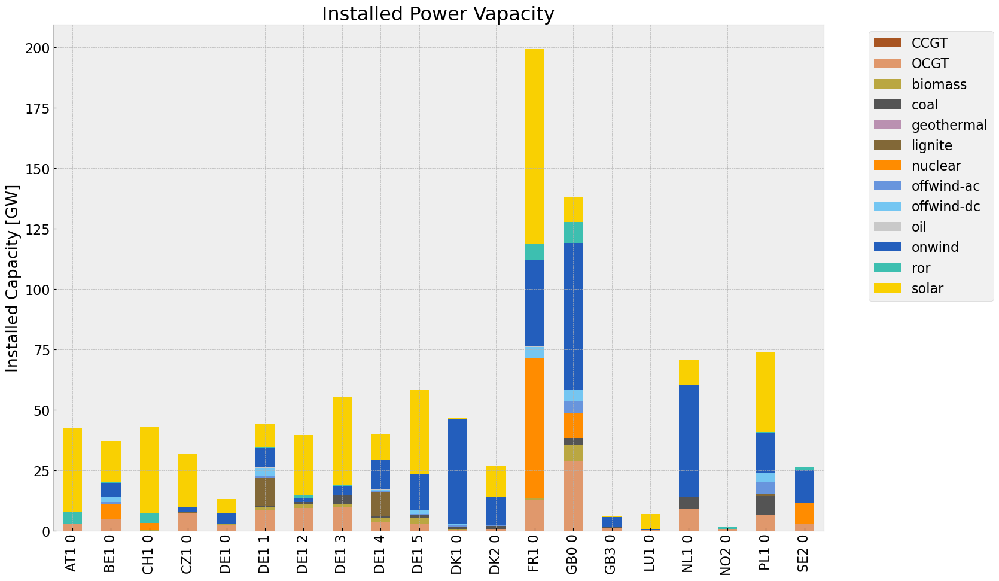

<Figure size 640x480 with 0 Axes>

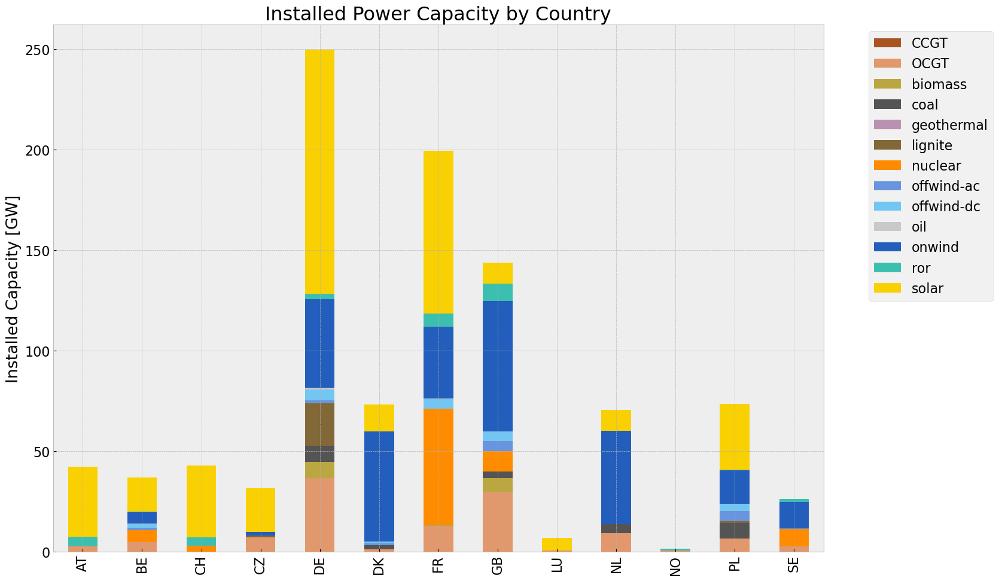

<Figure size 640x480 with 0 Axes>

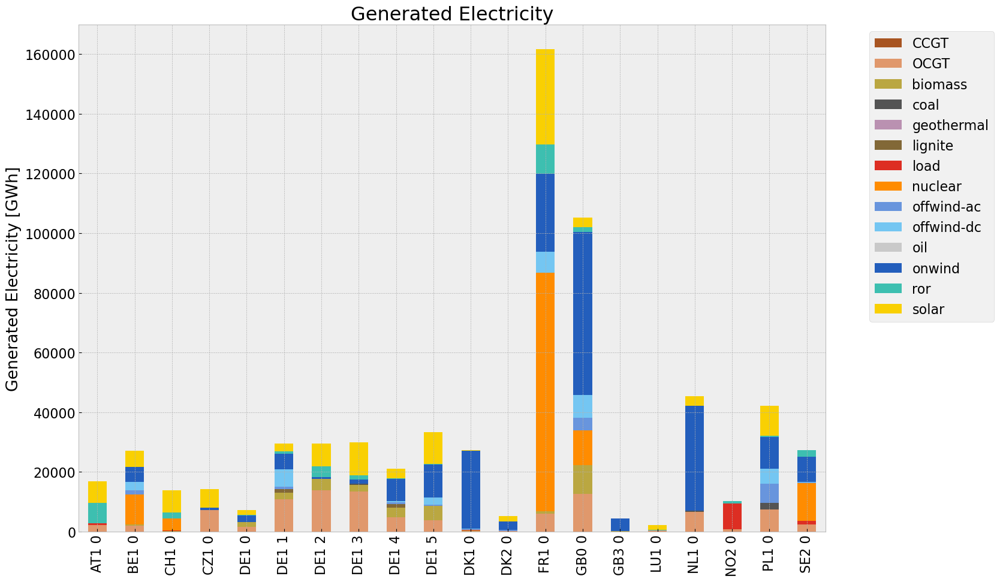

<Figure size 640x480 with 0 Axes>

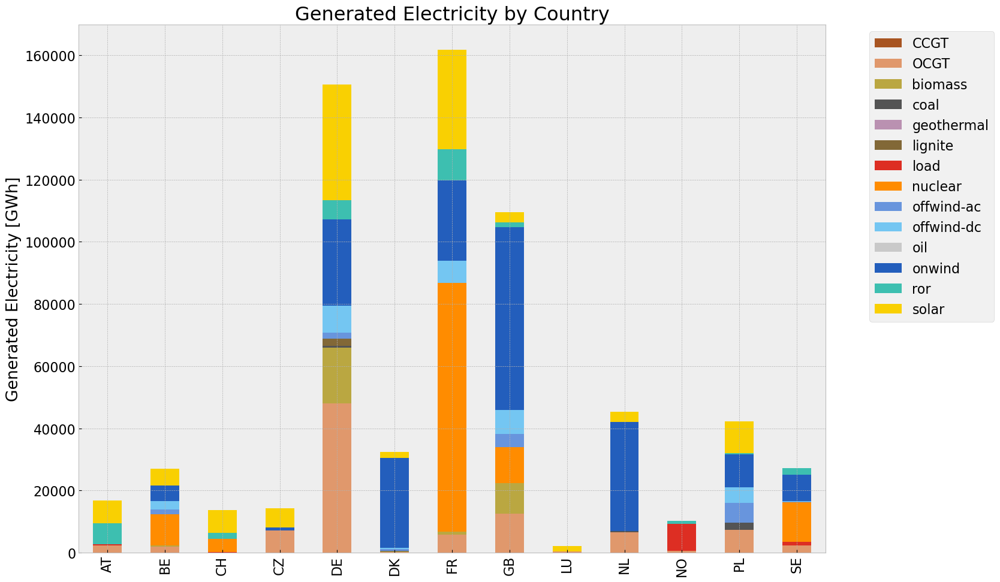

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jere

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,9.548563e+07,0.451621,0.1980,4.186290e+07
biomass,2.924936e+07,0.468000,0.0000,0.000000e+00
coal,3.287988e+06,0.329908,0.3361,3.349699e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,2.485814e+06,0.337285,0.4069,2.998883e+06
load,1.055164e+07,1.000000,0.0000,0.000000e+00
nuclear,1.184392e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.500810e+07,1.000000,0.0000,0.000000e+00


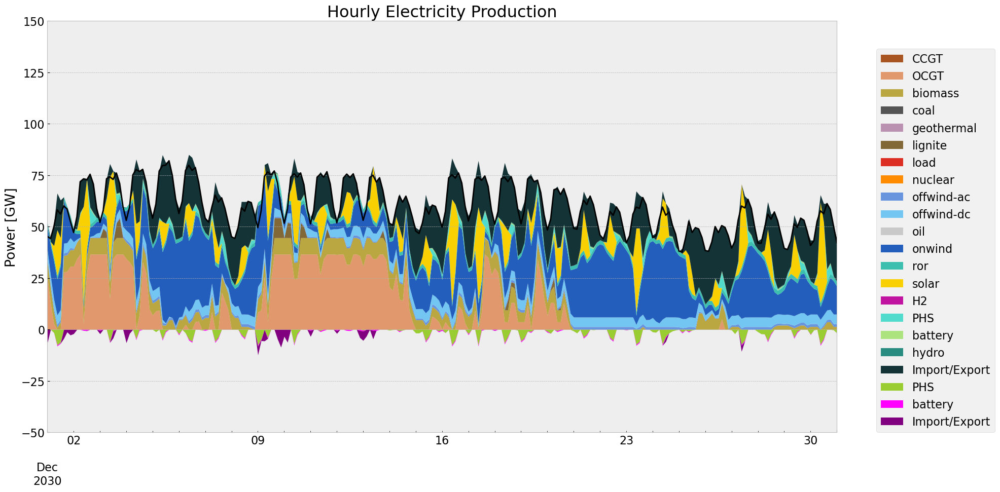

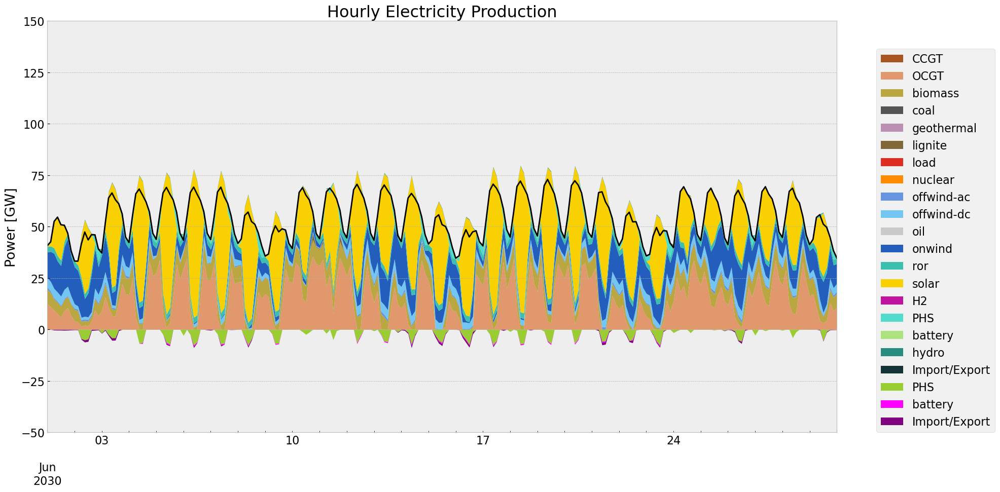

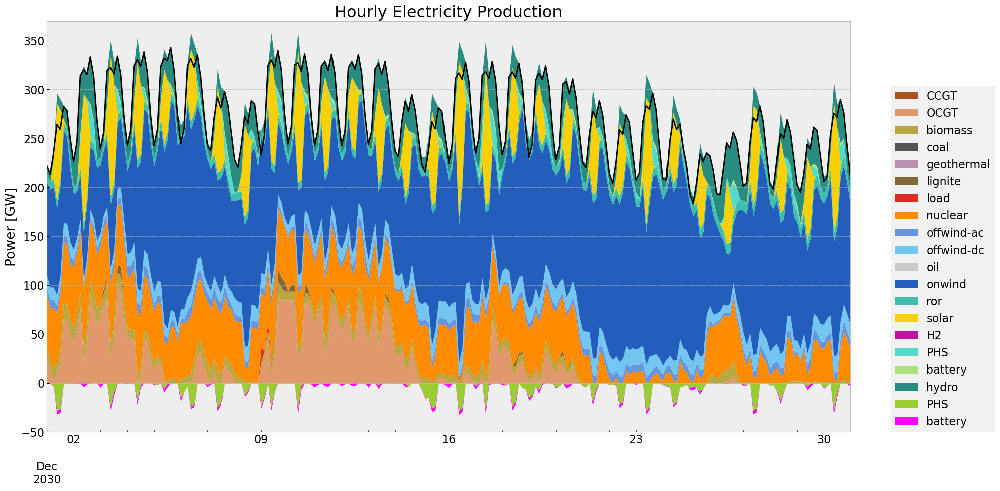

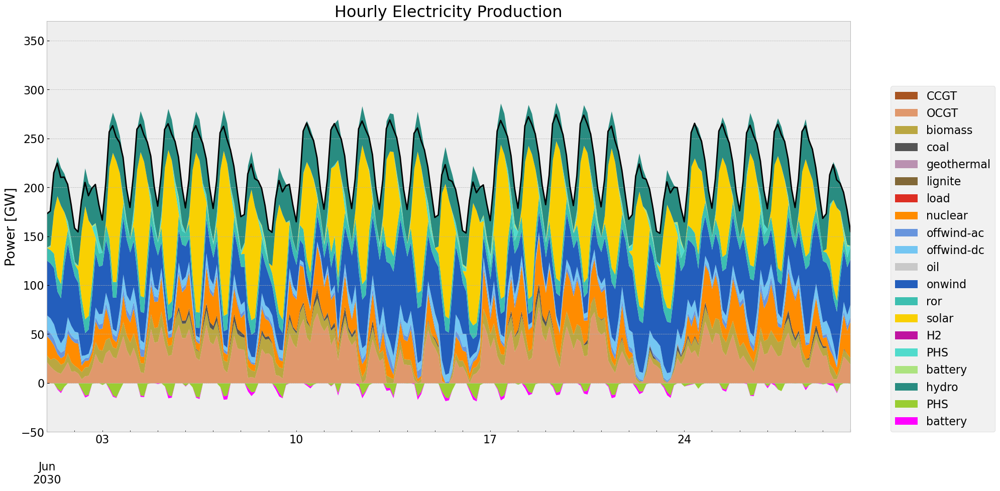

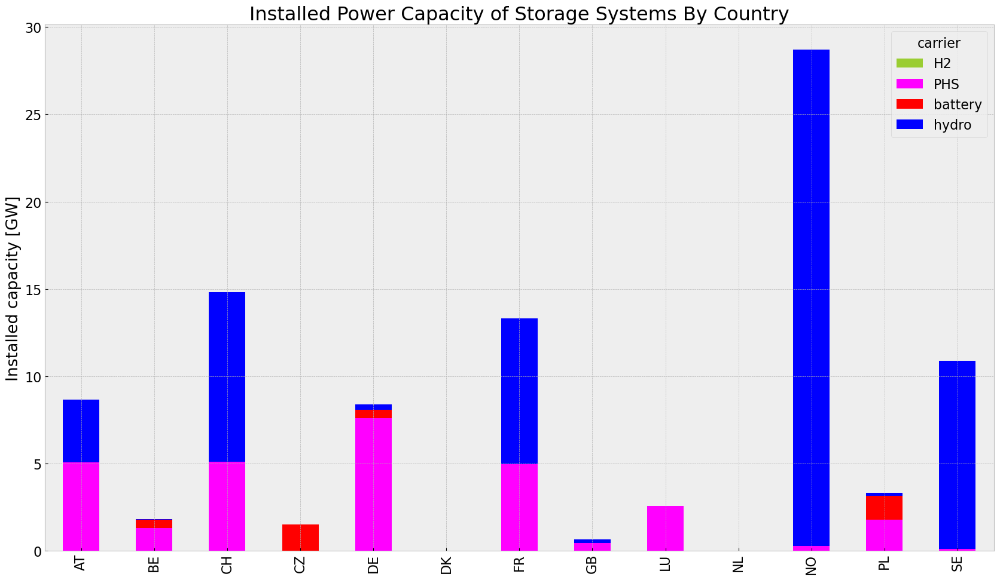

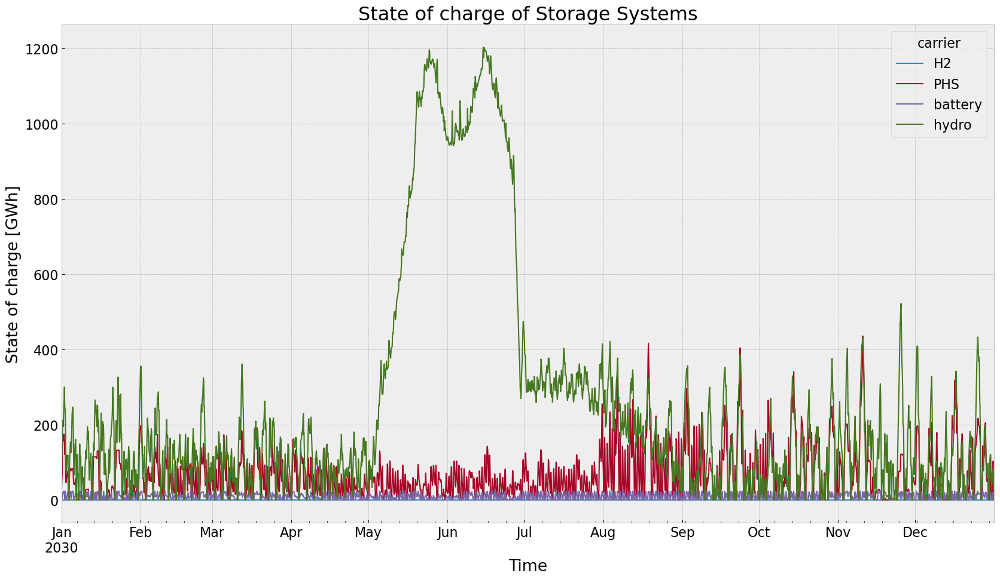

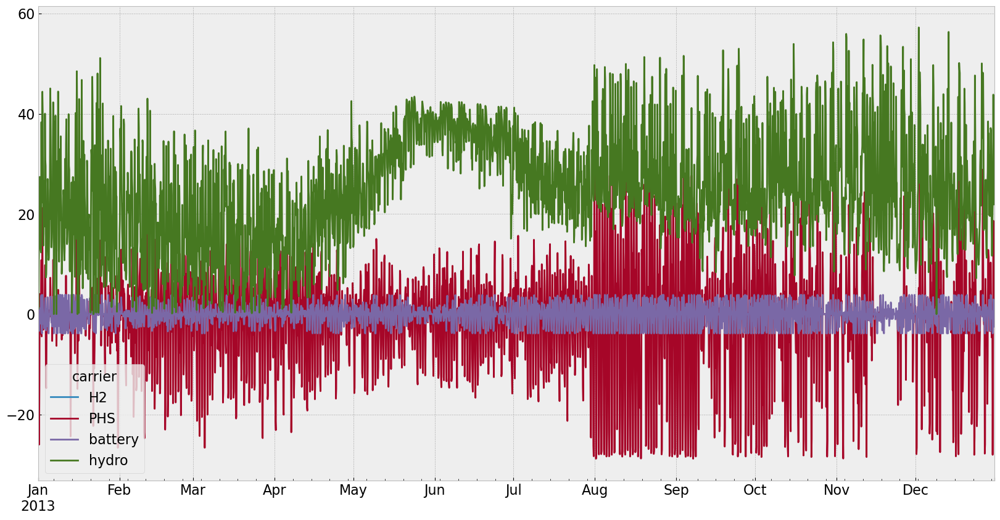

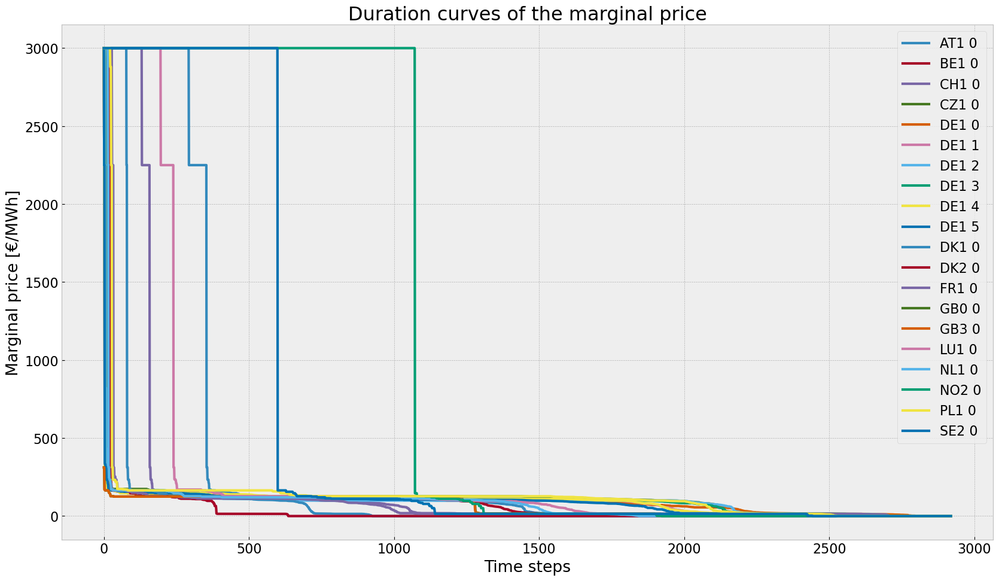

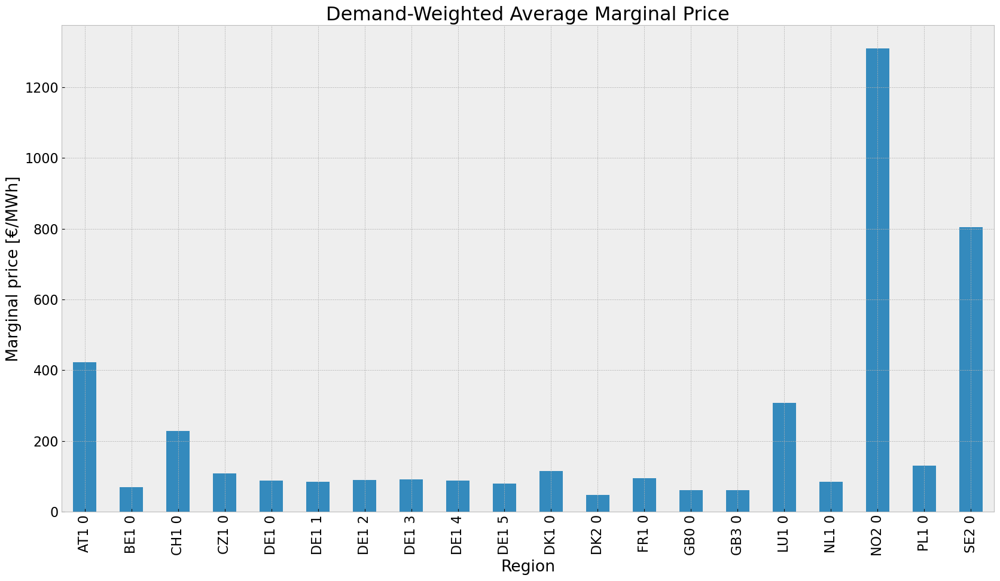

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


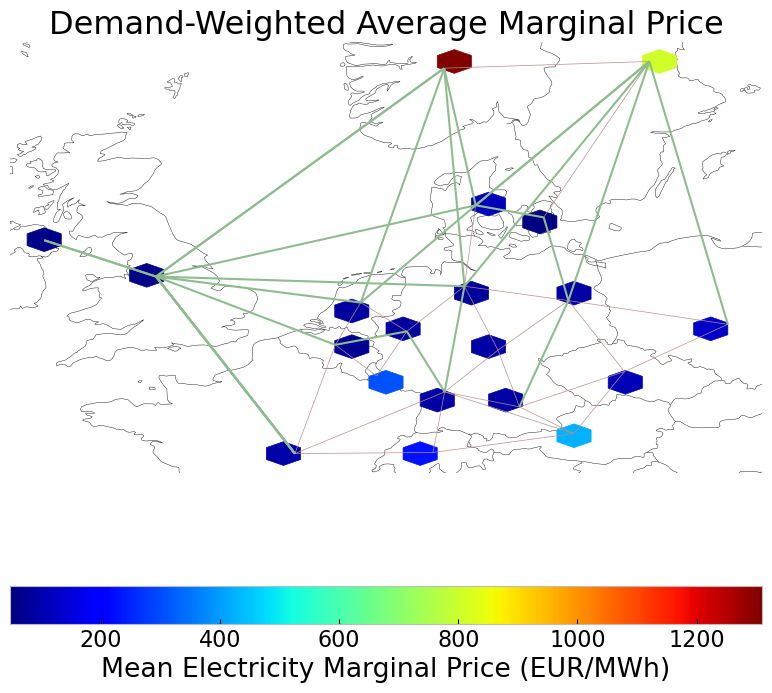

In [75]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4,colors_gen_table)
gen_inv_roll_country = gen_power_table_country(n4,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4)
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [76]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

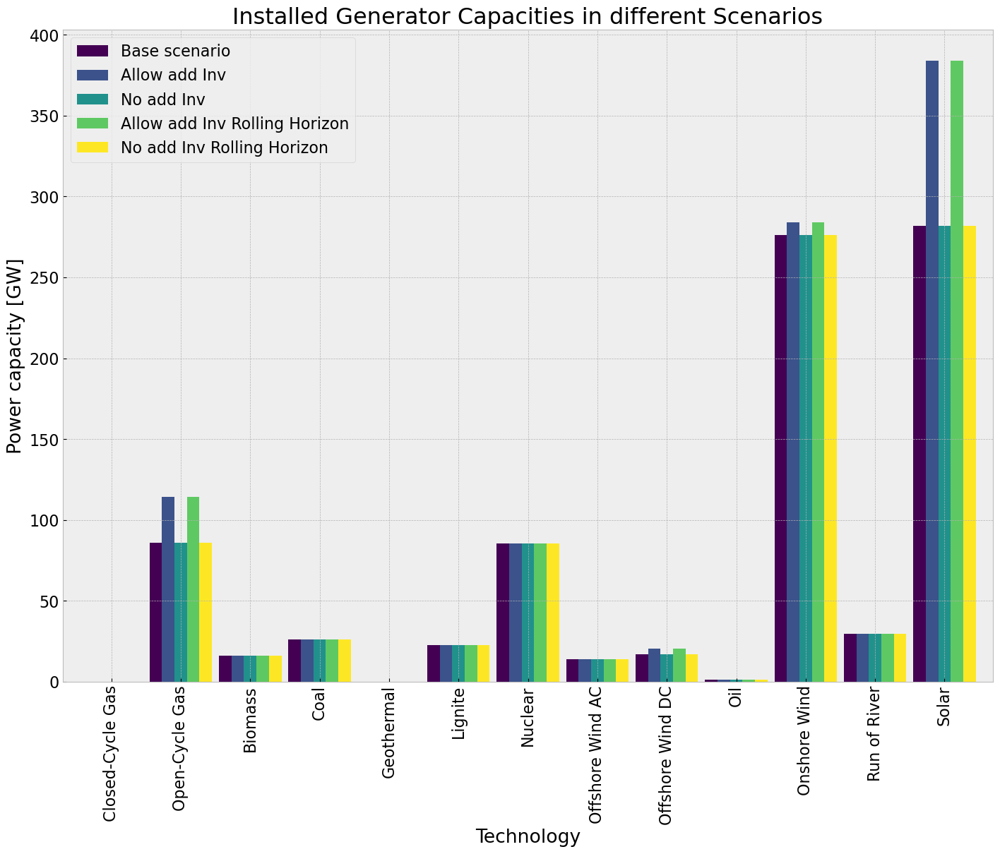

In [77]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


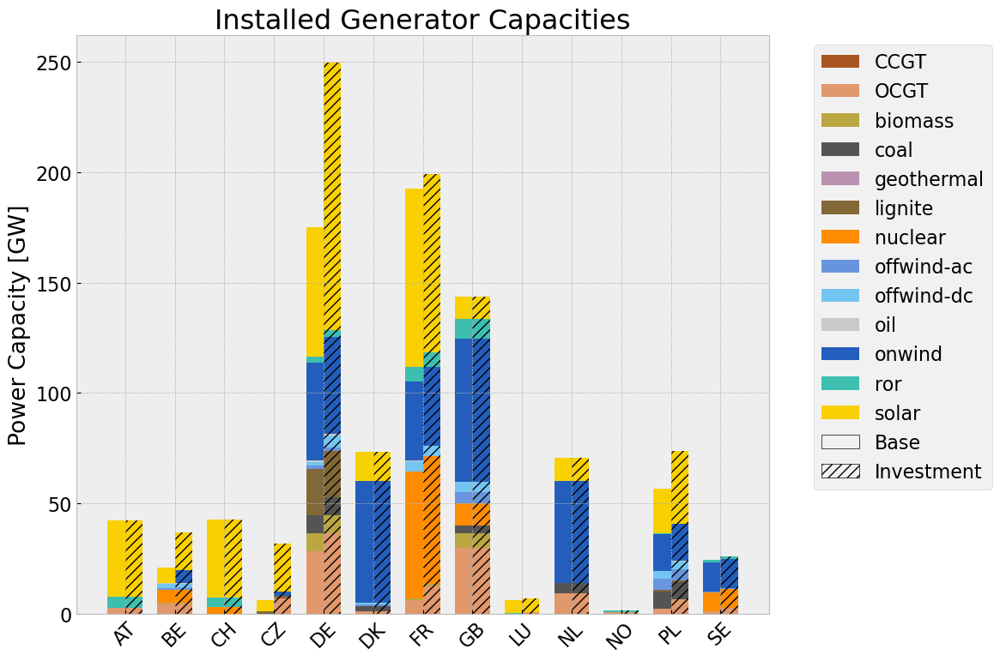

In [78]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv_noexim.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

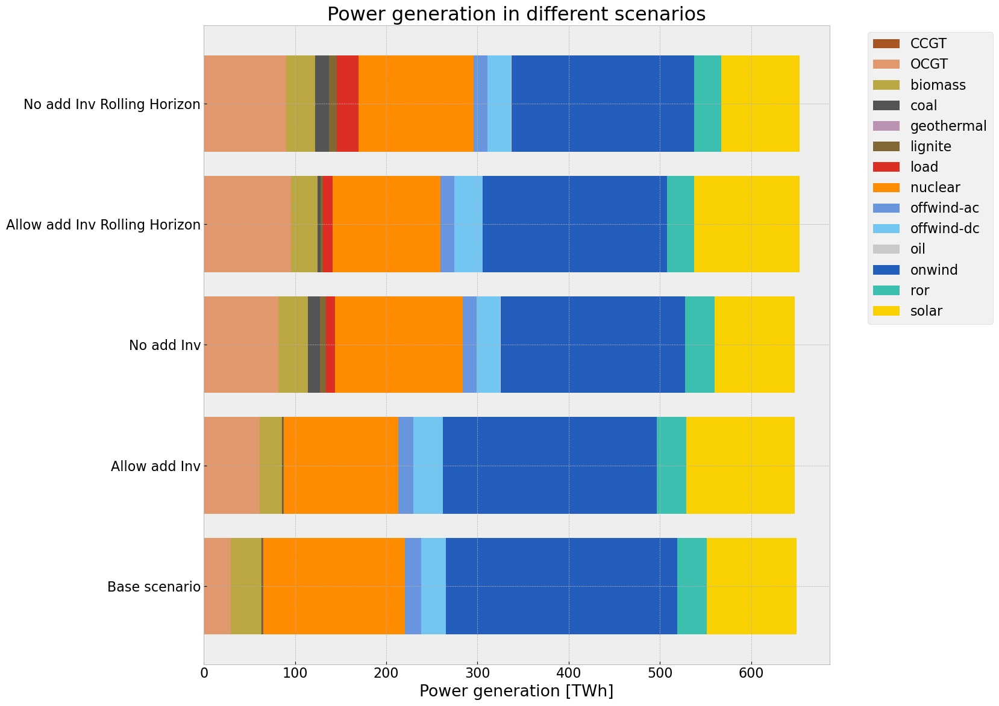

In [79]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = tech_list_gen_table)

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation_noexim.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

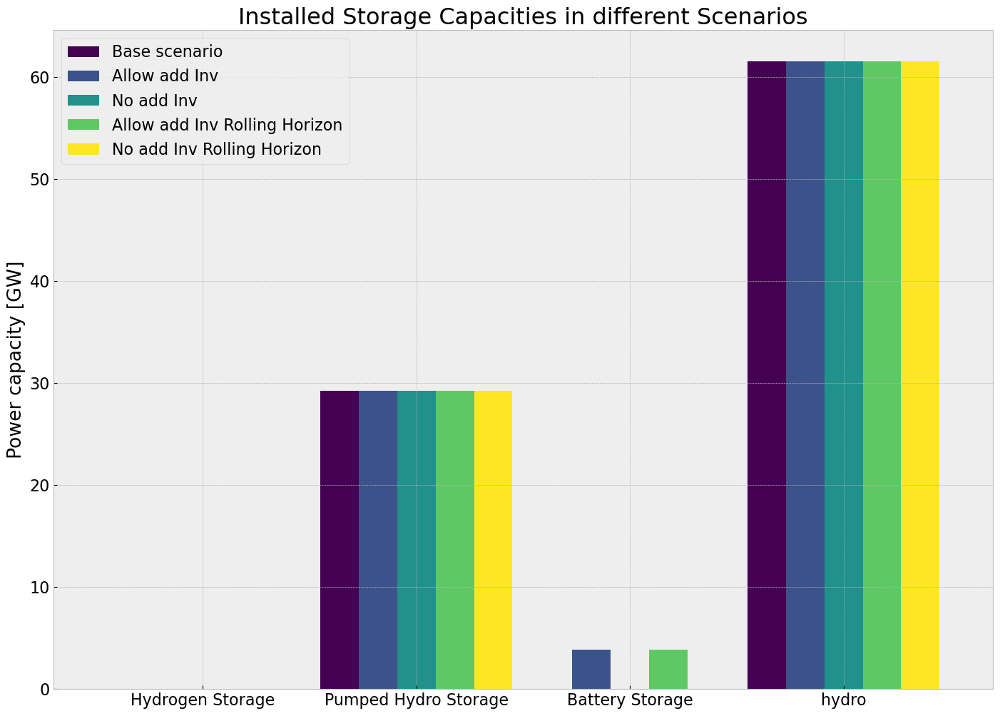

In [80]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap_noexim.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

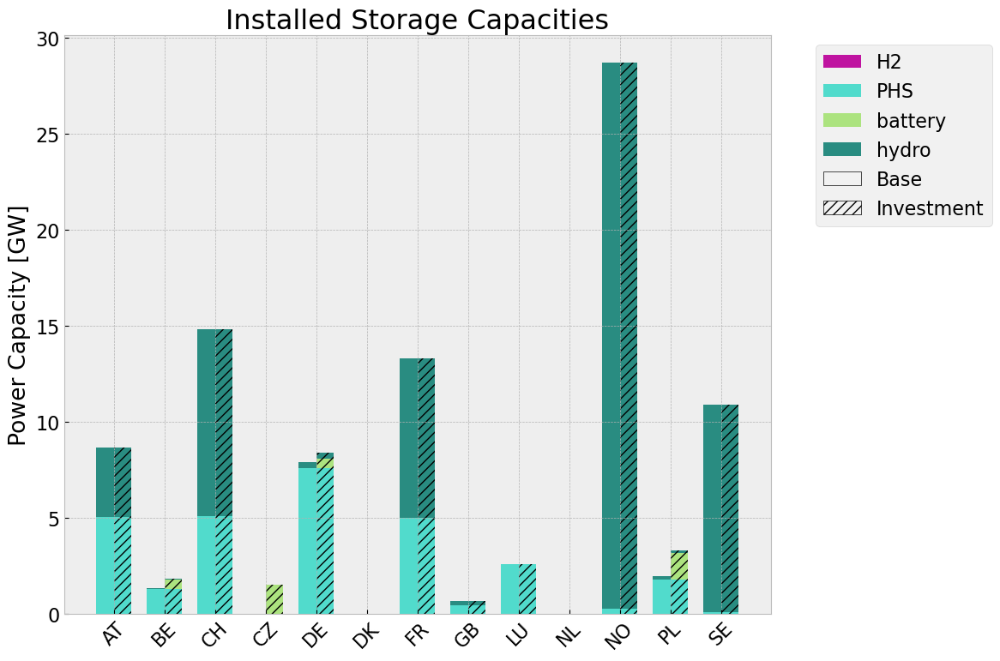

In [81]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv_noexim.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [82]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\114468831.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\114468831.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


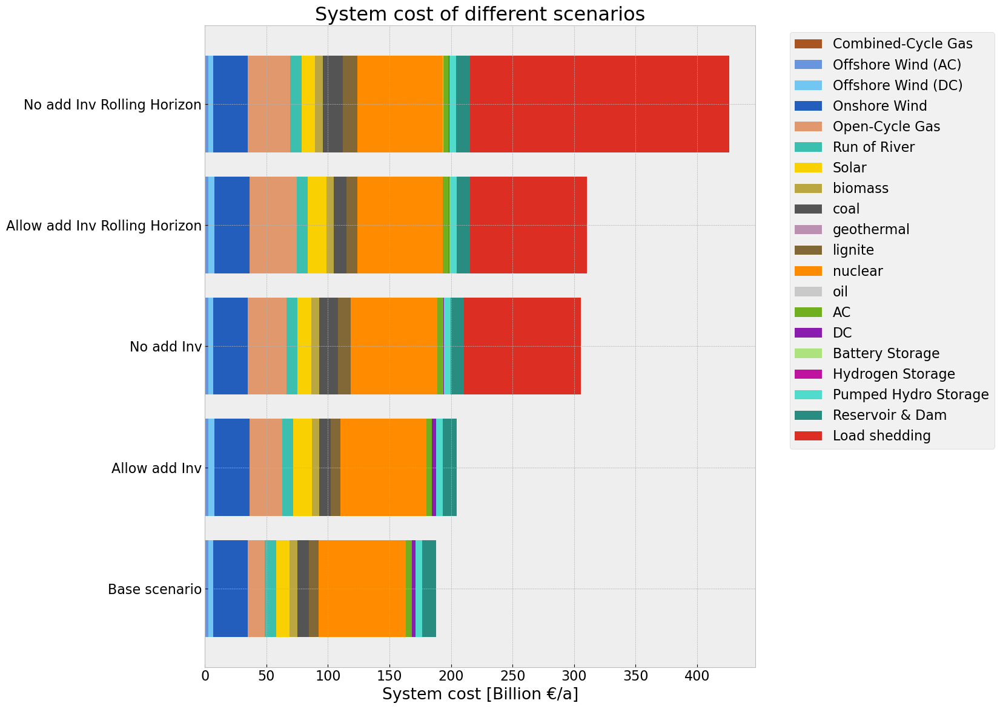

In [83]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost_noexim.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [84]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [85]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


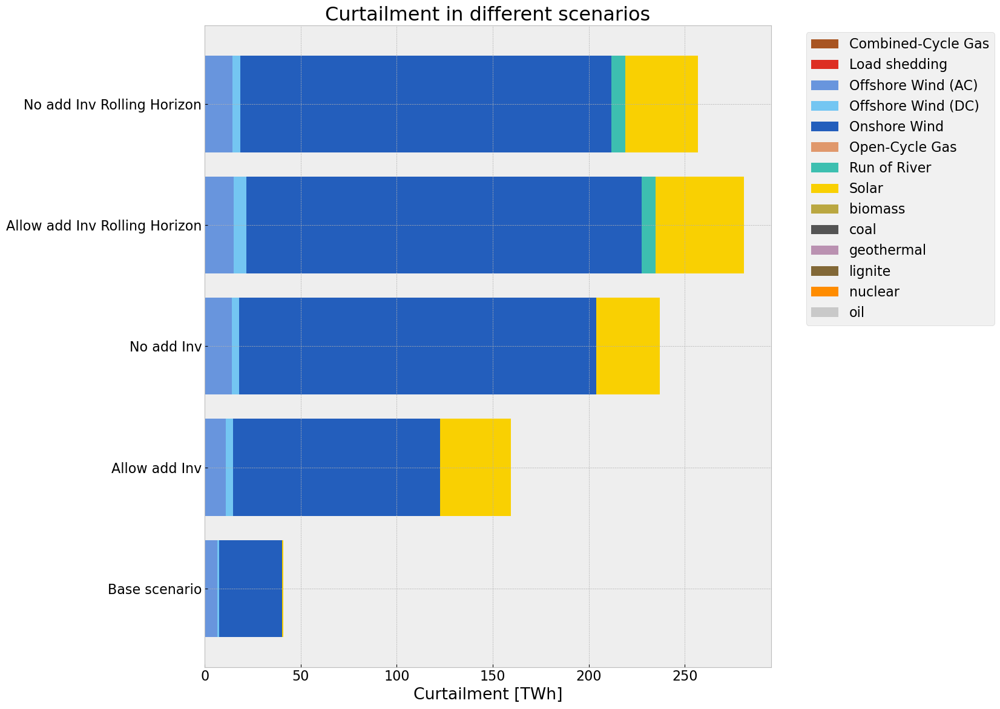

In [86]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment_noexim.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3988\1495190496.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


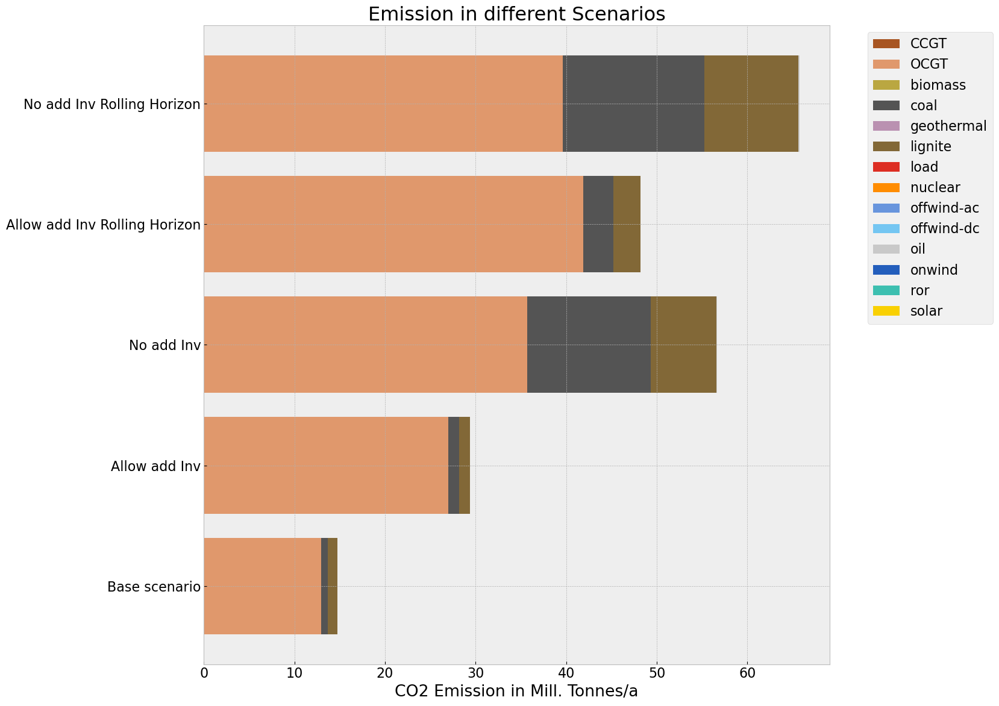

In [87]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission_noexim.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()